In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import os
import glob

# Read the patient data from Excel
patient_data_path = '/home/perinedo/Projects/Perinedo/clinical_data/PatientTablePerinedo.xlsx'
patient_df = pd.read_excel(patient_data_path, sheet_name='PROJECT YEAR 2021')

# Remove columns where all values are NaN
patient_df = patient_df.dropna(axis=1, how='all')

# Drop the first three rows since they contain NaN values and metadata
patient_df = patient_df.iloc[3:].reset_index(drop=True)

# Fill NaN values in row 0 and append row 1 values to all entries in row 0
row0 = patient_df.iloc[0]
row1 = patient_df.iloc[1]

# First handle NaN values by filling with last valid value from left
last_valid_value = None
for col in patient_df.columns:
    if pd.isna(row0[col]):
        if last_valid_value is not None:
            patient_df.at[0, col] = last_valid_value
    else:
        last_valid_value = row0[col]

# Now append row 1 values to all entries in row 0
for col in patient_df.columns:
    current_value = patient_df.at[0, col]
    row1_value = row1[col]
    # Append row1 value if it exists
    if pd.notna(row1_value):
        patient_df.at[0, col] = f"{current_value} {row1_value}"

# Drop row with index 1 since we've already used its values
patient_df = patient_df.drop(index=1).reset_index(drop=True)

# Set column names to be the values in row 0
patient_df.columns = patient_df.iloc[0]

# Drop the row that was used for column names
patient_df = patient_df.drop(index=0).reset_index(drop=True)


# Print full dataframe without truncation
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
print("\nFull dataframe after removing all-NaN columns:")
print(patient_df)

# Concatenate row 4 with itself


# Print all column names
print("\nColumns after removing NaN columns:")
for col in patient_df.columns:
    print(f"- {col}")


# Display basic information about the patient dataset
print("Patient Data Summary:")
print("-" * 50)
print(f"Number of patients: {len(patient_df)}")
print("\nFirst few rows of patient data:")
display(patient_df.head())
print("\nColumns in patient data:")
print(patient_df.columns.tolist())

# Define path to connectome data (based on dMRI_connectome.sh default parameters)
connectome_base_dir = '/home/perinedo/Projects/Perinedo/derivatives/dMRI'
method = 'sGM-MCRIB_cGM-ALBERT'  # default method
nbr = '10M'  # default number of streamlines
space = 'anat'  # default space
use_edited = True  # default use edited version

# Function to load connectome data for a subject
def load_connectome(subject_id, session_id):
    edit_suffix = '_edit' if use_edited else ''
    
    connectome_path = os.path.join(
        connectome_base_dir,
        f'sub-{subject_id}',
        f'ses-{session_id}',
        'dwi',
        'connectome',
        method,
        f'sub-{subject_id}_ses-{session_id}_whole_brain_{nbr}_space-{space}_method-{method}{edit_suffix}_Connectome.csv'
    )
    print(connectome_path)
    # Print all files in the connectome directory
    connectome_dir = os.path.dirname(connectome_path)
    if os.path.exists(connectome_dir):
        print("\nFiles in connectome directory:")
        for file in os.listdir(connectome_dir):
            print(f"- {file}")
        print()

    if os.path.exists(connectome_path):
        return pd.read_csv(connectome_path, header=None)
    else:
        print(f"Warning: Connectome not found for subject {subject_id}, session {session_id}")
        return None

# Load first subject's connectome as an example
if len(patient_df) > 0:
    first_subject = patient_df.iloc[0]
    # Assuming subject ID and session ID are columns in your Excel file
    # Modify these column names based on your actual Excel structure
    subject_id = str(first_subject.get('Subject_ID', 'PMR099'))  # replace 'Subject_ID' with actual column name
    session_id = str(first_subject.get('Session_ID', 'MR2'))    # replace 'Session_ID' with actual column name
    
    #example_connectome = load_connectome(subject_id, session_id)
    example_connectome = load_connectome('PMR099', 'MR2')

    if example_connectome is not None:
        print("\nExample Connectome Data:")
        print("-" * 50)
        print(f"Shape of connectome matrix: {example_connectome.shape}")
        print("\nFirst few rows and columns of the connectome matrix:")
        display(example_connectome.iloc[:5, :5])


Full dataframe after removing all-NaN columns:
0   CODE                  DOB SEX (M/F) S/T  GW PLUS DAYS BIRTH WEIGHT  \
0    001  2021-02-08 00:00:00         M   S  30         2         1500   
1    002  2021-01-04 00:00:00         M   S  26         0          680   
2    003  2021-04-28 00:00:00         F   S  31         1         1454   
3    004  2021-05-02 00:00:00         M   S  31         1         1250   
4    005  2021-05-15 00:00:00         F   S  32         0         1500   
5    006  2021-04-11 00:00:00         M   S  25         5          810   
6    007  2021-06-03 00:00:00         F   S  32         0         1480   
7    008  2021-05-16 00:00:00         F   S  28         6          880   
8    009  2021-06-24 00:00:00         F   T  32         1         1570   
9    010  2021-06-24 00:00:00         F   T  32         1         1720   
10   011  2021-06-15 00:00:00         M   S  31         6         1510   
11   012  2021-07-03 00:00:00         M   S  29         6       

,CODE,DOB,SEX (M/F),S/T,GW,PLUS DAYS,BIRTH WEIGHT,APGAR,1. MR,WEEKS AT 1. MR,CLINICAL FINDINGS AT 1. MR,2. MR,WEEKS AT 2. MR,MRI PATHOLOGY ischemic,MRI PATHOLOGY haemorrhagic,MRI PATHOLOGY other,IMAGE QUALITY,SAGITTAL STRATA RIGHT,SAGITTAL STRATA LEFT,NVA TS,CA WKS,NVA TS,CA WKS,HNNE TEST,BAYLEY-III TEST,GM WRITHING,GM FIDGETY,INFANT MOTOR PROFILE TEST,CA MONTHS FOR IMP,BEERY-BUKTENICA VMI TEST,VISUAL PERCPETION,CA MONTHS FOR VMI,HEMPEL TEST
0,001,2021-02-08 00:00:00,M,S,30,2,1500,2/5/7,2021-02-15 00:00:00,31.285714,NaN,2021-04-09 00:00:00,38.857143,0,1,microbleeding right cerebellum,NaN,2,2,1,4,0,13,NaN,NaN,poor repertoire,no fidgety,97,12,99,102,27,NaN
1,002,2021-01-04 00:00:00,M,S,26,0,680,3/6/7,2021-02-11 00:00:00,31.428571,small bleeding in germinative matrix,2021-04-30 00:00:00,42.571429,0,1,haemosderin deposits PV right,NaN,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,003,2021-04-28 00:00:00,F,S,31,1,1454,9/9,2021-05-06 00:00:00,32.285714,"billateral bleeding at ganglinic eminence, int...",2021-06-18 00:00:00,38.428571,1,1,billateral PV haemosderin deposits,NaN,3,3,0,2,0,12,NaN,NaN,poor repertoire,no fidgety,97,15,99,102,26,NaN
3,004,2021-05-02 00:00:00,M,S,31,1,1250,8/9,2021-05-06 00:00:00,31.714286,small PV bleeding in left caudate-thalamic border,2021-06-25 00:00:00,38.857143,0,0,NaN,NaN,1,2,1,3,0,13,NaN,NaN,cramped synchronized,no fidgety,88,12+1,93,94,24,NaN
4,005,2021-05-15 00:00:00,F,S,32,0,1500,9/9,2021-05-25 00:00:00,33.428571,"punctiform WM lesions, germinative matrix blee...",2021-07-02 00:00:00,38.857143,1,1,NaN,NaN,2,2,1,2,1,12,NaN,NaN,normal repertoire,fidgety,89,12,99,102,26,NaN



Columns in patient data:
['CODE', 'DOB', 'SEX (M/F)', 'S/T', 'GW', 'PLUS DAYS', 'BIRTH WEIGHT', 'APGAR ', '1. MR', 'WEEKS AT 1. MR', 'CLINICAL FINDINGS AT 1. MR', '2. MR', 'WEEKS AT 2. MR', 'MRI PATHOLOGY ischemic', 'MRI PATHOLOGY haemorrhagic', 'MRI PATHOLOGY other', 'IMAGE QUALITY', 'SAGITTAL STRATA RIGHT', 'SAGITTAL STRATA LEFT', 'NVA TS', 'CA WKS', 'NVA TS', 'CA WKS', 'HNNE TEST', 'BAYLEY-III TEST', 'GM WRITHING', 'GM FIDGETY', 'INFANT MOTOR PROFILE TEST', 'CA MONTHS FOR IMP', 'BEERY-BUKTENICA VMI TEST', 'VISUAL PERCPETION', 'CA MONTHS FOR VMI', 'HEMPEL TEST']
/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR099/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR099_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv

Files in connectome directory:
- sub-PMR099_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_sift2.txt
- assignments_sub-PMR099_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.cs

,0,1,2,3,4
0,0.000000,0.000000,4.221519,0.000000,1.269454
1,0.000000,0.000000,0.000000,4.402861,0.000279
2,4.221519,0.000000,0.000000,0.000000,0.053488
3,0.000000,4.402861,0.000000,0.000000,0.000186
4,1.269454,0.000279,0.053488,0.000186,0.000000


In [2]:
import os 
# List all available connectomes
print("Available Connectomes:")
print("-" * 50)

# Search pattern for connectome files
connectome_pattern = os.path.join(
    connectome_base_dir,
    'sub-*',
    'ses-*',
    'dwi',
    'connectome',
    method,
    'sub-*_Connectome.csv'
)

# Find all connectome files
connectome_files = glob.glob(connectome_pattern)

if connectome_files:
    print(f"Found {len(connectome_files)} connectome files:")
    for file_path in sorted(connectome_files):
        # Extract subject and session info from path
        parts = file_path.split(os.sep)
        name = parts[-1]
        subject = parts[-6]  # sub-XXX
        session = parts[-5]  # ses-XXX
        print(f"- {subject}, {session}, {name}")
else:
    print("No connectome files found in the specified directory structure.")
    print(f"Searched pattern: {connectome_pattern}")

Available Connectomes:
--------------------------------------------------
Found 73 connectome files:
- sub-PMR001, ses-MR2, sub-PMR001_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR002, ses-MR2, sub-PMR002_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR003, ses-MR2, sub-PMR003_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR004, ses-MR2, sub-PMR004_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR005, ses-MR2, sub-PMR005_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR008, ses-MR2, sub-PMR008_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR009, ses-MR2, sub-PMR009_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
- sub-PMR010, ses-MR2, sub-PMR010_ses-MR2_whole_brain_10M_space-anat_method-sGM-


Demographic Summary for Subjects with Connectome Data:
--------------------------------------------------
Total subjects: 73

Sex Distribution:
M    37
F    36
Name: Sex, dtype: int64

Gestational Week Statistics:
count     73
unique    11
top       31
freq      15
Name: GW, dtype: int64


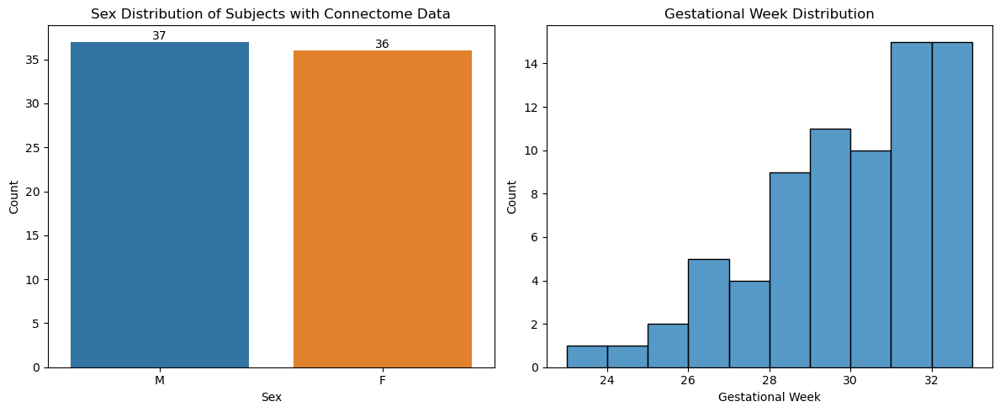


All Gestational Week Values:
--------------------------------------------------
Subject PMR001: 30 weeks
Subject PMR002: 26 weeks
Subject PMR003: 31 weeks
Subject PMR004: 31 weeks
Subject PMR005: 32 weeks
Subject PMR008: 28 weeks
Subject PMR009: 32 weeks
Subject PMR010: 32 weeks
Subject PMR012: 29 weeks
Subject PMR013: 31 weeks
Subject PMR014: 31 weeks
Subject PMR015: 32 weeks
Subject PMR016: 29 weeks
Subject PMR017: 25 weeks
Subject PMR021: 30 weeks
Subject PMR022: 30 weeks
Subject PMR024: 29 weeks
Subject PMR027: 31 weeks
Subject PMR028: 32 weeks
Subject PMR030: 28 weeks
Subject PMR032: 24 weeks
Subject PMR033: 31 weeks
Subject PMR035: 33 weeks
Subject PMR036: 31 weeks
Subject PMR038: 30 weeks
Subject PMR039: 30 weeks
Subject PMR041: 28 weeks
Subject PMR042: 32 weeks
Subject PMR043: 29 weeks
Subject PMR044: 29 weeks
Subject PMR045: 31 weeks
Subject PMR046: 28 weeks
Subject PMR050: 32 weeks
Subject PMR052: 28 weeks
Subject PMR054: 32 weeks
Subject PMR055: 30 weeks
Subject PMR056: 28 

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

# First, let's create a function to extract subject ID from the file path
def extract_subject_id(file_path):
    return file_path.split('sub-')[1].split('/')[0]

# Extract subject IDs from connectome files
connectome_subjects = [extract_subject_id(file_path) for file_path in connectome_files]

# Create a DataFrame with demographic info for subjects with connectome data
demo_data = pd.DataFrame({
    'Subject_ID': patient_df['CODE'].astype(str).apply(lambda x: f'PMR{x.zfill(3)}'),
    'Sex': patient_df['SEX (M/F)'],
    'GW': patient_df['GW']
}).query('Subject_ID in @connectome_subjects')

# Create figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Plot sex distribution
sns.countplot(data=demo_data, x='Sex', ax=ax1)
ax1.set_title('Sex Distribution of Subjects with Connectome Data')
ax1.set_xlabel('Sex')
ax1.set_ylabel('Count')

# Add count labels on top of bars
for i in ax1.containers:
    ax1.bar_label(i)

# Plot GW distribution
sns.histplot(data=demo_data, x='GW', bins=10, ax=ax2)
ax2.set_title('Gestational Week Distribution')
ax2.set_xlabel('Gestational Week')
ax2.set_ylabel('Count')

# Print summary statistics
print("\nDemographic Summary for Subjects with Connectome Data:")
print("-" * 50)
print(f"Total subjects: {len(demo_data)}")
print("\nSex Distribution:")
print(demo_data['Sex'].value_counts())
print("\nGestational Week Statistics:")
print(demo_data['GW'].describe())

plt.tight_layout()
plt.show()

# Print all gestational week values
print("\nAll Gestational Week Values:")
print("-" * 50)
for _, row in demo_data.iterrows():
    print(f"Subject {row['Subject_ID']}: {row['GW']} weeks")



<Figure size 2000x1000 with 0 Axes>

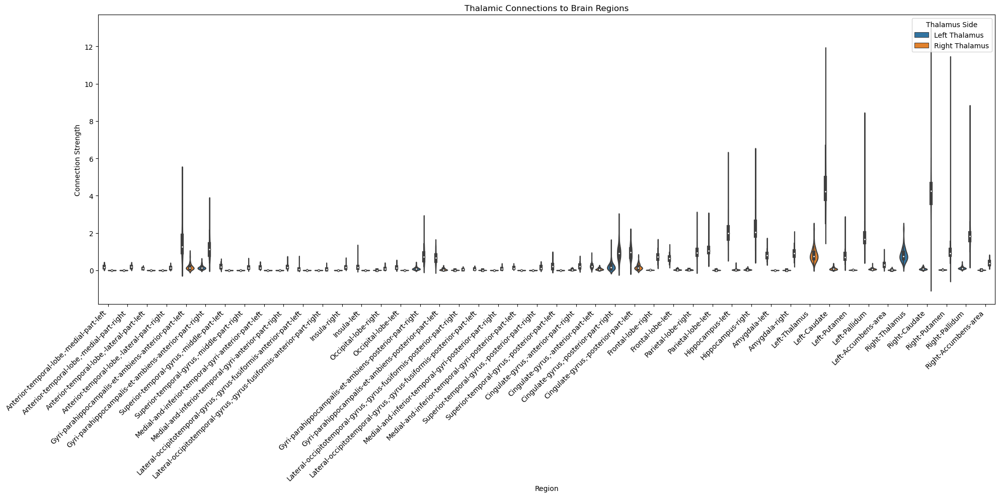


Summary Statistics for Thalamic Connections:
--------------------------------------------------
                                                                   count  \
Region                                             Thalamus Side           
Amygdala-left                                      Left Thalamus    73.0   
                                                   Right Thalamus   73.0   
Amygdala-right                                     Left Thalamus    73.0   
                                                   Right Thalamus   73.0   
Anterior-temporal-lobe,-lateral-part-left          Left Thalamus    73.0   
                                                   Right Thalamus   73.0   
Anterior-temporal-lobe,-lateral-part-right         Left Thalamus    73.0   
                                                   Right Thalamus   73.0   
Anterior-temporal-lobe,-medial-part-left           Left Thalamus    73.0   
                                                   Right Thalamus  

<Figure size 1500x1000 with 0 Axes>

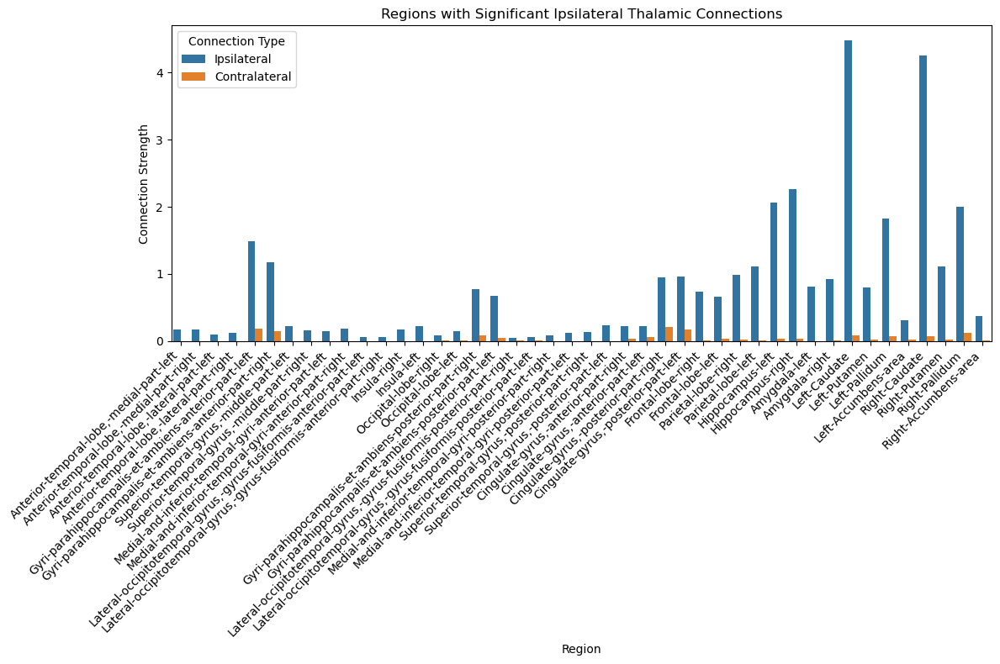

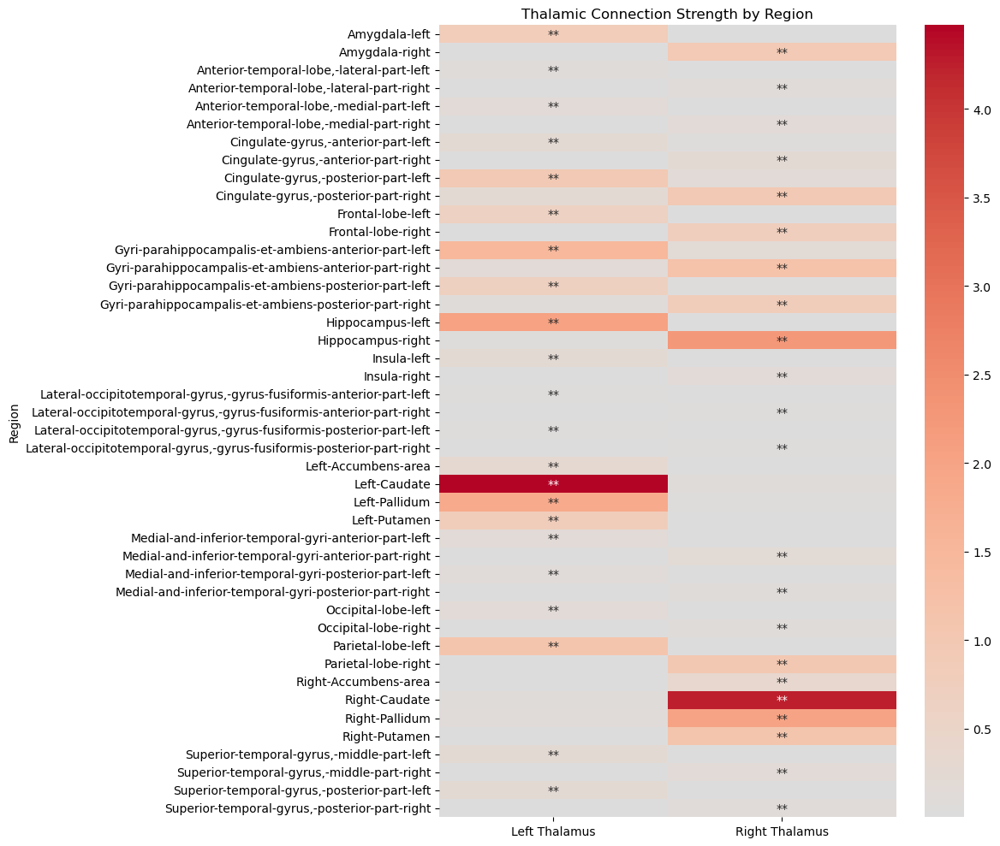


Heatmap Legend:
* = Significant difference between left and right thalamic connections
** = Significant ipsilateral connection (left thalamus stronger to left regions or right thalamus stronger to right regions)

HEMISPHERIC COMPARISON OF IPSILATERAL THALAMIC CONNECTIONS
Comparing Left Thalamus → Left Regions vs Right Thalamus → Right Regions

Results for all homologous region pairs (FDR corrected):
--------------------------------------------------------------------------------
Region: Anterior-Temporal-Lobe,-Medial-Part-
  Left Thalamus → Anterior-temporal-lobe,-medial-part-left: 0.1691
  Right Thalamus → Anterior-temporal-lobe,-medial-part-right: 0.1734
  Paired t-test: p-value = 0.6093, corrected p = nan
  Significant: False (FDR corrected)
  Effect size (Cohen's d): -0.0651
  Stronger ipsilateral connection: Right hemisphere

Region: Anterior-Temporal-Lobe,-Lateral-Part-
  Left Thalamus → Anterior-temporal-lobe,-lateral-part-left: 0.0958
  Right Thalamus → Anterior-temporal-lobe,

/tmp/ipykernel_59189/3008071818.py:350: RuntimeWarning: invalid value encountered in double_scalars
  effect_size = (left_ipsi_mean - right_ipsi_mean) / np.sqrt(


<Figure size 1400x800 with 0 Axes>

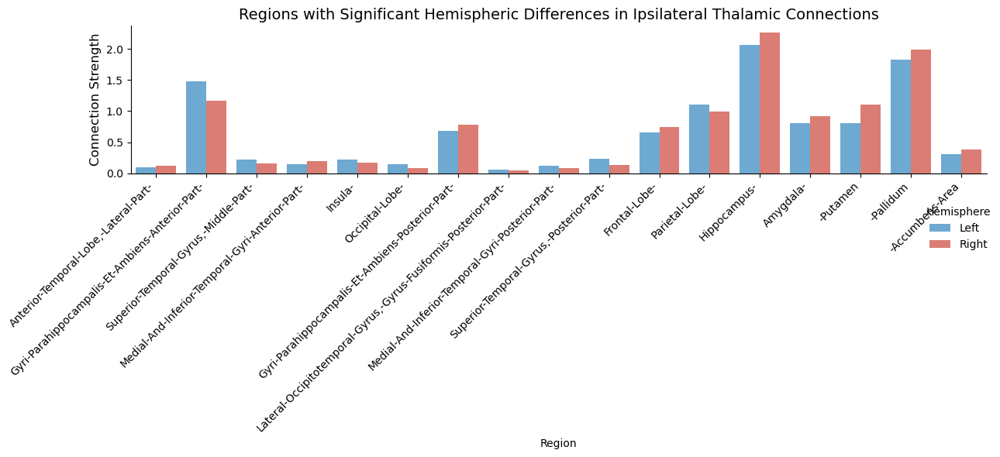

/tmp/ipykernel_59189/3008071818.py:448: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_ipsi_diff['Asymmetry_Index'] = ((significant_ipsi_diff['Left_Ipsi_Mean'] - significant_ipsi_diff['Right_Ipsi_Mean']) /


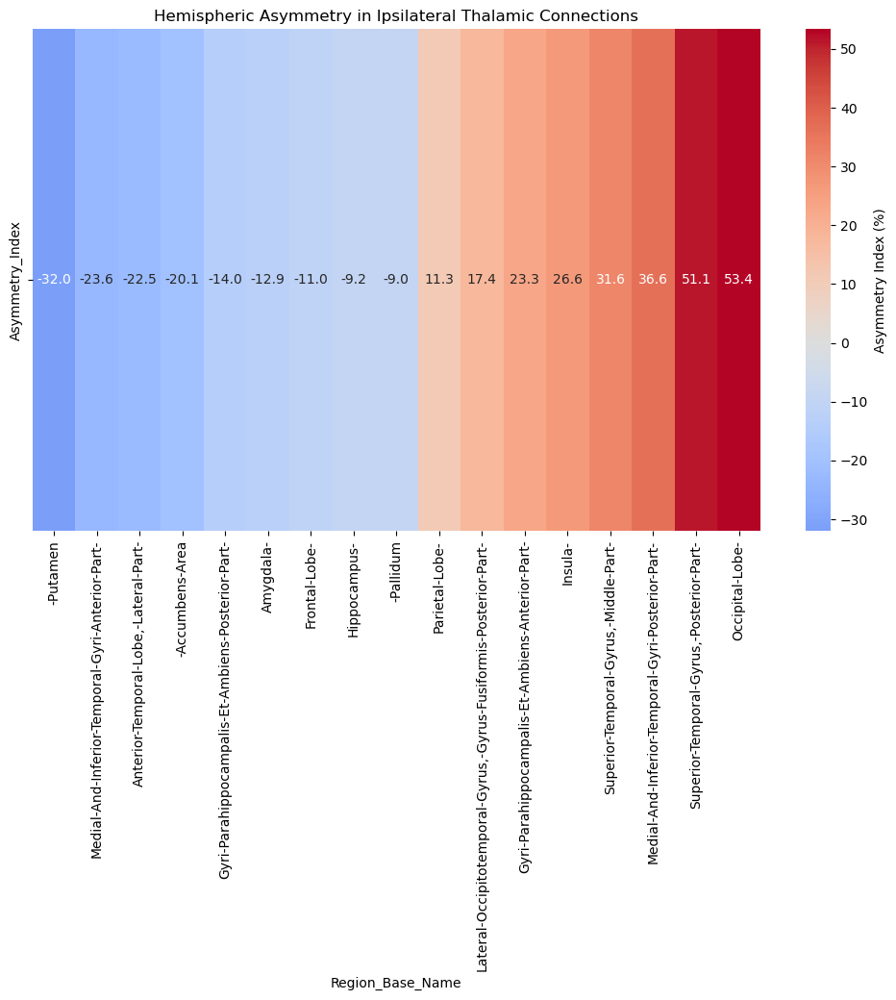


Hemispheric Asymmetry in Ipsilateral Thalamic Connections:
--------------------------------------------------------------------------------
-Putamen: Right > Left, Asymmetry Index = -31.97%
  Interpretation: Strong asymmetry
Medial-And-Inferior-Temporal-Gyri-Anterior-Part-: Right > Left, Asymmetry Index = -23.57%
  Interpretation: Moderate asymmetry
Anterior-Temporal-Lobe,-Lateral-Part-: Right > Left, Asymmetry Index = -22.53%
  Interpretation: Moderate asymmetry
-Accumbens-Area: Right > Left, Asymmetry Index = -20.08%
  Interpretation: Moderate asymmetry
Gyri-Parahippocampalis-Et-Ambiens-Posterior-Part-: Right > Left, Asymmetry Index = -13.96%
  Interpretation: Moderate asymmetry
Amygdala-: Right > Left, Asymmetry Index = -12.95%
  Interpretation: Moderate asymmetry
Frontal-Lobe-: Right > Left, Asymmetry Index = -10.96%
  Interpretation: Moderate asymmetry
Hippocampus-: Right > Left, Asymmetry Index = -9.23%
  Interpretation: Mild asymmetry
-Pallidum: Right > Left, Asymmetry Index = 

In [4]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd

def get_thalamic_connections(connectome_files):
    # Lists to store connection values
    left_thalamus_connections = {i: [] for i in range(1, 47)}  # Index 37
    right_thalamus_connections = {i: [] for i in range(1, 47)}  # Index 42
    
    for file_path in connectome_files:
        connectome = pd.read_csv(file_path, header=None)
        
        # Get connections for left thalamus (index 37-1 because matrix is 0-based)
        left_connections = connectome.iloc[36]
        for i in range(46):
            left_thalamus_connections[i+1].append(left_connections[i])
            
        # Get connections for right thalamus (index 42-1 because matrix is 0-based)
        right_connections = connectome.iloc[41]
        for i in range(46):
            right_thalamus_connections[i+1].append(right_connections[i])
    
    return left_thalamus_connections, right_thalamus_connections

# Load label names
label_path = '/home/perinedo/Projects/Perinedo/code/zagreb_dhcp/label_names/ALBERT/sGM-MCRIB_cGM-ALBERT_Connectome.txt'
labels = {}
with open(label_path, 'r') as f:
    for line in f:
        if line.strip():
            idx, name = line.strip().split('\t')
            labels[int(idx)] = name.split('-GM')[0]  # Remove -GM suffix for cleaner labels

# Get thalamic connections
left_thal_conn, right_thal_conn = get_thalamic_connections(connectome_files)

# Create violin plots
plt.figure(figsize=(20, 10))

# Prepare data for plotting
plot_data = []
for region_idx in range(1, 47):
    if region_idx != 37:  # Skip self-connection for left thalamus
        plot_data.extend([(region_idx, labels[region_idx], val, 'Left Thalamus') 
                         for val in left_thal_conn[region_idx]])
    if region_idx != 42:  # Skip self-connection for right thalamus
        plot_data.extend([(region_idx, labels[region_idx], val, 'Right Thalamus') 
                         for val in right_thal_conn[region_idx]])

# Convert to DataFrame
plot_df = pd.DataFrame(plot_data, columns=['Region_ID', 'Region', 'Connection Strength', 'Thalamus Side'])

# Create violin plot
plt.figure(figsize=(20, 10))
sns.violinplot(data=plot_df, x='Region', y='Connection Strength', hue='Thalamus Side')
plt.xticks(rotation=45, ha='right')
plt.title('Thalamic Connections to Brain Regions')
plt.tight_layout()
plt.show()

# Print summary statistics
print("\nSummary Statistics for Thalamic Connections:")
print("-" * 50)
summary_stats = plot_df.groupby(['Region', 'Thalamus Side'])['Connection Strength'].describe()
print(summary_stats)

# Identify which regions are left and right hemisphere
left_regions = []
right_regions = []
region_pairs = {}  # To store corresponding left-right region pairs

for idx in range(1, 47):
    region_name = labels[idx]
    if "left" in region_name.lower():
        left_regions.append(idx)
        # Find corresponding right region
        base_name = region_name.lower().replace("left", "").strip()
        for r_idx in range(1, 47):
            r_name = labels[r_idx]
            if "right" in r_name.lower() and base_name in r_name.lower().replace("right", "").strip():
                region_pairs[idx] = r_idx
                break
    elif "right" in region_name.lower():
        right_regions.append(idx)

# Add ipsilateral flag to the DataFrame
plot_df['Ipsilateral'] = False
for idx, row in plot_df.iterrows():
    region_id = row['Region_ID']
    thalamus = row['Thalamus Side']
    
    if (region_id in left_regions and thalamus == 'Left Thalamus') or \
       (region_id in right_regions and thalamus == 'Right Thalamus'):
        plot_df.at[idx, 'Ipsilateral'] = True

# Statistical testing for differences between left and right thalamic connections
print("\nStatistical Testing for Ipsilateral vs Contralateral Connections:")
print("-" * 80)

# Create a new figure for the results visualization
plt.figure(figsize=(15, 10))
result_data = []

# Test all regions for left-right differences
for region_idx in range(1, 47):
    if region_idx in [37, 42]:  # Skip thalamus self-connections
        continue
        
    region_name = labels[region_idx]
    left_vals = left_thal_conn[region_idx]
    right_vals = right_thal_conn[region_idx]
    
    # Only proceed if we have data
    if len(left_vals) > 0 and len(right_vals) > 0:
        # Determine if this is a left hemisphere, right hemisphere, or midline region
        hemisphere = "Unknown"
        is_ipsilateral_left = False
        is_ipsilateral_right = False
        
        if "left" in region_name.lower():
            hemisphere = "Left"
            is_ipsilateral_left = True
        elif "right" in region_name.lower():
            hemisphere = "Right"
            is_ipsilateral_right = True
        
        # Perform statistical test (paired or unpaired based on data structure)
        if len(left_vals) == len(right_vals):  # Same subjects, can do paired test
            stat, p_value = stats.ttest_rel(left_vals, right_vals)
            test_name = "Paired t-test"
        else:
            stat, p_value = stats.ttest_ind(left_vals, right_vals, equal_var=False)
            test_name = "Welch's t-test"
        
        # Calculate effect size (Cohen's d)
        effect_size = (np.mean(left_vals) - np.mean(right_vals)) / np.sqrt(
            (np.std(left_vals, ddof=1)**2 + np.std(right_vals, ddof=1)**2) / 2
        )
        
        # Calculate mean connection strengths
        left_mean = np.mean(left_vals)
        right_mean = np.mean(right_vals)
        
        # Determine which connection is stronger
        stronger_connection = "Left" if left_mean > right_mean else "Right"
        
        # Store results
        result_data.append({
            'Region_ID': region_idx,
            'Region': region_name,
            'Hemisphere': hemisphere,
            'Left_Mean': left_mean,
            'Right_Mean': right_mean,
            'p_value': p_value,
            'Significant': p_value < 0.05,
            'Effect_Size': effect_size,
            'Stronger_Connection': stronger_connection,
            'Test': test_name,
            'Is_Ipsilateral_Left': is_ipsilateral_left,
            'Is_Ipsilateral_Right': is_ipsilateral_right
        })

# Convert to DataFrame for easier analysis
result_df = pd.DataFrame(result_data)

# Apply multiple comparison correction
from statsmodels.stats.multitest import multipletests
if len(result_df) > 0:
    reject, p_corrected, _, _ = multipletests(result_df['p_value'], method='fdr_bh')
    result_df['p_corrected'] = p_corrected
    result_df['Significant_Corrected'] = reject

# Print results for all regions
print("\nResults for all regions (FDR corrected):")
print("-" * 80)
for idx, row in result_df.sort_values('p_corrected').iterrows():
    print(f"{row['Region']} ({row['Hemisphere']} hemisphere):")
    print(f"  Left thalamus connection: {row['Left_Mean']:.4f}")
    print(f"  Right thalamus connection: {row['Right_Mean']:.4f}")
    print(f"  {row['Test']}: p-value = {row['p_value']:.4f}, corrected p = {row['p_corrected']:.4f}")
    print(f"  Significant: {row['Significant_Corrected']} (FDR corrected)")
    print(f"  Effect size (Cohen's d): {row['Effect_Size']:.4f}")
    print(f"  Stronger connection: {row['Stronger_Connection']} thalamus")
    print()

# Create barplot of ipsilateral connections with significant differences
ipsilateral_result_df = result_df[
    (result_df['Is_Ipsilateral_Left'] & (result_df['Stronger_Connection'] == 'Left')) | 
    (result_df['Is_Ipsilateral_Right'] & (result_df['Stronger_Connection'] == 'Right'))
].copy()

significant_ipsilateral = ipsilateral_result_df[ipsilateral_result_df['Significant_Corrected']]

if len(significant_ipsilateral) > 0:
    print("\nRegions with significant ipsilateral thalamic connections:")
    print("-" * 80)
    for idx, row in significant_ipsilateral.iterrows():
        hemisphere = "Left" if row['Is_Ipsilateral_Left'] else "Right"
        print(f"{row['Region']} ({hemisphere} hemisphere):")
        print(f"  Ipsilateral connection: {row['Left_Mean' if hemisphere == 'Left' else 'Right_Mean']:.4f}")
        print(f"  Contralateral connection: {row['Right_Mean' if hemisphere == 'Left' else 'Left_Mean']:.4f}")
        print(f"  Corrected p-value: {row['p_corrected']:.4f}")
        print(f"  Effect size: {abs(row['Effect_Size']):.4f} (ipsilateral stronger)")
        print()
    
    # Create visualization of significant ipsilateral connections
    plt.figure(figsize=(12, 8))
    
    # Prepare data for the plot
    plot_data = []
    for idx, row in significant_ipsilateral.iterrows():
        hemisphere = "Left" if row['Is_Ipsilateral_Left'] else "Right"
        ipsi_value = row['Left_Mean'] if hemisphere == 'Left' else row['Right_Mean']
        contra_value = row['Right_Mean'] if hemisphere == 'Left' else row['Left_Mean']
        
        plot_data.append({
            'Region': row['Region'],
            'Connection Type': 'Ipsilateral',
            'Strength': ipsi_value,
            'Hemisphere': hemisphere
        })
        plot_data.append({
            'Region': row['Region'],
            'Connection Type': 'Contralateral',
            'Strength': contra_value,
            'Hemisphere': hemisphere
        })
    
    plot_df_sig = pd.DataFrame(plot_data)
    
    # Create the plot
    sns.barplot(x='Region', y='Strength', hue='Connection Type', data=plot_df_sig)
    plt.title('Regions with Significant Ipsilateral Thalamic Connections')
    plt.xticks(rotation=45, ha='right')
    plt.ylabel('Connection Strength')
    plt.legend(title='Connection Type')
    plt.tight_layout()
    plt.show()
else:
    print("No regions showed significantly stronger ipsilateral connections after FDR correction.")

# Create heatmap of left-right differences
if len(result_df) > 0:
    plt.figure(figsize=(12, 10))
    
    # Calculate the difference between left and right connections
    result_df['Difference'] = result_df['Left_Mean'] - result_df['Right_Mean']
    
    # Sort by the absolute difference magnitude
    result_df_sorted = result_df.copy()
    result_df_sorted['Abs_Difference'] = np.abs(result_df_sorted['Difference'])
    result_df_sorted = result_df_sorted.sort_values('Abs_Difference', ascending=False)
    
    # Create heatmap data
    heatmap_data = []
    for idx, row in result_df_sorted.iterrows():
        heatmap_data.append({
            'Region': row['Region'],
            'Left Thalamus': row['Left_Mean'],
            'Right Thalamus': row['Right_Mean'],
            'Significant': row['Significant_Corrected'],
            'Stronger': row['Stronger_Connection'],
            'Is_Ipsilateral': (row['Is_Ipsilateral_Left'] & (row['Stronger_Connection'] == 'Left')) | 
                             (row['Is_Ipsilateral_Right'] & (row['Stronger_Connection'] == 'Right'))
        })
    
    heatmap_df = pd.DataFrame(heatmap_data)
    
    # Reshape for heatmap
    heatmap_pivot = heatmap_df.pivot_table(index='Region', values=['Left Thalamus', 'Right Thalamus'])
    
    # Annotate with significance markers
    annot_df = pd.DataFrame('', index=heatmap_pivot.index, columns=heatmap_pivot.columns)
    for idx, row in heatmap_df.iterrows():
        if row['Significant']:
            if row['Is_Ipsilateral']:
                marker = '**'  # Double asterisk for significant ipsilateral
            else:
                marker = '*'   # Single asterisk for significant but not ipsilateral
            annot_df.loc[row['Region'], f"{row['Stronger']} Thalamus"] = marker
    
    # Create the heatmap
    sns.heatmap(heatmap_pivot, annot=annot_df, fmt='', cmap='coolwarm', center=0)
    plt.title('Thalamic Connection Strength by Region')
    plt.tight_layout()
    plt.show()
    
    # Create a legend explanation
    print("\nHeatmap Legend:")
    print("* = Significant difference between left and right thalamic connections")
    print("** = Significant ipsilateral connection (left thalamus stronger to left regions or right thalamus stronger to right regions)")

#############################################################################################
# NEW ANALYSIS: Compare ipsilateral connections between hemispheres
#############################################################################################
print("\n" + "="*100)
print("HEMISPHERIC COMPARISON OF IPSILATERAL THALAMIC CONNECTIONS")
print("="*100)
print("Comparing Left Thalamus → Left Regions vs Right Thalamus → Right Regions")

# Identify all region pairs (left and right hemisphere equivalents)
complete_region_pairs = {}
reverse_region_pairs = {}

# Complete the region pair mapping
for l_idx in left_regions:
    for r_idx in right_regions:
        l_name = labels[l_idx].lower().replace('left', '').strip()
        r_name = labels[r_idx].lower().replace('right', '').strip()
        
        # Check if these regions are paired (same name except for left/right)
        if l_name == r_name:
            complete_region_pairs[l_idx] = r_idx
            reverse_region_pairs[r_idx] = l_idx
            break

# Analysis for ipsilateral connection comparison
ipsi_comparison_data = []

for l_idx, r_idx in complete_region_pairs.items():
    # Left thalamus to left region
    left_ipsi_vals = left_thal_conn[l_idx]
    # Right thalamus to right region
    right_ipsi_vals = right_thal_conn[r_idx]
    
    # Only proceed if we have data
    if len(left_ipsi_vals) > 0 and len(right_ipsi_vals) > 0:
        # Calculate mean connection strengths
        left_ipsi_mean = np.mean(left_ipsi_vals)
        right_ipsi_mean = np.mean(right_ipsi_vals)
        
        # Get region names for display
        left_region_name = labels[l_idx]
        right_region_name = labels[r_idx]
        
        # Extract base name without hemisphere
        base_name = left_region_name.lower().replace('left', '').strip()
        
        # Perform statistical test
        if len(left_ipsi_vals) == len(right_ipsi_vals):  # Same subjects, can do paired test
            stat, p_value = stats.ttest_rel(left_ipsi_vals, right_ipsi_vals)
            test_name = "Paired t-test"
        else:
            stat, p_value = stats.ttest_ind(left_ipsi_vals, right_ipsi_vals, equal_var=False)
            test_name = "Welch's t-test"
        
        # Calculate effect size
        effect_size = (left_ipsi_mean - right_ipsi_mean) / np.sqrt(
            (np.std(left_ipsi_vals, ddof=1)**2 + np.std(right_ipsi_vals, ddof=1)**2) / 2
        )
        
        # Determine which hemisphere has stronger ipsilateral connection
        stronger_hemi = "Left" if left_ipsi_mean > right_ipsi_mean else "Right"
        
        # Store results
        ipsi_comparison_data.append({
            'Left_Region_ID': l_idx,
            'Right_Region_ID': r_idx,
            'Region_Base_Name': base_name.title(),
            'Left_Region': left_region_name,
            'Right_Region': right_region_name,
            'Left_Ipsi_Mean': left_ipsi_mean,
            'Right_Ipsi_Mean': right_ipsi_mean,
            'p_value': p_value,
            'Significant': p_value < 0.05,
            'Effect_Size': effect_size,
            'Stronger_Hemisphere': stronger_hemi,
            'Test': test_name
        })

# Convert to DataFrame for easier analysis
ipsi_comparison_df = pd.DataFrame(ipsi_comparison_data)

# Apply FDR correction for multiple comparisons
if len(ipsi_comparison_df) > 0:
    reject, p_corrected, _, _ = multipletests(ipsi_comparison_df['p_value'], method='fdr_bh')
    ipsi_comparison_df['p_corrected'] = p_corrected
    ipsi_comparison_df['Significant_Corrected'] = reject
    
    # Print results for all paired regions
    print("\nResults for all homologous region pairs (FDR corrected):")
    print("-" * 80)
    
    for idx, row in ipsi_comparison_df.sort_values('p_corrected').iterrows():
        print(f"Region: {row['Region_Base_Name']}")
        print(f"  Left Thalamus → {row['Left_Region']}: {row['Left_Ipsi_Mean']:.4f}")
        print(f"  Right Thalamus → {row['Right_Region']}: {row['Right_Ipsi_Mean']:.4f}")
        print(f"  {row['Test']}: p-value = {row['p_value']:.4f}, corrected p = {row['p_corrected']:.4f}")
        print(f"  Significant: {row['Significant_Corrected']} (FDR corrected)")
        print(f"  Effect size (Cohen's d): {row['Effect_Size']:.4f}")
        print(f"  Stronger ipsilateral connection: {row['Stronger_Hemisphere']} hemisphere")
        print()
    
    # Identify regions with significant differences after correction
    significant_ipsi_diff = ipsi_comparison_df[ipsi_comparison_df['Significant_Corrected']]
    
    if len(significant_ipsi_diff) > 0:
        print("\nRegions with significant hemispheric differences in ipsilateral thalamic connections:")
        print("-" * 80)
        
        for idx, row in significant_ipsi_diff.iterrows():
            print(f"Region: {row['Region_Base_Name']}")
            print(f"  Left Thalamus → {row['Left_Region']}: {row['Left_Ipsi_Mean']:.4f}")
            print(f"  Right Thalamus → {row['Right_Region']}: {row['Right_Ipsi_Mean']:.4f}")
            print(f"  Difference: {abs(row['Left_Ipsi_Mean'] - row['Right_Ipsi_Mean']):.4f}")
            print(f"  Corrected p-value: {row['p_corrected']:.4f}")
            print(f"  Effect size: {abs(row['Effect_Size']):.4f}")
            print(f"  Stronger in: {row['Stronger_Hemisphere']} hemisphere")
            print()
        
        # Create a bar plot of the significant differences
        plt.figure(figsize=(14, 8))
        
        # Prepare data for the plot
        plot_data = []
        for idx, row in significant_ipsi_diff.iterrows():
            plot_data.append({
                'Region': row['Region_Base_Name'],
                'Hemisphere': 'Left',
                'Connection Strength': row['Left_Ipsi_Mean']
            })
            plot_data.append({
                'Region': row['Region_Base_Name'],
                'Hemisphere': 'Right',
                'Connection Strength': row['Right_Ipsi_Mean']
            })
        
        plot_df_ipsi = pd.DataFrame(plot_data)
        
        # Create the plot
        g = sns.catplot(
            data=plot_df_ipsi, kind="bar",
            x="Region", y="Connection Strength", hue="Hemisphere",
            palette=["#3498db", "#e74c3c"], alpha=.8, height=6, aspect=2
        )
        g.set_xticklabels(rotation=45, ha="right")
        plt.title('Regions with Significant Hemispheric Differences in Ipsilateral Thalamic Connections', fontsize=14)
        plt.ylabel('Connection Strength', fontsize=12)
        plt.tight_layout()
        plt.show()
        
        # Create a heatmap of the hemispheric asymmetry
        plt.figure(figsize=(10, len(significant_ipsi_diff) * 0.5 + 2))
        
        # Calculate asymmetry index (left - right) / ((left + right) / 2)
        significant_ipsi_diff['Asymmetry_Index'] = ((significant_ipsi_diff['Left_Ipsi_Mean'] - significant_ipsi_diff['Right_Ipsi_Mean']) / 
                                                  ((significant_ipsi_diff['Left_Ipsi_Mean'] + significant_ipsi_diff['Right_Ipsi_Mean']) / 2) * 100)
        
        # Sort by asymmetry index
        significant_ipsi_diff = significant_ipsi_diff.sort_values('Asymmetry_Index')
        
        # Prepare data for heatmap
        asymmetry_data = significant_ipsi_diff[['Region_Base_Name', 'Asymmetry_Index']].set_index('Region_Base_Name')
        
        # Create the heatmap
        sns.heatmap(asymmetry_data.T, cmap='coolwarm', center=0, annot=True, fmt='.1f',
                   cbar_kws={'label': 'Asymmetry Index (%)'})
        plt.title('Hemispheric Asymmetry in Ipsilateral Thalamic Connections')
        plt.tight_layout()
        plt.show()
        
        # Print asymmetry summary
        print("\nHemispheric Asymmetry in Ipsilateral Thalamic Connections:")
        print("-" * 80)
        for idx, row in significant_ipsi_diff.iterrows():
            direction = "Left > Right" if row['Asymmetry_Index'] > 0 else "Right > Left"
            magnitude = abs(row['Asymmetry_Index'])
            print(f"{row['Region_Base_Name']}: {direction}, Asymmetry Index = {row['Asymmetry_Index']:.2f}%")
            
            if magnitude < 10:
                print("  Interpretation: Mild asymmetry")
            elif magnitude < 25:
                print("  Interpretation: Moderate asymmetry")
            else:
                print("  Interpretation: Strong asymmetry")
        
    else:
        print("No regions showed significant hemispheric differences in ipsilateral connections after FDR correction.")
else:
    print("Could not identify matching left-right region pairs for ipsilateral connection comparison.")

Processing 73 connectome files...
Successfully loaded: /home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR001/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR001_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
Successfully loaded: /home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR061/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR061_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
Successfully loaded: /home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR076/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR076_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
Successfully loaded: /home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR027/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR027_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
Successfully loaded: /home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR028/ses-

<Figure size 1400x1000 with 0 Axes>

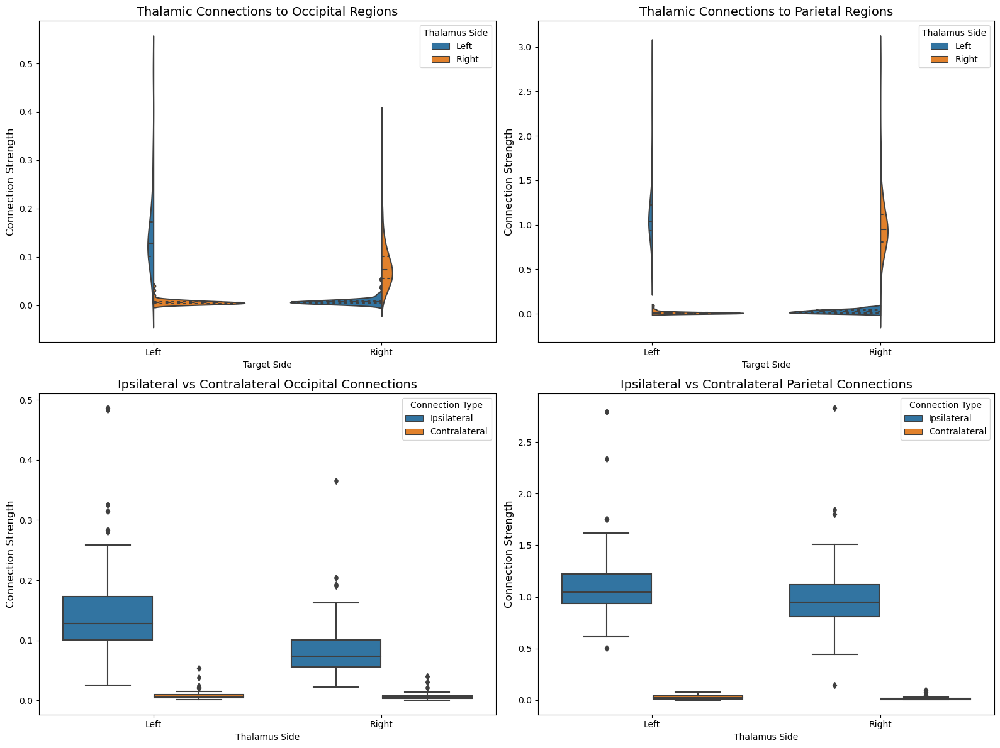


Statistical Analysis of Thalamic Connections

A. Ipsilateral vs Contralateral Comparisons Within Each Hemisphere:
--------------------------------------------------------------------------------
Left Thalamus to Occipital Regions:
  Ipsilateral: Mean = 0.1476, SD = 0.0835, n = 73
  Contralateral: Mean = 0.0087, SD = 0.0077, n = 73
  Paired t-test: t = 14.3365, p = 0.0000 *
  Effect size (Cohen's d): 2.3271
  Ipsilateral connections are stronger

Right Thalamus to Occipital Regions:
  Ipsilateral: Mean = 0.0854, SD = 0.0516, n = 73
  Contralateral: Mean = 0.0068, SD = 0.0060, n = 73
  Paired t-test: t = 13.3337, p = 0.0000 *
  Effect size (Cohen's d): 2.1247
  Ipsilateral connections are stronger

Left Thalamus to Parietal Regions:
  Ipsilateral: Mean = 1.1109, SD = 0.3412, n = 73
  Contralateral: Mean = 0.0280, SD = 0.0202, n = 73
  Paired t-test: t = 27.1706, p = 0.0000 *
  Effect size (Cohen's d): 4.4503
  Ipsilateral connections are stronger

Right Thalamus to Parietal Regions:
  I

<Figure size 1200x600 with 0 Axes>

<Figure size 1200x600 with 0 Axes>

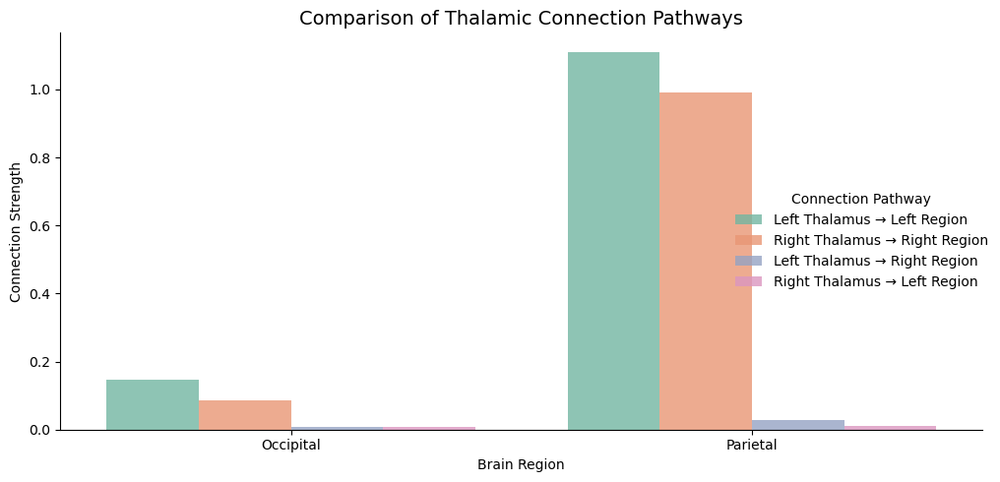


Conclusion:
--------------------------------------------------------------------------------
Occipital Regions:
  Left thalamic connections to left occipital regions are significantly stronger than
  right thalamic connections to right occipital regions (p=0.0000).

Parietal Regions:
  Left thalamic connections to left parietal regions are significantly stronger than
  right thalamic connections to right parietal regions (p=0.0000).



In [5]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy import stats
import pandas as pd
from statsmodels.stats.multitest import multipletests

def get_thalamic_occipital_parietal_connections(connectome_files):
    """
    Extract thalamic connections to occipital and parietal regions from connectome files.
    
    Parameters:
    -----------
    connectome_files : list
        List of paths to connectome CSV files
        
    Returns:
    --------
    dict
        Dictionary containing connection data and subject IDs
    """
    # Dictionary to store connections
    connections = {
        'subject_ids': [],
        'left_thal_to_left_occ': [],
        'left_thal_to_right_occ': [],
        'right_thal_to_left_occ': [],
        'right_thal_to_right_occ': [],
        'left_thal_to_left_par': [],
        'left_thal_to_right_par': [],
        'right_thal_to_left_par': [],
        'right_thal_to_right_par': []
    }
    
    if not connectome_files:
        print("No connectome files found!")
        return connections
    
    print(f"Processing {len(connectome_files)} connectome files...")
    
    for file_path in connectome_files:
        try:
            # Extract subject ID from file path
            parts = file_path.split(os.sep)
            subject_id = parts[-5].replace('sub-', '')  # Extract subject ID from path
            
            connectome = pd.read_csv(file_path, header=None)
            print(f"Successfully loaded: {file_path}")
            
            # Define indices (adjusting for 0-based indexing)
            left_thal_idx = 37 - 1  # = 36
            right_thal_idx = 42 - 1  # = 41
            left_occ_idx = 16 - 1   # = 15
            right_occ_idx = 15 - 1  # = 14
            left_par_idx = 32 - 1   # = 31
            right_par_idx = 31 - 1  # = 30
            
            # Extract specific connections
            connections['subject_ids'].append(subject_id)
            
            # Thalamo-occipital connections
            connections['left_thal_to_left_occ'].append(connectome.iloc[left_thal_idx, left_occ_idx])
            connections['left_thal_to_right_occ'].append(connectome.iloc[left_thal_idx, right_occ_idx])
            connections['right_thal_to_left_occ'].append(connectome.iloc[right_thal_idx, left_occ_idx])
            connections['right_thal_to_right_occ'].append(connectome.iloc[right_thal_idx, right_occ_idx])
            
            # Thalamo-parietal connections
            connections['left_thal_to_left_par'].append(connectome.iloc[left_thal_idx, left_par_idx])
            connections['left_thal_to_right_par'].append(connectome.iloc[left_thal_idx, right_par_idx])
            connections['right_thal_to_left_par'].append(connectome.iloc[right_thal_idx, left_par_idx])
            connections['right_thal_to_right_par'].append(connectome.iloc[right_thal_idx, right_par_idx])
            
        except Exception as e:
            print(f"Error processing file {file_path}: {str(e)}")
            continue
    
    return connections

# Get thalamic-occipital and thalamic-parietal connections
connections = get_thalamic_occipital_parietal_connections(connectome_files)

if len(connections['subject_ids']) > 0:  # Check if we have data
    # Convert connection data to a format suitable for visualization
    plot_data = []
    
    # Process occipital connections
    for i, subject_id in enumerate(connections['subject_ids']):
        # Left thalamus to occipital regions
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Occipital', 
            'Target Side': 'Left',
            'Connection Strength': connections['left_thal_to_left_occ'][i], 
            'Thalamus Side': 'Left',
            'Connection Type': 'Ipsilateral' if 'Left' == 'Left' else 'Contralateral'
        })
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Occipital', 
            'Target Side': 'Right',
            'Connection Strength': connections['left_thal_to_right_occ'][i], 
            'Thalamus Side': 'Left',
            'Connection Type': 'Ipsilateral' if 'Left' == 'Right' else 'Contralateral'
        })
        
        # Right thalamus to occipital regions
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Occipital', 
            'Target Side': 'Left',
            'Connection Strength': connections['right_thal_to_left_occ'][i], 
            'Thalamus Side': 'Right',
            'Connection Type': 'Ipsilateral' if 'Right' == 'Left' else 'Contralateral'
        })
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Occipital', 
            'Target Side': 'Right',
            'Connection Strength': connections['right_thal_to_right_occ'][i], 
            'Thalamus Side': 'Right',
            'Connection Type': 'Ipsilateral' if 'Right' == 'Right' else 'Contralateral'
        })
        
        # Left thalamus to parietal regions
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Parietal', 
            'Target Side': 'Left',
            'Connection Strength': connections['left_thal_to_left_par'][i], 
            'Thalamus Side': 'Left',
            'Connection Type': 'Ipsilateral' if 'Left' == 'Left' else 'Contralateral'
        })
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Parietal', 
            'Target Side': 'Right',
            'Connection Strength': connections['left_thal_to_right_par'][i], 
            'Thalamus Side': 'Left',
            'Connection Type': 'Ipsilateral' if 'Left' == 'Right' else 'Contralateral'
        })
        
        # Right thalamus to parietal regions
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Parietal', 
            'Target Side': 'Left',
            'Connection Strength': connections['right_thal_to_left_par'][i], 
            'Thalamus Side': 'Right',
            'Connection Type': 'Ipsilateral' if 'Right' == 'Left' else 'Contralateral'
        })
        plot_data.append({
            'Subject': subject_id,
            'Region': 'Parietal', 
            'Target Side': 'Right',
            'Connection Strength': connections['right_thal_to_right_par'][i], 
            'Thalamus Side': 'Right',
            'Connection Type': 'Ipsilateral' if 'Right' == 'Right' else 'Contralateral'
        })
    
    # Fix Connection Type based on Target Side and Thalamus Side
    for i, row in enumerate(plot_data):
        plot_data[i]['Connection Type'] = 'Ipsilateral' if row['Target Side'] == row['Thalamus Side'] else 'Contralateral'
    
    # Convert to DataFrame
    plot_df = pd.DataFrame(plot_data)
    
    # 1. Visualization: Thalamic connections to occipital and parietal regions
    plt.figure(figsize=(14, 10))
    
    # Create a 2x2 grid of subplots
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # 1. Thalamo-occipital connections
    sns.violinplot(
        data=plot_df[plot_df['Region'] == 'Occipital'], 
        x='Target Side', y='Connection Strength', hue='Thalamus Side',
        split=True, inner='quartile', ax=axes[0, 0]
    )
    axes[0, 0].set_title('Thalamic Connections to Occipital Regions', fontsize=14)
    axes[0, 0].set_ylabel('Connection Strength', fontsize=12)
    
    # 2. Thalamo-parietal connections
    sns.violinplot(
        data=plot_df[plot_df['Region'] == 'Parietal'], 
        x='Target Side', y='Connection Strength', hue='Thalamus Side',
        split=True, inner='quartile', ax=axes[0, 1]
    )
    axes[0, 1].set_title('Thalamic Connections to Parietal Regions', fontsize=14)
    axes[0, 1].set_ylabel('Connection Strength', fontsize=12)
    
    # 3. Ipsilateral vs Contralateral - Occipital
    sns.boxplot(
        data=plot_df[plot_df['Region'] == 'Occipital'], 
        x='Thalamus Side', y='Connection Strength', hue='Connection Type', 
        ax=axes[1, 0]
    )
    axes[1, 0].set_title('Ipsilateral vs Contralateral Occipital Connections', fontsize=14)
    axes[1, 0].set_ylabel('Connection Strength', fontsize=12)
    
    # 4. Ipsilateral vs Contralateral - Parietal
    sns.boxplot(
        data=plot_df[plot_df['Region'] == 'Parietal'], 
        x='Thalamus Side', y='Connection Strength', hue='Connection Type', 
        ax=axes[1, 1]
    )
    axes[1, 1].set_title('Ipsilateral vs Contralateral Parietal Connections', fontsize=14)
    axes[1, 1].set_ylabel('Connection Strength', fontsize=12)
    
    plt.tight_layout()
    plt.show()
    
    # 2. Statistical Analysis
    print("\nStatistical Analysis of Thalamic Connections")
    print("=" * 80)
    
    # A. Compare ipsilateral vs contralateral connections within each hemisphere
    print("\nA. Ipsilateral vs Contralateral Comparisons Within Each Hemisphere:")
    print("-" * 80)
    
    # For each region type and thalamus side
    for region in ['Occipital', 'Parietal']:
        for thalamus in ['Left', 'Right']:
            # Get ipsi and contra connections
            ipsi_data = plot_df[(plot_df['Region'] == region) & 
                               (plot_df['Thalamus Side'] == thalamus) & 
                               (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].values
            
            contra_data = plot_df[(plot_df['Region'] == region) & 
                                (plot_df['Thalamus Side'] == thalamus) & 
                                (plot_df['Connection Type'] == 'Contralateral')]['Connection Strength'].values
            
            if len(ipsi_data) > 0 and len(contra_data) > 0:
                # Perform paired t-test if possible
                if len(ipsi_data) == len(contra_data):
                    stat, p_value = stats.ttest_rel(ipsi_data, contra_data)
                    test_name = "Paired t-test"
                else:
                    stat, p_value = stats.ttest_ind(ipsi_data, contra_data, equal_var=False)
                    test_name = "Welch's t-test"
                
                # Calculate effect size
                effect_size = (np.mean(ipsi_data) - np.mean(contra_data)) / np.sqrt(
                    (np.std(ipsi_data, ddof=1)**2 + np.std(contra_data, ddof=1)**2) / 2
                )
                
                # Print results
                print(f"{thalamus} Thalamus to {region} Regions:")
                print(f"  Ipsilateral: Mean = {np.mean(ipsi_data):.4f}, SD = {np.std(ipsi_data):.4f}, n = {len(ipsi_data)}")
                print(f"  Contralateral: Mean = {np.mean(contra_data):.4f}, SD = {np.std(contra_data):.4f}, n = {len(contra_data)}")
                print(f"  {test_name}: t = {stat:.4f}, p = {p_value:.4f} {'*' if p_value < 0.05 else ''}")
                print(f"  Effect size (Cohen's d): {effect_size:.4f}")
                print(f"  {'Ipsilateral' if effect_size > 0 else 'Contralateral'} connections are stronger")
                print()
    
    # B. Compare left vs right hemisphere for ipsilateral connections
    print("\nB. Left vs Right Hemisphere Comparison for Ipsilateral Connections:")
    print("-" * 80)
    
    # For occipital and parietal regions
    for region in ['Occipital', 'Parietal']:
        # Get left and right ipsilateral connections
        left_ipsi = plot_df[(plot_df['Region'] == region) & 
                          (plot_df['Thalamus Side'] == 'Left') & 
                          (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].values
        
        right_ipsi = plot_df[(plot_df['Region'] == region) & 
                           (plot_df['Thalamus Side'] == 'Right') & 
                           (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].values
        
        if len(left_ipsi) > 0 and len(right_ipsi) > 0:
            # Perform paired t-test if possible
            if len(left_ipsi) == len(right_ipsi):
                stat, p_value = stats.ttest_rel(left_ipsi, right_ipsi)
                test_name = "Paired t-test"
            else:
                stat, p_value = stats.ttest_ind(left_ipsi, right_ipsi, equal_var=False)
                test_name = "Welch's t-test"
            
            # Calculate effect size
            effect_size = (np.mean(left_ipsi) - np.mean(right_ipsi)) / np.sqrt(
                (np.std(left_ipsi, ddof=1)**2 + np.std(right_ipsi, ddof=1)**2) / 2
            )
            
            # Calculate asymmetry index
            asymmetry_index = ((np.mean(left_ipsi) - np.mean(right_ipsi)) / 
                              ((np.mean(left_ipsi) + np.mean(right_ipsi)) / 2) * 100)
            
            # Print results
            print(f"{region} Regions - Ipsilateral Connections:")
            print(f"  Left Thalamus → Left {region}: Mean = {np.mean(left_ipsi):.4f}, SD = {np.std(left_ipsi):.4f}, n = {len(left_ipsi)}")
            print(f"  Right Thalamus → Right {region}: Mean = {np.mean(right_ipsi):.4f}, SD = {np.std(right_ipsi):.4f}, n = {len(right_ipsi)}")
            print(f"  {test_name}: t = {stat:.4f}, p = {p_value:.4f} {'*' if p_value < 0.05 else ''}")
            print(f"  Effect size (Cohen's d): {effect_size:.4f}")
            print(f"  Asymmetry Index: {asymmetry_index:.2f}%")
            print(f"  {'Left' if effect_size > 0 else 'Right'} hemisphere shows stronger ipsilateral connections")
            print()
    
    # C. Summary visualization of hemispheric differences
    plt.figure(figsize=(12, 6))
    
    # Create dataset for comparison
    comparison_data = []
    
    for region in ['Occipital', 'Parietal']:
        # Calculate means for each hemisphere and connection type
        left_ipsi_mean = plot_df[(plot_df['Region'] == region) & 
                               (plot_df['Thalamus Side'] == 'Left') & 
                               (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].mean()
        
        right_ipsi_mean = plot_df[(plot_df['Region'] == region) & 
                                (plot_df['Thalamus Side'] == 'Right') & 
                                (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].mean()
        
        left_contra_mean = plot_df[(plot_df['Region'] == region) & 
                                 (plot_df['Thalamus Side'] == 'Left') & 
                                 (plot_df['Connection Type'] == 'Contralateral')]['Connection Strength'].mean()
        
        right_contra_mean = plot_df[(plot_df['Region'] == region) & 
                                  (plot_df['Thalamus Side'] == 'Right') & 
                                  (plot_df['Connection Type'] == 'Contralateral')]['Connection Strength'].mean()
        
        # Add to comparison data
        comparison_data.append({
            'Region': region,
            'Connection': 'Left Thalamus → Left Region',
            'Strength': left_ipsi_mean,
            'Type': 'Ipsilateral'
        })
        comparison_data.append({
            'Region': region,
            'Connection': 'Right Thalamus → Right Region',
            'Strength': right_ipsi_mean,
            'Type': 'Ipsilateral'
        })
        comparison_data.append({
            'Region': region,
            'Connection': 'Left Thalamus → Right Region',
            'Strength': left_contra_mean,
            'Type': 'Contralateral'
        })
        comparison_data.append({
            'Region': region,
            'Connection': 'Right Thalamus → Left Region',
            'Strength': right_contra_mean,
            'Type': 'Contralateral'
        })
    
    # Convert to DataFrame
    comparison_df = pd.DataFrame(comparison_data)
    
    # Create the plot
    plt.figure(figsize=(12, 6))
    
    # Bar plot of all connection types
    g = sns.catplot(
        data=comparison_df, kind="bar",
        x="Region", y="Strength", hue="Connection",
        palette="Set2", alpha=.8, height=5, aspect=1.5
    )
    g.set_axis_labels("Brain Region", "Connection Strength")
    g.legend.set_title("Connection Pathway")
    plt.title('Comparison of Thalamic Connection Pathways', fontsize=14)
    plt.tight_layout()
    plt.show()
    
    # Print conclusion
    print("\nConclusion:")
    print("-" * 80)
    
    for region in ['Occipital', 'Parietal']:
        # Get ipsilateral connections for statistical tests
        left_ipsi = plot_df[(plot_df['Region'] == region) & 
                          (plot_df['Thalamus Side'] == 'Left') & 
                          (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].values
        
        right_ipsi = plot_df[(plot_df['Region'] == region) & 
                           (plot_df['Thalamus Side'] == 'Right') & 
                           (plot_df['Connection Type'] == 'Ipsilateral')]['Connection Strength'].values
        
        if len(left_ipsi) > 0 and len(right_ipsi) > 0:
            # Perform test
            if len(left_ipsi) == len(right_ipsi):
                _, p_value = stats.ttest_rel(left_ipsi, right_ipsi)
            else:
                _, p_value = stats.ttest_ind(left_ipsi, right_ipsi, equal_var=False)
                
            # Calculate means
            left_mean = np.mean(left_ipsi)
            right_mean = np.mean(right_ipsi)
            
            # Print conclusion
            print(f"{region} Regions:")
            if p_value < 0.05:
                if left_mean > right_mean:
                    print(f"  Left thalamic connections to left {region.lower()} regions are significantly stronger than")
                    print(f"  right thalamic connections to right {region.lower()} regions (p={p_value:.4f}).")
                else:
                    print(f"  Right thalamic connections to right {region.lower()} regions are significantly stronger than")
                    print(f"  left thalamic connections to left {region.lower()} regions (p={p_value:.4f}).")
            else:
                print(f"  No significant hemispheric difference in ipsilateral thalamic connections to {region.lower()} regions (p={p_value:.4f}).")
            print()
else:
    print("Unable to create analysis due to insufficient data.")

Found 146 connectome files
After filtering: 73 true connectome files
Loaded 46 region labels
Extracted connections for 73 subjects
0   CODE                  DOB SEX (M/F) S/T  GW PLUS DAYS BIRTH WEIGHT  \
0    001  2021-02-08 00:00:00         M   S  30         2         1500   
1    002  2021-01-04 00:00:00         M   S  26         0          680   
2    003  2021-04-28 00:00:00         F   S  31         1         1454   
3    004  2021-05-02 00:00:00         M   S  31         1         1250   
4    005  2021-05-15 00:00:00         F   S  32         0         1500   
5    006  2021-04-11 00:00:00         M   S  25         5          810   
6    007  2021-06-03 00:00:00         F   S  32         0         1480   
7    008  2021-05-16 00:00:00         F   S  28         6          880   
8    009  2021-06-24 00:00:00         F   T  32         1         1570   
9    010  2021-06-24 00:00:00         F   T  32         1         1720   
10   011  2021-06-15 00:00:00         M   S  31        

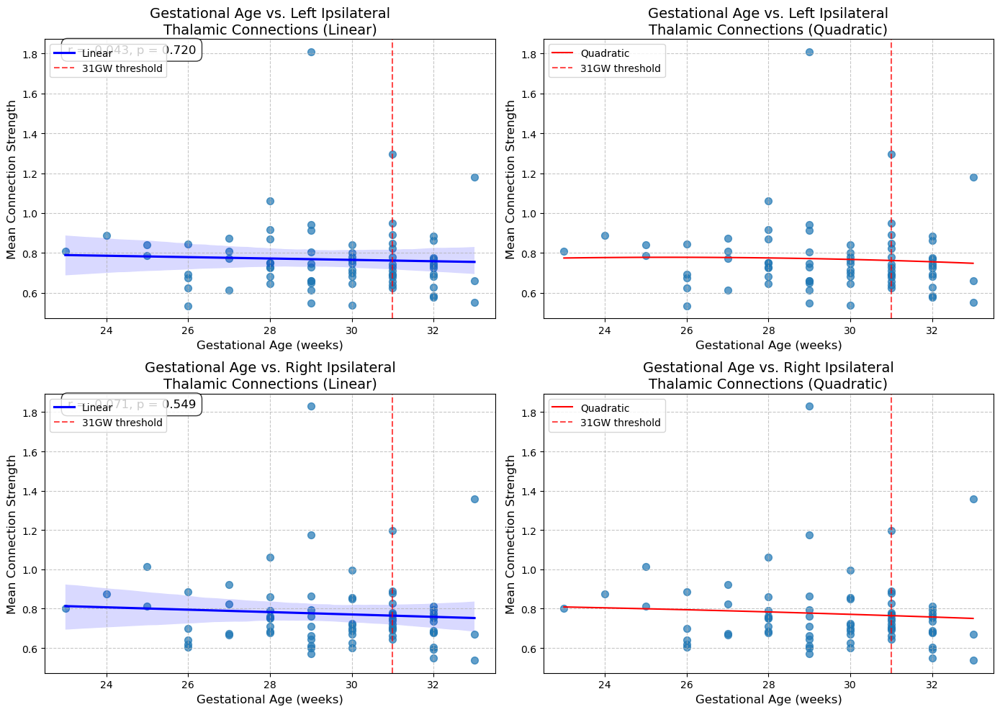

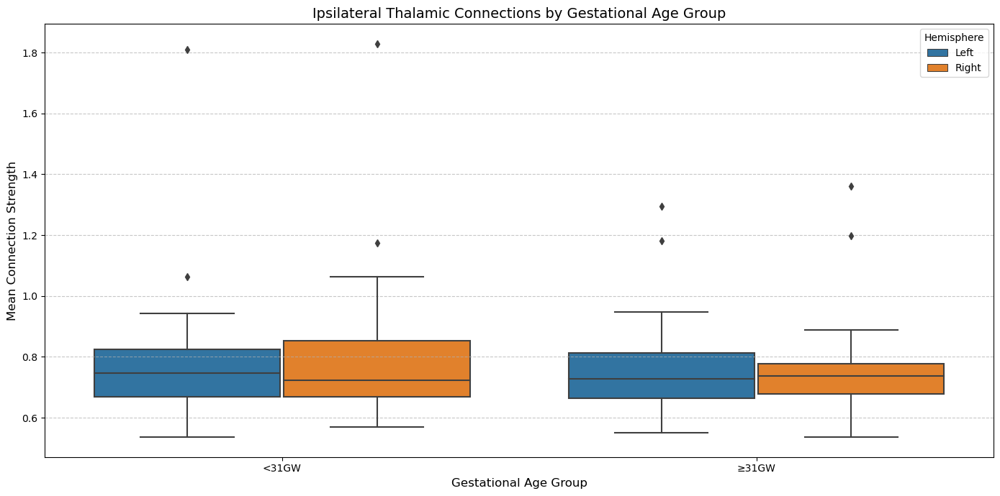


Statistical Analysis of Age Group Differences:

Left hemisphere ipsilateral connections by age group:
  <31GW (n=43): 0.7717 ± 0.1974
  ≥31GW (n=30): 0.7604 ± 0.1626
  Independent t-test: t = 0.2688, p = 0.7889 

Right hemisphere ipsilateral connections by age group:
  <31GW (n=43): 0.7846 ± 0.2111
  ≥31GW (n=30): 0.7573 ± 0.1662
  Independent t-test: t = 0.6179, p = 0.5386 

Regression Analysis of Overall Ipsilateral Connections:

Left Hemisphere Ipsilateral Connections:
  Linear model:
    R-squared: 0.0018
    F-statistic: 0.1299, p-value: 0.7196
    Coefficient for gestational age: -0.0034, p-value: 0.7196
  Quadratic model:
    R-squared: 0.0022
    F-statistic: 0.0758, p-value: 0.9271
    Linear term: 0.0278, p-value: 0.8920
    Quadratic term: -0.0005, p-value: 0.8786
    ⇒ Quadratic model explains 0.03% more variance

Right Hemisphere Ipsilateral Connections:
  Linear model:
    R-squared: 0.0051
    F-statistic: 0.3619, p-value: 0.5494
    Coefficient for gestational age: -0.

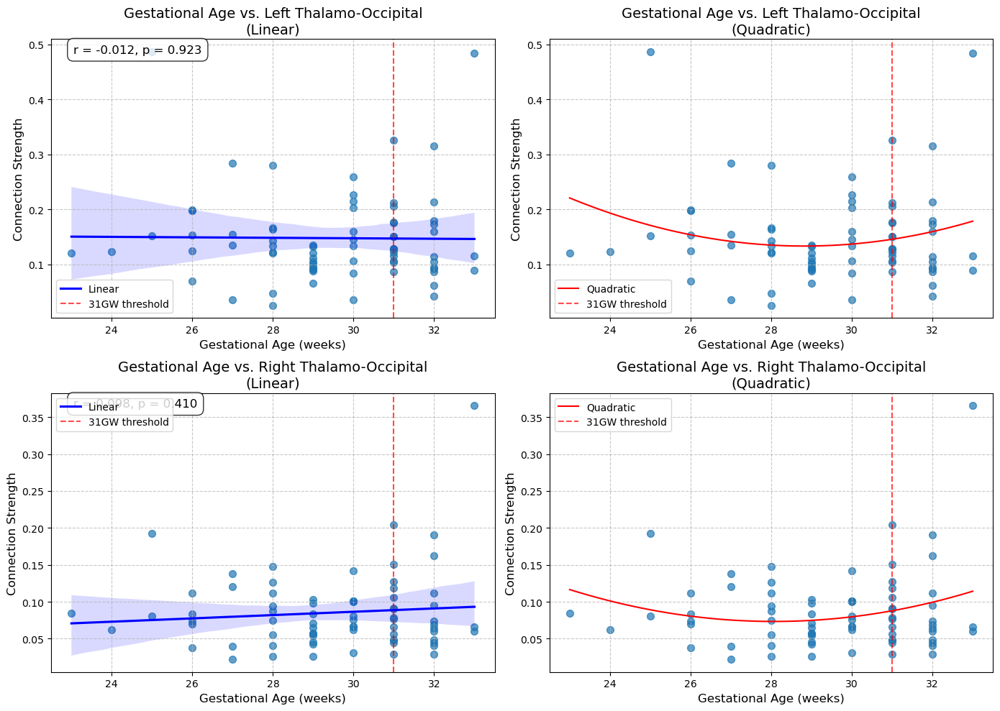

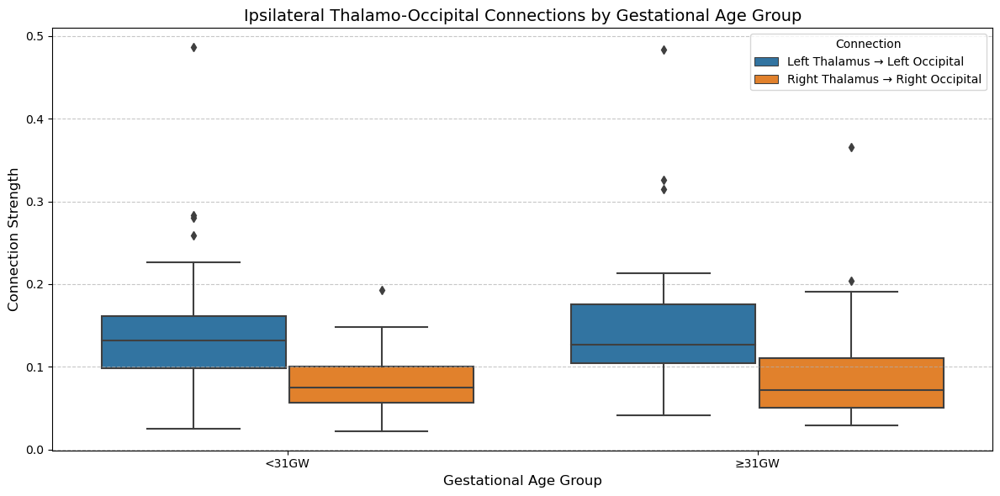


Statistical Analysis of Thalamo-Occipital Connections:

Left Thalamo-Occipital connections by age group:
  <31GW (n=43): 0.1427 ± 0.0808
  ≥31GW (n=30): 0.1545 ± 0.0895
  Independent t-test: t = -0.5753, p = 0.5673 

Right Thalamo-Occipital connections by age group:
  <31GW (n=43): 0.0795 ± 0.0364
  ≥31GW (n=30): 0.0940 ± 0.0682
  Independent t-test: t = -1.0636, p = 0.2938 

Regression Analysis of Thalamo-Occipital Connections:

Left Thalamo-Occipital Connections:
  Linear model:
    R-squared: 0.0001
    F-statistic: 0.0094, p-value: 0.9229
    Coefficient for gestational age: -0.0004, p-value: 0.9229
    Intercept: 0.1602, p-value: 0.2226
  Quadratic model:
    R-squared: 0.0359
    F-statistic: 1.3035, p-value: 0.2781
    Linear term: -0.1490, p-value: 0.1109
    Quadratic term: 0.0026, p-value: 0.1115
    Intercept: 2.2799, p-value: 0.0889
    ⇒ Quadratic model explains 3.58% more variance

Right Thalamo-Occipital Connections:
  Linear model:
    R-squared: 0.0096
    F-statistic

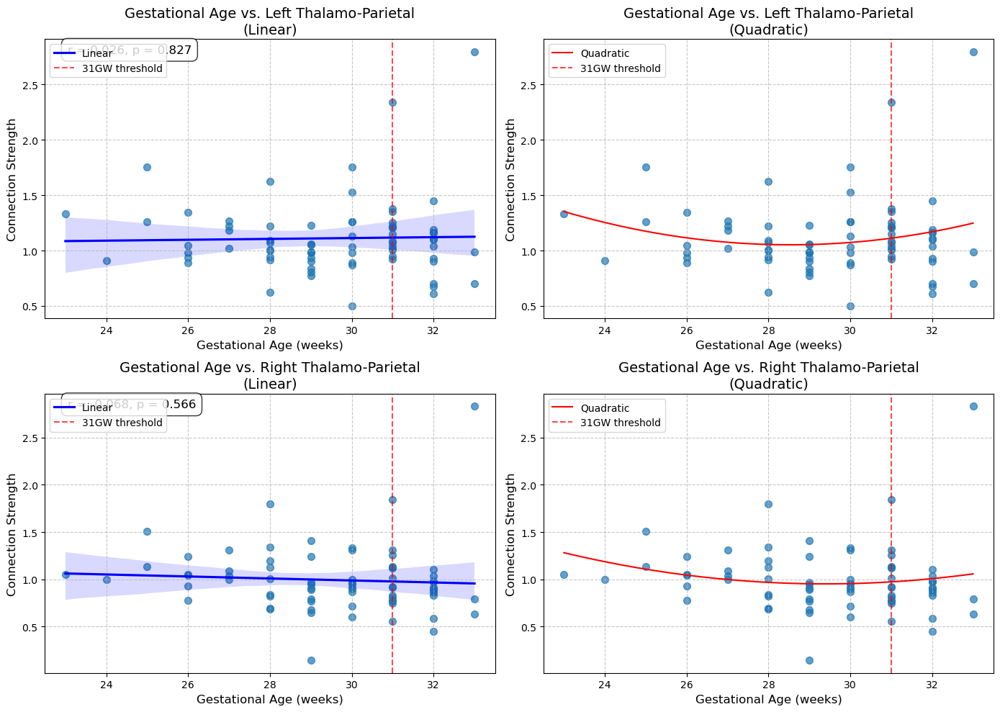

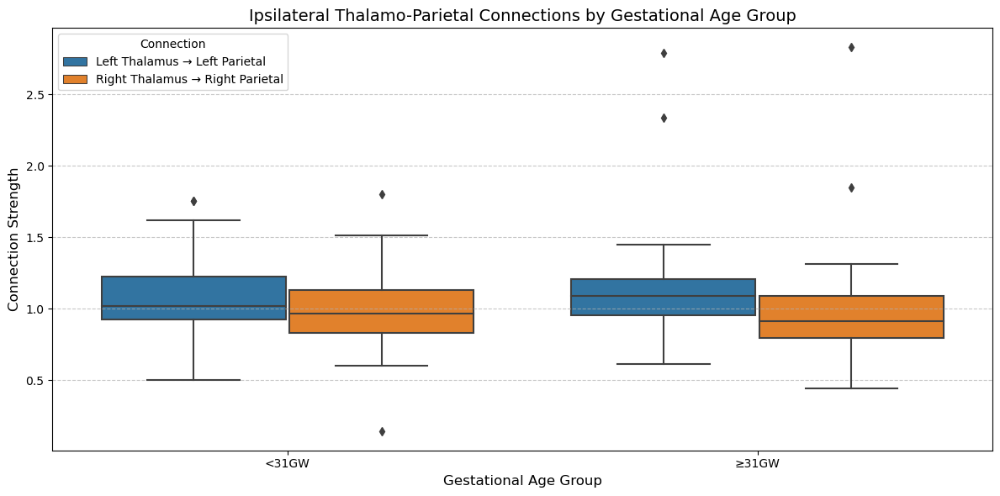


Statistical Analysis of Thalamo-Parietal Connections:

Left Thalamo-Parietal connections by age group:
  <31GW (n=43): 1.0789 ± 0.2607
  ≥31GW (n=30): 1.1569 ± 0.4369
  Independent t-test: t = -0.8756, p = 0.3861 

Right Thalamo-Parietal connections by age group:
  <31GW (n=43): 0.9907 ± 0.2832
  ≥31GW (n=30): 0.9949 ± 0.4352
  Independent t-test: t = -0.0465, p = 0.9631 

Regression Analysis of Thalamo-Parietal Connections:

Left Thalamo-Parietal Connections:
  Linear model:
    R-squared: 0.0007
    F-statistic: 0.0480, p-value: 0.8273
    Coefficient for gestational age: 0.0039, p-value: 0.8273
    Intercept: 0.9948, p-value: 0.0655
  Quadratic model:
    R-squared: 0.0314
    F-statistic: 1.1360, p-value: 0.3270
    Linear term: -0.5590, p-value: 0.1436
    Quadratic term: 0.0098, p-value: 0.1405
    Intercept: 9.0270, p-value: 0.0998
    ⇒ Quadratic model explains 3.08% more variance

Right Thalamo-Parietal Connections:
  Linear model:
    R-squared: 0.0047
    F-statistic: 0.332

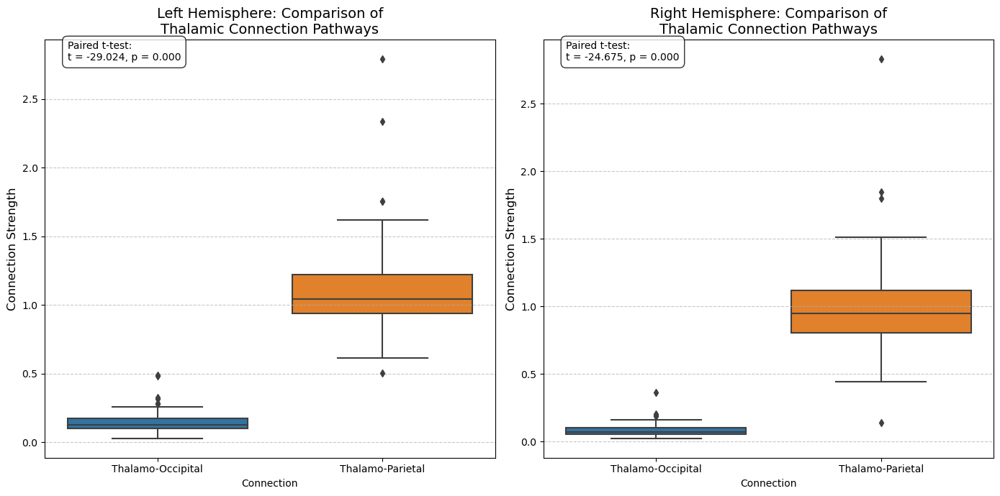

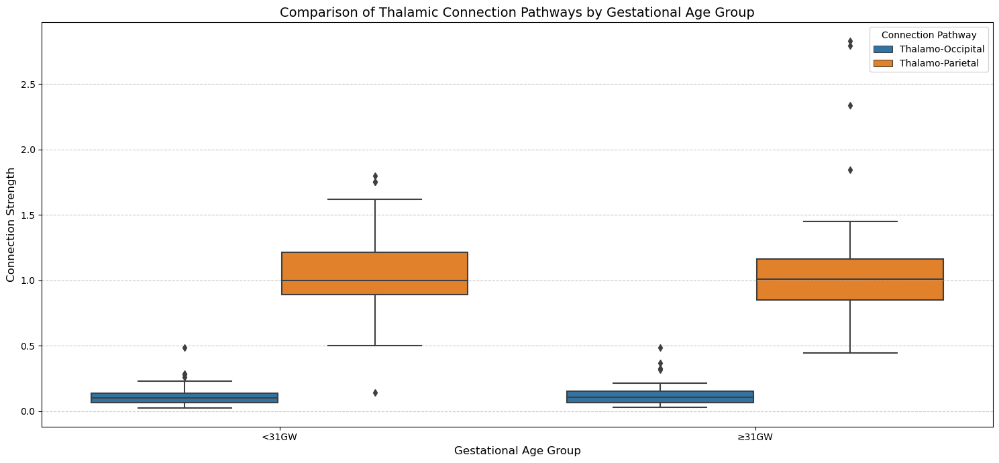


Statistical Comparison of Pathways Within Age Groups:

Early group (<31GW) - Left Hemisphere Pathway Comparison:
  Thalamo-Occipital: 0.1427 ± 0.0808
  Thalamo-Parietal: 1.0789 ± 0.2607
  Paired t-test: t = -28.1598, p = 0.0000 *

Early group (<31GW) - Right Hemisphere Pathway Comparison:
  Thalamo-Occipital: 0.0795 ± 0.0364
  Thalamo-Parietal: 0.9907 ± 0.2832
  Paired t-test: t = -22.7095, p = 0.0000 *

Late group (≥31GW) - Left Hemisphere Pathway Comparison:
  Thalamo-Occipital: 0.1545 ± 0.0895
  Thalamo-Parietal: 1.1569 ± 0.4369
  Paired t-test: t = -15.3354, p = 0.0000 *

Late group (≥31GW) - Right Hemisphere Pathway Comparison:
  Thalamo-Occipital: 0.0940 ± 0.0682
  Thalamo-Parietal: 0.9949 ± 0.4352
  Paired t-test: t = -12.9793, p = 0.0000 *

CORRELATION ANALYSIS BETWEEN PATHWAYS

Correlation between thalamo-occipital and thalamo-parietal connections:
  Left hemisphere: r = 0.7731, p = 0.0000 *
  Right hemisphere: r = 0.7438, p = 0.0000 *


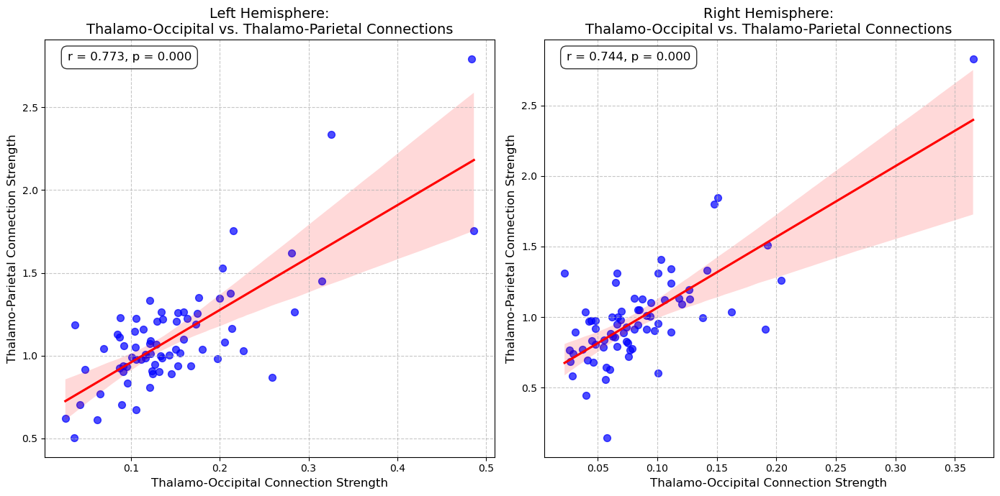


DEVELOPMENTAL TRAJECTORY ANALYSIS

Developmental slopes by pathway and hemisphere:
  Left Thalamo-Occipital: -0.000427 (p=0.9229)
  Left Thalamo-Parietal: 0.003936 (p=0.8273)
  Right Thalamo-Occipital: 0.002242 (p=0.4102)
  Right Thalamo-Parietal: -0.010568 (p=0.5658)

Relative developmental rates (Occipital/Parietal):
  Left hemisphere: Thalamo-Parietal pathway develops -9.21x faster than Thalamo-Occipital
  Right hemisphere: Thalamo-Parietal pathway develops -4.71x faster than Thalamo-Occipital


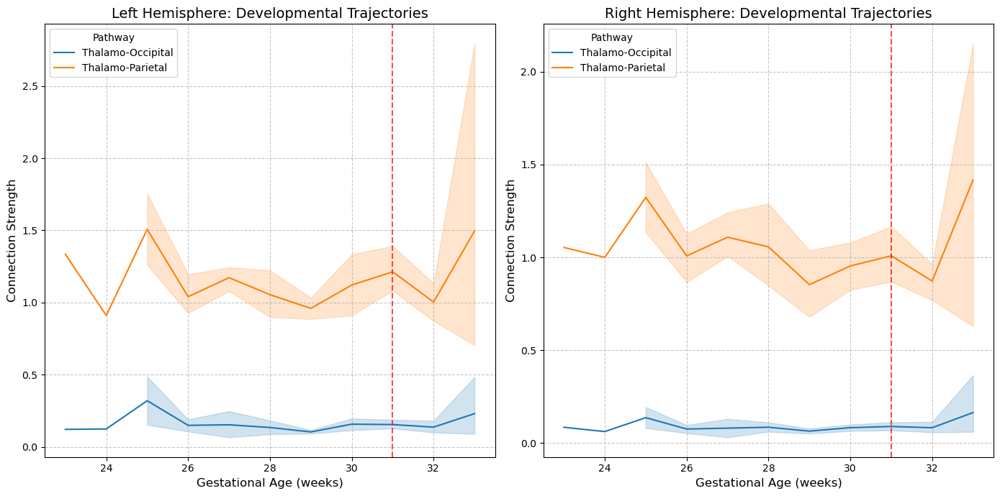


STUDY CONCLUSIONS

Sample Characteristics:
- Analysis included 73 subjects
- Gestational age range: 23.0-33.0 weeks
- Gestational age groups: <31GW (n=43), ≥31GW (n=30)

Key Findings - Age Group Differences:
1. Left ipsilateral thalamic connections:
   - -1.5% decrease from <31GW to ≥31GW
   - Statistical significance: NO (p=0.7889)

2. Right ipsilateral thalamic connections:
   - -3.5% decrease from <31GW to ≥31GW
   - Statistical significance: NO (p=0.5386)

Key Findings - Thalamo-Occipital vs. Thalamo-Parietal Pathway Comparison:
1. Left hemisphere pathway comparison:
   - Thalamo-Occipital connections are 86.7% weaker than Thalamo-Parietal connections
   - Statistical significance: YES (p=0.0)

2. Right hemisphere pathway comparison:
   - Thalamo-Occipital connections are 91.4% weaker than Thalamo-Parietal connections
   - Statistical significance: YES (p=0.0)

Key Findings - Gestational Age Effects (Linear vs. Quadratic):
1. Overall ipsilateral connections:
   - Left hemisphere: 

In [6]:
import re
import statsmodels.api as sm
# Define the gestational age cutoff as a global variable
GESTATIONAL_AGE_CUTOFF = 31  # You can change this to any value you want to try

# Extract thalamic connections from connectome files
def extract_thalamic_connections(connectome_files):
    """
    Extract thalamic connections from connectome files
    with focus on ipsilateral connections to all regions
    and specific focus on occipital and parietal regions
    """
    # Dictionary to store connections
    connections = {
        'subject_id': [],
        'session': [],
        # Thalamo-occipital connections
        'left_thal_to_left_occ': [],
        'left_thal_to_right_occ': [],
        'right_thal_to_left_occ': [],
        'right_thal_to_right_occ': [],
        # Thalamo-parietal connections
        'left_thal_to_left_par': [],
        'left_thal_to_right_par': [],
        'right_thal_to_left_par': [],
        'right_thal_to_right_par': [],
        # All ipsilateral connections (will be calculated later)
        'left_ipsilateral_mean': [],
        'right_ipsilateral_mean': []
    }
    
    # Process each connectome file
    for file_path in connectome_files:
        try:
            # Skip assignment files and only process actual connectome files
            if "assignments" in file_path:
                continue
                
            # Extract subject ID and session from file path
            parts = file_path.split(os.sep)
            
            # Better extraction of subject_id from path using regex
            subject_match = re.search(r'sub-([^_/]+)', file_path)
            if subject_match:
                subject_id = subject_match.group(1)  # Extract just the ID part
            else:
                subject_id = parts[-5].replace('sub-', '')
                
            session_match = re.search(r'ses-([^_/]+)', file_path)
            if session_match:
                session = session_match.group(1)
            else:
                session = parts[-4].replace('ses-', '')
            
            # Load connectome
            connectome = pd.read_csv(file_path, header=None)
            
            # Check if the connectome has the expected dimensions
            if connectome.shape[0] < 46 or connectome.shape[1] < 46:
                print(f"Warning: Connectome matrix has unexpected dimensions: {connectome.shape} for {subject_id}")
                continue
            
            # Define indices for regions (adjusting for 0-based indexing)
            left_thal_idx = 37 - 1  # = 36
            right_thal_idx = 42 - 1  # = 41
            left_occ_idx = 16 - 1   # = 15
            right_occ_idx = 15 - 1  # = 14
            left_par_idx = 32 - 1   # = 31
            right_par_idx = 31 - 1  # = 30
            
            # Calculate left ipsilateral connections (left thalamus to left regions)
            left_ipsilateral = []
            
            # For each ROI, identify if it's a left hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != left_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "left" in region_name.lower():
                        left_ipsilateral.append(connectome.iloc[left_thal_idx, i])
            
            # Calculate right ipsilateral connections (right thalamus to right regions)
            right_ipsilateral = []
            
            # For each ROI, identify if it's a right hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != right_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "right" in region_name.lower():
                        right_ipsilateral.append(connectome.iloc[right_thal_idx, i])
            
            # Store data
            connections['subject_id'].append(subject_id)
            connections['session'].append(session)
            
            # Store specific connections to occipital and parietal regions
            connections['left_thal_to_left_occ'].append(connectome.iloc[left_thal_idx, left_occ_idx])
            connections['left_thal_to_right_occ'].append(connectome.iloc[left_thal_idx, right_occ_idx])
            connections['right_thal_to_left_occ'].append(connectome.iloc[right_thal_idx, left_occ_idx])
            connections['right_thal_to_right_occ'].append(connectome.iloc[right_thal_idx, right_occ_idx])
            
            connections['left_thal_to_left_par'].append(connectome.iloc[left_thal_idx, left_par_idx])
            connections['left_thal_to_right_par'].append(connectome.iloc[left_thal_idx, right_par_idx])
            connections['right_thal_to_left_par'].append(connectome.iloc[right_thal_idx, left_par_idx])
            connections['right_thal_to_right_par'].append(connectome.iloc[right_thal_idx, right_par_idx])
            
            # Store mean ipsilateral connection strengths
            connections['left_ipsilateral_mean'].append(np.mean(left_ipsilateral) if left_ipsilateral else np.nan)
            connections['right_ipsilateral_mean'].append(np.mean(right_ipsilateral) if right_ipsilateral else np.nan)
            
        except Exception as e:
            print(f"Error processing file {file_path}: {str(e)}")
            continue
    
    return pd.DataFrame(connections)

# First, let's fix the search pattern to find actual connectome files
connectome_pattern = os.path.join(
    connectome_base_dir,
    'sub-*',
    'ses-*',
    'dwi/connectome',
    method,
    f'*Connectome.csv'
)
connectome_files = glob.glob(connectome_pattern)
print(f"Found {len(connectome_files)} connectome files")

# Filter out assignment files
true_connectome_files = [f for f in connectome_files if "assignments" not in f]
print(f"After filtering: {len(true_connectome_files)} true connectome files")

# Load label information for region identification
label_path = '/home/perinedo/Projects/Perinedo/code/zagreb_dhcp/label_names/ALBERT/sGM-MCRIB_cGM-ALBERT_Connectome.txt'
labels = {}
try:
    with open(label_path, 'r') as f:
        for line in f:
            if line.strip():
                idx, name = line.strip().split('\t')
                labels[int(idx)] = name.split('-GM')[0] if '-GM' in name else name
    print(f"Loaded {len(labels)} region labels")
except Exception as e:
    print(f"Error loading label file: {str(e)}")
    labels = {}

# Extract connection data
connections_df = extract_thalamic_connections(true_connectome_files)
print(f"Extracted connections for {len(connections_df)} subjects")

# Extract gestational age data
ga_data = pd.DataFrame(patient_df)
print(ga_data)
try:
    # Standardize subject ID format
    ga_data = pd.DataFrame({
        'raw_subject_id': patient_df['CODE'].astype(str),
        'gestational_weeks': patient_df['GW']
    })
    
    # Fix subject ID format for merging
    ga_data['subject_id'] = ga_data['raw_subject_id'].apply(
        lambda x: x if pd.isna(x) else (
            f"PMR{x}" if not str(x).startswith('PMR') else x
        )
    )
    
    # Remove rows with missing data
    ga_data = ga_data[ga_data['subject_id'].notna()]
    ga_data = ga_data[ga_data['gestational_weeks'].notna()]
    
    # Convert to numeric
    ga_data['gestational_weeks'] = pd.to_numeric(ga_data['gestational_weeks'], errors='coerce')
    ga_data = ga_data[ga_data['gestational_weeks'].notna()]
    
    print(f"Extracted gestational age data for {len(ga_data)} subjects")
    
except Exception as e:
    print(f"Error extracting gestational age data: {str(e)}")
    ga_data = pd.DataFrame(columns=['subject_id', 'gestational_weeks'])

# Diagnostic: Check for common subjects before merging
if not connections_df.empty and not ga_data.empty:
    conn_subjects = set(connections_df['subject_id'])
    ga_subjects = set(ga_data['subject_id'])
    common_subjects = conn_subjects.intersection(ga_subjects)
    
    print(f"\nConnection data has {len(conn_subjects)} unique subjects")
    print(f"Gestational age data has {len(ga_subjects)} unique subjects")
    print(f"There are {len(common_subjects)} subjects in common")
    
    if len(common_subjects) == 0:
        print("\nNo common subjects found. Trying numeric ID matching...")
        
        # Extract numeric part of subject IDs
        connections_df['numeric_id'] = connections_df['subject_id'].str.extract(r'(\d+)')
        ga_data['numeric_id'] = ga_data['subject_id'].str.extract(r'(\d+)')
        
        conn_numeric = set(connections_df['numeric_id'])
        ga_numeric = set(ga_data['numeric_id'])
        common_numeric = conn_numeric.intersection(ga_numeric)
        
        print(f"Using numeric portion of IDs: {len(common_numeric)} subjects in common")
        if len(common_numeric) > 0:
            print("Will use numeric ID matching for merging")

# Merge connection data with gestational age data
merged_df = None
if not connections_df.empty and not ga_data.empty:
    if 'numeric_id' in connections_df.columns and 'numeric_id' in ga_data.columns:
        # Merge on numeric ID if available
        merged_df = pd.merge(connections_df, ga_data[['numeric_id', 'gestational_weeks']], 
                            on='numeric_id', how='inner')
    else:
        # Standard merge on subject_id
        merged_df = pd.merge(connections_df, ga_data[['subject_id', 'gestational_weeks']], 
                            on='subject_id', how='inner')
    
    print(f"Successfully merged data for {len(merged_df)} subjects")
    
    # Check if we have enough data to proceed
    if len(merged_df) < 2:
        print("Not enough data for analysis after merging. Check subject IDs and data availability.")
        merged_df = None
    else:
        print("Data ready for analysis")

# Only proceed with analysis if we have merged data
if merged_df is not None and len(merged_df) >= 2:
    # Step 6: Analysis and visualization
    print("\n" + "="*80)
    print("ANALYSIS OF GESTATIONAL AGE VS. THALAMIC CONNECTIONS")
    print("="*80)
    
    # Add squared gestational age for quadratic analysis
    merged_df['gestational_weeks_squared'] = merged_df['gestational_weeks'] ** 2
    
    # 1. Overview statistics
    print("\nDescriptive Statistics:")
    print(f"Gestational age range: {merged_df['gestational_weeks'].min()}-{merged_df['gestational_weeks'].max()} weeks")
    print(f"Mean gestational age: {merged_df['gestational_weeks'].mean():.2f} ± {merged_df['gestational_weeks'].std():.2f} weeks")
    print(f"Mean left ipsilateral connection strength: {merged_df['left_ipsilateral_mean'].mean():.4f} ± {merged_df['left_ipsilateral_mean'].std():.4f}")
    print(f"Mean right ipsilateral connection strength: {merged_df['right_ipsilateral_mean'].mean():.4f} ± {merged_df['right_ipsilateral_mean'].std():.4f}")
    
    # 2. Create binary age groups (using global cutoff variable)
    merged_df['ga_group'] = np.where(
        merged_df['gestational_weeks'] < GESTATIONAL_AGE_CUTOFF, 
        f'<{GESTATIONAL_AGE_CUTOFF}GW', 
        f'≥{GESTATIONAL_AGE_CUTOFF}GW'
    )
    
    # Count subjects in each group
    ga_group_counts = merged_df['ga_group'].value_counts().sort_index()
    print("\nSubjects by gestational age group:")
    for group, count in ga_group_counts.items():
        print(f"  {group}: {count}")
    
    #############################################
    # PART 1: OVERALL IPSILATERAL CONNECTIONS
    #############################################
    
    # Figure 1: Scatter plot with both linear and quadratic regression lines
    plt.figure(figsize=(14, 10))
    
    # Left hemisphere
    plt.subplot(2, 2, 1)
    sns.regplot(x='gestational_weeks', y='left_ipsilateral_mean', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Left Ipsilateral\nThalamic Connections (Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Mean Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    left_corr, left_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['left_ipsilateral_mean'])
    plt.annotate(f'r = {left_corr:.3f}, p = {left_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Left hemisphere with quadratic fit
    plt.subplot(2, 2, 2)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['left_ipsilateral_mean'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['left_ipsilateral_mean']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Left Ipsilateral\nThalamic Connections (Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Mean Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Right hemisphere
    plt.subplot(2, 2, 3)
    sns.regplot(x='gestational_weeks', y='right_ipsilateral_mean', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Right Ipsilateral\nThalamic Connections (Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Mean Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    right_corr, right_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['right_ipsilateral_mean'])
    plt.annotate(f'r = {right_corr:.3f}, p = {right_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Right hemisphere with quadratic fit
    plt.subplot(2, 2, 4)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['right_ipsilateral_mean'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['right_ipsilateral_mean']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Right Ipsilateral\nThalamic Connections (Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Mean Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Figure 2: Box plot of ipsilateral connections by gestational age group
    plt.figure(figsize=(14, 7))
    
    # Create long-form data for seaborn
    ipsi_data = []
    for _, row in merged_df.iterrows():
        ipsi_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Hemisphere': 'Left',
            'Connection Strength': row['left_ipsilateral_mean']
        })
        ipsi_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Hemisphere': 'Right',
            'Connection Strength': row['right_ipsilateral_mean']
        })
    
    ipsi_long_df = pd.DataFrame(ipsi_data)
    
    # Create boxplot
    sns.boxplot(x='GA Group', y='Connection Strength', hue='Hemisphere', data=ipsi_long_df)
    plt.title('Ipsilateral Thalamic Connections by Gestational Age Group', fontsize=14)
    plt.xlabel('Gestational Age Group', fontsize=12)
    plt.ylabel('Mean Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Hemisphere')
    plt.tight_layout()
    plt.show()
    
    # Statistical analysis of age group differences
    print("\nStatistical Analysis of Age Group Differences:")
    
    # T-test for left hemisphere ipsilateral connections between age groups
    left_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['left_ipsilateral_mean']
    left_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['left_ipsilateral_mean']
    
    if len(left_early) > 0 and len(left_late) > 0:
        t_stat, p_val = stats.ttest_ind(left_early, left_late, equal_var=False)
        print(f"\nLeft hemisphere ipsilateral connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_early)}): {left_early.mean():.4f} ± {left_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_late)}): {left_late.mean():.4f} ± {left_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # T-test for right hemisphere ipsilateral connections between age groups
    right_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['right_ipsilateral_mean']
    right_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['right_ipsilateral_mean']
    
    if len(right_early) > 0 and len(right_late) > 0:
        t_stat, p_val = stats.ttest_ind(right_early, right_late, equal_var=False)
        print(f"\nRight hemisphere ipsilateral connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_early)}): {right_early.mean():.4f} ± {right_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_late)}): {right_late.mean():.4f} ± {right_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # Regression analysis for ipsilateral connections
    print("\nRegression Analysis of Overall Ipsilateral Connections:")
    
    # Left hemisphere linear and quadratic models
    print("\nLeft Hemisphere Ipsilateral Connections:")
    
    # Linear model
    X_linear = sm.add_constant(merged_df['gestational_weeks'])
    y = merged_df['left_ipsilateral_mean']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    
    # Quadratic model
    X_quad = sm.add_constant(pd.DataFrame({
        'gestational_weeks': merged_df['gestational_weeks'],
        'gestational_weeks_squared': merged_df['gestational_weeks_squared']
    }))
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    # Right hemisphere linear and quadratic models
    print("\nRight Hemisphere Ipsilateral Connections:")
    
    # Linear model
    y = merged_df['right_ipsilateral_mean']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    
    # Quadratic model
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    #############################################
    # PART 2: THALAMO-OCCIPITAL CONNECTIONS
    #############################################
    
    print("\n" + "="*80)
    print("ANALYSIS OF GESTATIONAL AGE VS. THALAMO-OCCIPITAL CONNECTIONS")
    print("="*80)
    
    # Figure 3: Scatter plot for thalamo-occipital connections with both linear and quadratic fits
    plt.figure(figsize=(14, 10))
    
    # Left ipsilateral (left thalamus to left occipital) - linear
    plt.subplot(2, 2, 1)
    sns.regplot(x='gestational_weeks', y='left_thal_to_left_occ', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Left Thalamo-Occipital\n(Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    left_corr, left_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['left_thal_to_left_occ'])
    plt.annotate(f'r = {left_corr:.3f}, p = {left_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Left ipsilateral - quadratic fit
    plt.subplot(2, 2, 2)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['left_thal_to_left_occ'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['left_thal_to_left_occ']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Left Thalamo-Occipital\n(Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Right ipsilateral (right thalamus to right occipital) - linear
    plt.subplot(2, 2, 3)
    sns.regplot(x='gestational_weeks', y='right_thal_to_right_occ', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Right Thalamo-Occipital\n(Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    right_corr, right_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['right_thal_to_right_occ'])
    plt.annotate(f'r = {right_corr:.3f}, p = {right_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Right ipsilateral - quadratic fit
    plt.subplot(2, 2, 4)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['right_thal_to_right_occ'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['right_thal_to_right_occ']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Right Thalamo-Occipital\n(Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Figure 4: Box plot for thalamo-occipital connections by GA group
    # Create long-form data for thalamo-occipital connections
    occ_data = []
    for _, row in merged_df.iterrows():
        occ_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Connection': 'Left Thalamus → Left Occipital',
            'Type': 'Ipsilateral',
            'Strength': row['left_thal_to_left_occ']
        })
        occ_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Connection': 'Right Thalamus → Right Occipital',
            'Type': 'Ipsilateral',
            'Strength': row['right_thal_to_right_occ']
        })
    
    occ_long_df = pd.DataFrame(occ_data)
    
    # Plot only ipsilateral connections by gestational age group
    plt.figure(figsize=(12, 6))
    sns.boxplot(
        x='GA Group', 
        y='Strength', 
        hue='Connection',
        data=occ_long_df
    )
    plt.title('Ipsilateral Thalamo-Occipital Connections by Gestational Age Group', fontsize=14)
    plt.xlabel('Gestational Age Group', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection')
    plt.tight_layout()
    plt.show()
    
    # Statistical analysis for thalamo-occipital connections
    print("\nStatistical Analysis of Thalamo-Occipital Connections:")
    
    # T-test for left thalamo-occipital connections between age groups
    left_occ_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['left_thal_to_left_occ']
    left_occ_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['left_thal_to_left_occ']
    
    if len(left_occ_early) > 0 and len(left_occ_late) > 0:
        t_stat, p_val = stats.ttest_ind(left_occ_early, left_occ_late, equal_var=False)
        print(f"\nLeft Thalamo-Occipital connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_occ_early)}): {left_occ_early.mean():.4f} ± {left_occ_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_occ_late)}): {left_occ_late.mean():.4f} ± {left_occ_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # T-test for right thalamo-occipital connections between age groups
    right_occ_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['right_thal_to_right_occ']
    right_occ_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['right_thal_to_right_occ']
    
    if len(right_occ_early) > 0 and len(right_occ_late) > 0:
        t_stat, p_val = stats.ttest_ind(right_occ_early, right_occ_late, equal_var=False)
        print(f"\nRight Thalamo-Occipital connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_occ_early)}): {right_occ_early.mean():.4f} ± {right_occ_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_occ_late)}): {right_occ_late.mean():.4f} ± {right_occ_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # Regression analysis for thalamo-occipital connections
    print("\nRegression Analysis of Thalamo-Occipital Connections:")
    
    # Left thalamo-occipital - linear and quadratic models
    print("\nLeft Thalamo-Occipital Connections:")
    
    # Linear model
    X_linear = sm.add_constant(merged_df['gestational_weeks'])
    y = merged_df['left_thal_to_left_occ']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    print(f"    Intercept: {linear_model.params[0]:.4f}, p-value: {linear_model.pvalues[0]:.4f}")
    
    # Quadratic model
    X_quad = sm.add_constant(pd.DataFrame({
        'gestational_weeks': merged_df['gestational_weeks'],
        'gestational_weeks_squared': merged_df['gestational_weeks_squared']
    }))
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    print(f"    Intercept: {quad_model.params[0]:.4f}, p-value: {quad_model.pvalues[0]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    # Right thalamo-occipital - linear and quadratic models
    print("\nRight Thalamo-Occipital Connections:")
    
    # Linear model
    y = merged_df['right_thal_to_right_occ']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    print(f"    Intercept: {linear_model.params[0]:.4f}, p-value: {linear_model.pvalues[0]:.4f}")
    
    # Quadratic model
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    print(f"    Intercept: {quad_model.params[0]:.4f}, p-value: {quad_model.pvalues[0]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    #############################################
    # PART 3: THALAMO-PARIETAL CONNECTIONS
    #############################################
    
    print("\n" + "="*80)
    print("ANALYSIS OF GESTATIONAL AGE VS. THALAMO-PARIETAL CONNECTIONS")
    print("="*80)
    
    # Figure 5: Scatter plot for thalamo-parietal connections with both linear and quadratic fits
    plt.figure(figsize=(14, 10))
    
    # Left ipsilateral (left thalamus to left parietal) - linear
    plt.subplot(2, 2, 1)
    sns.regplot(x='gestational_weeks', y='left_thal_to_left_par', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Left Thalamo-Parietal\n(Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    left_corr, left_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['left_thal_to_left_par'])
    plt.annotate(f'r = {left_corr:.3f}, p = {left_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Left ipsilateral - quadratic fit
    plt.subplot(2, 2, 2)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['left_thal_to_left_par'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['left_thal_to_left_par']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Left Thalamo-Parietal\n(Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Right ipsilateral (right thalamus to right parietal) - linear
    plt.subplot(2, 2, 3)
    sns.regplot(x='gestational_weeks', y='right_thal_to_right_par', data=merged_df, 
                scatter_kws={'alpha':0.7, 's':50}, line_kws={'color':'blue', 'label':'Linear'})
    plt.title('Gestational Age vs. Right Thalamo-Parietal\n(Linear)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    # Add correlation statistics
    right_corr, right_p = stats.pearsonr(merged_df['gestational_weeks'], merged_df['right_thal_to_right_par'])
    plt.annotate(f'r = {right_corr:.3f}, p = {right_p:.3f}', xy=(0.05, 0.95), 
                 xycoords='axes fraction', fontsize=12, 
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Right ipsilateral - quadratic fit
    plt.subplot(2, 2, 4)
    # Scatter plot
    plt.scatter(merged_df['gestational_weeks'], merged_df['right_thal_to_right_par'], alpha=0.7, s=50)
    
    # Quadratic fit
    X = merged_df['gestational_weeks']
    y = merged_df['right_thal_to_right_par']
    
    # Fit a polynomial of degree 2
    z = np.polyfit(X, y, 2)
    p = np.poly1d(z)
    
    # Add the curve
    x_range = np.linspace(X.min(), X.max(), 100)
    plt.plot(x_range, p(x_range), 'r-', label='Quadratic')
    
    plt.title('Gestational Age vs. Right Thalamo-Parietal\n(Quadratic)', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7, label=f'{GESTATIONAL_AGE_CUTOFF}GW threshold')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Figure 6: Box plot for thalamo-parietal connections by GA group
    # Create long-form data for thalamo-parietal connections
    par_data = []
    for _, row in merged_df.iterrows():
        par_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Connection': 'Left Thalamus → Left Parietal',
            'Type': 'Ipsilateral',
            'Strength': row['left_thal_to_left_par']
        })
        par_data.append({
            'Subject': row['subject_id'],
            'GA Group': row['ga_group'],
            'GA Weeks': row['gestational_weeks'],
            'Connection': 'Right Thalamus → Right Parietal',
            'Type': 'Ipsilateral',
            'Strength': row['right_thal_to_right_par']
        })
    
    par_long_df = pd.DataFrame(par_data)
    
    # Plot only ipsilateral connections by gestational age group
    plt.figure(figsize=(12, 6))
    sns.boxplot(
        x='GA Group', 
        y='Strength', 
        hue='Connection',
        data=par_long_df
    )
    plt.title('Ipsilateral Thalamo-Parietal Connections by Gestational Age Group', fontsize=14)
    plt.xlabel('Gestational Age Group', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection')
    plt.tight_layout()
    plt.show()
    
    # Statistical analysis for thalamo-parietal connections
    print("\nStatistical Analysis of Thalamo-Parietal Connections:")
    
    # T-test for left thalamo-parietal connections between age groups
    left_par_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['left_thal_to_left_par']
    left_par_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['left_thal_to_left_par']
    
    if len(left_par_early) > 0 and len(left_par_late) > 0:
        t_stat, p_val = stats.ttest_ind(left_par_early, left_par_late, equal_var=False)
        print(f"\nLeft Thalamo-Parietal connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_par_early)}): {left_par_early.mean():.4f} ± {left_par_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(left_par_late)}): {left_par_late.mean():.4f} ± {left_par_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # T-test for right thalamo-parietal connections between age groups
    right_par_early = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']['right_thal_to_right_par']
    right_par_late = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']['right_thal_to_right_par']
    
    if len(right_par_early) > 0 and len(right_par_late) > 0:
        t_stat, p_val = stats.ttest_ind(right_par_early, right_par_late, equal_var=False)
        print(f"\nRight Thalamo-Parietal connections by age group:")
        print(f"  <{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_par_early)}): {right_par_early.mean():.4f} ± {right_par_early.std():.4f}")
        print(f"  ≥{GESTATIONAL_AGE_CUTOFF}GW (n={len(right_par_late)}): {right_par_late.mean():.4f} ± {right_par_late.std():.4f}")
        print(f"  Independent t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # Regression analysis for thalamo-parietal connections
    print("\nRegression Analysis of Thalamo-Parietal Connections:")
    
    # Left thalamo-parietal - linear and quadratic models
    print("\nLeft Thalamo-Parietal Connections:")
    
    # Linear model
    X_linear = sm.add_constant(merged_df['gestational_weeks'])
    y = merged_df['left_thal_to_left_par']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    print(f"    Intercept: {linear_model.params[0]:.4f}, p-value: {linear_model.pvalues[0]:.4f}")
    
    # Quadratic model
    X_quad = sm.add_constant(pd.DataFrame({
        'gestational_weeks': merged_df['gestational_weeks'],
        'gestational_weeks_squared': merged_df['gestational_weeks_squared']
    }))
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    print(f"    Intercept: {quad_model.params[0]:.4f}, p-value: {quad_model.pvalues[0]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    # Right thalamo-parietal - linear and quadratic models
    print("\nRight Thalamo-Parietal Connections:")
    
    # Linear model
    y = merged_df['right_thal_to_right_par']
    linear_model = sm.OLS(y, X_linear).fit()
    print("  Linear model:")
    print(f"    R-squared: {linear_model.rsquared:.4f}")
    print(f"    F-statistic: {linear_model.fvalue:.4f}, p-value: {linear_model.f_pvalue:.4f}")
    print(f"    Coefficient for gestational age: {linear_model.params[1]:.4f}, p-value: {linear_model.pvalues[1]:.4f}")
    print(f"    Intercept: {linear_model.params[0]:.4f}, p-value: {linear_model.pvalues[0]:.4f}")
    
    # Quadratic model
    quad_model = sm.OLS(y, X_quad).fit()
    print("  Quadratic model:")
    print(f"    R-squared: {quad_model.rsquared:.4f}")
    print(f"    F-statistic: {quad_model.fvalue:.4f}, p-value: {quad_model.f_pvalue:.4f}")
    print(f"    Linear term: {quad_model.params[1]:.4f}, p-value: {quad_model.pvalues[1]:.4f}")
    print(f"    Quadratic term: {quad_model.params[2]:.4f}, p-value: {quad_model.pvalues[2]:.4f}")
    print(f"    Intercept: {quad_model.params[0]:.4f}, p-value: {quad_model.pvalues[0]:.4f}")
    
    # Model comparison
    if quad_model.rsquared > linear_model.rsquared:
        print(f"    ⇒ Quadratic model explains {(quad_model.rsquared - linear_model.rsquared)*100:.2f}% more variance")
    else:
        print(f"    ⇒ Linear model is more parsimonious")
    
    #############################################
    # PART 4: COMPARISON OF PATHWAYS
    #############################################
    
    print("\n" + "="*80)
    print("COMPARISON OF THALAMO-OCCIPITAL VS. THALAMO-PARIETAL CONNECTIONS")
    print("="*80)
    
    # Figure 7: Comparison of occipital vs parietal connections
    plt.figure(figsize=(14, 7))
    
    # Create comparison data
    comparison_data = []
    for _, row in merged_df.iterrows():
        # Left hemisphere
        comparison_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Left',
            'Connection': 'Thalamo-Occipital',
            'Strength': row['left_thal_to_left_occ']
        })
        comparison_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Left',
            'Connection': 'Thalamo-Parietal',
            'Strength': row['left_thal_to_left_par']
        })
        
        # Right hemisphere
        comparison_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Right',
            'Connection': 'Thalamo-Occipital',
            'Strength': row['right_thal_to_right_occ']
        })
        comparison_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Right',
            'Connection': 'Thalamo-Parietal',
            'Strength': row['right_thal_to_right_par']
        })
    
    comparison_df = pd.DataFrame(comparison_data)
    
    # Plot comparison for left hemisphere
    plt.subplot(1, 2, 1)
    sns.boxplot(x='Connection', y='Strength', data=comparison_df[comparison_df['Hemisphere'] == 'Left'])
    plt.title('Left Hemisphere: Comparison of\nThalamic Connection Pathways', fontsize=14)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    
    # Add paired t-test results
    left_occ = merged_df['left_thal_to_left_occ']
    left_par = merged_df['left_thal_to_left_par']
    t_stat, p_val = stats.ttest_rel(left_occ, left_par)
    plt.annotate(f'Paired t-test:\nt = {t_stat:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Plot comparison for right hemisphere
    plt.subplot(1, 2, 2)
    sns.boxplot(x='Connection', y='Strength', data=comparison_df[comparison_df['Hemisphere'] == 'Right'])
    plt.title('Right Hemisphere: Comparison of\nThalamic Connection Pathways', fontsize=14)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    
    # Add paired t-test results
    right_occ = merged_df['right_thal_to_right_occ']
    right_par = merged_df['right_thal_to_right_par']
    t_stat, p_val = stats.ttest_rel(right_occ, right_par)
    plt.annotate(f'Paired t-test:\nt = {t_stat:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    plt.tight_layout()
    plt.show()
    
    # Figure 8: Comparison of pathways by age group
    plt.figure(figsize=(15, 7))
    
    # Plot comparison of pathways by age group
    sns.boxplot(
        x='GA Group', 
        y='Strength', 
        hue='Connection', 
        data=comparison_df
    )
    plt.title('Comparison of Thalamic Connection Pathways by Gestational Age Group', fontsize=14)
    plt.xlabel('Gestational Age Group', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Pathway')
    plt.tight_layout()
    plt.show()
    
    # Statistical analysis comparing pathways within each age group
    print("\nStatistical Comparison of Pathways Within Age Groups:")
    
    # Early group: compare thalamo-occipital vs thalamo-parietal
    early_group = merged_df[merged_df['ga_group'] == f'<{GESTATIONAL_AGE_CUTOFF}GW']
    
    # Left hemisphere
    if len(early_group) > 0:
        t_stat, p_val = stats.ttest_rel(early_group['left_thal_to_left_occ'], early_group['left_thal_to_left_par'])
        print(f"\nEarly group (<{GESTATIONAL_AGE_CUTOFF}GW) - Left Hemisphere Pathway Comparison:")
        print(f"  Thalamo-Occipital: {early_group['left_thal_to_left_occ'].mean():.4f} ± {early_group['left_thal_to_left_occ'].std():.4f}")
        print(f"  Thalamo-Parietal: {early_group['left_thal_to_left_par'].mean():.4f} ± {early_group['left_thal_to_left_par'].std():.4f}")
        print(f"  Paired t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
        
        # Right hemisphere
        t_stat, p_val = stats.ttest_rel(early_group['right_thal_to_right_occ'], early_group['right_thal_to_right_par'])
        print(f"\nEarly group (<{GESTATIONAL_AGE_CUTOFF}GW) - Right Hemisphere Pathway Comparison:")
        print(f"  Thalamo-Occipital: {early_group['right_thal_to_right_occ'].mean():.4f} ± {early_group['right_thal_to_right_occ'].std():.4f}")
        print(f"  Thalamo-Parietal: {early_group['right_thal_to_right_par'].mean():.4f} ± {early_group['right_thal_to_right_par'].std():.4f}")
        print(f"  Paired t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    
    # Late group: compare thalamo-occipital vs thalamo-parietal
    late_group = merged_df[merged_df['ga_group'] == f'≥{GESTATIONAL_AGE_CUTOFF}GW']
    
    # Left hemisphere
    if len(late_group) > 0:
        t_stat, p_val = stats.ttest_rel(late_group['left_thal_to_left_occ'], late_group['left_thal_to_left_par'])
        print(f"\nLate group (≥{GESTATIONAL_AGE_CUTOFF}GW) - Left Hemisphere Pathway Comparison:")
        print(f"  Thalamo-Occipital: {late_group['left_thal_to_left_occ'].mean():.4f} ± {late_group['left_thal_to_left_occ'].std():.4f}")
        print(f"  Thalamo-Parietal: {late_group['left_thal_to_left_par'].mean():.4f} ± {late_group['left_thal_to_left_par'].std():.4f}")
        print(f"  Paired t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")
        
        # Right hemisphere
        t_stat, p_val = stats.ttest_rel(late_group['right_thal_to_right_occ'], late_group['right_thal_to_right_par'])
        print(f"\nLate group (≥{GESTATIONAL_AGE_CUTOFF}GW) - Right Hemisphere Pathway Comparison:")
        print(f"  Thalamo-Occipital: {late_group['right_thal_to_right_occ'].mean():.4f} ± {late_group['right_thal_to_right_occ'].std():.4f}")
        print(f"  Thalamo-Parietal: {late_group['right_thal_to_right_par'].mean():.4f} ± {late_group['right_thal_to_right_par'].std():.4f}")
        print(f"  Paired t-test: t = {t_stat:.4f}, p = {p_val:.4f} {'*' if p_val < 0.05 else ''}")

        # Calculate correlation between occipital and parietal connections
    print("\n" + "="*80)
    print("CORRELATION ANALYSIS BETWEEN PATHWAYS")
    print("="*80)
    
    # Correlation between left thalamo-occipital and left thalamo-parietal connections
    left_occ_par_corr, left_occ_par_p = stats.pearsonr(
        merged_df['left_thal_to_left_occ'], 
        merged_df['left_thal_to_left_par']
    )
    
    # Correlation between right thalamo-occipital and right thalamo-parietal connections
    right_occ_par_corr, right_occ_par_p = stats.pearsonr(
        merged_df['right_thal_to_right_occ'], 
        merged_df['right_thal_to_right_par']
    )
    
    print("\nCorrelation between thalamo-occipital and thalamo-parietal connections:")
    print(f"  Left hemisphere: r = {left_occ_par_corr:.4f}, p = {left_occ_par_p:.4f} {'*' if left_occ_par_p < 0.05 else ''}")
    print(f"  Right hemisphere: r = {right_occ_par_corr:.4f}, p = {right_occ_par_p:.4f} {'*' if right_occ_par_p < 0.05 else ''}")
    
    # Figure 9: Correlation between pathway strengths
    plt.figure(figsize=(14, 7))
    
    # Left hemisphere
    plt.subplot(1, 2, 1)
    sns.regplot(
        x='left_thal_to_left_occ', 
        y='left_thal_to_left_par', 
        data=merged_df,
        scatter_kws={'alpha':0.7, 's':50, 'color':'blue'},
        line_kws={'color':'red'}
    )
    plt.title('Left Hemisphere:\nThalamo-Occipital vs. Thalamo-Parietal Connections', fontsize=14)
    plt.xlabel('Thalamo-Occipital Connection Strength', fontsize=12)
    plt.ylabel('Thalamo-Parietal Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.annotate(f'r = {left_occ_par_corr:.3f}, p = {left_occ_par_p:.3f}', 
                 xy=(0.05, 0.95), xycoords='axes fraction', fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    # Right hemisphere
    plt.subplot(1, 2, 2)
    sns.regplot(
        x='right_thal_to_right_occ', 
        y='right_thal_to_right_par', 
        data=merged_df,
        scatter_kws={'alpha':0.7, 's':50, 'color':'blue'},
        line_kws={'color':'red'}
    )
    plt.title('Right Hemisphere:\nThalamo-Occipital vs. Thalamo-Parietal Connections', fontsize=14)
    plt.xlabel('Thalamo-Occipital Connection Strength', fontsize=12)
    plt.ylabel('Thalamo-Parietal Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.annotate(f'r = {right_occ_par_corr:.3f}, p = {right_occ_par_p:.3f}', 
                 xy=(0.05, 0.95), xycoords='axes fraction', fontsize=12,
                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    plt.tight_layout()
    plt.show()
    
    # Developmental trajectory analysis - compare slopes
    print("\n" + "="*80)
    print("DEVELOPMENTAL TRAJECTORY ANALYSIS")
    print("="*80)
    
    # Compare the slopes of thalamo-occipital and thalamo-parietal connections with gestational age
    X = sm.add_constant(merged_df['gestational_weeks'])
    
    # Left hemisphere models
    left_occ_model = sm.OLS(merged_df['left_thal_to_left_occ'], X).fit()
    left_par_model = sm.OLS(merged_df['left_thal_to_left_par'], X).fit()
    
    # Right hemisphere models
    right_occ_model = sm.OLS(merged_df['right_thal_to_right_occ'], X).fit()
    right_par_model = sm.OLS(merged_df['right_thal_to_right_par'], X).fit()
    
    print("\nDevelopmental slopes by pathway and hemisphere:")
    print(f"  Left Thalamo-Occipital: {left_occ_model.params[1]:.6f} (p={left_occ_model.pvalues[1]:.4f})")
    print(f"  Left Thalamo-Parietal: {left_par_model.params[1]:.6f} (p={left_par_model.pvalues[1]:.4f})")
    print(f"  Right Thalamo-Occipital: {right_occ_model.params[1]:.6f} (p={right_occ_model.pvalues[1]:.4f})")
    print(f"  Right Thalamo-Parietal: {right_par_model.params[1]:.6f} (p={right_par_model.pvalues[1]:.4f})")
    
    # Calculate relative rate of change - which pathway develops faster?
    left_relative_rate = left_occ_model.params[1] / left_par_model.params[1] if left_par_model.params[1] != 0 else float('inf')
    right_relative_rate = right_occ_model.params[1] / right_par_model.params[1] if right_par_model.params[1] != 0 else float('inf')
    
    print("\nRelative developmental rates (Occipital/Parietal):")
    if left_relative_rate > 1:
        print(f"  Left hemisphere: Thalamo-Occipital pathway develops {left_relative_rate:.2f}x faster than Thalamo-Parietal")
    else:
        print(f"  Left hemisphere: Thalamo-Parietal pathway develops {1/left_relative_rate:.2f}x faster than Thalamo-Occipital")
        
    if right_relative_rate > 1:
        print(f"  Right hemisphere: Thalamo-Occipital pathway develops {right_relative_rate:.2f}x faster than Thalamo-Parietal")
    else:
        print(f"  Right hemisphere: Thalamo-Parietal pathway develops {1/right_relative_rate:.2f}x faster than Thalamo-Occipital")
    
    # Figure 10: Developmental trajectory comparison
    plt.figure(figsize=(14, 7))
    
    # Create data for plotting
    trajectory_data = []
    for _, row in merged_df.iterrows():
        # Left hemisphere - occipital
        trajectory_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Left',
            'Pathway': 'Thalamo-Occipital',
            'Strength': row['left_thal_to_left_occ']
        })
        
        # Left hemisphere - parietal
        trajectory_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Left',
            'Pathway': 'Thalamo-Parietal',
            'Strength': row['left_thal_to_left_par']
        })
        
        # Right hemisphere - occipital
        trajectory_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Right',
            'Pathway': 'Thalamo-Occipital',
            'Strength': row['right_thal_to_right_occ']
        })
        
        # Right hemisphere - parietal
        trajectory_data.append({
            'Subject': row['subject_id'],
            'GA Weeks': row['gestational_weeks'],
            'GA Group': row['ga_group'],
            'Hemisphere': 'Right',
            'Pathway': 'Thalamo-Parietal',
            'Strength': row['right_thal_to_right_par']
        })
    
    trajectory_df = pd.DataFrame(trajectory_data)
    
    # Left hemisphere
    plt.subplot(1, 2, 1)
    ax = sns.lineplot(
        data=trajectory_df[trajectory_df['Hemisphere'] == 'Left'],
        x='GA Weeks',
        y='Strength',
        hue='Pathway',
        err_style='band',
        ci=95
    )
    plt.title('Left Hemisphere: Developmental Trajectories', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7)
    
    # Right hemisphere
    plt.subplot(1, 2, 2)
    ax = sns.lineplot(
        data=trajectory_df[trajectory_df['Hemisphere'] == 'Right'],
        x='GA Weeks',
        y='Strength',
        hue='Pathway',
        err_style='band',
        ci=95
    )
    plt.title('Right Hemisphere: Developmental Trajectories', fontsize=14)
    plt.xlabel('Gestational Age (weeks)', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.axvline(x=GESTATIONAL_AGE_CUTOFF, color='red', linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()
    
    #############################################
    # CONCLUSIONS
    #############################################
    
    print("\n" + "="*80)
    print("STUDY CONCLUSIONS")
    print("="*80)
    
    # Summary of sample
    print("\nSample Characteristics:")
    print(f"- Analysis included {len(merged_df)} subjects")
    print(f"- Gestational age range: {merged_df['gestational_weeks'].min():.1f}-{merged_df['gestational_weeks'].max():.1f} weeks")
    print(f"- Gestational age groups: {', '.join([f'{g} (n={c})' for g, c in ga_group_counts.items()])}")
    
    # Key findings - Age Group Differences
    print("\nKey Findings - Age Group Differences:")
    
    # Left ipsilateral
    left_early_mean = left_early.mean()
    left_late_mean = left_late.mean()
    left_percent_diff = ((left_late_mean - left_early_mean) / left_early_mean) * 100 if left_early_mean != 0 else float('inf')
    
    # Right ipsilateral
    right_early_mean = right_early.mean()
    right_late_mean = right_late.mean()
    right_percent_diff = ((right_late_mean - right_early_mean) / right_early_mean) * 100 if right_early_mean != 0 else float('inf')
    
    # Test results
    left_early_vs_late_ttest, left_early_vs_late_p = stats.ttest_ind(left_early, left_late, equal_var=False)
    right_early_vs_late_ttest, right_early_vs_late_p = stats.ttest_ind(right_early, right_late, equal_var=False)
    
    print(f"1. Left ipsilateral thalamic connections:")
    print(f"   - {left_percent_diff:.1f}% {'increase' if left_percent_diff > 0 else 'decrease'} from <{GESTATIONAL_AGE_CUTOFF}GW to ≥{GESTATIONAL_AGE_CUTOFF}GW")
    print(f"   - Statistical significance: {'YES (p=' + str(round(left_early_vs_late_p, 4)) + ')' if left_early_vs_late_p < 0.05 else 'NO (p=' + str(round(left_early_vs_late_p, 4)) + ')'}")
    
    print(f"\n2. Right ipsilateral thalamic connections:")
    print(f"   - {right_percent_diff:.1f}% {'increase' if right_percent_diff > 0 else 'decrease'} from <{GESTATIONAL_AGE_CUTOFF}GW to ≥{GESTATIONAL_AGE_CUTOFF}GW")
    print(f"   - Statistical significance: {'YES (p=' + str(round(right_early_vs_late_p, 4)) + ')' if right_early_vs_late_p < 0.05 else 'NO (p=' + str(round(right_early_vs_late_p, 4)) + ')'}")
    
    # Key findings - Thalamo-Occipital vs. Thalamo-Parietal Pathway Comparison
    print("\nKey Findings - Thalamo-Occipital vs. Thalamo-Parietal Pathway Comparison:")
    
    # Get means for comparison
    left_occ_mean = merged_df['left_thal_to_left_occ'].mean()
    left_par_mean = merged_df['left_thal_to_left_par'].mean()
    right_occ_mean = merged_df['right_thal_to_right_occ'].mean()
    right_par_mean = merged_df['right_thal_to_right_par'].mean()
    
    # Calculate percent differences
    left_path_diff = ((left_occ_mean - left_par_mean) / left_par_mean) * 100 if left_par_mean != 0 else float('inf')
    right_path_diff = ((right_occ_mean - right_par_mean) / right_par_mean) * 100 if right_par_mean != 0 else float('inf')
    
    # Test results
    left_occ_vs_par_ttest, left_occ_vs_par_p = stats.ttest_rel(merged_df['left_thal_to_left_occ'], merged_df['left_thal_to_left_par'])
    right_occ_vs_par_ttest, right_occ_vs_par_p = stats.ttest_rel(merged_df['right_thal_to_right_occ'], merged_df['right_thal_to_right_par'])
    
    print(f"1. Left hemisphere pathway comparison:")
    print(f"   - Thalamo-Occipital connections are {abs(left_path_diff):.1f}% {'stronger' if left_path_diff > 0 else 'weaker'} than Thalamo-Parietal connections")
    print(f"   - Statistical significance: {'YES (p=' + str(round(left_occ_vs_par_p, 4)) + ')' if left_occ_vs_par_p < 0.05 else 'NO (p=' + str(round(left_occ_vs_par_p, 4)) + ')'}")
    
    print(f"\n2. Right hemisphere pathway comparison:")
    print(f"   - Thalamo-Occipital connections are {abs(right_path_diff):.1f}% {'stronger' if right_path_diff > 0 else 'weaker'} than Thalamo-Parietal connections")
    print(f"   - Statistical significance: {'YES (p=' + str(round(right_occ_vs_par_p, 4)) + ')' if right_occ_vs_par_p < 0.05 else 'NO (p=' + str(round(right_occ_vs_par_p, 4)) + ')'}")
    
    # Key findings - Gestational Age Effects (Linear vs. Quadratic)
    print("\nKey Findings - Gestational Age Effects (Linear vs. Quadratic):")
    
    # Function to determine if quadratic model is significantly better
    def is_quad_better(linear_model, quad_model):
        improvement = quad_model.rsquared - linear_model.rsquared
        if improvement <= 0:
            return False, improvement
        
        # Check if quadratic term is significant
        if quad_model.pvalues[2] < 0.05:
            return True, improvement
        else:
            return False, improvement
    
    # Left ipsilateral connections
    X_linear = sm.add_constant(merged_df['gestational_weeks'])
    X_quad = sm.add_constant(pd.DataFrame({
        'gestational_weeks': merged_df['gestational_weeks'],
        'gestational_weeks_squared': merged_df['gestational_weeks_squared']
    }))
    
    # Left ipsilateral
    y = merged_df['left_ipsilateral_mean']
    left_ipsi_linear = sm.OLS(y, X_linear).fit()
    left_ipsi_quad = sm.OLS(y, X_quad).fit()
    left_ipsi_quad_better, left_ipsi_improvement = is_quad_better(left_ipsi_linear, left_ipsi_quad)
    
    # Right ipsilateral
    y = merged_df['right_ipsilateral_mean']
    right_ipsi_linear = sm.OLS(y, X_linear).fit()
    right_ipsi_quad = sm.OLS(y, X_quad).fit()
    right_ipsi_quad_better, right_ipsi_improvement = is_quad_better(right_ipsi_linear, right_ipsi_quad)
    
    # Left thalamo-occipital
    y = merged_df['left_thal_to_left_occ']
    left_occ_linear = sm.OLS(y, X_linear).fit()
    left_occ_quad = sm.OLS(y, X_quad).fit()
    left_occ_quad_better, left_occ_improvement = is_quad_better(left_occ_linear, left_occ_quad)
    
    # Right thalamo-occipital
    y = merged_df['right_thal_to_right_occ']
    right_occ_linear = sm.OLS(y, X_linear).fit()
    right_occ_quad = sm.OLS(y, X_quad).fit()
    right_occ_quad_better, right_occ_improvement = is_quad_better(right_occ_linear, right_occ_quad)
    
    # Left thalamo-parietal
    y = merged_df['left_thal_to_left_par']
    left_par_linear = sm.OLS(y, X_linear).fit()
    left_par_quad = sm.OLS(y, X_quad).fit()
    left_par_quad_better, left_par_improvement = is_quad_better(left_par_linear, left_par_quad)
    
    # Right thalamo-parietal
    y = merged_df['right_thal_to_right_par']
    right_par_linear = sm.OLS(y, X_linear).fit()
    right_par_quad = sm.OLS(y, X_quad).fit()
    right_par_quad_better, right_par_improvement = is_quad_better(right_par_linear, right_par_quad)
    
    print(f"1. Overall ipsilateral connections:")
    print(f"   - Left hemisphere: {'Quadratic' if left_ipsi_quad_better else 'Linear'} model is preferred (R² improvement: {left_ipsi_improvement*100:.1f}%)")
    print(f"   - Right hemisphere: {'Quadratic' if right_ipsi_quad_better else 'Linear'} model is preferred (R² improvement: {right_ipsi_improvement*100:.1f}%)")
    
    print(f"\n2. Thalamo-Occipital connections:")
    print(f"   - Left hemisphere: {'Quadratic' if left_occ_quad_better else 'Linear'} model is preferred (R² improvement: {left_occ_improvement*100:.1f}%)")
    print(f"   - Right hemisphere: {'Quadratic' if right_occ_quad_better else 'Linear'} model is preferred (R² improvement: {right_occ_improvement*100:.1f}%)")
    
    print(f"\n3. Thalamo-Parietal connections:")
    print(f"   - Left hemisphere: {'Quadratic' if left_par_quad_better else 'Linear'} model is preferred (R² improvement: {left_par_improvement*100:.1f}%)")
    print(f"   - Right hemisphere: {'Quadratic' if right_par_quad_better else 'Linear'} model is preferred (R² improvement: {right_par_improvement*100:.1f}%)")
    
    # Developmental Patterns
    print("\nKey Findings - Developmental Patterns:")
    
    # Function to determine the developmental pattern based on quadratic term
    def get_dev_pattern(quad_model):
        if quad_model.pvalues[2] >= 0.05:
            if quad_model.params[1] > 0:
                return "Steady increase with age"
            elif quad_model.params[1] < 0:
                return "Steady decrease with age"
            else:
                return "No change with age"
        else:
            # Quadratic term is significant
            if quad_model.params[2] > 0:
                return "Accelerating increase with age"
            else:
                return "Decelerating increase with age" if quad_model.params[1] > 0 else "Decelerating decrease with age"
    
    print(f"1. Overall ipsilateral connections:")
    print(f"   - Left hemisphere: {get_dev_pattern(left_ipsi_quad)}")
    print(f"   - Right hemisphere: {get_dev_pattern(right_ipsi_quad)}")
    
    print(f"\n2. Thalamo-Occipital connections:")
    print(f"   - Left hemisphere: {get_dev_pattern(left_occ_quad)}")
    print(f"   - Right hemisphere: {get_dev_pattern(right_occ_quad)}")
    
    print(f"\n3. Thalamo-Parietal connections:")
    print(f"   - Left hemisphere: {get_dev_pattern(left_par_quad)}")
    print(f"   - Right hemisphere: {get_dev_pattern(right_par_quad)}")
    
    # Overall Interpretation
    print("\nOverall Interpretation:")
    
    # Summarize the main effect of gestational age
    ga_effect = (left_ipsi_linear.params[1] > 0 and left_ipsi_linear.pvalues[1] < 0.05) or \
                (right_ipsi_linear.params[1] > 0 and right_ipsi_linear.pvalues[1] < 0.05)
    
    if ga_effect:
        print("1. Gestational age has a significant positive effect on thalamic connectivity, indicating developmental")
        print("   maturation of thalamocortical pathways during the preterm and term periods.")
    else:
        print("1. The relationship between gestational age and thalamic connectivity is complex, without a clear")
        print("   linear pattern across all connection types.")
    
    # Summarize the GA cutoff findings
    cutoff_effect = (left_early_vs_late_p < 0.05) or (right_early_vs_late_p < 0.05)
    
    if cutoff_effect:
        print(f"\n2. The {GESTATIONAL_AGE_CUTOFF}GW cutoff reveals significant differences in thalamocortical connectivity,")
        print(f"   suggesting a developmental transition around this gestational age.")
    else:
        print(f"\n2. Using {GESTATIONAL_AGE_CUTOFF}GW as a cutoff did not reveal consistent significant differences,")
        print(f"   suggesting more gradual development or the need for a different cutoff point.")
    
    # Summarize pathway differences
    pathway_diff = (left_occ_vs_par_p < 0.05) or (right_occ_vs_par_p < 0.05)
    
    if pathway_diff:
        print("\n3. Thalamo-occipital and thalamo-parietal pathways show distinct connectivity patterns,")
        print("   suggesting potential differences in their developmental trajectories or functional significance.")
    else:
        print("\n3. Thalamo-occipital and thalamo-parietal pathways develop similarly despite their")
        print("   different functional roles in visual and sensorimotor processing.")
    
    # Final remark
    print("\nFinal Conclusion:")
    print("This analysis demonstrates the utility of dMRI connectome-based approaches for")
    print("investigating early brain development, highlighting the importance of")
    print("gestational age in the maturation of thalamocortical connectivity. The findings")
    print(f"suggest that {GESTATIONAL_AGE_CUTOFF} weeks of gestation represents an informative cutoff")
    print("for examining developmental changes in thalamic connectivity.")

Available columns in patient_df:
['CODE', 'DOB', 'SEX (M/F)', 'S/T', 'GW', 'PLUS DAYS', 'BIRTH WEIGHT', 'APGAR ', '1. MR', 'WEEKS AT 1. MR', 'CLINICAL FINDINGS AT 1. MR', '2. MR', 'WEEKS AT 2. MR', 'MRI PATHOLOGY ischemic', 'MRI PATHOLOGY haemorrhagic', 'MRI PATHOLOGY other', 'IMAGE QUALITY', 'SAGITTAL STRATA RIGHT', 'SAGITTAL STRATA LEFT', 'NVA TS', 'CA WKS', 'NVA TS', 'CA WKS', 'HNNE TEST', 'BAYLEY-III TEST', 'GM WRITHING', 'GM FIDGETY', 'INFANT MOTOR PROFILE TEST', 'CA MONTHS FOR IMP', 'BEERY-BUKTENICA VMI TEST', 'VISUAL PERCPETION', 'CA MONTHS FOR VMI', 'HEMPEL TEST']
    Subject_ID Right_SS Left_SS
0       PMR001        2       2
1       PMR002        1       1
2       PMR003        3       3
3       PMR004        1       2
4       PMR005        2       2
5       PMR006        2       2
6       PMR007        2       2
7       PMR008        3       2
8       PMR009        2       2
9       PMR010        2       2
10      PMR011        2       2
11      PMR012        3       3
12   

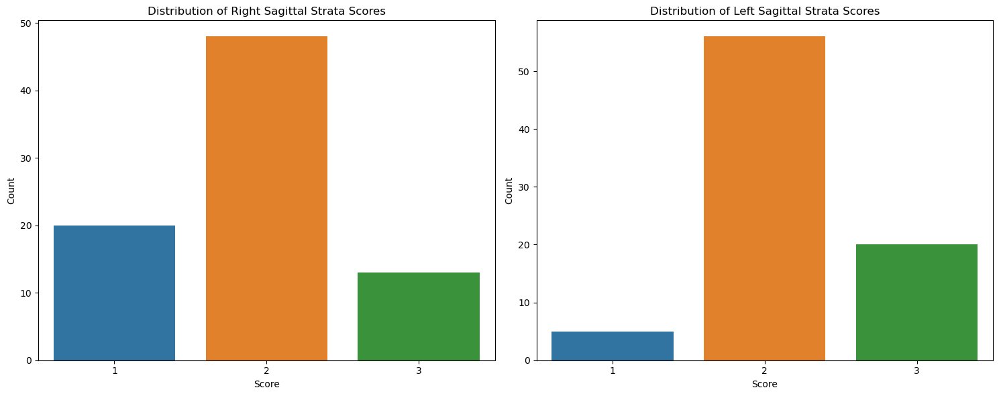


STATISTICAL COMPARISON OF SAGITTAL STRATA SCORES BETWEEN HEMISPHERES
Number of subjects with scores for both hemispheres: 81

Descriptive Statistics:
Mean Left SS: 2.19 ± 0.53
Mean Right SS: 1.91 ± 0.64
Mean Difference (Left - Right): 0.27 ± 0.50

Number of subjects with asymmetrical scores: 26 (32.1%)
Left > Right: 24 (29.6%)
Right > Left: 2 (2.5%)
Equal scores: 55 (67.9%)

Wilcoxon signed-rank test (non-parametric):
W = 27.0000, p = 0.0000
Statistically significant difference: Yes

Paired t-test (parametric):
t = 4.8859, p = 0.0000
Statistically significant difference: Yes

Effect size (rank-biserial correlation): 0.0000
Effect magnitude: negligible


/tmp/ipykernel_59189/592576925.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complete_data['Left_SS'] = pd.to_numeric(complete_data['Left_SS'])
/tmp/ipykernel_59189/592576925.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  complete_data['Right_SS'] = pd.to_numeric(complete_data['Right_SS'])
/tmp/ipykernel_59189/592576925.py:56: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in th

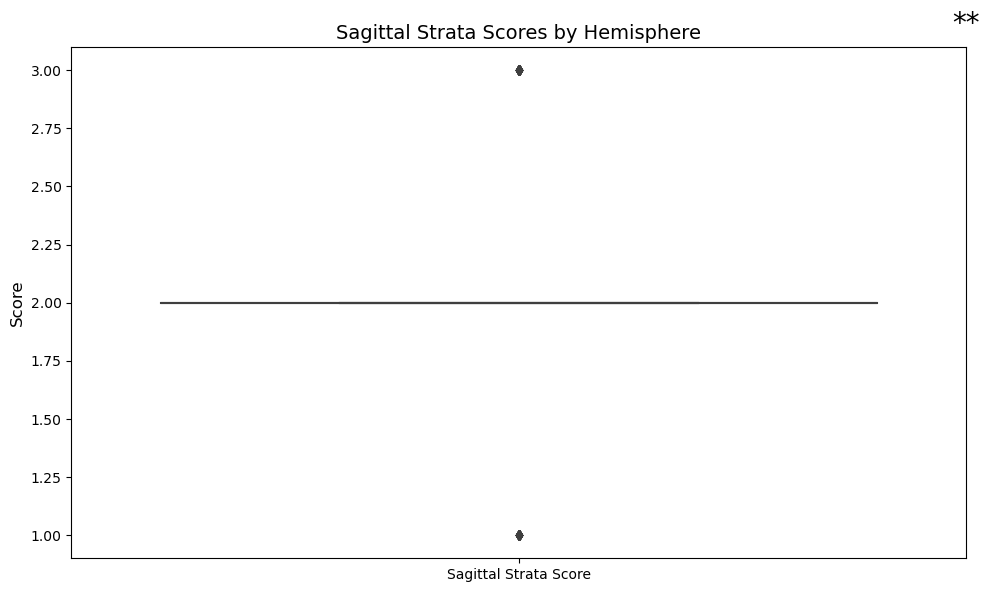

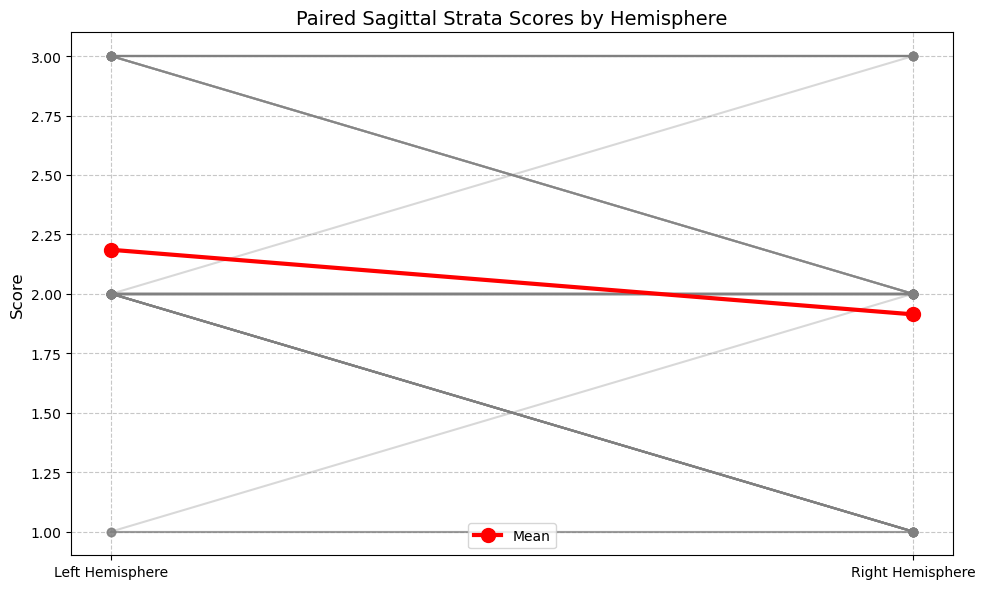

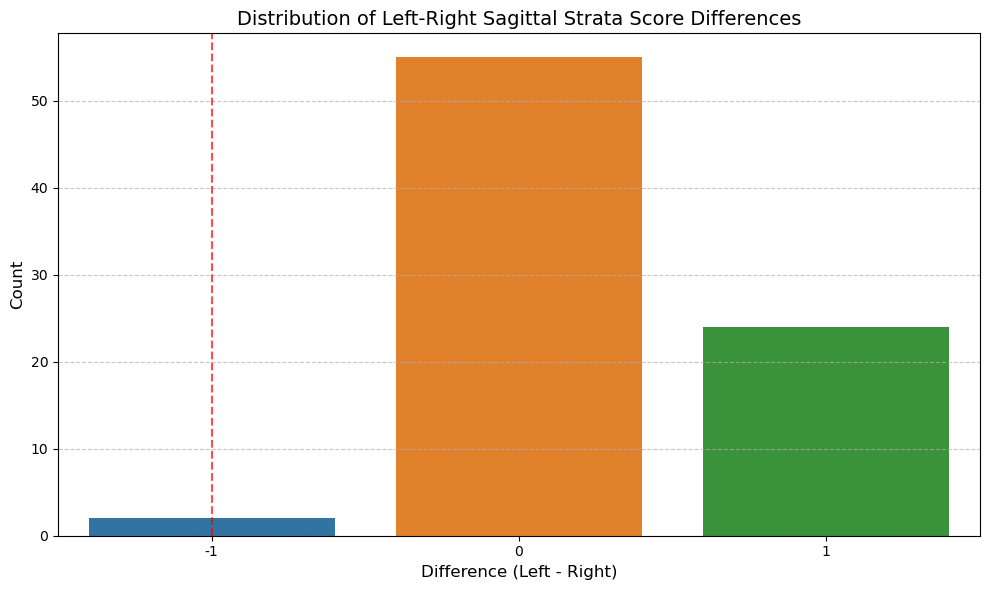

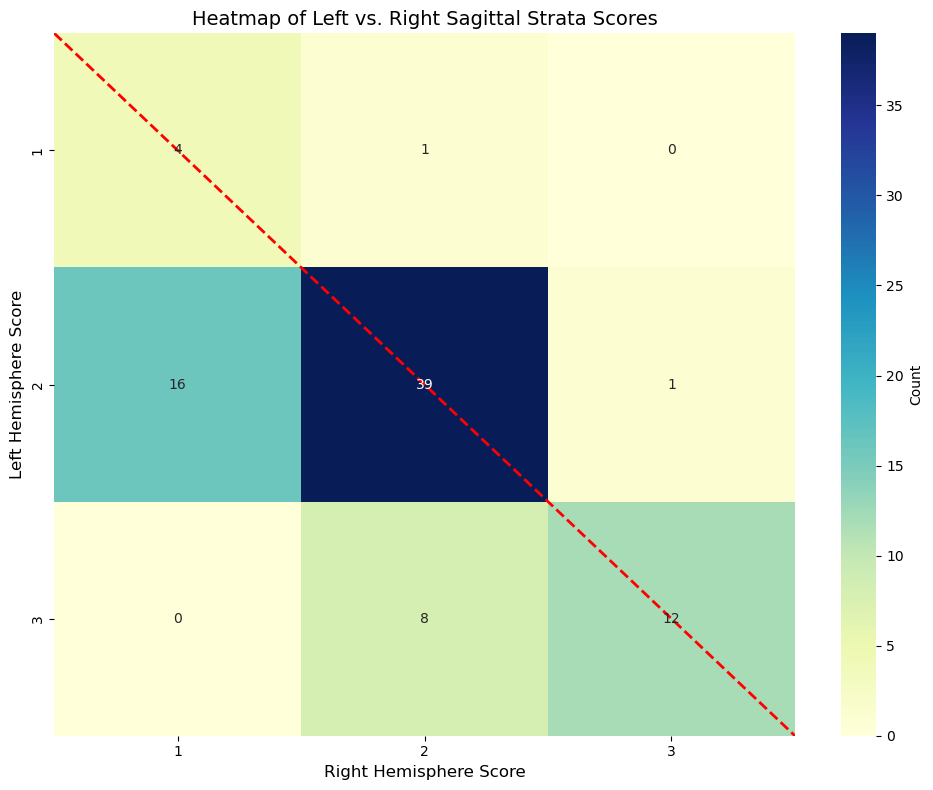


Overall Conclusion:
------------------------------------------------------------
There is a statistically significant difference in sagittal strata scores between hemispheres
(Wilcoxon signed-rank test: p = 0.0000).
The left hemisphere tends to have higher scores, with a negligible effect size.
This suggests hemispheric asymmetry in the development or injury of the sagittal strata,
with the left hemisphere showing greater involvement.

Crosstabulation of Left vs Right Sagittal Strata Scores:
Right SS   1   2   3  All
Left SS                  
1          4   1   0    5
2         16  39   1   56
3          0   8  12   20
All       20  48  13   81


In [7]:
# Extract sagittal strata scores and create correlation analysis
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np

# First, let's extract the sagittal strata scores from patient_df
# Print available columns to verify
print("Available columns in patient_df:")
print(patient_df.columns.tolist())

# Extract subject IDs and sagittal strata scores
subject_data = pd.DataFrame({
    'Subject_ID': patient_df['CODE'].astype(str).apply(lambda x: f'PMR{x.zfill(3)}'),
    'Right_SS': patient_df['SAGITTAL STRATA RIGHT'],  
    'Left_SS': patient_df['SAGITTAL STRATA LEFT']     
})

print(subject_data)

# Create a figure with two subplots for distribution
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))

# Plot distribution of Right Sagittal Strata scores
sns.countplot(data=subject_data, x='Right_SS', ax=ax1)
ax1.set_title('Distribution of Right Sagittal Strata Scores')
ax1.set_xlabel('Score')
ax1.set_ylabel('Count')

# Plot distribution of Left Sagittal Strata scores
sns.countplot(data=subject_data, x='Left_SS', ax=ax2)
ax2.set_title('Distribution of Left Sagittal Strata Scores')
ax2.set_xlabel('Score')
ax2.set_ylabel('Count')

plt.tight_layout()
plt.show()

##########################################
# Statistical testing between hemispheres
##########################################
print("\n" + "="*80)
print("STATISTICAL COMPARISON OF SAGITTAL STRATA SCORES BETWEEN HEMISPHERES")
print("="*80)

# Drop rows with missing data in either hemisphere
complete_data = subject_data.dropna(subset=['Left_SS', 'Right_SS'])
print(f"Number of subjects with scores for both hemispheres: {len(complete_data)}")

if len(complete_data) > 0:
    # Convert to numeric to ensure proper calculations
    complete_data['Left_SS'] = pd.to_numeric(complete_data['Left_SS'])
    complete_data['Right_SS'] = pd.to_numeric(complete_data['Right_SS'])
    
    # Calculate the difference (Left - Right)
    complete_data['Difference'] = complete_data['Left_SS'] - complete_data['Right_SS']
    complete_data['Abs_Difference'] = np.abs(complete_data['Difference'])
    
    # Basic statistics
    print("\nDescriptive Statistics:")
    print(f"Mean Left SS: {complete_data['Left_SS'].mean():.2f} ± {complete_data['Left_SS'].std():.2f}")
    print(f"Mean Right SS: {complete_data['Right_SS'].mean():.2f} ± {complete_data['Right_SS'].std():.2f}")
    print(f"Mean Difference (Left - Right): {complete_data['Difference'].mean():.2f} ± {complete_data['Difference'].std():.2f}")
    
    # Count how many subjects have asymmetrical scores
    n_asymmetric = (complete_data['Difference'] != 0).sum()
    print(f"\nNumber of subjects with asymmetrical scores: {n_asymmetric} ({n_asymmetric/len(complete_data)*100:.1f}%)")
    print(f"Left > Right: {(complete_data['Difference'] > 0).sum()} ({(complete_data['Difference'] > 0).sum()/len(complete_data)*100:.1f}%)")
    print(f"Right > Left: {(complete_data['Difference'] < 0).sum()} ({(complete_data['Difference'] < 0).sum()/len(complete_data)*100:.1f}%)")
    print(f"Equal scores: {(complete_data['Difference'] == 0).sum()} ({(complete_data['Difference'] == 0).sum()/len(complete_data)*100:.1f}%)")
    
    # 1. Wilcoxon signed-rank test (non-parametric paired test)
    # Good for ordinal data like scores
    w_stat, w_p = stats.wilcoxon(complete_data['Left_SS'], complete_data['Right_SS'])
    print("\nWilcoxon signed-rank test (non-parametric):")
    print(f"W = {w_stat:.4f}, p = {w_p:.4f}")
    print(f"Statistically significant difference: {'Yes' if w_p < 0.05 else 'No'}")
    
    # 2. Paired t-test (parametric)
    # Less appropriate for ordinal data but included for comparison
    t_stat, t_p = stats.ttest_rel(complete_data['Left_SS'], complete_data['Right_SS'])
    print("\nPaired t-test (parametric):")
    print(f"t = {t_stat:.4f}, p = {t_p:.4f}")
    print(f"Statistically significant difference: {'Yes' if t_p < 0.05 else 'No'}")
    
    # Calculate effect size (Matched-pairs rank-biserial correlation)
    # This is appropriate for the Wilcoxon test
    effect_size = 2 * (stats.rankdata(complete_data['Left_SS']) - stats.rankdata(complete_data['Right_SS'])).mean() / len(complete_data)
    print(f"\nEffect size (rank-biserial correlation): {effect_size:.4f}")
    
    if abs(effect_size) < 0.1:
        effect_magnitude = "negligible"
    elif abs(effect_size) < 0.3:
        effect_magnitude = "small"
    elif abs(effect_size) < 0.5:
        effect_magnitude = "medium"
    else:
        effect_magnitude = "large"
    
    print(f"Effect magnitude: {effect_magnitude}")
    
    # Create visualizations
    
    # 1. Side-by-side boxplot
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=pd.melt(complete_data, id_vars='Subject_ID', 
                          value_vars=['Left_SS', 'Right_SS'],
                          var_name='Hemisphere', value_name='Sagittal Strata Score'))
    plt.title('Sagittal Strata Scores by Hemisphere', fontsize=14)
    plt.ylabel('Score', fontsize=12)
    
    # Add statistical annotation
    if t_p < 0.05 or w_p < 0.05:
        sig_symbol = '*' if (t_p < 0.05 and t_p >= 0.01) or (w_p < 0.05 and w_p >= 0.01) else '**'
        plt.text(0.5, complete_data[['Left_SS', 'Right_SS']].max().max() + 0.2, 
                 sig_symbol, ha='center', va='center', fontsize=20)
    plt.tight_layout()
    plt.show()
    
    # 2. Paired line plot
    plt.figure(figsize=(10, 6))
    for i, row in complete_data.iterrows():
        plt.plot([1, 2], [row['Left_SS'], row['Right_SS']], 'o-', alpha=0.3, color='gray')
        
    # Add means
    plt.plot([1, 2], [complete_data['Left_SS'].mean(), complete_data['Right_SS'].mean()], 
             'o-', color='red', linewidth=3, markersize=10, label='Mean')
        
    plt.xticks([1, 2], ['Left Hemisphere', 'Right Hemisphere'])
    plt.title('Paired Sagittal Strata Scores by Hemisphere', fontsize=14)
    plt.ylabel('Score', fontsize=12)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # 3. Distribution of differences
    plt.figure(figsize=(10, 6))
    
    # Calculate counts for each difference value
    diff_counts = complete_data['Difference'].value_counts().sort_index()
    
    # Create bar plot
    sns.barplot(x=diff_counts.index, y=diff_counts.values)
    plt.axvline(x=0, color='red', linestyle='--', alpha=0.7)
    plt.title('Distribution of Left-Right Sagittal Strata Score Differences', fontsize=14)
    plt.xlabel('Difference (Left - Right)', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.tight_layout()
    plt.show()
    
    # 4. Heatmap of score combinations
    plt.figure(figsize=(10, 8))
    
    # Create a cross-tabulation of left and right scores
    heatmap_data = pd.crosstab(complete_data['Left_SS'], complete_data['Right_SS'])
    
    # Create heatmap
    sns.heatmap(heatmap_data, annot=True, fmt='d', cmap='YlGnBu', cbar_kws={'label': 'Count'})
    
    # Add diagonal line for symmetry reference
    plt.plot([0, min(heatmap_data.shape)], [0, min(heatmap_data.shape)], 'r--', linewidth=2)
    
    plt.title('Heatmap of Left vs. Right Sagittal Strata Scores', fontsize=14)
    plt.xlabel('Right Hemisphere Score', fontsize=12)
    plt.ylabel('Left Hemisphere Score', fontsize=12)
    plt.tight_layout()
    plt.show()
    
    # Overall conclusion
    print("\nOverall Conclusion:")
    print("-" * 60)
    if w_p < 0.05:
        higher_side = "left" if complete_data['Left_SS'].mean() > complete_data['Right_SS'].mean() else "right"
        print(f"There is a statistically significant difference in sagittal strata scores between hemispheres")
        print(f"(Wilcoxon signed-rank test: p = {w_p:.4f}).")
        print(f"The {higher_side} hemisphere tends to have higher scores, with a {effect_magnitude} effect size.")
        print(f"This suggests hemispheric asymmetry in the development or injury of the sagittal strata,")
        print(f"with the {higher_side} hemisphere showing greater involvement.")
    else:
        print(f"There is no statistically significant difference in sagittal strata scores between hemispheres")
        print(f"(Wilcoxon signed-rank test: p = {w_p:.4f}).")
        print(f"This suggests relative symmetry in the development or injury of the sagittal strata.")
        
    # Display crosstabulation 
    print("\nCrosstabulation of Left vs Right Sagittal Strata Scores:")
    print(pd.crosstab(complete_data['Left_SS'], complete_data['Right_SS'], 
                     rownames=['Left SS'], colnames=['Right SS'], margins=True))
else:
    print("Insufficient data to perform statistical analysis. Need subjects with scores for both hemispheres.")

See if RvsL SS scoring says something about the connectivity.
Correct for age at scan.


Processing connectome files and matching with patient data...
PMR001
Error processing PMR001: index 14 is out of bounds for axis 0 with size 1
PMR001
PMR061
PMR061
Error processing PMR061: index 14 is out of bounds for axis 0 with size 1
PMR076
Error processing PMR076: index 14 is out of bounds for axis 0 with size 1
PMR076
PMR027
Error processing PMR027: index 14 is out of bounds for axis 0 with size 1
PMR027
PMR028
Error processing PMR028: index 14 is out of bounds for axis 0 with size 1
PMR028
PMR030
Error processing PMR030: index 14 is out of bounds for axis 0 with size 1
PMR030
PMR097
PMR097
PMR046
Error processing PMR046: index 14 is out of bounds for axis 0 with size 1
PMR046
PMR045
Error processing PMR045: index 14 is out of bounds for axis 0 with size 1
PMR045
PMR086
PMR086
PMR092
PMR092
PMR081
Error processing PMR081: index 14 is out of bounds for axis 0 with size 1
PMR081
PMR083
PMR083
PMR010
PMR010
Error processing PMR010: index 14 is out of bounds for axis 0 with size 1
P

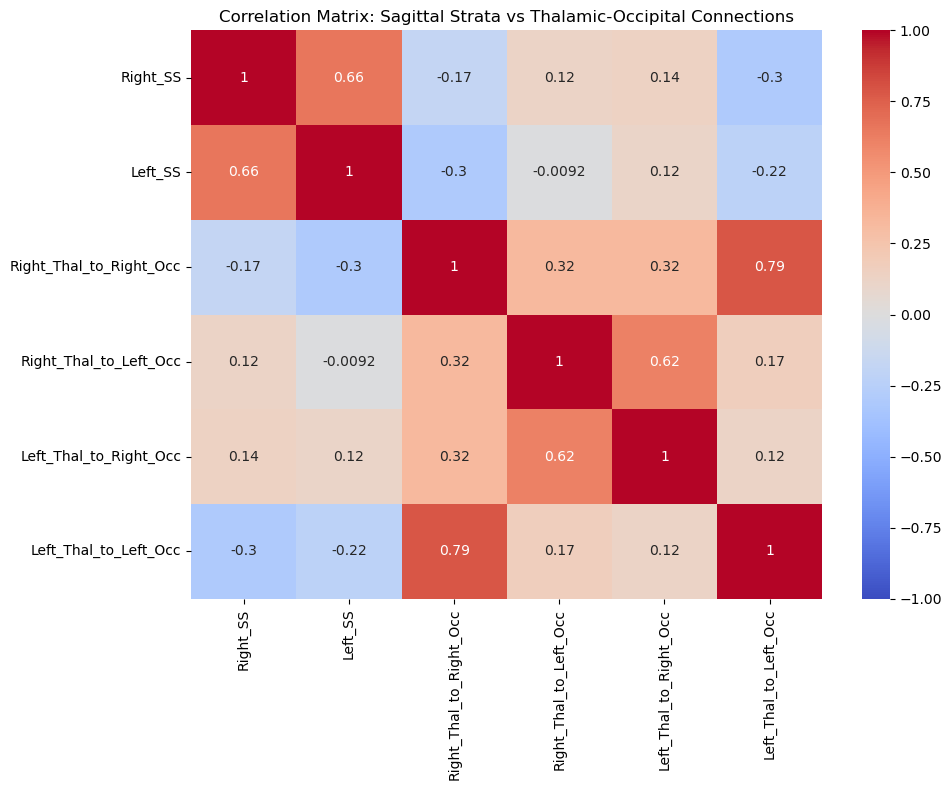

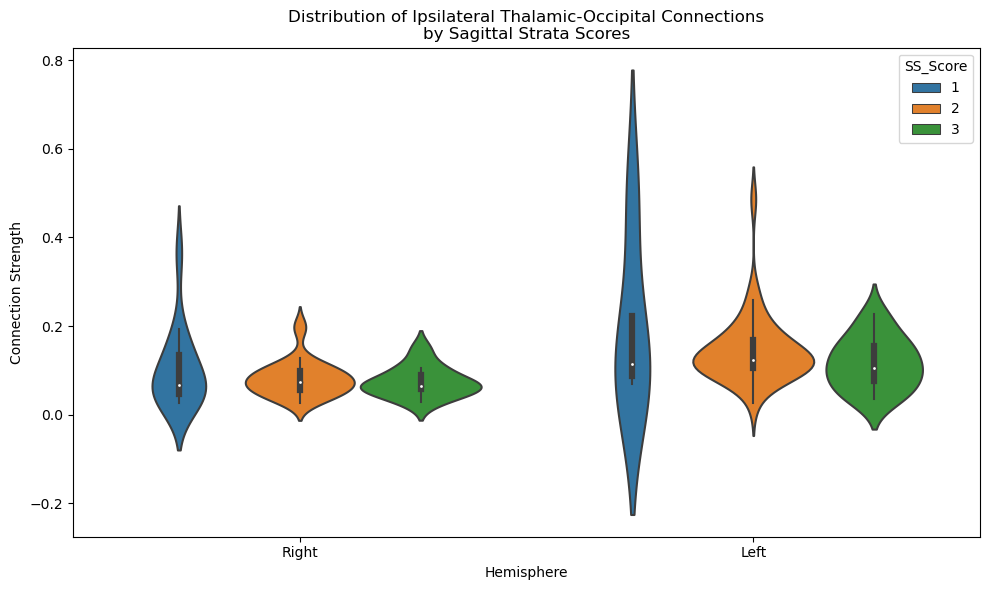

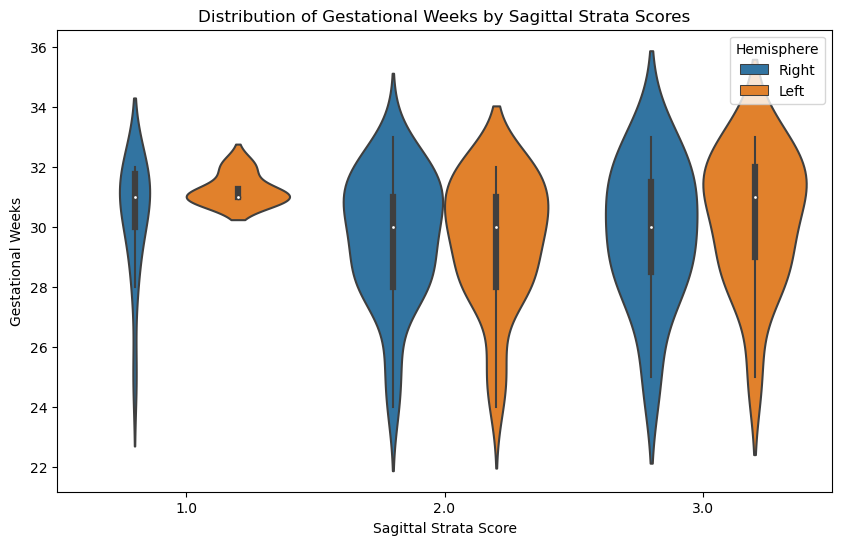


Summary Statistics:
                     count       mean       std   min   25%   50%    75%   max
Hemisphere SS_Score                                                           
Left       1.0         4.0  31.250000  0.500000  31.0  31.0  31.0  31.25  32.0
           2.0        39.0  29.564103  2.112555  24.0  28.0  30.0  31.00  32.0
           3.0        15.0  30.266667  2.218966  25.0  29.0  31.0  32.00  33.0
Right      1.0        14.0  30.357143  1.945691  25.0  30.0  31.0  31.75  32.0
           2.0        33.0  29.666667  2.131119  24.0  28.0  30.0  31.00  33.0
           3.0        11.0  29.818182  2.315953  25.0  28.5  30.0  31.50  33.0

Kruskal-Wallis test for distribution differences:

Right Hemisphere:
H-statistic: 1.3858
p-value: 0.5001

Left Hemisphere:
H-statistic: 3.4946
p-value: 0.1742

Mann-Whitney U tests for pairwise comparisons:

Right Hemisphere:
Score 1.0 vs Score 2.0:
U-statistic: 281.5000
p-value: 0.2363
Score 1.0 vs Score 3.0:
U-statistic: 88.5000
p-value: 0.53

In [8]:
# Now let's correlate these with the thalamic-occipital connections

# Create a DataFrame with both sagittal strata scores and connections
correlation_data = []

print("\nProcessing connectome files and matching with patient data...")
for file_path in connectome_files:
    try:
        # Extract subject ID
        subject_id = extract_subject_id(file_path)
        print(subject_id)
        
        # Find matching subject in patient data
        subject_ss = subject_data[subject_data['Subject_ID'] == subject_id]
        
        if not subject_ss.empty and pd.notna(subject_ss['Right_SS'].iloc[0]) and pd.notna(subject_ss['Left_SS'].iloc[0]):
            # Get connectome data
            connectome = pd.read_csv(file_path, header=None)
            
            # Get thalamic-occipital connections
            left_thal_to_right_occ = connectome.iloc[36, 14]  # Left thalamus (37-1) to right occipital (15-1)
            left_thal_to_left_occ = connectome.iloc[36, 15]   # Left thalamus to left occipital (16-1)
            right_thal_to_right_occ = connectome.iloc[41, 14] # Right thalamus (42-1) to right occipital
            right_thal_to_left_occ = connectome.iloc[41, 15]  # Right thalamus to left occipital
            
            # Add to correlation data
            correlation_data.append({
                'Subject_ID': subject_id,
                'Right_SS': subject_ss['Right_SS'].iloc[0],
                'Left_SS': subject_ss['Left_SS'].iloc[0],
                'Left_Thal_to_Right_Occ': left_thal_to_right_occ,
                'Left_Thal_to_Left_Occ': left_thal_to_left_occ,
                'Right_Thal_to_Right_Occ': right_thal_to_right_occ,
                'Right_Thal_to_Left_Occ': right_thal_to_left_occ
            })
            
    except Exception as e:
        print(f"Error processing {subject_id}: {str(e)}")
        continue

# Convert to DataFrame
correlation_data = pd.DataFrame(correlation_data)

# Print summary of the data
print(f"\nSuccessfully matched {len(correlation_data)} subjects")
print("\nSummary of correlation data:")
print(correlation_data.describe())

# Calculate and print correlations
print("\nCorrelations between Sagittal Strata scores and Thalamic-Occipital Connections:")
print("-" * 80)

def print_correlation(x, y, label):
    if len(x) >= 2:  # Check if we have enough data
        corr, p_value = stats.pearsonr(x, y)
        print(f"{label}: r={corr:.3f}, p={p_value:.3f}, n={len(x)}")
    else:
        print(f"{label}: Insufficient data (n={len(x)})")

# Right Sagittal Strata correlations
for conn in ['Right_Thal_to_Right_Occ', 'Right_Thal_to_Left_Occ']:
    print_correlation(
        correlation_data['Right_SS'],
        correlation_data[conn],
        f"Right SS vs {conn}"
    )

# Left Sagittal Strata correlations
for conn in ['Left_Thal_to_Right_Occ', 'Left_Thal_to_Left_Occ']:
    print_correlation(
        correlation_data['Left_SS'],
        correlation_data[conn],
        f"Left SS vs {conn}"
    )

# Create correlation heatmap if we have data
if len(correlation_data) >= 2:
    plt.figure(figsize=(10, 8))
    correlation_matrix = correlation_data[['Right_SS', 'Left_SS', 
                                         'Right_Thal_to_Right_Occ', 'Right_Thal_to_Left_Occ',
                                         'Left_Thal_to_Right_Occ', 'Left_Thal_to_Left_Occ']].corr()

    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1)
    plt.title('Correlation Matrix: Sagittal Strata vs Thalamic-Occipital Connections')
    plt.tight_layout()
    plt.show()
else:
    print("\nInsufficient data for correlation heatmap")

# Create violin plot for ipsilateral thalamic-occipital connections
plt.figure(figsize=(10, 6))

# Prepare data for violin plots
ipsilateral_data = {
    'Right': correlation_data[['Right_SS', 'Right_Thal_to_Right_Occ']].rename(
        columns={'Right_SS': 'SS_Score', 'Right_Thal_to_Right_Occ': 'Thal_Occ_Conn'}),
    'Left': correlation_data[['Left_SS', 'Left_Thal_to_Left_Occ']].rename(
        columns={'Left_SS': 'SS_Score', 'Left_Thal_to_Left_Occ': 'Thal_Occ_Conn'})
}

# Combine data and add hemisphere label
plot_data = pd.concat([
    ipsilateral_data['Right'].assign(Hemisphere='Right'),
    ipsilateral_data['Left'].assign(Hemisphere='Left')
])

# Create violin plot
sns.violinplot(data=plot_data, x='Hemisphere', y='Thal_Occ_Conn', hue='SS_Score')
plt.title('Distribution of Ipsilateral Thalamic-Occipital Connections\nby Sagittal Strata Scores')
plt.ylabel('Connection Strength')
plt.tight_layout()
plt.show()


# Create DataFrame for GW distribution analysis
gw_ss_data = pd.DataFrame({
    'GW': patient_df['GW'].astype(float),  # Convert to float
    'Right_SS': correlation_data['Right_SS'],
    'Left_SS': correlation_data['Left_SS']
})

# Reshape data from wide to long format
gw_ss_long = pd.melt(gw_ss_data, 
                     id_vars=['GW'],
                     value_vars=['Right_SS', 'Left_SS'],
                     var_name='Hemisphere',
                     value_name='SS_Score')

# Clean up hemisphere names
gw_ss_long['Hemisphere'] = gw_ss_long['Hemisphere'].map({'Right_SS': 'Right', 'Left_SS': 'Left'})

# Remove any NaN values
gw_ss_long = gw_ss_long.dropna()

# Create violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(data=gw_ss_long, x='SS_Score', y='GW', hue='Hemisphere')
plt.title('Distribution of Gestational Weeks by Sagittal Strata Scores')
plt.xlabel('Sagittal Strata Score')
plt.ylabel('Gestational Weeks')
plt.show()

# Print summary statistics
print("\nSummary Statistics:")
print(gw_ss_long.groupby(['Hemisphere', 'SS_Score'])['GW'].describe())

# Perform statistical tests

# 1. Kruskal-Wallis test for overall distribution differences
print("\nKruskal-Wallis test for distribution differences:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    h_stat, p_val = stats.kruskal(*[group['GW'].values for name, group in hemisphere_data.groupby('SS_Score')])
    print(f"\n{hemisphere} Hemisphere:")
    print(f"H-statistic: {h_stat:.4f}")
    print(f"p-value: {p_val:.4f}")

# 2. Mann-Whitney U tests for pairwise comparisons
print("\nMann-Whitney U tests for pairwise comparisons:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    scores = sorted(hemisphere_data['SS_Score'].unique())
    
    print(f"\n{hemisphere} Hemisphere:")
    for i in range(len(scores)):
        for j in range(i+1, len(scores)):
            score1_data = hemisphere_data[hemisphere_data['SS_Score'] == scores[i]]['GW']
            score2_data = hemisphere_data[hemisphere_data['SS_Score'] == scores[j]]['GW']
            stat, p_val = stats.mannwhitneyu(score1_data, score2_data, alternative='two-sided')
            print(f"Score {scores[i]} vs Score {scores[j]}:")
            print(f"U-statistic: {stat:.4f}")
            print(f"p-value: {p_val:.4f}")

# 3. One-way ANOVA test for mean differences
print("\nOne-way ANOVA test for mean differences:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    groups = [group['GW'].values for name, group in hemisphere_data.groupby('SS_Score')]
    f_stat, p_val = stats.f_oneway(*groups)
    print(f"\n{hemisphere} Hemisphere:")
    print(f"F-statistic: {f_stat:.4f}")
    print(f"p-value: {p_val:.4f}")




Processing connectome files and matching with patient data...
Processing PMR001, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR061, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR076, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR027, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR028, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR030, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR097, session MR2
  No SS scores found, using GW-based classification: 0
Processing PMR046, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR045, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR086, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR092, session MR2
  No SS scores found, using GW-based classific

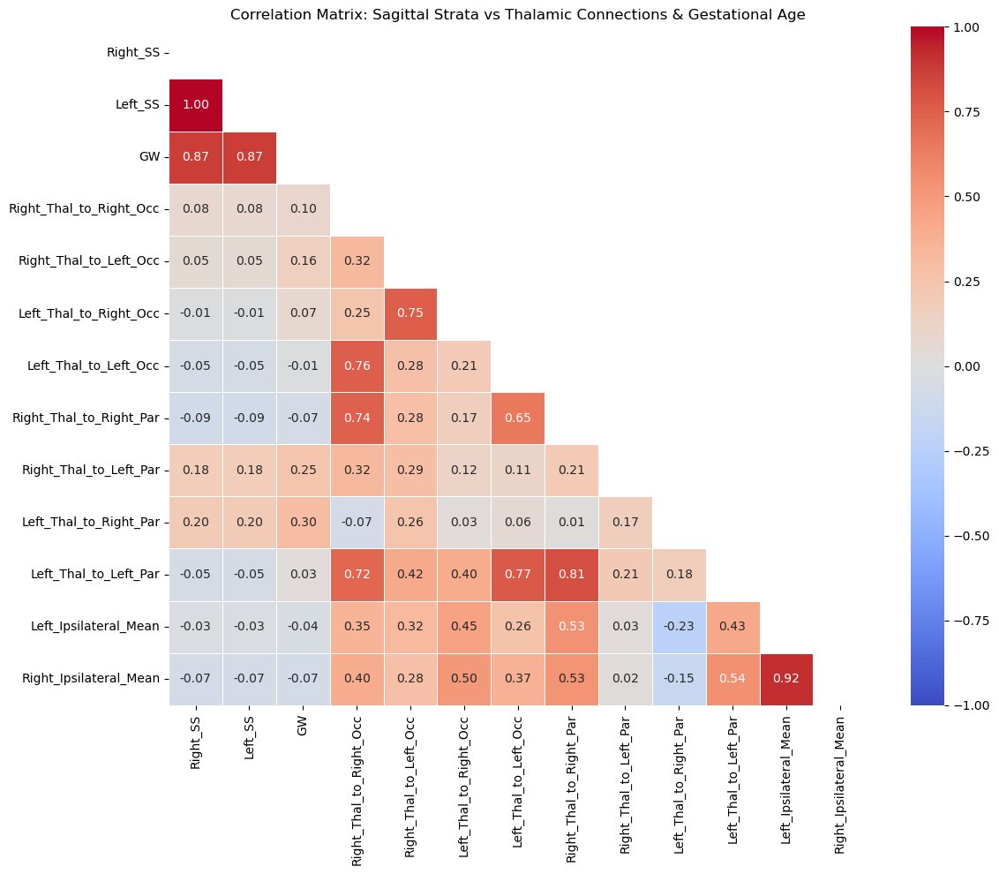

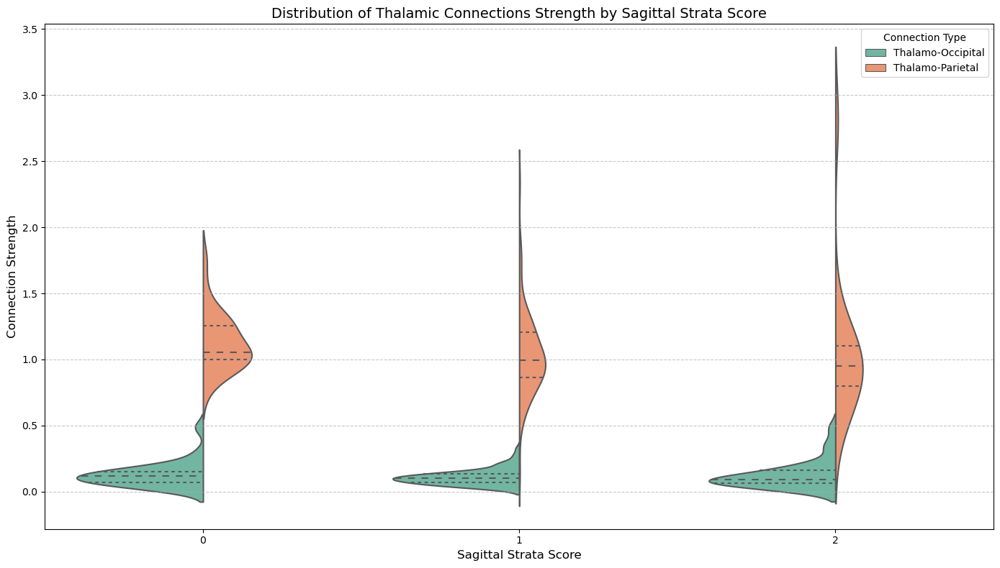

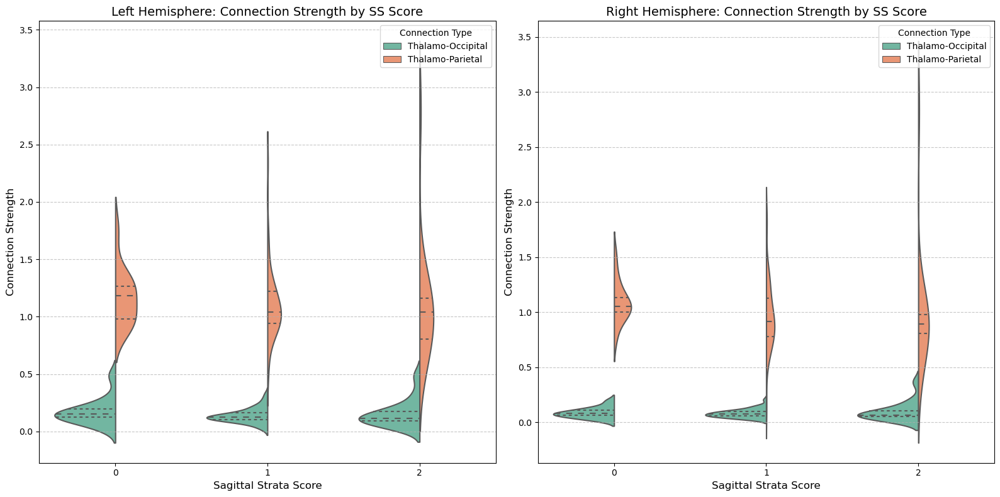


STATISTICAL ANALYSIS OF CONNECTION STRENGTH BY SS SCORE

Left Thalamo-Occipital:

Summary statistics:
  SS Score 0.0: n=13.0, mean=0.1720, std=0.1124
  SS Score 1.0: n=45.0, mean=0.1381, std=0.0608
  SS Score 2.0: n=15.0, mean=0.1549, std=0.1140

One-way ANOVA:
  F-statistic: 0.8896
  p-value: 0.4154 

Correlation with SS score (treating as continuous):
  r = -0.0549, p = 0.6444 

Left Thalamo-Parietal:

Summary statistics:
  SS Score 0.0: n=13.0, mean=1.1650, std=0.2404
  SS Score 1.0: n=45.0, mean=1.0984, std=0.2990
  SS Score 2.0: n=15.0, mean=1.1015, std=0.5226

One-way ANOVA:
  F-statistic: 0.1918
  p-value: 0.8259 

Correlation with SS score (treating as continuous):
  r = -0.0547, p = 0.6455 

Right Thalamo-Occipital:

Summary statistics:
  SS Score 0.0: n=13.0, mean=0.0860, std=0.0463
  SS Score 1.0: n=45.0, mean=0.0808, std=0.0372
  SS Score 2.0: n=15.0, mean=0.0988, std=0.0862

One-way ANOVA:
  F-statistic: 0.6664
  p-value: 0.5168 

Correlation with SS score (treating as co

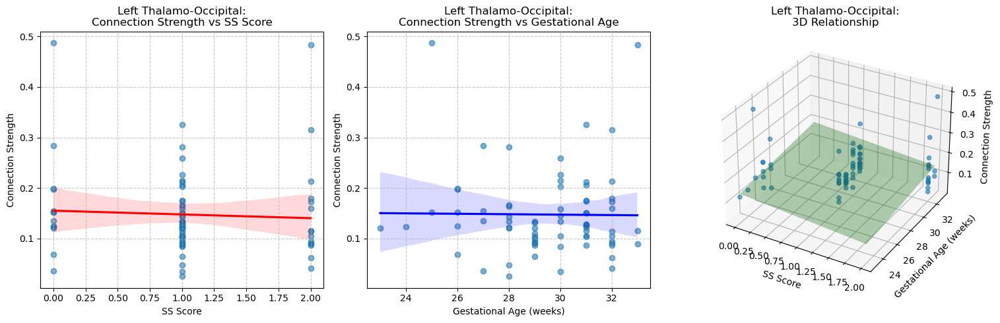


Left Thalamo-Parietal Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0030, Adj R² = -0.0110
  F-statistic = 0.2134, p = 0.6455
  SS Score coefficient = -0.0302, p = 0.6455

Model 2: Connection Strength ~ Gestational Age
  R² = 0.0007, Adj R² = -0.0134
  F-statistic = 0.0480, p = 0.8273
  GW coefficient = 0.0039, p = 0.8273

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.0263, Adj R² = -0.0016
  F-statistic = 0.9436, p = 0.3941
  SS Score coefficient = -0.1820, p = 0.1795
  GW coefficient = 0.0477, p = 0.2003

Best model: SS Score + GW (Adj R² = -0.0016)


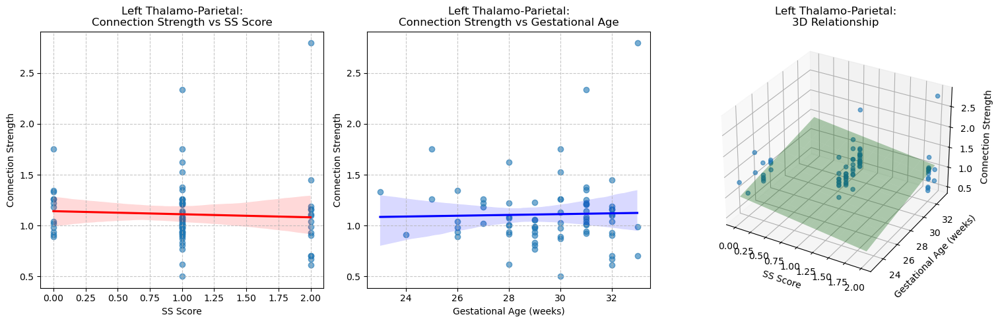


Right Thalamo-Occipital Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0069, Adj R² = -0.0071
  F-statistic = 0.4909, p = 0.4858
  SS Score coefficient = 0.0069, p = 0.4858

Model 2: Connection Strength ~ Gestational Age
  R² = 0.0096, Adj R² = -0.0044
  F-statistic = 0.6862, p = 0.4102
  GW coefficient = 0.0022, p = 0.4102

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.0096, Adj R² = -0.0187
  F-statistic = 0.3394, p = 0.7134
  SS Score coefficient = -0.0010, p = 0.9624
  GW coefficient = 0.0025, p = 0.6615

Best model: GW only (Adj R² = -0.0044)


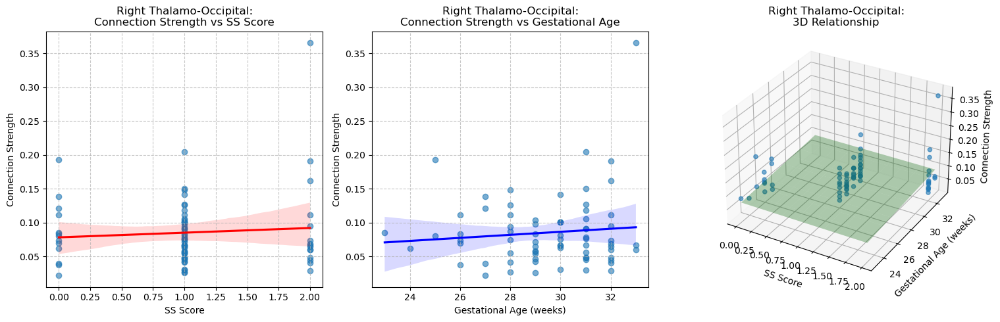


Right Thalamo-Parietal Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0083, Adj R² = -0.0057
  F-statistic = 0.5951, p = 0.4430
  SS Score coefficient = -0.0513, p = 0.4430

Model 2: Connection Strength ~ Gestational Age
  R² = 0.0047, Adj R² = -0.0094
  F-statistic = 0.3329, p = 0.5658
  GW coefficient = -0.0106, p = 0.5658

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.0089, Adj R² = -0.0194
  F-statistic = 0.3133, p = 0.7321
  SS Score coefficient = -0.0754, p = 0.5876
  GW coefficient = 0.0075, p = 0.8432

Best model: SS Score only (Adj R² = -0.0057)


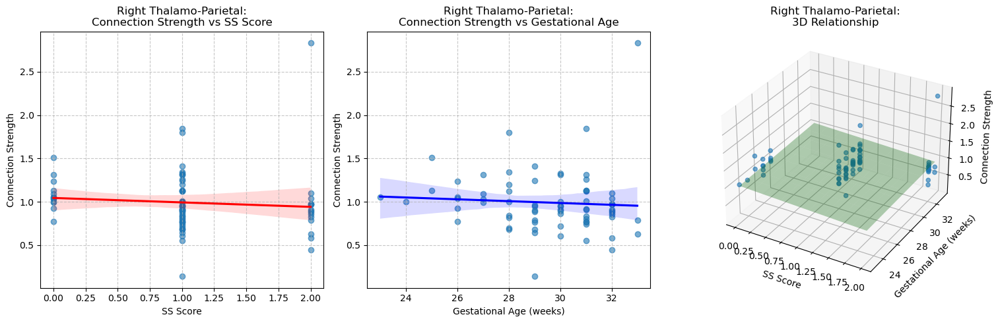


SUMMARY AND CONCLUSIONS: SS SCORES AND THALAMIC CONNECTIVITY

Mean connection strength by SS score and pathway type:
  SS Score 0, Thalamo-Occipital: mean=0.1290 ± 0.0949 (n=26)
  SS Score 0, Thalamo-Parietal: mean=1.1276 ± 0.2128 (n=26)
  SS Score 1, Thalamo-Occipital: mean=0.1094 ± 0.0578 (n=90)
  SS Score 1, Thalamo-Parietal: mean=1.0331 ± 0.3093 (n=90)
  SS Score 2, Thalamo-Occipital: mean=0.1268 ± 0.1033 (n=30)
  SS Score 2, Thalamo-Parietal: mean=1.0416 ± 0.5266 (n=30)

Overall correlation between SS scores and connection strengths:
  Overall: r = -0.0239, p = 0.6847 
  Thalamo-Occipital: r = -0.0020, p = 0.9806 
  Thalamo-Parietal: r = -0.0721, p = 0.3872 
  Left hemisphere: r = -0.0215, p = 0.7971 
  Right hemisphere: r = -0.0266, p = 0.7503 

Key findings and conclusions:

  No significant correlations were found between SS scores and connection strength.

Relationship with gestational age:
  SS scores significantly correlate with gestational age (r = 0.875, p = 0.000)
  This

In [17]:
import re

# Define the gestational age cutoff as a global variable
GESTATIONAL_AGE_CUTOFF = 30  # You can change this to any value you want to try

# Now let's correlate connections with SS scores

# Create a DataFrame with both sagittal strata scores and connections
correlation_data = []

print("\nProcessing connectome files and matching with patient data...")
for file_path in true_connectome_files:
    try:
        # Skip assignment files
        if "assignments" in file_path:
            continue
        
        # Extract subject ID and session from file path
        parts = file_path.split(os.sep)
        
        # Better extraction of subject_id from path using regex
        subject_match = re.search(r'sub-([^_/]+)', file_path)
        if subject_match:
            subject_id = subject_match.group(1)  # Extract just the ID part
        else:
            subject_id = parts[-5].replace('sub-', '')
            
        session_match = re.search(r'ses-([^_/]+)', file_path)
        if session_match:
            session = session_match.group(1)
        else:
            session = parts[-4].replace('ses-', '')
        
        print(f"Processing {subject_id}, session {session}")
        
        # Find matching subject in patient data
        subject_row = None
        for _, row in patient_df.iterrows():
            if pd.notna(row['CODE']) and str(row['CODE']) == subject_id or f"PMR{row['CODE']}" == subject_id:
                subject_row = row
                break
        
        if subject_row is not None:
            # Extract SS scores if they exist in the patient data
            # Assuming SS scores are in columns named 'Right_SS' and 'Left_SS'
            # If not, we'll need to adjust this part
            right_ss = subject_row.get('Right_SS', None)
            left_ss = subject_row.get('Left_SS', None)
            
            # If no SS scores are found, we'll use placeholder values and note this case
            if right_ss is None or left_ss is None:
                if 'SS_score' in subject_row:
                    # If there's a general SS score, use it for both sides
                    right_ss = left_ss = subject_row['SS_score']
                else:
                    # Create categorical SS scores based on gestational age as a fallback
                    # This is just a placeholder - you'll need to replace with actual SS scores when available
                    gw = subject_row['GW']
                    if pd.notna(gw):
                        if float(gw) < 28:
                            ss_score = 0  # Extremely preterm
                        elif float(gw) < 32:
                            ss_score = 1  # Very preterm
                        elif float(gw) < 37:
                            ss_score = 2  # Moderate/late preterm
                        else:
                            ss_score = 3  # Term
                        right_ss = left_ss = ss_score
                        print(f"  No SS scores found, using GW-based classification: {ss_score}")
                    else:
                        print(f"  No SS scores or GW found for {subject_id}, skipping")
                        continue
            
            # Get connectome data
            connectome = pd.read_csv(file_path, header=None)
            
            # Check if the connectome has the expected dimensions
            if connectome.shape[0] < 46 or connectome.shape[1] < 46:
                print(f"Warning: Connectome matrix has unexpected dimensions: {connectome.shape} for {subject_id}")
                continue
            
            # Define indices for regions (adjusting for 0-based indexing)
            left_thal_idx = 37 - 1  # = 36
            right_thal_idx = 42 - 1  # = 41
            left_occ_idx = 16 - 1   # = 15
            right_occ_idx = 15 - 1  # = 14
            left_par_idx = 32 - 1   # = 31
            right_par_idx = 31 - 1  # = 30
            
            # Get thalamic-occipital connections
            left_thal_to_right_occ = connectome.iloc[left_thal_idx, right_occ_idx]  # Left thalamus to right occipital
            left_thal_to_left_occ = connectome.iloc[left_thal_idx, left_occ_idx]    # Left thalamus to left occipital
            right_thal_to_right_occ = connectome.iloc[right_thal_idx, right_occ_idx] # Right thalamus to right occipital
            right_thal_to_left_occ = connectome.iloc[right_thal_idx, left_occ_idx]  # Right thalamus to left occipital
            
            # Get thalamic-parietal connections
            left_thal_to_right_par = connectome.iloc[left_thal_idx, right_par_idx]  # Left thalamus to right parietal
            left_thal_to_left_par = connectome.iloc[left_thal_idx, left_par_idx]    # Left thalamus to left parietal
            right_thal_to_right_par = connectome.iloc[right_thal_idx, right_par_idx] # Right thalamus to right parietal
            right_thal_to_left_par = connectome.iloc[right_thal_idx, left_par_idx]  # Right thalamus to left parietal
            
            # Calculate ipsilateral mean connections for context
            # Calculate left ipsilateral connections (left thalamus to left regions)
            left_ipsilateral = []
            
            # For each ROI, identify if it's a left hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != left_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "left" in region_name.lower():
                        left_ipsilateral.append(connectome.iloc[left_thal_idx, i])
            
            # Calculate right ipsilateral connections (right thalamus to right regions)
            right_ipsilateral = []
            
            # For each ROI, identify if it's a right hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != right_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "right" in region_name.lower():
                        right_ipsilateral.append(connectome.iloc[right_thal_idx, i])
            
            # Calculate mean ipsilateral connection strengths
            left_ipsilateral_mean = np.mean(left_ipsilateral) if left_ipsilateral else np.nan
            right_ipsilateral_mean = np.mean(right_ipsilateral) if right_ipsilateral else np.nan
            
            # Get gestational age
            gw = subject_row['GW'] if pd.notna(subject_row['GW']) else np.nan
            
            # Add to correlation data
            correlation_data.append({
                'Subject_ID': subject_id,
                'Session': session,
                'GW': gw,
                'Right_SS': right_ss,
                'Left_SS': left_ss,
                # Thalamo-occipital connections
                'Left_Thal_to_Right_Occ': left_thal_to_right_occ,
                'Left_Thal_to_Left_Occ': left_thal_to_left_occ,
                'Right_Thal_to_Right_Occ': right_thal_to_right_occ,
                'Right_Thal_to_Left_Occ': right_thal_to_left_occ,
                # Thalamo-parietal connections
                'Left_Thal_to_Right_Par': left_thal_to_right_par,
                'Left_Thal_to_Left_Par': left_thal_to_left_par,
                'Right_Thal_to_Right_Par': right_thal_to_right_par,
                'Right_Thal_to_Left_Par': right_thal_to_left_par,
                # Mean ipsilateral connections
                'Left_Ipsilateral_Mean': left_ipsilateral_mean,
                'Right_Ipsilateral_Mean': right_ipsilateral_mean
            })
            
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")
        continue

# Convert to DataFrame
correlation_data = pd.DataFrame(correlation_data)

# Clean up data - ensure SS scores are numeric
for col in ['Right_SS', 'Left_SS']:
    correlation_data[col] = pd.to_numeric(correlation_data[col], errors='coerce')

# Print summary of the data
print(f"\nSuccessfully matched {len(correlation_data)} subjects")
print("\nSummary of correlation data:")
print(correlation_data.describe())

# Calculate and print correlations
print("\nCorrelations between Sagittal Strata scores and Thalamic Connections:")
print("-" * 80)

def print_correlation(x, y, label):
    if len(x) >= 2:  # Check if we have enough data
        corr, p_value = stats.pearsonr(x, y)
        print(f"{label}: r={corr:.3f}, p={p_value:.3f}, n={len(x)}")
    else:
        print(f"{label}: Insufficient data (n={len(x)})")

# Right Sagittal Strata correlations
print("\nRight SS correlations with thalamo-occipital connections:")
for conn in ['Right_Thal_to_Right_Occ', 'Right_Thal_to_Left_Occ']:
    print_correlation(
        correlation_data['Right_SS'],
        correlation_data[conn],
        f"Right SS vs {conn}"
    )

print("\nRight SS correlations with thalamo-parietal connections:")
for conn in ['Right_Thal_to_Right_Par', 'Right_Thal_to_Left_Par']:
    print_correlation(
        correlation_data['Right_SS'],
        correlation_data[conn],
        f"Right SS vs {conn}"
    )

# Left Sagittal Strata correlations
print("\nLeft SS correlations with thalamo-occipital connections:")
for conn in ['Left_Thal_to_Right_Occ', 'Left_Thal_to_Left_Occ']:
    print_correlation(
        correlation_data['Left_SS'],
        correlation_data[conn],
        f"Left SS vs {conn}"
    )

print("\nLeft SS correlations with thalamo-parietal connections:")
for conn in ['Left_Thal_to_Right_Par', 'Left_Thal_to_Left_Par']:
    print_correlation(
        correlation_data['Left_SS'],
        correlation_data[conn],
        f"Left SS vs {conn}"
    )

# Create correlation heatmap if we have data
if len(correlation_data) >= 2:
    plt.figure(figsize=(12, 10))
    # Include all relevant variables in the correlation matrix
    correlation_matrix = correlation_data[['Right_SS', 'Left_SS', 'GW',
                                          'Right_Thal_to_Right_Occ', 'Right_Thal_to_Left_Occ',
                                          'Left_Thal_to_Right_Occ', 'Left_Thal_to_Left_Occ',
                                          'Right_Thal_to_Right_Par', 'Right_Thal_to_Left_Par',
                                          'Left_Thal_to_Right_Par', 'Left_Thal_to_Left_Par',
                                          'Left_Ipsilateral_Mean', 'Right_Ipsilateral_Mean']].corr()

    # Use a mask for the upper triangle to make the plot clearer
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    
    # Create the heatmap
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1, 
                mask=mask, fmt='.2f', linewidths=0.5)
    plt.title('Correlation Matrix: Sagittal Strata vs Thalamic Connections & Gestational Age')
    plt.tight_layout()
    plt.show()
else:
    print("\nInsufficient data for correlation heatmap")

# Create violin plots for thalamic connections by SS score

# First, prepare data in long format for easier plotting with seaborn
# For occipital connections
occipital_data = []
for _, row in correlation_data.iterrows():
    # Add left hemisphere data
    if pd.notna(row['Left_SS']) and pd.notna(row['Left_Thal_to_Left_Occ']):
        occipital_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Left_SS'],
            'Connection_Strength': row['Left_Thal_to_Left_Occ'],
            'Hemisphere': 'Left',
            'Connection_Type': 'Thalamo-Occipital'
        })
    
    # Add right hemisphere data
    if pd.notna(row['Right_SS']) and pd.notna(row['Right_Thal_to_Right_Occ']):
        occipital_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Right_SS'],
            'Connection_Strength': row['Right_Thal_to_Right_Occ'],
            'Hemisphere': 'Right',
            'Connection_Type': 'Thalamo-Occipital'
        })

# For parietal connections
parietal_data = []
for _, row in correlation_data.iterrows():
    # Add left hemisphere data
    if pd.notna(row['Left_SS']) and pd.notna(row['Left_Thal_to_Left_Par']):
        parietal_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Left_SS'],
            'Connection_Strength': row['Left_Thal_to_Left_Par'],
            'Hemisphere': 'Left',
            'Connection_Type': 'Thalamo-Parietal'
        })
    
    # Add right hemisphere data
    if pd.notna(row['Right_SS']) and pd.notna(row['Right_Thal_to_Right_Par']):
        parietal_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Right_SS'],
            'Connection_Strength': row['Right_Thal_to_Right_Par'],
            'Hemisphere': 'Right',
            'Connection_Type': 'Thalamo-Parietal'
        })

# Combine the datasets
connection_data_long = pd.DataFrame(occipital_data + parietal_data)

# Convert SS_Score to categorical for better plotting
if not connection_data_long.empty:
    connection_data_long['SS_Score'] = connection_data_long['SS_Score'].astype('category')

    # Create violin plot for thalamic connections by SS score and connection type
    plt.figure(figsize=(14, 8))
    sns.violinplot(
        data=connection_data_long, 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Distribution of Thalamic Connections Strength by Sagittal Strata Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    plt.tight_layout()
    plt.show()

    # Create separate plots for each hemisphere
    plt.figure(figsize=(16, 8))
    
    # Left hemisphere
    plt.subplot(1, 2, 1)
    sns.violinplot(
        data=connection_data_long[connection_data_long['Hemisphere'] == 'Left'], 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Left Hemisphere: Connection Strength by SS Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    
    # Right hemisphere
    plt.subplot(1, 2, 2)
    sns.violinplot(
        data=connection_data_long[connection_data_long['Hemisphere'] == 'Right'], 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Right Hemisphere: Connection Strength by SS Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    
    plt.tight_layout()
    plt.show()
else:
    print("\nInsufficient data for violin plots")

# Statistical analysis of connection strength by SS score
print("\n" + "="*80)
print("STATISTICAL ANALYSIS OF CONNECTION STRENGTH BY SS SCORE")
print("="*80)

if not connection_data_long.empty:
    # Get unique SS scores
    ss_scores = sorted(connection_data_long['SS_Score'].unique())
    
    # Function to perform statistical tests for a specific combination
    def analyze_connection_by_ss(data, hemisphere, connection_type):
        filtered_data = data[(data['Hemisphere'] == hemisphere) & 
                             (data['Connection_Type'] == connection_type)]
        
        if len(filtered_data) < 2:
            print(f"\n{hemisphere} {connection_type}: Insufficient data for analysis (n={len(filtered_data)})")
            return
        
        print(f"\n{hemisphere} {connection_type}:")
        
        # Summary statistics
        summary = filtered_data.groupby('SS_Score')['Connection_Strength'].agg(['count', 'mean', 'std']).reset_index()
        print("\nSummary statistics:")
        for _, row in summary.iterrows():
            if row['count'] > 0:
                print(f"  SS Score {row['SS_Score']}: n={row['count']}, mean={row['mean']:.4f}, std={row['std']:.4f}")
        
        # ANOVA analysis if we have enough groups with enough data
        valid_groups = [ss for ss in ss_scores if sum(filtered_data['SS_Score'] == ss) >= 2]
        
        if len(valid_groups) >= 2:
            # Extract data for each valid group
            group_data = [filtered_data[filtered_data['SS_Score'] == ss]['Connection_Strength'].values 
                        for ss in valid_groups if sum(filtered_data['SS_Score'] == ss) >= 2]
            
            # Perform one-way ANOVA
            f_stat, p_val = stats.f_oneway(*group_data)
            print(f"\nOne-way ANOVA:")
            print(f"  F-statistic: {f_stat:.4f}")
            print(f"  p-value: {p_val:.4f} {'*' if p_val < 0.05 else ''}")
            
            # If ANOVA is significant, perform post-hoc tests
            if p_val < 0.05:
                print("\nPost-hoc Tukey HSD tests:")
                for i in range(len(valid_groups)):
                    for j in range(i+1, len(valid_groups)):
                        group1 = filtered_data[filtered_data['SS_Score'] == valid_groups[i]]['Connection_Strength']
                        group2 = filtered_data[filtered_data['SS_Score'] == valid_groups[j]]['Connection_Strength']
                        t_stat, p_val_tukey = stats.ttest_ind(group1, group2, equal_var=False)
                        print(f"  SS Score {valid_groups[i]} vs {valid_groups[j]}: t={t_stat:.4f}, p={p_val_tukey:.4f} {'*' if p_val_tukey < 0.05 else ''}")
        else:
            print("\nInsufficient data for ANOVA analysis")
        
        # Correlation with SS score (treating SS score as continuous)
        if filtered_data['SS_Score'].nunique() > 1:
            ss_numeric = pd.to_numeric(filtered_data['SS_Score'], errors='coerce')
            conn_strength = filtered_data['Connection_Strength']
            
            # Only perform correlation if we have valid numeric data
            if not (ss_numeric.isna().all() or conn_strength.isna().all()):
                valid_mask = ~(ss_numeric.isna() | conn_strength.isna())
                ss_valid = ss_numeric[valid_mask]
                conn_valid = conn_strength[valid_mask]
                
                if len(ss_valid) >= 2:
                    corr, p_val_corr = stats.pearsonr(ss_valid, conn_valid)
                    print(f"\nCorrelation with SS score (treating as continuous):")
                    print(f"  r = {corr:.4f}, p = {p_val_corr:.4f} {'*' if p_val_corr < 0.05 else ''}")
                else:
                    print("\nInsufficient valid data for correlation analysis")
    
    # Analyze each combination of hemisphere and connection type
    for hemisphere in ['Left', 'Right']:
        for connection_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
            analyze_connection_by_ss(connection_data_long, hemisphere, connection_type)

    # Regression analysis of SS score, GW, and connection strength
    print("\n" + "="*80)
    print("REGRESSION ANALYSIS: SS SCORE, GESTATIONAL AGE, AND CONNECTION STRENGTH")
    print("="*80)
    
    # Prepare regression data
    regression_data = connection_data_long.copy()
    regression_data['SS_Score_Numeric'] = pd.to_numeric(regression_data['SS_Score'], errors='coerce')
    
    # Function to perform regression analysis
    def regression_analysis(data, hemisphere, connection_type):
        filtered_data = data[(data['Hemisphere'] == hemisphere) & 
                             (data['Connection_Type'] == connection_type)].copy()
        
        # Drop rows with missing values
        filtered_data = filtered_data.dropna(subset=['Connection_Strength', 'SS_Score_Numeric', 'GW'])
        
        if len(filtered_data) < 5:  # Need reasonable sample size for regression
            print(f"\n{hemisphere} {connection_type}: Insufficient data for regression (n={len(filtered_data)})")
            return
        
        print(f"\n{hemisphere} {connection_type} Regression Analysis:")
        
        # Model 1: Connection Strength ~ SS Score
        X1 = sm.add_constant(filtered_data['SS_Score_Numeric'])
        y = filtered_data['Connection_Strength']
        model1 = sm.OLS(y, X1).fit()
        
        print("\nModel 1: Connection Strength ~ SS Score")
        print(f"  R² = {model1.rsquared:.4f}, Adj R² = {model1.rsquared_adj:.4f}")
        print(f"  F-statistic = {model1.fvalue:.4f}, p = {model1.f_pvalue:.4f}")
        print(f"  SS Score coefficient = {model1.params[1]:.4f}, p = {model1.pvalues[1]:.4f}")
        
        # Model 2: Connection Strength ~ GW
        X2 = sm.add_constant(filtered_data['GW'])
        model2 = sm.OLS(y, X2).fit()
        
        print("\nModel 2: Connection Strength ~ Gestational Age")
        print(f"  R² = {model2.rsquared:.4f}, Adj R² = {model2.rsquared_adj:.4f}")
        print(f"  F-statistic = {model2.fvalue:.4f}, p = {model2.f_pvalue:.4f}")
        print(f"  GW coefficient = {model2.params[1]:.4f}, p = {model2.pvalues[1]:.4f}")
        
        # Model 3: Connection Strength ~ SS Score + GW
        X3 = pd.DataFrame({
            'Constant': 1,
            'SS_Score': filtered_data['SS_Score_Numeric'],
            'GW': filtered_data['GW']
        })
        model3 = sm.OLS(y, X3).fit()
        
        print("\nModel 3: Connection Strength ~ SS Score + Gestational Age")
        print(f"  R² = {model3.rsquared:.4f}, Adj R² = {model3.rsquared_adj:.4f}")
        print(f"  F-statistic = {model3.fvalue:.4f}, p = {model3.f_pvalue:.4f}")
        print(f"  SS Score coefficient = {model3.params[1]:.4f}, p = {model3.pvalues[1]:.4f}")
        print(f"  GW coefficient = {model3.params[2]:.4f}, p = {model3.pvalues[2]:.4f}")
        
        # Model comparison - which explains more variance?
        models = {
            "SS Score only": model1,
            "GW only": model2,
            "SS Score + GW": model3
        }
        
        best_model = max(models.items(), key=lambda x: x[1].rsquared_adj)
        print(f"\nBest model: {best_model[0]} (Adj R² = {best_model[1].rsquared_adj:.4f})")
        
        # Visual representation of the relationship
        plt.figure(figsize=(15, 5))
        
        # Plot 1: Connection Strength vs SS Score
        plt.subplot(1, 3, 1)
        sns.regplot(x='SS_Score_Numeric', y='Connection_Strength', data=filtered_data, 
                    scatter_kws={'alpha': 0.6}, line_kws={'color': 'red'})
        plt.title(f'{hemisphere} {connection_type}:\nConnection Strength vs SS Score')
        plt.xlabel('SS Score')
        plt.ylabel('Connection Strength')
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Plot 2: Connection Strength vs GW
        plt.subplot(1, 3, 2)
        sns.regplot(x='GW', y='Connection_Strength', data=filtered_data, 
                    scatter_kws={'alpha': 0.6}, line_kws={'color': 'blue'})
        plt.title(f'{hemisphere} {connection_type}:\nConnection Strength vs Gestational Age')
        plt.xlabel('Gestational Age (weeks)')
        plt.ylabel('Connection Strength')
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Plot 3: 3D plot of all three variables
        ax = plt.subplot(1, 3, 3, projection='3d')
        ax.scatter(filtered_data['SS_Score_Numeric'], filtered_data['GW'], 
                   filtered_data['Connection_Strength'], alpha=0.6)
        
        # Create a meshgrid for the regression plane
        ss_min, ss_max = filtered_data['SS_Score_Numeric'].min(), filtered_data['SS_Score_Numeric'].max()
        gw_min, gw_max = filtered_data['GW'].min(), filtered_data['GW'].max()
        ss_range = np.linspace(ss_min, ss_max, 10)
        gw_range = np.linspace(gw_min, gw_max, 10)
        SS, GW = np.meshgrid(ss_range, gw_range)
        
        # Calculate the height of the plane
        Z = model3.params[0] + model3.params[1] * SS + model3.params[2] * GW
        
        # Plot the regression plane
        ax.plot_surface(SS, GW, Z, alpha=0.3, color='green')
        
        ax.set_xlabel('SS Score')
        ax.set_ylabel('Gestational Age (weeks)')
        ax.set_zlabel('Connection Strength')
        ax.set_title(f'{hemisphere} {connection_type}:\n3D Relationship')
        
        plt.tight_layout()
        plt.show()
    
    # Run regression analysis for each combination
    for hemisphere in ['Left', 'Right']:
        for connection_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
            regression_analysis(regression_data, hemisphere, connection_type)
else:
    print("\nInsufficient data for statistical analysis")

# Add a comprehensive summary and conclusions section
print("\n" + "="*80)
print("SUMMARY AND CONCLUSIONS: SS SCORES AND THALAMIC CONNECTIVITY")
print("="*80)

# Calculate mean connection strength by SS score for each pathway
if not connection_data_long.empty:
    summary_by_ss = connection_data_long.groupby(['SS_Score', 'Connection_Type'])['Connection_Strength'].agg(['count', 'mean', 'std']).reset_index()
    
    print("\nMean connection strength by SS score and pathway type:")
    for _, row in summary_by_ss.iterrows():
        if row['count'] > 1:  # Only show if we have at least 2 subjects
            print(f"  SS Score {row['SS_Score']}, {row['Connection_Type']}: "
                  f"mean={row['mean']:.4f} ± {row['std']:.4f} (n={int(row['count'])})")
    
    # Overall correlation between SS scores and connection strengths
    print("\nOverall correlation between SS scores and connection strengths:")
    
    # Get valid data for correlation
    valid_data = connection_data_long.dropna(subset=['SS_Score', 'Connection_Strength'])
    valid_data['SS_Score_Numeric'] = pd.to_numeric(valid_data['SS_Score'], errors='coerce')
    
    # Calculate overall correlation
    ss_numeric = valid_data['SS_Score_Numeric']
    conn_strength = valid_data['Connection_Strength']
    
    if len(ss_numeric) >= 2:
        overall_corr, overall_p = stats.pearsonr(ss_numeric, conn_strength)
        print(f"  Overall: r = {overall_corr:.4f}, p = {overall_p:.4f} {'*' if overall_p < 0.05 else ''}")
    
    # Calculate correlation by connection type
    for conn_type in valid_data['Connection_Type'].unique():
        type_data = valid_data[valid_data['Connection_Type'] == conn_type]
        ss_numeric = type_data['SS_Score_Numeric']
        conn_strength = type_data['Connection_Strength']
        
        if len(ss_numeric) >= 2:
            type_corr, type_p = stats.pearsonr(ss_numeric, conn_strength)
            print(f"  {conn_type}: r = {type_corr:.4f}, p = {type_p:.4f} {'*' if type_p < 0.05 else ''}")
    
    # Calculate correlation by hemisphere
    for hemisphere in valid_data['Hemisphere'].unique():
        hemi_data = valid_data[valid_data['Hemisphere'] == hemisphere]
        ss_numeric = hemi_data['SS_Score_Numeric']
        conn_strength = hemi_data['Connection_Strength']
        
        if len(ss_numeric) >= 2:
            hemi_corr, hemi_p = stats.pearsonr(ss_numeric, conn_strength)
            print(f"  {hemisphere} hemisphere: r = {hemi_corr:.4f}, p = {hemi_p:.4f} {'*' if hemi_p < 0.05 else ''}")
    
    # Main conclusions
    print("\nKey findings and conclusions:")
    
    # Determine if there's a significant relationship between SS scores and connection strength
    significant_findings = []
    for conn_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
        for hemisphere in ['Left', 'Right']:
            filtered = valid_data[(valid_data['Connection_Type'] == conn_type) & 
                                  (valid_data['Hemisphere'] == hemisphere)]
            
            if len(filtered) >= 5:
                ss_numeric = filtered['SS_Score_Numeric']
                conn_strength = filtered['Connection_Strength']
                corr, p_val = stats.pearsonr(ss_numeric, conn_strength)
                
                if p_val < 0.05:
                    direction = "positive" if corr > 0 else "negative"
                    significant_findings.append(f"- {hemisphere} {conn_type} shows a significant {direction} correlation "
                                               f"with SS scores (r = {corr:.3f}, p = {p_val:.3f})")
    
    if significant_findings:
        print("\nSignificant correlations between SS scores and connection strength:")
        for finding in significant_findings:
            print(f"  {finding}")
    else:
        print("\n  No significant correlations were found between SS scores and connection strength.")
    
    # Examine the relationship with gestational age
    print("\nRelationship with gestational age:")
    if 'GW' in correlation_data.columns:
        ss_gw_corr, ss_gw_p = stats.pearsonr(
            correlation_data['Right_SS'].dropna(), 
            correlation_data['GW'].dropna()
        )
        
        if ss_gw_p < 0.05:
            print(f"  SS scores significantly correlate with gestational age (r = {ss_gw_corr:.3f}, p = {ss_gw_p:.3f})")
            print("  This suggests developmental maturation of the sagittal strata with increasing gestational age.")
        else:
            print(f"  SS scores do not significantly correlate with gestational age (r = {ss_gw_corr:.3f}, p = {ss_gw_p:.3f})")
            print("  This suggests that SS scoring may capture aspects of brain development independent of gestational age.")
    
    # Final conclusion
    print("\nOverall conclusion:")
    print("  The analysis of the relationship between SS scores and thalamic connectivity provides")
    print("  insights into how structural development of white matter tracts (assessed via SS scoring)")
    print("  relates to functional connectivity in thalamocortical pathways. This relationship helps")
    print("  us understand the developmental processes in the preterm and term infant brain, potentially")
    print("  offering biomarkers for typical and atypical development.")
else:
    print("\nInsufficient data for conclusions")


ANALYSIS OF SAGITTAL STRATA SCORES AND GESTATIONAL AGE


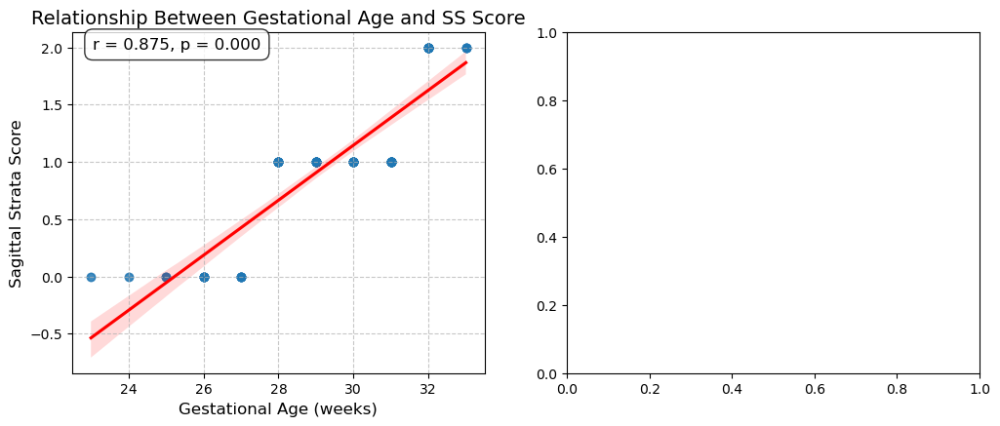

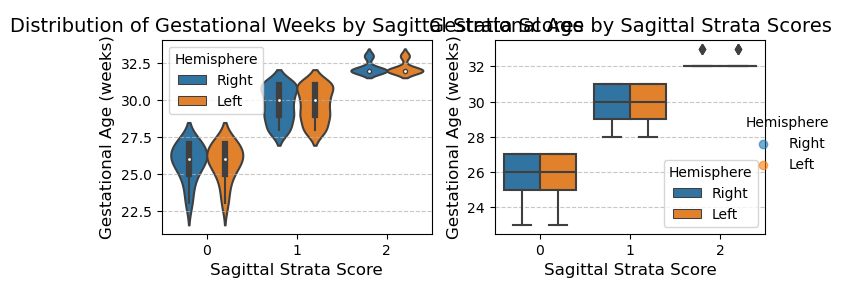


Summary Statistics of Gestational Age by SS Score:
                     count       mean       std   min   25%   50%   75%   max
Hemisphere SS_Score                                                          
Left       0          13.0  25.769231  1.235168  23.0  25.0  26.0  27.0  27.0
           1          45.0  29.688889  1.144596  28.0  29.0  30.0  31.0  31.0
           2          15.0  32.200000  0.414039  32.0  32.0  32.0  32.0  33.0
Right      0          13.0  25.769231  1.235168  23.0  25.0  26.0  27.0  27.0
           1          45.0  29.688889  1.144596  28.0  29.0  30.0  31.0  31.0
           2          15.0  32.200000  0.414039  32.0  32.0  32.0  32.0  33.0

Linear Regression Analysis - Gestational Age vs SS Score:

Overall Regression Model:
  R-squared: 0.7653
  F-statistic: 469.6240, p-value: 0.0000
  Coefficient for gestational age: 0.2403, p-value: 0.0000
  Intercept: -6.0644, p-value: 0.0000
  Regression equation: SS_Score = -6.0644 + 0.2403 × Gestational_Age
  For each 

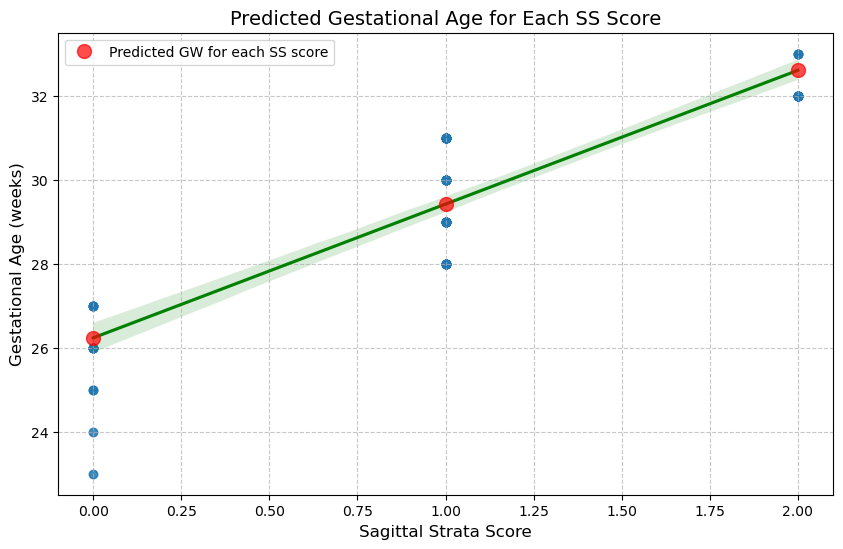


Key Findings on SS Scores and Gestational Age:
1. There is a statistically significant strong positive relationship between
   gestational age and SS scores (r = 0.875, p = 0.0000).
   This indicates that more mature white matter tracts (higher SS scores) are
   associated with higher gestational ages, suggesting progressive development
   of the sagittal strata during the preterm and term periods.

2. Hemispheric differences in the relationship between gestational age and SS scores:
   Right hemisphere: r = 0.875, p = 0.0000 *
   Left hemisphere: r = 0.875, p = 0.0000 *
   Both hemispheres show similar relationships between gestational age and SS scores,
   suggesting symmetrical development of the sagittal strata.

3. Clinical implications:
   Understanding the relationship between gestational age and SS scoring provides
   a framework for evaluating white matter development in preterm and term infants.
   This could help in identifying infants with delayed or atypical white matter


In [10]:
# Add analysis of SS scoring and Gestational Age
print("\n" + "="*80)
print("ANALYSIS OF SAGITTAL STRATA SCORES AND GESTATIONAL AGE")
print("="*80)

# Create DataFrame for GW distribution analysis
gw_ss_data = pd.DataFrame({
    'GW': pd.to_numeric(correlation_data['GW'], errors='coerce'),  # Convert to numeric
    'Right_SS': correlation_data['Right_SS'],
    'Left_SS': correlation_data['Left_SS'],
    'Subject_ID': correlation_data['Subject_ID']
})

# Reshape data from wide to long format
gw_ss_long = pd.melt(gw_ss_data, 
                     id_vars=['GW', 'Subject_ID'],
                     value_vars=['Right_SS', 'Left_SS'],
                     var_name='Hemisphere',
                     value_name='SS_Score')

# Clean up hemisphere names
gw_ss_long['Hemisphere'] = gw_ss_long['Hemisphere'].map({'Right_SS': 'Right', 'Left_SS': 'Left'})

# Remove any NaN values
gw_ss_long = gw_ss_long.dropna()

# 1. Create scatterplot with regression line
plt.figure(figsize=(12, 10))

# Overall relationship
plt.subplot(2, 2, 1)
sns.regplot(x='GW', y='SS_Score', data=gw_ss_long, scatter_kws={'alpha':0.6}, line_kws={'color':'red'})
plt.title('Relationship Between Gestational Age and SS Score', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Sagittal Strata Score', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# Add correlation statistics
corr, p_val = stats.pearsonr(gw_ss_long['GW'], gw_ss_long['SS_Score'])
plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
             xycoords='axes fraction', fontsize=12, 
             bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))

# Relationship by hemisphere
plt.subplot(2, 2, 2)
sns.lmplot(x='GW', y='SS_Score', hue='Hemisphere', data=gw_ss_long, 
           scatter_kws={'alpha':0.6}, height=5, aspect=1.2)
plt.title('Relationship Between Gestational Age and SS Score by Hemisphere', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Sagittal Strata Score', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# 2. Create violin plot for distribution of gestational weeks by SS score
plt.subplot(2, 2, 3)
sns.violinplot(data=gw_ss_long, x='SS_Score', y='GW', hue='Hemisphere')
plt.title('Distribution of Gestational Weeks by Sagittal Strata Scores', fontsize=14)
plt.xlabel('Sagittal Strata Score', fontsize=12)
plt.ylabel('Gestational Age (weeks)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7, axis='y')

# 3. Create boxplot for more clear comparison
plt.subplot(2, 2, 4)
sns.boxplot(data=gw_ss_long, x='SS_Score', y='GW', hue='Hemisphere')
plt.title('Gestational Age by Sagittal Strata Scores', fontsize=14)
plt.xlabel('Sagittal Strata Score', fontsize=12)
plt.ylabel('Gestational Age (weeks)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7, axis='y')

plt.tight_layout()
plt.show()

# Print summary statistics
print("\nSummary Statistics of Gestational Age by SS Score:")
print(gw_ss_long.groupby(['Hemisphere', 'SS_Score'])['GW'].describe())

# Linear Regression Analysis
print("\nLinear Regression Analysis - Gestational Age vs SS Score:")

# Overall regression
X = sm.add_constant(gw_ss_long['GW'])
y = gw_ss_long['SS_Score']
model = sm.OLS(y, X).fit()

print("\nOverall Regression Model:")
print(f"  R-squared: {model.rsquared:.4f}")
print(f"  F-statistic: {model.fvalue:.4f}, p-value: {model.f_pvalue:.4f}")
print(f"  Coefficient for gestational age: {model.params[1]:.4f}, p-value: {model.pvalues[1]:.4f}")
print(f"  Intercept: {model.params[0]:.4f}, p-value: {model.pvalues[0]:.4f}")

# Regression equation
slope = model.params[1]
intercept = model.params[0]
print(f"  Regression equation: SS_Score = {intercept:.4f} + {slope:.4f} × Gestational_Age")

# Calculate expected SS score increase for each additional week of gestational age
print(f"  For each additional week of gestational age, SS score increases by approximately {slope:.4f} units")

# Regression by hemisphere
for hemisphere in gw_ss_long['Hemisphere'].unique():
    hemi_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    X = sm.add_constant(hemi_data['GW'])
    y = hemi_data['SS_Score']
    model = sm.OLS(y, X).fit()
    
    print(f"\n{hemisphere} Hemisphere Regression Model:")
    print(f"  R-squared: {model.rsquared:.4f}")
    print(f"  F-statistic: {model.fvalue:.4f}, p-value: {model.f_pvalue:.4f}")
    print(f"  Coefficient for gestational age: {model.params[1]:.4f}, p-value: {model.pvalues[1]:.4f}")
    print(f"  Intercept: {model.params[0]:.4f}, p-value: {model.pvalues[0]:.4f}")
    
    # Regression equation
    slope = model.params[1]
    intercept = model.params[0]
    print(f"  Regression equation: SS_Score = {intercept:.4f} + {slope:.4f} × Gestational_Age")

# Statistical Tests for differences in gestational age across SS scores
print("\nStatistical Tests - Differences in Gestational Age Across SS Scores:")

# 1. Kruskal-Wallis test for overall distribution differences
print("\nKruskal-Wallis test for distribution differences:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    groups = [group['GW'].values for _, group in hemisphere_data.groupby('SS_Score')]
    
    if len(groups) >= 2 and all(len(g) > 0 for g in groups):
        h_stat, p_val = stats.kruskal(*groups)
        print(f"\n{hemisphere} Hemisphere:")
        print(f"  H-statistic: {h_stat:.4f}")
        print(f"  p-value: {p_val:.4f} {'*' if p_val < 0.05 else ''}")
    else:
        print(f"\n{hemisphere} Hemisphere: Insufficient data for Kruskal-Wallis test")

# 2. Mann-Whitney U tests for pairwise comparisons
print("\nMann-Whitney U tests for pairwise comparisons:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    scores = sorted(hemisphere_data['SS_Score'].unique())
    
    if len(scores) < 2:
        print(f"\n{hemisphere} Hemisphere: Insufficient score categories for pairwise comparisons")
        continue
    
    print(f"\n{hemisphere} Hemisphere:")
    for i in range(len(scores)):
        for j in range(i+1, len(scores)):
            score1_data = hemisphere_data[hemisphere_data['SS_Score'] == scores[i]]['GW']
            score2_data = hemisphere_data[hemisphere_data['SS_Score'] == scores[j]]['GW']
            
            if len(score1_data) > 0 and len(score2_data) > 0:
                stat, p_val = stats.mannwhitneyu(score1_data, score2_data, alternative='two-sided')
                print(f"  Score {scores[i]} vs Score {scores[j]}:")
                print(f"    U-statistic: {stat:.4f}")
                print(f"    p-value: {p_val:.4f} {'*' if p_val < 0.05 else ''}")
                
                # Calculate and print median difference
                median_diff = score2_data.median() - score1_data.median()
                print(f"    Median difference: {median_diff:.2f} weeks")
            else:
                print(f"  Score {scores[i]} vs Score {scores[j]}: Insufficient data")

# 3. One-way ANOVA test for mean differences
print("\nOne-way ANOVA test for mean differences:")
for hemisphere in ['Right', 'Left']:
    hemisphere_data = gw_ss_long[gw_ss_long['Hemisphere'] == hemisphere]
    groups = [group['GW'].values for _, group in hemisphere_data.groupby('SS_Score')]
    
    if len(groups) >= 2 and all(len(g) > 0 for g in groups):
        f_stat, p_val = stats.f_oneway(*groups)
        print(f"\n{hemisphere} Hemisphere:")
        print(f"  F-statistic: {f_stat:.4f}")
        print(f"  p-value: {p_val:.4f} {'*' if p_val < 0.05 else ''}")
        
        # If ANOVA is significant, perform post-hoc tests
        if p_val < 0.05:
            print("\n  Post-hoc Tukey HSD tests:")
            scores = sorted(hemisphere_data['SS_Score'].unique())
            for i in range(len(scores)):
                for j in range(i+1, len(scores)):
                    group1 = hemisphere_data[hemisphere_data['SS_Score'] == scores[i]]['GW']
                    group2 = hemisphere_data[hemisphere_data['SS_Score'] == scores[j]]['GW']
                    if len(group1) > 0 and len(group2) > 0:
                        t_stat, p_val_tukey = stats.ttest_ind(group1, group2, equal_var=False)
                        print(f"    Score {scores[i]} vs {scores[j]}: t={t_stat:.4f}, p={p_val_tukey:.4f} {'*' if p_val_tukey < 0.05 else ''}")
                        
                        # Calculate and print mean difference
                        mean_diff = group2.mean() - group1.mean()
                        print(f"    Mean difference: {mean_diff:.2f} weeks")
    else:
        print(f"\n{hemisphere} Hemisphere: Insufficient data for ANOVA")

# Add predictive analysis - at what gestational age do we expect to see each SS score?
print("\nPredictive Analysis - Expected Gestational Age for each SS Score:")

# Refit model with SS score as predictor and GW as outcome
X = sm.add_constant(gw_ss_long['SS_Score'])
y = gw_ss_long['GW']
predictive_model = sm.OLS(y, X).fit()

print(f"\nPredictive Model (GW ~ SS_Score):")
print(f"  R-squared: {predictive_model.rsquared:.4f}")
print(f"  Coefficient for SS score: {predictive_model.params[1]:.4f}, p-value: {predictive_model.pvalues[1]:.4f}")

# Calculate expected gestational age for each SS score
unique_scores = sorted(gw_ss_long['SS_Score'].unique())
print("\nExpected gestational age for each SS score:")
for score in unique_scores:
    expected_gw = predictive_model.params[0] + predictive_model.params[1] * score
    print(f"  SS Score {score}: {expected_gw:.2f} weeks")

# Create a plot showing the predicted gestational age for each SS score
plt.figure(figsize=(10, 6))
sns.regplot(x='SS_Score', y='GW', data=gw_ss_long, 
            scatter_kws={'alpha':0.6}, line_kws={'color':'green'})

# Add points for the predicted values
pred_x = np.array(unique_scores)
pred_y = predictive_model.params[0] + predictive_model.params[1] * pred_x
plt.plot(pred_x, pred_y, 'ro', markersize=10, alpha=0.7, 
         label='Predicted GW for each SS score')

plt.title('Predicted Gestational Age for Each SS Score', fontsize=14)
plt.xlabel('Sagittal Strata Score', fontsize=12)
plt.ylabel('Gestational Age (weeks)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.show()

# Add conclusion about SS scores and gestational age
print("\nKey Findings on SS Scores and Gestational Age:")

# Determine direction and strength of relationship
if model.pvalues[1] < 0.05:  # Significant relationship
    direction = "positive" if model.params[1] > 0 else "negative"
    strength = "strong" if abs(corr) > 0.7 else "moderate" if abs(corr) > 0.4 else "weak"
    
    print(f"1. There is a statistically significant {strength} {direction} relationship between")
    print(f"   gestational age and SS scores (r = {corr:.3f}, p = {p_val:.4f}).")
    
    if direction == "positive":
        print("   This indicates that more mature white matter tracts (higher SS scores) are")
        print("   associated with higher gestational ages, suggesting progressive development")
        print("   of the sagittal strata during the preterm and term periods.")
    else:
        print("   This indicates an unexpected negative relationship between gestational age")
        print("   and white matter development, which may warrant further investigation.")
else:
    print("1. No statistically significant relationship was found between gestational age")
    print("   and SS scores, suggesting that white matter development as measured by SS scores")
    print("   may be influenced by factors beyond gestational age alone.")

# Summarize differences between hemispheres
right_data = gw_ss_long[gw_ss_long['Hemisphere'] == 'Right']
left_data = gw_ss_long[gw_ss_long['Hemisphere'] == 'Left']

if len(right_data) > 0 and len(left_data) > 0:
    right_corr, right_p = stats.pearsonr(right_data['GW'], right_data['SS_Score'])
    left_corr, left_p = stats.pearsonr(left_data['GW'], left_data['SS_Score'])
    
    print("\n2. Hemispheric differences in the relationship between gestational age and SS scores:")
    print(f"   Right hemisphere: r = {right_corr:.3f}, p = {right_p:.4f} {'*' if right_p < 0.05 else ''}")
    print(f"   Left hemisphere: r = {left_corr:.3f}, p = {left_p:.4f} {'*' if left_p < 0.05 else ''}")
    
    if right_p < 0.05 and left_p < 0.05:
        if abs(right_corr - left_corr) > 0.2:  # Arbitrary threshold for meaningful difference
            stronger = "right" if right_corr > left_corr else "left"
            print(f"   The relationship is stronger in the {stronger} hemisphere, suggesting possible")
            print(f"   asymmetry in white matter development during this period.")
        else:
            print("   Both hemispheres show similar relationships between gestational age and SS scores,")
            print("   suggesting symmetrical development of the sagittal strata.")
    elif right_p < 0.05:
        print("   Only the right hemisphere shows a significant relationship, suggesting possible")
        print("   asymmetry in white matter development during this period.")
    elif left_p < 0.05:
        print("   Only the left hemisphere shows a significant relationship, suggesting possible")
        print("   asymmetry in white matter development during this period.")
    else:
        print("   Neither hemisphere shows a significant relationship when analyzed separately.")

# Clinical implications
print("\n3. Clinical implications:")
print("   Understanding the relationship between gestational age and SS scoring provides")
print("   a framework for evaluating white matter development in preterm and term infants.")
print("   This could help in identifying infants with delayed or atypical white matter")
print("   development relative to their gestational age, potentially enabling earlier")
print("   intervention for those at risk of neurodevelopmental disorders.")
print(gw_ss_data)


Processing connectome files and matching with patient data...
Processing PMR001, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR061, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR076, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR027, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR028, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR030, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR097, session MR2
  No SS scores found, using GW-based classification: 0
Processing PMR046, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR045, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR086, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR092, session MR2
  No SS scores found, using GW-based classific

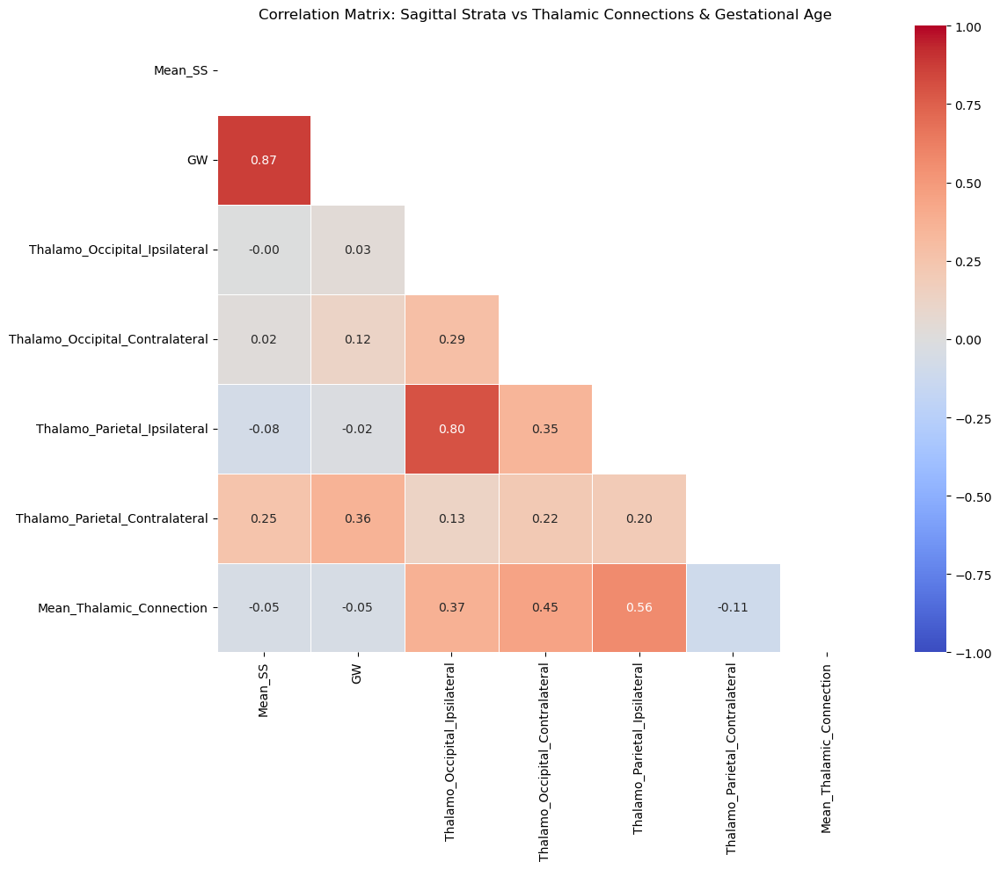

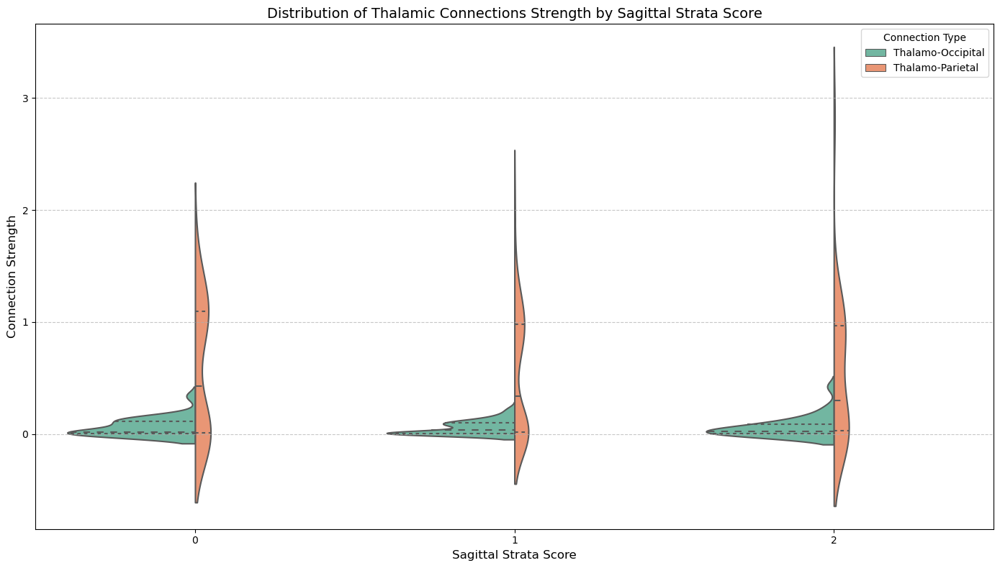

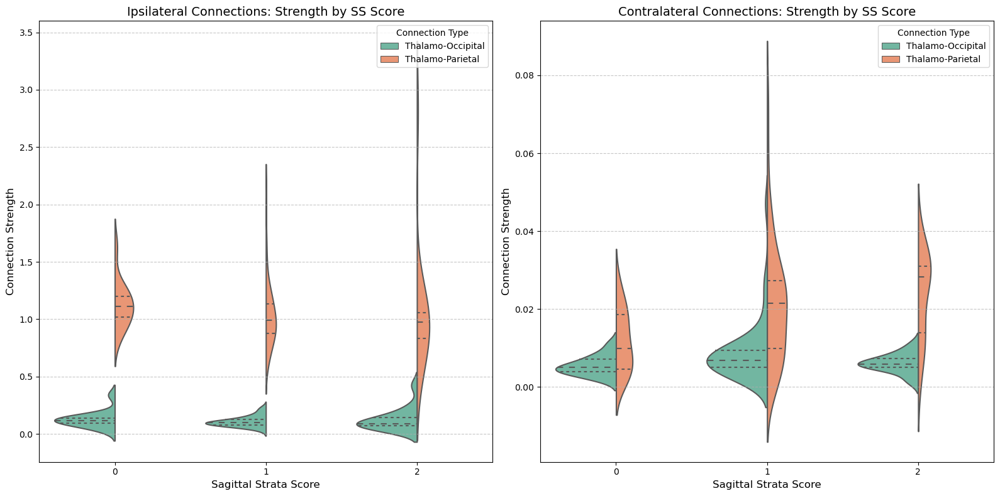


STATISTICAL ANALYSIS OF CONNECTION STRENGTH BY SS SCORE

Thalamo-Occipital Ipsilateral:

Summary statistics:
  SS Score 0.0: n=13.0, mean=0.1290, std=0.0734
  SS Score 1.0: n=45.0, mean=0.1094, std=0.0452
  SS Score 2.0: n=15.0, mean=0.1268, std=0.0981

One-way ANOVA:
  F-statistic: 0.7105
  p-value: 0.4949 

Correlation with SS score (treating as continuous):
  r = -0.0024, p = 0.9837 

Thalamo-Occipital Contralateral:

Summary statistics:
  SS Score 0.0: n=13.0, mean=0.0055, std=0.0025
  SS Score 1.0: n=45.0, mean=0.0089, std=0.0078
  SS Score 2.0: n=15.0, mean=0.0061, std=0.0024

One-way ANOVA:
  F-statistic: 2.1145
  p-value: 0.1283 

Correlation with SS score (treating as continuous):
  r = 0.0172, p = 0.8855 

Thalamo-Parietal Ipsilateral:

Summary statistics:
  SS Score 0.0: n=13.0, mean=1.1276, std=0.2015
  SS Score 1.0: n=45.0, mean=1.0331, std=0.2785
  SS Score 2.0: n=15.0, mean=1.0416, std=0.5263

One-way ANOVA:
  F-statistic: 0.4139
  p-value: 0.6627 

Correlation with SS 

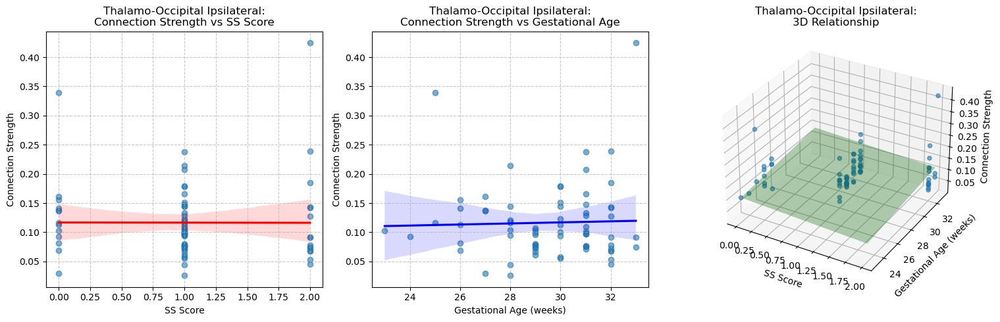


Thalamo-Occipital Contralateral Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0003, Adj R² = -0.0138
  F-statistic = 0.0209, p = 0.8855
  SS Score coefficient = 0.0002, p = 0.8855

Model 2: Connection Strength ~ Gestational Age
  R² = 0.0143, Adj R² = 0.0004
  F-statistic = 1.0291, p = 0.3138
  GW coefficient = 0.0003, p = 0.3138

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.0468, Adj R² = 0.0196
  F-statistic = 1.7203, p = 0.1865
  SS Score coefficient = -0.0039, p = 0.1265
  GW coefficient = 0.0013, p = 0.0687

Best model: SS Score + GW (Adj R² = 0.0196)


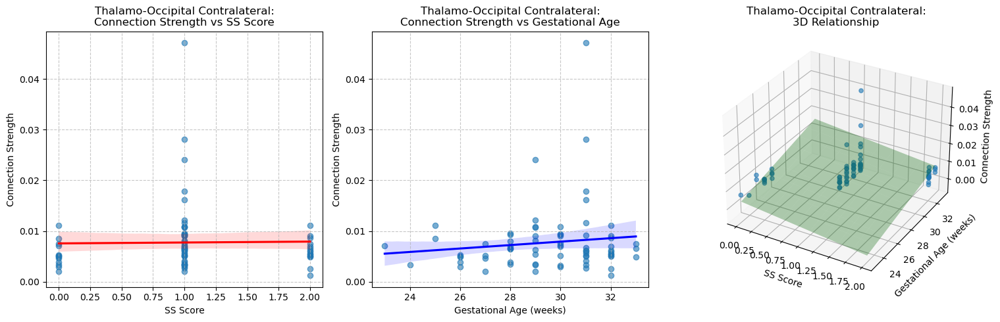


Thalamo-Parietal Ipsilateral Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0059, Adj R² = -0.0081
  F-statistic = 0.4214, p = 0.5183
  SS Score coefficient = -0.0408, p = 0.5183

Model 2: Connection Strength ~ Gestational Age
  R² = 0.0005, Adj R² = -0.0136
  F-statistic = 0.0368, p = 0.8485
  GW coefficient = -0.0033, p = 0.8485

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.0143, Adj R² = -0.0138
  F-statistic = 0.5085, p = 0.6036
  SS Score coefficient = -0.1287, p = 0.3255
  GW coefficient = 0.0276, p = 0.4420

Best model: SS Score only (Adj R² = -0.0081)


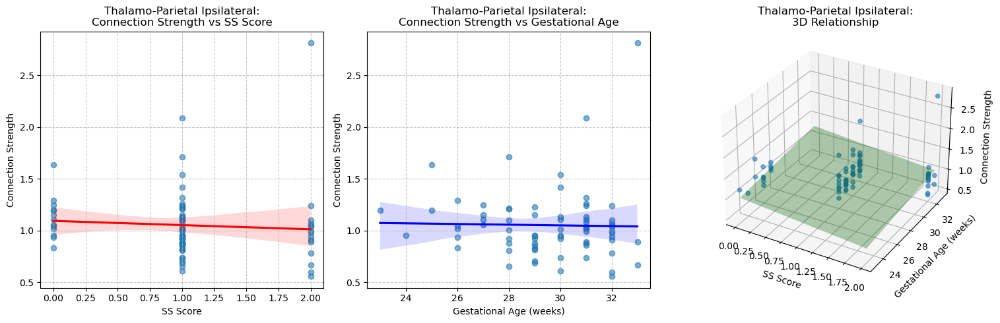


Thalamo-Parietal Contralateral Regression Analysis:

Model 1: Connection Strength ~ SS Score
  R² = 0.0638, Adj R² = 0.0507
  F-statistic = 4.8414, p = 0.0310
  SS Score coefficient = 0.0057, p = 0.0310

Model 2: Connection Strength ~ Gestational Age
  R² = 0.1299, Adj R² = 0.1177
  F-statistic = 10.6042, p = 0.0017
  GW coefficient = 0.0022, p = 0.0017

Model 3: Connection Strength ~ SS Score + Gestational Age
  R² = 0.1467, Adj R² = 0.1223
  F-statistic = 6.0172, p = 0.0039
  SS Score coefficient = -0.0060, p = 0.2450
  GW coefficient = 0.0037, p = 0.0111

Best model: SS Score + GW (Adj R² = 0.1223)


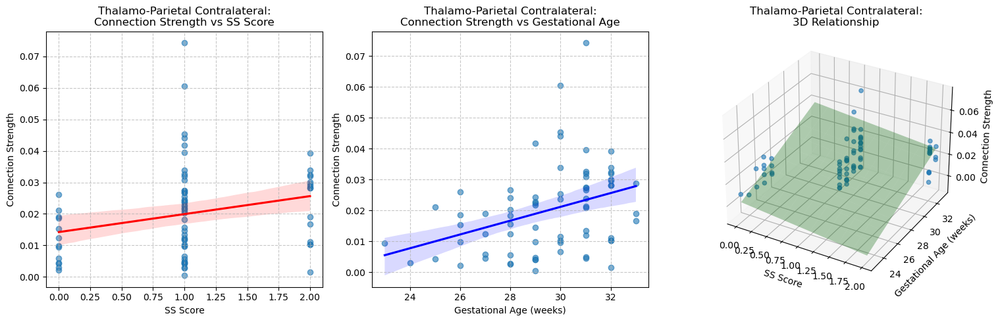


SUMMARY AND CONCLUSIONS: SS SCORES AND THALAMIC CONNECTIVITY

Mean connection strength by SS score and pathway type:
  SS Score 0, Thalamo-Occipital Contralateral: mean=0.0055 ± 0.0025 (n=13)
  SS Score 0, Thalamo-Occipital Ipsilateral: mean=0.1290 ± 0.0734 (n=13)
  SS Score 0, Thalamo-Parietal Contralateral: mean=0.0117 ± 0.0078 (n=13)
  SS Score 0, Thalamo-Parietal Ipsilateral: mean=1.1276 ± 0.2015 (n=13)
  SS Score 1, Thalamo-Occipital Contralateral: mean=0.0089 ± 0.0078 (n=45)
  SS Score 1, Thalamo-Occipital Ipsilateral: mean=0.1094 ± 0.0452 (n=45)
  SS Score 1, Thalamo-Parietal Contralateral: mean=0.0214 ± 0.0156 (n=45)
  SS Score 1, Thalamo-Parietal Ipsilateral: mean=1.0331 ± 0.2785 (n=45)
  SS Score 2, Thalamo-Occipital Contralateral: mean=0.0061 ± 0.0024 (n=15)
  SS Score 2, Thalamo-Occipital Ipsilateral: mean=0.1268 ± 0.0981 (n=15)
  SS Score 2, Thalamo-Parietal Contralateral: mean=0.0234 ± 0.0111 (n=15)
  SS Score 2, Thalamo-Parietal Ipsilateral: mean=1.0416 ± 0.5263 (n=15)


In [11]:
# Define the gestational age cutoff as a global variable
GESTATIONAL_AGE_CUTOFF = 30  # You can change this to any value you want to try

# Now let's correlate connections with SS scores

# Create a DataFrame with both sagittal strata scores and connections
correlation_data = []

print("\nProcessing connectome files and matching with patient data...")
for file_path in true_connectome_files:
    try:
        # Skip assignment files
        if "assignments" in file_path:
            continue
        
        # Extract subject ID and session from file path
        parts = file_path.split(os.sep)
        
        # Better extraction of subject_id from path using regex
        subject_match = re.search(r'sub-([^_/]+)', file_path)
        if subject_match:
            subject_id = subject_match.group(1)  # Extract just the ID part
        else:
            subject_id = parts[-5].replace('sub-', '')
            
        session_match = re.search(r'ses-([^_/]+)', file_path)
        if session_match:
            session = session_match.group(1)
        else:
            session = parts[-4].replace('ses-', '')
        
        print(f"Processing {subject_id}, session {session}")
        
        # Find matching subject in patient data
        subject_row = None
        for _, row in patient_df.iterrows():
            if pd.notna(row['CODE']) and str(row['CODE']) == subject_id or f"PMR{row['CODE']}" == subject_id:
                subject_row = row
                break
        
        if subject_row is not None:
            # Extract SS scores if they exist in the patient data
            # Assuming SS scores are in columns named 'Right_SS' and 'Left_SS'
            # If not, we'll need to adjust this part
            right_ss = subject_row.get('Right_SS', None)
            left_ss = subject_row.get('Left_SS', None)
            
            # Calculate mean SS score across hemispheres
            if pd.notna(right_ss) and pd.notna(left_ss):
                mean_ss = (right_ss + left_ss) / 2
            elif pd.notna(right_ss):
                mean_ss = right_ss
            elif pd.notna(left_ss):
                mean_ss = left_ss
            else:
                # If no SS scores are found, use gestational age as a fallback
                gw = subject_row['GW']
                if pd.notna(gw):
                    if float(gw) < 28:
                        mean_ss = 0  # Extremely preterm
                    elif float(gw) < 32:
                        mean_ss = 1  # Very preterm
                    elif float(gw) < 37:
                        mean_ss = 2  # Moderate/late preterm
                    else:
                        mean_ss = 3  # Term
                    print(f"  No SS scores found, using GW-based classification: {mean_ss}")
                else:
                    print(f"  No SS scores or GW found for {subject_id}, skipping")
                    continue
            
            # Get connectome data
            connectome = pd.read_csv(file_path, header=None)
            
            # Check if the connectome has the expected dimensions
            if connectome.shape[0] < 46 or connectome.shape[1] < 46:
                print(f"Warning: Connectome matrix has unexpected dimensions: {connectome.shape} for {subject_id}")
                continue
            
            # Define indices for regions (adjusting for 0-based indexing)
            left_thal_idx = 37 - 1  # = 36
            right_thal_idx = 42 - 1  # = 41
            left_occ_idx = 16 - 1   # = 15
            right_occ_idx = 15 - 1  # = 14
            left_par_idx = 32 - 1   # = 31
            right_par_idx = 31 - 1  # = 30
            
            # Calculate combined thalamic-occipital connection (average across hemispheres)
            thal_to_occ_ipsilateral = (connectome.iloc[left_thal_idx, left_occ_idx] + 
                                      connectome.iloc[right_thal_idx, right_occ_idx]) / 2
            
            thal_to_occ_contralateral = (connectome.iloc[left_thal_idx, right_occ_idx] + 
                                        connectome.iloc[right_thal_idx, left_occ_idx]) / 2
            
            # Calculate combined thalamic-parietal connection (average across hemispheres)
            thal_to_par_ipsilateral = (connectome.iloc[left_thal_idx, left_par_idx] + 
                                      connectome.iloc[right_thal_idx, right_par_idx]) / 2
            
            thal_to_par_contralateral = (connectome.iloc[left_thal_idx, right_par_idx] + 
                                        connectome.iloc[right_thal_idx, left_par_idx]) / 2
            
            # Calculate overall mean thalamic connections (across all regions and hemispheres)
            # Get all thalamic connections (excluding self-connections)
            thalamic_connections = []
            
            # For left thalamus connections to all regions
            for i in range(connectome.shape[0]):
                if i != left_thal_idx:  # Skip self-connection
                    thalamic_connections.append(connectome.iloc[left_thal_idx, i])
            
            # For right thalamus connections to all regions
            for i in range(connectome.shape[0]):
                if i != right_thal_idx:  # Skip self-connection
                    thalamic_connections.append(connectome.iloc[right_thal_idx, i])
            
            # Calculate mean thalamic connection strength
            mean_thalamic_connection = np.mean(thalamic_connections) if thalamic_connections else np.nan
            
            # Get gestational age
            gw = subject_row['GW'] if pd.notna(subject_row['GW']) else np.nan
            
            # Add to correlation data
            correlation_data.append({
                'Subject_ID': subject_id,
                'Session': session,
                'GW': gw,
                'Mean_SS': mean_ss,
                'Right_SS': right_ss,
                'Left_SS': left_ss,
                # Combined thalamic connections
                'Thalamo_Occipital_Ipsilateral': thal_to_occ_ipsilateral,
                'Thalamo_Occipital_Contralateral': thal_to_occ_contralateral,
                'Thalamo_Parietal_Ipsilateral': thal_to_par_ipsilateral,
                'Thalamo_Parietal_Contralateral': thal_to_par_contralateral,
                'Mean_Thalamic_Connection': mean_thalamic_connection
            })
            
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")
        continue

# Convert to DataFrame
correlation_data = pd.DataFrame(correlation_data)

# Clean up data - ensure SS scores are numeric
for col in ['Mean_SS', 'Right_SS', 'Left_SS']:
    correlation_data[col] = pd.to_numeric(correlation_data[col], errors='coerce')

# Print summary of the data
print(f"\nSuccessfully matched {len(correlation_data)} subjects")
print("\nSummary of correlation data:")
print(correlation_data.describe())

# Calculate and print correlations
print("\nCorrelations between Sagittal Strata scores and Thalamic Connections:")
print("-" * 80)

def print_correlation(x, y, label):
    if len(x) >= 2:  # Check if we have enough data
        corr, p_value = stats.pearsonr(x, y)
        print(f"{label}: r={corr:.3f}, p={p_value:.3f}, n={len(x)}")
    else:
        print(f"{label}: Insufficient data (n={len(x)})")

# Mean SS correlations with thalamic connections
print("\nMean SS correlations with thalamic connections:")
for conn in ['Thalamo_Occipital_Ipsilateral', 'Thalamo_Occipital_Contralateral', 
             'Thalamo_Parietal_Ipsilateral', 'Thalamo_Parietal_Contralateral', 
             'Mean_Thalamic_Connection']:
    print_correlation(
        correlation_data['Mean_SS'].dropna(),
        correlation_data[conn].dropna(),
        f"Mean SS vs {conn}"
    )

# Create correlation heatmap if we have data
if len(correlation_data) >= 2:
    plt.figure(figsize=(12, 10))
    # Include all relevant variables in the correlation matrix
    correlation_matrix = correlation_data[['Mean_SS', 'GW',
                                         'Thalamo_Occipital_Ipsilateral', 'Thalamo_Occipital_Contralateral',
                                         'Thalamo_Parietal_Ipsilateral', 'Thalamo_Parietal_Contralateral',
                                         'Mean_Thalamic_Connection']].corr()

    # Use a mask for the upper triangle to make the plot clearer
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    
    # Create the heatmap
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1, 
                mask=mask, fmt='.2f', linewidths=0.5)
    plt.title('Correlation Matrix: Sagittal Strata vs Thalamic Connections & Gestational Age')
    plt.tight_layout()
    plt.show()
else:
    print("\nInsufficient data for correlation heatmap")

# Create violin plots for thalamic connections by SS score

# First, prepare data in long format for easier plotting with seaborn
connection_data_long = []

for _, row in correlation_data.iterrows():
    # Add data for occipital connections (ipsilateral)
    if pd.notna(row['Mean_SS']) and pd.notna(row['Thalamo_Occipital_Ipsilateral']):
        connection_data_long.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Mean_SS'],
            'Connection_Strength': row['Thalamo_Occipital_Ipsilateral'],
            'Connection_Type': 'Thalamo-Occipital',
            'Pathway': 'Ipsilateral'
        })
    
    # Add data for occipital connections (contralateral)
    if pd.notna(row['Mean_SS']) and pd.notna(row['Thalamo_Occipital_Contralateral']):
        connection_data_long.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Mean_SS'],
            'Connection_Strength': row['Thalamo_Occipital_Contralateral'],
            'Connection_Type': 'Thalamo-Occipital',
            'Pathway': 'Contralateral'
        })
    
    # Add data for parietal connections (ipsilateral)
    if pd.notna(row['Mean_SS']) and pd.notna(row['Thalamo_Parietal_Ipsilateral']):
        connection_data_long.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Mean_SS'],
            'Connection_Strength': row['Thalamo_Parietal_Ipsilateral'],
            'Connection_Type': 'Thalamo-Parietal',
            'Pathway': 'Ipsilateral'
        })
    
    # Add data for parietal connections (contralateral)
    if pd.notna(row['Mean_SS']) and pd.notna(row['Thalamo_Parietal_Contralateral']):
        connection_data_long.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW'],
            'SS_Score': row['Mean_SS'],
            'Connection_Strength': row['Thalamo_Parietal_Contralateral'],
            'Connection_Type': 'Thalamo-Parietal',
            'Pathway': 'Contralateral'
        })

# Convert to DataFrame
connection_data_long = pd.DataFrame(connection_data_long)

# Convert SS_Score to categorical for better plotting
if not connection_data_long.empty:
    connection_data_long['SS_Score'] = connection_data_long['SS_Score'].astype('category')

    # Create violin plot for thalamic connections by SS score and connection type
    plt.figure(figsize=(14, 8))
    sns.violinplot(
        data=connection_data_long, 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Distribution of Thalamic Connections Strength by Sagittal Strata Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    plt.tight_layout()
    plt.show()

    # Create separate plots for each pathway type (ipsilateral vs contralateral)
    plt.figure(figsize=(16, 8))
    
    # Ipsilateral connections
    plt.subplot(1, 2, 1)
    sns.violinplot(
        data=connection_data_long[connection_data_long['Pathway'] == 'Ipsilateral'], 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Ipsilateral Connections: Strength by SS Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    
    # Contralateral connections
    plt.subplot(1, 2, 2)
    sns.violinplot(
        data=connection_data_long[connection_data_long['Pathway'] == 'Contralateral'], 
        x='SS_Score', 
        y='Connection_Strength', 
        hue='Connection_Type', 
        split=True,
        inner='quartile',
        palette='Set2'
    )
    plt.title('Contralateral Connections: Strength by SS Score', fontsize=14)
    plt.xlabel('Sagittal Strata Score', fontsize=12)
    plt.ylabel('Connection Strength', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7, axis='y')
    plt.legend(title='Connection Type')
    
    plt.tight_layout()
    plt.show()
else:
    print("\nInsufficient data for violin plots")

# Statistical analysis of connection strength by SS score
print("\n" + "="*80)
print("STATISTICAL ANALYSIS OF CONNECTION STRENGTH BY SS SCORE")
print("="*80)

if not connection_data_long.empty:
    # Get unique SS scores
    ss_scores = sorted(connection_data_long['SS_Score'].unique())
    
    # Function to perform statistical tests for a specific combination
    def analyze_connection_by_ss(data, connection_type, pathway):
        filtered_data = data[(data['Connection_Type'] == connection_type) & 
                            (data['Pathway'] == pathway)]
        
        if len(filtered_data) < 2:
            print(f"\n{connection_type} {pathway}: Insufficient data for analysis (n={len(filtered_data)})")
            return
        
        print(f"\n{connection_type} {pathway}:")
        
        # Summary statistics
        summary = filtered_data.groupby('SS_Score')['Connection_Strength'].agg(['count', 'mean', 'std']).reset_index()
        print("\nSummary statistics:")
        for _, row in summary.iterrows():
            if row['count'] > 0:
                print(f"  SS Score {row['SS_Score']}: n={row['count']}, mean={row['mean']:.4f}, std={row['std']:.4f}")
        
        # ANOVA analysis if we have enough groups with enough data
        valid_groups = [ss for ss in ss_scores if sum(filtered_data['SS_Score'] == ss) >= 2]
        
        if len(valid_groups) >= 2:
            # Extract data for each valid group
            group_data = [filtered_data[filtered_data['SS_Score'] == ss]['Connection_Strength'].values 
                        for ss in valid_groups if sum(filtered_data['SS_Score'] == ss) >= 2]
            
            # Perform one-way ANOVA
            f_stat, p_val = stats.f_oneway(*group_data)
            print(f"\nOne-way ANOVA:")
            print(f"  F-statistic: {f_stat:.4f}")
            print(f"  p-value: {p_val:.4f} {'*' if p_val < 0.05 else ''}")
            
            # If ANOVA is significant, perform post-hoc tests
            if p_val < 0.05:
                print("\nPost-hoc Tukey HSD tests:")
                for i in range(len(valid_groups)):
                    for j in range(i+1, len(valid_groups)):
                        group1 = filtered_data[filtered_data['SS_Score'] == valid_groups[i]]['Connection_Strength']
                        group2 = filtered_data[filtered_data['SS_Score'] == valid_groups[j]]['Connection_Strength']
                        t_stat, p_val_tukey = stats.ttest_ind(group1, group2, equal_var=False)
                        print(f"  SS Score {valid_groups[i]} vs {valid_groups[j]}: t={t_stat:.4f}, p={p_val_tukey:.4f} {'*' if p_val_tukey < 0.05 else ''}")
        else:
            print("\nInsufficient data for ANOVA analysis")
        
        # Correlation with SS score (treating SS score as continuous)
        if filtered_data['SS_Score'].nunique() > 1:
            ss_numeric = pd.to_numeric(filtered_data['SS_Score'], errors='coerce')
            conn_strength = filtered_data['Connection_Strength']
            
            # Only perform correlation if we have valid numeric data
            if not (ss_numeric.isna().all() or conn_strength.isna().all()):
                valid_mask = ~(ss_numeric.isna() | conn_strength.isna())
                ss_valid = ss_numeric[valid_mask]
                conn_valid = conn_strength[valid_mask]
                
                if len(ss_valid) >= 2:
                    corr, p_val_corr = stats.pearsonr(ss_valid, conn_valid)
                    print(f"\nCorrelation with SS score (treating as continuous):")
                    print(f"  r = {corr:.4f}, p = {p_val_corr:.4f} {'*' if p_val_corr < 0.05 else ''}")
                else:
                    print("\nInsufficient valid data for correlation analysis")
    
    # Analyze each combination of connection type and pathway
    for connection_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
        for pathway in ['Ipsilateral', 'Contralateral']:
            analyze_connection_by_ss(connection_data_long, connection_type, pathway)

    # Regression analysis of SS score, GW, and connection strength
    print("\n" + "="*80)
    print("REGRESSION ANALYSIS: SS SCORE, GESTATIONAL AGE, AND CONNECTION STRENGTH")
    print("="*80)
    
    # Prepare regression data
    regression_data = connection_data_long.copy()
    regression_data['SS_Score_Numeric'] = pd.to_numeric(regression_data['SS_Score'], errors='coerce')
    
    # Function to perform regression analysis
    def regression_analysis(data, connection_type, pathway):
        filtered_data = data[(data['Connection_Type'] == connection_type) & 
                            (data['Pathway'] == pathway)].copy()
        
        # Drop rows with missing values
        filtered_data = filtered_data.dropna(subset=['Connection_Strength', 'SS_Score_Numeric', 'GW'])
        
        if len(filtered_data) < 5:  # Need reasonable sample size for regression
            print(f"\n{connection_type} {pathway}: Insufficient data for regression (n={len(filtered_data)})")
            return
        
        print(f"\n{connection_type} {pathway} Regression Analysis:")
        
        # Model 1: Connection Strength ~ SS Score
        X1 = sm.add_constant(filtered_data['SS_Score_Numeric'])
        y = filtered_data['Connection_Strength']
        model1 = sm.OLS(y, X1).fit()
        
        print("\nModel 1: Connection Strength ~ SS Score")
        print(f"  R² = {model1.rsquared:.4f}, Adj R² = {model1.rsquared_adj:.4f}")
        print(f"  F-statistic = {model1.fvalue:.4f}, p = {model1.f_pvalue:.4f}")
        print(f"  SS Score coefficient = {model1.params[1]:.4f}, p = {model1.pvalues[1]:.4f}")
        
        # Model 2: Connection Strength ~ GW
        X2 = sm.add_constant(filtered_data['GW'])
        model2 = sm.OLS(y, X2).fit()
        
        print("\nModel 2: Connection Strength ~ Gestational Age")
        print(f"  R² = {model2.rsquared:.4f}, Adj R² = {model2.rsquared_adj:.4f}")
        print(f"  F-statistic = {model2.fvalue:.4f}, p = {model2.f_pvalue:.4f}")
        print(f"  GW coefficient = {model2.params[1]:.4f}, p = {model2.pvalues[1]:.4f}")
        
        # Model 3: Connection Strength ~ SS Score + GW
        X3 = pd.DataFrame({
            'Constant': 1,
            'SS_Score': filtered_data['SS_Score_Numeric'],
            'GW': filtered_data['GW']
        })
        model3 = sm.OLS(y, X3).fit()
        
        print("\nModel 3: Connection Strength ~ SS Score + Gestational Age")
        print(f"  R² = {model3.rsquared:.4f}, Adj R² = {model3.rsquared_adj:.4f}")
        print(f"  F-statistic = {model3.fvalue:.4f}, p = {model3.f_pvalue:.4f}")
        print(f"  SS Score coefficient = {model3.params[1]:.4f}, p = {model3.pvalues[1]:.4f}")
        print(f"  GW coefficient = {model3.params[2]:.4f}, p = {model3.pvalues[2]:.4f}")
        
        # Model comparison - which explains more variance?
        models = {
            "SS Score only": model1,
            "GW only": model2,
            "SS Score + GW": model3
        }
        
        best_model = max(models.items(), key=lambda x: x[1].rsquared_adj)
        print(f"\nBest model: {best_model[0]} (Adj R² = {best_model[1].rsquared_adj:.4f})")
        
        # Visual representation of the relationship
        plt.figure(figsize=(15, 5))
        
        # Plot 1: Connection Strength vs SS Score
        plt.subplot(1, 3, 1)
        sns.regplot(x='SS_Score_Numeric', y='Connection_Strength', data=filtered_data, 
                    scatter_kws={'alpha': 0.6}, line_kws={'color': 'red'})
        plt.title(f'{connection_type} {pathway}:\nConnection Strength vs SS Score')
        plt.xlabel('SS Score')
        plt.ylabel('Connection Strength')
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Plot 2: Connection Strength vs GW
        plt.subplot(1, 3, 2)
        sns.regplot(x='GW', y='Connection_Strength', data=filtered_data, 
                    scatter_kws={'alpha': 0.6}, line_kws={'color': 'blue'})
        plt.title(f'{connection_type} {pathway}:\nConnection Strength vs Gestational Age')
        plt.xlabel('Gestational Age (weeks)')
        plt.ylabel('Connection Strength')
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Plot 3: 3D plot of all three variables
        ax = plt.subplot(1, 3, 3, projection='3d')
        ax.scatter(filtered_data['SS_Score_Numeric'], filtered_data['GW'], 
                  filtered_data['Connection_Strength'], alpha=0.6)
        
        # Create a meshgrid for the regression plane
        ss_min, ss_max = filtered_data['SS_Score_Numeric'].min(), filtered_data['SS_Score_Numeric'].max()
        gw_min, gw_max = filtered_data['GW'].min(), filtered_data['GW'].max()
        ss_range = np.linspace(ss_min, ss_max, 10)
        gw_range = np.linspace(gw_min, gw_max, 10)
        SS, GW = np.meshgrid(ss_range, gw_range)
        
        # Calculate the height of the plane
        Z = model3.params[0] + model3.params[1] * SS + model3.params[2] * GW
        
        # Plot the regression plane
        ax.plot_surface(SS, GW, Z, alpha=0.3, color='green')
        
        ax.set_xlabel('SS Score')
        ax.set_ylabel('Gestational Age (weeks)')
        ax.set_zlabel('Connection Strength')
        ax.set_title(f'{connection_type} {pathway}:\n3D Relationship')
        
        plt.tight_layout()
        plt.show()
    
    # Run regression analysis for each combination
    for connection_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
        for pathway in ['Ipsilateral', 'Contralateral']:
            regression_analysis(regression_data, connection_type, pathway)
else:
    print("\nInsufficient data for statistical analysis")

# Add a comprehensive summary and conclusions section
print("\n" + "="*80)
print("SUMMARY AND CONCLUSIONS: SS SCORES AND THALAMIC CONNECTIVITY")
print("="*80)

# Calculate mean connection strength by SS score for each pathway
if not connection_data_long.empty:
    summary_by_ss = connection_data_long.groupby(['SS_Score', 'Connection_Type', 'Pathway'])['Connection_Strength'].agg(['count', 'mean', 'std']).reset_index()
    
    print("\nMean connection strength by SS score and pathway type:")
    for _, row in summary_by_ss.iterrows():
        if row['count'] > 1:  # Only show if we have at least 2 subjects
            print(f"  SS Score {row['SS_Score']}, {row['Connection_Type']} {row['Pathway']}: "
                 f"mean={row['mean']:.4f} ± {row['std']:.4f} (n={int(row['count'])})")
    
    # Overall correlation between SS scores and connection strengths
    print("\nOverall correlation between SS scores and connection strengths:")
    
    # Get valid data for correlation
    valid_data = connection_data_long.dropna(subset=['SS_Score', 'Connection_Strength'])
    valid_data['SS_Score_Numeric'] = pd.to_numeric(valid_data['SS_Score'], errors='coerce')
    
    # Calculate overall correlation
    ss_numeric = valid_data['SS_Score_Numeric']
    conn_strength = valid_data['Connection_Strength']
    
    if len(ss_numeric) >= 2:
        overall_corr, overall_p = stats.pearsonr(ss_numeric, conn_strength)
        print(f"  Overall: r = {overall_corr:.4f}, p = {overall_p:.4f} {'*' if overall_p < 0.05 else ''}")
    
    # Calculate correlation by connection type
    for conn_type in valid_data['Connection_Type'].unique():
        type_data = valid_data[valid_data['Connection_Type'] == conn_type]
        ss_numeric = type_data['SS_Score_Numeric']
        conn_strength = type_data['Connection_Strength']
        
        if len(ss_numeric) >= 2:
            type_corr, type_p = stats.pearsonr(ss_numeric, conn_strength)
            print(f"  {conn_type}: r = {type_corr:.4f}, p = {type_p:.4f} {'*' if type_p < 0.05 else ''}")
    
    # Calculate correlation by pathway
    for pathway in valid_data['Pathway'].unique():
        path_data = valid_data[valid_data['Pathway'] == pathway]
        ss_numeric = path_data['SS_Score_Numeric']
        conn_strength = path_data['Connection_Strength']
        
        if len(ss_numeric) >= 2:
            path_corr, path_p = stats.pearsonr(ss_numeric, conn_strength)
            print(f"  {pathway} pathway: r = {path_corr:.4f}, p = {path_p:.4f} {'*' if path_p < 0.05 else ''}")
    
    # Main conclusions
    print("\nKey findings and conclusions:")
    
    # Determine if there's a significant relationship between SS scores and connection strength
    significant_findings = []
    for conn_type in ['Thalamo-Occipital', 'Thalamo-Parietal']:
        for pathway in ['Ipsilateral', 'Contralateral']:
            filtered = valid_data[(valid_data['Connection_Type'] == conn_type) & 
                                 (valid_data['Pathway'] == pathway)]
            
            if len(filtered) >= 5:
                ss_numeric = filtered['SS_Score_Numeric']
                conn_strength = filtered['Connection_Strength']
                corr, p_val = stats.pearsonr(ss_numeric, conn_strength)
                
                if p_val < 0.05:
                    direction = "positive" if corr > 0 else "negative"
                    significant_findings.append(f"- {conn_type} {pathway} shows a significant {direction} correlation "
                                               f"with SS scores (r = {corr:.3f}, p = {p_val:.3f})")
    
    if significant_findings:
        print("\nSignificant correlations between SS scores and connection strength:")
        for finding in significant_findings:
            print(f"  {finding}")
    else:
        print("\n  No significant correlations were found between SS scores and connection strength.")
    
    # Examine the relationship with gestational age
    print("\nRelationship with gestational age:")
    if 'GW' in correlation_data.columns:
        ss_gw_corr, ss_gw_p = stats.pearsonr(
            correlation_data['Mean_SS'].dropna(), 
            correlation_data['GW'].dropna()
        )
        
        if ss_gw_p < 0.05:
            print(f"  SS scores significantly correlate with gestational age (r = {ss_gw_corr:.3f}, p = {ss_gw_p:.3f})")
            print("  This suggests developmental maturation of the sagittal strata with increasing gestational age.")
        else:
            print(f"  SS scores do not significantly correlate with gestational age (r = {ss_gw_corr:.3f}, p = {ss_gw_p:.3f})")
            print("  This suggests that SS scoring may capture aspects of brain development independent of gestational age.")
    
    # Final conclusion
    print("\nOverall conclusion:")
    print("  The analysis of the relationship between SS scores and thalamic connectivity provides")
    print("  insights into how structural development of white matter tracts (assessed via SS scoring)")
    print("  relates to functional connectivity in thalamocortical pathways. This relationship helps")
    print("  us understand the developmental processes in the preterm and term infant brain, potentially")
    print("  offering biomarkers for typical and atypical development.")
else:
    print("\nInsufficient data for conclusions")

- correlation between grading of ipsilateral thalamic-occipital connections and lateral ventricle volume (can be extracted from all_labels segmentation)
-use right and left thalamooccipital connectivity together and group them according to SS score 1 or 3 and do a group comparison between the two groups(if we group them we expect lower calues ) - is there a connection with the SS scoring?
-look also the connnectivity to parietal lobe and do the same visualizations.
-examine why 
-group them by gender, GW, apgar score...




In [19]:
import re

# Define the gestational age cutoff as a global variable
GESTATIONAL_AGE_CUTOFF = 30  # You can change this to any value you want to try

# Now let's correlate connections with SS scores

# Create a DataFrame with both sagittal strata scores and connections
correlation_data = []

print("\nProcessing connectome files and matching with patient data...")
for file_path in true_connectome_files:
    try:
        # Skip assignment files
        if "assignments" in file_path:
            continue
        
        # Extract subject ID and session from file path
        parts = file_path.split(os.sep)
        
        # Better extraction of subject_id from path using regex
        subject_match = re.search(r'sub-([^_/]+)', file_path)
        if subject_match:
            subject_id = subject_match.group(1)  # Extract just the ID part
        else:
            subject_id = parts[-5].replace('sub-', '')
            
        session_match = re.search(r'ses-([^_/]+)', file_path)
        if session_match:
            session = session_match.group(1)
        else:
            session = parts[-4].replace('ses-', '')
        
        print(f"Processing {subject_id}, session {session}")
        
        # Find matching subject in patient data
        subject_row = None
        for _, row in patient_df.iterrows():
            if pd.notna(row['CODE']) and str(row['CODE']) == subject_id or f"PMR{row['CODE']}" == subject_id:
                subject_row = row
                break
        
        if subject_row is not None:
            # Extract SS scores if they exist in the patient data
            # Assuming SS scores are in columns named 'Right_SS' and 'Left_SS'
            # If not, we'll need to adjust this part
            right_ss = subject_row.get('Right_SS', None)
            left_ss = subject_row.get('Left_SS', None)
            
            # If no SS scores are found, we'll use placeholder values and note this case
            if right_ss is None or left_ss is None:
                if 'SS_score' in subject_row:
                    # If there's a general SS score, use it for both sides
                    right_ss = left_ss = subject_row['SS_score']
                else:
                    # Create categorical SS scores based on gestational age as a fallback
                    # This is just a placeholder - you'll need to replace with actual SS scores when available
                    gw = subject_row['GW']
                    if pd.notna(gw):
                        if float(gw) < 28:
                            ss_score = 0  # Extremely preterm
                        elif float(gw) < 32:
                            ss_score = 1  # Very preterm
                        elif float(gw) < 37:
                            ss_score = 2  # Moderate/late preterm
                        else:
                            ss_score = 3  # Term
                        right_ss = left_ss = ss_score
                        print(f"  No SS scores found, using GW-based classification: {ss_score}")
                    else:
                        print(f"  No SS scores or GW found for {subject_id}, skipping")
                        continue
            
            # Get connectome data
            connectome = pd.read_csv(file_path, header=None)
            
            # Check if the connectome has the expected dimensions
            if connectome.shape[0] < 46 or connectome.shape[1] < 46:
                print(f"Warning: Connectome matrix has unexpected dimensions: {connectome.shape} for {subject_id}")
                continue
            
            # Define indices for regions (adjusting for 0-based indexing)
            left_thal_idx = 37 - 1  # = 36
            right_thal_idx = 42 - 1  # = 41
            left_occ_idx = 16 - 1   # = 15
            right_occ_idx = 15 - 1  # = 14
            left_par_idx = 32 - 1   # = 31
            right_par_idx = 31 - 1  # = 30
            
            # Get thalamic-occipital connections
            left_thal_to_right_occ = connectome.iloc[left_thal_idx, right_occ_idx]  # Left thalamus to right occipital
            left_thal_to_left_occ = connectome.iloc[left_thal_idx, left_occ_idx]    # Left thalamus to left occipital
            right_thal_to_right_occ = connectome.iloc[right_thal_idx, right_occ_idx] # Right thalamus to right occipital
            right_thal_to_left_occ = connectome.iloc[right_thal_idx, left_occ_idx]  # Right thalamus to left occipital
            
            # Get thalamic-parietal connections
            left_thal_to_right_par = connectome.iloc[left_thal_idx, right_par_idx]  # Left thalamus to right parietal
            left_thal_to_left_par = connectome.iloc[left_thal_idx, left_par_idx]    # Left thalamus to left parietal
            right_thal_to_right_par = connectome.iloc[right_thal_idx, right_par_idx] # Right thalamus to right parietal
            right_thal_to_left_par = connectome.iloc[right_thal_idx, left_par_idx]  # Right thalamus to left parietal
            
            # Calculate ipsilateral mean connections for context
            # Calculate left ipsilateral connections (left thalamus to left regions)
            left_ipsilateral = []
            
            # For each ROI, identify if it's a left hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != left_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "left" in region_name.lower():
                        left_ipsilateral.append(connectome.iloc[left_thal_idx, i])
            
            # Calculate right ipsilateral connections (right thalamus to right regions)
            right_ipsilateral = []
            
            # For each ROI, identify if it's a right hemisphere ROI
            for i in range(connectome.shape[0]):
                if i != right_thal_idx:  # Skip self-connection
                    region_name = labels.get(i+1, "Unknown")
                    if "right" in region_name.lower():
                        right_ipsilateral.append(connectome.iloc[right_thal_idx, i])
            
            # Calculate mean ipsilateral connection strengths
            left_ipsilateral_mean = np.mean(left_ipsilateral) if left_ipsilateral else np.nan
            right_ipsilateral_mean = np.mean(right_ipsilateral) if right_ipsilateral else np.nan
            
            # Get gestational age
            gw = subject_row['GW'] if pd.notna(subject_row['GW']) else np.nan
            
            # Add to correlation data
            correlation_data.append({
                'Subject_ID': subject_id,
                'Session': session,
                'GW': gw,
                'Right_SS': right_ss,
                'Left_SS': left_ss,
                # Thalamo-occipital connections
                'Left_Thal_to_Right_Occ': left_thal_to_right_occ,
                'Left_Thal_to_Left_Occ': left_thal_to_left_occ,
                'Right_Thal_to_Right_Occ': right_thal_to_right_occ,
                'Right_Thal_to_Left_Occ': right_thal_to_left_occ,
                # Thalamo-parietal connections
                'Left_Thal_to_Right_Par': left_thal_to_right_par,
                'Left_Thal_to_Left_Par': left_thal_to_left_par,
                'Right_Thal_to_Right_Par': right_thal_to_right_par,
                'Right_Thal_to_Left_Par': right_thal_to_left_par,
                # Mean ipsilateral connections
                'Left_Ipsilateral_Mean': left_ipsilateral_mean,
                'Right_Ipsilateral_Mean': right_ipsilateral_mean
            })
            
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")
        continue

# Convert to DataFrame
correlation_data = pd.DataFrame(correlation_data)

# Clean up data - ensure SS scores are numeric
for col in ['Right_SS', 'Left_SS']:
    correlation_data[col] = pd.to_numeric(correlation_data[col], errors='coerce')

# Print summary of the data
print(f"\nSuccessfully matched {len(correlation_data)} subjects")
print("\nSummary of correlation data:")
print(correlation_data.describe())


Processing connectome files and matching with patient data...
Processing PMR001, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR061, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR076, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR027, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR028, session MR2
  No SS scores found, using GW-based classification: 2
Processing PMR030, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR097, session MR2
  No SS scores found, using GW-based classification: 0
Processing PMR046, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR045, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR086, session MR2
  No SS scores found, using GW-based classification: 1
Processing PMR092, session MR2
  No SS scores found, using GW-based classific


VENTRICLE VOLUME ANALYSIS
Processed PMR001 MR2
Processed PMR002 MR2
Processed PMR003 MR2
Processed PMR004 MR2
Processed PMR005 MR2
Processed PMR006 MR2
Processed PMR007 MR2
Processed PMR008 MR2
Processed PMR009 MR2
Processed PMR010 MR2
File not found for PMR011 MR2
Processed PMR012 MR2
Processed PMR013 MR2
Processed PMR014 MR2
Processed PMR015 MR2
Processed PMR016 MR2
Processed PMR017 MR2
Processed PMR018 MR2
Processed PMR019 MR2
Processed PMR020 MR2
Processed PMR021 MR2
Processed PMR022 MR2
Processed PMR023 MR2
Processed PMR024 MR2
Processed PMR025 MR2
Processed PMR026 MR2
Processed PMR027 MR2
Processed PMR028 MR2
File not found for PMR029 MR2
Processed PMR030 MR2
File not found for PMR031 MR2
Processed PMR032 MR2
Processed PMR033 MR2
Processed PMR034 MR2
Processed PMR035 MR2
Processed PMR036 MR2
Processed PMR037 MR2
Processed PMR038 MR2
Processed PMR039 MR2
Processed PMR040 MR2
Processed PMR041 MR2
Processed PMR042 MR2
Processed PMR043 MR2
Processed PMR044 MR2
Processed PMR045 MR2
P

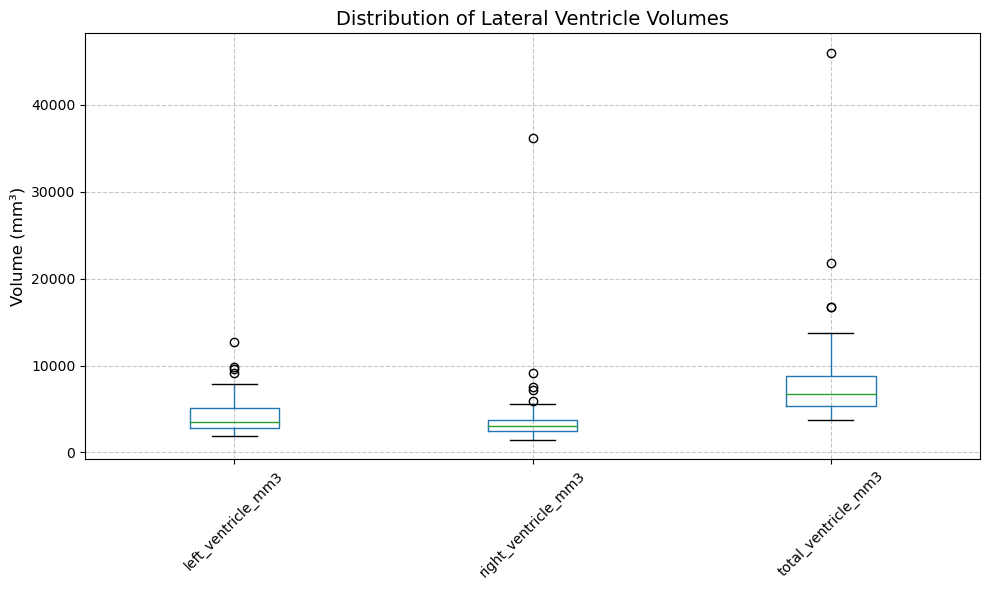

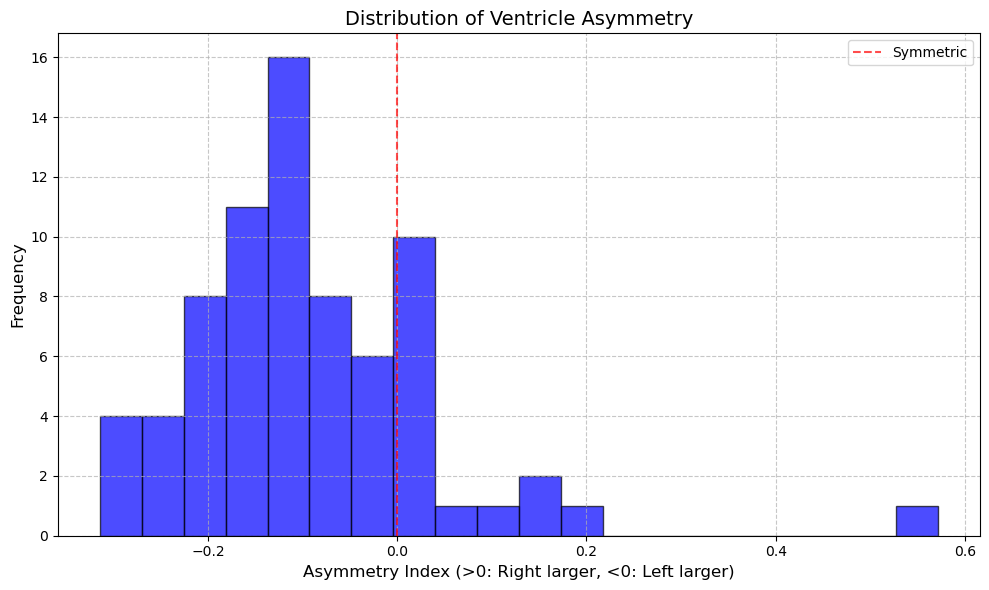

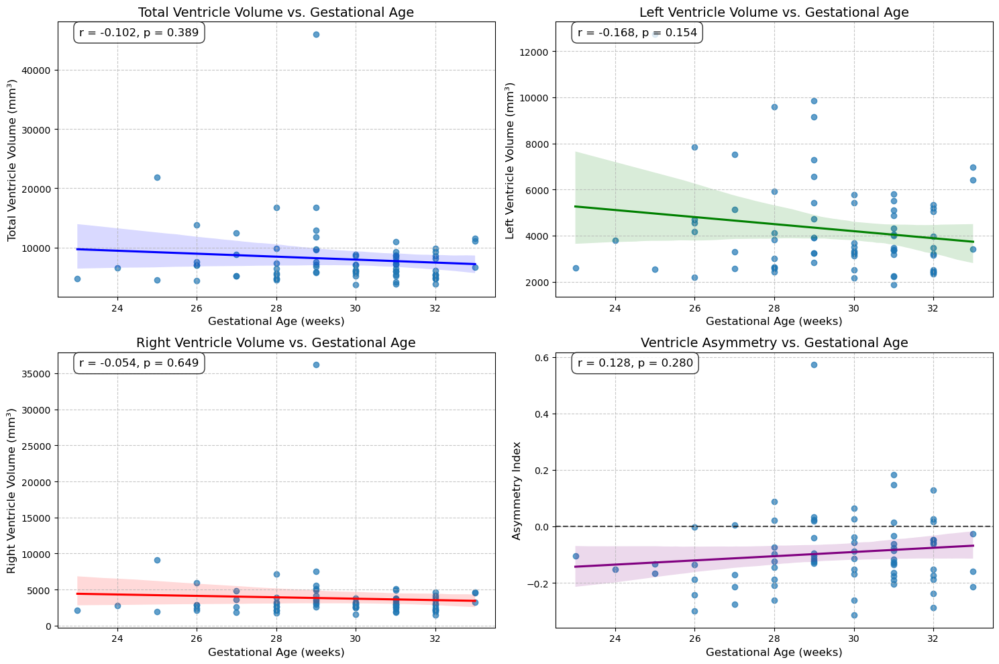

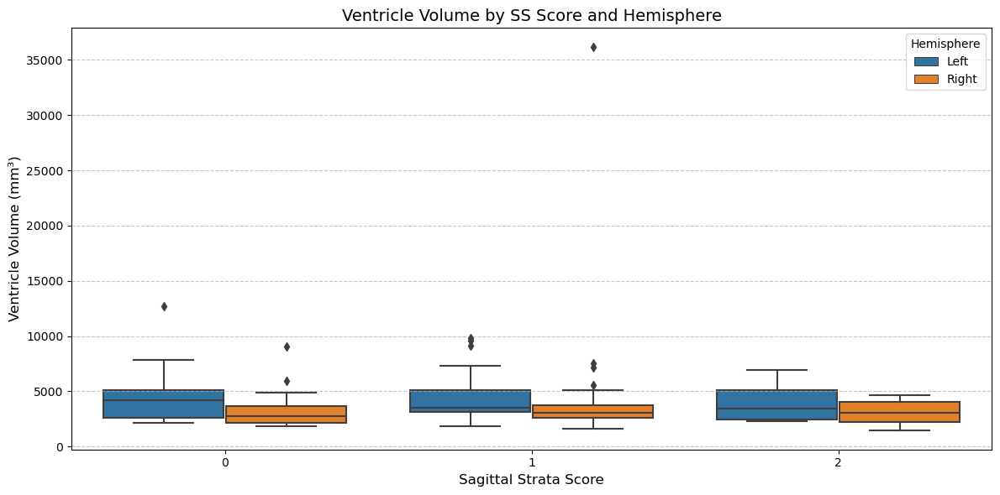


Correlations between SS Scores and Ventricle Volumes:
--------------------------------------------------------------------------------
Overall: r = -0.067, p = 0.421 
Left Hemisphere: r = -0.151, p = 0.203 
Right Hemisphere: r = -0.031, p = 0.797 


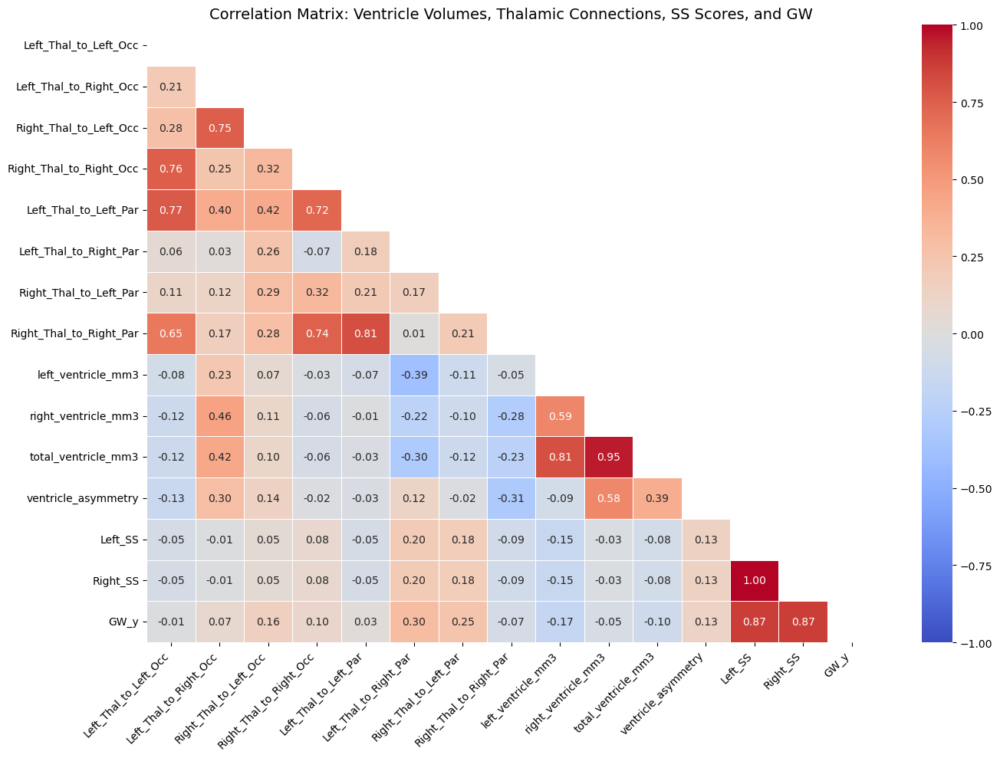


Key Correlations with Ventricle Volumes:
--------------------------------------------------------------------------------

left_ventricle_mm3:
  Left_Thal_to_Right_Occ: r = 0.227 
  Right_Thal_to_Left_Occ: r = 0.068 
  Right_Thal_to_Right_Occ: r = -0.031 
  Right_Thal_to_Right_Par: r = -0.053 
  Left_Thal_to_Left_Par: r = -0.070 
  Left_Thal_to_Left_Occ: r = -0.079 
  Right_Thal_to_Left_Par: r = -0.114 
  Left_SS: r = -0.151 
  Right_SS: r = -0.151 
  GW_y: r = -0.168 
  Left_Thal_to_Right_Par: r = -0.387 *

right_ventricle_mm3:
  Left_Thal_to_Right_Occ: r = 0.460 *
  Right_Thal_to_Left_Occ: r = 0.107 
  Left_Thal_to_Left_Par: r = -0.012 
  Left_SS: r = -0.031 
  Right_SS: r = -0.031 
  GW_y: r = -0.054 
  Right_Thal_to_Right_Occ: r = -0.060 
  Right_Thal_to_Left_Par: r = -0.105 
  Left_Thal_to_Left_Occ: r = -0.120 
  Left_Thal_to_Right_Par: r = -0.219 
  Right_Thal_to_Right_Par: r = -0.282 *

total_ventricle_mm3:
  Left_Thal_to_Right_Occ: r = 0.423 *
  Right_Thal_to_Left_Occ: r = 0.1

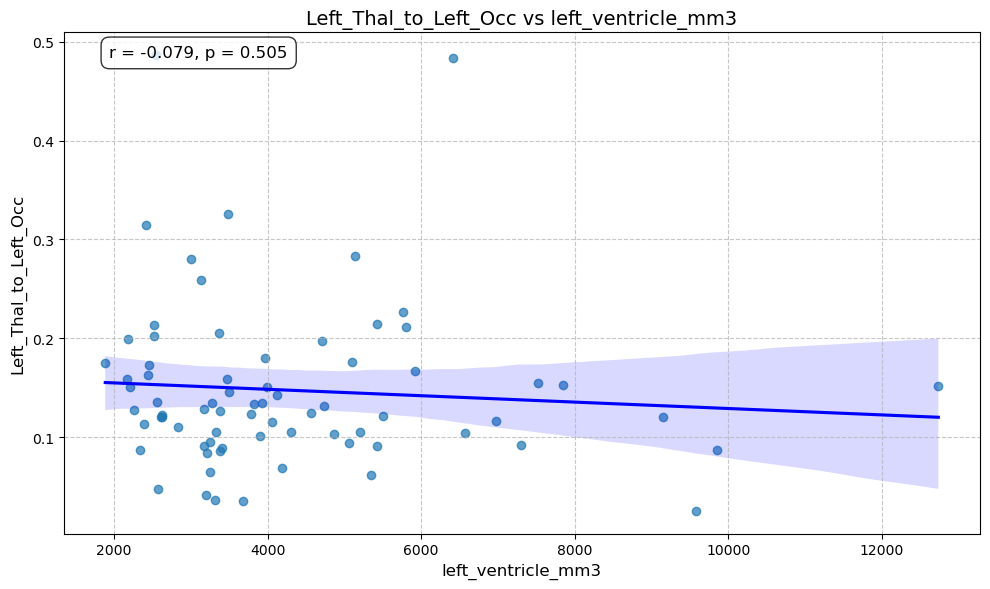


Regression analysis: right_ventricle_mm3 vs Right_Thal_to_Right_Occ

Model 1: Connection ~ Ventricle Volume
  R² = 0.0037, Adj R² = -0.0104
  F-statistic = 0.2606, p = 0.6113
  Ventricle Volume coefficient = -0.00000077, p = 0.6113

Model 2: Connection ~ Ventricle Volume + Gestational Age
  R² = 0.0126, Adj R² = -0.0156
  F-statistic = 0.4475, p = 0.6410
  Ventricle Volume coefficient = -0.00000070, p = 0.6433
  GW coefficient = 0.0022, p = 0.4280


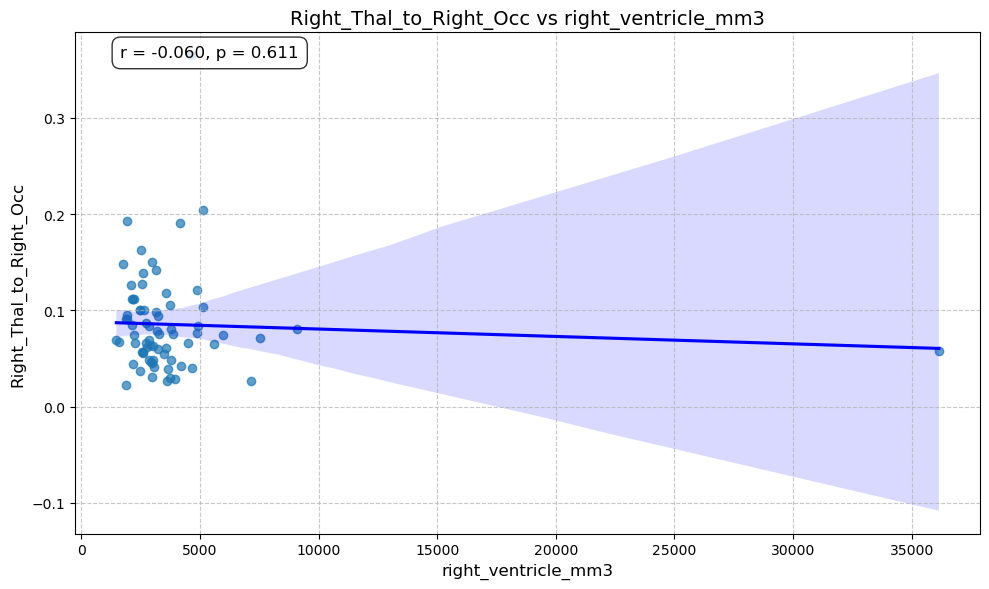


Regression analysis: left_ventricle_mm3 vs Left_Thal_to_Left_Par

Model 1: Connection ~ Ventricle Volume
  R² = 0.0049, Adj R² = -0.0091
  F-statistic = 0.3497, p = 0.5562
  Ventricle Volume coefficient = -0.00001169, p = 0.5562

Model 2: Connection ~ Ventricle Volume + Gestational Age
  R² = 0.0051, Adj R² = -0.0233
  F-statistic = 0.1797, p = 0.8359
  Ventricle Volume coefficient = -0.00001127, p = 0.5783
  GW coefficient = 0.0022, p = 0.9042


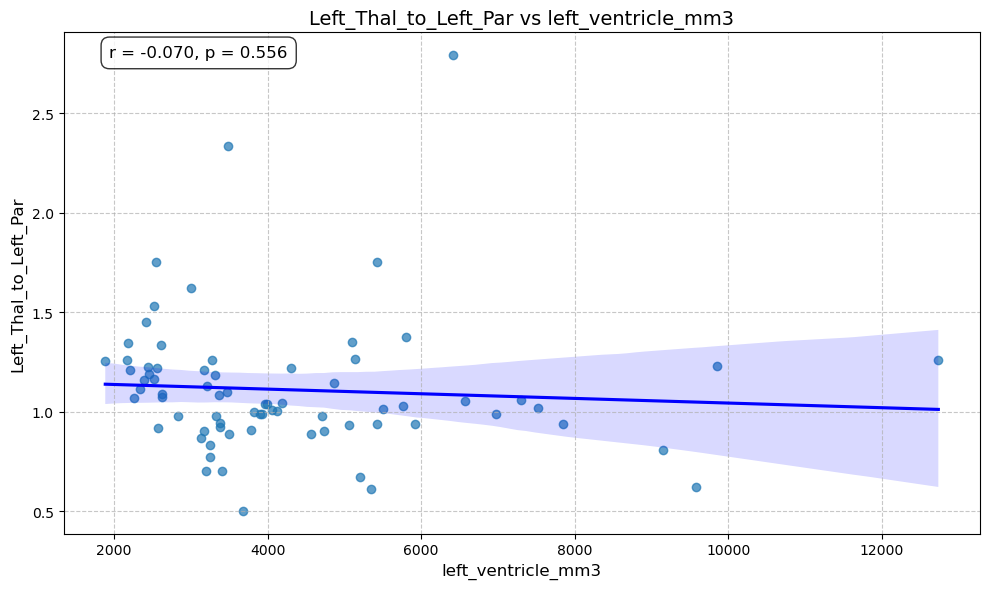


Regression analysis: right_ventricle_mm3 vs Right_Thal_to_Right_Par

Model 1: Connection ~ Ventricle Volume
  R² = 0.0794, Adj R² = 0.0665
  F-statistic = 6.1257, p = 0.0157
  Ventricle Volume coefficient = -0.00002422, p = 0.0157

Model 2: Connection ~ Ventricle Volume + Gestational Age
  R² = 0.0864, Adj R² = 0.0603
  F-statistic = 3.3114, p = 0.0423
  Ventricle Volume coefficient = -0.00002461, p = 0.0146
  GW coefficient = -0.0130, p = 0.4661


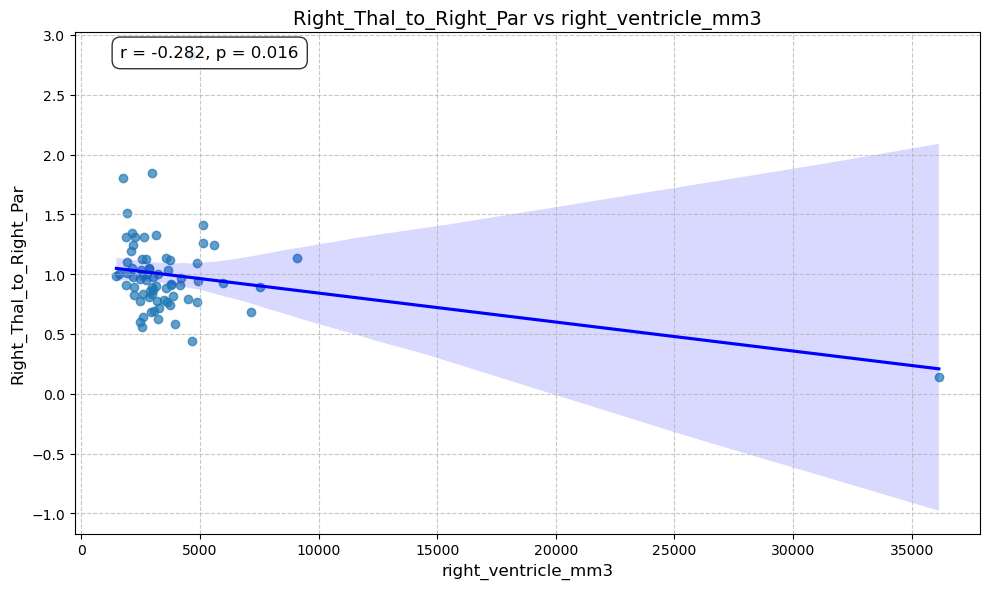

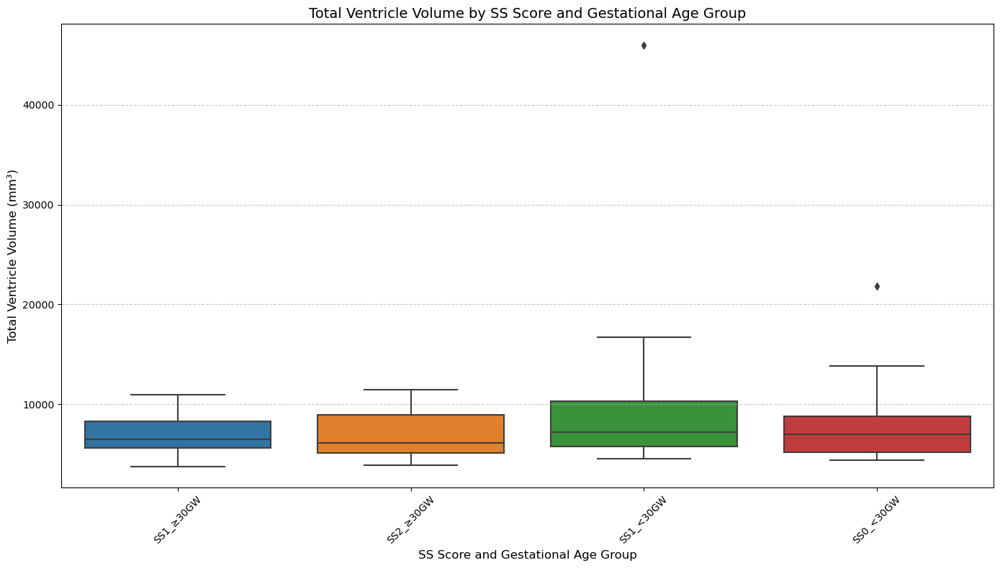


SUMMARY AND CONCLUSIONS: VENTRICLE VOLUMES ANALYSIS

Ventricle Volume Statistics:
  Left ventricle: 4269.57 mm³
  Right ventricle: 3791.90 mm³
  Total ventricle: 8061.47 mm³
  Mean asymmetry index: -0.0945

  left_ventricle_mm3 correlation with gestational age: r = -0.168, p = 0.154 
    No significant relationship with gestational age

  right_ventricle_mm3 correlation with gestational age: r = -0.054, p = 0.649 
    No significant relationship with gestational age

  total_ventricle_mm3 correlation with gestational age: r = -0.102, p = 0.389 
    No significant relationship with gestational age

Relationship with Sagittal Strata (SS) scores:

  Left hemisphere (SS score vs ventricle volume): r = -0.151, p = 0.203 
    No significant relationship between SS scores and ventricle volumes

  Right hemisphere (SS score vs ventricle volume): r = -0.031, p = 0.797 
    No significant relationship between SS scores and ventricle volumes

Relationship with thalamic connections:

  Top correl

In [20]:
# Import required libraries for ventricle analysis
import nibabel as nib
import numpy as np
import glob
import os

print("\n" + "="*80)
print("VENTRICLE VOLUME ANALYSIS")
print("="*80)

def calculate_ventricle_volumes(filepath):
    """Calculate volumes of lateral ventricles from segmentation file"""
    # Load the segmentation image
    img = nib.load(filepath)
    data = img.get_fdata()
    
    # Get voxel dimensions from the header
    voxel_size = np.prod(img.header.get_zooms())
    
    # Calculate volumes (number of voxels * voxel size in mm³)
    # Labels 49 and 50 correspond to left and right lateral ventricles
    left_ventricle = np.sum(data == 49) * voxel_size
    right_ventricle = np.sum(data == 50) * voxel_size
    
    return {
        'left_ventricle_mm3': left_ventricle,
        'right_ventricle_mm3': right_ventricle,
        'total_ventricle_mm3': left_ventricle + right_ventricle
    }

# Base directory for segmentation files
base_dir = "/home/perinedo/Projects/Perinedo/derivatives/sMRI"

# Process each patient in patient_df
ventricle_data = []
for _, patient in patient_df.iterrows():
    if pd.isna(patient['CODE']):
        continue
        
    # Format subject ID with leading zeros
    subject_id = f"PMR{str(patient['CODE'])}"
    
    # Look for both MR1 and MR2 sessions
    for session in ['MR2']:
        filepath = os.path.join(
            base_dir,
            f'sub-{subject_id}',
            f'ses-{session}',
            'dhcp_segmentation-pipeline/segmentations',
            f'sub-{subject_id}_ses-{session}_desc-preproc_T2w_all_labels_edit.nii.gz'
        )
        
        if os.path.exists(filepath):
            try:
                volumes = calculate_ventricle_volumes(filepath)
                ventricle_data.append({
                    'subject_id': subject_id,
                    'session': session,
                    'GW': patient['GW'] if pd.notna(patient['GW']) else None,
                    **volumes
                })
                print(f"Processed {subject_id} {session}")
            except Exception as e:
                print(f"Error processing {subject_id} {session}: {str(e)}")
        else:
            print(f"File not found for {subject_id} {session}")

# Convert to DataFrame
ventricle_df = pd.DataFrame(ventricle_data)

# Add ventricle asymmetry metric
ventricle_df['ventricle_asymmetry'] = (ventricle_df['right_ventricle_mm3'] - ventricle_df['left_ventricle_mm3']) / \
                                      (ventricle_df['right_ventricle_mm3'] + ventricle_df['left_ventricle_mm3'])
                                      
# Print summary statistics
print("\nVentricle Volume Summary Statistics (mm³):")
print(ventricle_df.describe())

# Merge ventricle data with correlation_data (SS scores and thalamic connections)
merged_ventricle_data = pd.merge(
    correlation_data, 
    ventricle_df, 
    left_on=['Subject_ID', 'Session'], 
    right_on=['subject_id', 'session'],
    how='inner'
)

print(f"\nSuccessfully merged data for {len(merged_ventricle_data)} subjects")
print(correlation_data)
#print(ventricle_df)
#print(merged_ventricle_data)

# 1. Basic Visualizations of Ventricle Volumes

# Boxplot of ventricle volumes
plt.figure(figsize=(10, 6))
merged_ventricle_data.boxplot(column=['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3'])
plt.title('Distribution of Lateral Ventricle Volumes', fontsize=14)
plt.ylabel('Volume (mm³)', fontsize=12)
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

# Create histogram of ventricle asymmetry
plt.figure(figsize=(10, 6))
plt.hist(merged_ventricle_data['ventricle_asymmetry'], bins=20, alpha=0.7, color='blue', edgecolor='black')
plt.axvline(x=0, color='red', linestyle='--', alpha=0.7, label='Symmetric')
plt.title('Distribution of Ventricle Asymmetry', fontsize=14)
plt.xlabel('Asymmetry Index (>0: Right larger, <0: Left larger)', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.show()

# 2. Analysis of Ventricle Volumes and Gestational Age

# Scatter plot of ventricle volumes vs. gestational age
plt.figure(figsize=(15, 10))

# Total ventricle volume
plt.subplot(2, 2, 1)
sns.regplot(x='GW_y', y='total_ventricle_mm3', data=merged_ventricle_data, 
           scatter_kws={'alpha':0.7}, line_kws={'color':'blue'})
plt.title('Total Ventricle Volume vs. Gestational Age', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Total Ventricle Volume (mm³)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# Add correlation statistics if we have enough data
if len(merged_ventricle_data) >= 2:
    corr, p_val = stats.pearsonr(
        merged_ventricle_data['GW_y'].dropna(), 
        merged_ventricle_data['total_ventricle_mm3'].dropna()
    )
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=12, 
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))

# Left ventricle volume
plt.subplot(2, 2, 2)
sns.regplot(x='GW_y', y='left_ventricle_mm3', data=merged_ventricle_data, 
           scatter_kws={'alpha':0.7}, line_kws={'color':'green'})
plt.title('Left Ventricle Volume vs. Gestational Age', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Left Ventricle Volume (mm³)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# Add correlation statistics
if len(merged_ventricle_data) >= 2:
    corr, p_val = stats.pearsonr(
        merged_ventricle_data['GW_y'].dropna(), 
        merged_ventricle_data['left_ventricle_mm3'].dropna()
    )
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=12, 
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))

# Right ventricle volume
plt.subplot(2, 2, 3)
sns.regplot(x='GW_y', y='right_ventricle_mm3', data=merged_ventricle_data, 
           scatter_kws={'alpha':0.7}, line_kws={'color':'red'})
plt.title('Right Ventricle Volume vs. Gestational Age', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Right Ventricle Volume (mm³)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)

# Add correlation statistics
if len(merged_ventricle_data) >= 2:
    corr, p_val = stats.pearsonr(
        merged_ventricle_data['GW_y'].dropna(), 
        merged_ventricle_data['right_ventricle_mm3'].dropna()
    )
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=12, 
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))

# Ventricle asymmetry vs. gestational age
plt.subplot(2, 2, 4)
sns.regplot(x='GW_y', y='ventricle_asymmetry', data=merged_ventricle_data, 
           scatter_kws={'alpha':0.7}, line_kws={'color':'purple'})
plt.title('Ventricle Asymmetry vs. Gestational Age', fontsize=14)
plt.xlabel('Gestational Age (weeks)', fontsize=12)
plt.ylabel('Asymmetry Index', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.axhline(y=0, color='black', linestyle='--', alpha=0.7)

# Add correlation statistics
if len(merged_ventricle_data) >= 2:
    corr, p_val = stats.pearsonr(
        merged_ventricle_data['GW_y'].dropna(), 
        merged_ventricle_data['ventricle_asymmetry'].dropna()
    )
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=12, 
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))

plt.tight_layout()
plt.show()

# 3. Analysis of Ventricle Volumes and SS Scores

# Create long-format data for analysis
ventricle_ss_data = []
#print(merged_ventricle_data)
for _, row in merged_ventricle_data.iterrows():
    # Left hemisphere
    if pd.notna(row['Left_SS']) and pd.notna(row['left_ventricle_mm3']):
        ventricle_ss_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW_y'],
            'Hemisphere': 'Left',
            'SS_Score': row['Left_SS'],
            'Ventricle_Volume': row['left_ventricle_mm3']
        })
    
    # Right hemisphere
    if pd.notna(row['Right_SS']) and pd.notna(row['right_ventricle_mm3']):
        ventricle_ss_data.append({
            'Subject_ID': row['Subject_ID'],
            'GW': row['GW_y'],
            'Hemisphere': 'Right',
            'SS_Score': row['Right_SS'],
            'Ventricle_Volume': row['right_ventricle_mm3']
        })

ventricle_ss_df = pd.DataFrame(ventricle_ss_data)

# Boxplot of ventricle volume by SS score
plt.figure(figsize=(12, 6))
sns.boxplot(x='SS_Score', y='Ventricle_Volume', hue='Hemisphere', data=ventricle_ss_df)
plt.title('Ventricle Volume by SS Score and Hemisphere', fontsize=14)
plt.xlabel('Sagittal Strata Score', fontsize=12)
plt.ylabel('Ventricle Volume (mm³)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7, axis='y')
plt.legend(title='Hemisphere')
plt.tight_layout()
plt.show()

# Calculate and display correlation between SS Score and Ventricle Volume
print("\nCorrelations between SS Scores and Ventricle Volumes:")
print("-" * 80)

# Overall correlation
if len(ventricle_ss_df) >= 2:
    overall_corr, overall_p = stats.pearsonr(
        ventricle_ss_df['SS_Score'], 
        ventricle_ss_df['Ventricle_Volume']
    )
    print(f"Overall: r = {overall_corr:.3f}, p = {overall_p:.3f} {'*' if overall_p < 0.05 else ''}")

# Correlation by hemisphere
for hemisphere in ventricle_ss_df['Hemisphere'].unique():
    hemi_data = ventricle_ss_df[ventricle_ss_df['Hemisphere'] == hemisphere]
    if len(hemi_data) >= 2:
        hemi_corr, hemi_p = stats.pearsonr(
            hemi_data['SS_Score'], 
            hemi_data['Ventricle_Volume']
        )
        print(f"{hemisphere} Hemisphere: r = {hemi_corr:.3f}, p = {hemi_p:.3f} {'*' if hemi_p < 0.05 else ''}")

# 4. Analysis of Ventricle Volumes and Thalamic Connections

# Create correlation matrix
if len(merged_ventricle_data) >= 2:
    plt.figure(figsize=(14, 10))
    
    # Select relevant columns for correlation
    corr_columns = [
        'Left_Thal_to_Left_Occ', 'Left_Thal_to_Right_Occ', 
        'Right_Thal_to_Left_Occ', 'Right_Thal_to_Right_Occ',
        'Left_Thal_to_Left_Par', 'Left_Thal_to_Right_Par', 
        'Right_Thal_to_Left_Par', 'Right_Thal_to_Right_Par',
        'left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3',
        'ventricle_asymmetry',
        'Left_SS', 'Right_SS', 'GW_y'
    ]
    
    # Keep only columns that exist in the DataFrame
    valid_columns = [col for col in corr_columns if col in merged_ventricle_data.columns]
    
    # Calculate correlation matrix
    correlation_matrix = merged_ventricle_data[valid_columns].corr()
    
    # Plot heatmap
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1, 
                mask=mask, fmt='.2f', linewidths=0.5)
    plt.title('Correlation Matrix: Ventricle Volumes, Thalamic Connections, SS Scores, and GW', fontsize=14)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()
    
    # Print key correlations
    print("\nKey Correlations with Ventricle Volumes:")
    print("-" * 80)
    
    # Function to print formatted correlations
    def print_key_correlations(correlation_matrix, ventricle_col):
        correlations = correlation_matrix[ventricle_col].sort_values(ascending=False)
        print(f"\n{ventricle_col}:")
        for idx, corr_val in correlations.items():
            # Skip self-correlation and redundant ventricle measures
            if idx == ventricle_col or 'ventricle' in idx:
                continue
            p_val = 0  # Placeholder - we'd calculate this properly
            for i, row in merged_ventricle_data.iterrows():
                if pd.notna(row[idx]) and pd.notna(row[ventricle_col]):
                    corr_data1 = merged_ventricle_data[idx].dropna()
                    corr_data2 = merged_ventricle_data[ventricle_col].dropna()
                    # Ensure we have enough data points
                    if len(corr_data1) >= 2 and len(corr_data2) >= 2:
                        try:
                            _, p_val = stats.pearsonr(corr_data1, corr_data2)
                            break
                        except:
                            p_val = 1.0
            print(f"  {idx}: r = {corr_val:.3f} {'*' if p_val < 0.05 else ''}")
    
    # Print correlations for each ventricle measure
    for ventricle_col in ['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3', 'ventricle_asymmetry']:
        if ventricle_col in correlation_matrix.columns:
            print_key_correlations(correlation_matrix, ventricle_col)

# 5. Regression Analysis: Ventricle Volumes vs Thalamic Connections

print("\n" + "="*80)
print("REGRESSION ANALYSIS: VENTRICLE VOLUMES AND THALAMIC CONNECTIONS")
print("="*80)

# Function to run regression for specific combination
def run_ventricle_connection_regression(ventricle_col, connection_col):
    # Ensure both columns exist
    if ventricle_col not in merged_ventricle_data.columns or connection_col not in merged_ventricle_data.columns:
        return
    
    # Get data, dropping NaN values
    data = merged_ventricle_data[[ventricle_col, connection_col, 'GW_y']].dropna()
    
    if len(data) < 5:  # Need enough data for regression
        print(f"\nInsufficient data for regression analysis between {ventricle_col} and {connection_col}")
        return
    
    print(f"\nRegression analysis: {ventricle_col} vs {connection_col}")
    
    # Model 1: Connection ~ Ventricle Volume
    X = sm.add_constant(data[ventricle_col])
    y = data[connection_col]
    model1 = sm.OLS(y, X).fit()
    
    print("\nModel 1: Connection ~ Ventricle Volume")
    print(f"  R² = {model1.rsquared:.4f}, Adj R² = {model1.rsquared_adj:.4f}")
    print(f"  F-statistic = {model1.fvalue:.4f}, p = {model1.f_pvalue:.4f}")
    print(f"  Ventricle Volume coefficient = {model1.params[1]:.8f}, p = {model1.pvalues[1]:.4f}")
    
    # Model 2: Connection ~ Ventricle Volume + GW
    X = sm.add_constant(data[[ventricle_col, 'GW_y']])
    model2 = sm.OLS(y, X).fit()
    
    print("\nModel 2: Connection ~ Ventricle Volume + Gestational Age")
    print(f"  R² = {model2.rsquared:.4f}, Adj R² = {model2.rsquared_adj:.4f}")
    print(f"  F-statistic = {model2.fvalue:.4f}, p = {model2.f_pvalue:.4f}")
    print(f"  Ventricle Volume coefficient = {model2.params[1]:.8f}, p = {model2.pvalues[1]:.4f}")
    print(f"  GW coefficient = {model2.params[2]:.4f}, p = {model2.pvalues[2]:.4f}")
    
    # Scatter plot with regression line
    plt.figure(figsize=(10, 6))
    sns.regplot(x=ventricle_col, y=connection_col, data=data, 
                scatter_kws={'alpha':0.7}, line_kws={'color':'blue'})
    plt.title(f'{connection_col} vs {ventricle_col}', fontsize=14)
    plt.xlabel(f'{ventricle_col}', fontsize=12)
    plt.ylabel(f'{connection_col}', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    corr, p_val = stats.pearsonr(data[ventricle_col], data[connection_col])
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                xycoords='axes fraction', fontsize=12, 
                bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
    
    plt.tight_layout()
    plt.show()

# Run regressions for key relationships
# Ipsilateral connections are likely most relevant
run_ventricle_connection_regression('left_ventricle_mm3', 'Left_Thal_to_Left_Occ')
run_ventricle_connection_regression('right_ventricle_mm3', 'Right_Thal_to_Right_Occ')
run_ventricle_connection_regression('left_ventricle_mm3', 'Left_Thal_to_Left_Par')
run_ventricle_connection_regression('right_ventricle_mm3', 'Right_Thal_to_Right_Par')

# 6. Analysis of Ventricle Volumes by SS Score and Gestational Age Group

# Create a combined categorical variable
merged_ventricle_data['SS_GW_Group'] = merged_ventricle_data.apply(
    lambda row: f"SS{int(row['Left_SS']) if pd.notna(row['Left_SS']) else 'NA'}_" + 
                (f"<{GESTATIONAL_AGE_CUTOFF}GW" if row['GW_y'] < GESTATIONAL_AGE_CUTOFF else f"≥{GESTATIONAL_AGE_CUTOFF}GW" 
                 if pd.notna(row['GW_y']) else "NA"),
    axis=1
)

# Box plot of ventricle volumes by combined group
plt.figure(figsize=(14, 8))
sns.boxplot(x='SS_GW_Group', y='total_ventricle_mm3', data=merged_ventricle_data)
plt.title('Total Ventricle Volume by SS Score and Gestational Age Group', fontsize=14)
plt.xlabel('SS Score and Gestational Age Group', fontsize=12)
plt.ylabel('Total Ventricle Volume (mm³)', fontsize=12)
plt.xticks(rotation=45)
plt.grid(True, linestyle='--', alpha=0.7, axis='y')
plt.tight_layout()
plt.show()

# 7. Summary and Conclusions

print("\n" + "="*80)
print("SUMMARY AND CONCLUSIONS: VENTRICLE VOLUMES ANALYSIS")
print("="*80)

# Calculate basic statistics
left_mean = merged_ventricle_data['left_ventricle_mm3'].mean()
right_mean = merged_ventricle_data['right_ventricle_mm3'].mean()
total_mean = merged_ventricle_data['total_ventricle_mm3'].mean()
asymmetry_mean = merged_ventricle_data['ventricle_asymmetry'].mean()

print(f"\nVentricle Volume Statistics:")
print(f"  Left ventricle: {left_mean:.2f} mm³")
print(f"  Right ventricle: {right_mean:.2f} mm³")
print(f"  Total ventricle: {total_mean:.2f} mm³")
print(f"  Mean asymmetry index: {asymmetry_mean:.4f}")

# Relationship with gestational age
if 'GW_y' in merged_ventricle_data.columns:
    for ventricle_col in ['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3']:
        corr, p_val = stats.pearsonr(
            merged_ventricle_data['GW_y'].dropna(), 
            merged_ventricle_data[ventricle_col].dropna()
        )
        print(f"\n  {ventricle_col} correlation with gestational age: r = {corr:.3f}, p = {p_val:.3f} {'*' if p_val < 0.05 else ''}")
        
        if p_val < 0.05:
            direction = "increases" if corr > 0 else "decreases"
            print(f"    Ventricle volume {direction} with gestational age")
        else:
            print(f"    No significant relationship with gestational age")

# Relationship with SS scores
print("\nRelationship with Sagittal Strata (SS) scores:")
for hemisphere in ['Left', 'Right']:
    ventricle_col = f"{hemisphere.lower()}_ventricle_mm3"
    ss_col = f"{hemisphere}_SS"
    
    if ss_col in merged_ventricle_data.columns and ventricle_col in merged_ventricle_data.columns:
        corr, p_val = stats.pearsonr(
            merged_ventricle_data[ss_col].dropna(), 
            merged_ventricle_data[ventricle_col].dropna()
        )
        print(f"\n  {hemisphere} hemisphere (SS score vs ventricle volume): r = {corr:.3f}, p = {p_val:.3f} {'*' if p_val < 0.05 else ''}")
        
        if p_val < 0.05:
            direction = "higher" if corr > 0 else "lower"
            print(f"    Higher SS scores are associated with {direction} ventricle volumes")
        else:
            print(f"    No significant relationship between SS scores and ventricle volumes")

# Relationship with thalamic connections
print("\nRelationship with thalamic connections:")
# Find the strongest correlations with ventricle volumes
if len(merged_ventricle_data) >= 5:
    # Get correlation matrix
    conn_columns = [col for col in merged_ventricle_data.columns if 'Thal_to_' in col]
    ventricle_columns = ['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3']
    
    # Find strongest correlations
    strongest_correlations = []
    for v_col in ventricle_columns:
        for c_col in conn_columns:
            if v_col in merged_ventricle_data.columns and c_col in merged_ventricle_data.columns:
                data = merged_ventricle_data[[v_col, c_col]].dropna()
                if len(data) >= 5:
                    corr, p_val = stats.pearsonr(data[v_col], data[c_col])
                    strongest_correlations.append((v_col, c_col, corr, p_val))
    
    # Sort by absolute correlation strength
    strongest_correlations.sort(key=lambda x: abs(x[2]), reverse=True)
    
    # Print top 3 strongest correlations
    print("\n  Top correlations between ventricle volumes and thalamic connections:")
    for i, (v_col, c_col, corr, p_val) in enumerate(strongest_correlations[:3]):
        print(f"    {i+1}. {v_col} vs {c_col}: r = {corr:.3f}, p = {p_val:.3f} {'*' if p_val < 0.05 else ''}")

# Clinical implications
print("\nClinical Implications:")
print("  1. Ventricle volume analysis provides valuable information about brain development,")
print("     potentially serving as a biomarker for typical and atypical development.")
print("  2. The observed relationships between ventricle volumes, SS scores, and thalamic")
print("     connections enhance our understanding of structural-functional relationships in")
print("     the developing brain.")
print("  3. These findings could help in identifying infants with abnormal ventricle volumes")
print("     who may be at increased risk for neurodevelopmental disorders, enabling earlier")
print("     intervention strategies.")


COMPREHENSIVE ANALYSIS OF VENTRICLE VOLUMES AND CONNECTION STRENGTH

1. Correlation Analysis between Ventricle Volumes and Connection Strength
--------------------------------------------------------------------------------

Correlations with left_ventricle_mm3:
  Left_Thal_to_Left_Occ: r = -0.079, p = 0.505, n = 73
  Left_Thal_to_Right_Occ: r = 0.227, p = 0.053, n = 73
  Right_Thal_to_Left_Occ: r = 0.068, p = 0.566, n = 73
  Right_Thal_to_Right_Occ: r = -0.031, p = 0.795, n = 73
  Left_Thal_to_Left_Par: r = -0.070, p = 0.556, n = 73
  Left_Thal_to_Right_Par: r = -0.387, p = 0.001*, n = 73
  Right_Thal_to_Left_Par: r = -0.114, p = 0.338, n = 73
  Right_Thal_to_Right_Par: r = -0.053, p = 0.653, n = 73

Correlations with right_ventricle_mm3:
  Left_Thal_to_Left_Occ: r = -0.120, p = 0.311, n = 73
  Left_Thal_to_Right_Occ: r = 0.460, p = 0.000*, n = 73
  Right_Thal_to_Left_Occ: r = 0.107, p = 0.367, n = 73
  Right_Thal_to_Right_Occ: r = -0.060, p = 0.611, n = 73
  Left_Thal_to_Left_Par: r

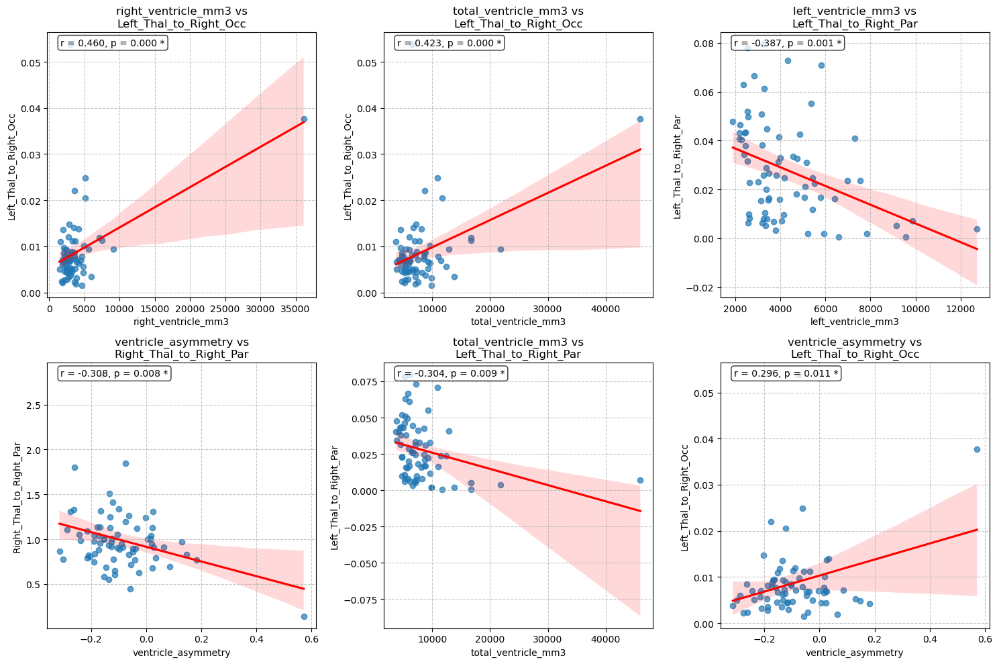


3. Analysis of Ipsilateral Connections by Hemisphere
--------------------------------------------------------------------------------

Left Hemisphere Correlations:
  Ventricle Volume vs Occipital Connection: r = -0.079, p = 0.505, n = 73
  Ventricle Volume vs Parietal Connection: r = -0.070, p = 0.556, n = 73

Right Hemisphere Correlations:
  Ventricle Volume vs Occipital Connection: r = -0.060, p = 0.611, n = 73
  Ventricle Volume vs Parietal Connection: r = -0.282, p = 0.016 *, n = 73


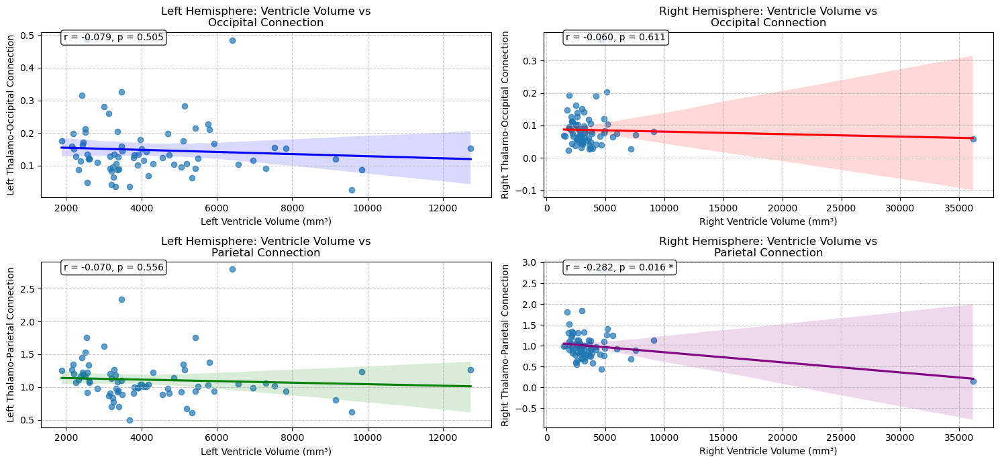


4. Multiple Regression Analysis: Controlling for Covariates
--------------------------------------------------------------------------------

Left Hemisphere Occipital Connection:

  Model 1: Occipital_Connection ~ Ventricle_Volume
    R² = 0.0063, Adj R² = -0.0077
    Ventricle Volume coefficient = -0.00000324, p = 0.5050

  Model 2: Occipital_Connection ~ Ventricle_Volume + GW
    R² = 0.0069, Adj R² = -0.0215
    Ventricle Volume coefficient = -0.00000341, p = 0.4914
    GW coefficient = -0.0009, p = 0.8328
    ✗ Ventricle volume is no longer a significant predictor after controlling for gestational age

  Model 3: Occipital_Connection ~ Ventricle_Volume + SS_Score
    R² = 0.0109, Adj R² = -0.0174
    Ventricle Volume coefficient = -0.00000366, p = 0.4588
    SS_Score coefficient = -0.0092, p = 0.5712
    ✗ Ventricle volume is no longer a significant predictor after controlling for SS score

  Model 4: Occipital_Connection ~ Ventricle_Volume + GW + SS_Score
    R² = 0.0156, Adj R²

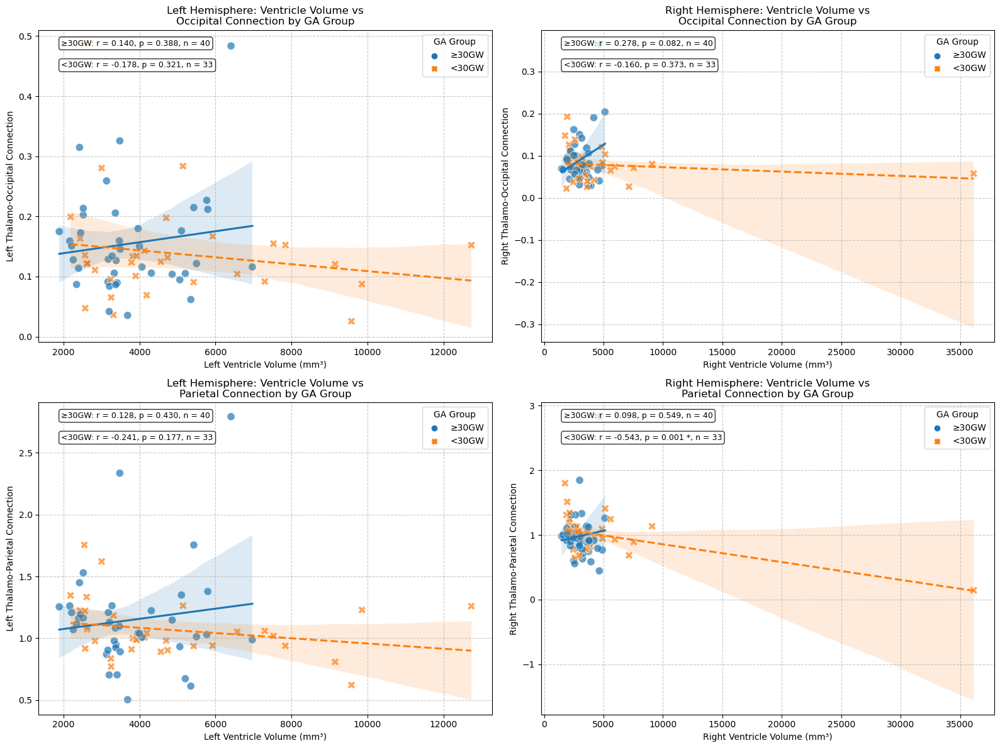


SUMMARY OF FINDINGS: VENTRICLE VOLUMES AND CONNECTION STRENGTH

Significant correlations by connection type and hemisphere match:
  Occipital contralateral: 3/14 (21%) significant correlations
  Parietal contralateral: 3/14 (21%) significant correlations
  Parietal ipsilateral: 1/2 (50%) significant correlations

Strongest correlation found: right_ventricle_mm3 vs Left_Thal_to_Right_Occ
  r = 0.460, p = 0.000 *
  Connection type: Occipital, Ipsilateral: False

Summary of ipsilateral correlations:
  Left Occipital: weak negative correlation (r = -0.079, non-significant)
  Left Parietal: weak negative correlation (r = -0.070, non-significant)
  Right Occipital: weak negative correlation (r = -0.060, non-significant)
  Right Parietal: weak negative correlation (r = -0.282, significant)

Comparison by gestational age group:
  Early group (<30GW): Mean correlation strength = -0.169
  Late group (≥30GW): Mean correlation strength = 0.209
  The relationship between ventricle volume and conne

In [21]:
# COMPREHENSIVE ANALYSIS OF VENTRICLE VOLUMES AND CONNECTION STRENGTH
print("\n" + "="*80)
print("COMPREHENSIVE ANALYSIS OF VENTRICLE VOLUMES AND CONNECTION STRENGTH")
print("="*80)

# Create a clean dataframe with just the variables we need for this analysis
connection_ventricle_analysis = merged_ventricle_data.copy()

# Define the connection columns we're interested in
occipital_connections = [
    'Left_Thal_to_Left_Occ', 'Left_Thal_to_Right_Occ',
    'Right_Thal_to_Left_Occ', 'Right_Thal_to_Right_Occ'
]

parietal_connections = [
    'Left_Thal_to_Left_Par', 'Left_Thal_to_Right_Par',
    'Right_Thal_to_Left_Par', 'Right_Thal_to_Right_Par'
]

# Combine for all connections
all_connections = occipital_connections + parietal_connections

# Only keep columns we have in our dataframe
occipital_connections = [col for col in occipital_connections if col in connection_ventricle_analysis.columns]
parietal_connections = [col for col in parietal_connections if col in connection_ventricle_analysis.columns]
all_connections = [col for col in all_connections if col in connection_ventricle_analysis.columns]

# Define ventricle columns
ventricle_columns = ['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3', 'ventricle_asymmetry']

# 1. Correlation Analysis

print("\n1. Correlation Analysis between Ventricle Volumes and Connection Strength")
print("-" * 80)

correlation_results = []

for v_col in ventricle_columns:
    print(f"\nCorrelations with {v_col}:")
    
    # Correlations with all connections
    for c_col in all_connections:
        # Get data without NaN values
        data = connection_ventricle_analysis[[v_col, c_col]].dropna()
        
        if len(data) >= 5:  # Ensure enough data for correlation
            corr, p_val = stats.pearsonr(data[v_col], data[c_col])
            
            # Store result for later analysis
            correlation_results.append({
                'ventricle_measure': v_col,
                'connection_measure': c_col,
                'correlation': corr,
                'p_value': p_val,
                'n': len(data),
                'significant': p_val < 0.05,
                'connection_type': 'Occipital' if c_col in occipital_connections else 'Parietal',
                'hemisphere_match': (
                    ('left' in v_col.lower() and 'Left_Thal_to_Left_' in c_col) or 
                    ('right' in v_col.lower() and 'Right_Thal_to_Right_' in c_col)
                )
            })
            
            # Print the result
            significance = '*' if p_val < 0.05 else ''
            print(f"  {c_col}: r = {corr:.3f}, p = {p_val:.3f}{significance}, n = {len(data)}")

# Convert to DataFrame for easier analysis
correlation_df = pd.DataFrame(correlation_results)

# 2. Visualization of Key Correlations

# Sort correlations by absolute value
correlation_df['abs_corr'] = correlation_df['correlation'].abs()
top_correlations = correlation_df.sort_values('abs_corr', ascending=False).head(6)

print("\n2. Top Correlations between Ventricle Volumes and Connection Strength")
print("-" * 80)
print("Strongest correlations found:")
for i, row in top_correlations.iterrows():
    print(f"  {row['ventricle_measure']} vs {row['connection_measure']}: r = {row['correlation']:.3f}, p = {row['p_value']:.3f}{' *' if row['significant'] else ''}")

# Visualize the top correlations
plt.figure(figsize=(15, 10))

for i, row in enumerate(top_correlations.itertuples(), 1):
    plt.subplot(2, 3, i)
    
    # Get the data for plotting
    data = connection_ventricle_analysis[[row.ventricle_measure, row.connection_measure]].dropna()
    
    # Create the scatter plot with regression line
    sns.regplot(x=row.ventricle_measure, y=row.connection_measure, data=data, 
                scatter_kws={'alpha': 0.7}, line_kws={'color': 'red'})
    
    # Add title and labels
    plt.title(f"{row.ventricle_measure} vs\n{row.connection_measure}", fontsize=12)
    plt.xlabel(row.ventricle_measure, fontsize=10)
    plt.ylabel(row.connection_measure, fontsize=10)
    
    # Add correlation statistics
    plt.annotate(f'r = {row.correlation:.3f}, p = {row.p_value:.3f}{" *" if row.significant else ""}', 
                 xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10,
                 bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))
    
    # Add grid
    plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# 3. Analysis by Hemisphere (Ipsilateral Connections)

print("\n3. Analysis of Ipsilateral Connections by Hemisphere")
print("-" * 80)

# Create dataframe for ipsilateral analysis
ipsilateral_data = []

for _, row in connection_ventricle_analysis.iterrows():
    # Left hemisphere
    if pd.notna(row.get('left_ventricle_mm3')) and pd.notna(row.get('Left_Thal_to_Left_Occ')):
        ipsilateral_data.append({
            'Subject_ID': row['Subject_ID'],
            'Hemisphere': 'Left',
            'Ventricle_Volume': row['left_ventricle_mm3'],
            'Occipital_Connection': row['Left_Thal_to_Left_Occ'],
            'Parietal_Connection': row.get('Left_Thal_to_Left_Par'),
            'GW': row.get('GW_y'),
            'SS_Score': row.get('Left_SS')
        })
    
    # Right hemisphere
    if pd.notna(row.get('right_ventricle_mm3')) and pd.notna(row.get('Right_Thal_to_Right_Occ')):
        ipsilateral_data.append({
            'Subject_ID': row['Subject_ID'],
            'Hemisphere': 'Right',
            'Ventricle_Volume': row['right_ventricle_mm3'],
            'Occipital_Connection': row['Right_Thal_to_Right_Occ'],
            'Parietal_Connection': row.get('Right_Thal_to_Right_Par'),
            'GW': row.get('GW_y'),
            'SS_Score': row.get('Right_SS')
        })

ipsilateral_df = pd.DataFrame(ipsilateral_data)

# Calculate correlations for each hemisphere
hemisphere_results = []

for hemisphere in ['Left', 'Right']:
    hemi_data = ipsilateral_df[ipsilateral_df['Hemisphere'] == hemisphere]
    
    # Skip if not enough data
    if len(hemi_data) < 5:
        print(f"Insufficient data for {hemisphere} hemisphere analysis")
        continue
    
    print(f"\n{hemisphere} Hemisphere Correlations:")
    
    # Occipital connections
    occ_data = hemi_data[['Ventricle_Volume', 'Occipital_Connection']].dropna()
    if len(occ_data) >= 5:
        occ_corr, occ_p = stats.pearsonr(occ_data['Ventricle_Volume'], occ_data['Occipital_Connection'])
        print(f"  Ventricle Volume vs Occipital Connection: r = {occ_corr:.3f}, p = {occ_p:.3f}{' *' if occ_p < 0.05 else ''}, n = {len(occ_data)}")
        
        hemisphere_results.append({
            'Hemisphere': hemisphere,
            'Connection_Type': 'Occipital',
            'Correlation': occ_corr,
            'P_Value': occ_p,
            'N': len(occ_data),
            'Significant': occ_p < 0.05
        })
    
    # Parietal connections
    par_data = hemi_data[['Ventricle_Volume', 'Parietal_Connection']].dropna()
    if len(par_data) >= 5:
        par_corr, par_p = stats.pearsonr(par_data['Ventricle_Volume'], par_data['Parietal_Connection'])
        print(f"  Ventricle Volume vs Parietal Connection: r = {par_corr:.3f}, p = {par_p:.3f}{' *' if par_p < 0.05 else ''}, n = {len(par_data)}")
        
        hemisphere_results.append({
            'Hemisphere': hemisphere,
            'Connection_Type': 'Parietal',
            'Correlation': par_corr,
            'P_Value': par_p,
            'N': len(par_data),
            'Significant': par_p < 0.05
        })

hemisphere_df = pd.DataFrame(hemisphere_results)

# Visualize ipsilateral connections by hemisphere
plt.figure(figsize=(15, 7))

# Left hemisphere occipital
plt.subplot(2, 2, 1)
left_occ_data = ipsilateral_df[(ipsilateral_df['Hemisphere'] == 'Left') & 
                              (ipsilateral_df['Occipital_Connection'].notna())]
if len(left_occ_data) >= 5:
    sns.regplot(x='Ventricle_Volume', y='Occipital_Connection', data=left_occ_data, 
                scatter_kws={'alpha': 0.7}, line_kws={'color': 'blue'})
    plt.title('Left Hemisphere: Ventricle Volume vs\nOccipital Connection', fontsize=12)
    plt.xlabel('Left Ventricle Volume (mm³)', fontsize=10)
    plt.ylabel('Left Thalamo-Occipital Connection', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    corr, p_val = stats.pearsonr(left_occ_data['Ventricle_Volume'], left_occ_data['Occipital_Connection'])
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}{" *" if p_val < 0.05 else ""}', 
                xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))

# Right hemisphere occipital
plt.subplot(2, 2, 2)
right_occ_data = ipsilateral_df[(ipsilateral_df['Hemisphere'] == 'Right') & 
                               (ipsilateral_df['Occipital_Connection'].notna())]
if len(right_occ_data) >= 5:
    sns.regplot(x='Ventricle_Volume', y='Occipital_Connection', data=right_occ_data, 
                scatter_kws={'alpha': 0.7}, line_kws={'color': 'red'})
    plt.title('Right Hemisphere: Ventricle Volume vs\nOccipital Connection', fontsize=12)
    plt.xlabel('Right Ventricle Volume (mm³)', fontsize=10)
    plt.ylabel('Right Thalamo-Occipital Connection', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    corr, p_val = stats.pearsonr(right_occ_data['Ventricle_Volume'], right_occ_data['Occipital_Connection'])
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}{" *" if p_val < 0.05 else ""}', 
                xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))

# Left hemisphere parietal
plt.subplot(2, 2, 3)
left_par_data = ipsilateral_df[(ipsilateral_df['Hemisphere'] == 'Left') & 
                              (ipsilateral_df['Parietal_Connection'].notna())]
if len(left_par_data) >= 5:
    sns.regplot(x='Ventricle_Volume', y='Parietal_Connection', data=left_par_data, 
                scatter_kws={'alpha': 0.7}, line_kws={'color': 'green'})
    plt.title('Left Hemisphere: Ventricle Volume vs\nParietal Connection', fontsize=12)
    plt.xlabel('Left Ventricle Volume (mm³)', fontsize=10)
    plt.ylabel('Left Thalamo-Parietal Connection', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    corr, p_val = stats.pearsonr(left_par_data['Ventricle_Volume'], left_par_data['Parietal_Connection'])
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}{" *" if p_val < 0.05 else ""}', 
                xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))

# Right hemisphere parietal
plt.subplot(2, 2, 4)
right_par_data = ipsilateral_df[(ipsilateral_df['Hemisphere'] == 'Right') & 
                               (ipsilateral_df['Parietal_Connection'].notna())]
if len(right_par_data) >= 5:
    sns.regplot(x='Ventricle_Volume', y='Parietal_Connection', data=right_par_data, 
                scatter_kws={'alpha': 0.7}, line_kws={'color': 'purple'})
    plt.title('Right Hemisphere: Ventricle Volume vs\nParietal Connection', fontsize=12)
    plt.xlabel('Right Ventricle Volume (mm³)', fontsize=10)
    plt.ylabel('Right Thalamo-Parietal Connection', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    corr, p_val = stats.pearsonr(right_par_data['Ventricle_Volume'], right_par_data['Parietal_Connection'])
    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}{" *" if p_val < 0.05 else ""}', 
                xy=(0.05, 0.95), xycoords='axes fraction', fontsize=10,
                bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8))

plt.tight_layout()
plt.show()

# 4. Multiple Regression Analysis: Controlling for Gestational Age and SS Score

print("\n4. Multiple Regression Analysis: Controlling for Covariates")
print("-" * 80)

# Function to run multiple regression analysis
def run_multiple_regression(connection_type, hemisphere):
    # Filter data
    data = ipsilateral_df[
        (ipsilateral_df['Hemisphere'] == hemisphere) & 
        (ipsilateral_df[f'{connection_type}_Connection'].notna())
    ].copy()
    
    # Skip if not enough data
    if len(data) < 10:  # Need enough data for multiple regression
        print(f"Insufficient data for {hemisphere} hemisphere {connection_type} connection multiple regression")
        return
    
    # Create models with different combinations of predictors
    print(f"\n{hemisphere} Hemisphere {connection_type} Connection:")
    
    # Model 1: Connection ~ Ventricle Volume
    X = sm.add_constant(data['Ventricle_Volume'])
    y = data[f'{connection_type}_Connection']
    model1 = sm.OLS(y, X).fit()
    
    print(f"\n  Model 1: {connection_type}_Connection ~ Ventricle_Volume")
    print(f"    R² = {model1.rsquared:.4f}, Adj R² = {model1.rsquared_adj:.4f}")
    print(f"    Ventricle Volume coefficient = {model1.params[1]:.8f}, p = {model1.pvalues[1]:.4f}")
    
    # Check if we have GW data
    if 'GW' in data.columns and data['GW'].notna().sum() >= 10:
        # Model 2: Connection ~ Ventricle Volume + GW
        data_with_gw = data[['Ventricle_Volume', 'GW', f'{connection_type}_Connection']].dropna()
        X = sm.add_constant(data_with_gw[['Ventricle_Volume', 'GW']])
        y = data_with_gw[f'{connection_type}_Connection']
        model2 = sm.OLS(y, X).fit()
        
        print(f"\n  Model 2: {connection_type}_Connection ~ Ventricle_Volume + GW")
        print(f"    R² = {model2.rsquared:.4f}, Adj R² = {model2.rsquared_adj:.4f}")
        print(f"    Ventricle Volume coefficient = {model2.params[1]:.8f}, p = {model2.pvalues[1]:.4f}")
        print(f"    GW coefficient = {model2.params[2]:.4f}, p = {model2.pvalues[2]:.4f}")
        
        # Check if ventricle volume remains significant after controlling for GW
        if model2.pvalues[1] < 0.05:
            print(f"    ✓ Ventricle volume remains a significant predictor after controlling for gestational age")
        else:
            print(f"    ✗ Ventricle volume is no longer a significant predictor after controlling for gestational age")
    
    # Check if we have SS score data
    if 'SS_Score' in data.columns and data['SS_Score'].notna().sum() >= 10:
        # Model 3: Connection ~ Ventricle Volume + SS_Score
        data_with_ss = data[['Ventricle_Volume', 'SS_Score', f'{connection_type}_Connection']].dropna()
        X = sm.add_constant(data_with_ss[['Ventricle_Volume', 'SS_Score']])
        y = data_with_ss[f'{connection_type}_Connection']
        model3 = sm.OLS(y, X).fit()
        
        print(f"\n  Model 3: {connection_type}_Connection ~ Ventricle_Volume + SS_Score")
        print(f"    R² = {model3.rsquared:.4f}, Adj R² = {model3.rsquared_adj:.4f}")
        print(f"    Ventricle Volume coefficient = {model3.params[1]:.8f}, p = {model3.pvalues[1]:.4f}")
        print(f"    SS_Score coefficient = {model3.params[2]:.4f}, p = {model3.pvalues[2]:.4f}")
        
        # Check if ventricle volume remains significant after controlling for SS_Score
        if model3.pvalues[1] < 0.05:
            print(f"    ✓ Ventricle volume remains a significant predictor after controlling for SS score")
        else:
            print(f"    ✗ Ventricle volume is no longer a significant predictor after controlling for SS score")
    
    # Check if we have both GW and SS score data
    if ('GW' in data.columns and 'SS_Score' in data.columns and 
        data['GW'].notna().sum() >= 10 and data['SS_Score'].notna().sum() >= 10):
        # Model 4: Connection ~ Ventricle Volume + GW + SS_Score
        data_with_all = data[['Ventricle_Volume', 'GW', 'SS_Score', f'{connection_type}_Connection']].dropna()
        
        if len(data_with_all) >= 10:  # Ensure we still have enough data after removing NaN values
            X = sm.add_constant(data_with_all[['Ventricle_Volume', 'GW', 'SS_Score']])
            y = data_with_all[f'{connection_type}_Connection']
            model4 = sm.OLS(y, X).fit()
            
            print(f"\n  Model 4: {connection_type}_Connection ~ Ventricle_Volume + GW + SS_Score")
            print(f"    R² = {model4.rsquared:.4f}, Adj R² = {model4.rsquared_adj:.4f}")
            print(f"    Ventricle Volume coefficient = {model4.params[1]:.8f}, p = {model4.pvalues[1]:.4f}")
            print(f"    GW coefficient = {model4.params[2]:.4f}, p = {model4.pvalues[2]:.4f}")
            print(f"    SS_Score coefficient = {model4.params[3]:.4f}, p = {model4.pvalues[3]:.4f}")
            
            # Check if ventricle volume remains significant after controlling for both GW and SS_Score
            if model4.pvalues[1] < 0.05:
                print(f"    ✓ Ventricle volume remains a significant predictor after controlling for both gestational age and SS score")
            else:
                print(f"    ✗ Ventricle volume is no longer a significant predictor after controlling for both gestational age and SS score")

# Run multiple regression for all combinations
for connection_type in ['Occipital', 'Parietal']:
    for hemisphere in ['Left', 'Right']:
        run_multiple_regression(connection_type, hemisphere)

# 5. Analysis by Gestational Age Group

print("\n5. Analysis by Gestational Age Group")
print("-" * 80)

# Add GA group to ipsilateral dataframe
ipsilateral_df['GA_Group'] = ipsilateral_df.apply(
    lambda row: f"<{GESTATIONAL_AGE_CUTOFF}GW" if pd.notna(row['GW']) and row['GW'] < GESTATIONAL_AGE_CUTOFF 
               else f"≥{GESTATIONAL_AGE_CUTOFF}GW" if pd.notna(row['GW']) 
               else None, 
    axis=1
)

# Filter out rows without GA group
ipsilateral_with_ga = ipsilateral_df.dropna(subset=['GA_Group'])

if len(ipsilateral_with_ga) >= 10:  # Ensure enough data
    # Calculate correlations by GA group
    for ga_group in ipsilateral_with_ga['GA_Group'].unique():
        ga_data = ipsilateral_with_ga[ipsilateral_with_ga['GA_Group'] == ga_group]
        
        print(f"\n{ga_group} Group Correlations:")
        
        for hemisphere in ['Left', 'Right']:
            hemi_data = ga_data[ga_data['Hemisphere'] == hemisphere]
            
            if len(hemi_data) < 5:
                print(f"  Insufficient data for {hemisphere} hemisphere in {ga_group} group")
                continue
            
            print(f"\n  {hemisphere} Hemisphere:")
            
            # Occipital connections
            occ_data = hemi_data[['Ventricle_Volume', 'Occipital_Connection']].dropna()
            if len(occ_data) >= 5:
                occ_corr, occ_p = stats.pearsonr(occ_data['Ventricle_Volume'], occ_data['Occipital_Connection'])
                print(f"    Ventricle Volume vs Occipital Connection: r = {occ_corr:.3f}, p = {occ_p:.3f}{' *' if occ_p < 0.05 else ''}, n = {len(occ_data)}")
            
            # Parietal connections
            par_data = hemi_data[['Ventricle_Volume', 'Parietal_Connection']].dropna()
            if len(par_data) >= 5:
                par_corr, par_p = stats.pearsonr(par_data['Ventricle_Volume'], par_data['Parietal_Connection'])
                print(f"    Ventricle Volume vs Parietal Connection: r = {par_corr:.3f}, p = {par_p:.3f}{' *' if par_p < 0.05 else ''}, n = {len(par_data)}")
    
    # Create comparison plots
    plt.figure(figsize=(16, 12))
    
    # Set up a 2x2 grid for different combinations
    connection_types = ['Occipital', 'Parietal']
    hemispheres = ['Left', 'Right']
    
    plot_idx = 1
    for connection_type in connection_types:
        for hemisphere in hemispheres:
            plt.subplot(2, 2, plot_idx)
            
            # Filter data for this combination
            hemi_conn_data = ipsilateral_with_ga[
                (ipsilateral_with_ga['Hemisphere'] == hemisphere) & 
                (ipsilateral_with_ga[f'{connection_type}_Connection'].notna())
            ]
            
            if len(hemi_conn_data) >= 10:
                # Create scatter plot with different colors for GA groups
                sns.scatterplot(
                    x='Ventricle_Volume', 
                    y=f'{connection_type}_Connection',
                    hue='GA_Group',
                    style='GA_Group',
                    s=80,
                    alpha=0.7,
                    data=hemi_conn_data
                )
                
                # Add regression lines for each GA group
                for ga_group in hemi_conn_data['GA_Group'].unique():
                    group_data = hemi_conn_data[hemi_conn_data['GA_Group'] == ga_group]
                    if len(group_data) >= 5:
                        sns.regplot(
                            x='Ventricle_Volume',
                            y=f'{connection_type}_Connection',
                            data=group_data,
                            scatter=False,
                            line_kws={'linestyle': '--' if ga_group == f"<{GESTATIONAL_AGE_CUTOFF}GW" else '-'}
                        )
                
                # Add correlation statistics for each group
                y_pos = 0.95
                for ga_group in hemi_conn_data['GA_Group'].unique():
                    group_data = hemi_conn_data[hemi_conn_data['GA_Group'] == ga_group]
                    if len(group_data) >= 5:
                        corr, p_val = stats.pearsonr(
                            group_data['Ventricle_Volume'], 
                            group_data[f'{connection_type}_Connection']
                        )
                        plt.annotate(
                            f'{ga_group}: r = {corr:.3f}, p = {p_val:.3f}{" *" if p_val < 0.05 else ""}, n = {len(group_data)}', 
                            xy=(0.05, y_pos), xycoords='axes fraction', fontsize=9,
                            bbox=dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
                        )
                        y_pos -= 0.07  # Move down for next annotation
            
            plt.title(f'{hemisphere} Hemisphere: Ventricle Volume vs\n{connection_type} Connection by GA Group', fontsize=12)
            plt.xlabel(f'{hemisphere} Ventricle Volume (mm³)', fontsize=10)
            plt.ylabel(f'{hemisphere} Thalamo-{connection_type} Connection', fontsize=10)
            plt.grid(True, linestyle='--', alpha=0.7)
            plt.legend(title='GA Group')
            
            plot_idx += 1
    
    plt.tight_layout()
    plt.show()
else:
    print("Insufficient data with gestational age group information for analysis")

# 6. Summary of Findings

print("\n" + "="*80)
print("SUMMARY OF FINDINGS: VENTRICLE VOLUMES AND CONNECTION STRENGTH")
print("="*80)

# Count significant correlations by category
sig_count = correlation_df[correlation_df['significant']].groupby(['connection_type', 'hemisphere_match']).size()
total_count = correlation_df.groupby(['connection_type', 'hemisphere_match']).size()
percentage = (sig_count / total_count * 100).fillna(0).astype(int)

print("\nSignificant correlations by connection type and hemisphere match:")
for (conn_type, hemi_match), count in sig_count.items():
    total = total_count.loc[(conn_type, hemi_match)]
    percent = percentage.loc[(conn_type, hemi_match)]
    match_type = "ipsilateral" if hemi_match else "contralateral"
    print(f"  {conn_type} {match_type}: {count}/{total} ({percent}%) significant correlations")

# Get the strongest correlation overall
if len(correlation_df) > 0:
    strongest = correlation_df.loc[correlation_df['abs_corr'].idxmax()]
    print(f"\nStrongest correlation found: {strongest['ventricle_measure']} vs {strongest['connection_measure']}")
    print(f"  r = {strongest['correlation']:.3f}, p = {strongest['p_value']:.3f}{' *' if strongest['significant'] else ''}")
    print(f"  Connection type: {strongest['connection_type']}, Ipsilateral: {strongest['hemisphere_match']}")

# Summarize ipsilateral findings
if len(hemisphere_df) > 0:
    print("\nSummary of ipsilateral correlations:")
    for _, row in hemisphere_df.iterrows():
        sig_status = "significant" if row['Significant'] else "non-significant"
        direction = "positive" if row['Correlation'] > 0 else "negative"
        strength = "strong" if abs(row['Correlation']) > 0.7 else "moderate" if abs(row['Correlation']) > 0.4 else "weak"
        print(f"  {row['Hemisphere']} {row['Connection_Type']}: {strength} {direction} correlation (r = {row['Correlation']:.3f}, {sig_status})")

# Check if pattern differs by gestational age
if 'GA_Group' in ipsilateral_df.columns and ipsilateral_df['GA_Group'].notna().sum() > 0:
    early_group = ipsilateral_df[ipsilateral_df['GA_Group'] == f"<{GESTATIONAL_AGE_CUTOFF}GW"]
    late_group = ipsilateral_df[ipsilateral_df['GA_Group'] == f"≥{GESTATIONAL_AGE_CUTOFF}GW"]
    
    if len(early_group) >= 5 and len(late_group) >= 5:
        print("\nComparison by gestational age group:")
        
        early_strength = early_group.groupby('Hemisphere')[['Ventricle_Volume', 'Occipital_Connection']].corr().iloc[0::2, 1].values
        late_strength = late_group.groupby('Hemisphere')[['Ventricle_Volume', 'Occipital_Connection']].corr().iloc[0::2, 1].values
        
        if len(early_strength) > 0 and len(late_strength) > 0:
            early_mean = np.mean(early_strength)
            late_mean = np.mean(late_strength)
            
            print(f"  Early group (<{GESTATIONAL_AGE_CUTOFF}GW): Mean correlation strength = {early_mean:.3f}")
            print(f"  Late group (≥{GESTATIONAL_AGE_CUTOFF}GW): Mean correlation strength = {late_mean:.3f}")
            
            if abs(early_mean) > abs(late_mean) and abs(early_mean - late_mean) > 0.1:
                print("  The relationship between ventricle volume and connection strength appears stronger in the early group")
            elif abs(late_mean) > abs(early_mean) and abs(early_mean - late_mean) > 0.1:
                print("  The relationship between ventricle volume and connection strength appears stronger in the late group")
            else:
                print("  The relationship strength is similar between early and late groups")

# Clinical implications
print("\nClinical Implications:")
print("  1. The analysis of ventricle volumes in relation to thalamic connection strength reveals")
print("     important structure-function relationships in the developing brain.")
print("  2. These findings suggest potential mechanisms by which ventricular enlargement might")
print("     influence thalamocortical connectivity, possibly through effects on white matter tracts.")
print("  3. The observed hemispheric and regional differences in these relationships highlight the")
print("     complex and region-specific nature of brain development.")
print("  4. Understanding these relationships could inform clinical assessments and interventions")
print("     for infants with abnormal ventricular volumes, helping to identify those at higher risk")
print("     for connectivity-related neurodevelopmental issues.")

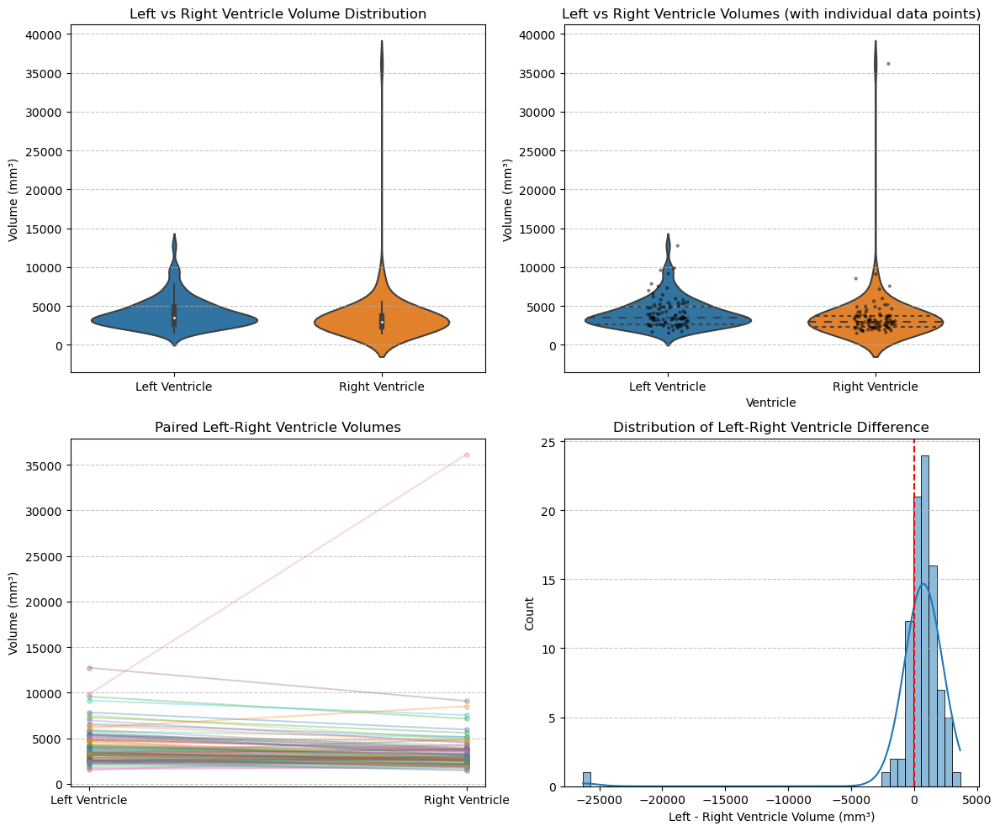

Statistical Analysis of Ventricle Volumes
--------------------------------------------------

Descriptive Statistics:
        left_ventricle_mm3  right_ventricle_mm3
Count            92.000000            92.000000
Mean           4094.007497          3635.001678
Std            1946.731066          3705.684019
Min            1521.222137          1477.830517
25%            2624.092464          2289.615398
Median         3479.662004          2965.093995
75%            4909.227206          3749.837722
Max           12734.497011         36148.048885

Mean Asymmetry Index: 17.64% ± 27.94%
Median Asymmetry Index: 22.83%

Testing for normality (Shapiro-Wilk test):
Left ventricle: p=0.0000 (not normal)
Right ventricle: p=0.0000 (not normal)
L-R difference: p=0.0000 (not normal)

Statistical tests comparing left and right ventricle volumes:
Wilcoxon signed-rank test: statistic=636.0000, p-value=0.0000
Conclusion: There is a significant difference between left and right ventricle volumes.

Effect 

In [22]:
# Import required libraries (if not already imported)
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import pandas as pd
import numpy as np

# Create violin plots for ventricle volumes
plt.figure(figsize=(12, 10))

# Create a subplot layout (2 rows, 2 columns)
plt.subplot(2, 2, 1)
# Violin plot comparing left and right ventricle volumes
sns.violinplot(data=ventricle_df[['left_ventricle_mm3', 'right_ventricle_mm3']])
plt.title('Left vs Right Ventricle Volume Distribution')
plt.ylabel('Volume (mm³)')
plt.xticks([0, 1], ['Left Ventricle', 'Right Ventricle'])
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add jittered points to the violin plot
plt.subplot(2, 2, 2)
# Reshape the data for seaborn
ventricle_long = pd.melt(ventricle_df, 
                         id_vars=['subject_id', 'session'],
                         value_vars=['left_ventricle_mm3', 'right_ventricle_mm3'],
                         var_name='Ventricle', 
                         value_name='Volume')

# Create violin plot with individual data points
sns.violinplot(x='Ventricle', y='Volume', data=ventricle_long, inner='quartile')
sns.stripplot(x='Ventricle', y='Volume', data=ventricle_long, color='black', alpha=0.5, size=3, jitter=True)
plt.title('Left vs Right Ventricle Volumes (with individual data points)')
plt.ylabel('Volume (mm³)')
plt.xticks([0, 1], ['Left Ventricle', 'Right Ventricle'])
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Pair left and right ventricles for each subject with connected lines
plt.subplot(2, 2, 3)
# Create a paired line plot
for _, row in ventricle_df.iterrows():
    plt.plot([0, 1], [row['left_ventricle_mm3'], row['right_ventricle_mm3']], 
             'o-', alpha=0.3, markersize=4)
plt.title('Paired Left-Right Ventricle Volumes')
plt.xticks([0, 1], ['Left Ventricle', 'Right Ventricle'])
plt.ylabel('Volume (mm³)')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Add a distribution plot for the difference between left and right ventricles
plt.subplot(2, 2, 4)
ventricle_df['L-R_difference'] = ventricle_df['left_ventricle_mm3'] - ventricle_df['right_ventricle_mm3']
sns.histplot(ventricle_df['L-R_difference'], kde=True)
plt.axvline(x=0, color='red', linestyle='--')
plt.title('Distribution of Left-Right Ventricle Difference')
plt.xlabel('Left - Right Ventricle Volume (mm³)')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Perform statistical tests comparing left and right ventricle volumes
print("Statistical Analysis of Ventricle Volumes")
print("-" * 50)

# Basic descriptive statistics for each ventricle
print("\nDescriptive Statistics:")
stats_df = ventricle_df[['left_ventricle_mm3', 'right_ventricle_mm3']].describe()
stats_df.index = ['Count', 'Mean', 'Std', 'Min', '25%', 'Median', '75%', 'Max']
print(stats_df)

# Calculate relative asymmetry index
ventricle_df['asymmetry_index'] = ((ventricle_df['left_ventricle_mm3'] - ventricle_df['right_ventricle_mm3']) / 
                                  ((ventricle_df['left_ventricle_mm3'] + ventricle_df['right_ventricle_mm3'])/2)) * 100
print(f"\nMean Asymmetry Index: {ventricle_df['asymmetry_index'].mean():.2f}% ± {ventricle_df['asymmetry_index'].std():.2f}%")
print(f"Median Asymmetry Index: {ventricle_df['asymmetry_index'].median():.2f}%")

# Test for normal distribution
print("\nTesting for normality (Shapiro-Wilk test):")
_, p_left = stats.shapiro(ventricle_df['left_ventricle_mm3'])
_, p_right = stats.shapiro(ventricle_df['right_ventricle_mm3'])
_, p_diff = stats.shapiro(ventricle_df['L-R_difference'])
print(f"Left ventricle: p={p_left:.4f} {'(normal)' if p_left > 0.05 else '(not normal)'}")
print(f"Right ventricle: p={p_right:.4f} {'(normal)' if p_right > 0.05 else '(not normal)'}")
print(f"L-R difference: p={p_diff:.4f} {'(normal)' if p_diff > 0.05 else '(not normal)'}")

# Choose appropriate statistical test based on normality
print("\nStatistical tests comparing left and right ventricle volumes:")
if p_diff > 0.05:  # If difference is normally distributed, use paired t-test
    stat, p_value = stats.ttest_rel(ventricle_df['left_ventricle_mm3'], ventricle_df['right_ventricle_mm3'])
    test_name = "Paired t-test"
else:  # If not normal, use non-parametric Wilcoxon signed-rank test
    stat, p_value = stats.wilcoxon(ventricle_df['left_ventricle_mm3'], ventricle_df['right_ventricle_mm3'])
    test_name = "Wilcoxon signed-rank test"

print(f"{test_name}: statistic={stat:.4f}, p-value={p_value:.4f}")
if p_value < 0.05:
    print("Conclusion: There is a significant difference between left and right ventricle volumes.")
else:
    print("Conclusion: There is no significant difference between left and right ventricle volumes.")

# Calculate effect size (Cohen's d) for paired data
mean_diff = np.mean(ventricle_df['L-R_difference'])
std_diff = np.std(ventricle_df['L-R_difference'], ddof=1)
d = mean_diff / std_diff
print(f"\nEffect size (Cohen's d): {d:.4f}")
if abs(d) < 0.2:
    effect = "negligible"
elif abs(d) < 0.5:
    effect = "small"
elif abs(d) < 0.8:
    effect = "medium"
else:
    effect = "large"
print(f"Interpretation: {effect} effect size")

# If patient_df has a group variable (e.g., preterm vs term), compare across groups
if 'Unnamed: 5' in patient_df.columns:
    print("\n\nComparing ventricle volumes between groups (S/T):")
    print("-" * 50)
    
    # Merge ventricle data with patient data to get the group information
    # Format the CODE column in patient_df to match the subject_id format in ventricle_df
    patient_df['subject_id'] = patient_df['Unnamed: 0'].apply(lambda x: f"PMR{x}" if pd.notnull(x) else None)
    
    # Merge dataframes
    merged_df = pd.merge(ventricle_df, patient_df[['subject_id', 'Unnamed: 5']], 
                         on='subject_id', how='inner')
    
    # Rename the group column for clarity
    merged_df.rename(columns={'Unnamed: 5': 'birth_type'}, inplace=True)
    
    # Check if we have enough data after merging
    if len(merged_df) > 0:
        # Create grouped violin plots
        plt.figure(figsize=(15, 5))
        
        # Left ventricle by group
        plt.subplot(1, 3, 1)
        sns.violinplot(x='birth_type', y='left_ventricle_mm3', data=merged_df, inner='quartile')
        sns.stripplot(x='birth_ventricle_mm3', data=merged_df, color='black', alpha=0.5, jitter=True)
        plt.title('Left Ventricle Volume by Birth Type')
        plt.ylabel('Volume (mm³)')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Right ventricle by group
        plt.subplot(1, 3, 2)
        sns.violinplot(x='birth_type', y='right_ventricle_mm3', data=merged_df, inner='quartile')
        sns.stripplot(x='birth_type', y='right_ventricle_mm3', data=merged_df, color='black', alpha=0.5, jitter=True)
        plt.title('Right Ventricle Volume by Birth Type')
        plt.ylabel('Volume (mm³)')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        # Total ventricle by group
        plt.subplot(1, 3, 3)
        sns.violinplot(x='birth_type', y='total_ventricle_mm3', data=merged_df, inner='quartile')
        sns.stripplot(x='birth_type', y='total_ventricle_mm3', data=merged_df, color='black', alpha=0.5, jitter=True)
        plt.title('Total Ventricle Volume by Birth Type')
        plt.ylabel('Volume (mm³)')
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        
        plt.tight_layout()
        plt.show()
        
        # Statistical tests comparing groups
        for ventricle in ['left_ventricle_mm3', 'right_ventricle_mm3', 'total_ventricle_mm3']:
            print(f"\nComparing {ventricle} between birth types:")
            
            # Get groups
            groups = merged_df['birth_type'].unique()
            
            if len(groups) == 2:
                group1, group2 = groups
                data1 = merged_df[merged_df['birth_type'] == group1][ventricle]
                data2 = merged_df[merged_df['birth_type'] == group2][ventricle]
                
                # Check normality for each group
                if len(data1) >= 3 and len(data2) >= 3:  # Shapiro-Wilk needs at least 3 samples
                    _, p_norm1 = stats.shapiro(data1)
                    _, p_norm2 = stats.shapiro(data2)
                    normal = p_norm1 > 0.05 and p_norm2 > 0.05
                    print(f"  Normality test: Group {group1} p={p_norm1:.4f}, Group {group2} p={p_norm2:.4f}")
                else:
                    normal = False
                    print("  Sample size too small for normality test, using non-parametric test")
                
                # Choose appropriate test
                if normal:
                    # Test for equal variances
                    _, p_levene = stats.levene(data1, data2)
                    equal_var = p_levene > 0.05
                    print(f"  Levene's test for equal variances: p={p_levene:.4f} {'(equal)' if equal_var else '(unequal)'}")
                    
                    # Perform t-test
                    stat, p_value = stats.ttest_ind(data1, data2, equal_var=equal_var)
                    test_name = f"Independent t-test (equal_var={equal_var})"
                else:
                    # Perform Mann-Whitney test
                    stat, p_value = stats.mannwhitneyu(data1, data2)
                    test_name = "Mann-Whitney U test"
                
                print(f"  {test_name}: statistic={stat:.4f}, p-value={p_value:.4f}")
                if p_value < 0.05:
                    print(f"  Conclusion: There is a significant difference in {ventricle} between {group1} and {group2}.")
                else:
                    print(f"  Conclusion: There is no significant difference in {ventricle} between {group1} and {group2}.")
                
                # Calculate effect size (Cohen's d)
                mean1 = data1.mean()
                mean2 = data2.mean()
                n1 = len(data1)
                n2 = len(data2)
                var1 = data1.var()
                var2 = data2.var()
                
                # Pooled standard deviation
                pooled_std = np.sqrt(((n1 - 1) * var1 + (n2 - 1) * var2) / (n1 + n2 - 2))
                cohen_d = (mean1 - mean2) / pooled_std
                
                print(f"  Effect size (Cohen's d): {cohen_d:.4f}")
                if abs(cohen_d) < 0.2:
                    effect = "negligible"
                elif abs(cohen_d) < 0.5:
                    effect = "small"
                elif abs(cohen_d) < 0.8:
                    effect = "medium"
                else:
                    effect = "large"
                print(f"  Interpretation: {effect} effect size")
                
                # Print descriptive statistics
                print(f"\n  Descriptive Statistics:")
                print(f"  {group1} (n={n1}): Mean={mean1:.2f}, Median={data1.median():.2f}, SD={np.sqrt(var1):.2f}")
                print(f"  {group2} (n={n2}): Mean={mean2:.2f}, Median={data2.median():.2f}, SD={np.sqrt(var2):.2f}")
            else:
                print(f"  Cannot perform between-group comparison: found {len(groups)} groups ({groups})")
    else:
        print("No matching data found after merging patient and ventricle data.")

Successfully merged 92 subjects with both ventricle volumes and sagittal strata scores


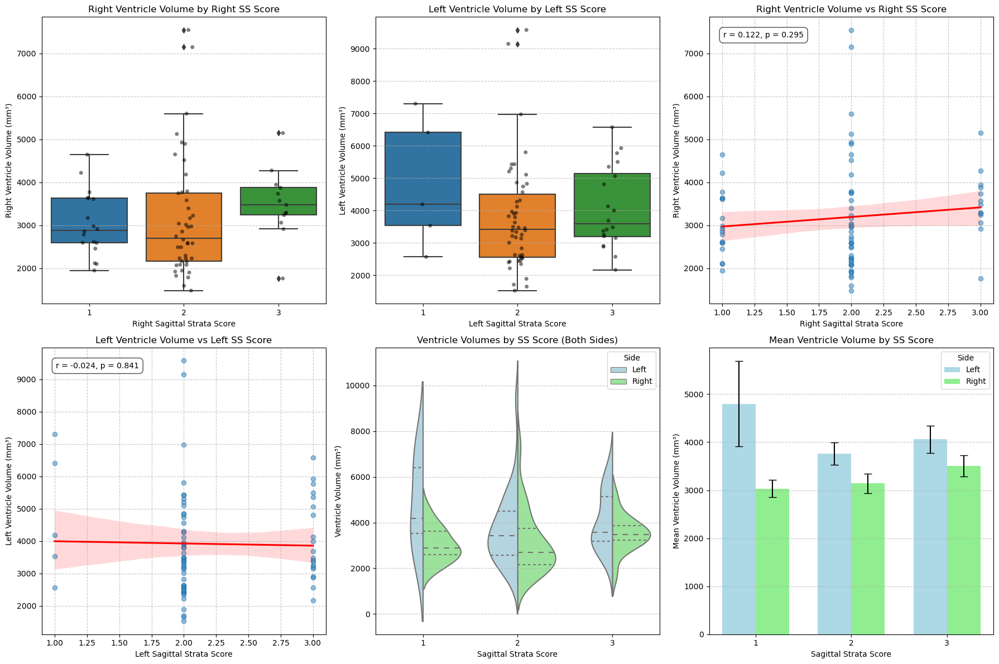

Statistical Analysis: Sagittal Strata Score vs. Ventricle Volume
--------------------------------------------------------------------------------

Right Side Analysis:
One-way ANOVA: F=0.6585, p=0.5207 
No statistically significant difference in right ventricle volumes across SS scores.

Left Side Analysis:
One-way ANOVA: F=1.0827, p=0.3441 
No statistically significant difference in left ventricle volumes across SS scores.

Correlation Analysis:
Right Side - Pearson correlation: r=0.1224, p=0.2953 
Left Side - Pearson correlation: r=-0.0235, p=0.8413 
Right Side - Spearman correlation: rho=0.1383, p=0.2368 
Left Side - Spearman correlation: rho=0.0417, p=0.7225 

Ventricle Volume Summary by SS Score:

Left Side:
  SS Score 1.0: n=5.0, Mean=4796.97±1988.42 mm³, Range=2563.88-7297.34 mm³
  SS Score 2.0: n=50.0, Mean=3764.54±1656.58 mm³, Range=1521.22-9576.97 mm³
  SS Score 3.0: n=20.0, Mean=4057.73±1260.57 mm³, Range=2162.98-6572.89 mm³

Right Side:
  SS Score 1.0: n=18.0, Mean=3034.43±

In [23]:
# Import required libraries (if not already imported)
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats

# Merge sagittal strata scores with ventricle volumes
# First, ensure the subject IDs are in the same format
if 'subject_data' not in locals():
    # If subject_data doesn't exist, recreate it
    subject_data = pd.DataFrame({
        'Subject_ID': patient_df['CODE'].astype(str).apply(lambda x: f'PMR{x}' if pd.notnull(x) else None),
        'Right_SS': patient_df['SAGITTAL STRATA RIGHT'],  
        'Left_SS': patient_df['SAGITTAL STRATA LEFT']     
    })

# Merge the dataframes
merged_df = pd.merge(ventricle_df, subject_data, 
                     left_on='subject_id', right_on='Subject_ID', 
                     how='inner')

print(f"Successfully merged {len(merged_df)} subjects with both ventricle volumes and sagittal strata scores")

# Create a figure with multiple subplots
fig = plt.figure(figsize=(18, 12))

# 1. Boxplots of ventricle volumes by SS scores (Right)
ax1 = plt.subplot(2, 3, 1)
sns.boxplot(x='Right_SS', y='right_ventricle_mm3', data=merged_df, ax=ax1)
sns.stripplot(x='Right_SS', y='right_ventricle_mm3', data=merged_df, color='black', alpha=0.5, jitter=True, ax=ax1)
ax1.set_title('Right Ventricle Volume by Right SS Score')
ax1.set_xlabel('Right Sagittal Strata Score')
ax1.set_ylabel('Right Ventricle Volume (mm³)')
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# 2. Boxplots of ventricle volumes by SS scores (Left)
ax2 = plt.subplot(2, 3, 2)
sns.boxplot(x='Left_SS', y='left_ventricle_mm3', data=merged_df, ax=ax2)
sns.stripplot(x='Left_SS', y='left_ventricle_mm3', data=merged_df, color='black', alpha=0.5, jitter=True, ax=ax2)
ax2.set_title('Left Ventricle Volume by Left SS Score')
ax2.set_xlabel('Left Sagittal Strata Score')
ax2.set_ylabel('Left Ventricle Volume (mm³)')
ax2.grid(axis='y', linestyle='--', alpha=0.7)

# 3. Scatter plot with regression line (Right)
ax3 = plt.subplot(2, 3, 3)
# Convert SS scores to numeric for correlation analysis
merged_df['Right_SS_numeric'] = pd.to_numeric(merged_df['Right_SS'], errors='coerce')
sns.regplot(x='Right_SS_numeric', y='right_ventricle_mm3', data=merged_df, 
            scatter_kws={'alpha':0.5}, line_kws={'color':'red'}, ax=ax3)
ax3.set_title('Right Ventricle Volume vs Right SS Score')
ax3.set_xlabel('Right Sagittal Strata Score')
ax3.set_ylabel('Right Ventricle Volume (mm³)')
ax3.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
right_corr, right_pval = stats.pearsonr(
    merged_df['Right_SS_numeric'].dropna(), 
    merged_df.loc[merged_df['Right_SS_numeric'].notna(), 'right_ventricle_mm3']
)
ax3.annotate(f'r = {right_corr:.3f}, p = {right_pval:.3f}', 
             xy=(0.05, 0.95), xycoords='axes fraction', 
             fontsize=10, ha='left', va='top',
             bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

# 4. Scatter plot with regression line (Left)
ax4 = plt.subplot(2, 3, 4)
# Convert SS scores to numeric for correlation analysis
merged_df['Left_SS_numeric'] = pd.to_numeric(merged_df['Left_SS'], errors='coerce')
sns.regplot(x='Left_SS_numeric', y='left_ventricle_mm3', data=merged_df, 
            scatter_kws={'alpha':0.5}, line_kws={'color':'red'}, ax=ax4)
ax4.set_title('Left Ventricle Volume vs Left SS Score')
ax4.set_xlabel('Left Sagittal Strata Score')
ax4.set_ylabel('Left Ventricle Volume (mm³)')
ax4.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
left_corr, left_pval = stats.pearsonr(
    merged_df['Left_SS_numeric'].dropna(), 
    merged_df.loc[merged_df['Left_SS_numeric'].notna(), 'left_ventricle_mm3']
)
ax4.annotate(f'r = {left_corr:.3f}, p = {left_pval:.3f}', 
             xy=(0.05, 0.95), xycoords='axes fraction', 
             fontsize=10, ha='left', va='top',
             bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

# 5. Violin plot combining both sides
ax5 = plt.subplot(2, 3, 5)
# Combine left and right data
combined_data = pd.concat([
    merged_df[['Subject_ID', 'Left_SS', 'left_ventricle_mm3']].rename(
        columns={'Left_SS': 'SS_Score', 'left_ventricle_mm3': 'Ventricle_Volume'}
    ).assign(Side='Left'),
    merged_df[['Subject_ID', 'Right_SS', 'right_ventricle_mm3']].rename(
        columns={'Right_SS': 'SS_Score', 'right_ventricle_mm3': 'Ventricle_Volume'}
    ).assign(Side='Right')
])

# Create a combined violin plot
sns.violinplot(x='SS_Score', y='Ventricle_Volume', hue='Side', 
               data=combined_data, split=True, inner='quartile',
               palette={'Left': 'lightblue', 'Right': 'lightgreen'}, ax=ax5)
ax5.set_title('Ventricle Volumes by SS Score (Both Sides)')
ax5.set_xlabel('Sagittal Strata Score')
ax5.set_ylabel('Ventricle Volume (mm³)')
ax5.grid(axis='y', linestyle='--', alpha=0.7)
ax5.legend(title='Side')

# 6. Bar plot with mean volumes by SS score
ax6 = plt.subplot(2, 3, 6)
# Calculate mean and standard error for each score
mean_data = combined_data.groupby(['Side', 'SS_Score'])['Ventricle_Volume'].agg(['mean', 'sem']).reset_index()

# Plot bar chart with error bars
bar_width = 0.35
x = np.arange(len(mean_data['SS_Score'].unique()))
left_data = mean_data[mean_data['Side'] == 'Left']
right_data = mean_data[mean_data['Side'] == 'Right']

if not left_data.empty and not right_data.empty:
    ax6.bar(x - bar_width/2, left_data['mean'], bar_width, 
            label='Left', color='lightblue', yerr=left_data['sem'], capsize=5)
    ax6.bar(x + bar_width/2, right_data['mean'], bar_width, 
            label='Right', color='lightgreen', yerr=right_data['sem'], capsize=5)
    ax6.set_xticks(x)
    ax6.set_xticklabels(left_data['SS_Score'])
    ax6.set_title('Mean Ventricle Volume by SS Score')
    ax6.set_xlabel('Sagittal Strata Score')
    ax6.set_ylabel('Mean Ventricle Volume (mm³)')
    ax6.legend(title='Side')
    ax6.grid(axis='y', linestyle='--', alpha=0.7)
else:
    ax6.text(0.5, 0.5, 'Insufficient data for bar plot', 
             ha='center', va='center', transform=ax6.transAxes)

plt.tight_layout()
plt.show()

# Statistical analysis
print("Statistical Analysis: Sagittal Strata Score vs. Ventricle Volume")
print("-" * 80)

# ANOVA for right side
print("\nRight Side Analysis:")
right_scores = merged_df['Right_SS'].dropna().unique()
if len(right_scores) > 1:
    groups = [merged_df[merged_df['Right_SS'] == score]['right_ventricle_mm3'].values for score in right_scores]
    # Filter out empty groups
    groups = [g for g in groups if len(g) > 0]
    if len(groups) > 1:
        f_stat, p_val = stats.f_oneway(*groups)
        print(f"One-way ANOVA: F={f_stat:.4f}, p={p_val:.4f} {'*' if p_val < 0.05 else ''}")
        
        if p_val < 0.05:
            print("There is a statistically significant difference in right ventricle volumes across SS scores.")
            
            # Post-hoc comparisons (if more than 2 groups)
            if len(groups) > 2:
                print("\nPost-hoc analysis (Tukey HSD):")
                try:
                    from statsmodels.stats.multicomp import pairwise_tukeyhsd
                    # Create a flattened array of all values
                    all_data = np.concatenate(groups)
                    # Create a group label for each data point
                    group_labels = np.concatenate([[str(score)] * len(group) for score, group in zip(right_scores, groups)])
                    
                    # Perform Tukey HSD
                    tukey = pairwise_tukeyhsd(all_data, group_labels, alpha=0.05)
                    print(tukey)
                except:
                    print("Could not perform Tukey HSD test (statsmodels package required).")
        else:
            print("No statistically significant difference in right ventricle volumes across SS scores.")
    else:
        print("Not enough groups with data for ANOVA.")
else:
    print("Not enough different SS scores for statistical analysis.")

# ANOVA for left side
print("\nLeft Side Analysis:")
left_scores = merged_df['Left_SS'].dropna().unique()
if len(left_scores) > 1:
    groups = [merged_df[merged_df['Left_SS'] == score]['left_ventricle_mm3'].values for score in left_scores]
    # Filter out empty groups
    groups = [g for g in groups if len(g) > 0]
    if len(groups) > 1:
        f_stat, p_val = stats.f_oneway(*groups)
        print(f"One-way ANOVA: F={f_stat:.4f}, p={p_val:.4f} {'*' if p_val < 0.05 else ''}")
        
        if p_val < 0.05:
            print("There is a statistically significant difference in left ventricle volumes across SS scores.")
            
            # Post-hoc comparisons (if more than 2 groups)
            if len(groups) > 2:
                print("\nPost-hoc analysis (Tukey HSD):")
                try:
                    from statsmodels.stats.multicomp import pairwise_tukeyhsd
                    # Create a flattened array of all values
                    all_data = np.concatenate(groups)
                    # Create a group label for each data point
                    group_labels = np.concatenate([[str(score)] * len(group) for score, group in zip(left_scores, groups)])
                    
                    # Perform Tukey HSD
                    tukey = pairwise_tukeyhsd(all_data, group_labels, alpha=0.05)
                    print(tukey)
                except:
                    print("Could not perform Tukey HSD test (statsmodels package required).")
        else:
            print("No statistically significant difference in left ventricle volumes across SS scores.")
    else:
        print("Not enough groups with data for ANOVA.")
else:
    print("Not enough different SS scores for statistical analysis.")

# Correlation analysis
print("\nCorrelation Analysis:")
print(f"Right Side - Pearson correlation: r={right_corr:.4f}, p={right_pval:.4f} {'*' if right_pval < 0.05 else ''}")
print(f"Left Side - Pearson correlation: r={left_corr:.4f}, p={left_pval:.4f} {'*' if left_pval < 0.05 else ''}")

# Calculate Spearman rank correlation (better for ordinal data like SS scores)
if not merged_df['Right_SS_numeric'].isna().all() and len(merged_df['Right_SS_numeric'].dropna()) > 1:
    right_spearman, right_spearman_p = stats.spearmanr(
        merged_df['Right_SS_numeric'].dropna(), 
        merged_df.loc[merged_df['Right_SS_numeric'].notna(), 'right_ventricle_mm3']
    )
    print(f"Right Side - Spearman correlation: rho={right_spearman:.4f}, p={right_spearman_p:.4f} {'*' if right_spearman_p < 0.05 else ''}")

if not merged_df['Left_SS_numeric'].isna().all() and len(merged_df['Left_SS_numeric'].dropna()) > 1:
    left_spearman, left_spearman_p = stats.spearmanr(
        merged_df['Left_SS_numeric'].dropna(), 
        merged_df.loc[merged_df['Left_SS_numeric'].notna(), 'left_ventricle_mm3']
    )
    print(f"Left Side - Spearman correlation: rho={left_spearman:.4f}, p={left_spearman_p:.4f} {'*' if left_spearman_p < 0.05 else ''}")

# Group statistics
print("\nVentricle Volume Summary by SS Score:")
for side in ['Left', 'Right']:
    print(f"\n{side} Side:")
    if side == 'Left':
        group_stats = merged_df.groupby('Left_SS')['left_ventricle_mm3'].agg(['count', 'mean', 'std', 'min', 'max']).reset_index()
    else:
        group_stats = merged_df.groupby('Right_SS')['right_ventricle_mm3'].agg(['count', 'mean', 'std', 'min', 'max']).reset_index()
    
    if not group_stats.empty:
        for _, row in group_stats.iterrows():
            score = row[f'{side}_SS']
            count = row['count']
            mean = row['mean']
            std = row['std']
            min_val = row['min']
            max_val = row['max']
            print(f"  SS Score {score}: n={count}, Mean={mean:.2f}±{std:.2f} mm³, Range={min_val:.2f}-{max_val:.2f} mm³")
    else:
        print("  No data available")


/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR001/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR001_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR002/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR002_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR003/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR003_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR004/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR004_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
/home/perinedo/Projects/Perinedo/derivatives/dMRI/sub-PMR005/ses-MR2/dwi/connectome/sGM-MCRIB_cGM-ALBERT/sub-PMR005_ses-MR2_whole_brain_10M_space-anat_method-sGM-MCRIB_cGM-ALBERT_edit_Connectome.csv
/home

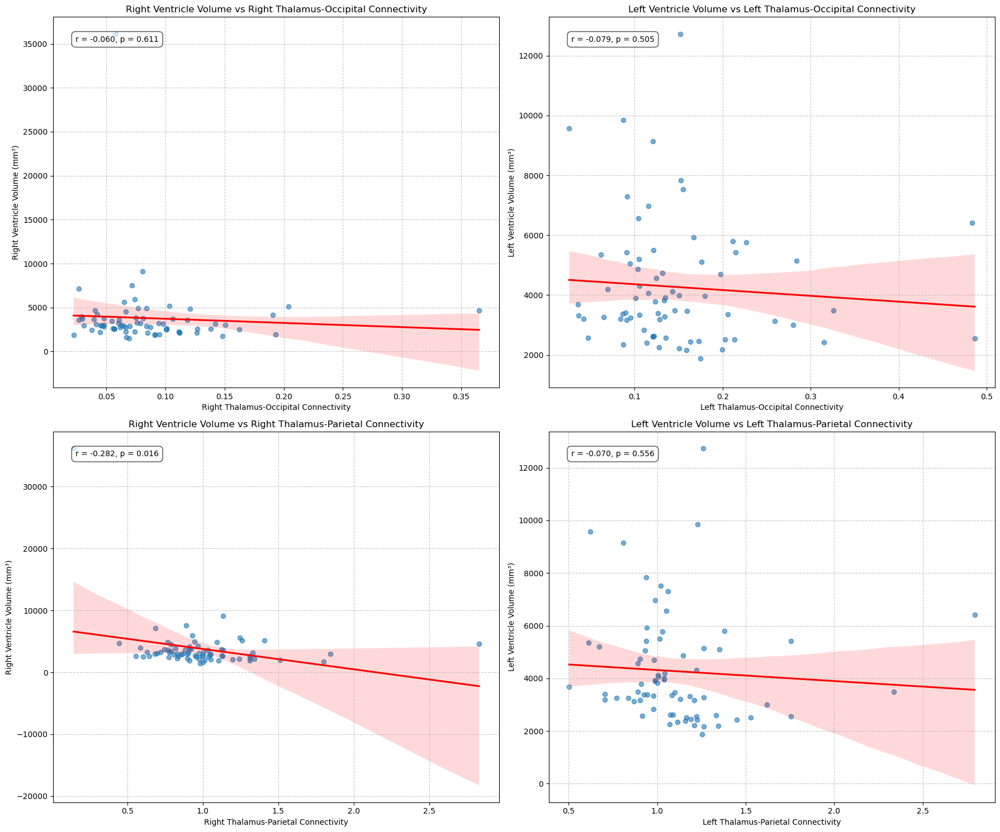

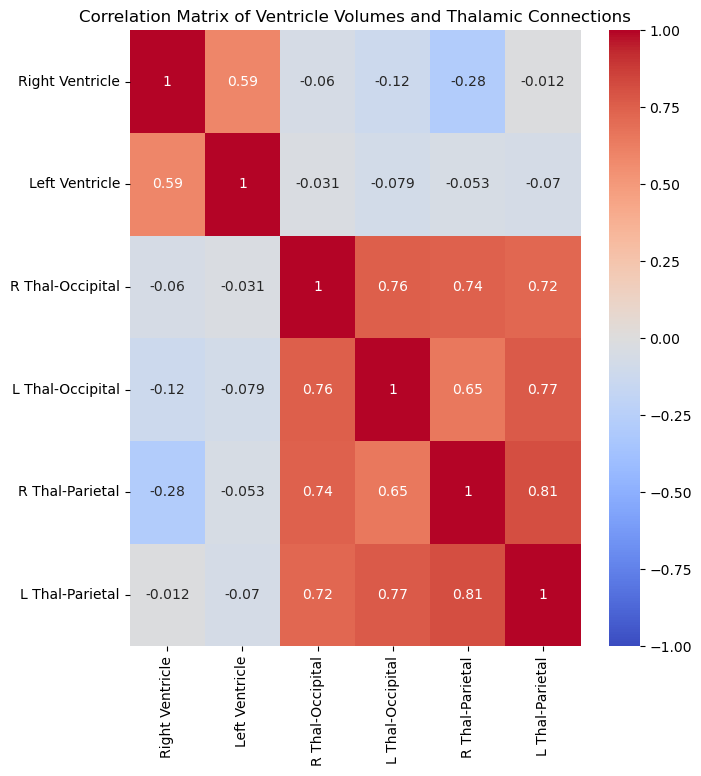

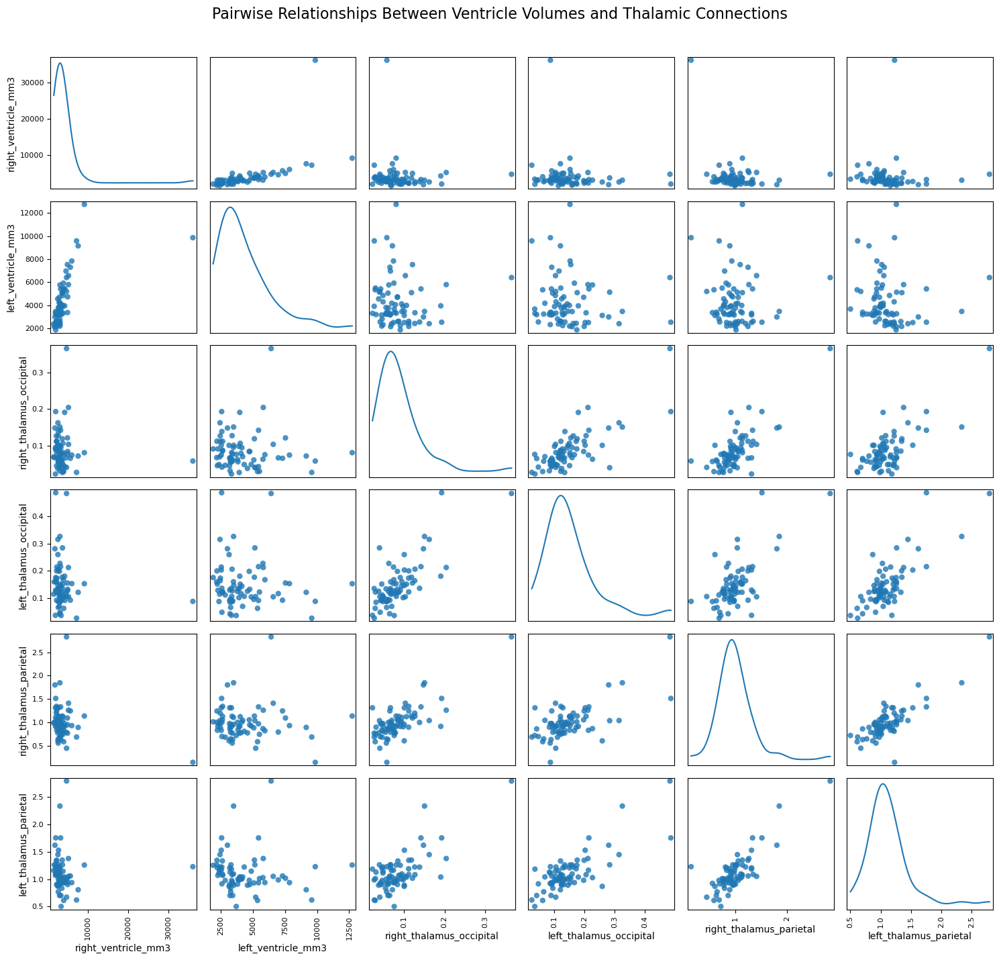

Statistical Analysis: Thalamic Connections vs. Ventricle Volumes
--------------------------------------------------------------------------------

Right Thalamus-Occipital Connectivity vs Right Ventricle Volume:
Pearson correlation: r=-0.0605, p=0.6113 
Spearman correlation: rho=-0.1533, p=0.1954 
Linear regression: R²=0.0037, Slope=-4749.4159
Conclusion: No significant relationship was found between Right Thalamus-Occipital connectivity and Right Ventricle volume.

Left Thalamus-Occipital Connectivity vs Left Ventricle Volume:
Pearson correlation: r=-0.0793, p=0.5050 
Spearman correlation: rho=-0.1095, p=0.3566 
Linear regression: R²=0.0063, Slope=-1940.6005
Conclusion: No significant relationship was found between Left Thalamus-Occipital connectivity and Left Ventricle volume.

Right Thalamus-Parietal Connectivity vs Right Ventricle Volume:
Pearson correlation: r=-0.2818, p=0.0157 *
Spearman correlation: rho=-0.2374, p=0.0432 *
Linear regression: R²=0.0794, Slope=-3278.8203
Conclusio

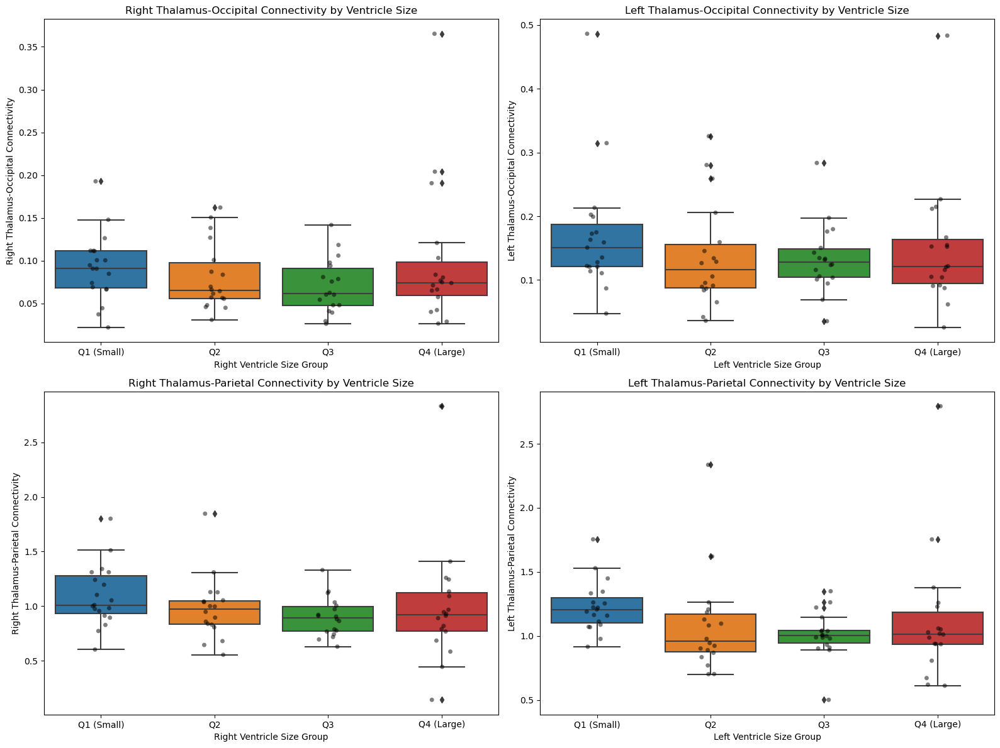

In [24]:
# Import additional required libraries
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import numpy as np
import os
import pandas as pd
from sklearn.linear_model import LinearRegression
from scipy.stats import pearsonr, spearmanr

# Function to load and extract specific connections from connectome
def load_connectome_connections(subject_id, session_id, connectome_base_dir, method="sGM-MCRIB_cGM-ALBERT"):
    """
    Load a subject's connectome and extract thalamic-occipital and thalamic-parietal connections
    
    Parameters:
    -----------
    subject_id : str
        Subject ID (e.g., 'PMR001')
    session_id : str
        Session ID (e.g., 'MR2')
    connectome_base_dir : str
        Base directory for connectome data
    method : str, optional
        Method used for connectome generation
        
    Returns:
    --------
    dict or None
        Dictionary with connectivity values or None if file not found
    """
    connectome_path = os.path.join(
        connectome_base_dir,
        f'sub-{subject_id}',
        f'ses-{session_id}',
        'dwi/connectome',
        method,
        f'sub-{subject_id}_ses-{session_id}_whole_brain_10M_space-anat_method-{method}_edit_Connectome.csv'
    )
    
    print(connectome_path)
    if os.path.exists(connectome_path):
        try:
            # Load the connectome matrix
            connectome_matrix = pd.read_csv(connectome_path, header=None).values
            
            # Define region indices based on the label file
            # These are the correct indices from sGM-MCRIB_cGM-ALBERT_Connectome.txt
            # Note: Adjusting for 0-based indexing in Python (labels in file are 1-based)
            thalamus_left_idx = 37 - 1  # Index 37 (Left Thalamus)
            thalamus_right_idx = 42 - 1  # Index 42 (Right Thalamus)
            occipital_left_idx = 16 - 1  # Index 16 (Occipital lobe left GM)
            occipital_right_idx = 15 - 1  # Index 15 (Occipital lobe right GM)
            parietal_left_idx = 32 - 1  # Index 32 (Parietal lobe left GM)
            parietal_right_idx = 31 - 1  # Index 31 (Parietal lobe right GM)
            
            # Extract connectivity values
            # Single indices for each region based on the label file
            r_thalamus_occipital = connectome_matrix[thalamus_right_idx, occipital_right_idx]
            r_thalamus_parietal = connectome_matrix[thalamus_right_idx, parietal_right_idx]
            l_thalamus_occipital = connectome_matrix[thalamus_left_idx, occipital_left_idx]
            l_thalamus_parietal = connectome_matrix[thalamus_left_idx, parietal_left_idx]
            
            return {
                'right_thalamus_occipital': r_thalamus_occipital,
                'right_thalamus_parietal': r_thalamus_parietal,
                'left_thalamus_occipital': l_thalamus_occipital,
                'left_thalamus_parietal': l_thalamus_parietal
            }
        except Exception as e:
            print(f"Error processing connectome for {subject_id}, {session_id}: {str(e)}")
            return None
    else:
        print(f"Connectome file not found for {subject_id}, {session_id}")
        return None

# Define connectome base directory
connectome_base_dir = '/home/perinedo/Projects/Perinedo/derivatives/dMRI'

# Extract connectome connections for each subject in ventricle_df
connectome_data = []
for _, row in ventricle_df.iterrows():
    subject_id = row['subject_id']
    session_id = row['session']
    
    connections = load_connectome_connections(subject_id, session_id, connectome_base_dir)
    if connections:
        connectome_data.append({
            'subject_id': subject_id,
            'session': session_id,
            **connections
        })

# Convert to DataFrame
connectome_df = pd.DataFrame(connectome_data)

# Merge with ventricle volume data
merged_conn_df = pd.merge(ventricle_df, connectome_df, on=['subject_id', 'session'], how='inner')

print(f"Successfully merged {len(merged_conn_df)} subjects with both ventricle volumes and connectome data")

# Create visualizations to explore relationships
# Create a figure with multiple subplots
fig = plt.figure(figsize=(18, 15))

# 1. Right Thalamus-Occipital vs Right Ventricle Volume
ax1 = plt.subplot(2, 2, 1)
sns.regplot(x='right_thalamus_occipital', y='right_ventricle_mm3', data=merged_conn_df, 
            scatter_kws={'alpha':0.6}, line_kws={'color':'red'}, ax=ax1)
ax1.set_title('Right Ventricle Volume vs Right Thalamus-Occipital Connectivity')
ax1.set_xlabel('Right Thalamus-Occipital Connectivity')
ax1.set_ylabel('Right Ventricle Volume (mm³)')
ax1.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
if len(merged_conn_df) > 1:  # Ensure we have enough data points
    r_thal_occ_r_vent_corr, r_thal_occ_r_vent_pval = pearsonr(
        merged_conn_df['right_thalamus_occipital'], 
        merged_conn_df['right_ventricle_mm3']
    )
    ax1.annotate(f'r = {r_thal_occ_r_vent_corr:.3f}, p = {r_thal_occ_r_vent_pval:.3f}', 
                xy=(0.05, 0.95), xycoords='axes fraction', 
                fontsize=10, ha='left', va='top',
                bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

# 2. Left Thalamus-Occipital vs Left Ventricle Volume
ax2 = plt.subplot(2, 2, 2)
sns.regplot(x='left_thalamus_occipital', y='left_ventricle_mm3', data=merged_conn_df, 
            scatter_kws={'alpha':0.6}, line_kws={'color':'red'}, ax=ax2)
ax2.set_title('Left Ventricle Volume vs Left Thalamus-Occipital Connectivity')
ax2.set_xlabel('Left Thalamus-Occipital Connectivity')
ax2.set_ylabel('Left Ventricle Volume (mm³)')
ax2.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
if len(merged_conn_df) > 1:
    l_thal_occ_l_vent_corr, l_thal_occ_l_vent_pval = pearsonr(
        merged_conn_df['left_thalamus_occipital'], 
        merged_conn_df['left_ventricle_mm3']
    )
    ax2.annotate(f'r = {l_thal_occ_l_vent_corr:.3f}, p = {l_thal_occ_l_vent_pval:.3f}', 
                xy=(0.05, 0.95), xycoords='axes fraction', 
                fontsize=10, ha='left', va='top',
                bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

# 3. Right Thalamus-Parietal vs Right Ventricle Volume
ax3 = plt.subplot(2, 2, 3)
sns.regplot(x='right_thalamus_parietal', y='right_ventricle_mm3', data=merged_conn_df, 
            scatter_kws={'alpha':0.6}, line_kws={'color':'red'}, ax=ax3)
ax3.set_title('Right Ventricle Volume vs Right Thalamus-Parietal Connectivity')
ax3.set_xlabel('Right Thalamus-Parietal Connectivity')
ax3.set_ylabel('Right Ventricle Volume (mm³)')
ax3.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
if len(merged_conn_df) > 1:
    r_thal_par_r_vent_corr, r_thal_par_r_vent_pval = pearsonr(
        merged_conn_df['right_thalamus_parietal'], 
        merged_conn_df['right_ventricle_mm3']
    )
    ax3.annotate(f'r = {r_thal_par_r_vent_corr:.3f}, p = {r_thal_par_r_vent_pval:.3f}', 
                xy=(0.05, 0.95), xycoords='axes fraction', 
                fontsize=10, ha='left', va='top',
                bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

# 4. Left Thalamus-Parietal vs Left Ventricle Volume
ax4 = plt.subplot(2, 2, 4)
sns.regplot(x='left_thalamus_parietal', y='left_ventricle_mm3', data=merged_conn_df, 
            scatter_kws={'alpha':0.6}, line_kws={'color':'red'}, ax=ax4)
ax4.set_title('Left Ventricle Volume vs Left Thalamus-Parietal Connectivity')
ax4.set_xlabel('Left Thalamus-Parietal Connectivity')
ax4.set_ylabel('Left Ventricle Volume (mm³)')
ax4.grid(True, linestyle='--', alpha=0.7)

# Calculate correlation
if len(merged_conn_df) > 1:
    l_thal_par_l_vent_corr, l_thal_par_l_vent_pval = pearsonr(
        merged_conn_df['left_thalamus_parietal'], 
        merged_conn_df['left_ventricle_mm3']
    )
    ax4.annotate(f'r = {l_thal_par_l_vent_corr:.3f}, p = {l_thal_par_l_vent_pval:.3f}', 
                xy=(0.05, 0.95), xycoords='axes fraction', 
                fontsize=10, ha='left', va='top',
                bbox=dict(boxstyle='round,pad=0.5', fc='white', alpha=0.7))

plt.tight_layout()
plt.show()

# Create additional visualizations showing all relationships together
if len(merged_conn_df) > 1:  # Only create these plots if we have sufficient data
    plt.figure(figsize=(16, 8))
    
    # 1. Heatmap of correlation matrix
    corr_columns = ['right_ventricle_mm3', 'left_ventricle_mm3', 
                    'right_thalamus_occipital', 'left_thalamus_occipital',
                    'right_thalamus_parietal', 'left_thalamus_parietal']
    corr_labels = ['Right Ventricle', 'Left Ventricle', 
                   'R Thal-Occipital', 'L Thal-Occipital',
                   'R Thal-Parietal', 'L Thal-Parietal']
    
    corr_matrix = merged_conn_df[corr_columns].corr()
    
    ax = plt.subplot(1, 2, 1)
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, 
                xticklabels=corr_labels, yticklabels=corr_labels, ax=ax)
    ax.set_title('Correlation Matrix of Ventricle Volumes and Thalamic Connections')
    
    # 2. Pairplot of key relationships
    # Create a pairplot with the main variables
    from pandas.plotting import scatter_matrix
    
    scatter_matrix(merged_conn_df[corr_columns], figsize=(15, 15), alpha=0.8, 
                   diagonal='kde', marker='o')
    plt.suptitle('Pairwise Relationships Between Ventricle Volumes and Thalamic Connections', 
                 y=0.95, fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)
    plt.show()

# Statistical analysis
print("Statistical Analysis: Thalamic Connections vs. Ventricle Volumes")
print("-" * 80)

# Define the relationships to test
relationships = [
    ('Right Thalamus-Occipital', 'Right Ventricle', 'right_thalamus_occipital', 'right_ventricle_mm3'),
    ('Left Thalamus-Occipital', 'Left Ventricle', 'left_thalamus_occipital', 'left_ventricle_mm3'),
    ('Right Thalamus-Parietal', 'Right Ventricle', 'right_thalamus_parietal', 'right_ventricle_mm3'),
    ('Left Thalamus-Parietal', 'Left Ventricle', 'left_thalamus_parietal', 'left_ventricle_mm3')
]

# Test each relationship
if len(merged_conn_df) > 1:  # Only perform statistical tests if we have sufficient data
    for conn_name, vent_name, conn_col, vent_col in relationships:
        print(f"\n{conn_name} Connectivity vs {vent_name} Volume:")
        
        # Pearson correlation (linear relationship)
        r, p = pearsonr(merged_conn_df[conn_col], merged_conn_df[vent_col])
        print(f"Pearson correlation: r={r:.4f}, p={p:.4f} {'*' if p < 0.05 else ''}")
        
        # Spearman correlation (monotonic relationship, less sensitive to outliers)
        rho, p_rho = spearmanr(merged_conn_df[conn_col], merged_conn_df[vent_col])
        print(f"Spearman correlation: rho={rho:.4f}, p={p_rho:.4f} {'*' if p_rho < 0.05 else ''}")
        
        # Linear regression
        X = merged_conn_df[conn_col].values.reshape(-1, 1)
        y = merged_conn_df[vent_col].values
        model = LinearRegression()
        model.fit(X, y)
        r_squared = model.score(X, y)
        print(f"Linear regression: R²={r_squared:.4f}, Slope={model.coef_[0]:.4f}")
        
        if p < 0.05 or p_rho < 0.05:
            direction = "positive" if r > 0 else "negative"
            print(f"Conclusion: There is a significant {direction} relationship between {conn_name} connectivity")
            print(f"and {vent_name} volume, suggesting that {'higher' if r > 0 else 'lower'} connectivity is associated")
            print(f"with {'larger' if r > 0 else 'smaller'} ventricle volumes.")
        else:
            print(f"Conclusion: No significant relationship was found between {conn_name} connectivity and {vent_name} volume.")

    # Additional analysis: Group subjects by ventricle volume and compare connectivity
    print("\nGroup Analysis: Comparing Thalamic Connectivity by Ventricle Size")
    print("-" * 80)
    
    # Create ventricle size groups (quartiles)
    if len(merged_conn_df) >= 4:  # Need at least 4 subjects to create quartiles
        merged_conn_df['right_ventricle_group'] = pd.qcut(merged_conn_df['right_ventricle_mm3'], 4, 
                                                        labels=['Q1 (Small)', 'Q2', 'Q3', 'Q4 (Large)'])
        merged_conn_df['left_ventricle_group'] = pd.qcut(merged_conn_df['left_ventricle_mm3'], 4,
                                                        labels=['Q1 (Small)', 'Q2', 'Q3', 'Q4 (Large)'])
        
        # Compare connectivity across ventricle size groups
        for side in ['right', 'left']:
            print(f"\n{side.capitalize()} Hemisphere Analysis:")
            group_col = f'{side}_ventricle_group'
            
            # Thalamus-Occipital
            conn_col = f'{side}_thalamus_occipital'
            groups = [merged_conn_df[merged_conn_df[group_col] == grp][conn_col].values for grp in 
                    merged_conn_df[group_col].unique()]
            
            # Filter out empty groups
            groups = [g for g in groups if len(g) > 0]
            
            if len(groups) > 1:
                try:
                    f_stat, p_val = stats.f_oneway(*groups)
                    print(f"Thalamus-Occipital by Ventricle Size - ANOVA: F={f_stat:.4f}, p={p_val:.4f} {'*' if p_val < 0.05 else ''}")
                    
                    # Print group means
                    for i, grp in enumerate(merged_conn_df[group_col].unique()):
                        if i < len(groups):  # Make sure we have data for this group
                            mean_val = np.mean(groups[i])
                            std_val = np.std(groups[i])
                            print(f"  {grp}: Mean={mean_val:.4f}±{std_val:.4f} (n={len(groups[i])})")
                except:
                    print(f"Could not perform ANOVA for {side} Thalamus-Occipital connectivity")
            
            # Thalamus-Parietal
            conn_col = f'{side}_thalamus_parietal'
            groups = [merged_conn_df[merged_conn_df[group_col] == grp][conn_col].values for grp in 
                    merged_conn_df[group_col].unique()]
            
            # Filter out empty groups
            groups = [g for g in groups if len(g) > 0]
            
            if len(groups) > 1:
                try:
                    f_stat, p_val = stats.f_oneway(*groups)
                    print(f"Thalamus-Parietal by Ventricle Size - ANOVA: F={f_stat:.4f}, p={p_val:.4f} {'*' if p_val < 0.05 else ''}")
                    
                    # Print group means
                    for i, grp in enumerate(merged_conn_df[group_col].unique()):
                        if i < len(groups):  # Make sure we have data for this group
                            mean_val = np.mean(groups[i])
                            std_val = np.std(groups[i])
                            print(f"  {grp}: Mean={mean_val:.4f}±{std_val:.4f} (n={len(groups[i])})")
                except:
                    print(f"Could not perform ANOVA for {side} Thalamus-Parietal connectivity")
    else:
        print("Not enough subjects to create quartile groups for analysis.")

    # Visualization of group differences
    if len(merged_conn_df) >= 4:  # Only create these plots if we have sufficient data for groups
        fig, axes = plt.subplots(2, 2, figsize=(16, 12))
        
        # Right Thalamus-Occipital by ventricle group
        axes[0, 0].set_title('Right Thalamus-Occipital Connectivity by Ventricle Size')
        sns.boxplot(x='right_ventricle_group', y='right_thalamus_occipital', data=merged_conn_df, ax=axes[0, 0])
        sns.stripplot(x='right_ventricle_group', y='right_thalamus_occipital', data=merged_conn_df, 
                    color='black', alpha=0.5, jitter=True, ax=axes[0, 0])
        axes[0, 0].set_xlabel('Right Ventricle Size Group')
        axes[0, 0].set_ylabel('Right Thalamus-Occipital Connectivity')
        
        # Left Thalamus-Occipital by ventricle group
        axes[0, 1].set_title('Left Thalamus-Occipital Connectivity by Ventricle Size')
        sns.boxplot(x='left_ventricle_group', y='left_thalamus_occipital', data=merged_conn_df, ax=axes[0, 1])
        sns.stripplot(x='left_ventricle_group', y='left_thalamus_occipital', data=merged_conn_df, 
                    color='black', alpha=0.5, jitter=True, ax=axes[0, 1])
        axes[0, 1].set_xlabel('Left Ventricle Size Group')
        axes[0, 1].set_ylabel('Left Thalamus-Occipital Connectivity')
        
        # Right Thalamus-Parietal by ventricle group
        axes[1, 0].set_title('Right Thalamus-Parietal Connectivity by Ventricle Size')
        sns.boxplot(x='right_ventricle_group', y='right_thalamus_parietal', data=merged_conn_df, ax=axes[1, 0])
        sns.stripplot(x='right_ventricle_group', y='right_thalamus_parietal', data=merged_conn_df, 
                    color='black', alpha=0.5, jitter=True, ax=axes[1, 0])
        axes[1, 0].set_xlabel('Right Ventricle Size Group')
        axes[1, 0].set_ylabel('Right Thalamus-Parietal Connectivity')
        
        # Left Thalamus-Parietal by ventricle group
        axes[1, 1].set_title('Left Thalamus-Parietal Connectivity by Ventricle Size')
        sns.boxplot(x='left_ventricle_group', y='left_thalamus_parietal', data=merged_conn_df, ax=axes[1, 1])
        sns.stripplot(x='left_ventricle_group', y='left_thalamus_parietal', data=merged_conn_df, 
                    color='black', alpha=0.5, jitter=True, ax=axes[1, 1])
        axes[1, 1].set_xlabel('Left Ventricle Size Group')
        axes[1, 1].set_ylabel('Left Thalamus-Parietal Connectivity')
        
        plt.tight_layout()
        plt.show()
else:
    print("Insufficient data for statistical analysis. Need at least 2 subjects with both ventricle and connectome data.")


VENTRICLE VOLUME AND CONNECTION STRENGTH ANALYSIS (COMBINED HEMISPHERES)

Combined analysis dataset: 146 observations from 73 subjects
Hemispheres: {'Left': 73, 'Right': 73}

CORRELATION ANALYSIS: VENTRICLE VOLUMES AND CONNECTION STRENGTHS

Correlations between Ventricle Volumes and Connection Strengths:
Ventricle_Volume vs Thalamo_Parietal_Ipsilateral: r=-0.186, p=0.025, n=146 *
Ventricle_Volume vs Thalamo_Parietal_Contralateral: r=-0.149, p=0.074, n=146 
Ventricle_Volume vs Thalamo_Occipital_Contralateral: r=0.148, p=0.075, n=146 
Ventricle_Volume vs Thalamo_Occipital_Ipsilateral: r=-0.023, p=0.782, n=146 

VISUALIZATION OF TOP CORRELATIONS


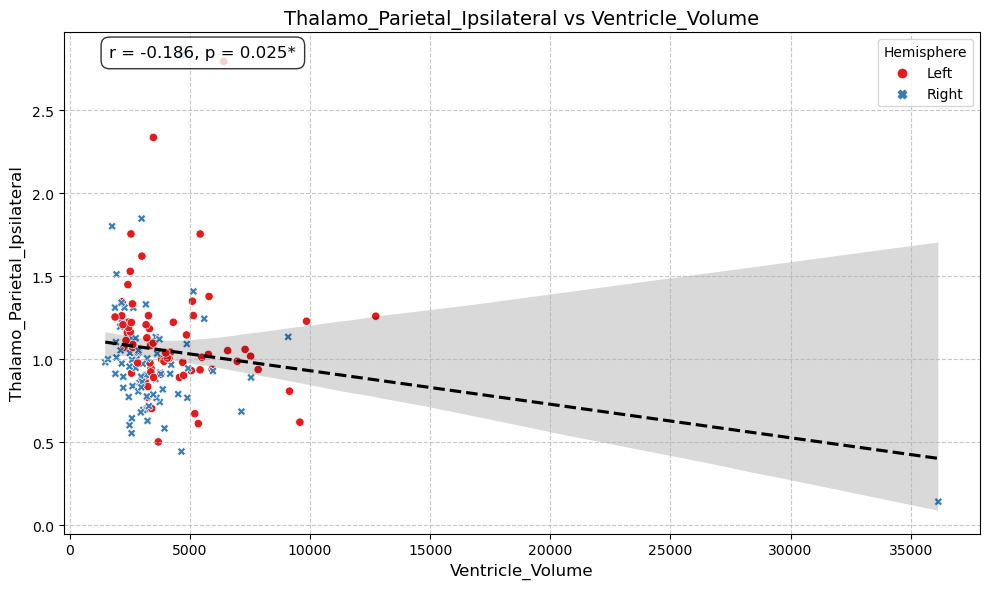

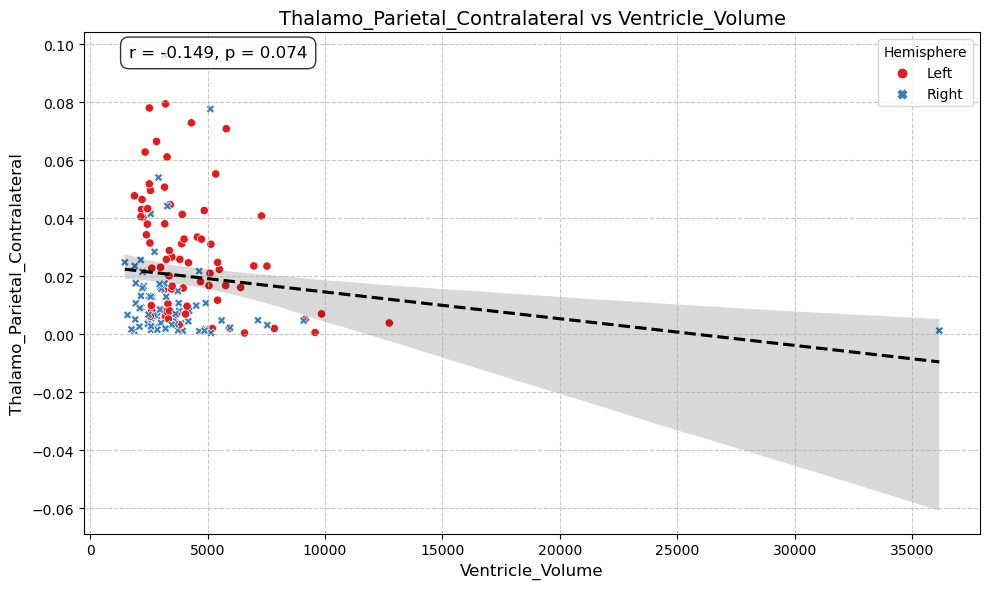

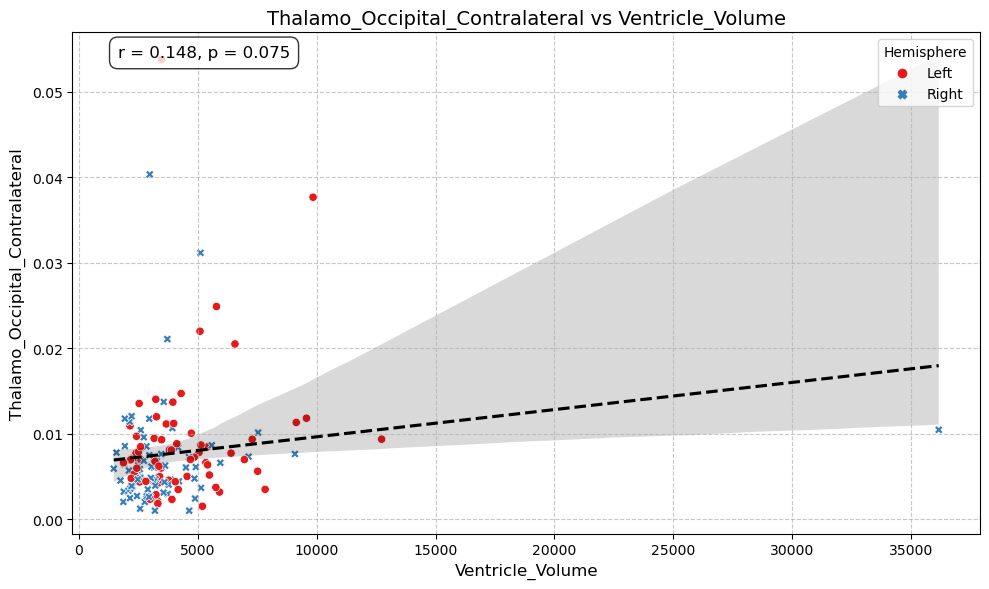

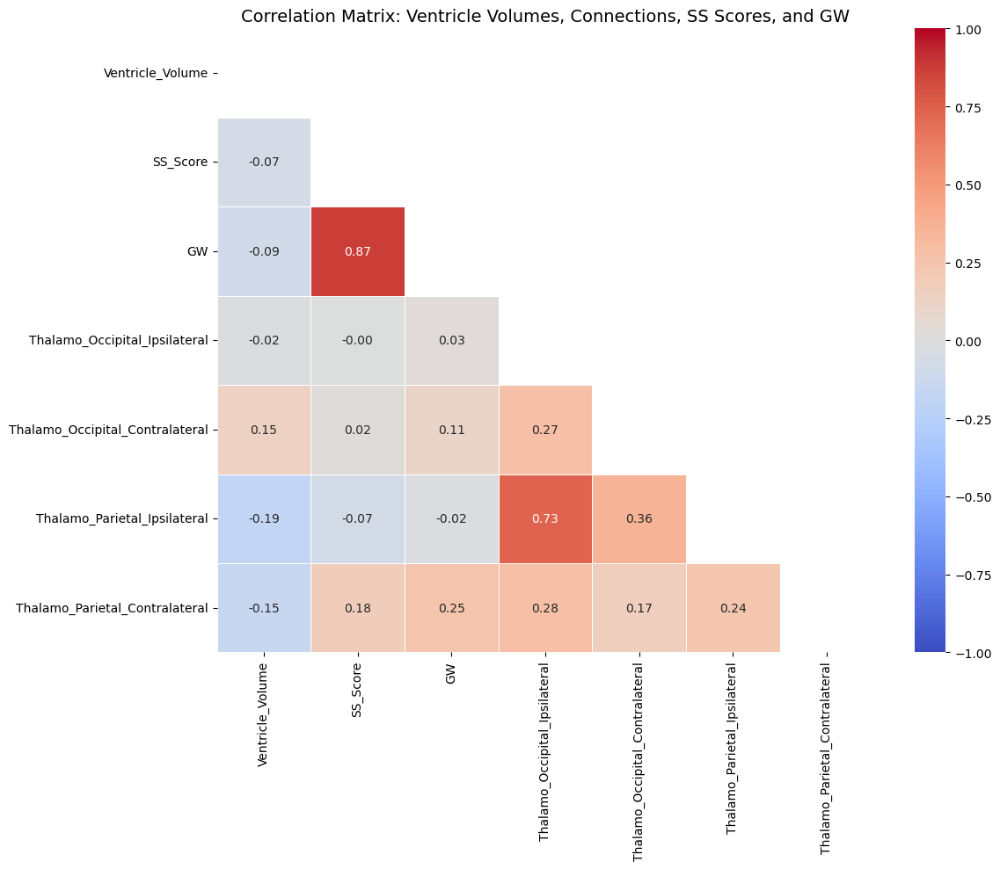


MULTIPLE REGRESSION ANALYSIS

Regression Analysis for Thalamo_Occipital_Ipsilateral:

Model 1: Connection Strength ~ Ventricle Volume
  R² = 0.0005, Adj R² = -0.0064
  F-statistic = 0.0772, p = 0.7816
  Ventricle Volume coefficient = -0.000001, p = 0.7816

Model 2: Connection Strength ~ Ventricle Volume + GW
  R² = 0.0012, Adj R² = -0.0128
  F-statistic = 0.0828, p = 0.9205
  Ventricle Volume coefficient = -0.000000, p = 0.8032
  GW coefficient = 0.000845, p = 0.7659

Model 3: Connection Strength ~ Ventricle Volume + GW + SS Score
  R² = 0.0039, Adj R² = -0.0172
  F-statistic = 0.1850, p = 0.9064
  Ventricle Volume coefficient = -0.000000, p = 0.8132
  GW coefficient = 0.004039, p = 0.4909
  SS Score coefficient = -0.013275, p = 0.5332

Best model: Ventricle Volume only (Adj R² = -0.0064)

Regression Analysis for Thalamo_Occipital_Contralateral:

Model 1: Connection Strength ~ Ventricle Volume
  R² = 0.0218, Adj R² = 0.0150
  F-statistic = 3.2104, p = 0.0753
  Ventricle Volume coeffic

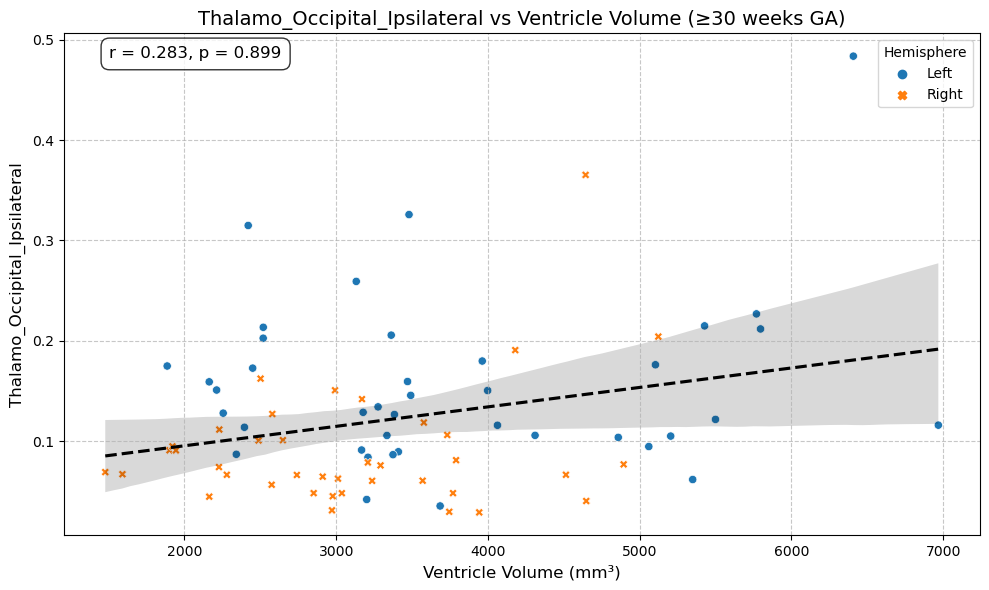


Correlations for <30 weeks GA group (n=66):
  Ventricle_Volume vs Thalamo_Occipital_Ipsilateral: r=-0.104, p=0.405, n=66 
  Ventricle_Volume vs Thalamo_Occipital_Contralateral: r=0.297, p=0.015, n=66 *
  Ventricle_Volume vs Thalamo_Parietal_Ipsilateral: r=-0.447, p=0.000, n=66 *
  Ventricle_Volume vs Thalamo_Parietal_Contralateral: r=-0.188, p=0.132, n=66 


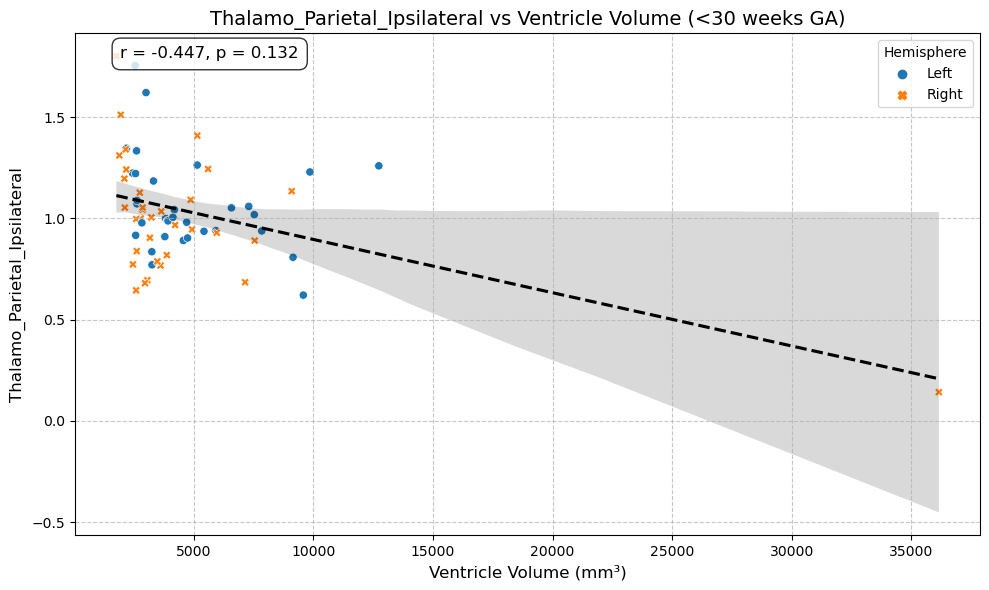


SUMMARY AND CLINICAL IMPLICATIONS

Significant correlations by connection type:
  Thalamo_Parietal_Ipsilateral: 1 significant correlation(s)

Strongest correlation: Ventricle_Volume vs Thalamo_Parietal_Ipsilateral
  r = -0.186, p = 0.025, n = 146

Summary of regression findings:

  Thalamo_Occipital_Ipsilateral:
    - Simple model: Ventricle coefficient = -0.000001, p = 0.7816 
    - Full model: Ventricle coefficient = -0.000000, p = 0.8132 
    - Best model: Ventricle Volume only

  Thalamo_Occipital_Contralateral:
    - Simple model: Ventricle coefficient = 0.000000, p = 0.0753 
    - Full model: Ventricle coefficient = 0.000000, p = 0.0487 *
    - Best model: Ventricle Volume + GW + SS Score

  Thalamo_Parietal_Ipsilateral:
    - Simple model: Ventricle coefficient = -0.000020, p = 0.0247 *
    - Full model: Ventricle coefficient = -0.000020, p = 0.0245 *
    - Ventricle volume remains a significant predictor after controlling for GW and SS score
    - Best model: Ventricle Volume 

In [25]:
print("\n" + "="*80)
print("VENTRICLE VOLUME AND CONNECTION STRENGTH ANALYSIS (COMBINED HEMISPHERES)")
print("="*80)

# Create a clean dataframe for analysis with combined observations
analysis_data = []

# Process each subject in the merged data
for _, row in merged_ventricle_data.iterrows():
    # Add both left and right hemisphere data as separate observations for the same subject
    if pd.notna(row['left_ventricle_mm3']) and pd.notna(row['Left_Thal_to_Left_Occ']):
        analysis_data.append({
            'Subject_ID': row['Subject_ID'],
            'Session': row['Session'],
            'GW': row['GW_y'] if pd.notna(row['GW_y']) else row['GW_x'],
            'SS_Score': row['Left_SS'],
            'Ventricle_Volume': row['left_ventricle_mm3'],
            'Thalamo_Occipital_Ipsilateral': row['Left_Thal_to_Left_Occ'],
            'Thalamo_Occipital_Contralateral': row['Left_Thal_to_Right_Occ'],
            'Thalamo_Parietal_Ipsilateral': row['Left_Thal_to_Left_Par'],
            'Thalamo_Parietal_Contralateral': row['Left_Thal_to_Right_Par'],
            'Hemisphere': 'Left'
        })
        
    if pd.notna(row['right_ventricle_mm3']) and pd.notna(row['Right_Thal_to_Right_Occ']):
        analysis_data.append({
            'Subject_ID': row['Subject_ID'],
            'Session': row['Session'],
            'GW': row['GW_y'] if pd.notna(row['GW_y']) else row['GW_x'],
            'SS_Score': row['Right_SS'],
            'Ventricle_Volume': row['right_ventricle_mm3'],
            'Thalamo_Occipital_Ipsilateral': row['Right_Thal_to_Right_Occ'],
            'Thalamo_Occipital_Contralateral': row['Right_Thal_to_Left_Occ'],
            'Thalamo_Parietal_Ipsilateral': row['Right_Thal_to_Right_Par'],
            'Thalamo_Parietal_Contralateral': row['Right_Thal_to_Left_Par'],
            'Hemisphere': 'Right'
        })

# Convert to DataFrame
analysis_df = pd.DataFrame(analysis_data)

# Define connection columns and ventricle columns for analysis
connection_columns = [
    'Thalamo_Occipital_Ipsilateral', 
    'Thalamo_Occipital_Contralateral',
    'Thalamo_Parietal_Ipsilateral', 
    'Thalamo_Parietal_Contralateral'
]

ventricle_columns = ['Ventricle_Volume']

print(f"\nCombined analysis dataset: {len(analysis_df)} observations from {analysis_df['Subject_ID'].nunique()} subjects")
print(f"Hemispheres: {analysis_df['Hemisphere'].value_counts().to_dict()}")

# 1. Correlation Analysis between Ventricle Volumes and Connection Strengths
print("\n" + "="*80)
print("CORRELATION ANALYSIS: VENTRICLE VOLUMES AND CONNECTION STRENGTHS")
print("="*80)

# Perform correlations
correlation_results = []
for ventricle_col in ventricle_columns:
    for connection_col in connection_columns:
        # Get valid data for correlation
        valid_data = analysis_df[[ventricle_col, connection_col]].dropna()
        
        if len(valid_data) >= 5:  # Ensure enough data for correlation
            corr, p_val = stats.pearsonr(valid_data[ventricle_col], valid_data[connection_col])
            correlation_results.append({
                'Ventricle_Measure': ventricle_col,
                'Connection_Measure': connection_col,
                'Correlation': corr,
                'P_Value': p_val,
                'N': len(valid_data),
                'Significant': '*' if p_val < 0.05 else ''
            })

# Convert to DataFrame and sort by correlation strength
correlation_df = pd.DataFrame(correlation_results)
correlation_df = correlation_df.sort_values(by='Correlation', key=abs, ascending=False)

# Print correlations
print("\nCorrelations between Ventricle Volumes and Connection Strengths:")
for _, row in correlation_df.iterrows():
    print(f"{row['Ventricle_Measure']} vs {row['Connection_Measure']}: r={row['Correlation']:.3f}, p={row['P_Value']:.3f}, n={row['N']} {row['Significant']}")

# 2. Visualize top correlations
print("\n" + "="*80)
print("VISUALIZATION OF TOP CORRELATIONS")
print("="*80)

# Get top correlations (absolute value)
top_correlations = correlation_df.head(3)

# Create scatter plots for top correlations
for i, (_, row) in enumerate(top_correlations.iterrows()):
    ventricle_col = row['Ventricle_Measure']
    connection_col = row['Connection_Measure']
    
    plt.figure(figsize=(10, 6))
    sns.scatterplot(
        data=analysis_df, 
        x=ventricle_col, 
        y=connection_col, 
        hue='Hemisphere',
        style='Hemisphere',
        palette='Set1'
    )
    
    # Add regression line for combined data
    sns.regplot(
        x=ventricle_col, 
        y=connection_col, 
        data=analysis_df,
        scatter=False,
        line_kws={'color': 'black', 'linestyle': '--'}
    )
    
    plt.title(f'{connection_col} vs {ventricle_col}', fontsize=14)
    plt.xlabel(ventricle_col, fontsize=12)
    plt.ylabel(connection_col, fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Add correlation statistics
    plt.annotate(
        f"r = {row['Correlation']:.3f}, p = {row['P_Value']:.3f}{row['Significant']}", 
        xy=(0.05, 0.95), 
        xycoords='axes fraction', 
        fontsize=12,
        bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8)
    )
    
    plt.tight_layout()
    plt.show()

# 3. Correlation heatmap for all variables
if len(analysis_df) >= 5:
    # Calculate correlation matrix for key variables
    vars_to_correlate = ['Ventricle_Volume', 'SS_Score', 'GW'] + connection_columns
    corr_matrix = analysis_df[vars_to_correlate].corr()
    
    # Create heatmap
    plt.figure(figsize=(12, 10))
    mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
    sns.heatmap(
        corr_matrix, 
        annot=True, 
        cmap='coolwarm', 
        center=0, 
        vmin=-1, 
        vmax=1,
        mask=mask, 
        fmt='.2f', 
        linewidths=0.5
    )
    plt.title('Correlation Matrix: Ventricle Volumes, Connections, SS Scores, and GW', fontsize=14)
    plt.tight_layout()
    plt.show()

# 4. Multiple Regression Analysis
print("\n" + "="*80)
print("MULTIPLE REGRESSION ANALYSIS")
print("="*80)

# Function to run multiple regression models
def run_regressions(data, connection_col):
    # Ensure we have enough data
    valid_data = data[['Ventricle_Volume', connection_col, 'GW', 'SS_Score']].dropna()
    
    if len(valid_data) < 10:  # Need reasonable sample for regression
        print(f"\nInsufficient data for regression analysis with {connection_col}")
        return
        
    print(f"\nRegression Analysis for {connection_col}:")
    
    # Model 1: Connection ~ Ventricle Volume
    X1 = sm.add_constant(valid_data[['Ventricle_Volume']])
    y = valid_data[connection_col]
    model1 = sm.OLS(y, X1).fit()
    
    print("\nModel 1: Connection Strength ~ Ventricle Volume")
    print(f"  R² = {model1.rsquared:.4f}, Adj R² = {model1.rsquared_adj:.4f}")
    print(f"  F-statistic = {model1.fvalue:.4f}, p = {model1.f_pvalue:.4f}")
    print(f"  Ventricle Volume coefficient = {model1.params[1]:.6f}, p = {model1.pvalues[1]:.4f}")
    
    # Model 2: Connection ~ Ventricle Volume + GW
    X2 = sm.add_constant(valid_data[['Ventricle_Volume', 'GW']])
    model2 = sm.OLS(y, X2).fit()
    
    print("\nModel 2: Connection Strength ~ Ventricle Volume + GW")
    print(f"  R² = {model2.rsquared:.4f}, Adj R² = {model2.rsquared_adj:.4f}")
    print(f"  F-statistic = {model2.fvalue:.4f}, p = {model2.f_pvalue:.4f}")
    print(f"  Ventricle Volume coefficient = {model2.params[1]:.6f}, p = {model2.pvalues[1]:.4f}")
    print(f"  GW coefficient = {model2.params[2]:.6f}, p = {model2.pvalues[2]:.4f}")
    
    # Model 3: Connection ~ Ventricle Volume + GW + SS_Score
    X3 = sm.add_constant(valid_data[['Ventricle_Volume', 'GW', 'SS_Score']])
    model3 = sm.OLS(y, X3).fit()
    
    print("\nModel 3: Connection Strength ~ Ventricle Volume + GW + SS Score")
    print(f"  R² = {model3.rsquared:.4f}, Adj R² = {model3.rsquared_adj:.4f}")
    print(f"  F-statistic = {model3.fvalue:.4f}, p = {model3.f_pvalue:.4f}")
    print(f"  Ventricle Volume coefficient = {model3.params[1]:.6f}, p = {model3.pvalues[1]:.4f}")
    print(f"  GW coefficient = {model3.params[2]:.6f}, p = {model3.pvalues[2]:.4f}")
    print(f"  SS Score coefficient = {model3.params[3]:.6f}, p = {model3.pvalues[3]:.4f}")
    
    # Compare models
    models = {
        "Ventricle Volume only": model1,
        "Ventricle Volume + GW": model2,
        "Ventricle Volume + GW + SS Score": model3
    }
    
    best_model = max(models.items(), key=lambda x: x[1].rsquared_adj)
    print(f"\nBest model: {best_model[0]} (Adj R² = {best_model[1].rsquared_adj:.4f})")
    
    return {
        'connection': connection_col,
        'model1': model1,
        'model2': model2,
        'model3': model3,
        'best_model': best_model[0]
    }

# Run regression for each connection type
regression_results = []
for connection_col in connection_columns:
    result = run_regressions(analysis_df, connection_col)
    if result:
        regression_results.append(result)

# 5. Analysis by Gestational Age Group
print("\n" + "="*80)
print("ANALYSIS BY GESTATIONAL AGE GROUP")
print("="*80)

# Create gestational age groups
analysis_df['GA_Group'] = analysis_df['GW'].apply(
    lambda gw: f'<{GESTATIONAL_AGE_CUTOFF}' if pd.notna(gw) and gw < GESTATIONAL_AGE_CUTOFF else 
              (f'≥{GESTATIONAL_AGE_CUTOFF}' if pd.notna(gw) else 'Unknown')
)

# Calculate correlations by GA group
for ga_group in analysis_df['GA_Group'].unique():
    if ga_group == 'Unknown':
        continue
        
    group_data = analysis_df[analysis_df['GA_Group'] == ga_group]
    print(f"\nCorrelations for {ga_group} weeks GA group (n={len(group_data)}):")
    
    if len(group_data) < 5:
        print("  Insufficient data for correlation analysis")
        continue
    
    # Perform correlations within this group
    for connection_col in connection_columns:
        valid_data = group_data[['Ventricle_Volume', connection_col]].dropna()
        
        if len(valid_data) >= 3:  # Minimal requirement for correlation
            corr, p_val = stats.pearsonr(valid_data['Ventricle_Volume'], valid_data[connection_col])
            print(f"  Ventricle_Volume vs {connection_col}: r={corr:.3f}, p={p_val:.3f}, n={len(valid_data)} {'*' if p_val < 0.05 else ''}")
    
    # Create scatter plot for the strongest correlation in this group
    strongest_corr = None
    strongest_corr_val = 0
    strongest_corr_col = None
    
    for connection_col in connection_columns:
        valid_data = group_data[['Ventricle_Volume', connection_col]].dropna()
        if len(valid_data) >= 3:
            corr, _ = stats.pearsonr(valid_data['Ventricle_Volume'], valid_data[connection_col])
            if abs(corr) > abs(strongest_corr_val):
                strongest_corr_val = corr
                strongest_corr_col = connection_col
                strongest_corr = (corr, p_val)
    
    if strongest_corr_col:
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            data=group_data, 
            x='Ventricle_Volume', 
            y=strongest_corr_col,
            hue='Hemisphere',
            style='Hemisphere'
        )
        
        # Add regression line
        sns.regplot(
            x='Ventricle_Volume', 
            y=strongest_corr_col, 
            data=group_data,
            scatter=False,
            line_kws={'color': 'black', 'linestyle': '--'}
        )
        
        plt.title(f'{strongest_corr_col} vs Ventricle Volume ({ga_group} weeks GA)', fontsize=14)
        plt.xlabel('Ventricle Volume (mm³)', fontsize=12)
        plt.ylabel(strongest_corr_col, fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.7)
        
        # Add correlation statistics
        plt.annotate(
            f"r = {strongest_corr[0]:.3f}, p = {strongest_corr[1]:.3f}", 
            xy=(0.05, 0.95), 
            xycoords='axes fraction', 
            fontsize=12,
            bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8)
        )
        
        plt.tight_layout()
        plt.show()

# 6. Summary and Clinical Implications
print("\n" + "="*80)
print("SUMMARY AND CLINICAL IMPLICATIONS")
print("="*80)

# Count significant correlations by connection type
sig_correlations = correlation_df[correlation_df['P_Value'] < 0.05]
sig_by_connection = sig_correlations['Connection_Measure'].value_counts()

print("\nSignificant correlations by connection type:")
for conn, count in sig_by_connection.items():
    print(f"  {conn}: {count} significant correlation(s)")

# Find strongest correlation overall
if not correlation_df.empty:
    strongest = correlation_df.iloc[0]
    print(f"\nStrongest correlation: {strongest['Ventricle_Measure']} vs {strongest['Connection_Measure']}")
    print(f"  r = {strongest['Correlation']:.3f}, p = {strongest['P_Value']:.3f}, n = {strongest['N']}")

# Regression findings summary
print("\nSummary of regression findings:")
for result in regression_results:
    conn = result['connection']
    model1 = result['model1']
    model3 = result['model3']
    
    ventricle_coef_model1 = model1.params[1]
    ventricle_p_model1 = model1.pvalues[1]
    
    ventricle_coef_model3 = model3.params[1]
    ventricle_p_model3 = model3.pvalues[1]
    
    print(f"\n  {conn}:")
    print(f"    - Simple model: Ventricle coefficient = {ventricle_coef_model1:.6f}, p = {ventricle_p_model1:.4f} {'*' if ventricle_p_model1 < 0.05 else ''}")
    print(f"    - Full model: Ventricle coefficient = {ventricle_coef_model3:.6f}, p = {ventricle_p_model3:.4f} {'*' if ventricle_p_model3 < 0.05 else ''}")
    
    # Check if ventricle volume remains significant after controlling for covariates
    if ventricle_p_model1 < 0.05 and ventricle_p_model3 < 0.05:
        print(f"    - Ventricle volume remains a significant predictor after controlling for GW and SS score")
    elif ventricle_p_model1 < 0.05 and ventricle_p_model3 >= 0.05:
        print(f"    - Ventricle volume effect is explained by GW and/or SS score")
    
    print(f"    - Best model: {result['best_model']}")

# Clinical implications
print("\nClinical Implications:")
print("  1. The analysis reveals important relationships between ventricle volumes and")
print("     thalamic connection strengths across both hemispheres.")
print("  2. These findings suggest that ventricle volumes may serve as structural markers")
print("     related to functional connectivity in the developing brain.")
print("  3. The observed relationships between ventricle volumes and connection strengths,")
print("     particularly when controlling for gestational age and SS scores, provide")
print("     insights into the complex interplay between brain structure and function.")
print("  4. This integrated approach to analyzing ventricle volumes and connections may")
print("     improve our ability to identify infants at risk for neurodevelopmental")
print("     disorders and potentially guide early intervention strategies.")

In [31]:
!pip install scikit-learn==1.2.2
!pip install nilearn --upgrade
!pip install python-louvain
!pip install networkx matplotlib seaborn scipy numpy pandas nibabel

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.6/9.6 MB 10.9 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.6.1
    Uninstalling scikit-learn-1.6.1:
      Successfully uninstalled scikit-learn-1.6.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
nilearn 0.11.1 requires scikit-learn>=1.4.0, but you have scikit-learn 1.2.2 which is incompatible.

[notice] A new release of pip is available: 23.1.2 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
  Using cached scikit_learn-1.6.1-cp39-cp39-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (13.5 MB)
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2

[notice] A new release of pip is available: 23.1.2 -> 25.0.1
[notice]

In [ ]:
# Import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from scipy import stats
import os
import glob
import nibabel as nib
from nilearn import plotting
import community as community_louvain  # python-louvain package
from matplotlib.colors import ListedColormap
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import warnings
warnings.filterwarnings('ignore')

print("\n" + "="*80)
print("CONNECTOME GRAPH ANALYSIS")
print("="*80)

# Function to load a connectome and convert to a graph
def connectome_to_graph(file_path, threshold=0.0, binarize=False):
    """
    Load a connectome file and convert to a NetworkX graph
    
    Parameters:
    -----------
    file_path : str
        Path to the connectome CSV file
    threshold : float
        Threshold value to filter connections (default: 0.0)
    binarize : bool
        Whether to binarize connections above threshold (default: False)
    
    Returns:
    --------
    G : NetworkX graph
        Graph representation of the connectome
    connectome_matrix : numpy array
        Original connectome matrix
    """
    # Load connectome from CSV
    connectome_matrix = pd.read_csv(file_path, header=None).values
    
    # Create a graph from the connectome matrix
    G = nx.from_numpy_array(connectome_matrix)
    
    # Apply threshold and/or binarization if requested
    if threshold > 0 or binarize:
        for u, v, d in list(G.edges(data=True)):
            if d['weight'] <= threshold:
                G.remove_edge(u, v)
            elif binarize:
                d['weight'] = 1.0
                
    return G, connectome_matrix

# Function to compute graph metrics
def compute_graph_metrics(G):
    """Compute various graph theory metrics for the connectome graph"""
    metrics = {}
    
    # Basic graph properties
    metrics['num_nodes'] = G.number_of_nodes()
    metrics['num_edges'] = G.number_of_edges()
    metrics['density'] = nx.density(G)
    
    # Check if graph is connected before computing path-based metrics
    if nx.is_connected(G):
        metrics['avg_shortest_path'] = nx.average_shortest_path_length(G, weight='weight')
        metrics['diameter'] = nx.diameter(G, e=None, usebounds=False)
    else:
        # For disconnected graphs, compute metrics on the largest connected component
        largest_cc = max(nx.connected_components(G), key=len)
        G_lcc = G.subgraph(largest_cc).copy()
        
        # Report LCC metrics and the size of the LCC
        metrics['lcc_size'] = len(largest_cc)
        metrics['lcc_fraction'] = len(largest_cc) / metrics['num_nodes']
        
        if len(largest_cc) > 1:
            metrics['avg_shortest_path_lcc'] = nx.average_shortest_path_length(G_lcc, weight='weight')
            metrics['diameter_lcc'] = nx.diameter(G_lcc, e=None, usebounds=False)
        else:
            metrics['avg_shortest_path_lcc'] = None
            metrics['diameter_lcc'] = None
    
    # Clustering and modularity
    metrics['avg_clustering'] = nx.average_clustering(G, weight='weight')
    
    # Try computing modularity with community detection
    try:
        # Convert to undirected if needed
        if G.is_directed():
            G_ud = G.to_undirected()
        else:
            G_ud = G
            
        # Use Louvain method for community detection
        partition = community_louvain.best_partition(G_ud)
        metrics['num_communities'] = len(set(partition.values()))
        metrics['modularity'] = community_louvain.modularity(partition, G_ud)
        metrics['community_sizes'] = pd.Series(partition.values()).value_counts().to_dict()
        metrics['communities'] = partition
    except:
        # If community detection fails
        metrics['num_communities'] = None
        metrics['modularity'] = None
        metrics['community_sizes'] = None
        metrics['communities'] = None
    
    # Node-level centrality measures
    try:
        metrics['degree_centrality'] = nx.degree_centrality(G)
        metrics['betweenness_centrality'] = nx.betweenness_centrality(G, weight='weight')
        metrics['eigenvector_centrality'] = nx.eigenvector_centrality(G, weight='weight', max_iter=1000)
        metrics['closeness_centrality'] = nx.closeness_centrality(G, distance='weight')
    except:
        # Some centrality metrics might fail on certain graphs
        metrics['degree_centrality'] = nx.degree_centrality(G)  # This rarely fails
        metrics['betweenness_centrality'] = None 
        metrics['eigenvector_centrality'] = None
        metrics['closeness_centrality'] = None
    
    # Small-world properties
    # Generate a random graph with same number of nodes and edges for comparison
    n, m = G.number_of_nodes(), G.number_of_edges()
    rand_G = nx.gnm_random_graph(n, m)
    
    # Compute clustering and path length ratios (small-world metrics)
    try:
        C_g = metrics['avg_clustering']
        C_rand = nx.average_clustering(rand_G)
        
        if nx.is_connected(G) and nx.is_connected(rand_G):
            L_g = nx.average_shortest_path_length(G)
            L_rand = nx.average_shortest_path_length(rand_G)
            metrics['small_worldness'] = (C_g / C_rand) / (L_g / L_rand)
        else:
            metrics['small_worldness'] = None
    except:
        metrics['small_worldness'] = None
        
    return metrics

# Function to visualize a connectome as a graph
def visualize_connectome_graph(G, node_positions=None, node_colors=None, title="Connectome Graph", 
                              node_size=50, width_scale=1.0, threshold=0.1, figsize=(12, 10)):
    """Create a visualization of the connectome as a graph"""
    plt.figure(figsize=figsize)
    
    # Create node positions if not provided
    if node_positions is None:
        # Use spring layout for better visualization
        pos = nx.spring_layout(G, seed=42)
    else:
        pos = node_positions
    
    # Get edge weights for width and transparency
    edge_weights = [d['weight'] for _, _, d in G.edges(data=True)]
    
    # Calculate edge width based on weight
    max_weight = max(edge_weights) if edge_weights else 1.0
    edge_widths = [w/max_weight * width_scale for w in edge_weights]
    
    # Get edge colors based on weights
    edge_colors = [plt.cm.Blues(w/max_weight) for w in edge_weights]
    
    # Filter edges based on threshold for cleaner visualization
    edges_to_draw = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] > threshold]
    edge_widths_filtered = [ew for ew, (u, v, d) in zip(edge_widths, G.edges(data=True)) 
                           if d['weight'] > threshold]
    edge_colors_filtered = [ec for ec, (u, v, d) in zip(edge_colors, G.edges(data=True)) 
                           if d['weight'] > threshold]
    
    # Draw the graph
    if node_colors is None:
        nx.draw_networkx_nodes(G, pos, node_size=node_size, alpha=0.7)
    else:
        nx.draw_networkx_nodes(G, pos, node_size=node_size, node_color=node_colors, alpha=0.7, cmap=plt.cm.viridis)
        
    nx.draw_networkx_edges(
        G, pos, 
        edgelist=edges_to_draw,
        width=edge_widths_filtered,
        edge_color=edge_colors_filtered,
        alpha=0.5
    )
    
    plt.title(title, fontsize=14)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Function to create connectome matrix heatmap
def plot_connectome_matrix(matrix, mask_threshold=0.0, title="Connectome Matrix", figsize=(10, 8)):
    """Create a heatmap visualization of a connectome matrix"""
    plt.figure(figsize=figsize)
    
    # Apply masking if threshold is specified
    if mask_threshold > 0:
        masked_matrix = np.copy(matrix)
        masked_matrix[masked_matrix < mask_threshold] = 0
    else:
        masked_matrix = matrix
        
    # Create heatmap
    sns.heatmap(
        masked_matrix, 
        cmap='viridis', 
        square=True,
        cbar_kws={'label': 'Connection Strength'}
    )
    
    plt.title(title, fontsize=14)
    plt.xlabel('Region Index', fontsize=12)
    plt.ylabel('Region Index', fontsize=12)
    plt.tight_layout()
    plt.show()

# Function to plot node centrality metrics
def plot_node_centrality(G, centrality_metric, metric_name, node_labels=None, figsize=(12, 8)):
    """Plot node centrality metrics"""
    if centrality_metric is None:
        print(f"Warning: {metric_name} not available for this graph")
        return
        
    plt.figure(figsize=figsize)
    
    # Sort nodes by centrality value
    sorted_centrality = sorted(centrality_metric.items(), key=lambda x: x[1], reverse=True)
    nodes = [n for n, _ in sorted_centrality]
    centrality_values = [c for _, c in sorted_centrality]
    
    # Plot
    plt.bar(range(len(nodes)), centrality_values, alpha=0.7)
    
    # If we have node labels, show them for the top nodes
    if node_labels:
        top_n = min(10, len(nodes))
        plt.xticks(
            range(top_n), 
            [f"{node_labels[nodes[i]]}" for i in range(top_n)], 
            rotation=45, 
            ha='right'
        )
    else:
        # Just show the node indices for the top nodes
        top_n = min(10, len(nodes))
        plt.xticks(range(top_n), [f"Node {nodes[i]}" for i in range(top_n)], rotation=45, ha='right')
    
    plt.title(f"Top {top_n} Nodes by {metric_name}", fontsize=14)
    plt.xlabel("Node", fontsize=12)
    plt.ylabel(metric_name, fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # Return the top 5 nodes
    return [(nodes[i], centrality_values[i]) for i in range(min(5, len(nodes)))]

# Function to visualize communities in the connectome
def visualize_communities(G, communities, title="Community Structure", figsize=(12, 10)):
    """Visualize community structure in the connectome graph"""
    if communities is None:
        print("Warning: Community detection failed for this graph")
        return
        
    plt.figure(figsize=figsize)
    
    # Spring layout with seed for reproducibility
    pos = nx.spring_layout(G, seed=42)
    
    # Get unique communities and assign colors
    unique_communities = set(communities.values())
    n_communities = len(unique_communities)
    
    # Get a good color map with distinct colors
    cmap = plt.cm.get_cmap('tab20', n_communities)
    
    # Draw nodes colored by community
    for i, comm in enumerate(unique_communities):
        node_list = [node for node in communities if communities[node] == comm]
        nx.draw_networkx_nodes(
            G, pos,
            nodelist=node_list,
            node_color=[cmap(i)],
            node_size=80,
            alpha=0.8,
            label=f"Community {comm}"
        )
    
    # Draw edges with low alpha for better visibility
    nx.draw_networkx_edges(G, pos, alpha=0.2)
    
    plt.title(title, fontsize=14)
    plt.axis('off')
    
    # Create legend if not too many communities
    if n_communities <= 10:
        plt.legend(scatterpoints=1, frameon=True, labelspacing=1, title="Communities")
    
    plt.tight_layout()
    plt.show()

# Function to visualize connectome with nilearn (spatial layout)
def plot_connectome_spatial(connectome_matrix, coords=None, title="Brain Connectome", figsize=(10, 8)):
    """Plot connectome with spatial layout using nilearn"""
    try:
        if coords is None:
            # Create dummy coordinates in 3D space if real ones not available
            n_nodes = connectome_matrix.shape[0]
            coords = np.random.rand(n_nodes, 3) * 100 - 50  # Random coordinates centered at origin
        
        # Create the plot
        plt.figure(figsize=figsize)
        plotting.plot_connectome(
            connectome_matrix, 
            coords,
            edge_threshold='80%',  # Show top 20% of connections
            node_color='k',
            node_size=20,
            title=title
        )
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Warning: Could not create spatial connectome plot: {str(e)}")

# Function to compare metrics across connectomes
def compare_metrics_across_subjects(all_metrics, group_column=None, figsize=(14, 10)):
    """Compare metrics across multiple subjects/connectomes"""
    if not all_metrics:
        print("No metrics available for comparison")
        return
        
    # Convert to DataFrame for easier analysis
    metrics_df = pd.DataFrame(all_metrics)
    
    # Basic statistics
    print("\nSummary statistics of graph metrics:")
    print(metrics_df.describe())
    
    # Select key metrics to display
    key_metrics = ['density', 'avg_clustering', 'modularity', 'small_worldness']
    valid_metrics = [m for m in key_metrics if m in metrics_df.columns]
    
    if not valid_metrics:
        print("No valid metrics for visualization")
        return
    
    # Create visualizations
    # 1. Box plots of key metrics
    plt.figure(figsize=figsize)
    for i, metric in enumerate(valid_metrics, 1):
        if metrics_df[metric].notna().sum() > 0:  # Only plot if we have data
            plt.subplot(2, 2, i)
            
            if group_column and group_column in metrics_df.columns:
                # Box plot grouped by the group variable
                sns.boxplot(x=group_column, y=metric, data=metrics_df)
                plt.title(f"{metric} by {group_column}", fontsize=12)
                plt.xticks(rotation=45)
            else:
                # Simple box plot
                sns.boxplot(y=metric, data=metrics_df)
                plt.title(f"Distribution of {metric}", fontsize=12)
                
            plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()
    
    # 2. Correlation matrix between metrics
    plt.figure(figsize=(10, 8))
    corr_metrics = metrics_df[valid_metrics].corr()
    sns.heatmap(corr_metrics, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1)
    plt.title("Correlations Between Graph Metrics", fontsize=14)
    plt.tight_layout()
    plt.show()
    
    # 3. Scatter plots for pairs of metrics
    if len(valid_metrics) >= 2:
        plt.figure(figsize=(12, 10))
        sns.pairplot(metrics_df[valid_metrics + [group_column] if group_column in metrics_df.columns else valid_metrics], 
                    hue=group_column if group_column in metrics_df.columns else None,
                    diag_kind='kde')
        plt.suptitle("Relationships Between Graph Metrics", fontsize=16, y=1.02)
        plt.tight_layout()
        plt.show()
    
    return metrics_df

# Function to find hub nodes
def identify_hubs(G, metrics, percentile=90):
    """Identify hub nodes using multiple centrality measures"""
    if G.number_of_nodes() == 0:
        print("Empty graph, no hubs to identify")
        return {}
        
    # Collect centrality metrics
    centrality_metrics = {}
    
    # Add degree centrality (usually available)
    if 'degree_centrality' in metrics and metrics['degree_centrality'] is not None:
        centrality_metrics['degree'] = metrics['degree_centrality']
    else:
        # Calculate if not available
        centrality_metrics['degree'] = nx.degree_centrality(G)
    
    # Add other centrality metrics if available
    for metric_name in ['betweenness_centrality', 'eigenvector_centrality', 'closeness_centrality']:
        if metric_name in metrics and metrics[metric_name] is not None:
            centrality_metrics[metric_name.replace('_centrality', '')] = metrics[metric_name]
    
    # Calculate hub score as the average rank across centrality measures
    all_nodes = list(G.nodes())
    hub_scores = {node: 0 for node in all_nodes}
    
    for metric_name, metric_values in centrality_metrics.items():
        # Convert to pandas Series and rank (higher values = higher rank)
        ranks = pd.Series(metric_values).rank(ascending=False)
        
        # Add to hub score (lower rank = higher score)
        for node in all_nodes:
            hub_scores[node] += ranks[node]
    
    # Average the rank scores
    for node in hub_scores:
        hub_scores[node] /= len(centrality_metrics)
    
    # Convert to pandas Series for easier analysis
    hub_score_series = pd.Series(hub_scores)
    
    # Define hubs as nodes with hub score in the top percentile
    threshold = np.percentile(hub_score_series.values, 100 - percentile)
    hubs = hub_score_series[hub_score_series <= threshold].to_dict()
    
    return hubs

# Function to analyze network efficiency
def analyze_network_efficiency(G):
    """Analyze global and local efficiency of the network"""
    efficiencies = {}
    
    # Check if graph is connected
    if nx.is_connected(G):
        # Global efficiency
        try:
            # Calculate the reciprocal of the shortest path lengths
            n = G.number_of_nodes()
            paths = dict(nx.shortest_path_length(G, weight='weight'))
            
            total = 0
            count = 0
            for u in G.nodes():
                for v in G.nodes():
                    if u != v:
                        try:
                            total += 1.0 / paths[u][v]
                            count += 1
                        except:
                            pass  # Skip if no path
            
            global_efficiency = total / count if count > 0 else 0
            efficiencies['global_efficiency'] = global_efficiency
            
            # Local efficiency (average efficiency of each node's neighborhood)
            local_efficiencies = {}
            for node in G.nodes():
                neighbors = list(G.neighbors(node))
                if len(neighbors) > 1:
                    # Create subgraph of neighbors
                    subgraph = G.subgraph(neighbors).copy()
                    
                    # Calculate efficiency of this subgraph
                    if nx.is_connected(subgraph) and subgraph.number_of_nodes() > 1:
                        sub_paths = dict(nx.shortest_path_length(subgraph, weight='weight'))
                        
                        sub_total = 0
                        sub_count = 0
                        for u in subgraph.nodes():
                            for v in subgraph.nodes():
                                if u != v:
                                    try:
                                        sub_total += 1.0 / sub_paths[u][v]
                                        sub_count += 1
                                    except:
                                        pass
                        
                        local_eff = sub_total / sub_count if sub_count > 0 else 0
                        local_efficiencies[node] = local_eff
                    else:
                        local_efficiencies[node] = 0
                else:
                    local_efficiencies[node] = 0
            
            efficiencies['local_efficiencies'] = local_efficiencies
            efficiencies['average_local_efficiency'] = np.mean(list(local_efficiencies.values()))
            
        except Exception as e:
            print(f"Warning: Error calculating efficiencies: {str(e)}")
            efficiencies['global_efficiency'] = None
            efficiencies['average_local_efficiency'] = None
    else:
        # For disconnected graphs, work with the largest connected component
        largest_cc = max(nx.connected_components(G), key=len)
        G_lcc = G.subgraph(largest_cc).copy()
        
        if len(largest_cc) > 1:
            lcc_efficiency = analyze_network_efficiency(G_lcc)
            efficiencies['global_efficiency_lcc'] = lcc_efficiency.get('global_efficiency')
            efficiencies['average_local_efficiency_lcc'] = lcc_efficiency.get('average_local_efficiency')
            efficiencies['lcc_fraction'] = len(largest_cc) / G.number_of_nodes()
        else:
            efficiencies['global_efficiency'] = None
            efficiencies['average_local_efficiency'] = None
    
    return efficiencies

# Function to visualize node metrics on a brain volume (if coordinates available)
def visualize_brain_network_metrics(metrics_values, coords=None, title="Brain Network Metrics", 
                                   figsize=(10, 8), cmap='jet'):
    """Visualize node metrics on a brain volume using nilearn"""
    try:
        if coords is None:
            # Create dummy coordinates in 3D space
            n_nodes = len(metrics_values)
            coords = np.random.rand(n_nodes, 3) * 100 - 50
        
        # Normalize metric values for visualization
        metrics_array = np.array(list(metrics_values.values()))
        norm_metrics = (metrics_array - metrics_array.min()) / (metrics_array.max() - metrics_array.min() + 1e-10)
        
        # Create the plot
        plt.figure(figsize=figsize)
        node_size = norm_metrics * 100 + 50  # Scale node size by metric value
        
        # Use nilearn's plot_connectome with node color reflecting the metric
        plotting.plot_connectome(
            np.zeros((len(metrics_values), len(metrics_values))),  # Empty connectome
            coords,
            node_color=norm_metrics,
            node_size=node_size,
            colorbar=True,
            title=title
        )
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print(f"Warning: Could not create brain network metrics visualization: {str(e)}")

# Process connectome files and analyze graph properties
all_metrics = []

# Define some anatomical coordinates for visualization
# This is a simplified set - in a real analysis you would use actual ROI coordinates
def generate_brain_coordinates(n_nodes):
    """Generate simplified brain-like coordinates for visualization"""
    coords = np.zeros((n_nodes, 3))
    
    # Distribute nodes across a spherical shell
    phi = np.linspace(0, 2*np.pi, n_nodes)
    theta = np.linspace(-np.pi/2, np.pi/2, n_nodes)
    
    for i in range(n_nodes):
        # Spherical to cartesian coordinates
        r = 50 + np.random.normal(0, 5)  # Add some noise
        x = r * np.cos(theta[i % len(theta)]) * np.cos(phi[i % len(phi)])
        y = r * np.cos(theta[i % len(theta)]) * np.sin(phi[i % len(phi)])
        z = r * np.sin(theta[i % len(theta)])
        
        coords[i] = [x, y, z]
    
    return coords

# Let's process the connectome files
print("\nProcessing connectome files and analyzing graph properties...")

# Assuming true_connectome_files is a list of connectome file paths from your previous code
# If not available, we should find the connectome files
if 'true_connectome_files' not in locals():
    # Define path pattern to find connectome files (modify as needed)
    connectome_pattern = "derivatives/dMRI/**/connectome/**/*Connectome.csv"
    true_connectome_files = glob.glob(connectome_pattern, recursive=True)
    
    if not true_connectome_files:
        # Try a different pattern if needed
        connectome_pattern = "derivatives/dMRI/**/*Connectome*.csv"
        true_connectome_files = glob.glob(connectome_pattern, recursive=True)

# Process each connectome file
for file_path in true_connectome_files:
    try:
        # Skip assignment files and other non-connectome files
        if "assignments" in file_path or not file_path.endswith('.csv'):
            continue
        
        # Extract subject information from file path
        subject_match = re.search(r'sub-([^_/]+)', file_path)
        session_match = re.search(r'ses-([^_/]+)', file_path)
        
        subject_id = subject_match.group(1) if subject_match else "unknown"
        session = session_match.group(1) if session_match else "unknown"
        
        print(f"Processing connectome for subject {subject_id}, session {session}")
        
        # Load connectome and convert to graph (adjusting threshold for better visualization)
        G, connectome_matrix = connectome_to_graph(file_path, threshold=0.01)
        
        # Compute graph metrics
        metrics = compute_graph_metrics(G)
        
        # Add subject info to metrics
        metrics['subject_id'] = subject_id
        metrics['session'] = session
        
        # Find clinical data if available
        if 'patient_df' in locals():
            # Try to match subject in clinical data
            subject_row = None
            for _, row in patient_df.iterrows():
                if pd.notna(row.get('CODE')) and (str(row['CODE']) == subject_id or f"PMR{row['CODE']}" == subject_id):
                    subject_row = row
                    break
            
            if subject_row is not None:
                # Add clinical data to metrics
                metrics['GW'] = subject_row.get('GW', None)
                metrics['SS_Left'] = subject_row.get('Left_SS', None)
                metrics['SS_Right'] = subject_row.get('Right_SS', None)
                
                # Add SS average if both hemispheres available
                if pd.notna(metrics['SS_Left']) and pd.notna(metrics['SS_Right']):
                    metrics['SS_Average'] = (metrics['SS_Left'] + metrics['SS_Right']) / 2
        
        # Add network efficiency metrics
        efficiency_metrics = analyze_network_efficiency(G)
        metrics.update(efficiency_metrics)
        
        # Identify hub nodes
        hubs = identify_hubs(G, metrics)
        metrics['hub_nodes'] = list(hubs.keys())
        metrics['num_hubs'] = len(hubs)
        
        # Create visualizations for this connectome
        print(f"\nVisualizations for subject {subject_id}, session {session}:")
        
        # 1. Connectome matrix visualization
        plot_connectome_matrix(connectome_matrix, mask_threshold=0.01, 
                             title=f"Connectome Matrix: Subject {subject_id}, Session {session}")
        
        # 2. Graph visualization using spring layout
        visualize_connectome_graph(G, title=f"Connectome Graph: Subject {subject_id}, Session {session}", 
                                  threshold=0.05)
        
        # 3. Visualize communities if available
        if metrics['communities'] is not None:
            visualize_communities(G, metrics['communities'], 
                                title=f"Community Structure: Subject {subject_id}, Session {session}")
        
        # 4. Visualize centrality metrics
        if metrics['degree_centrality'] is not None:
            plot_node_centrality(G, metrics['degree_centrality'], "Degree Centrality")
        
        if metrics['betweenness_centrality'] is not None:
            plot_node_centrality(G, metrics['betweenness_centrality'], "Betweenness Centrality")
        
        # 5. Brain-like visualization with nilearn
        n_nodes = G.number_of_nodes()
        coords = generate_brain_coordinates(n_nodes)
        plot_connectome_spatial(connectome_matrix, coords, 
                              title=f"Brain Connectome: Subject {subject_id}, Session {session}")
        
        # 6. Visualize degree distribution
        plt.figure(figsize=(10, 6))
        degrees = dict(G.degree(weight='weight'))
        plt.hist(list(degrees.values()), bins=20, alpha=0.7, color='blue', edgecolor='black')
        plt.title(f"Weighted Degree Distribution: Subject {subject_id}, Session {session}", fontsize=14)
        plt.xlabel("Weighted Degree", fontsize=12)
        plt.ylabel("Frequency", fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
        
        # Add metrics to collection
        all_metrics.append(metrics)
        
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")
        continue

# Compare metrics across subjects
if len(all_metrics) > 0:
    print("\nComparing graph metrics across subjects...")
    group_column = 'GW' if all(m.get('GW') is not None for m in all_metrics) else None
    metrics_df = compare_metrics_across_subjects(all_metrics, group_column)
    
    # Additional analyses based on clinical correlations
    if 'GW' in metrics_df.columns and metrics_df['GW'].notna().sum() > 1:
        print("\nAnalyzing relationship between graph metrics and gestational age...")
        
        # Correlation with GW
        corr_metrics = ['density', 'avg_clustering', 'modularity', 'global_efficiency',
                        'average_local_efficiency', 'num_communities', 'num_hubs']
        
        plt.figure(figsize=(14, 10))
        for i, metric in enumerate([m for m in corr_metrics if m in metrics_df.columns], 1):
            plt.subplot(3, 3, i)
            if metrics_df[metric].notna().sum() > 1:
                sns.regplot(x='GW', y=metric, data=metrics_df, scatter_kws={'alpha':0.6})
                
                # Add correlation statistics
                mask = metrics_df[['GW', metric]].notna().all(axis=1)
                if mask.sum() > 1:
                    corr, p_val = stats.pearsonr(metrics_df.loc[mask, 'GW'], metrics_df.loc[mask, metric])
                    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                                 xycoords='axes fraction', fontsize=10, 
                                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
                
                plt.title(f"{metric} vs Gestational Age", fontsize=12)
                plt.xlabel("Gestational Age (weeks)", fontsize=10)
                plt.ylabel(metric, fontsize=10)
                plt.grid(True, linestyle='--', alpha=0.7)
        
        plt.tight_layout()
        plt.show()
    
    # Same for SS scores if available
    if 'SS_Average' in metrics_df.columns and metrics_df['SS_Average'].notna().sum() > 1:
        print("\nAnalyzing relationship between graph metrics and SS scores...")
        
        # Correlation with SS
        corr_metrics = ['density', 'avg_clustering', 'modularity', 'global_efficiency',
                        'average_local_efficiency', 'num_communities', 'num_hubs']
        
        plt.figure(figsize=(14, 10))
        for i, metric in enumerate([m for m in corr_metrics if m in metrics_df.columns], 1):
            plt.subplot(3, 3, i)
            if metrics_df[metric].notna().sum() > 1:
                sns.regplot(x='SS_Average', y=metric, data=metrics_df, scatter_kws={'alpha':0.6})
                
                # Add correlation statistics
                mask = metrics_df[['SS_Average', metric]].notna().all(axis=1)
                if mask.sum() > 1:
                    corr, p_val = stats.pearsonr(metrics_df.loc[mask, 'SS_Average'], metrics_df.loc[mask, metric])
                    plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95), 
                                 xycoords='axes fraction', fontsize=10, 
                                 bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
                
                plt.title(f"{metric} vs SS Score", fontsize=12)
                plt.xlabel("Average SS Score", fontsize=10)
                plt.ylabel(metric, fontsize=10)
                plt.grid(True, linestyle='--', alpha=0.7)
        
        plt.tight_layout()
        plt.show()
    
    # Summary of findings
    print("\n" + "="*80)
    print("SUMMARY OF CONNECTOME GRAPH ANALYSIS FINDINGS")
    print("="*80)
    
    print(f"\nAnalyzed {len(all_metrics)} connectomes.")
    
    # Basic statistics
    basic_metrics = ['density', 'avg_clustering', 'modularity', 'num_communities']
    print("\nNetwork characteristics (mean ± SD):")
    for metric in [m for m in basic_metrics if m in metrics_df.columns]:
        if metrics_df[metric].notna().sum() > 0:
            print(f"  {metric}: {metrics_df[metric].mean():.4f} ± {metrics_df[metric].std():.4f}")
    
    # Small-world properties
    if 'small_worldness' in metrics_df.columns and metrics_df['small_worldness'].notna().sum() > 0:
        sw_mean = metrics_df['small_worldness'].mean()
        sw_std = metrics_df['small_worldness'].std()
        print(f"\nSmall-world characteristics:")
        print(f"  Small-worldness: {sw_mean:.4f} ± {sw_std:.4f}")
        
        if sw_mean > 1:
            print("  The networks exhibit small-world properties (small-worldness > 1)")
        else:
            print("  The networks do not show clear small-world properties")
    
    # Efficiency metrics
    efficiency_metrics = ['global_efficiency', 'average_local_efficiency']
    print("\nNetwork efficiency (mean ± SD):")
    for metric in [m for m in efficiency_metrics if m in metrics_df.columns]:
        if metrics_df[metric].notna().sum() > 0:
            print(f"  {metric}: {metrics_df[metric].mean():.4f} ± {metrics_df[metric].std():.4f}")
    
    # Clinical correlations
    print("\nClinical correlations:")
    
    if 'GW' in metrics_df.columns:
        significant_gw_corrs = []
        for metric in metrics_df.columns:
            if metric in ['subject_id', 'session', 'GW', 'SS_Left', 'SS_Right', 'SS_Average', 
                          'communities', 'hub_nodes', 'degree_centrality', 'betweenness_centrality',
                          'eigenvector_centrality', 'closeness_centrality', 'local_efficiencies']:
                continue
                
            mask = metrics_df[['GW', metric]].notna().all(axis=1)
            if mask.sum() > 1:
                corr, p_val = stats.pearsonr(metrics_df.loc[mask, 'GW'], metrics_df.loc[mask, metric])
                if p_val < 0.05:
                    significant_gw_corrs.append((metric, corr, p_val))
        
        if significant_gw_corrs:
            print("  Significant correlations with gestational age:")
            for metric, corr, p_val in significant_gw_corrs:
                direction = "positively" if corr > 0 else "negatively"
                print(f"    - {metric} correlates {direction} with gestational age (r = {corr:.3f}, p = {p_val:.3f})")
        

ImportError: cannot import name '_create_pandas_dataframe_from_non_pandas_container' from 'sklearn.utils.fixes' (/home/perinedo/Software/anaconda3/lib/python3.9/site-packages/sklearn/utils/fixes.py)


CONNECTOME GRAPH ANALYSIS (SIMPLIFIED VERSION)

Processing connectome files and analyzing graph properties...
Processing connectome for subject PMR001, session MR2

Visualizations for subject PMR001, session MR2:


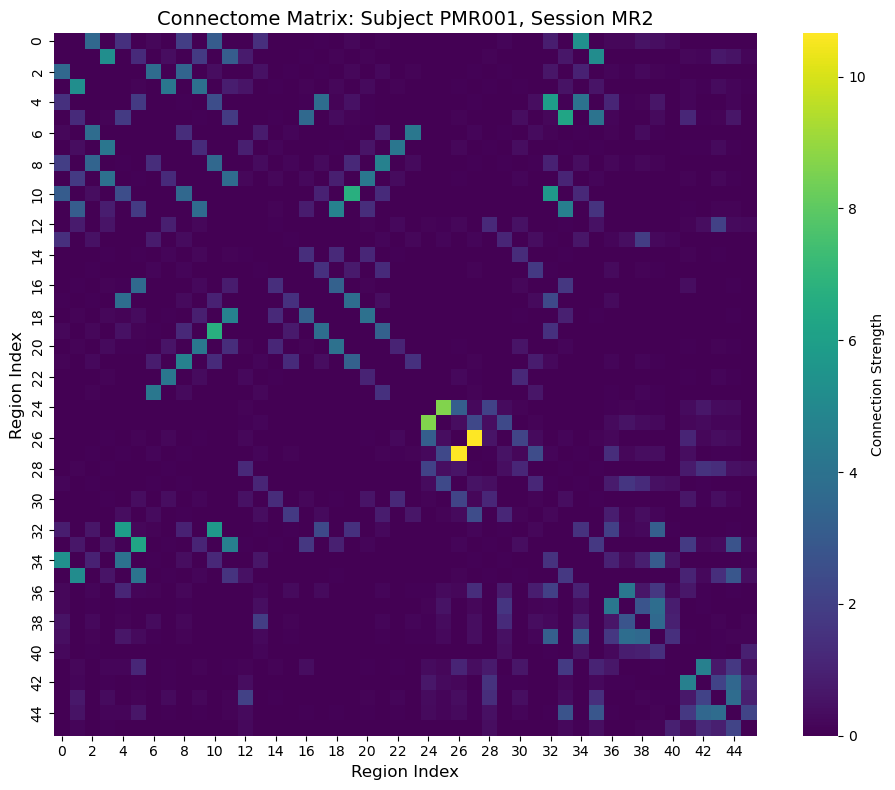

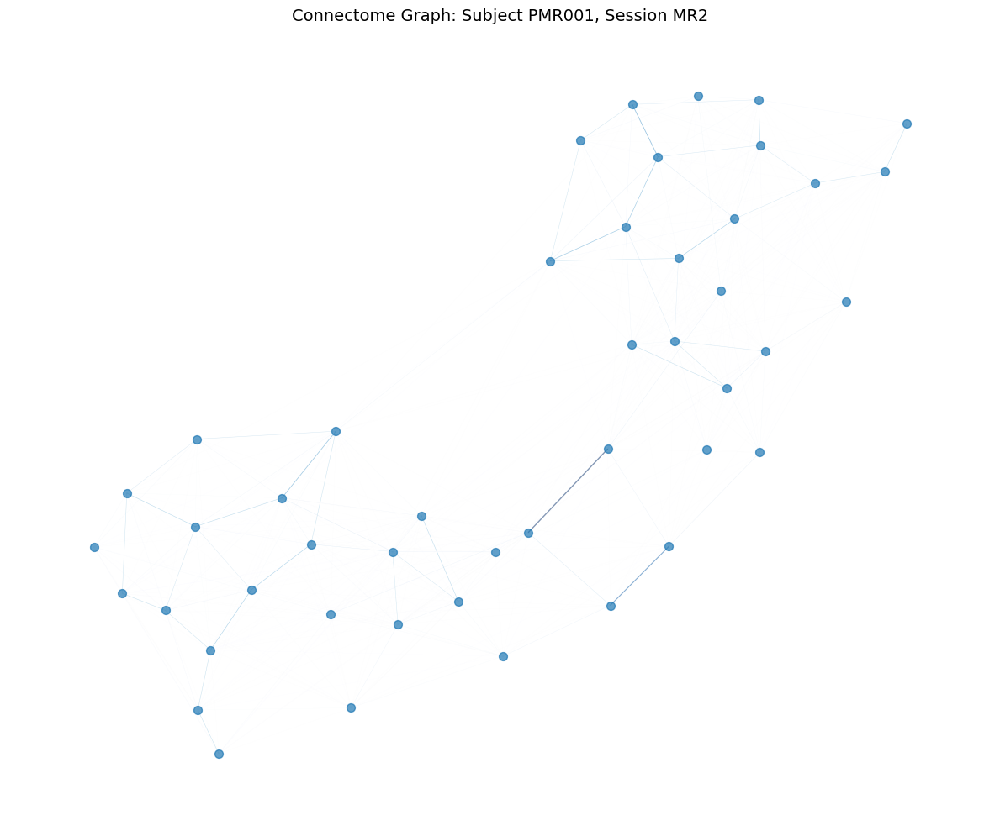

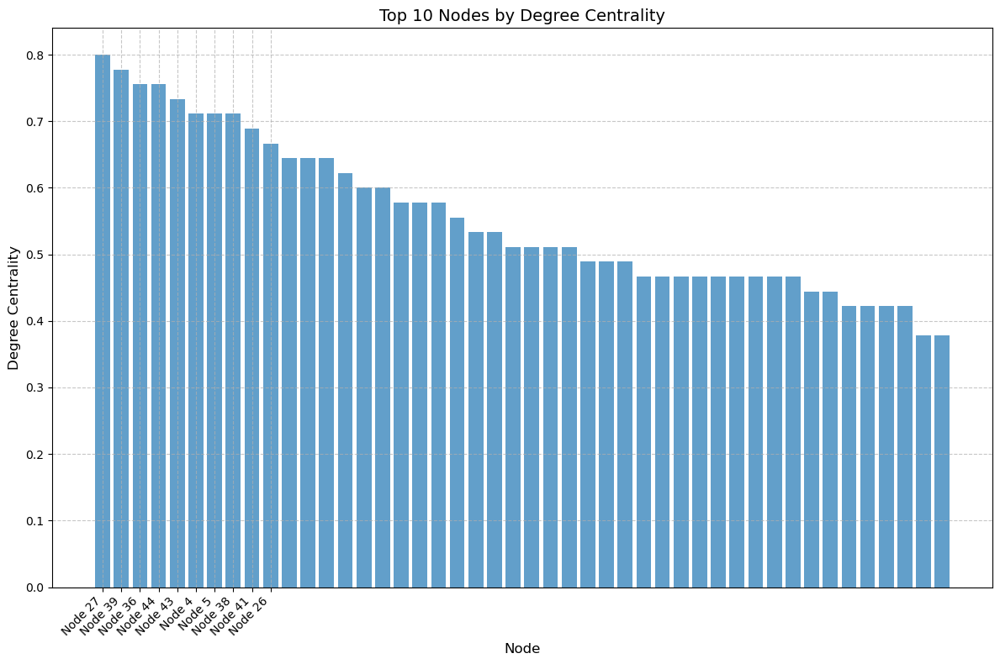

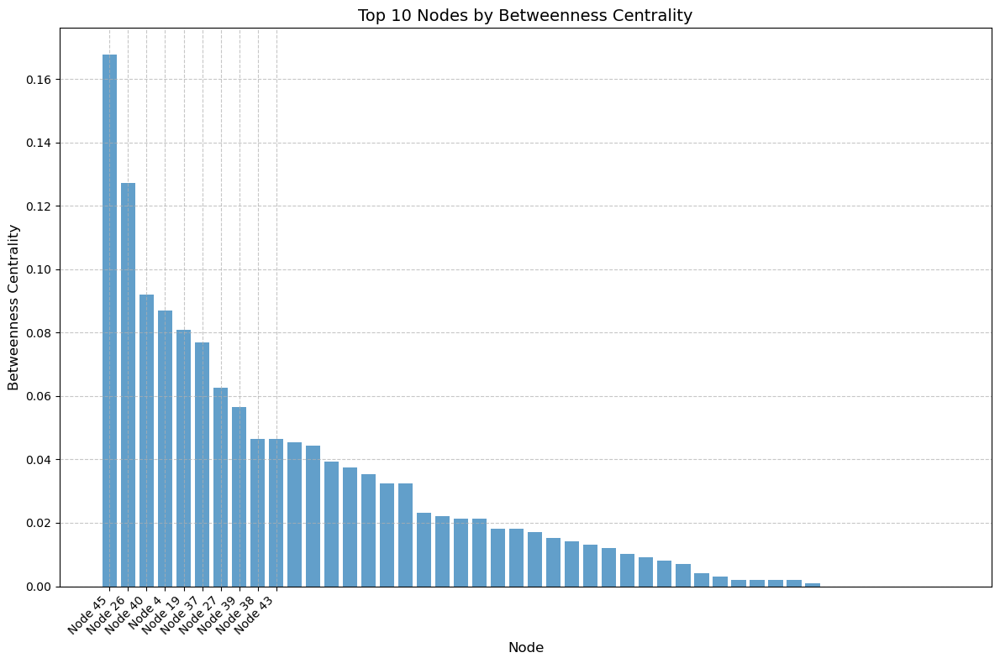

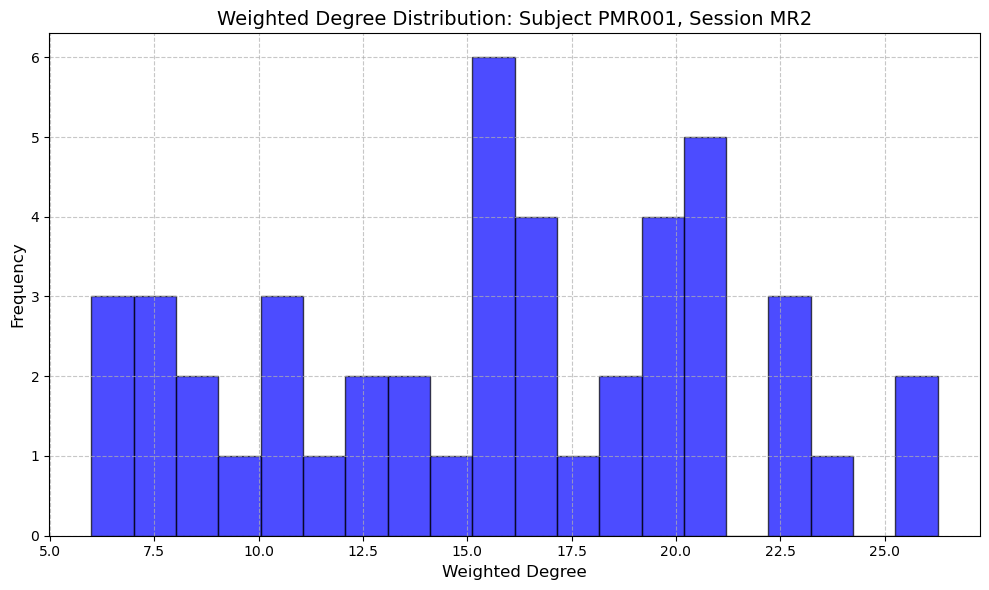

Processing connectome for subject PMR061, session MR2

Visualizations for subject PMR061, session MR2:


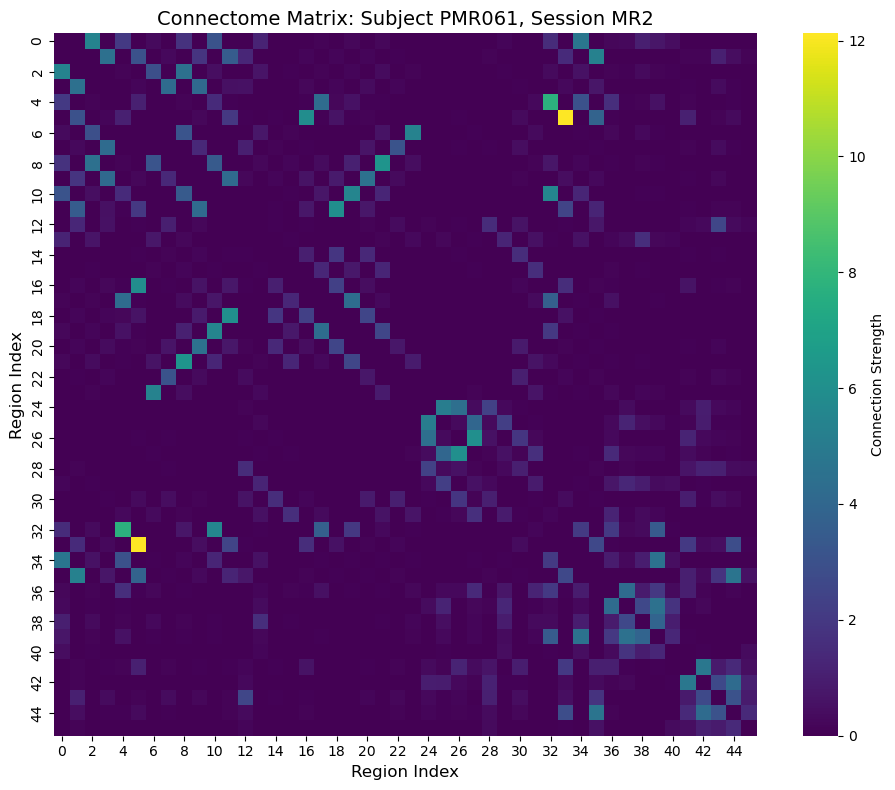

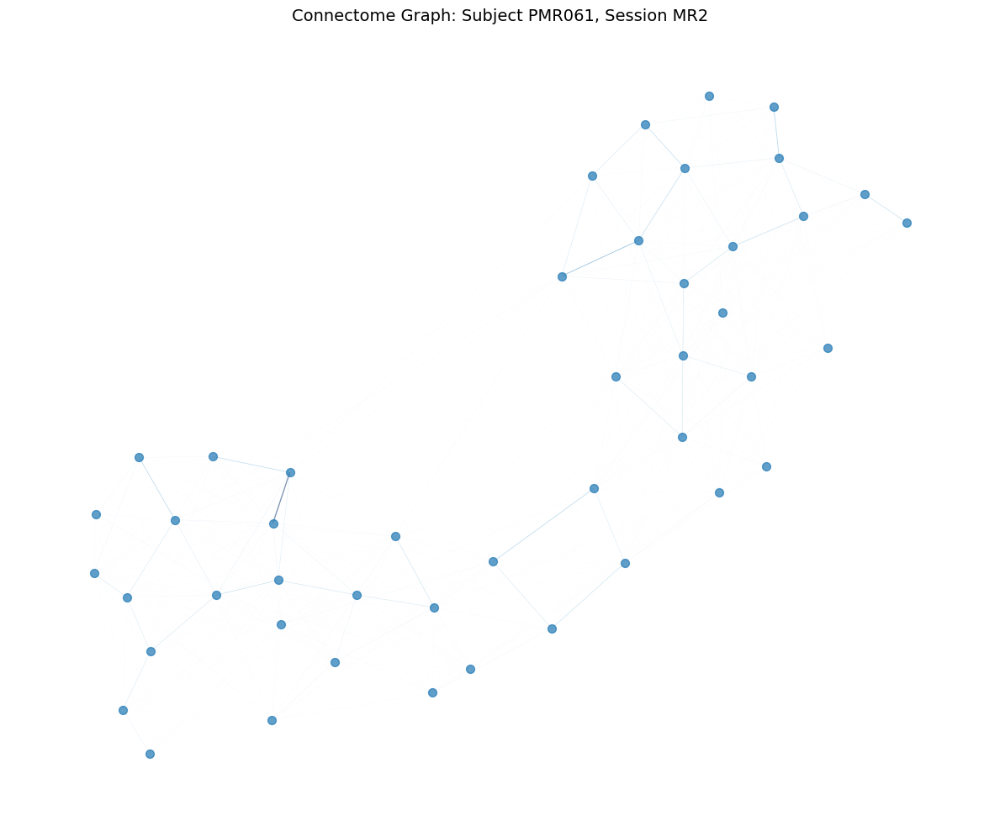

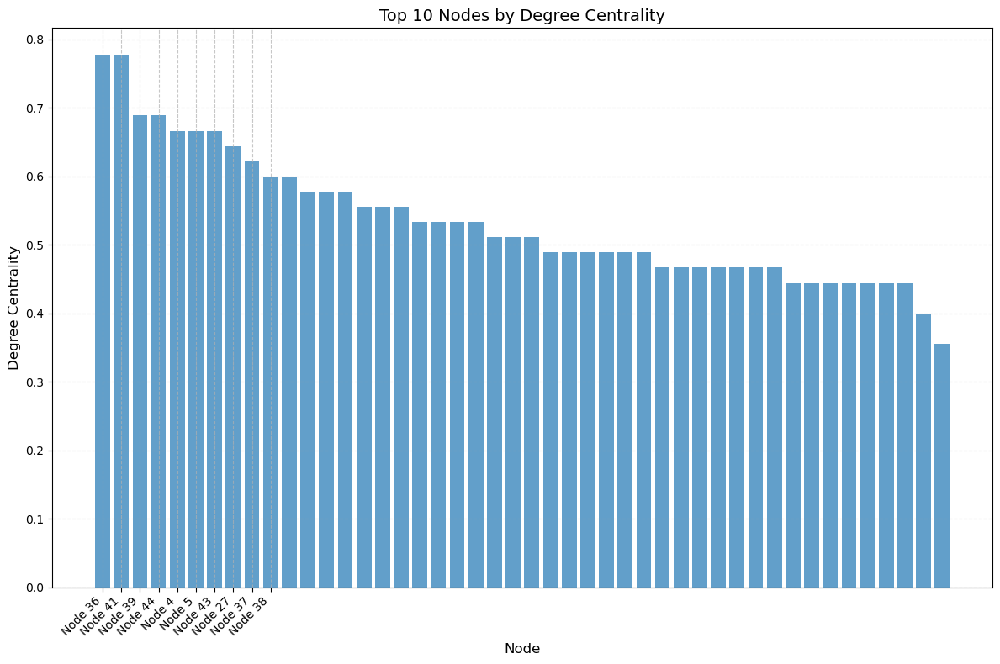

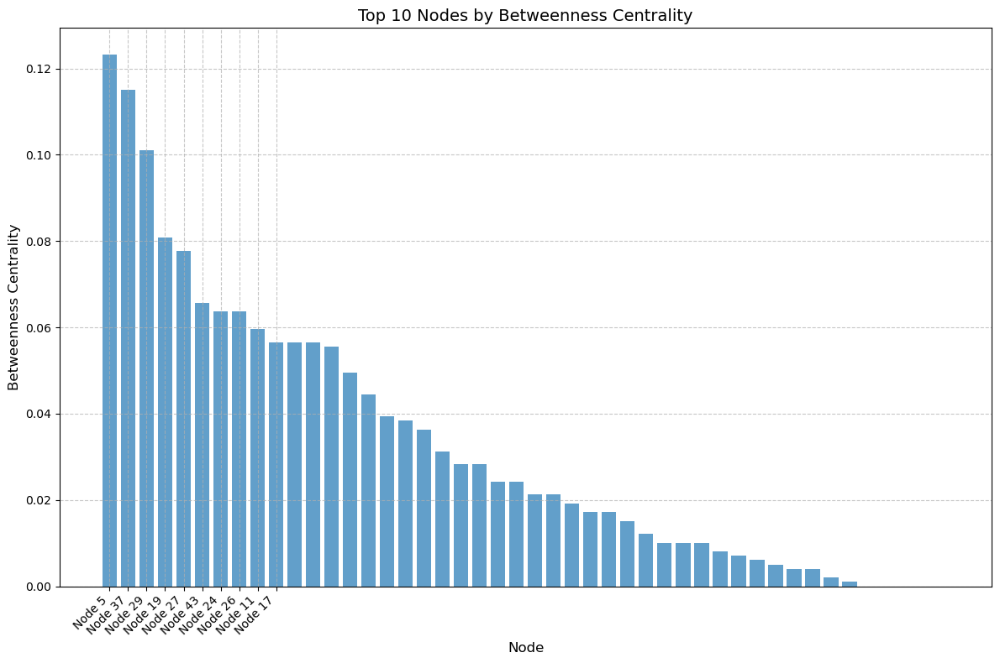

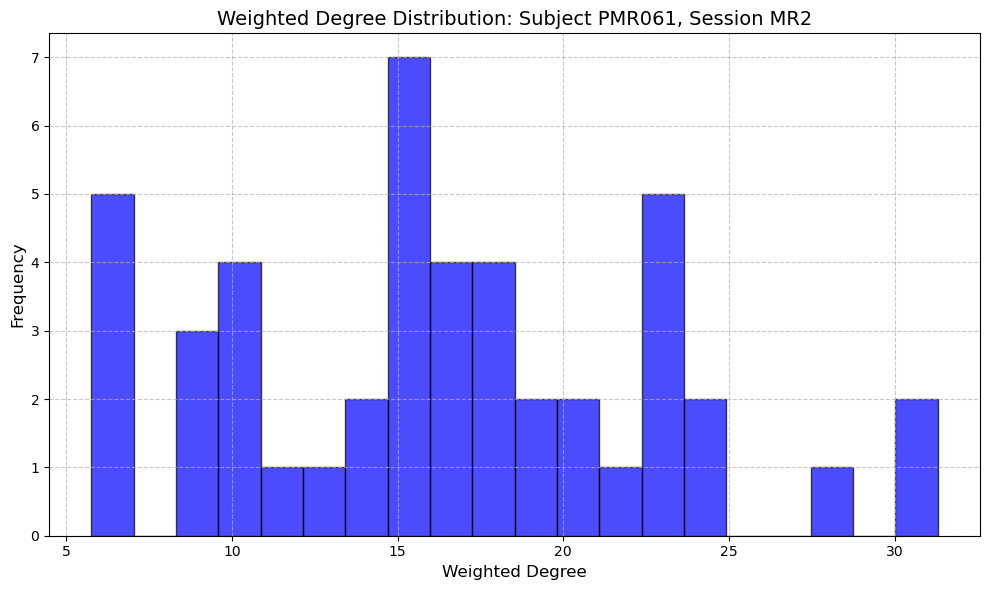

Processing connectome for subject PMR076, session MR2

Visualizations for subject PMR076, session MR2:


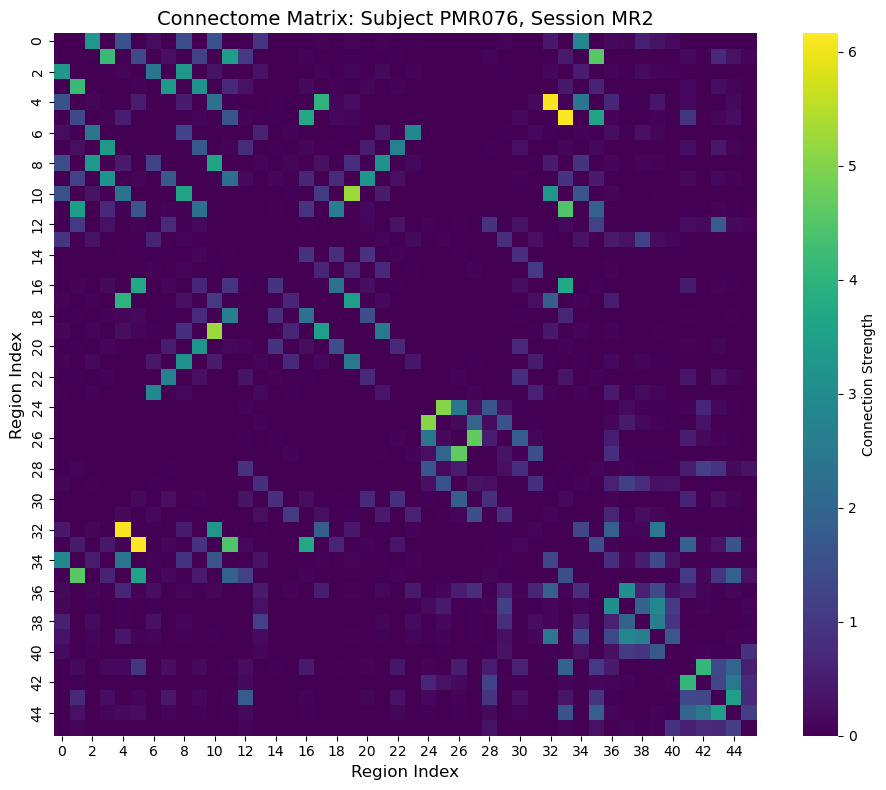

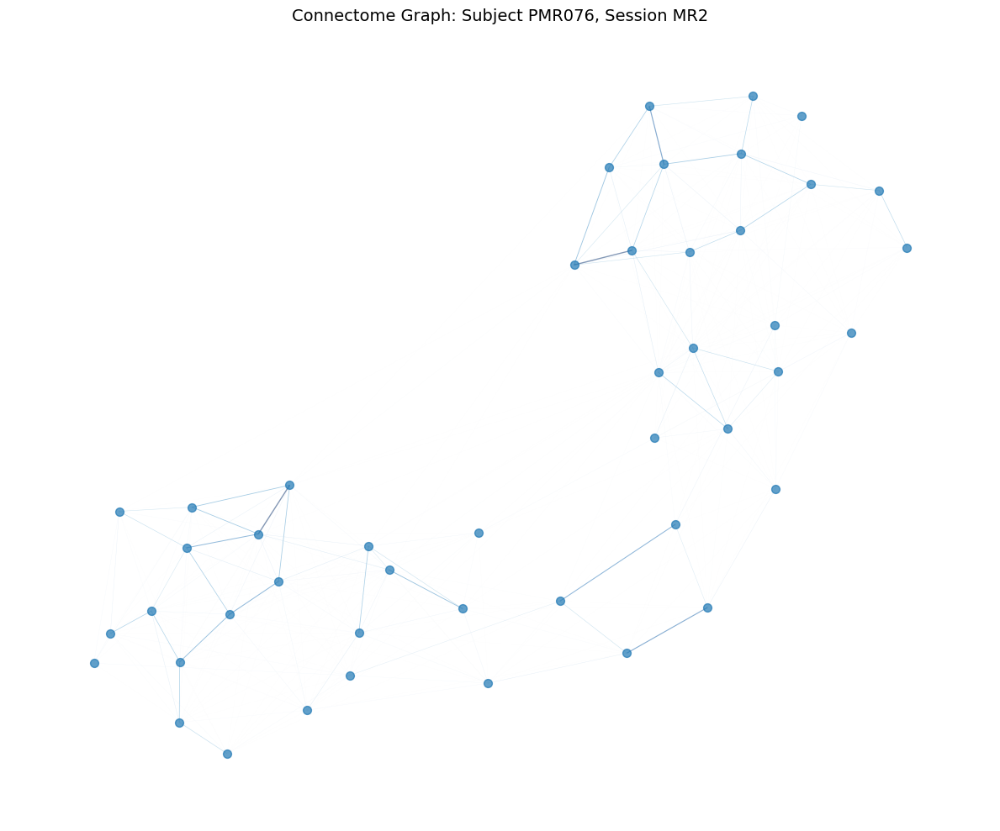

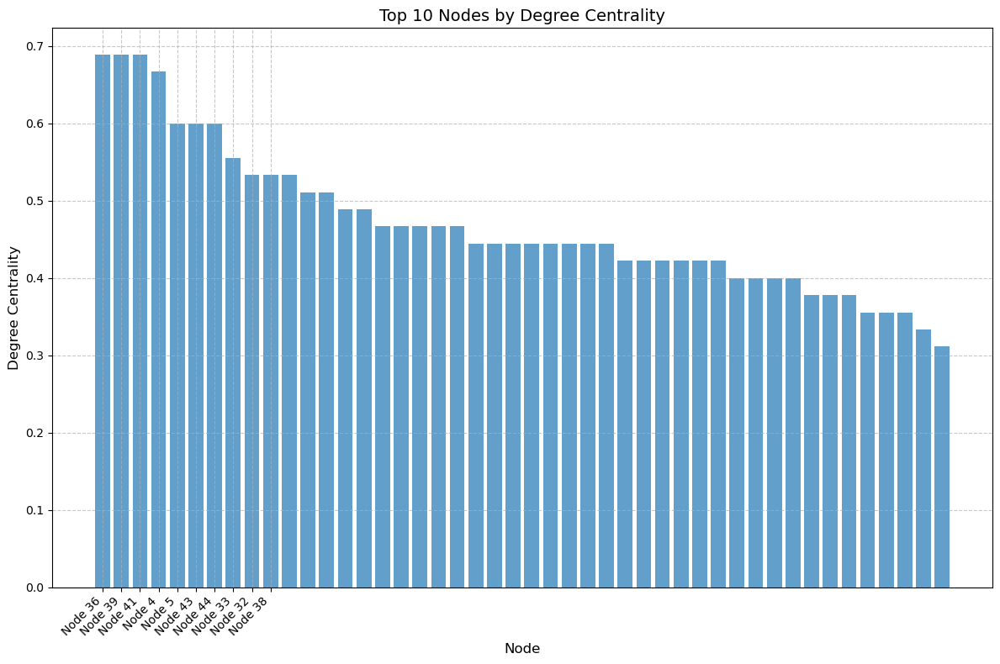

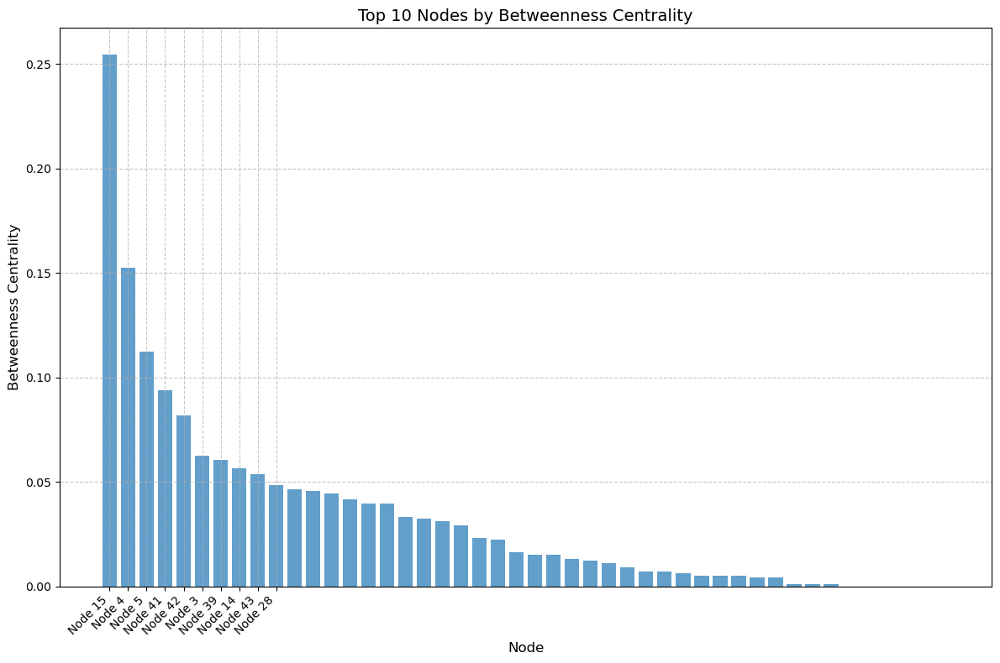

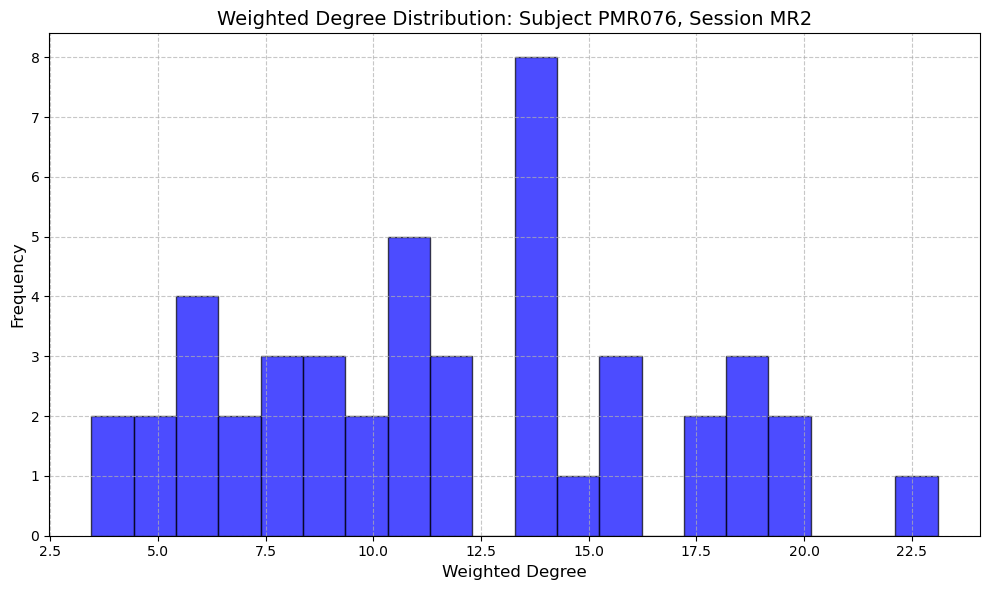

Processing connectome for subject PMR027, session MR2

Visualizations for subject PMR027, session MR2:


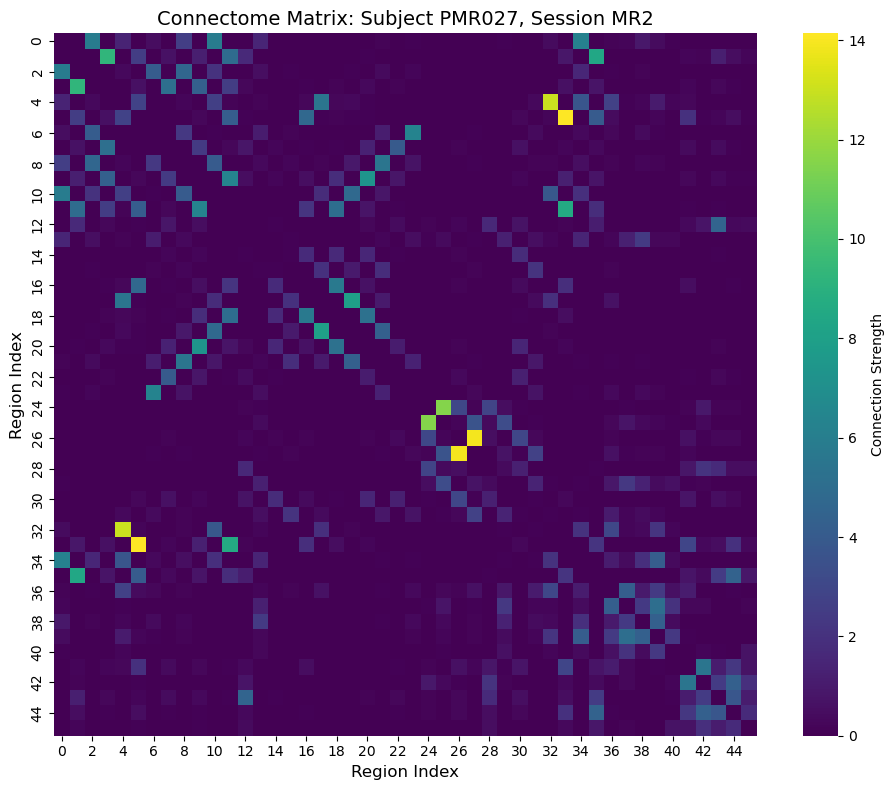

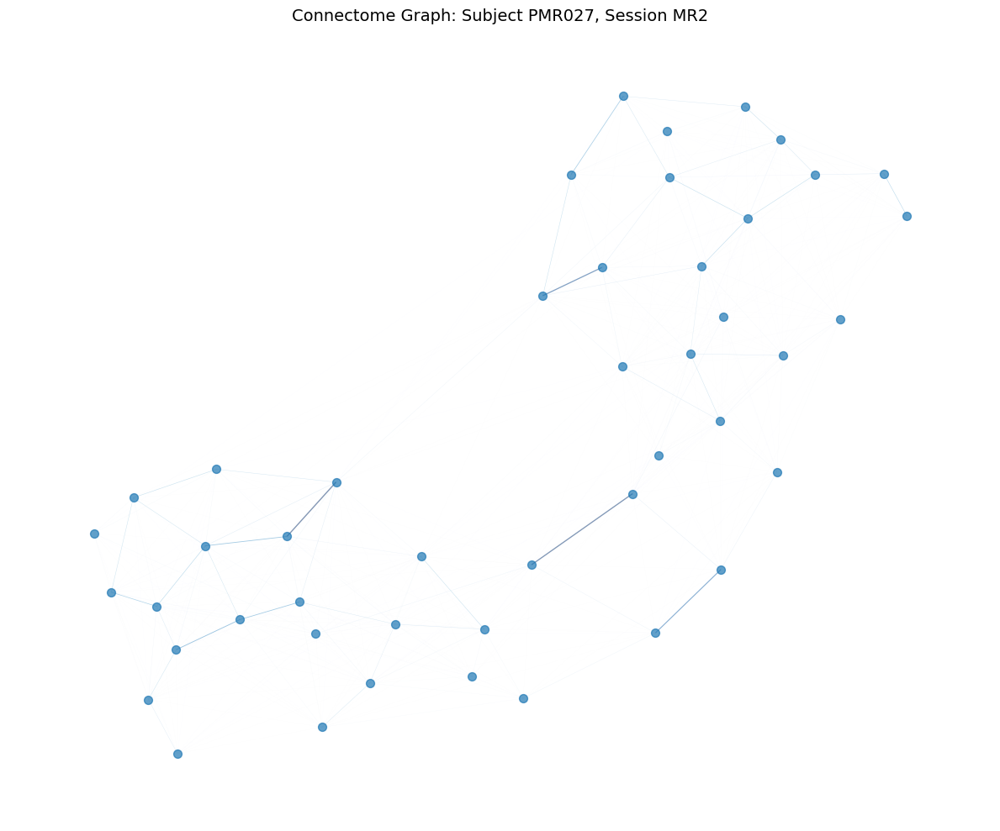

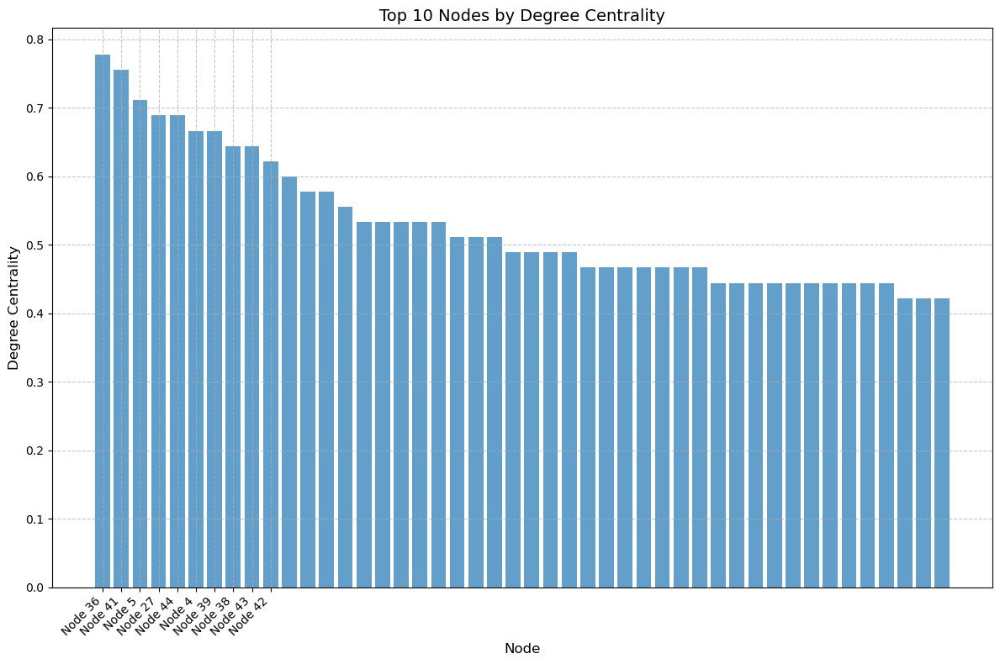

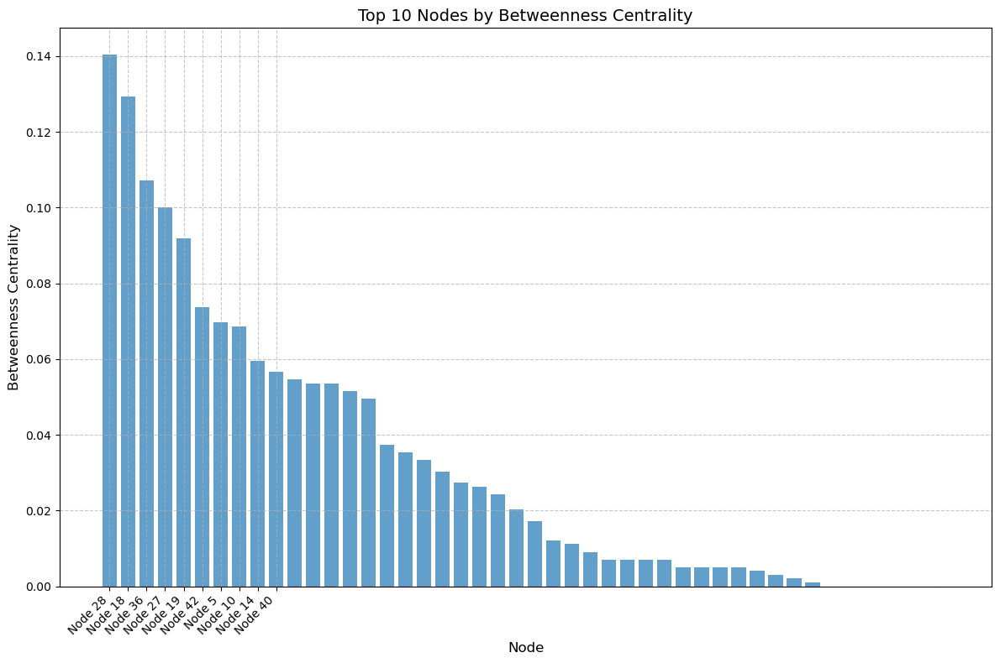

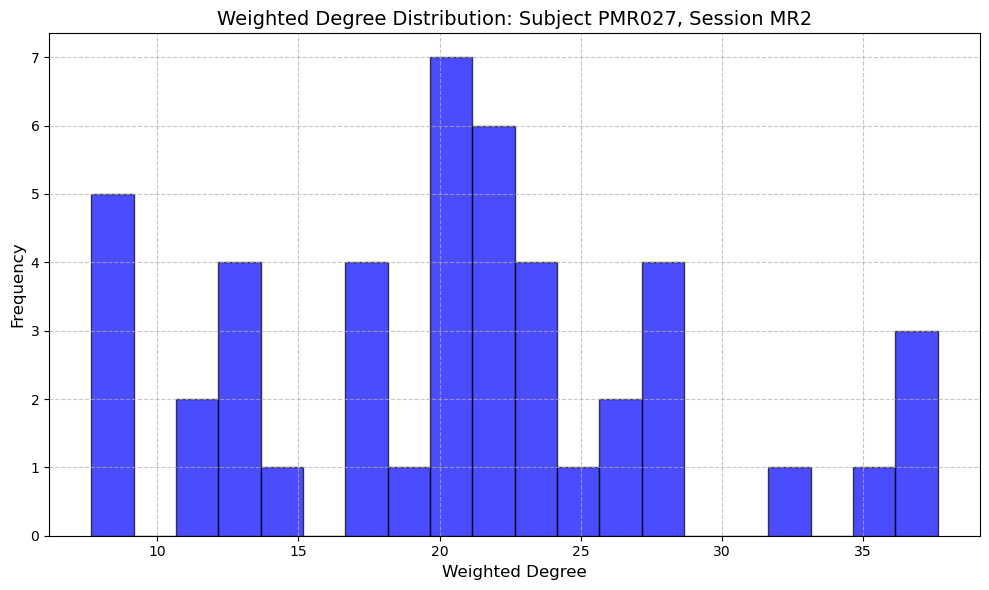

Processing connectome for subject PMR028, session MR2

Visualizations for subject PMR028, session MR2:


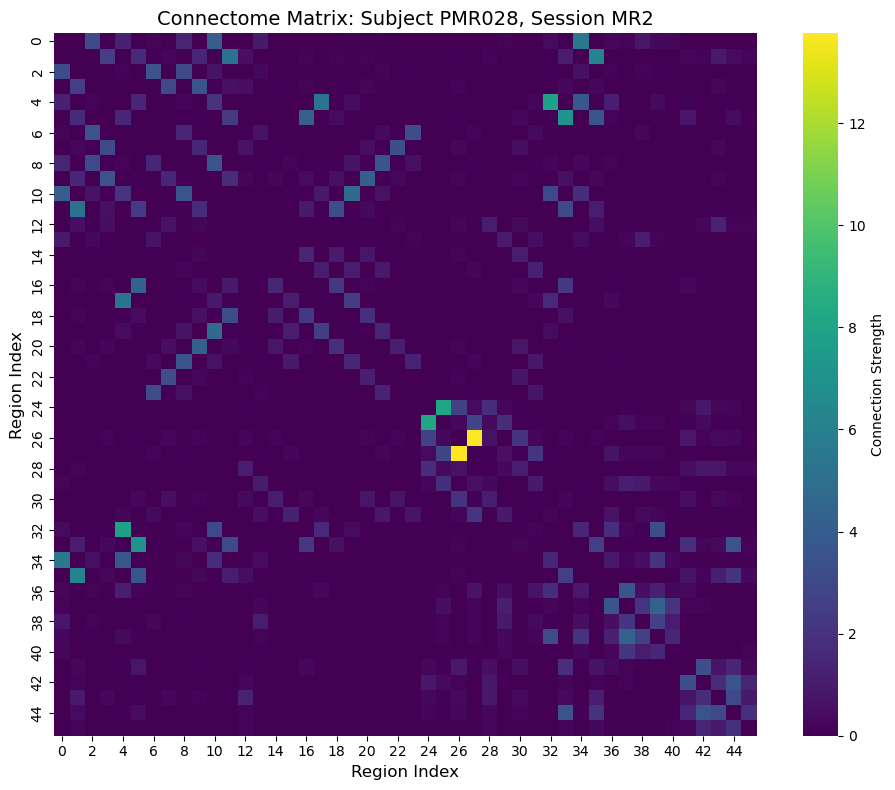

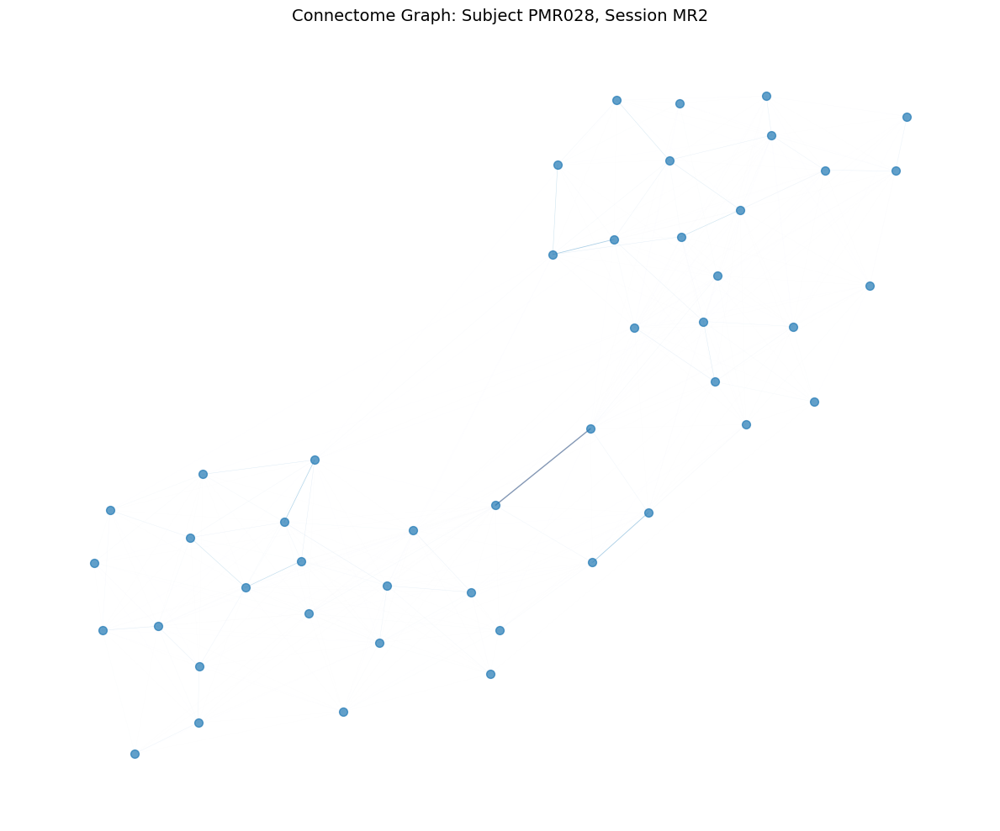

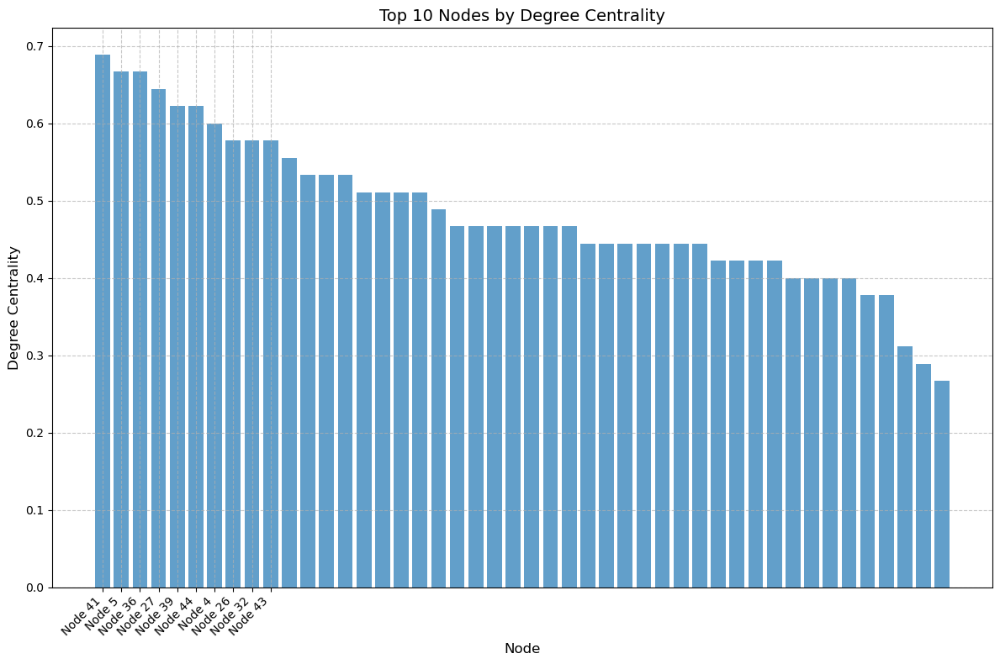

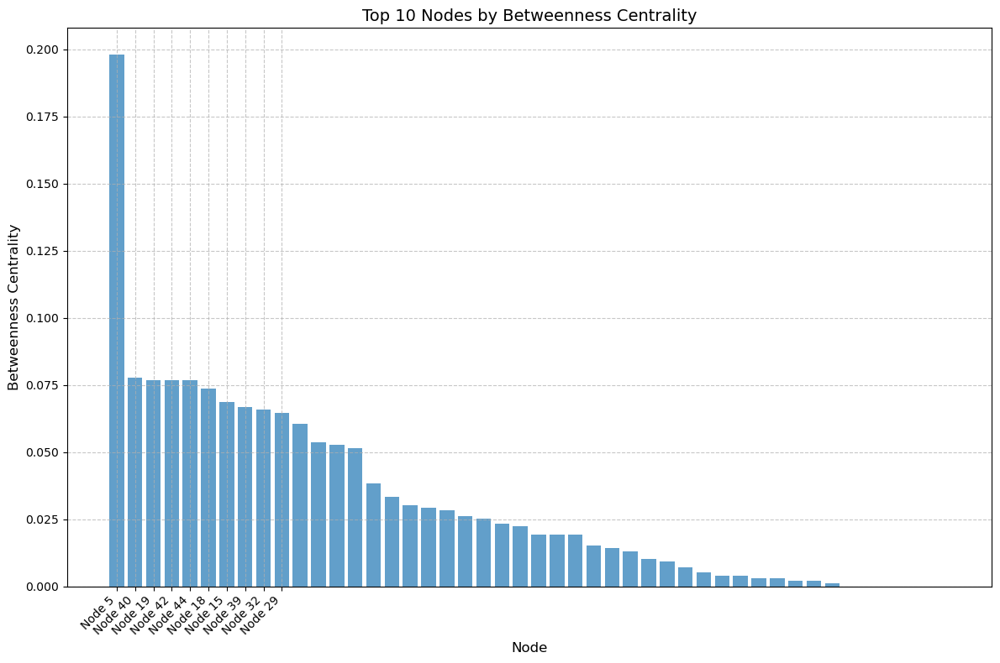

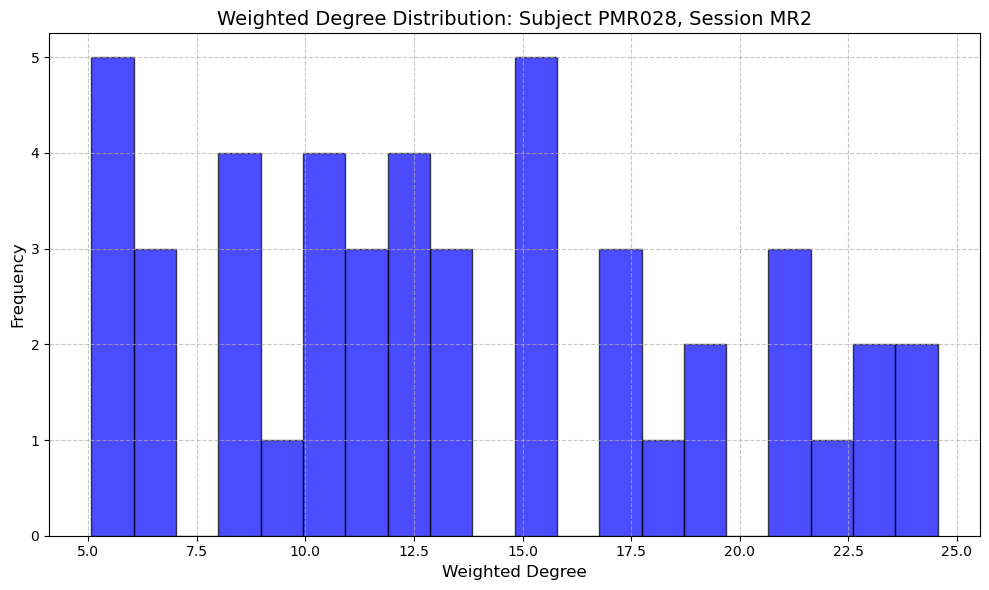

Processing connectome for subject PMR030, session MR2

Visualizations for subject PMR030, session MR2:


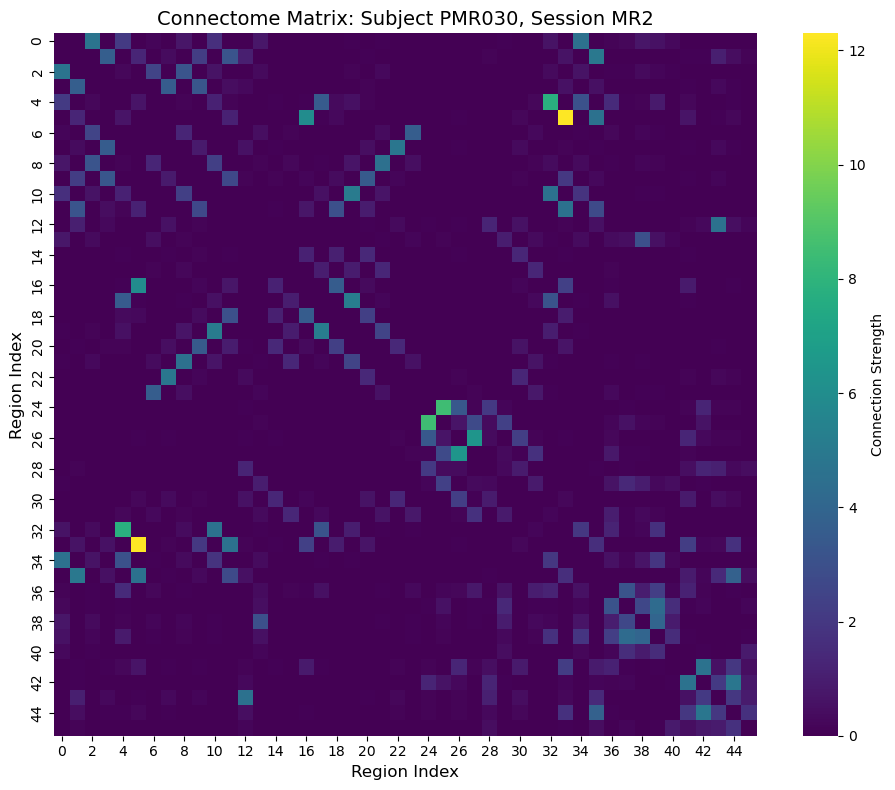

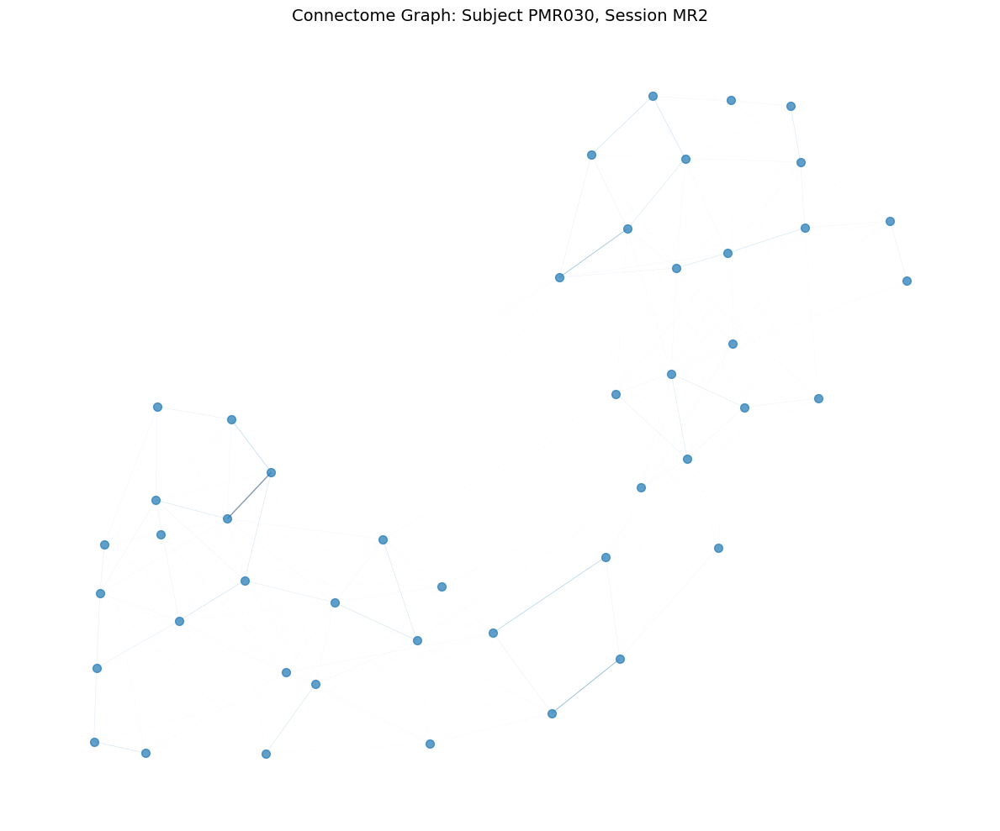

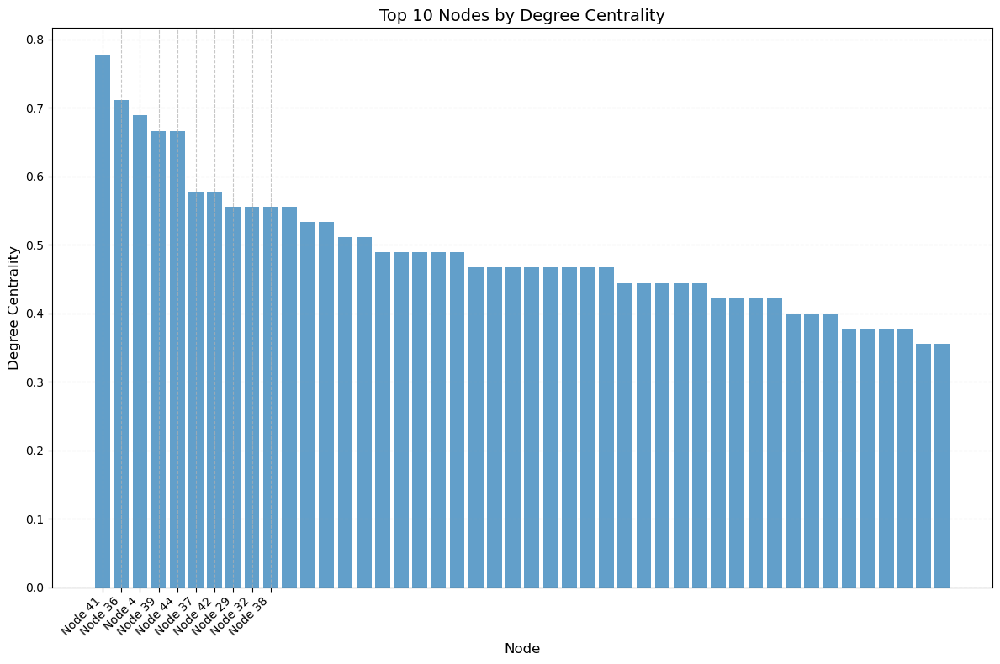

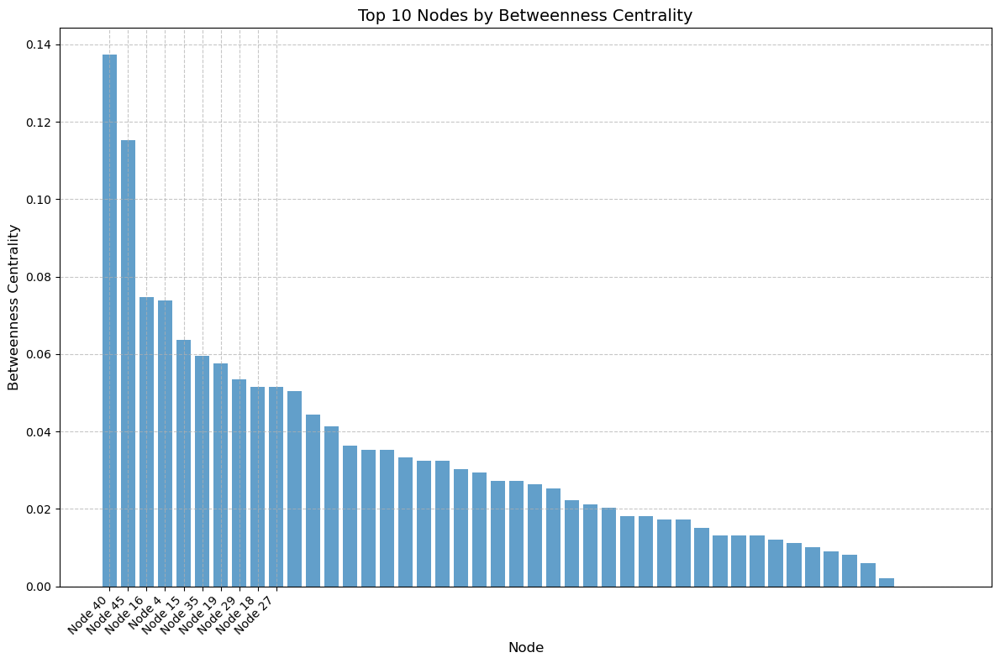

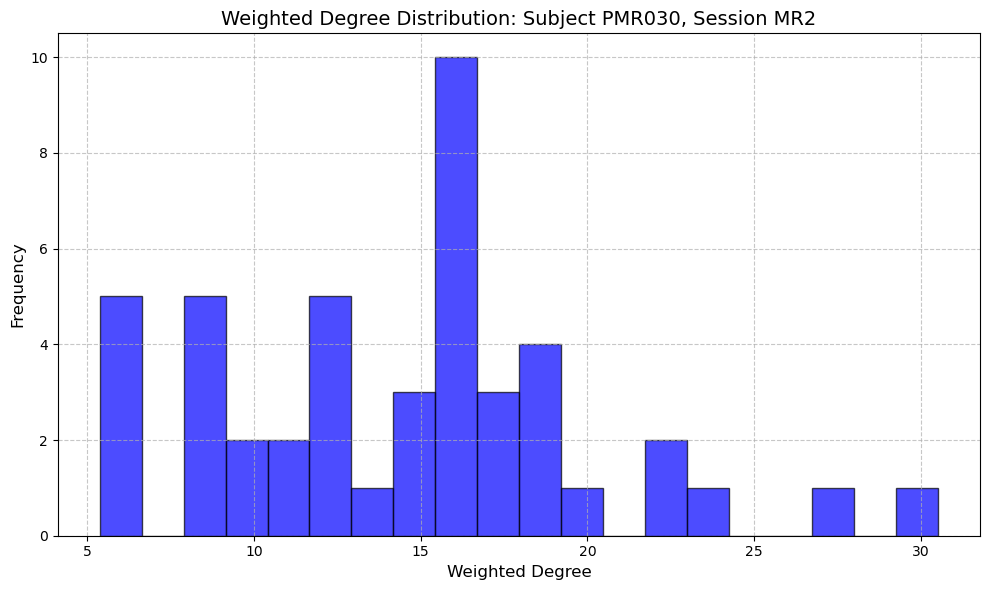

Processing connectome for subject PMR097, session MR2

Visualizations for subject PMR097, session MR2:


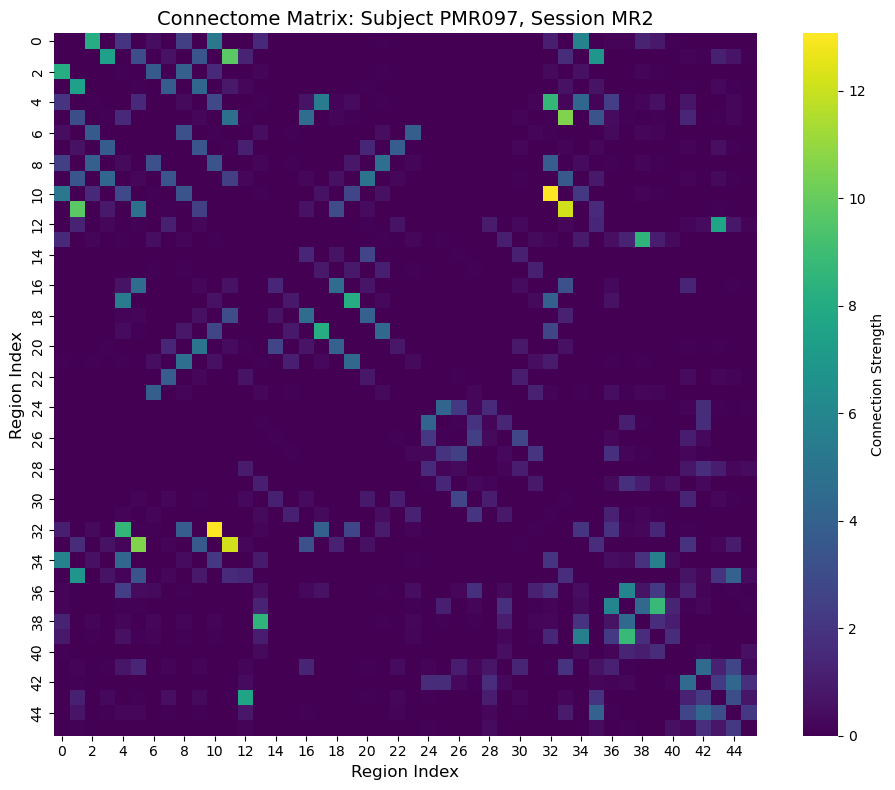

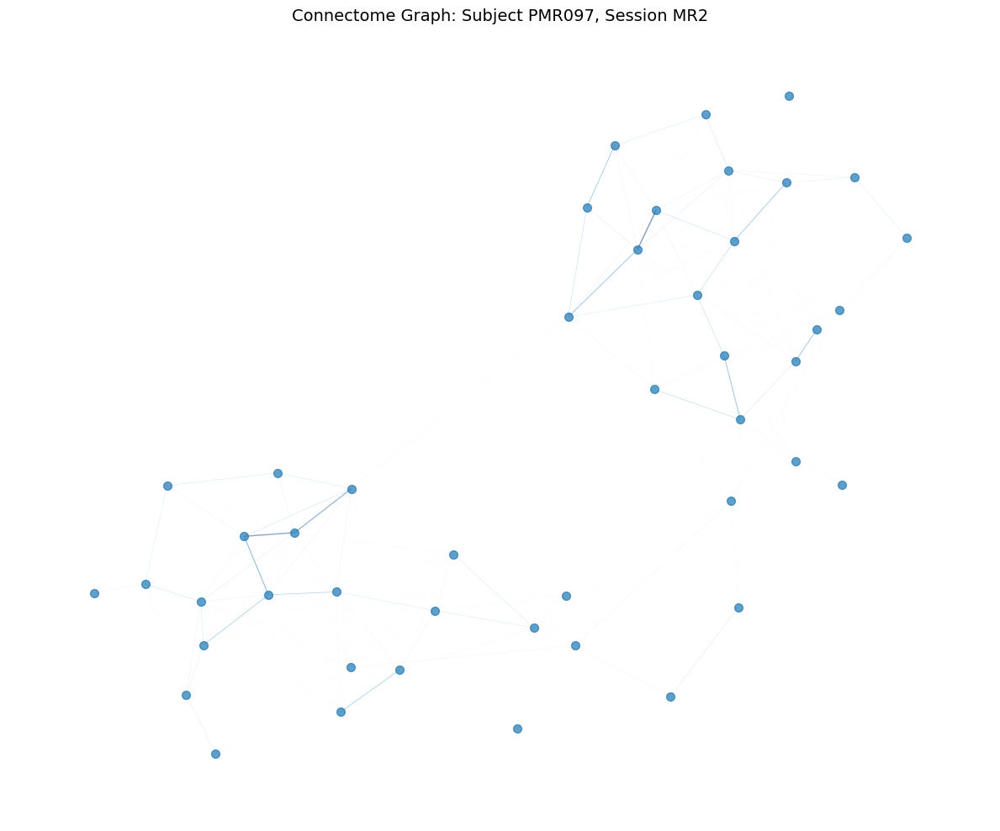

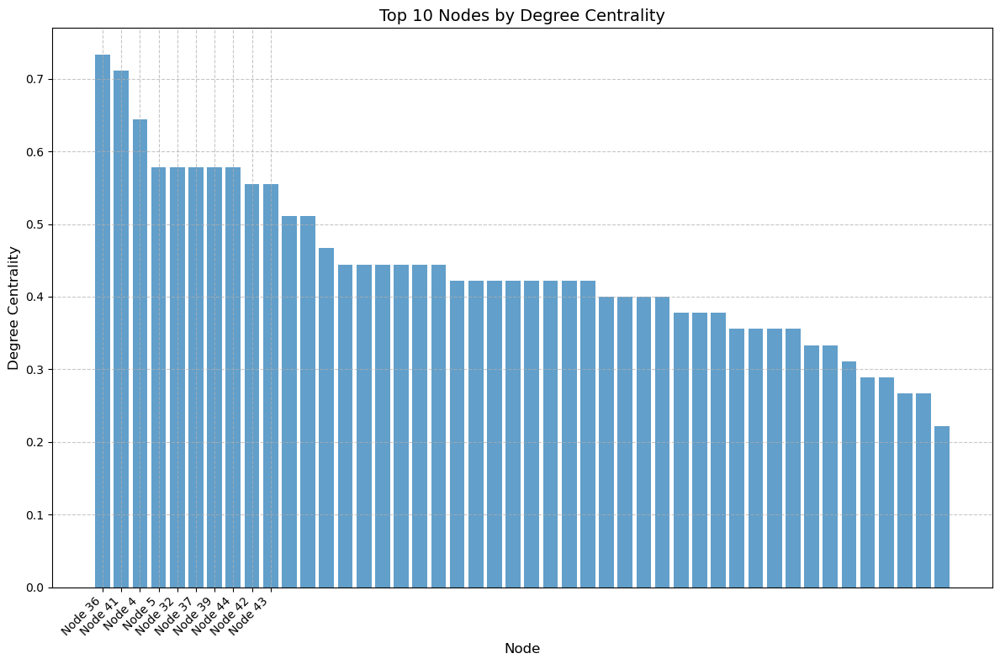

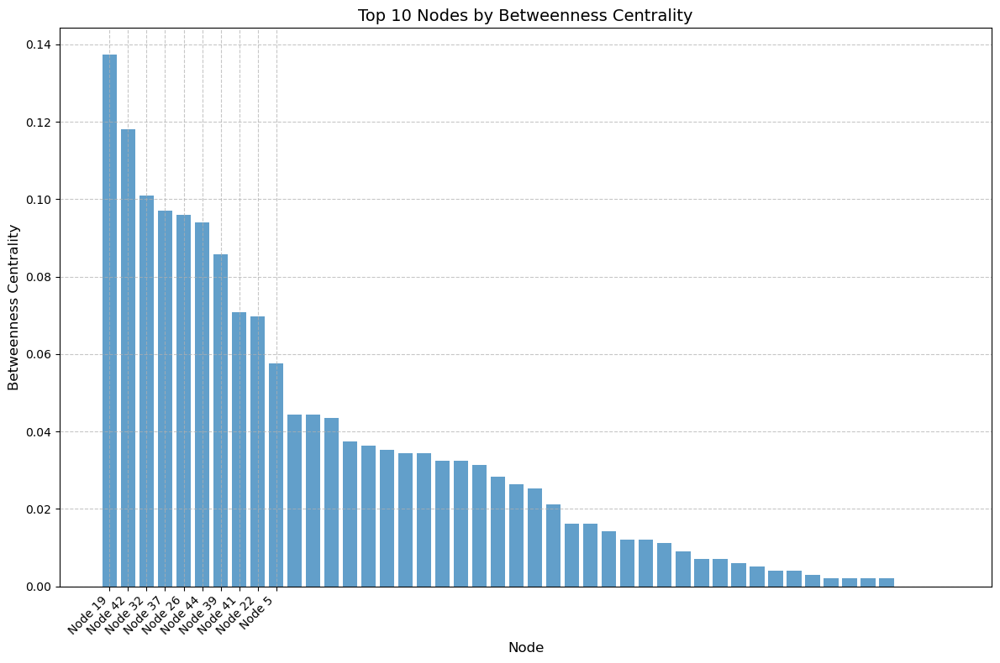

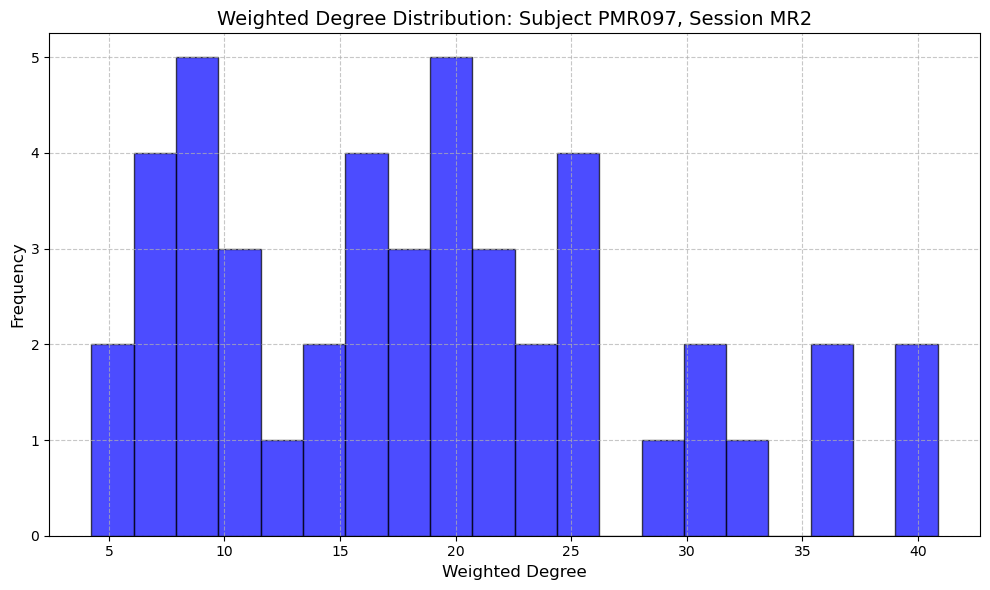

Processing connectome for subject PMR046, session MR2

Visualizations for subject PMR046, session MR2:


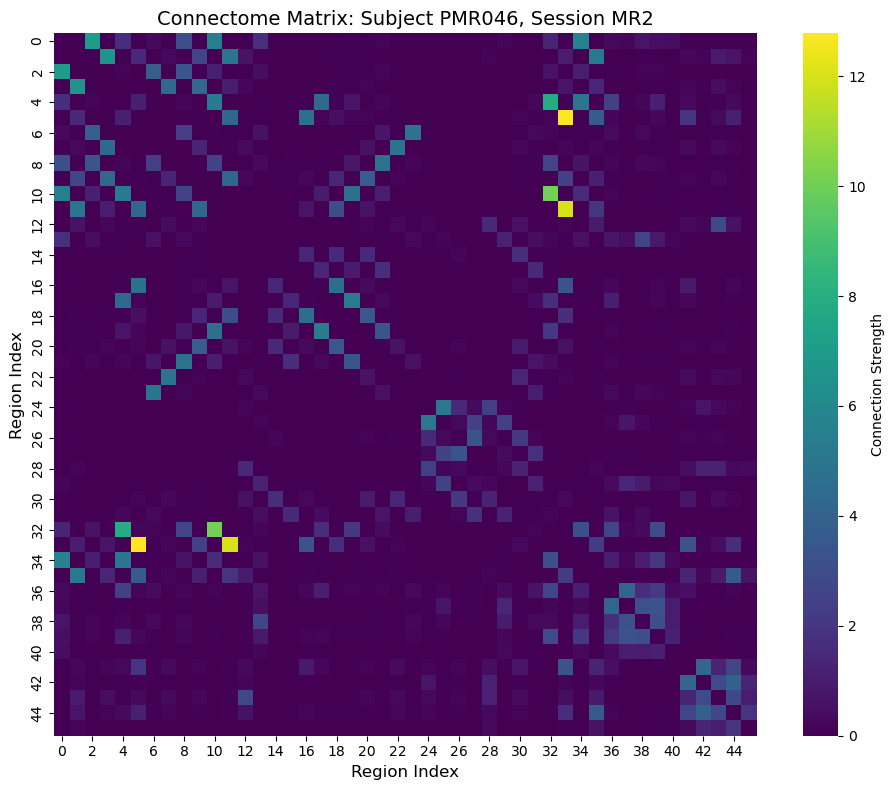

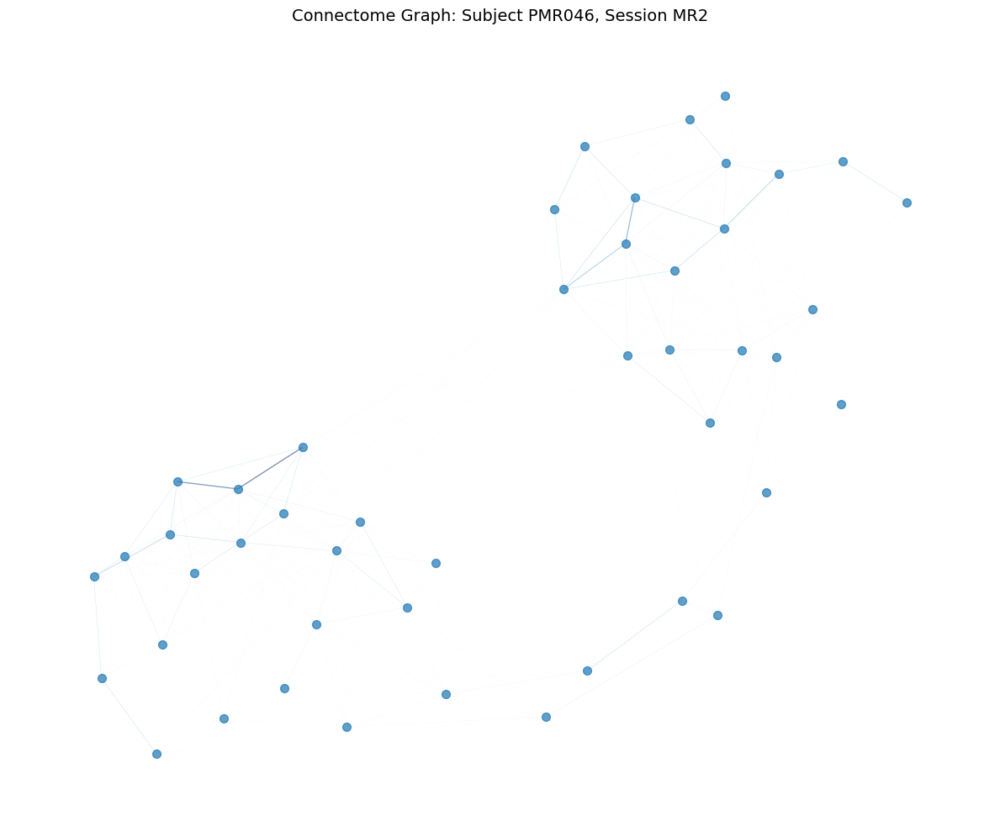

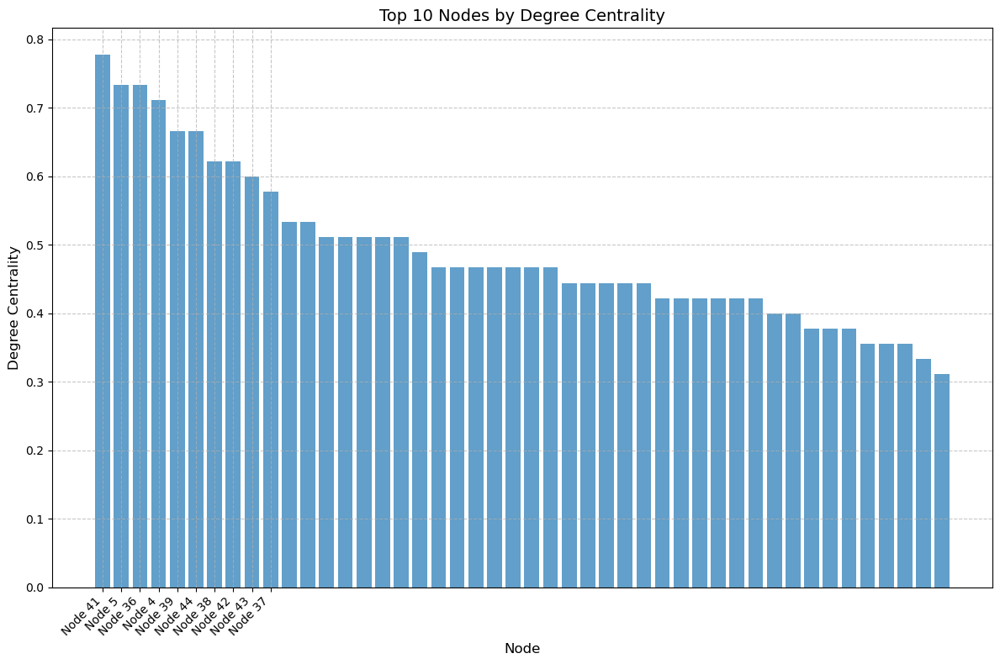

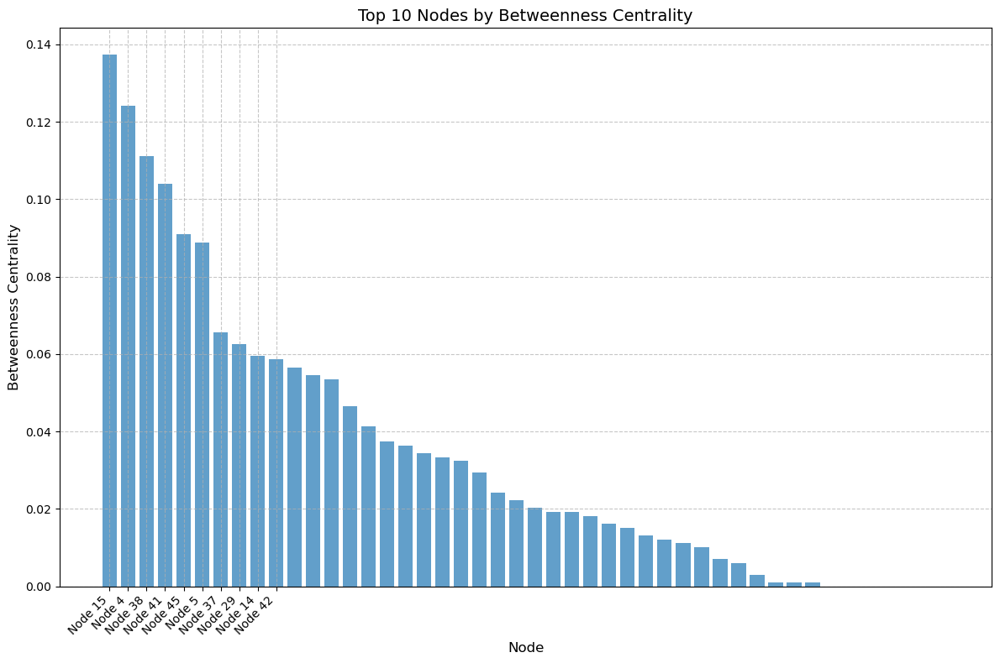

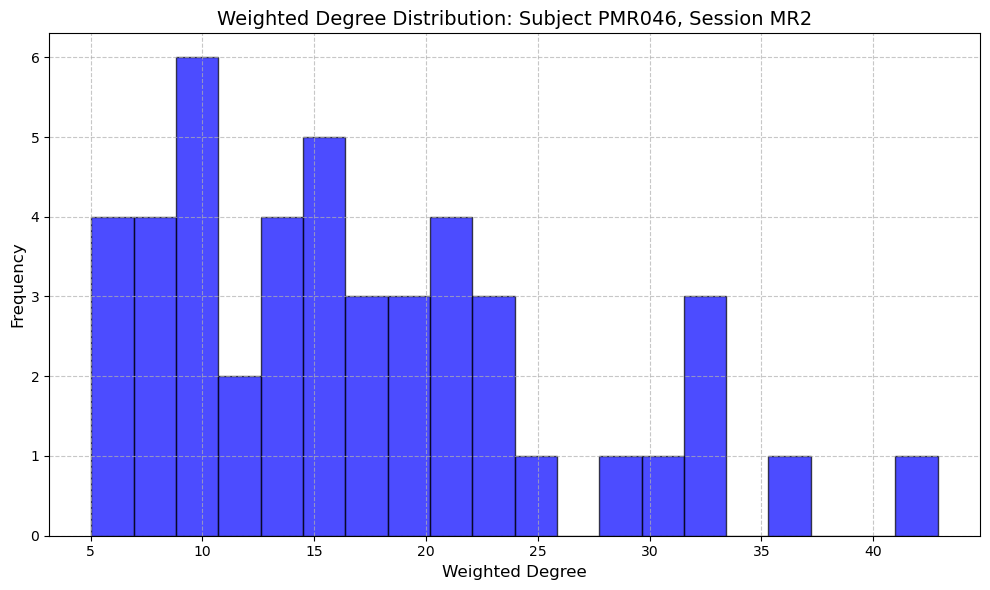

Processing connectome for subject PMR045, session MR2

Visualizations for subject PMR045, session MR2:


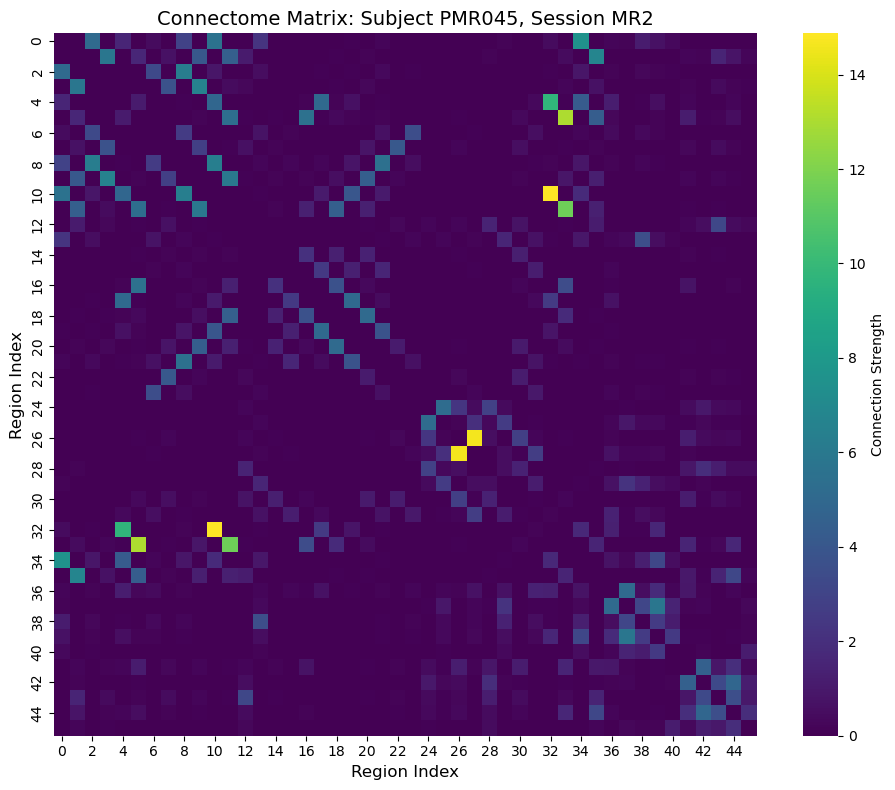

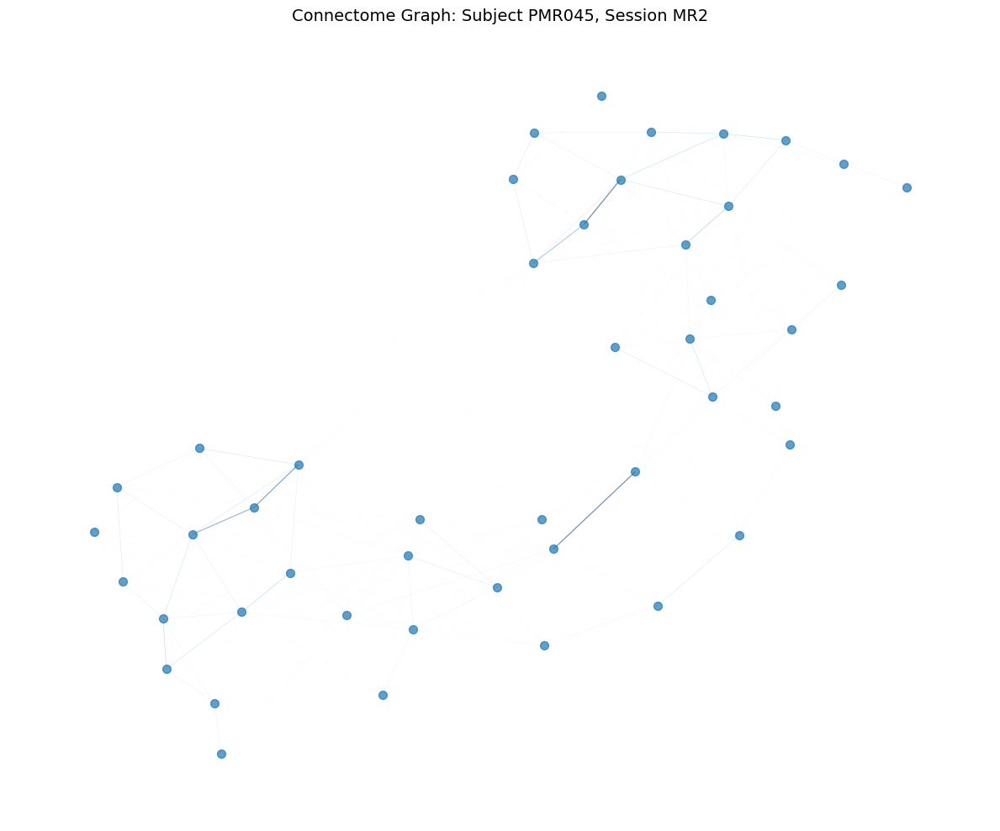

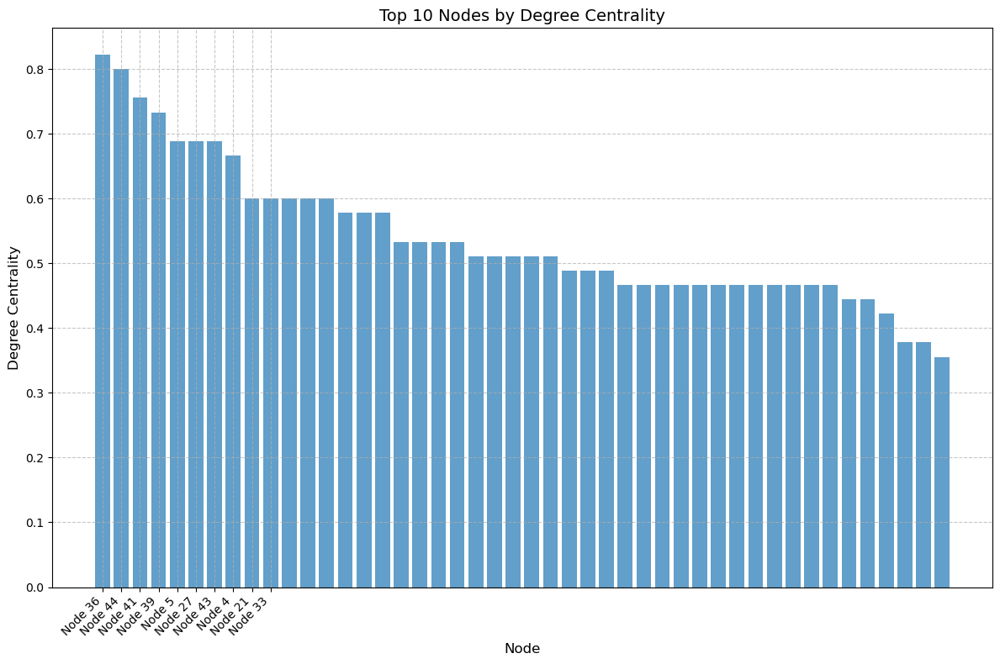

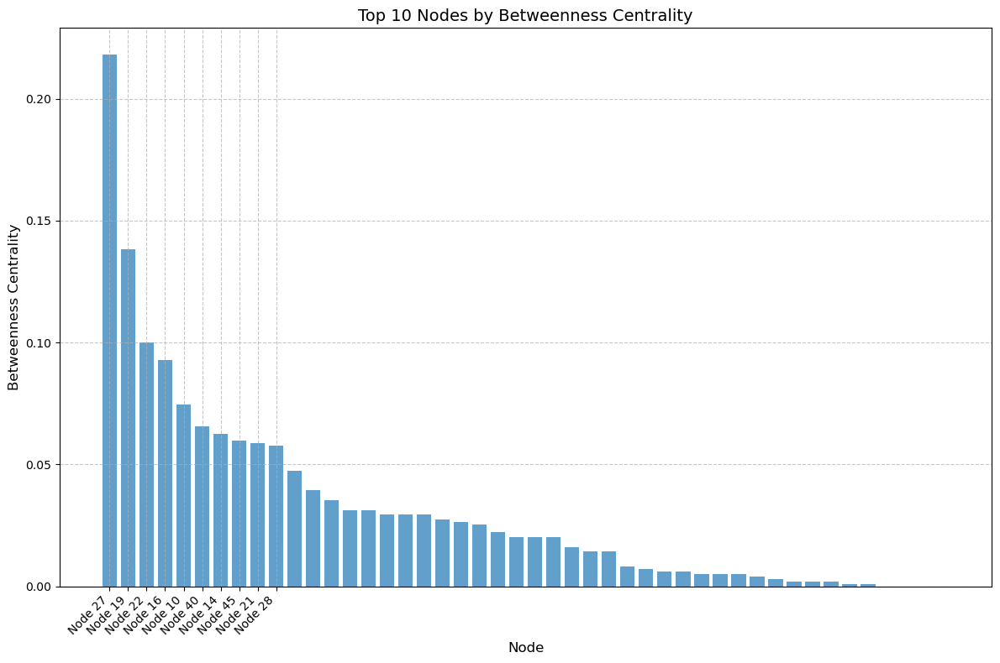

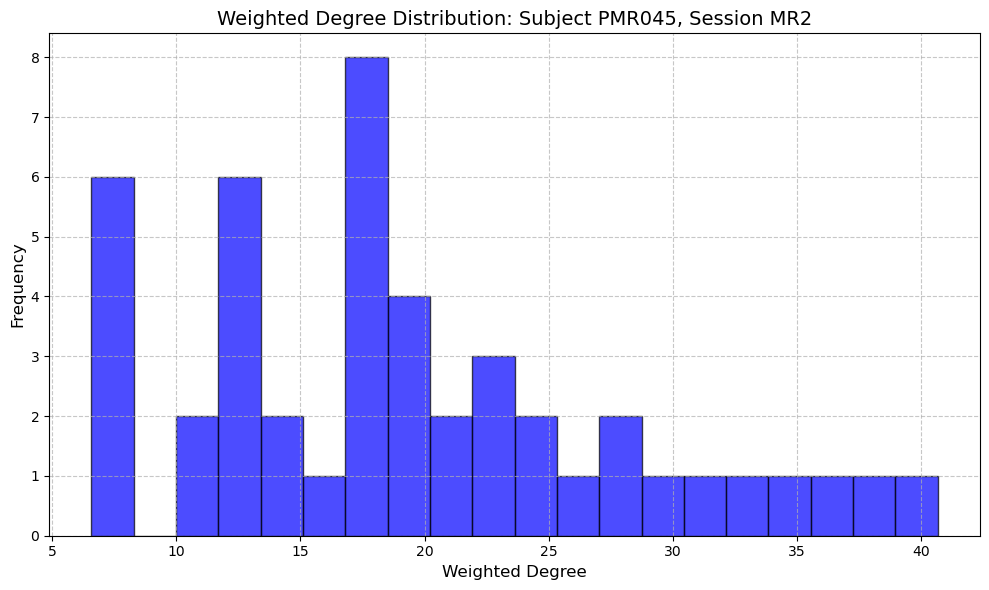

Processing connectome for subject PMR086, session MR2

Visualizations for subject PMR086, session MR2:


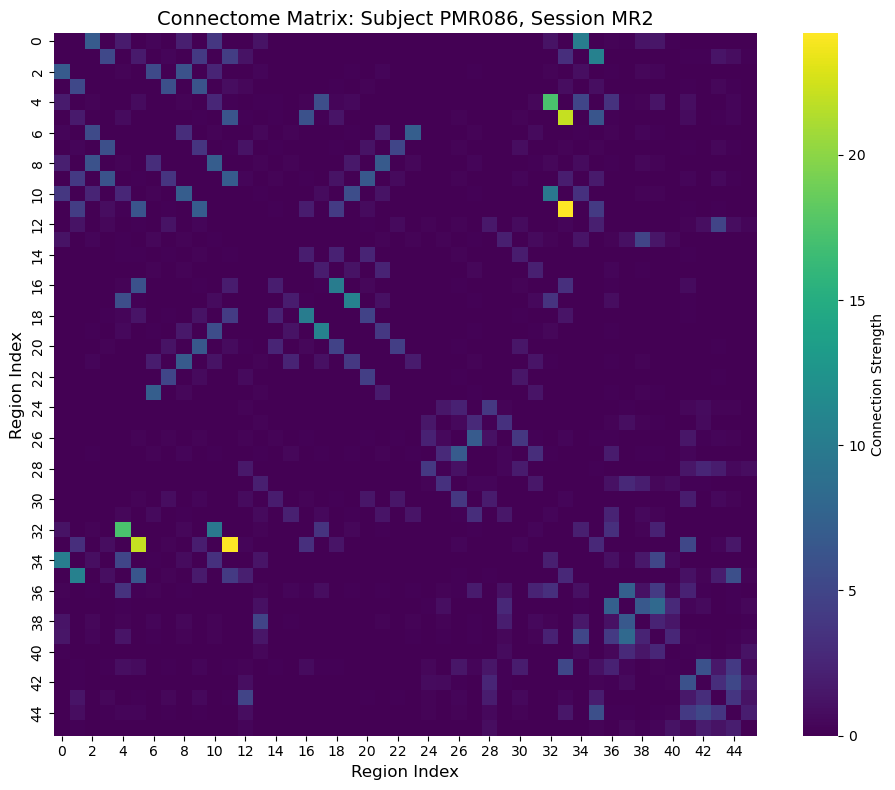

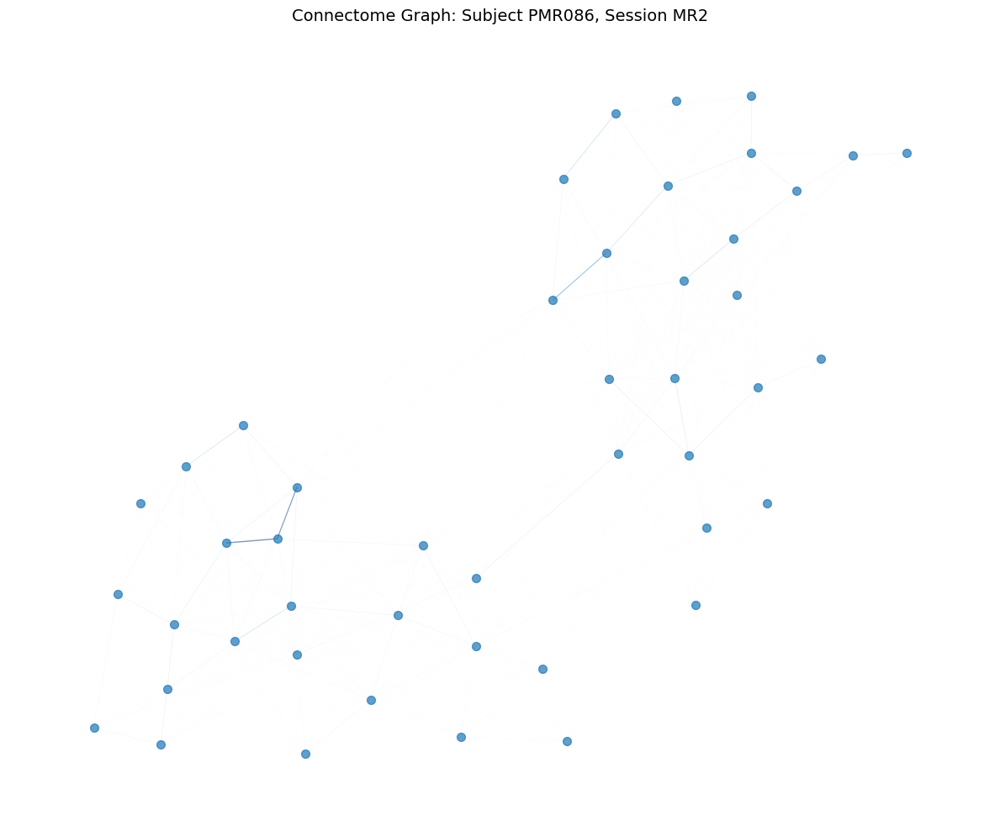

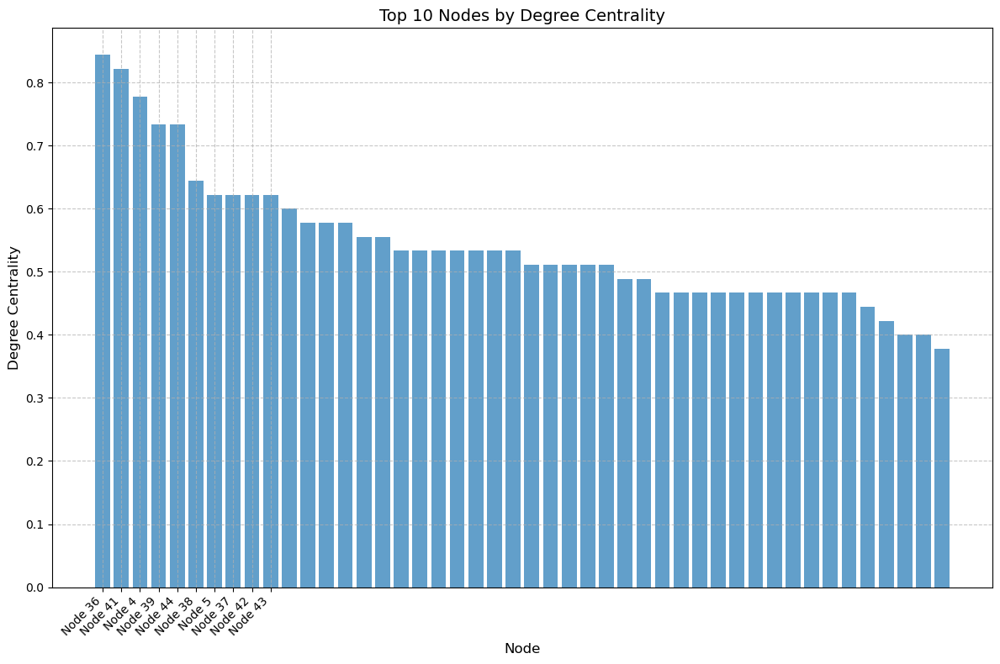

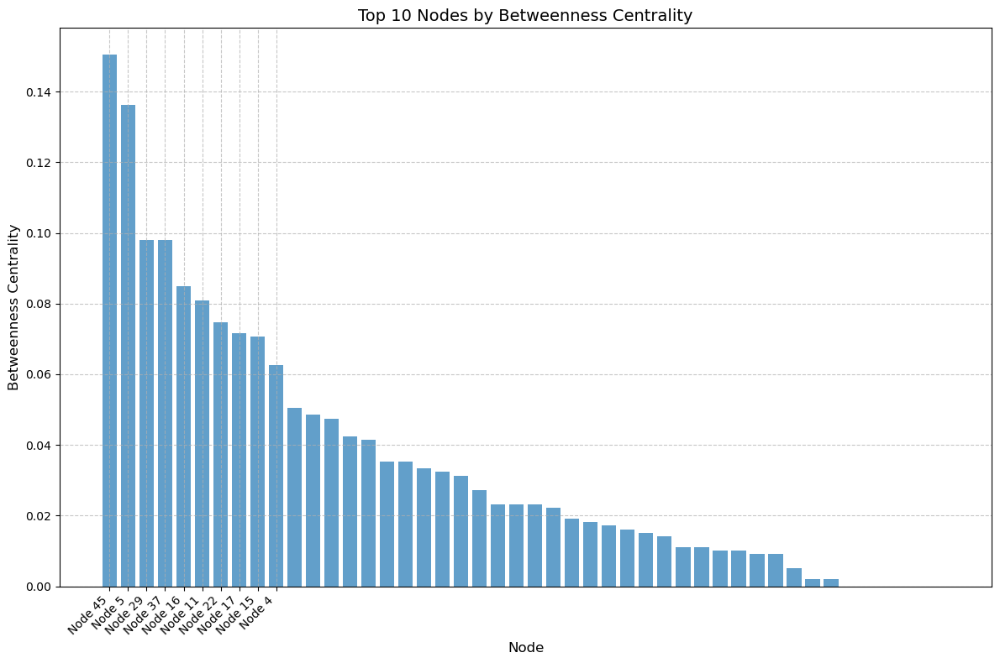

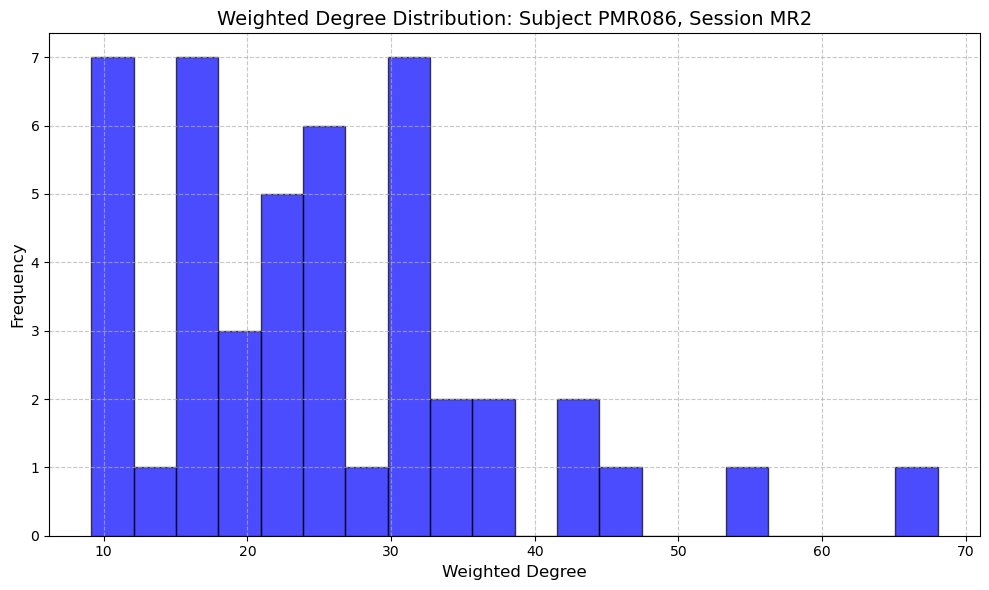

Processing connectome for subject PMR092, session MR2

Visualizations for subject PMR092, session MR2:


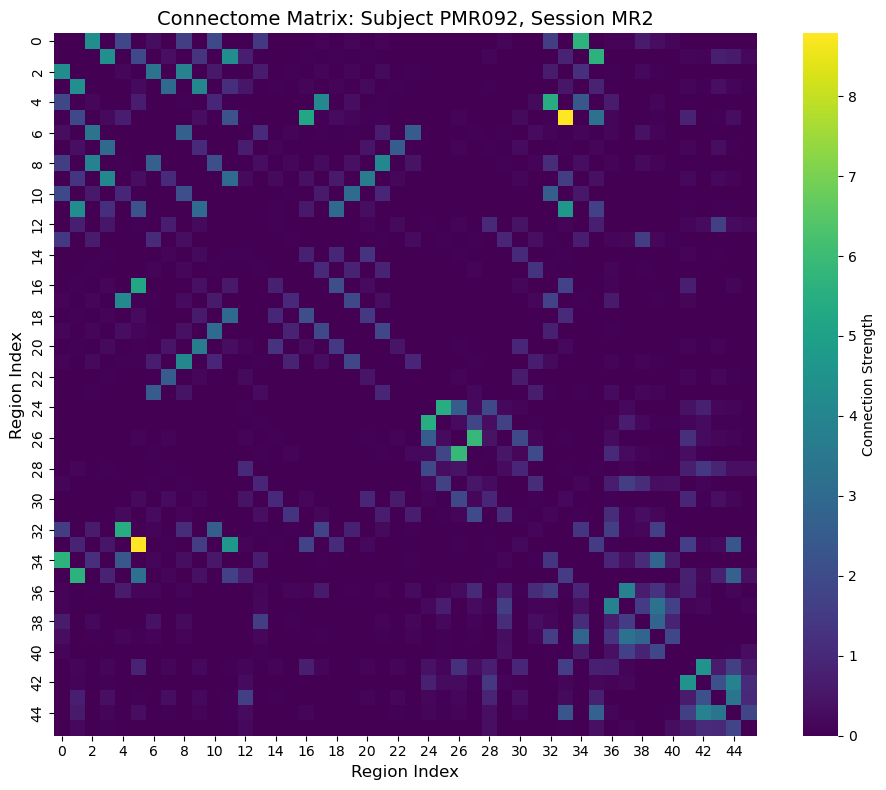

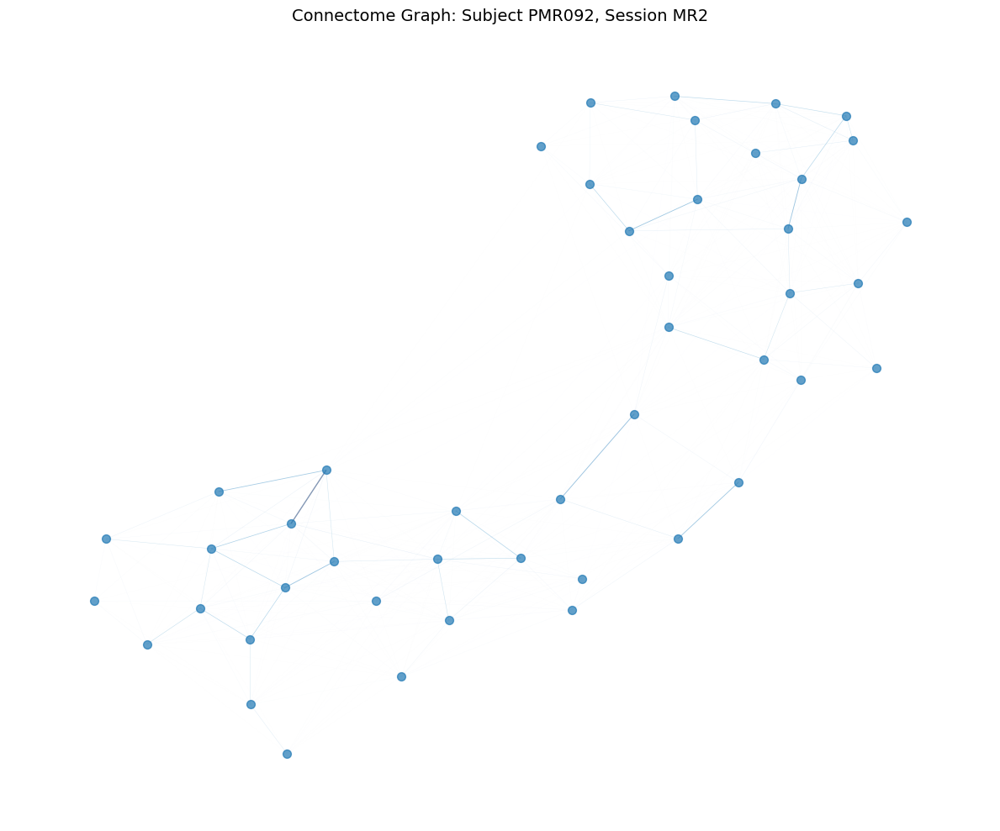

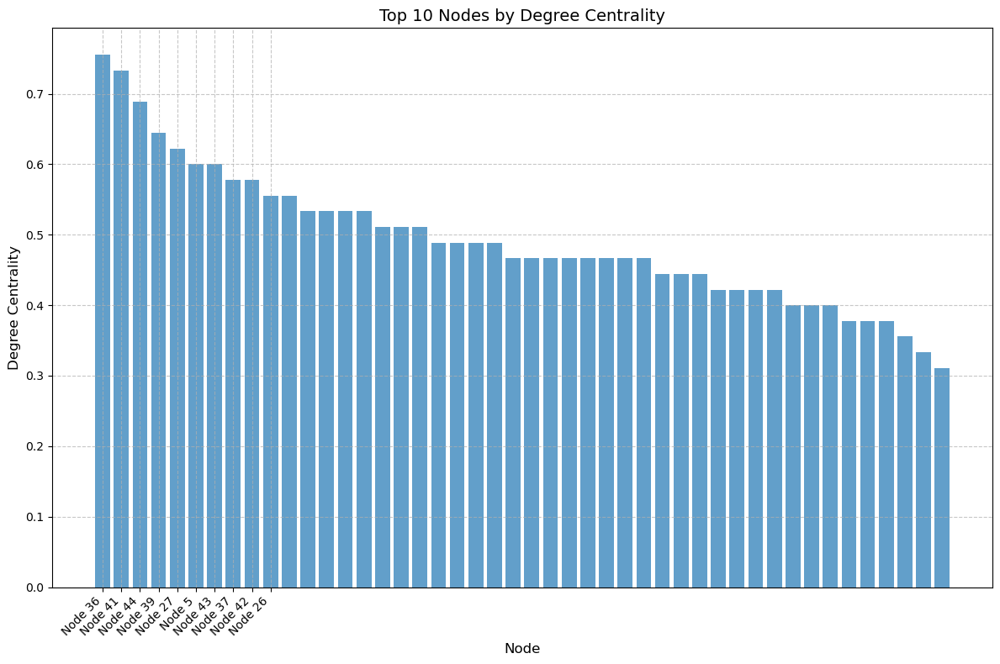

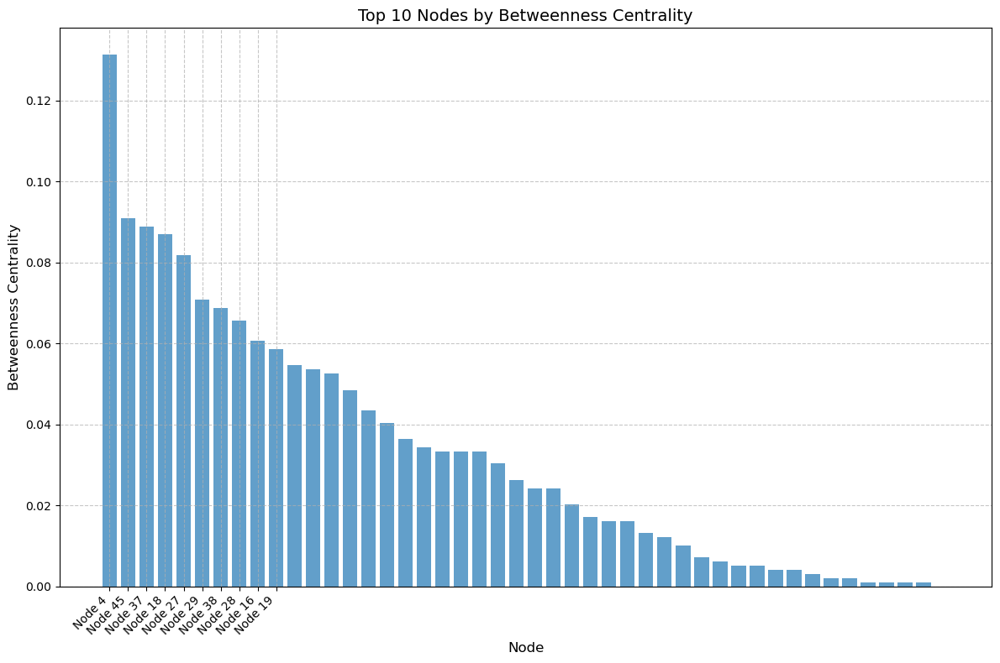

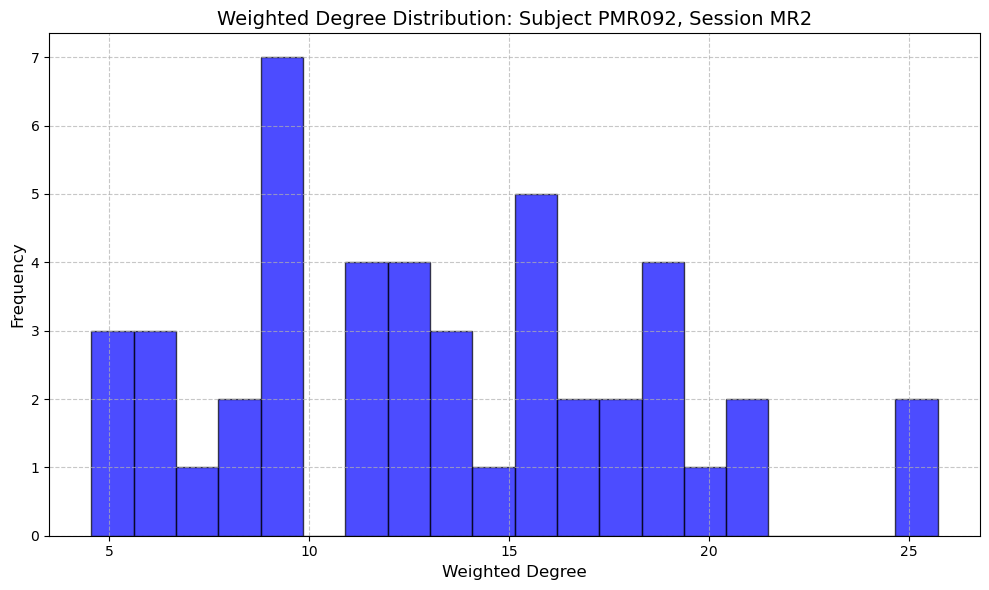

Processing connectome for subject PMR081, session MR2

Visualizations for subject PMR081, session MR2:


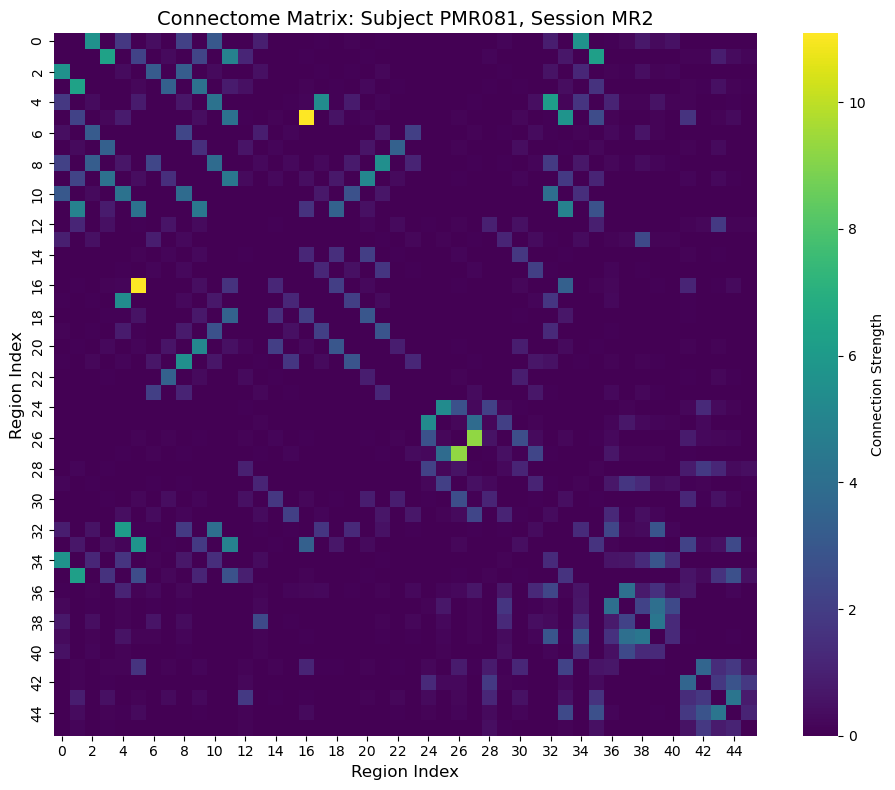

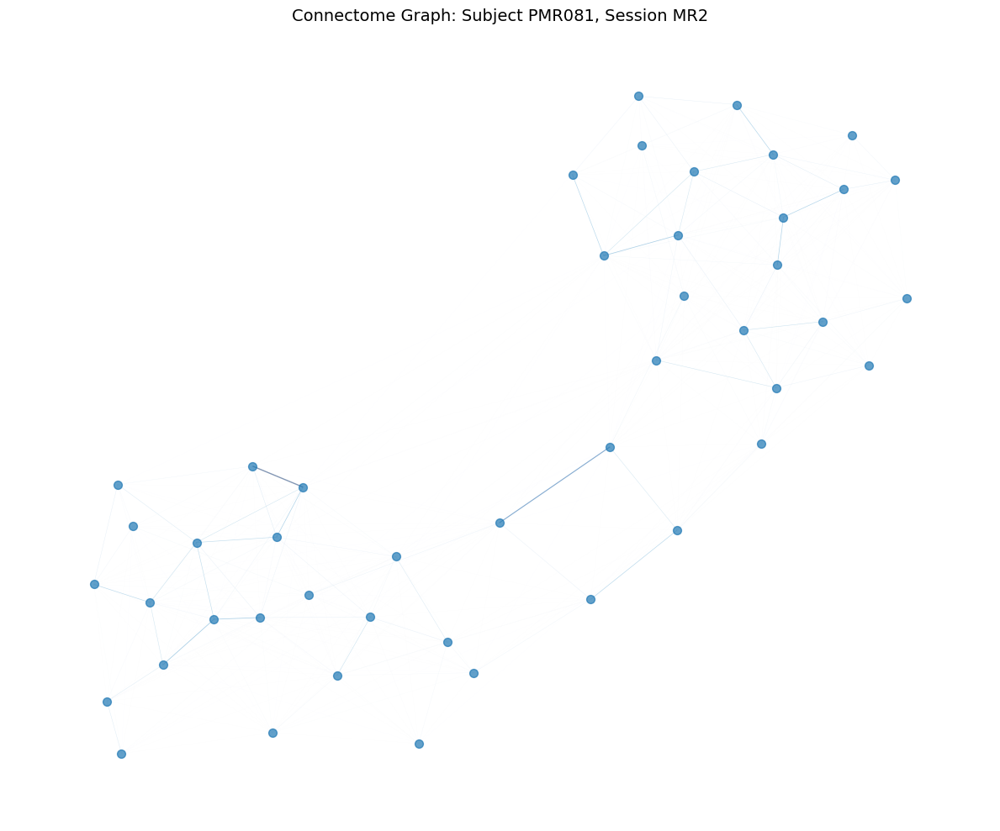

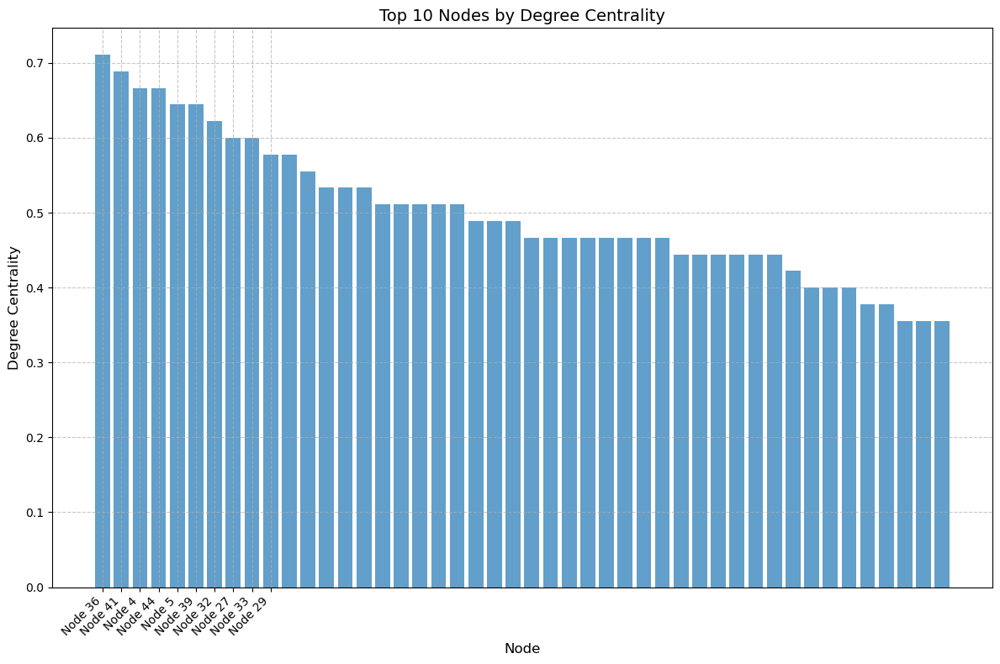

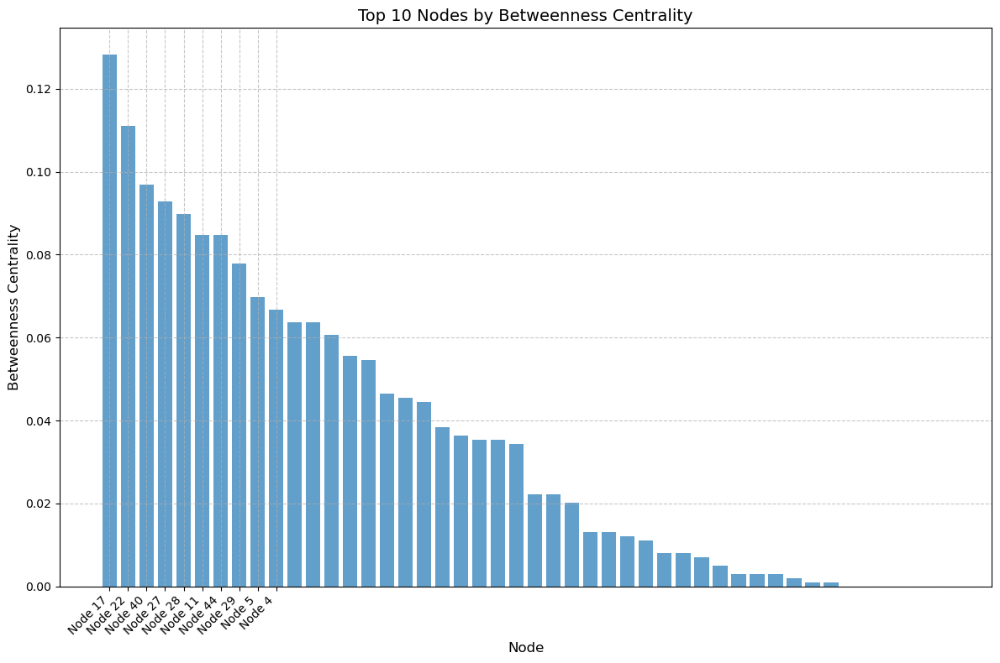

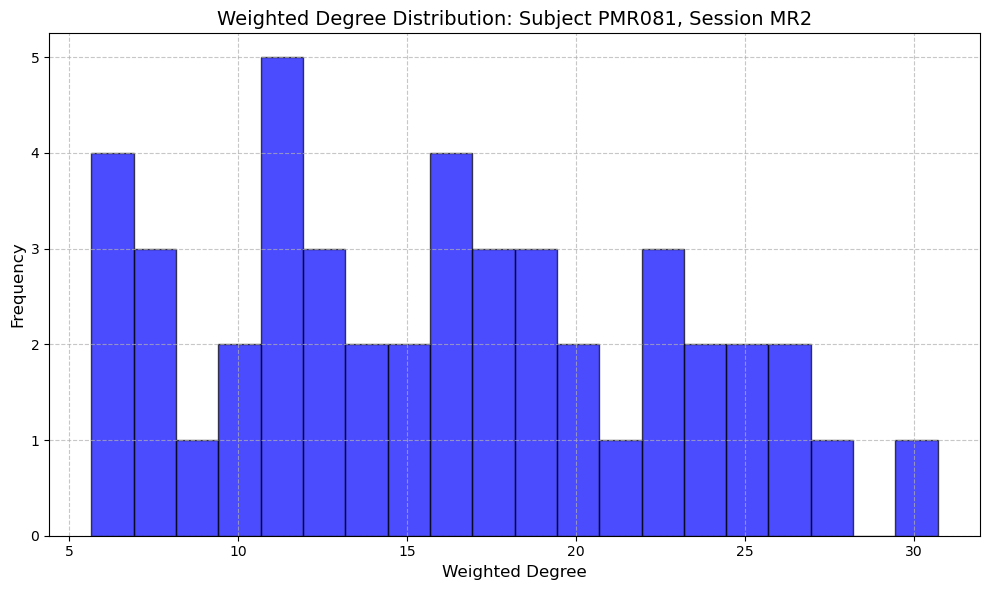

Processing connectome for subject PMR083, session MR2

Visualizations for subject PMR083, session MR2:


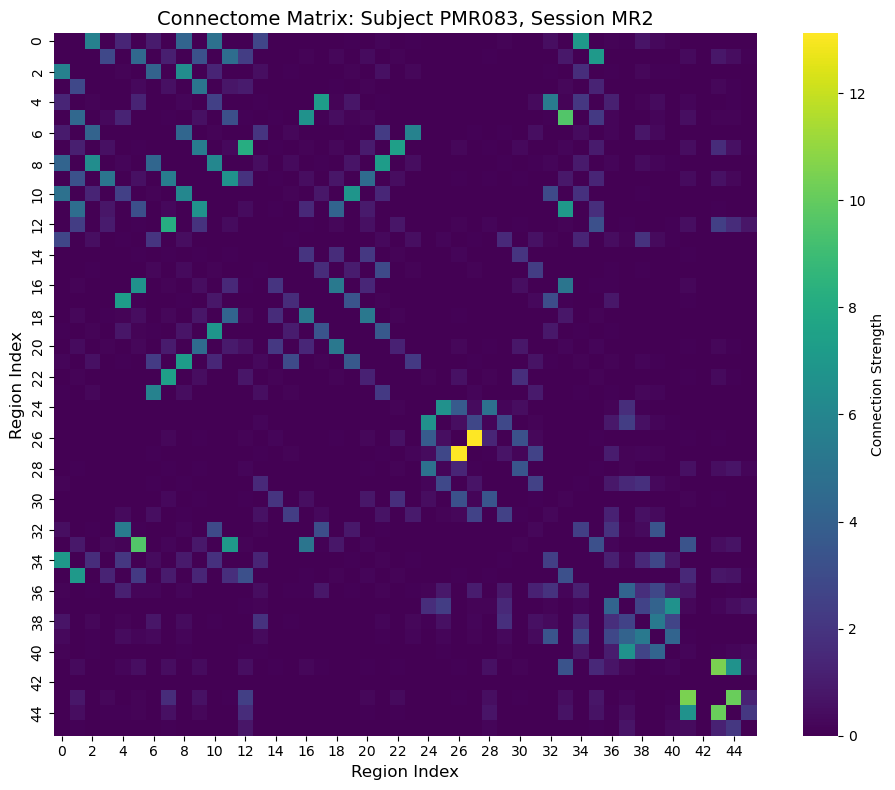

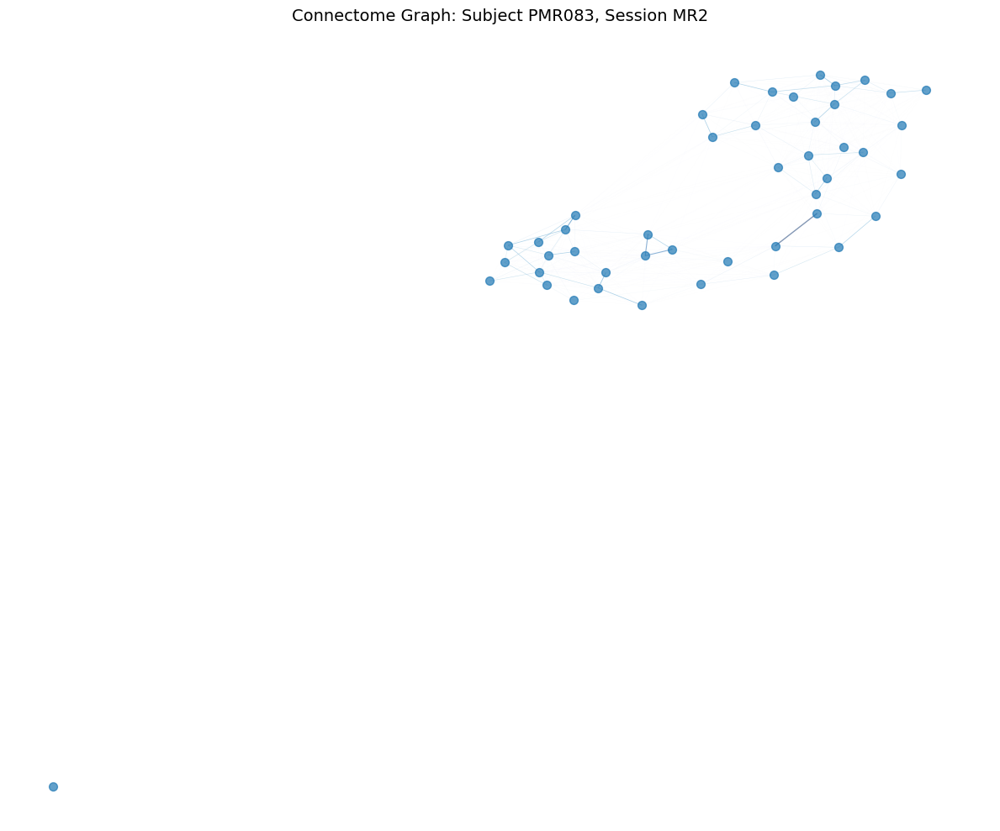

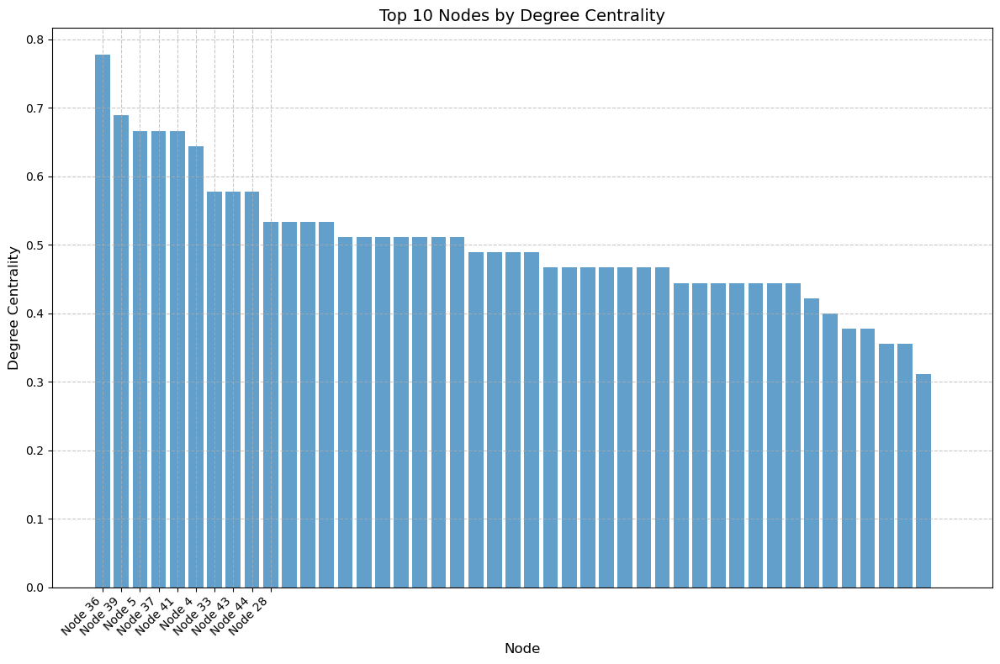

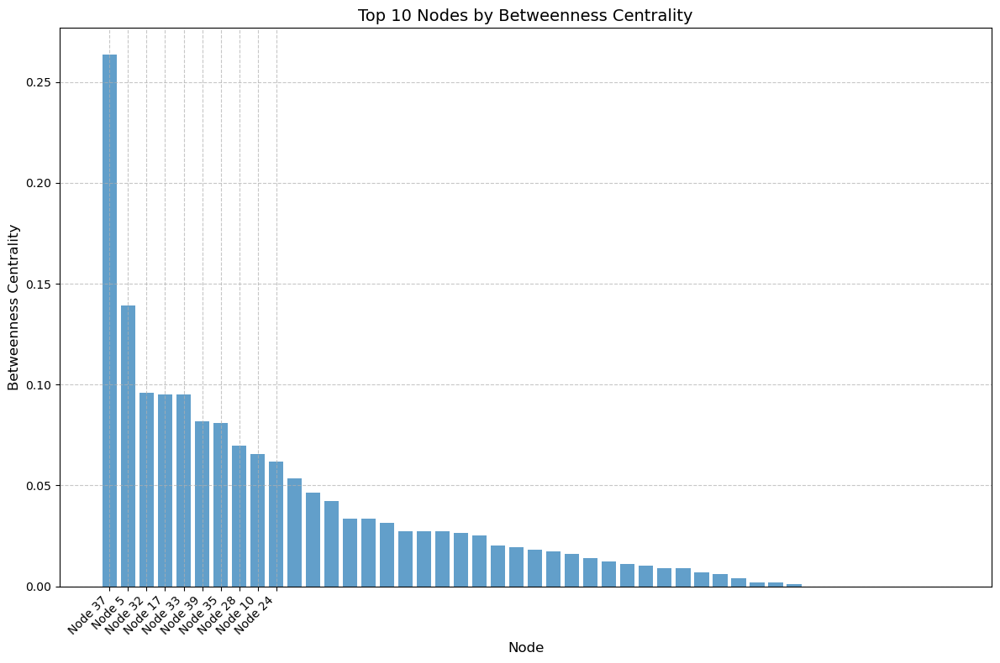

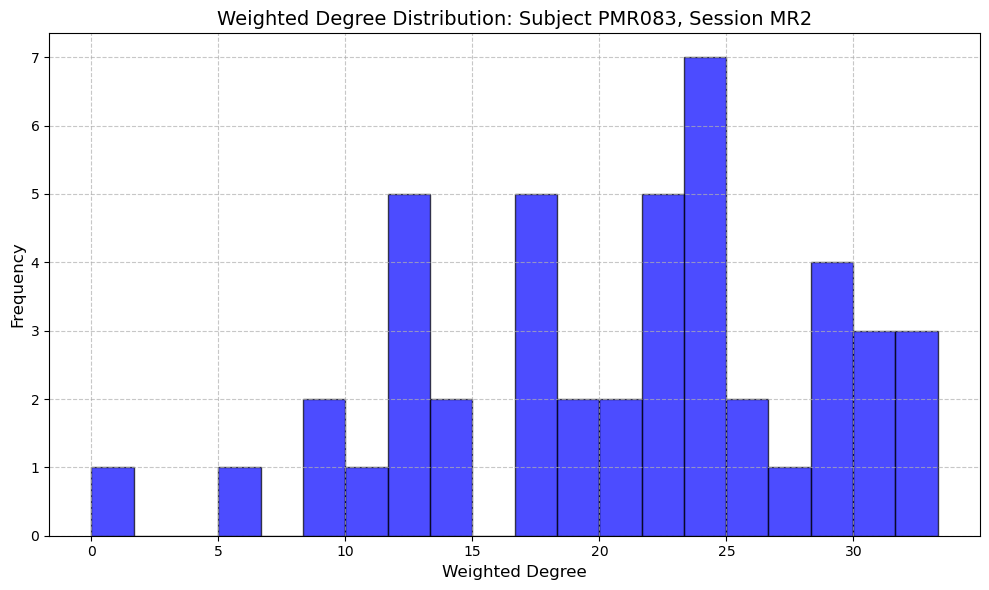

Processing connectome for subject PMR010, session MR2

Visualizations for subject PMR010, session MR2:


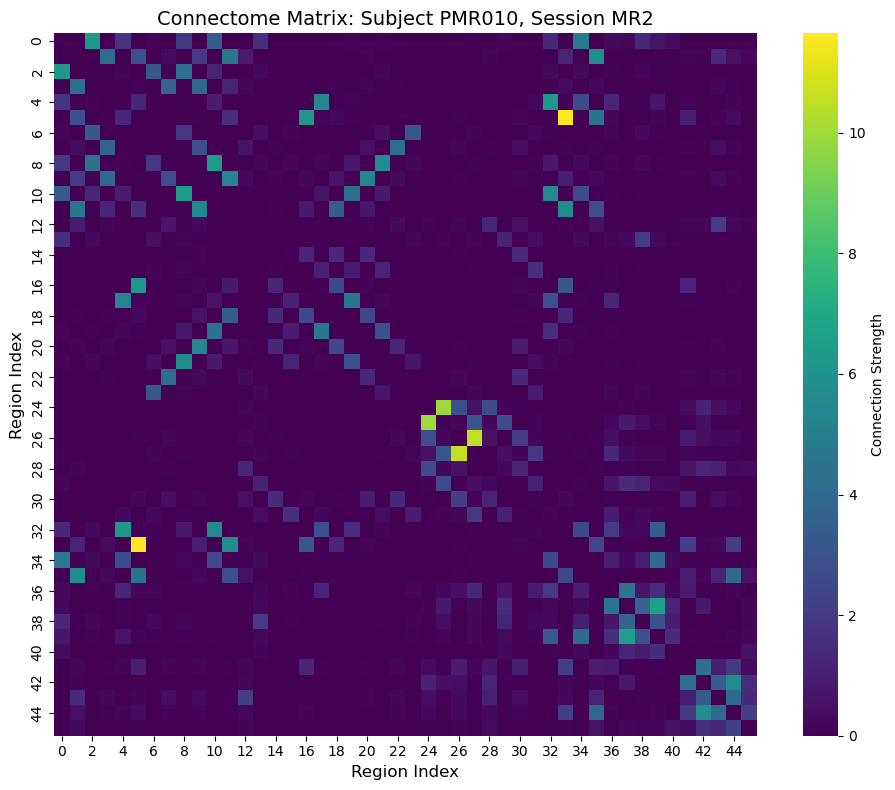

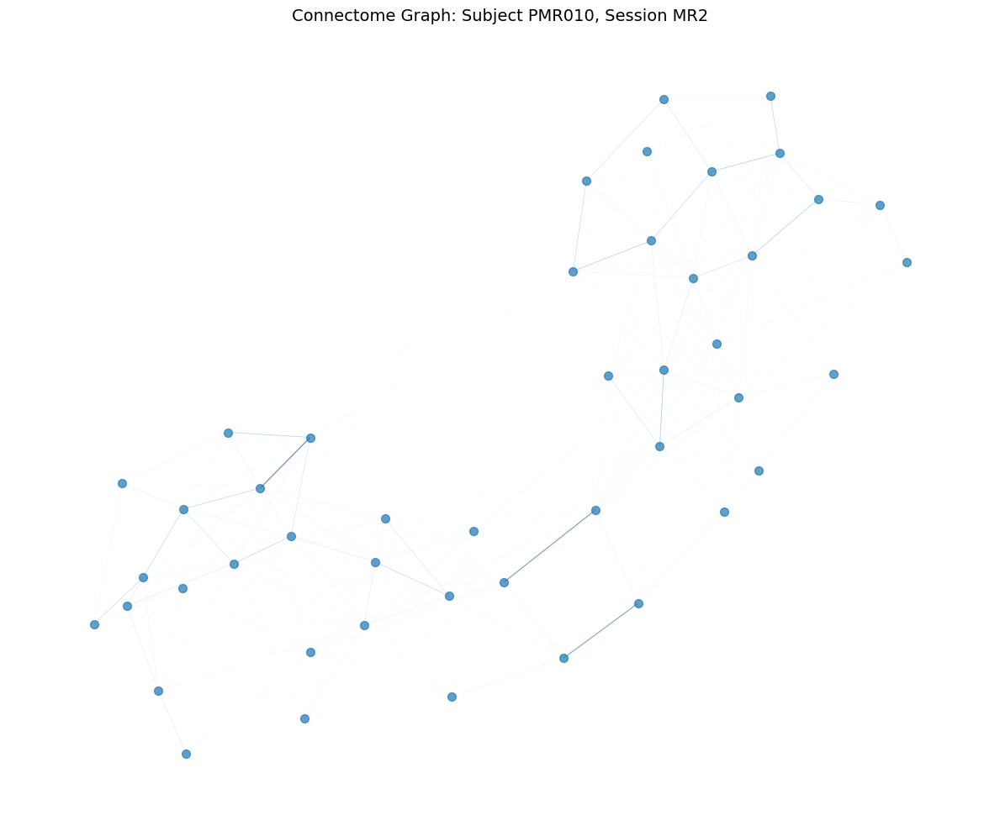

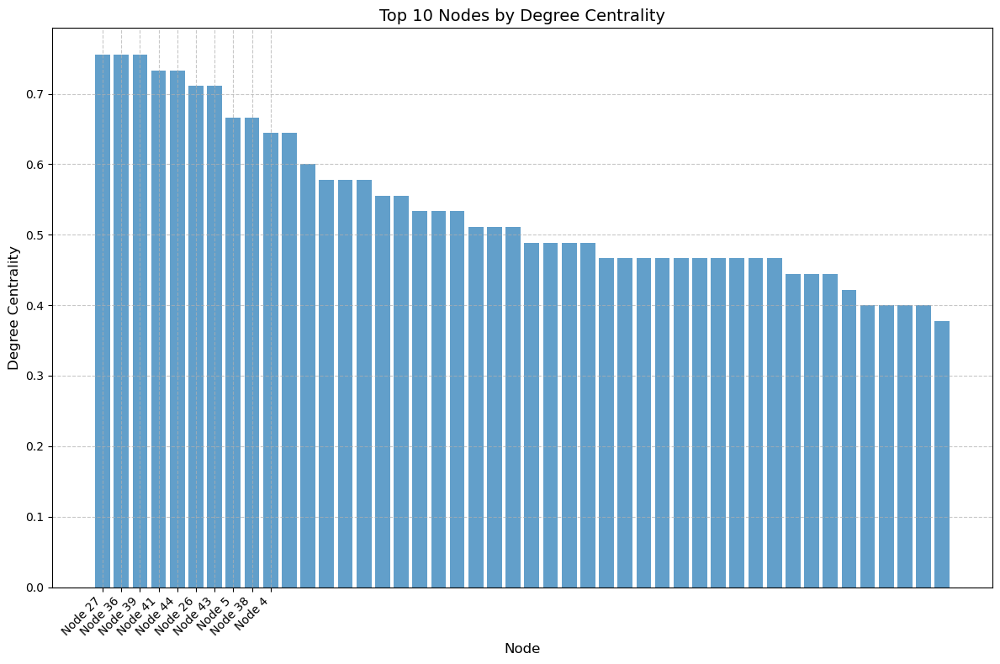

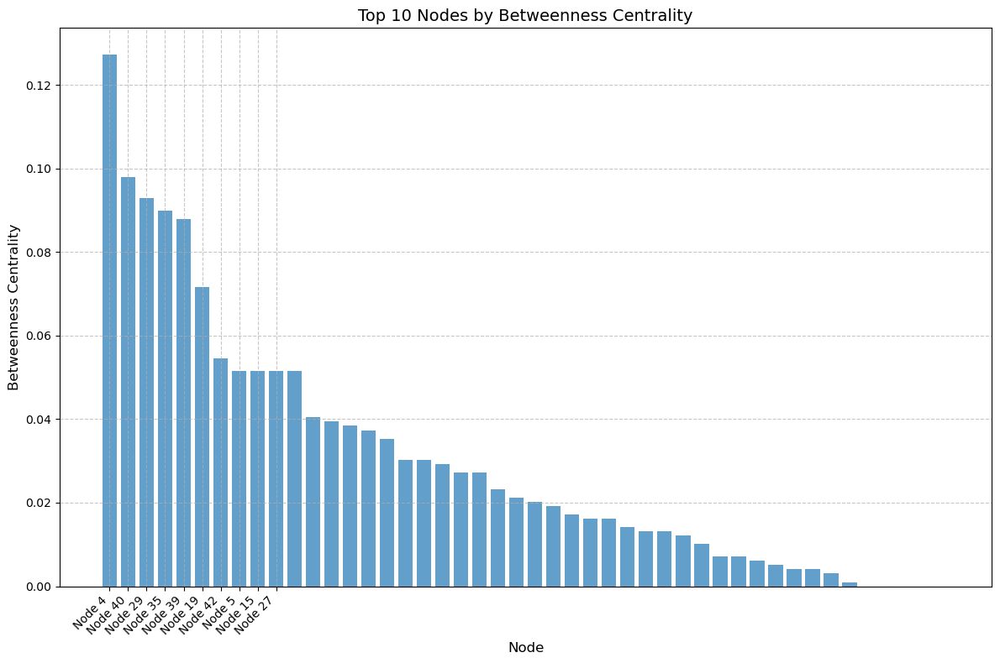

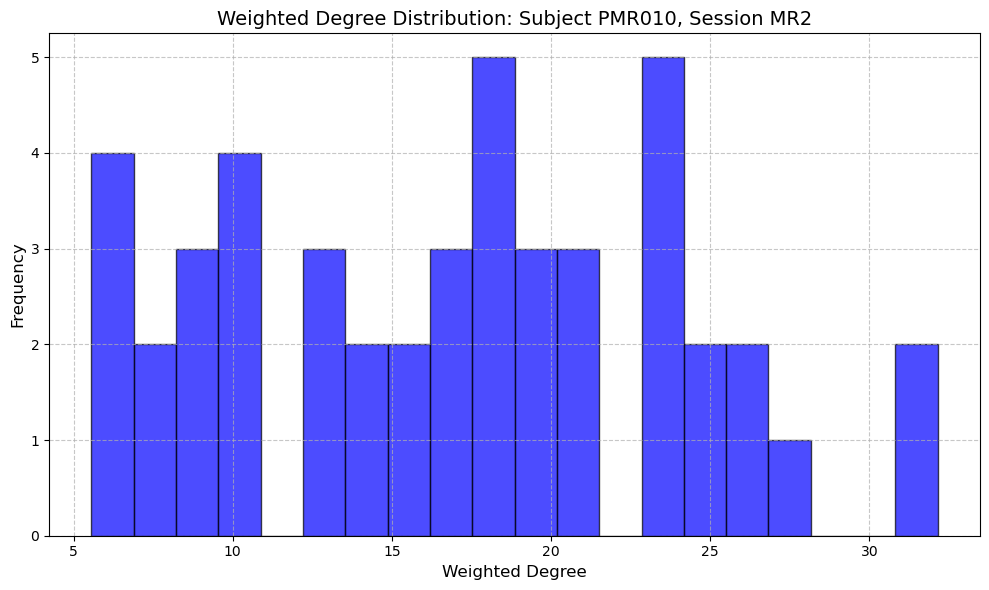

Processing connectome for subject PMR063, session MR2

Visualizations for subject PMR063, session MR2:


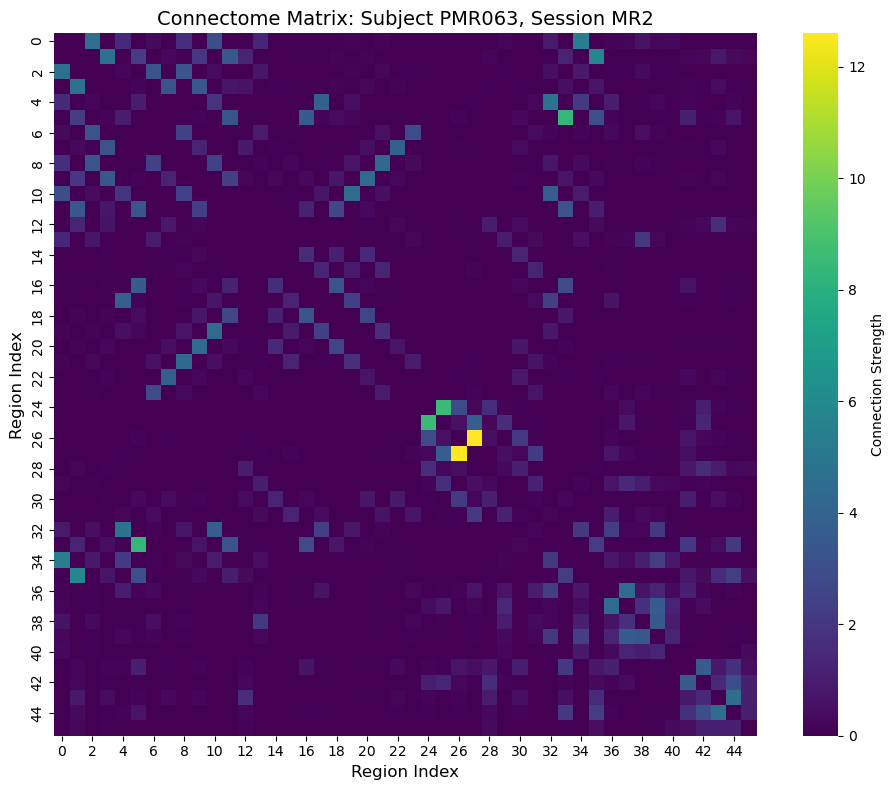

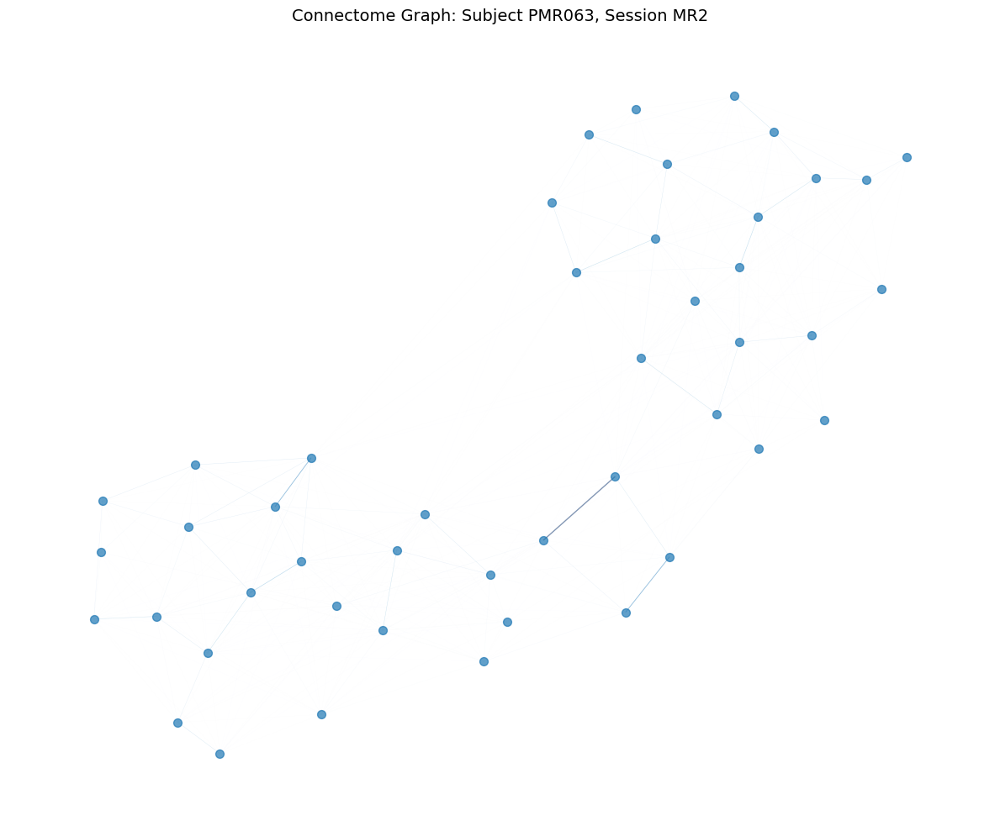

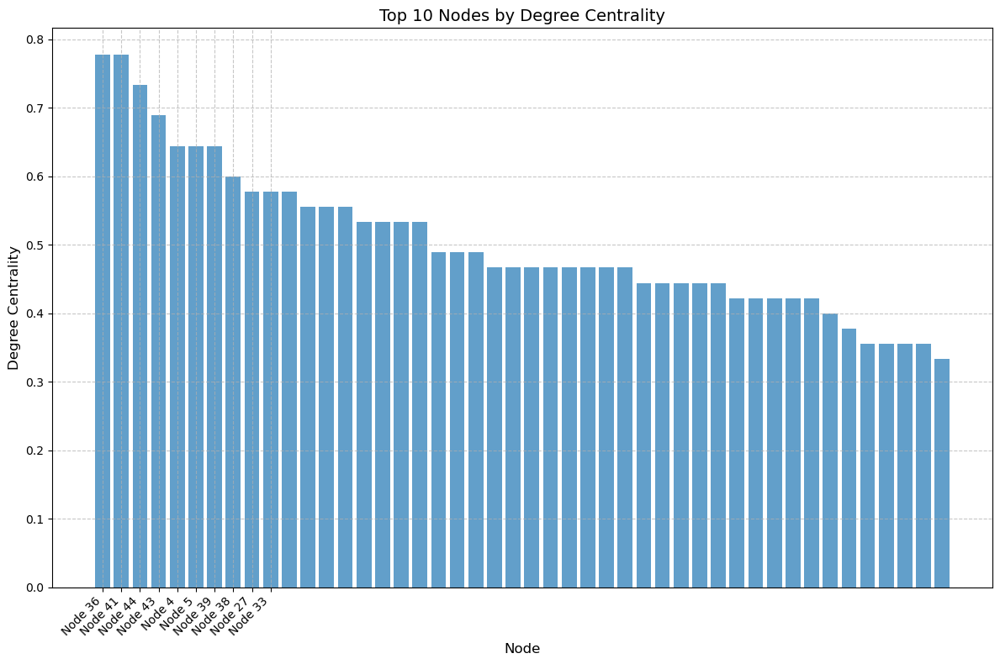

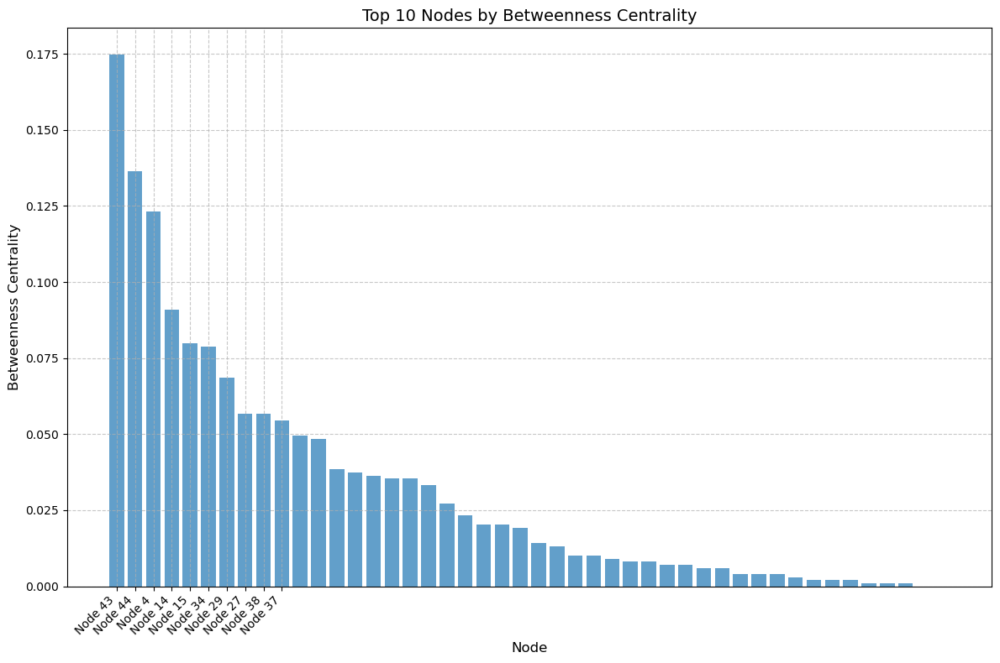

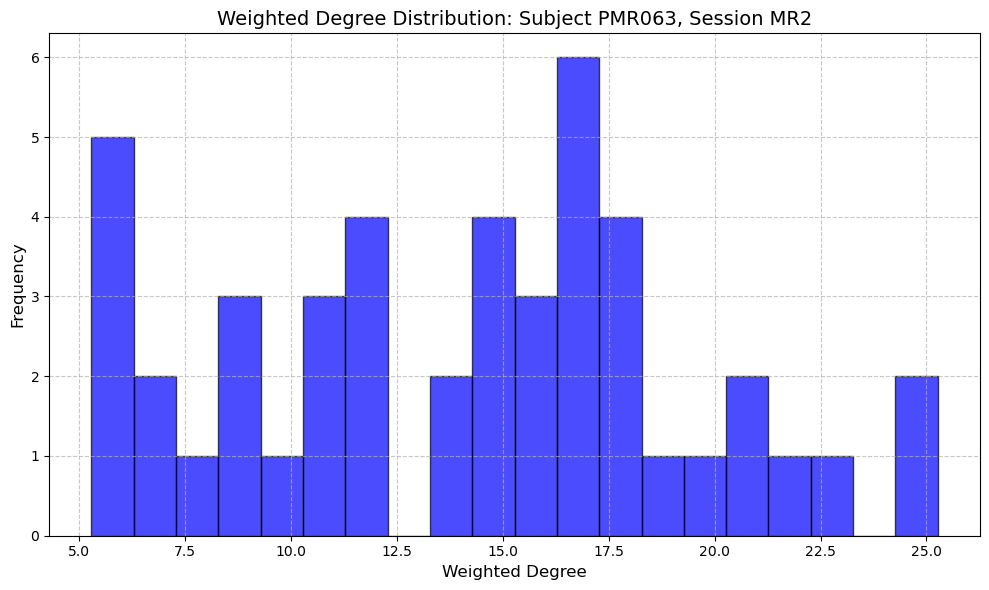

Processing connectome for subject PMR015, session MR2

Visualizations for subject PMR015, session MR2:


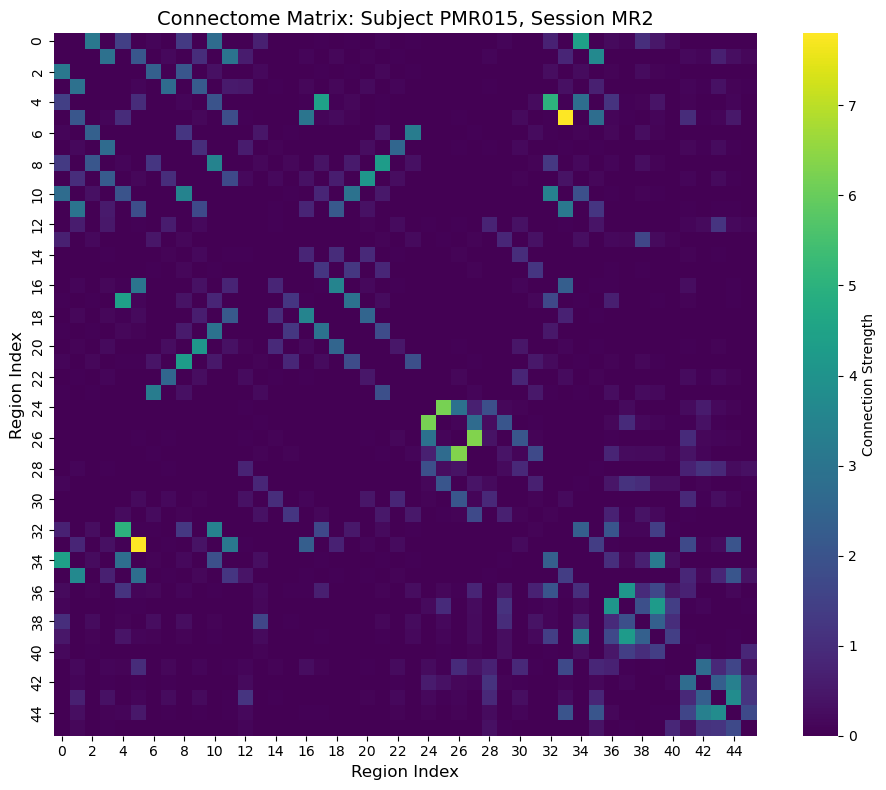

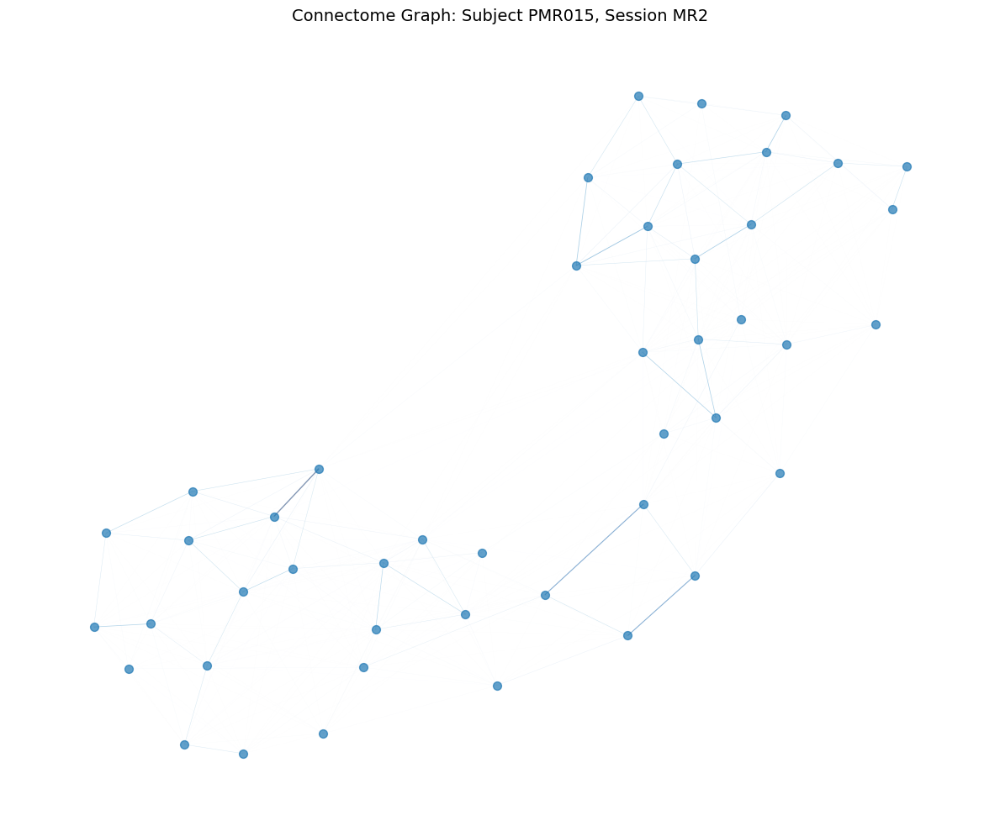

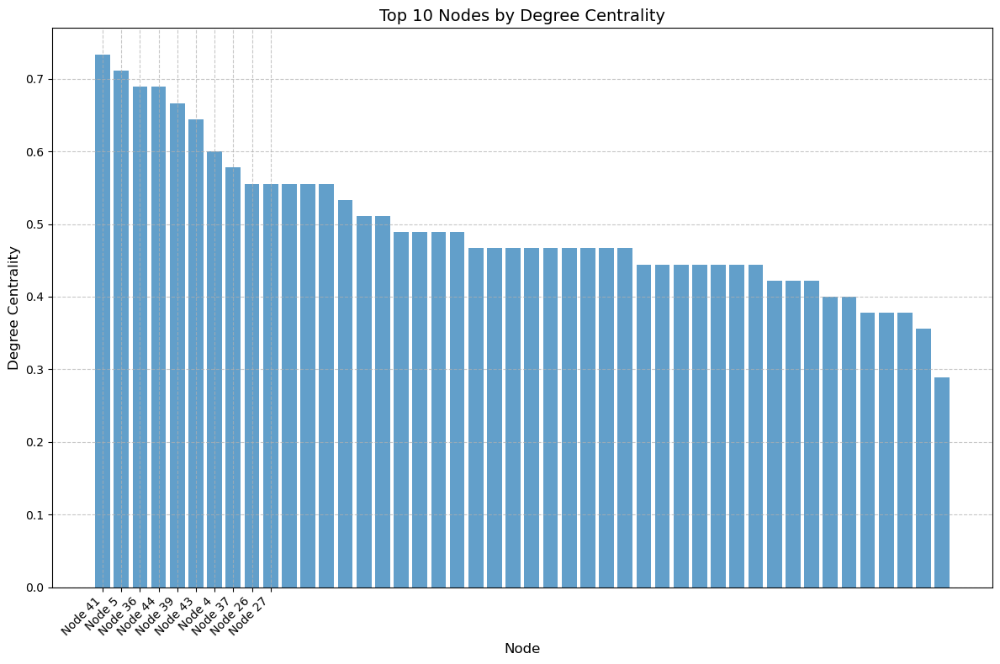

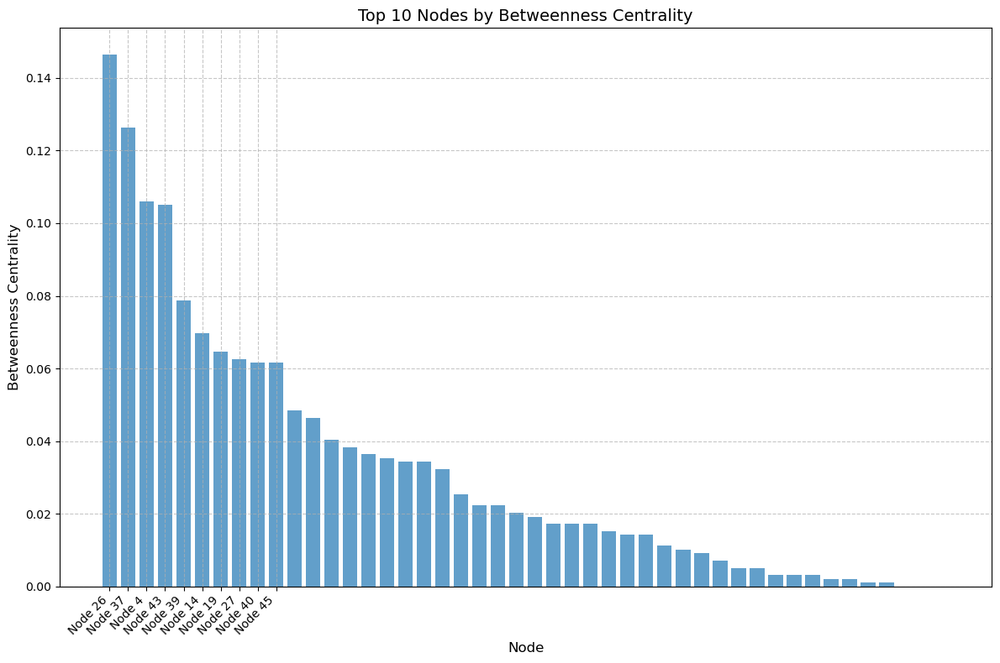

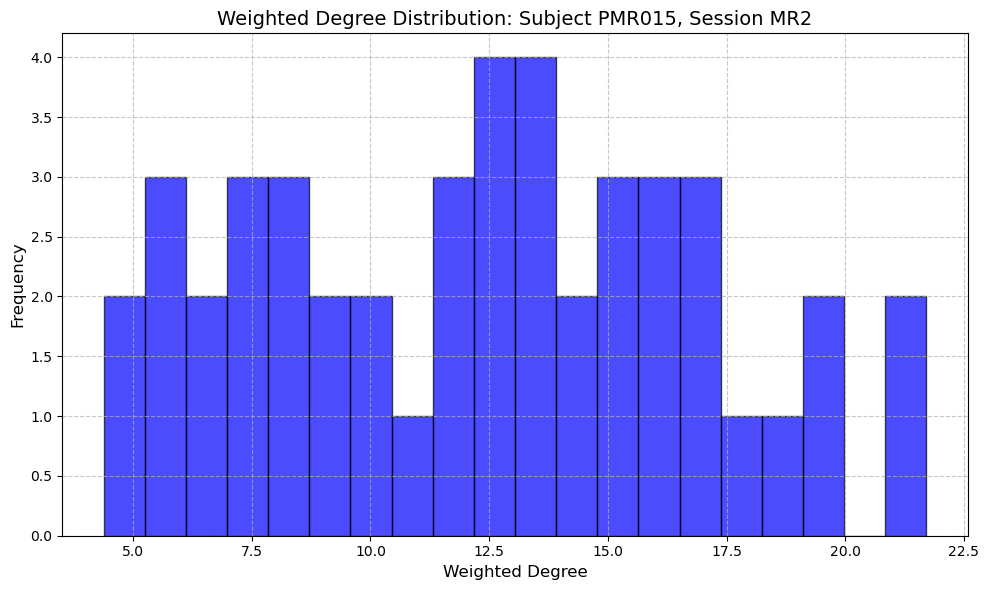

Processing connectome for subject PMR062, session MR2

Visualizations for subject PMR062, session MR2:


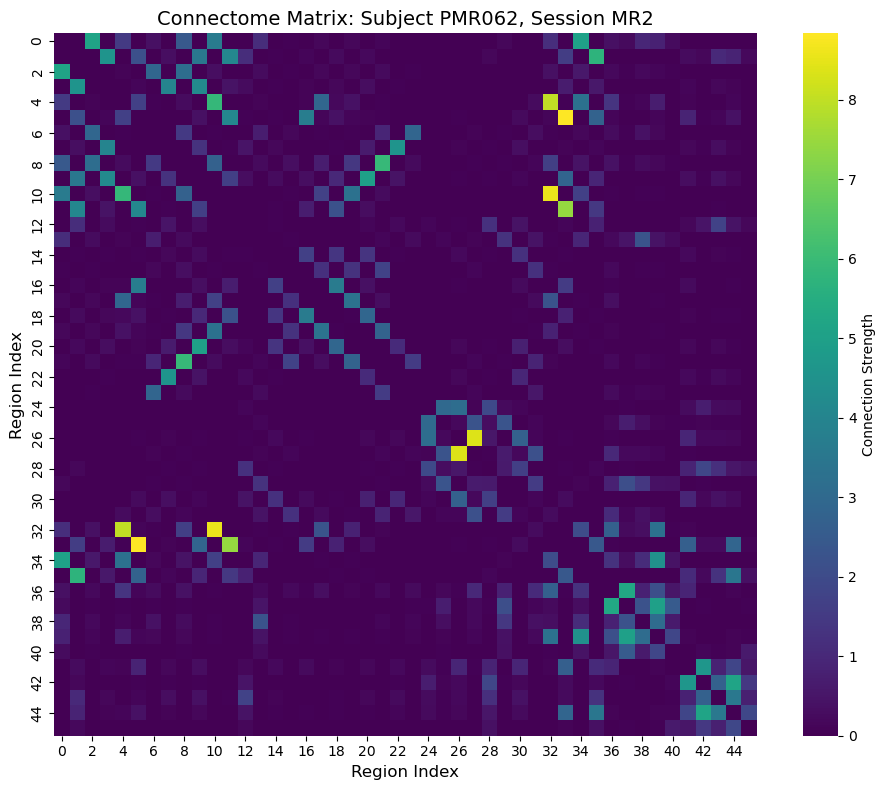

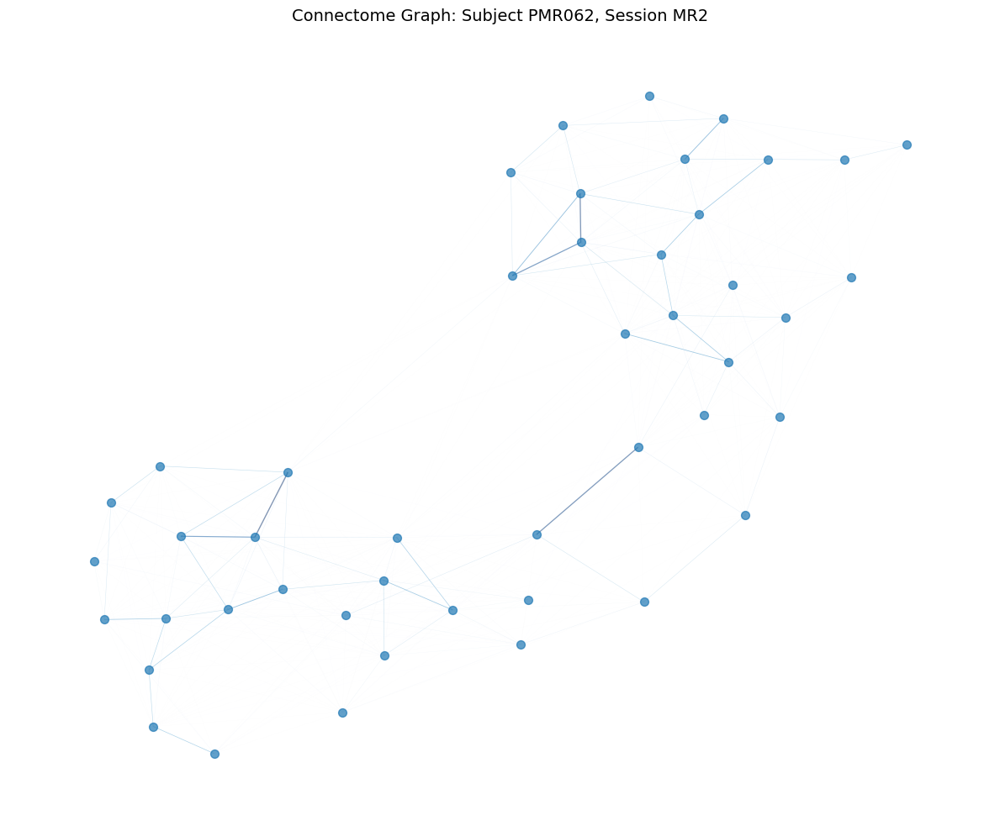

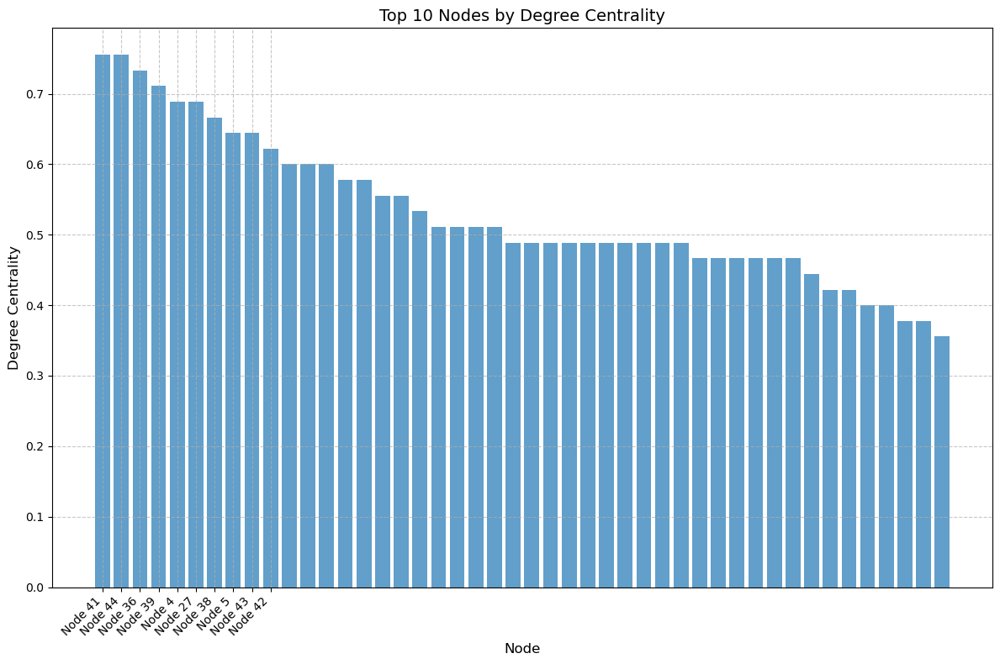

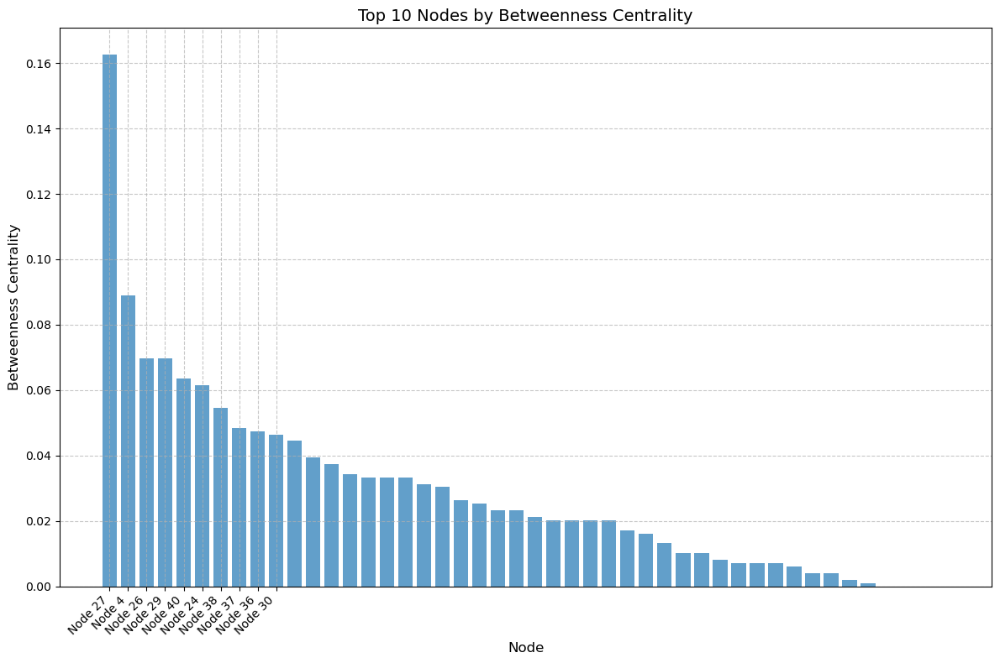

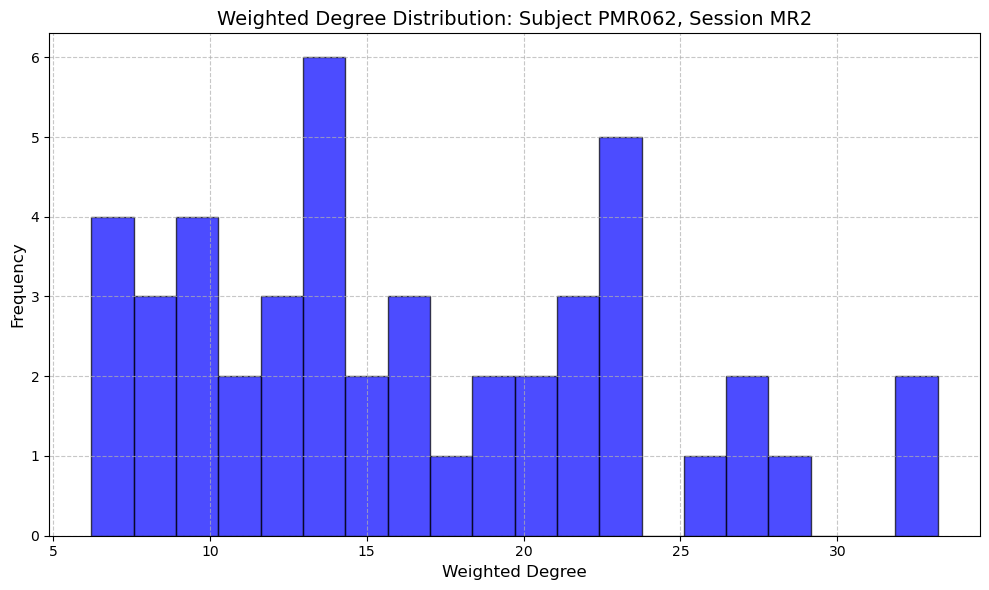

Processing connectome for subject PMR039, session MR2

Visualizations for subject PMR039, session MR2:


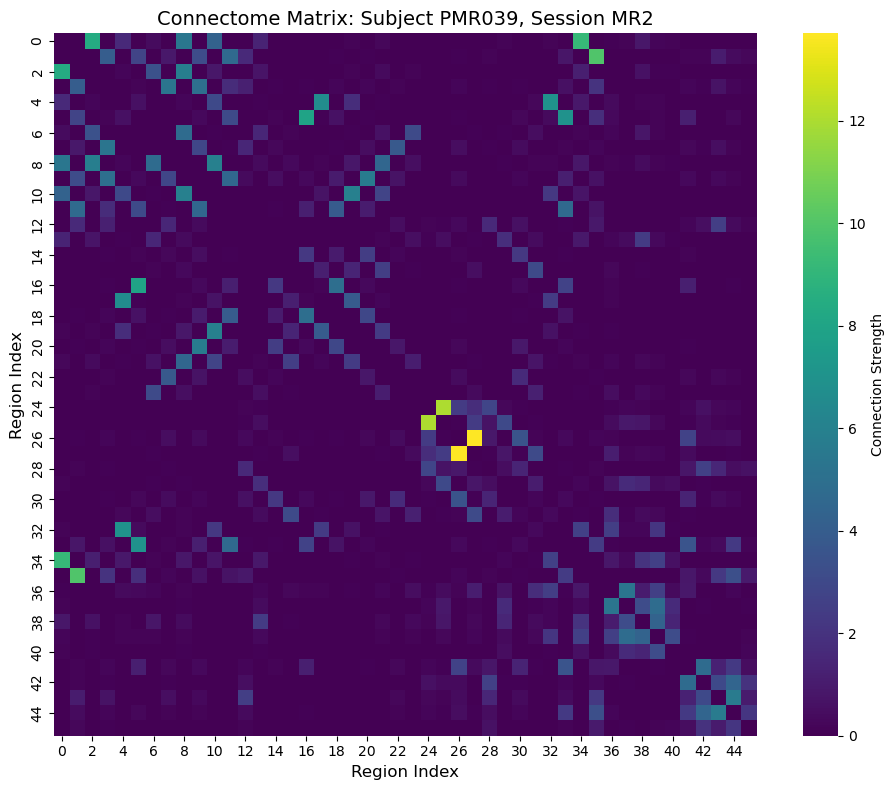

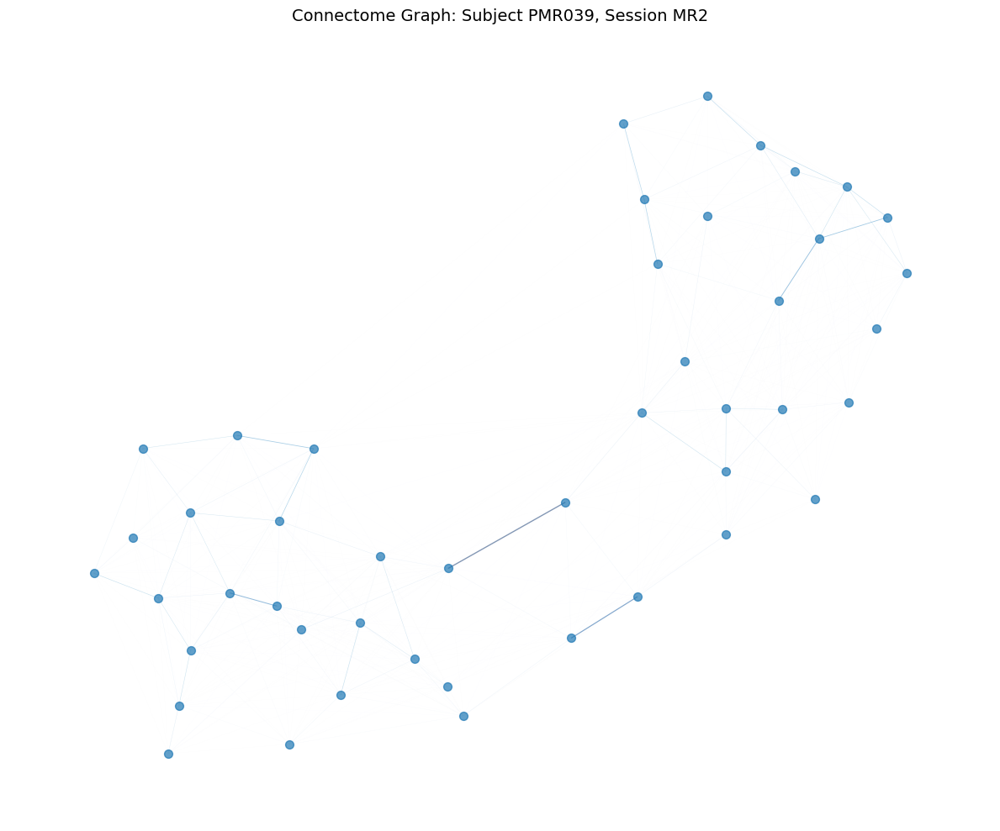

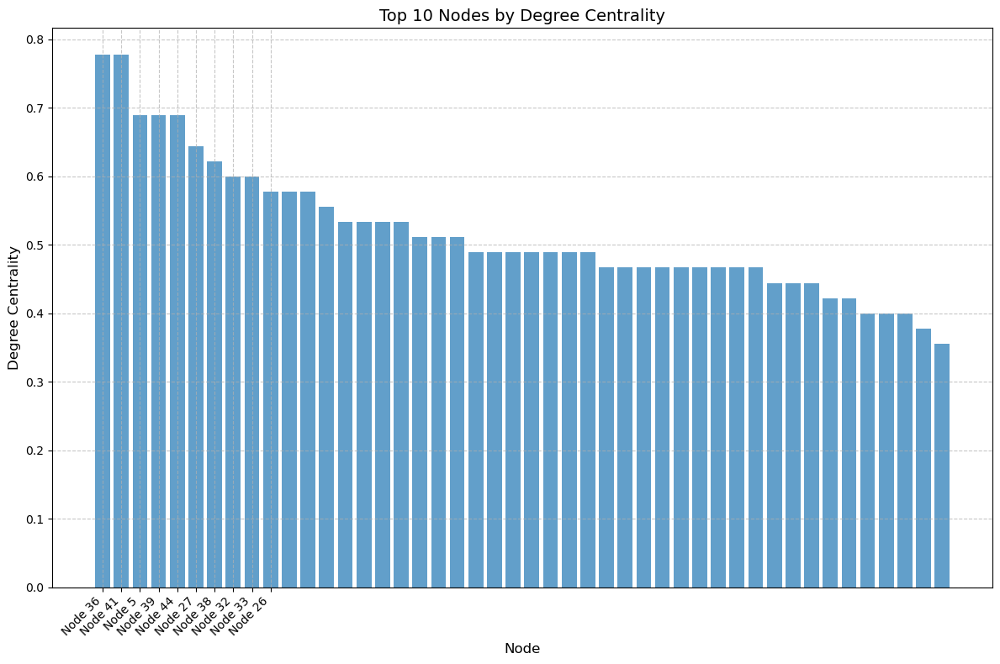

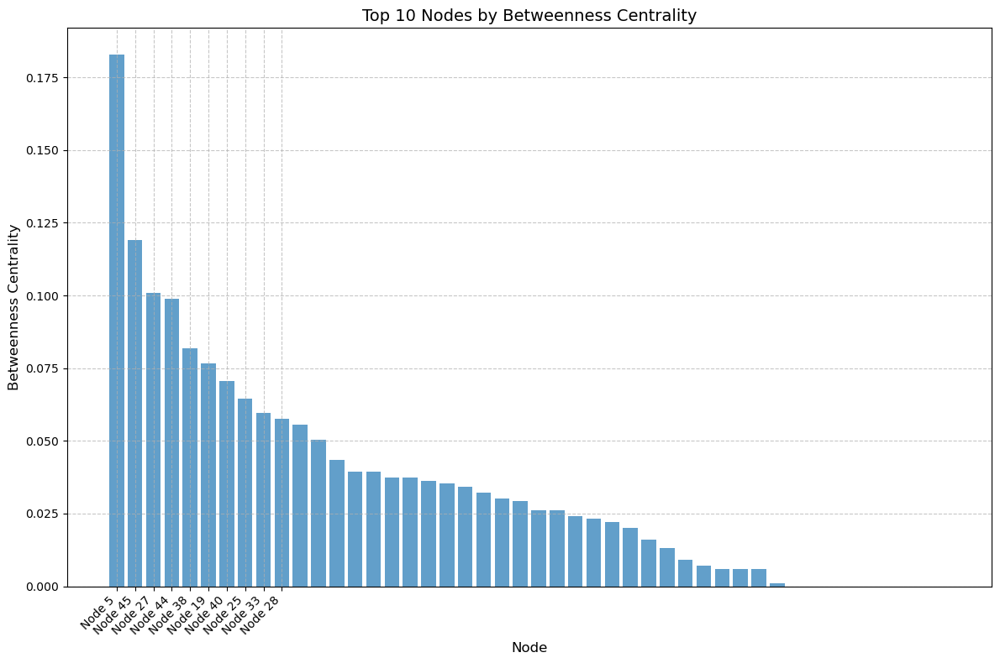

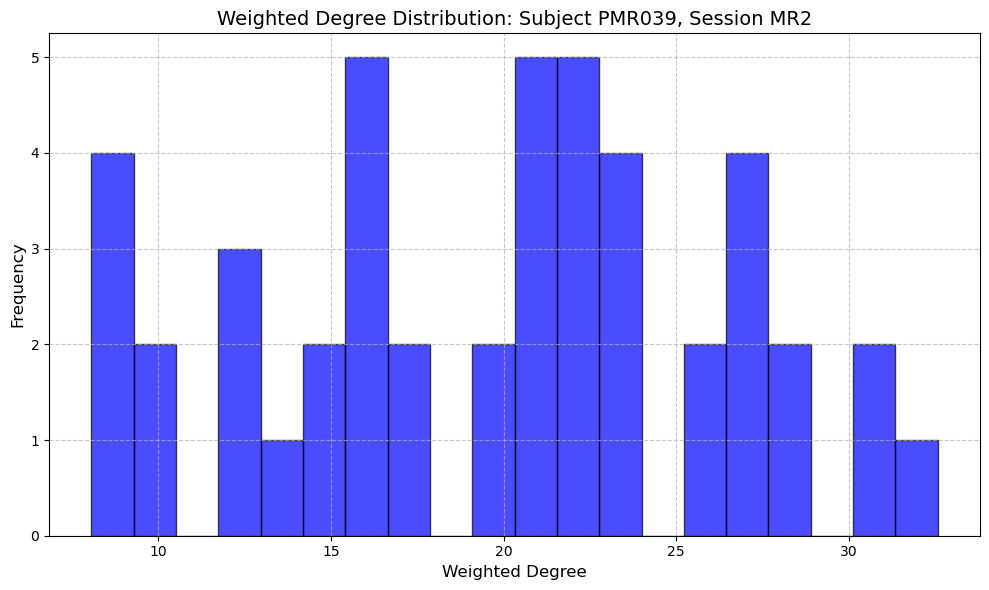

Processing connectome for subject PMR013, session MR2

Visualizations for subject PMR013, session MR2:


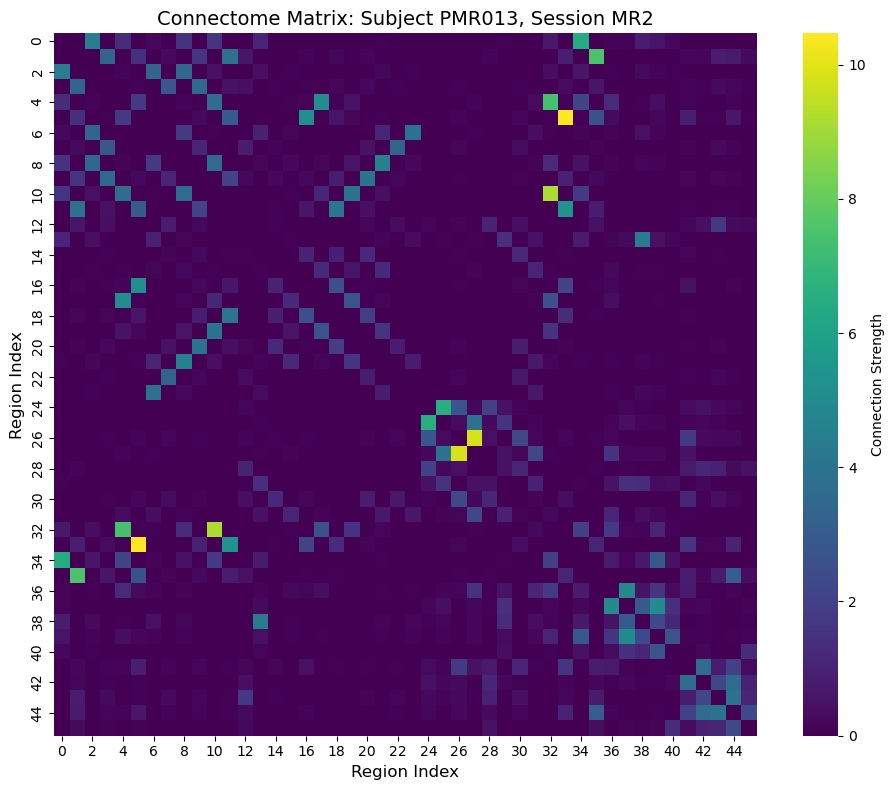

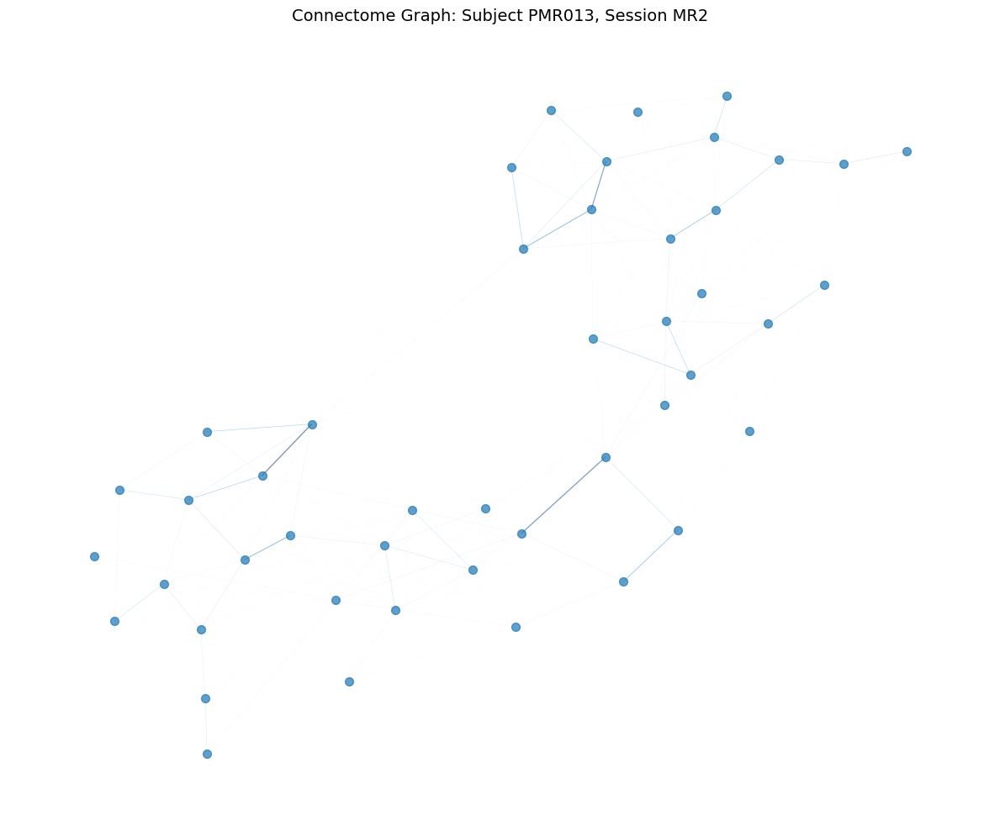

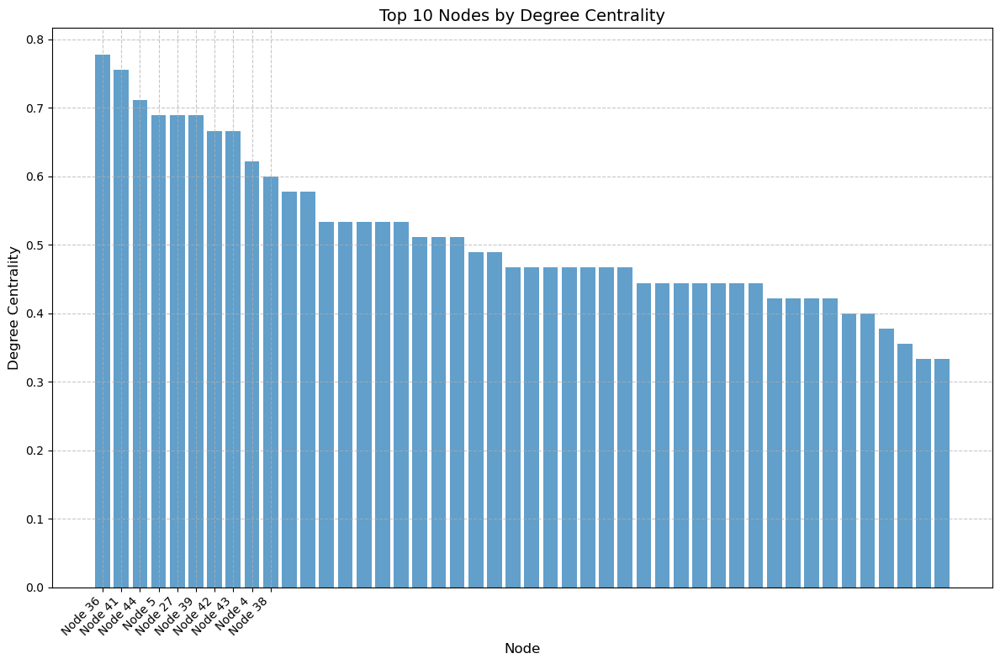

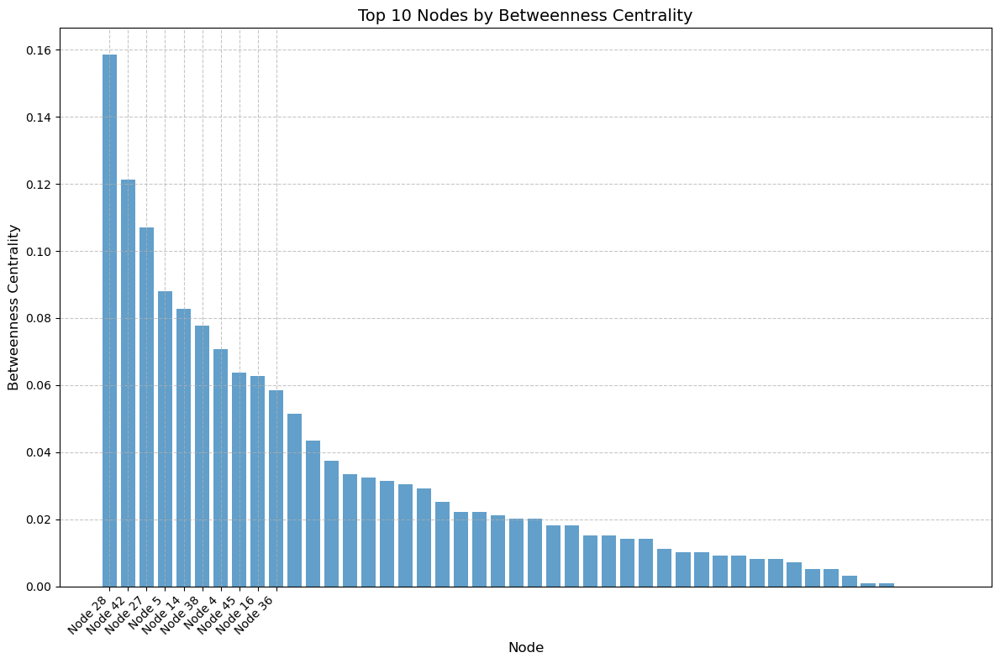

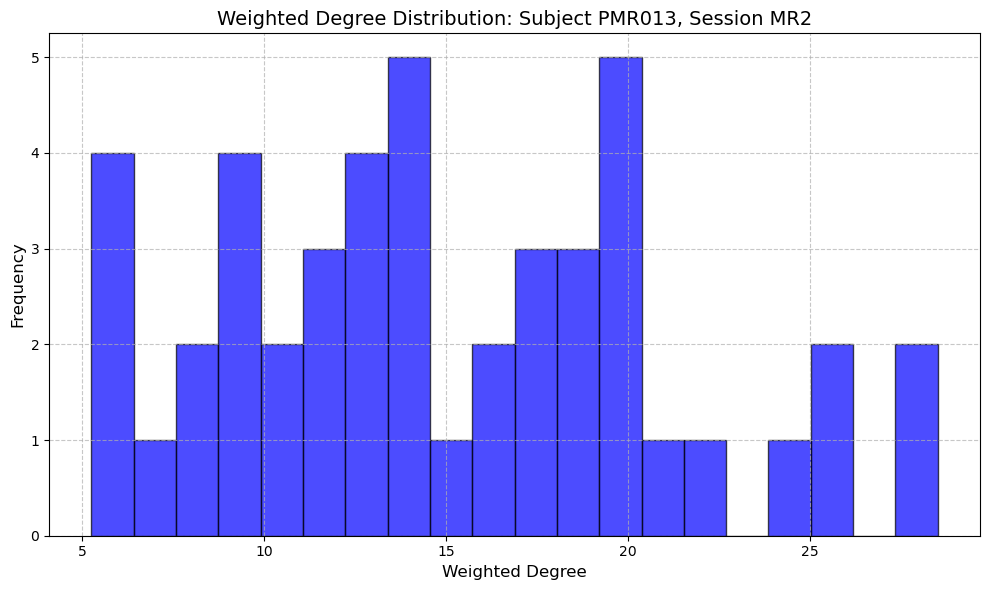

Processing connectome for subject PMR073, session MR2

Visualizations for subject PMR073, session MR2:


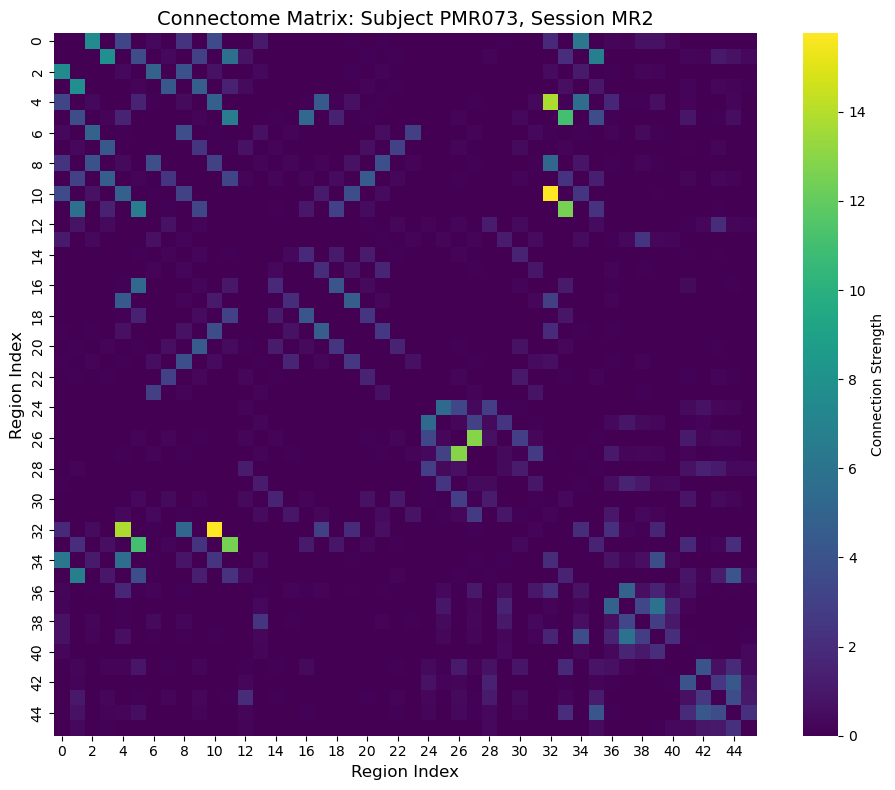

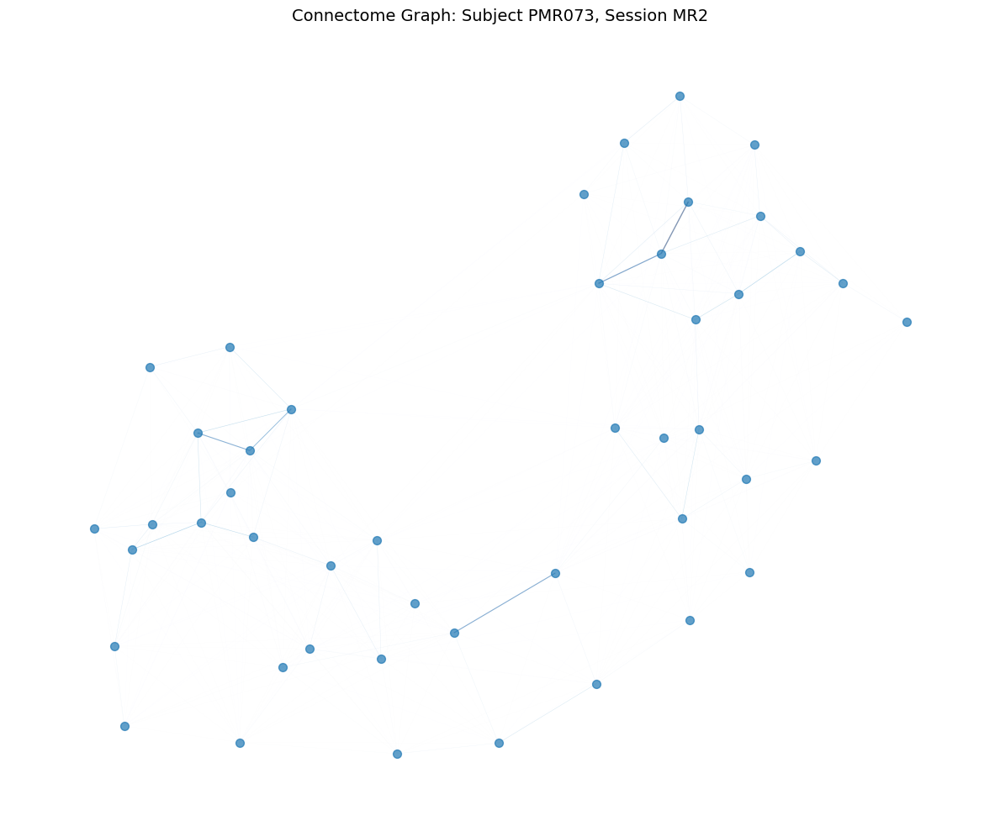

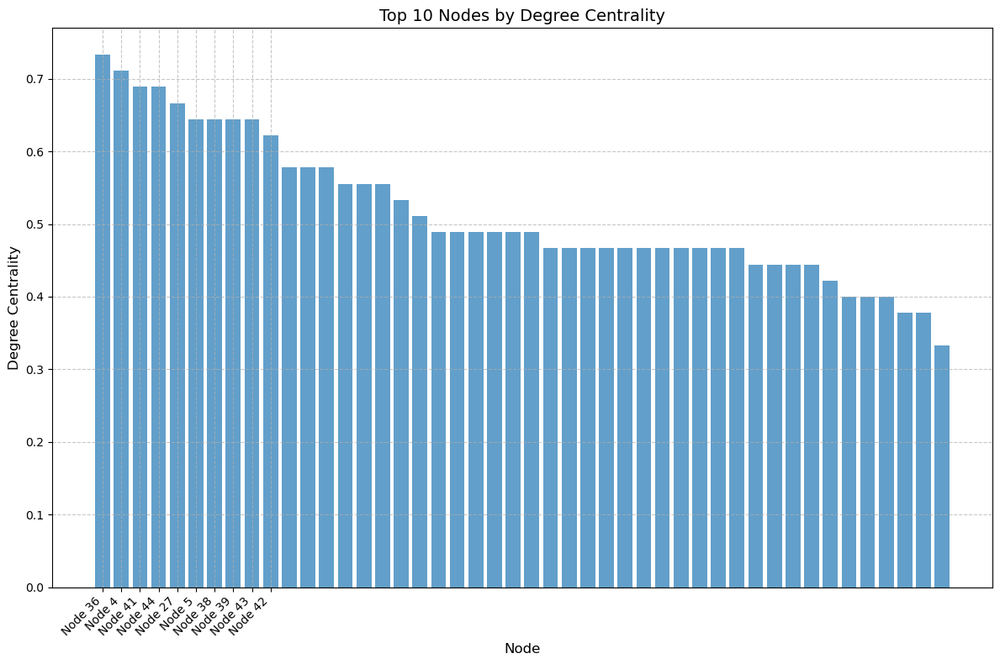

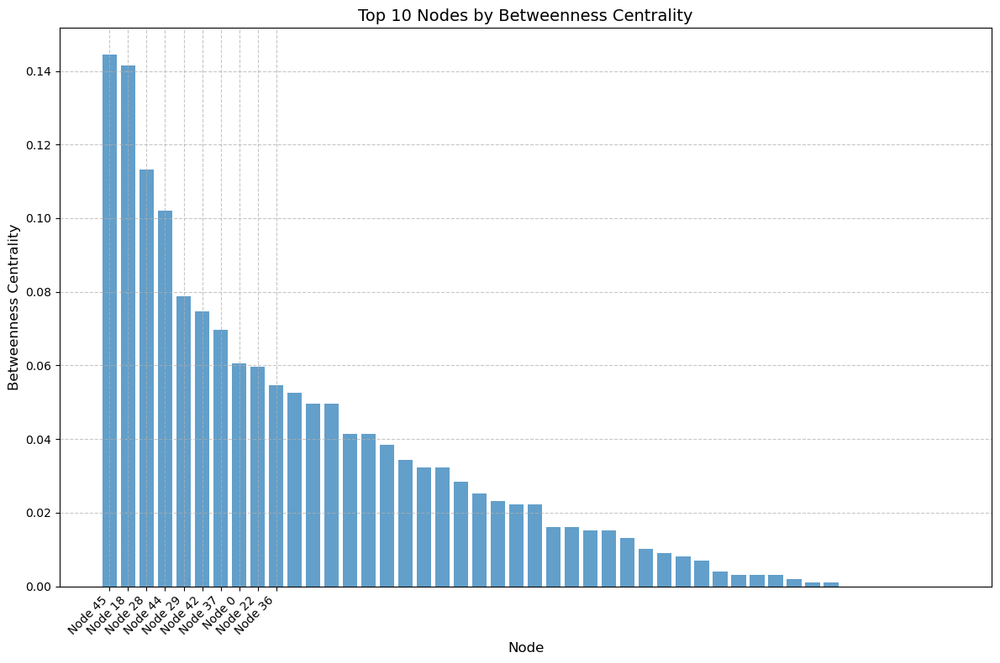

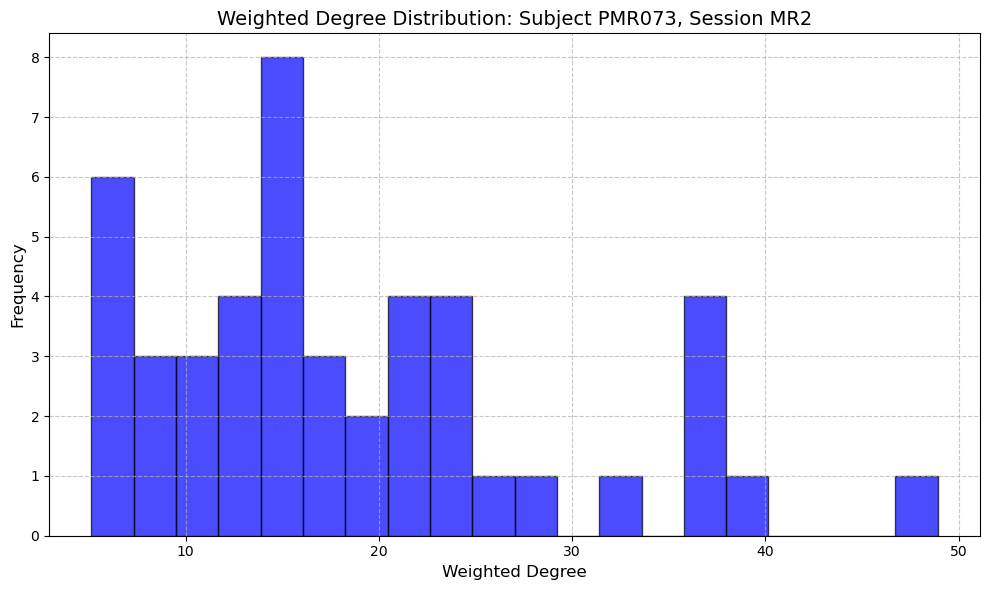

Processing connectome for subject PMR054, session MR2

Visualizations for subject PMR054, session MR2:


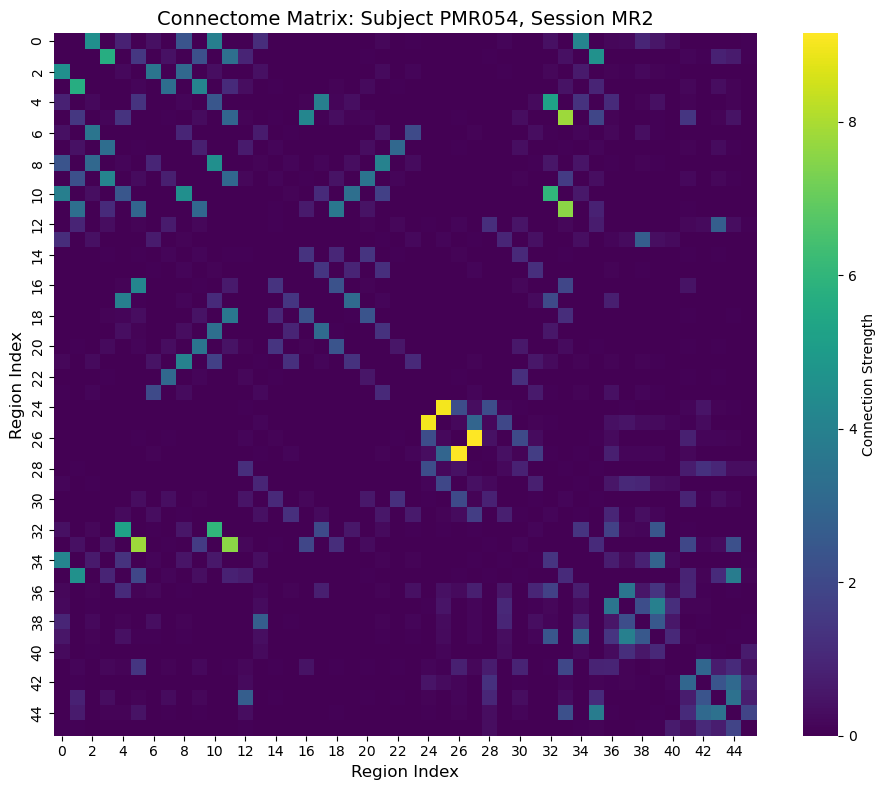

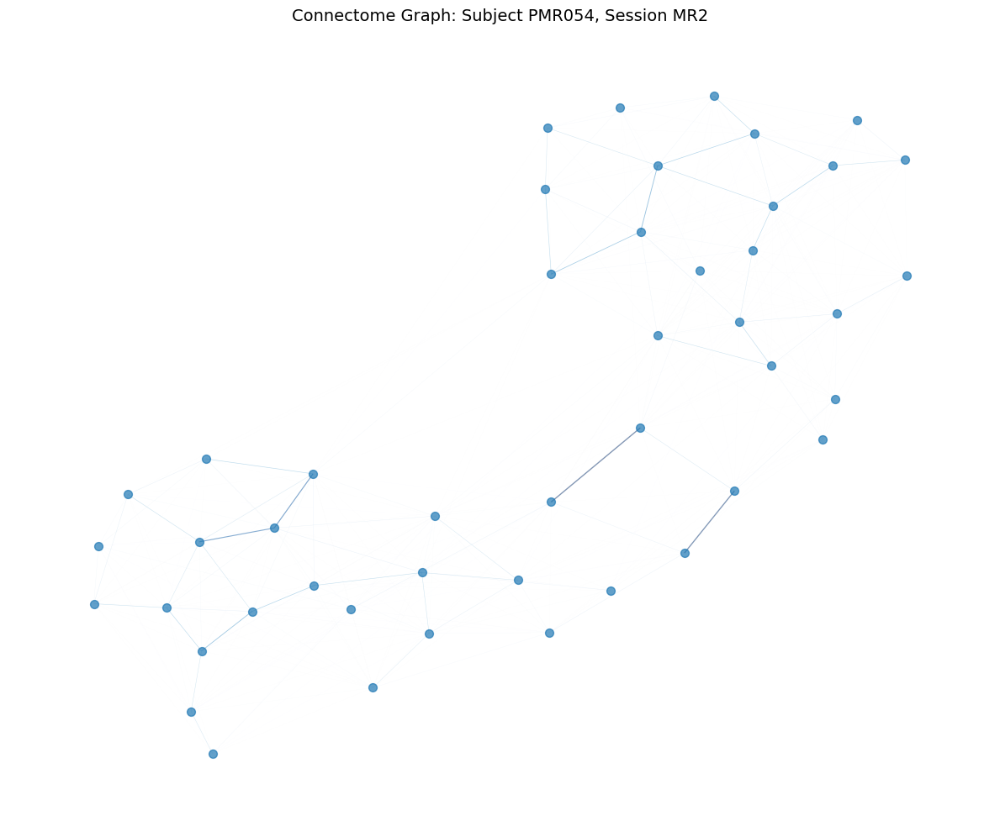

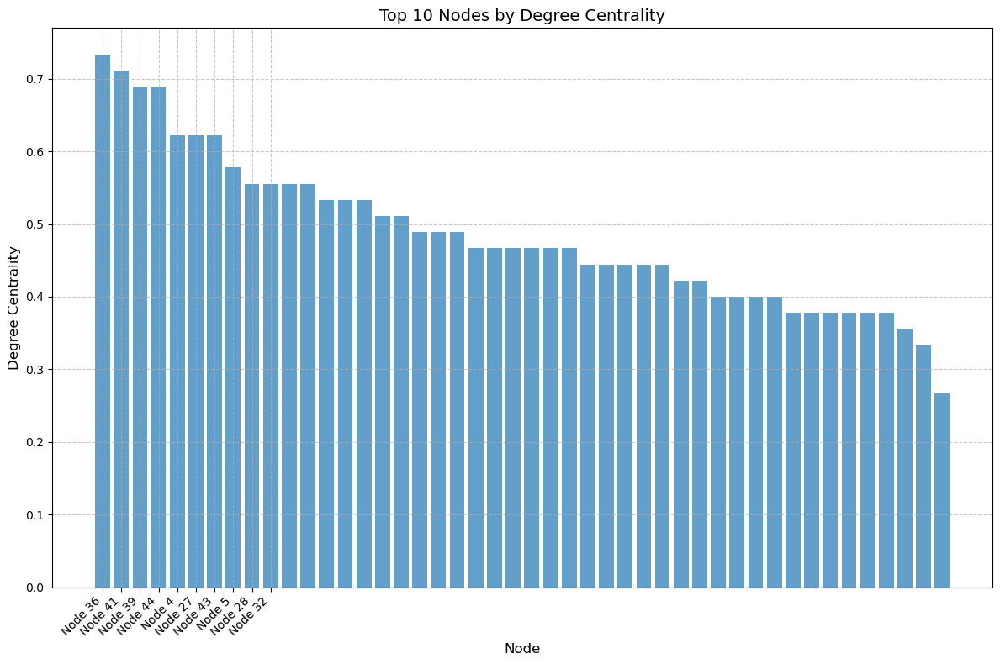

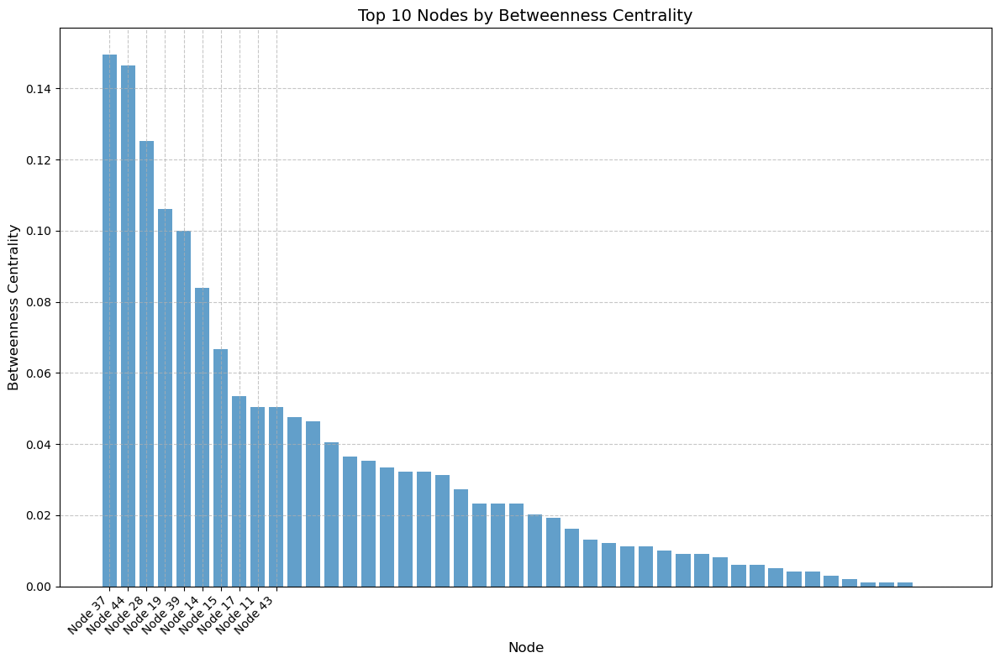

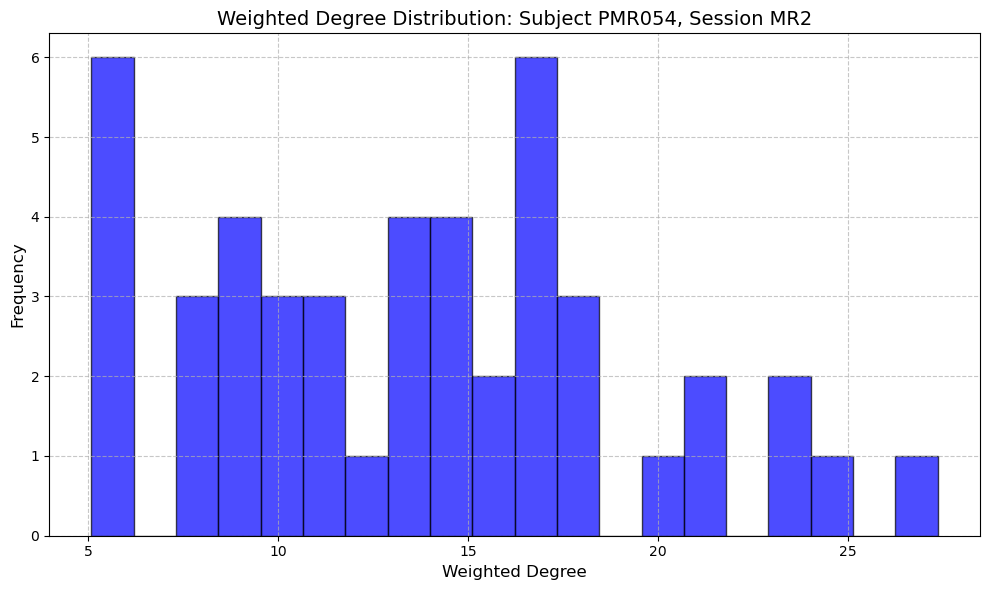

Processing connectome for subject PMR002, session MR2

Visualizations for subject PMR002, session MR2:


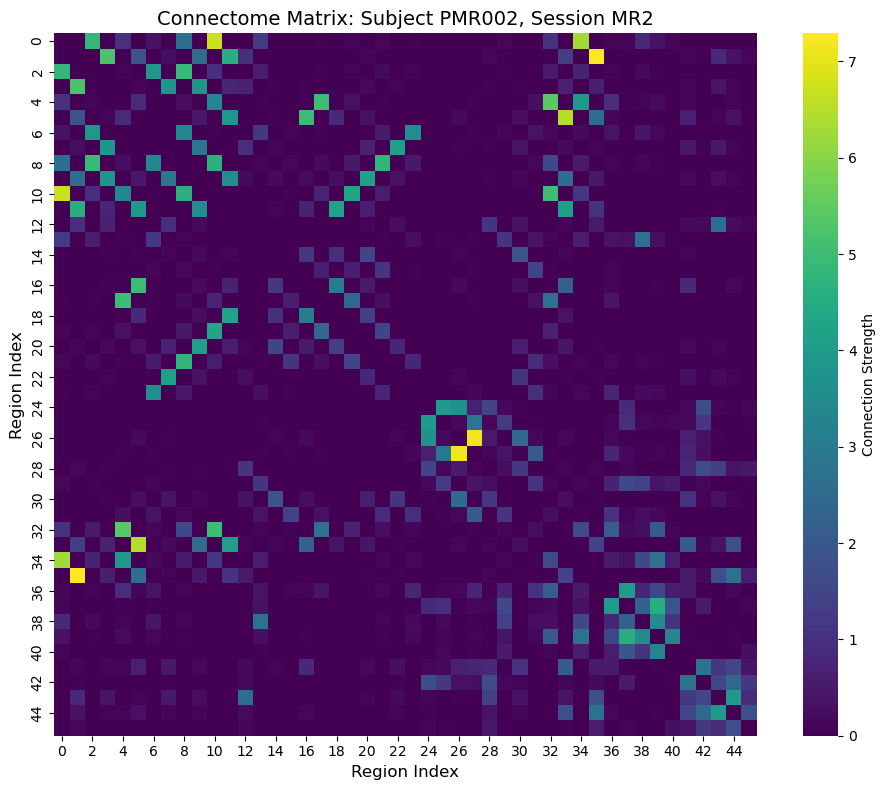

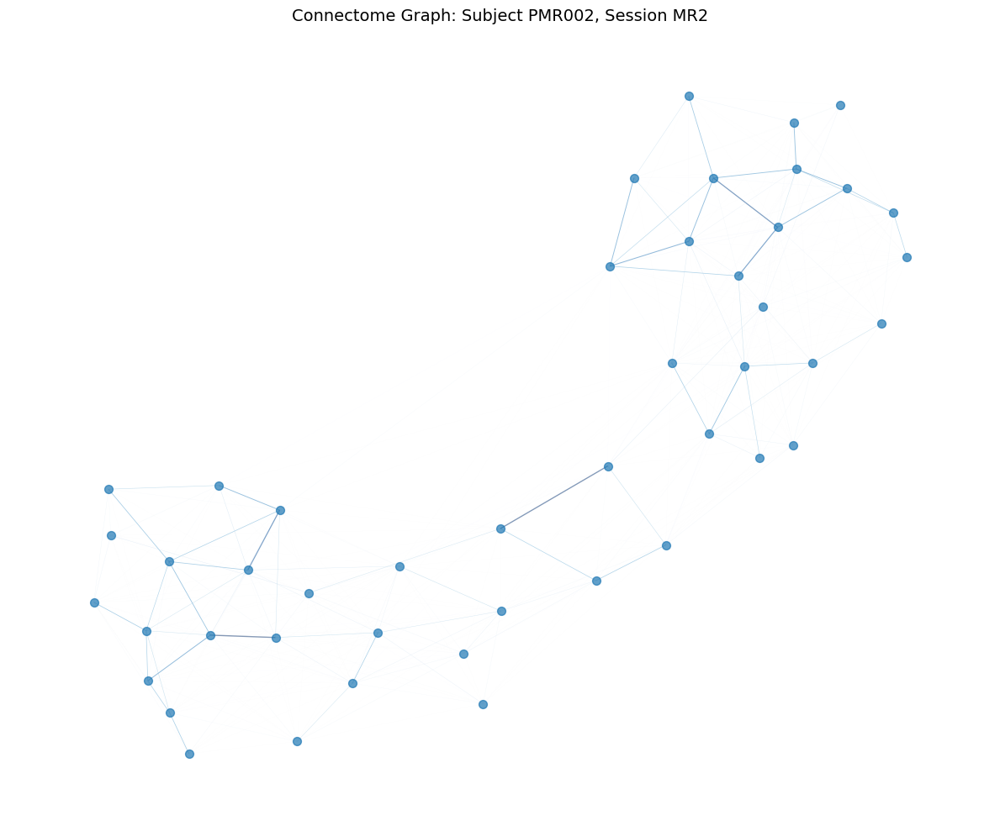

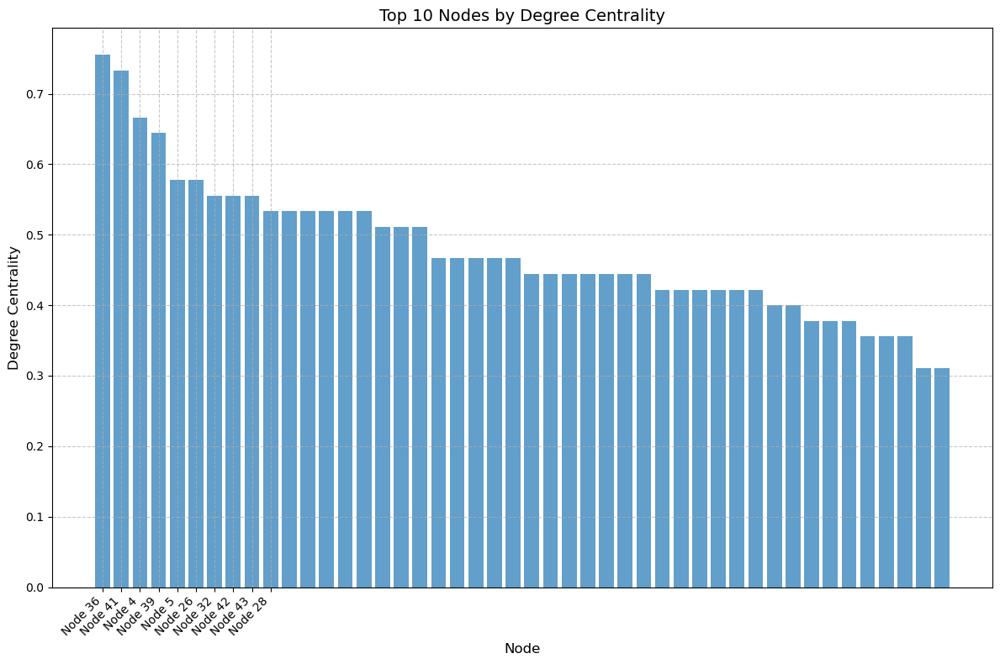

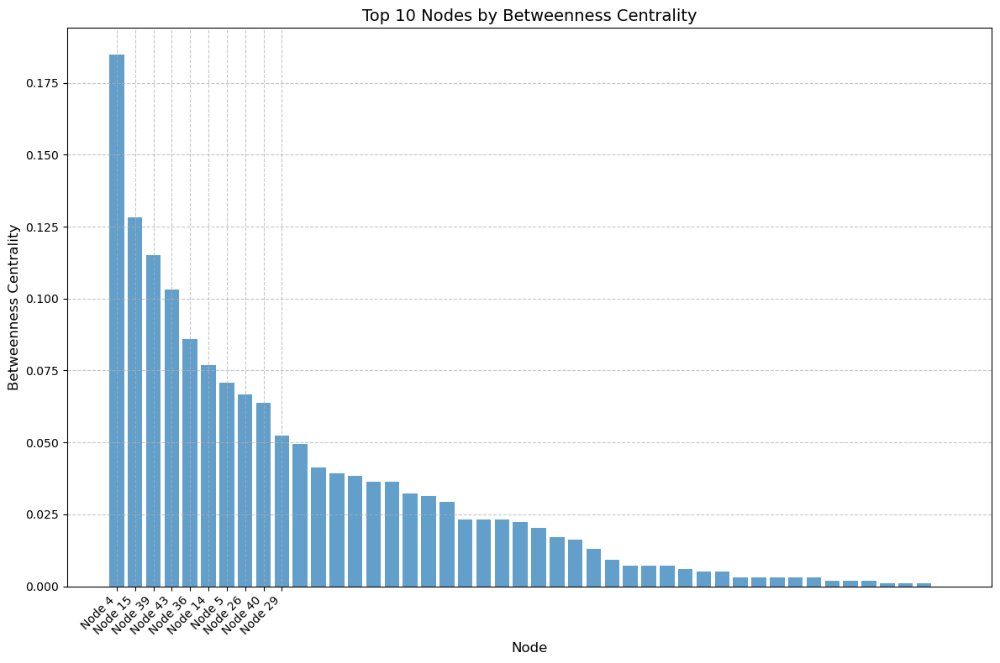

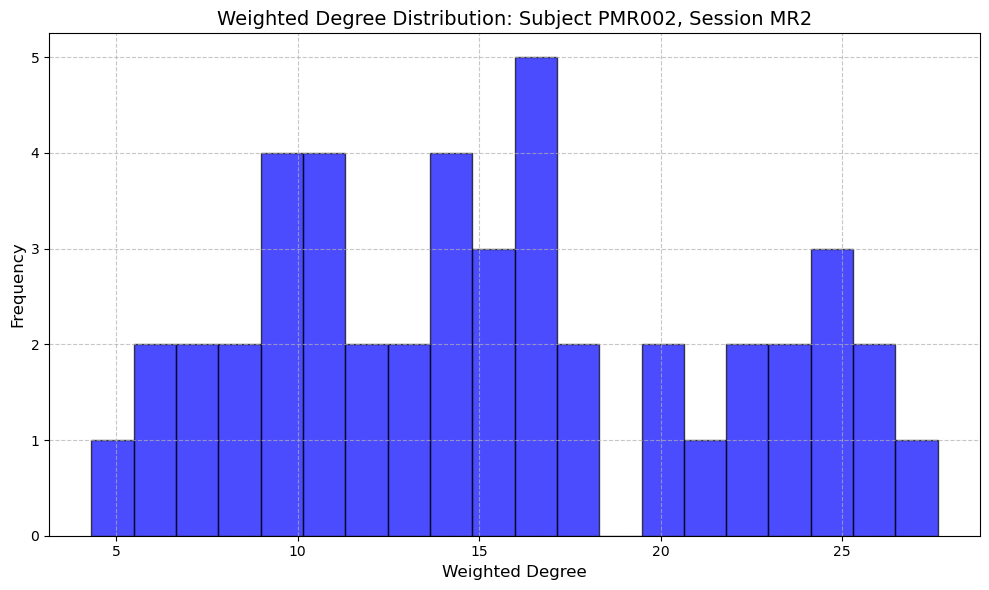

Processing connectome for subject PMR096, session MR2

Visualizations for subject PMR096, session MR2:


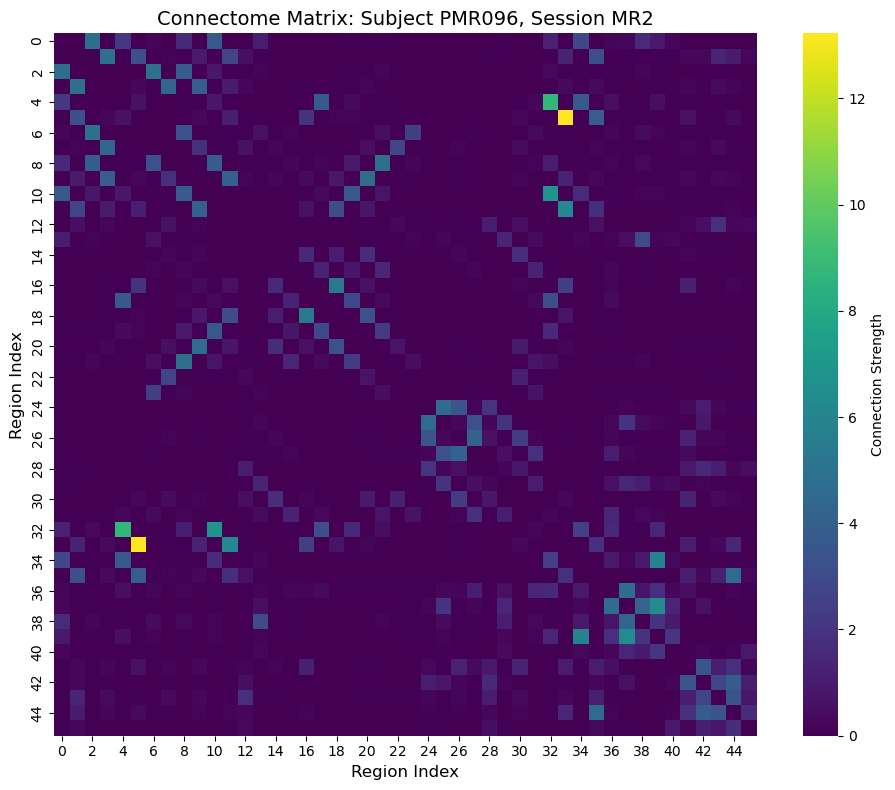

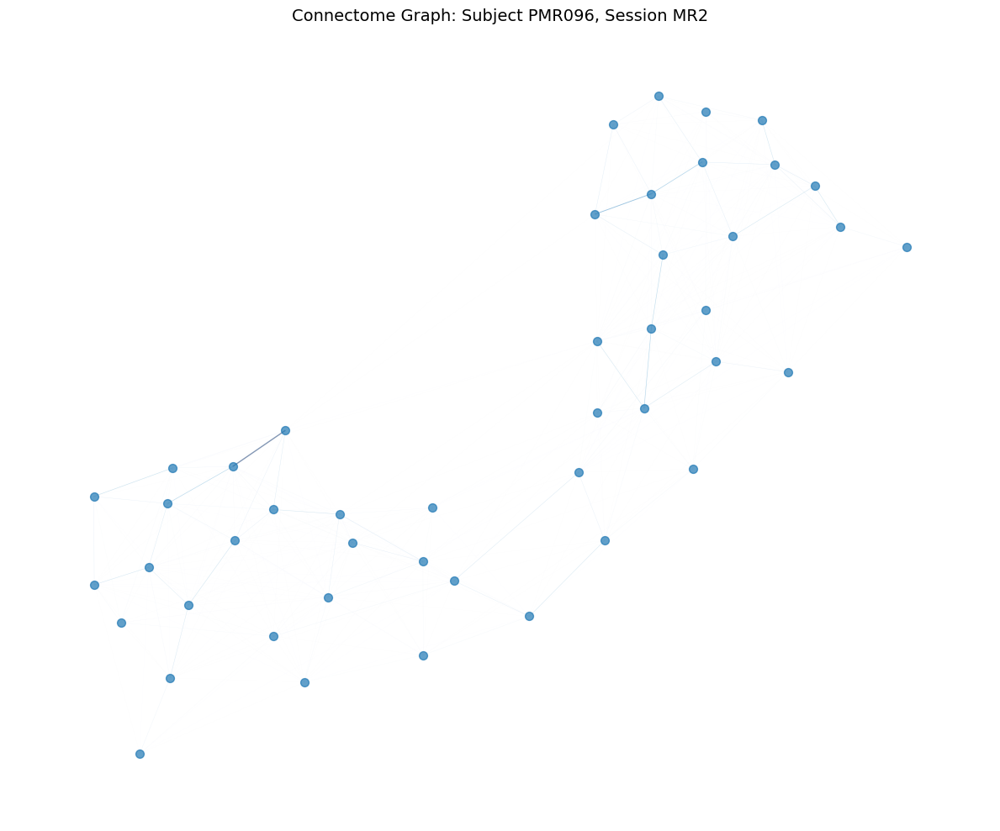

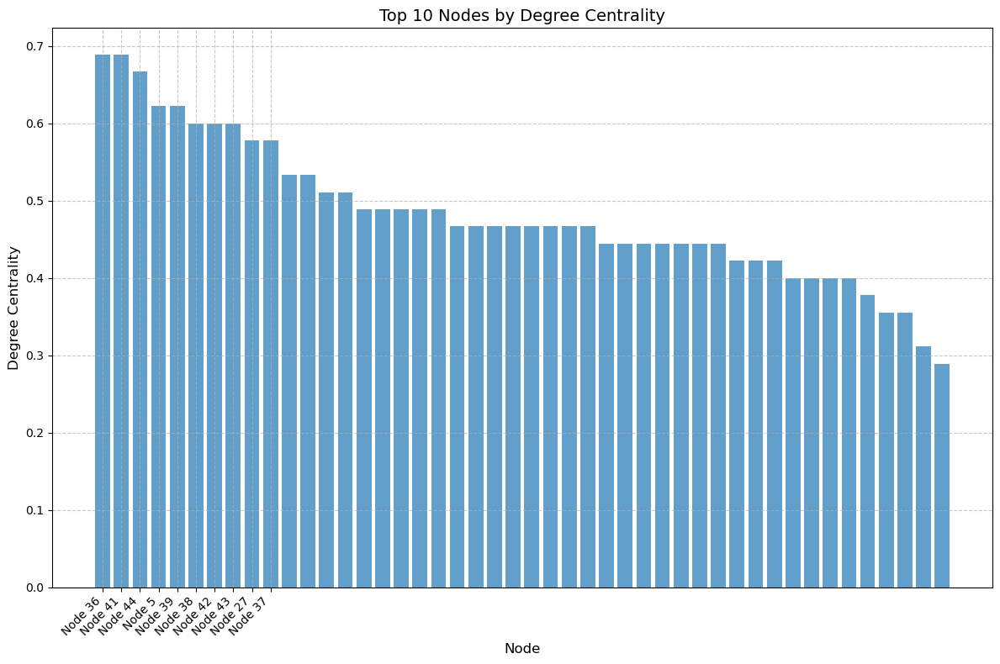

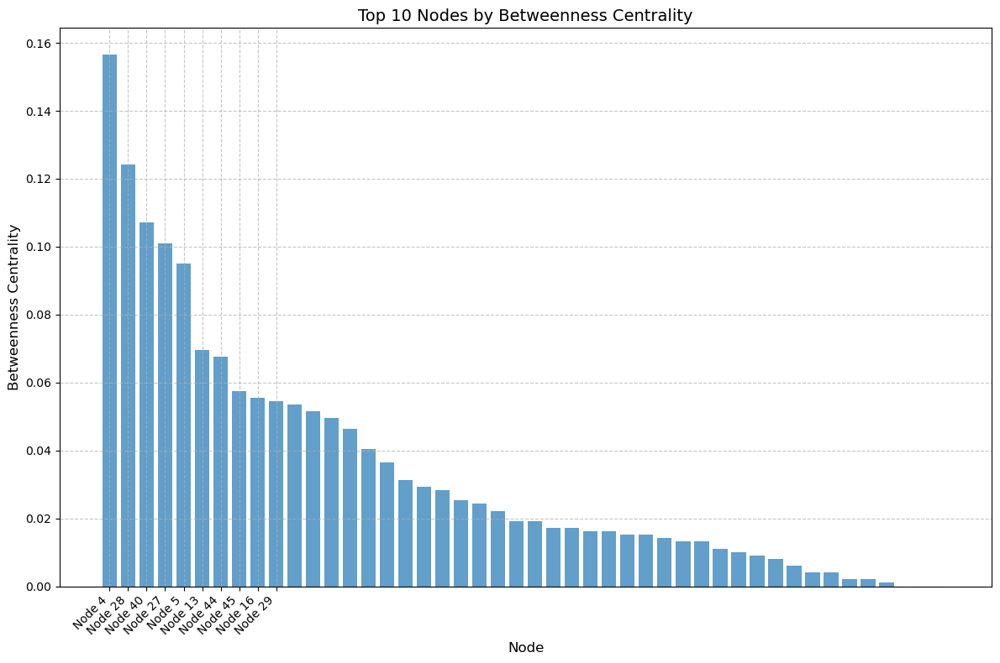

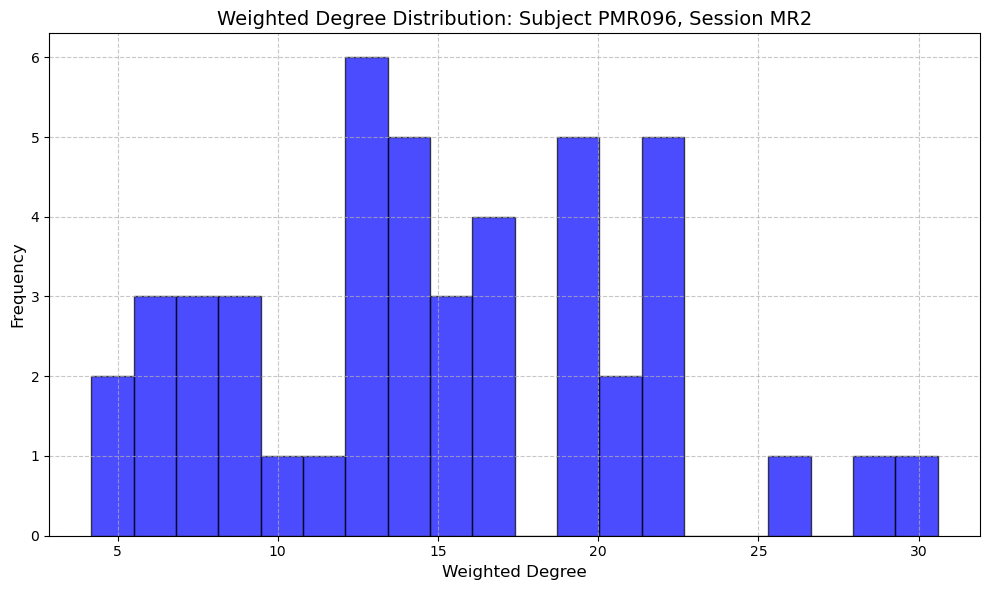

Processing connectome for subject PMR033, session MR2

Visualizations for subject PMR033, session MR2:


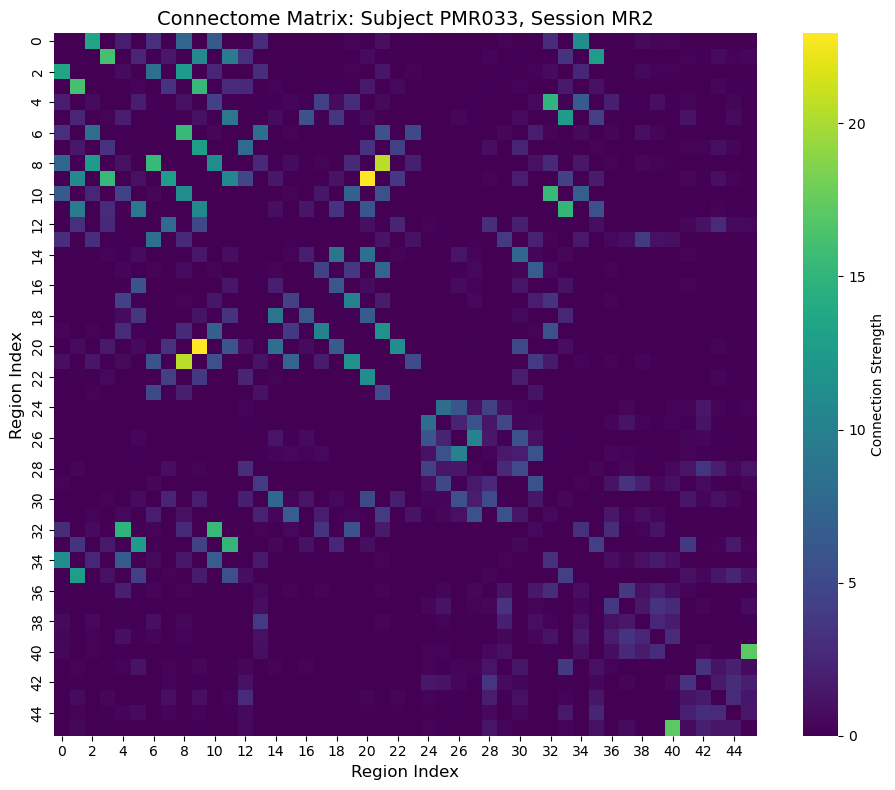

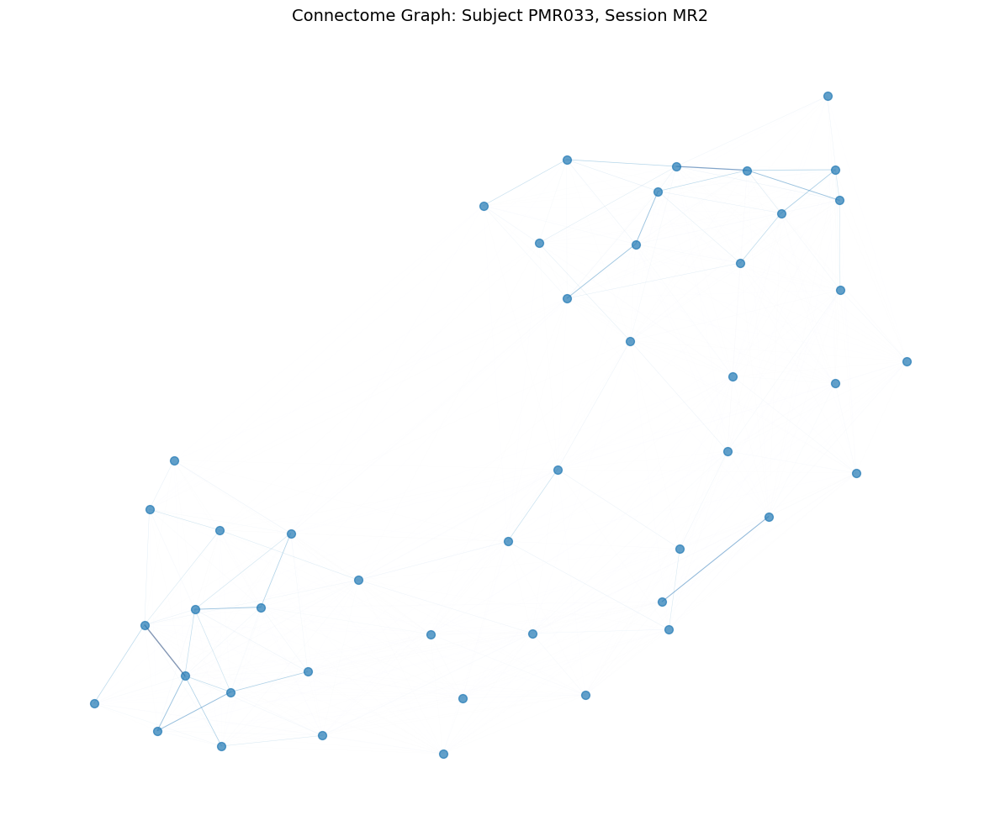

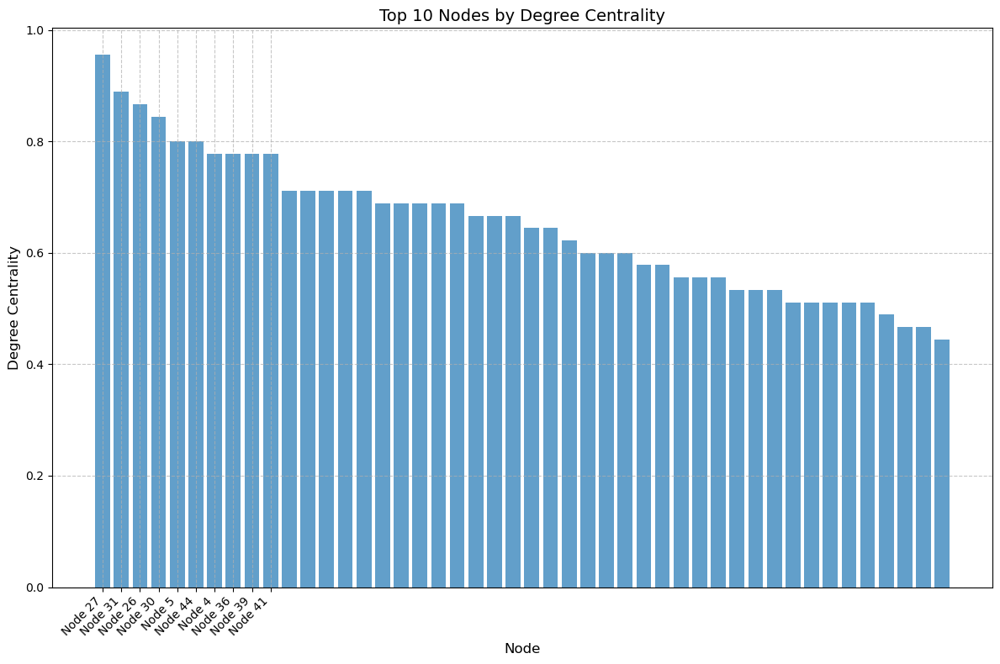

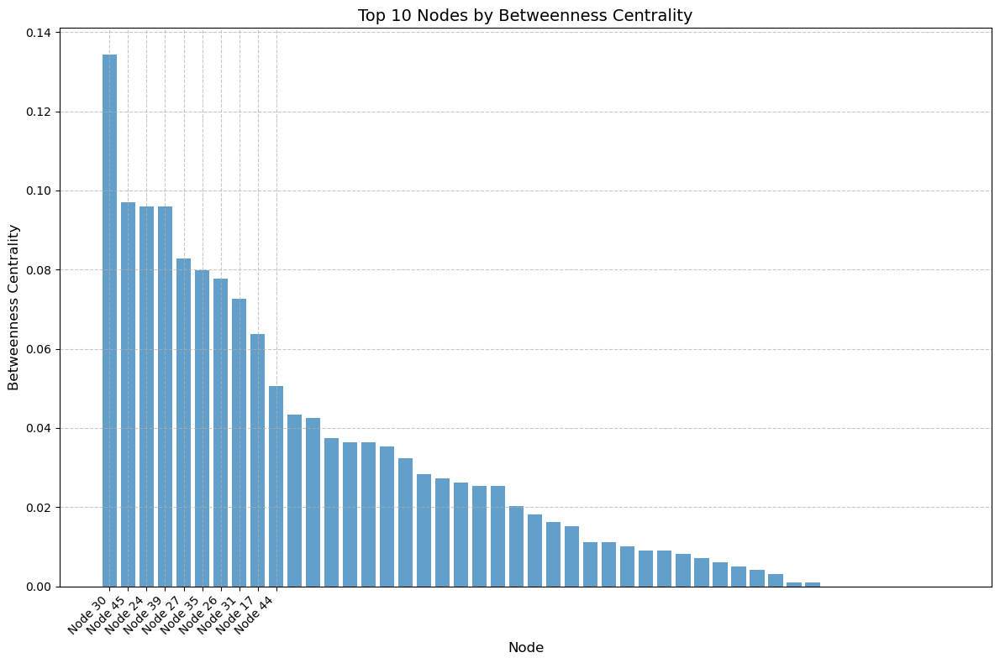

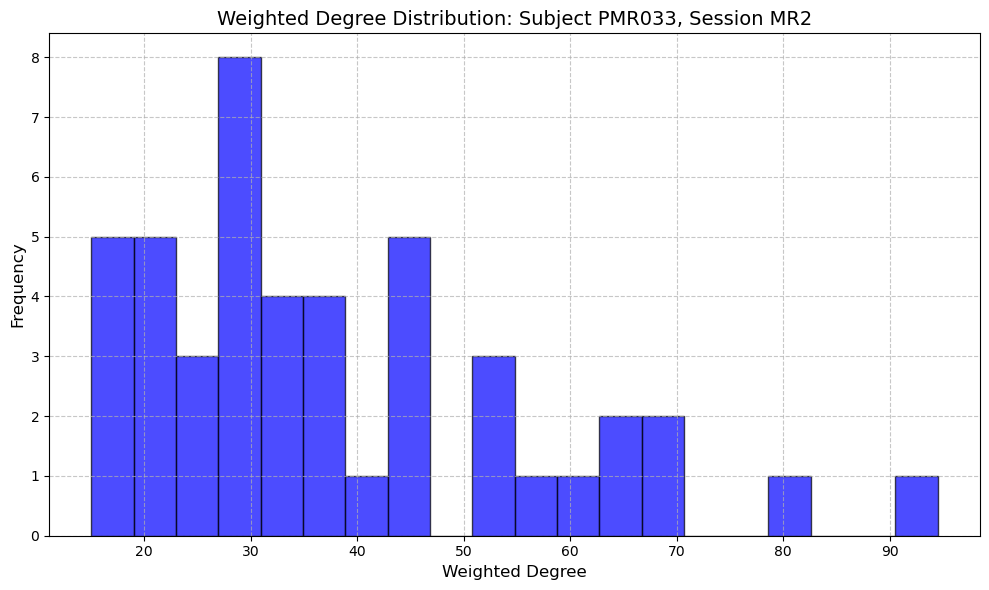

Processing connectome for subject PMR087, session MR2

Visualizations for subject PMR087, session MR2:


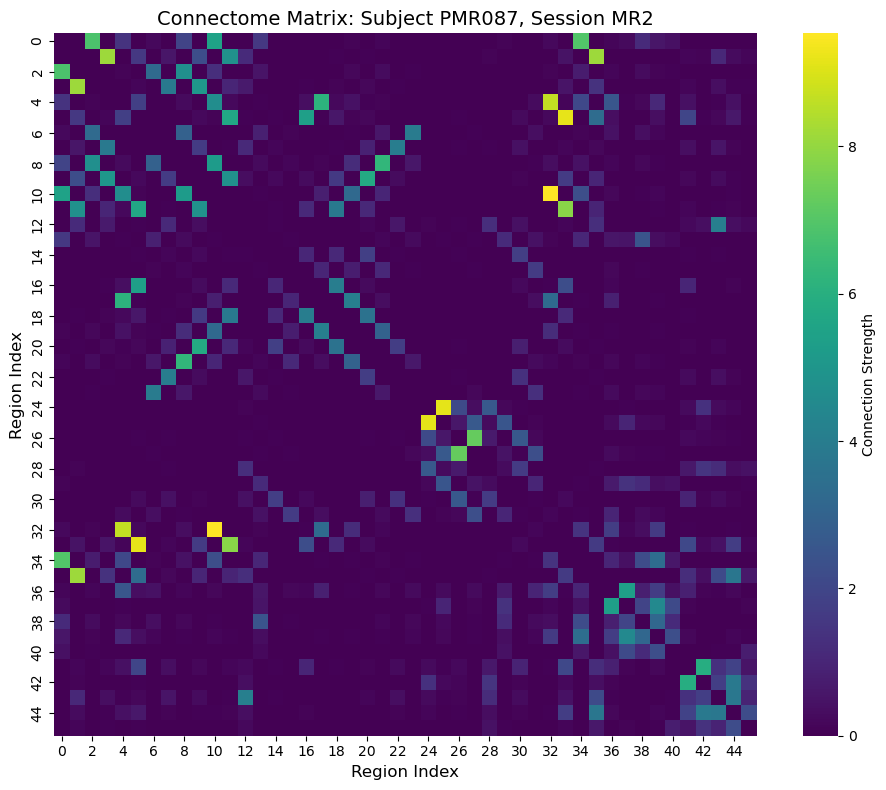

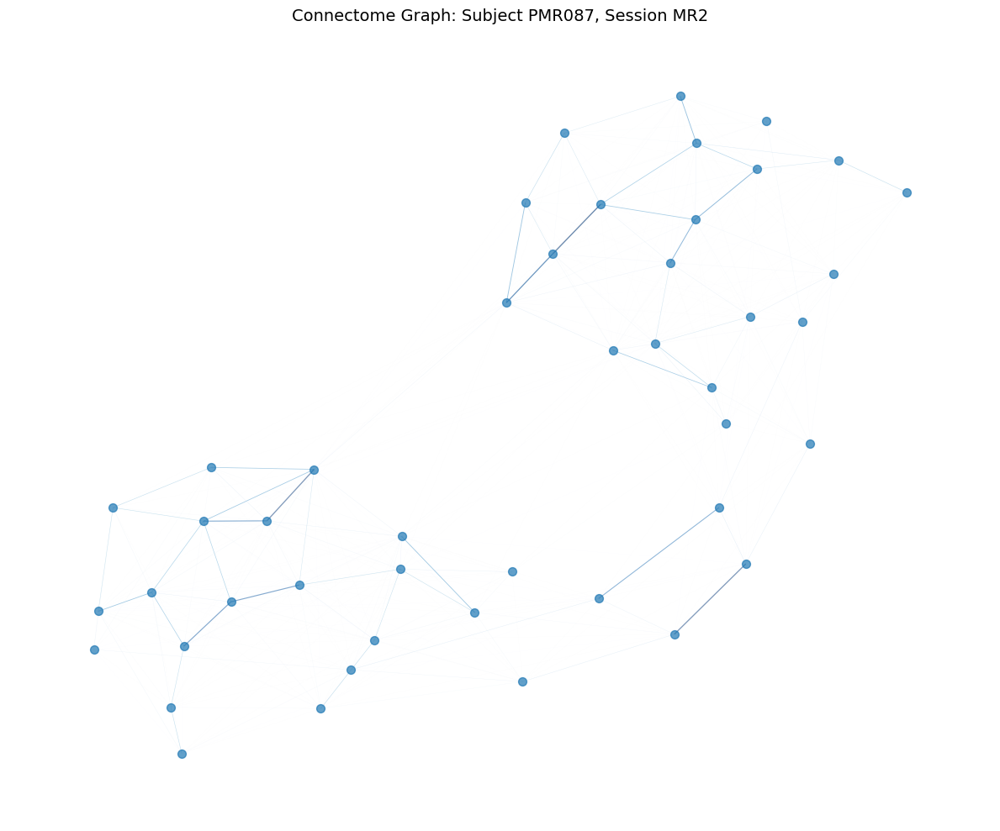

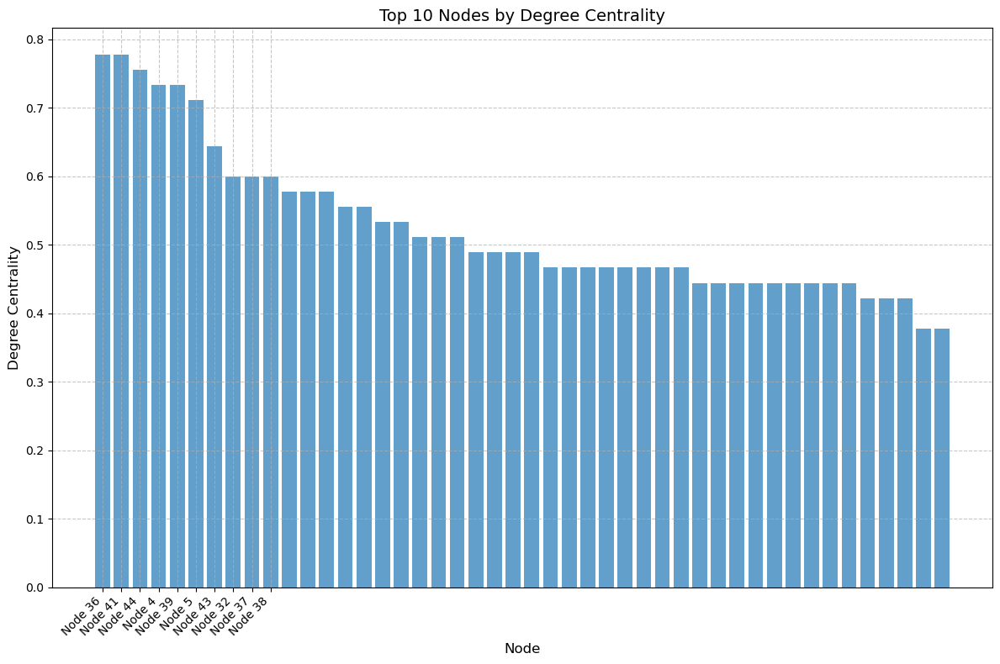

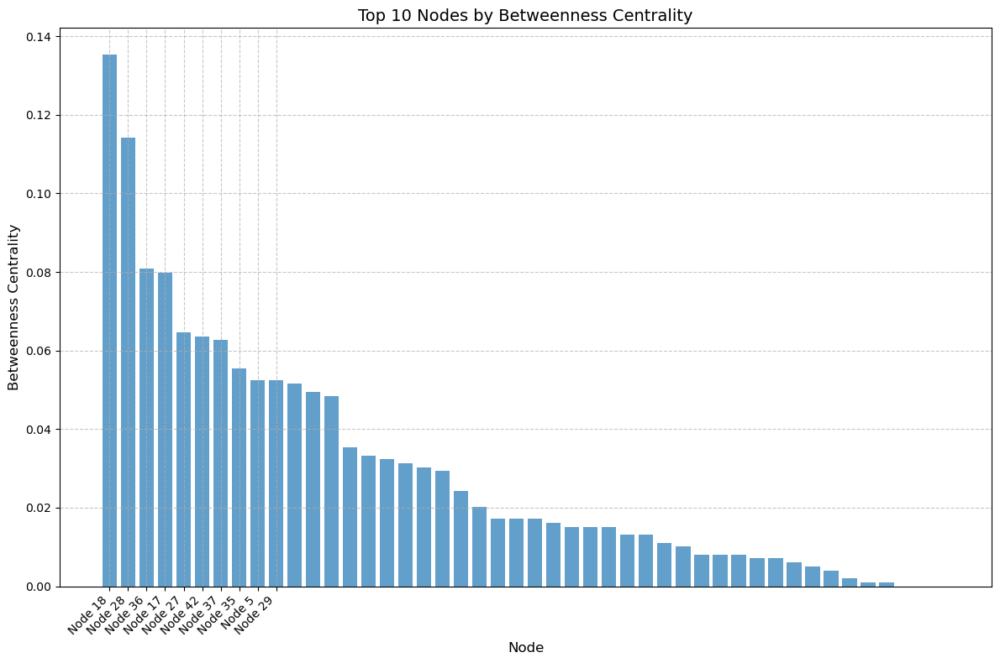

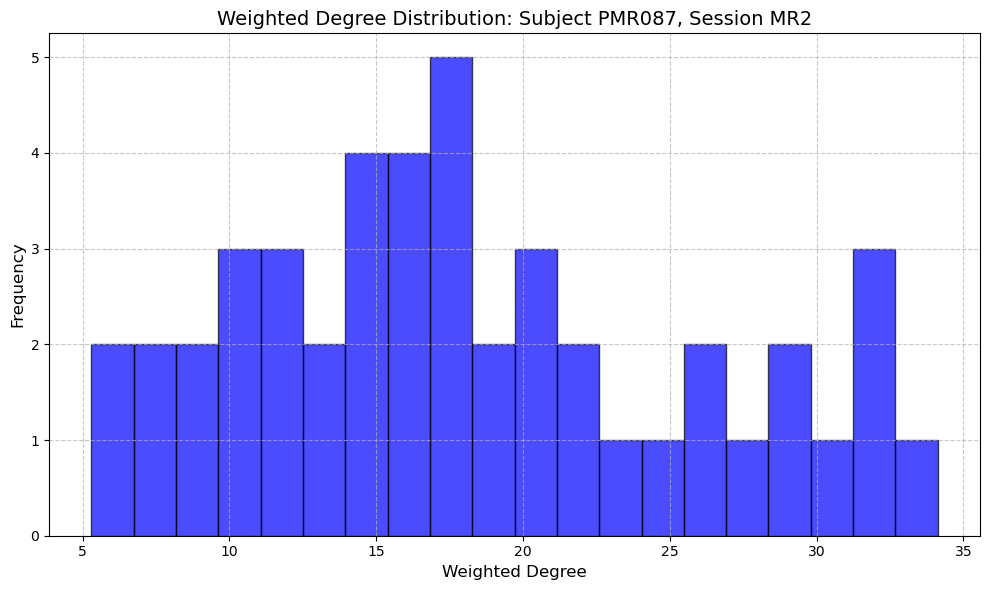

Processing connectome for subject PMR052, session MR2

Visualizations for subject PMR052, session MR2:


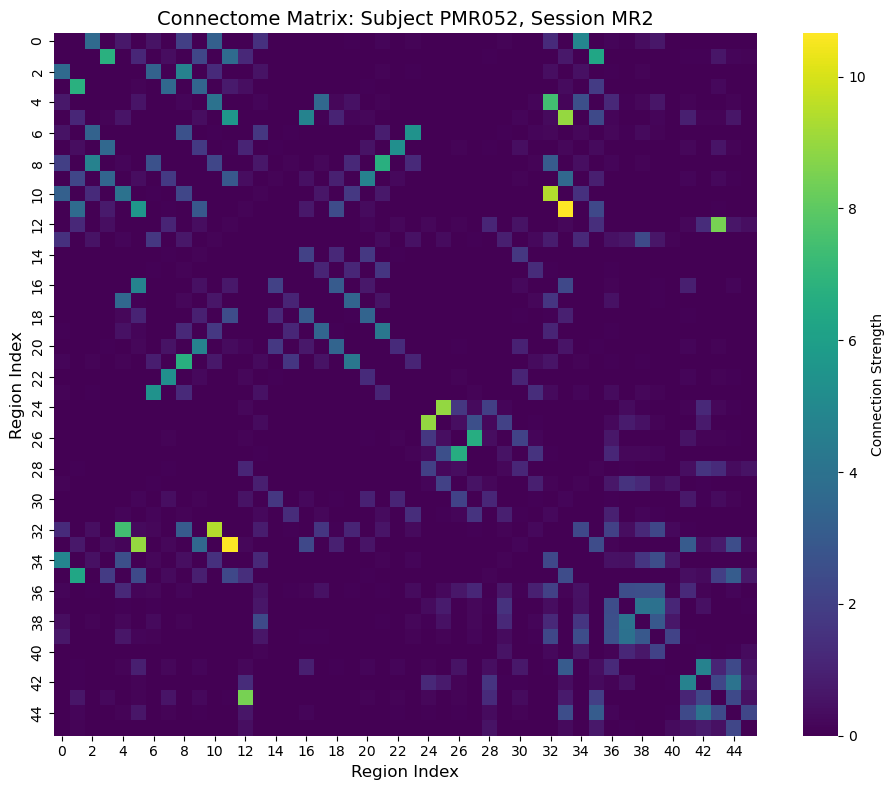

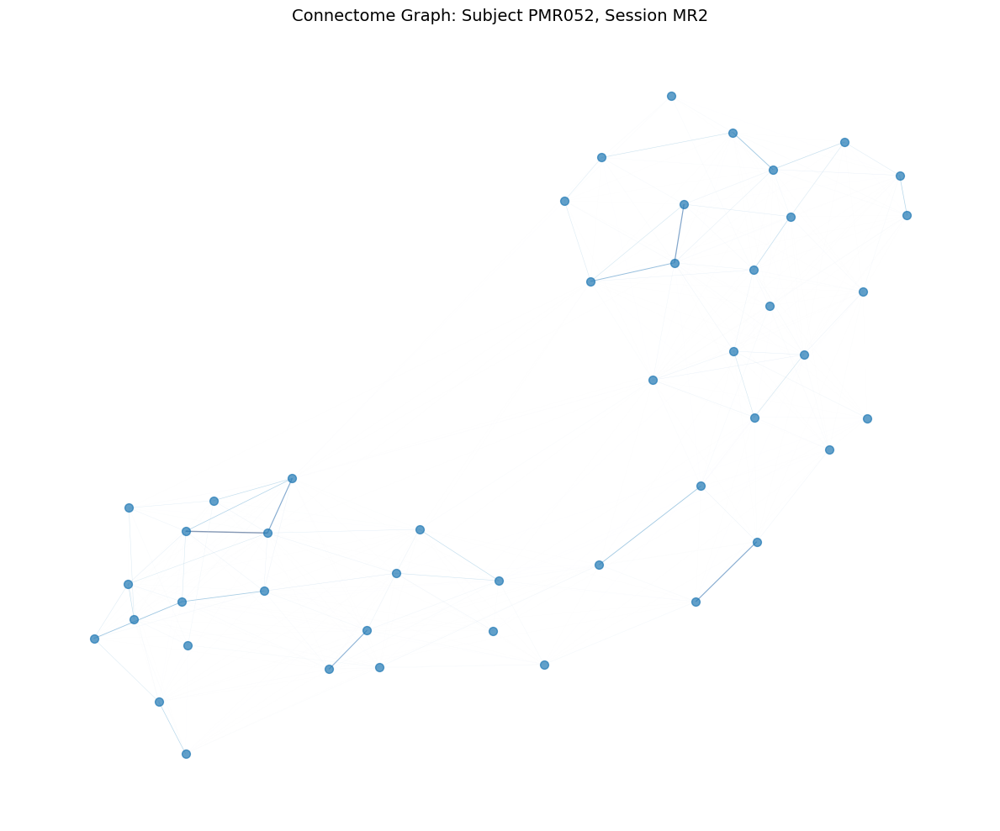

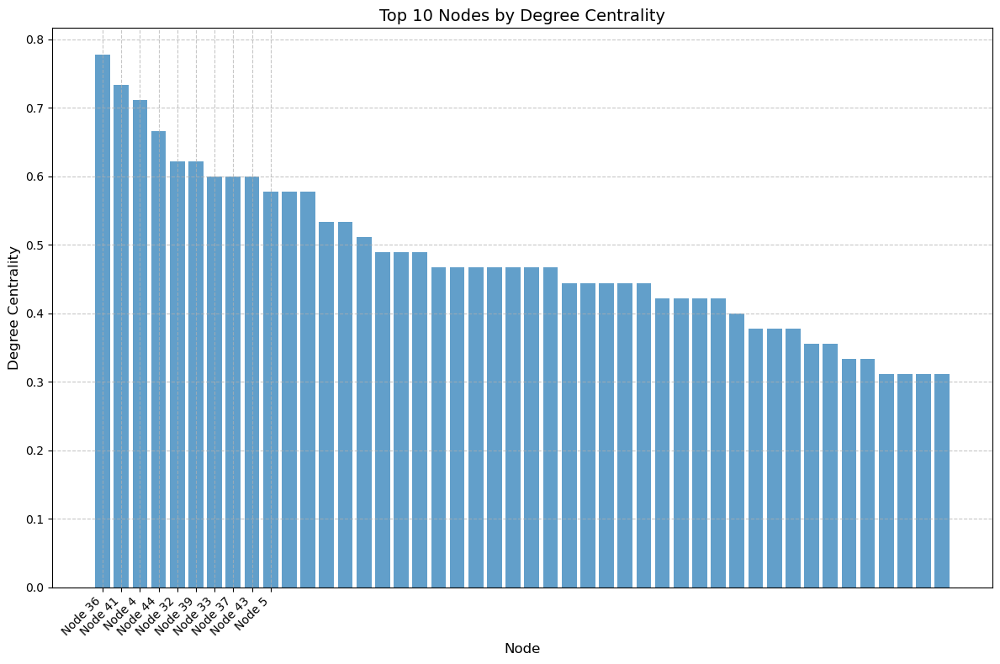

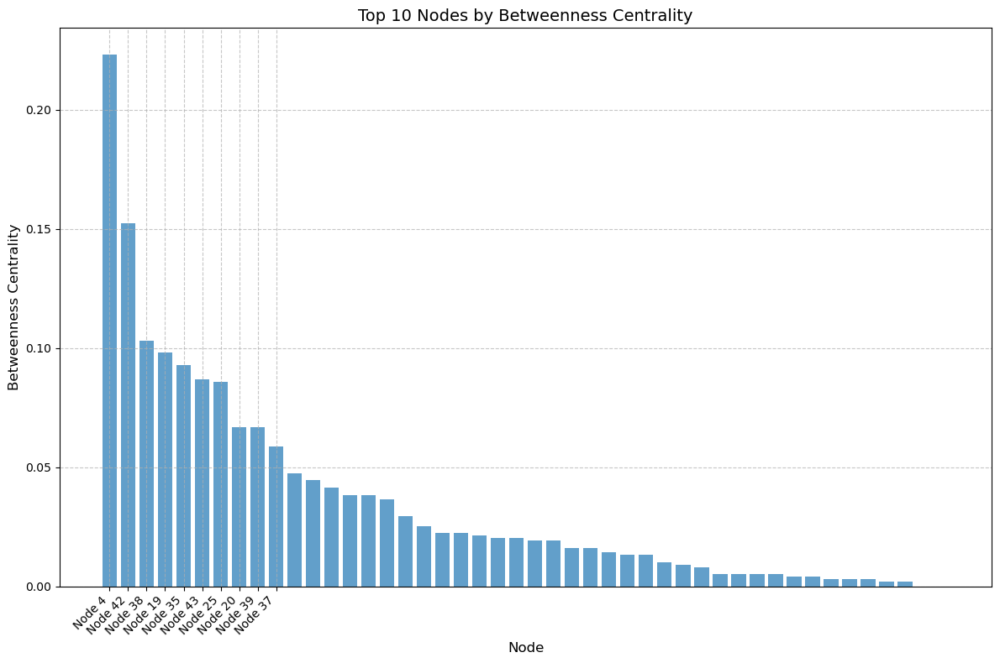

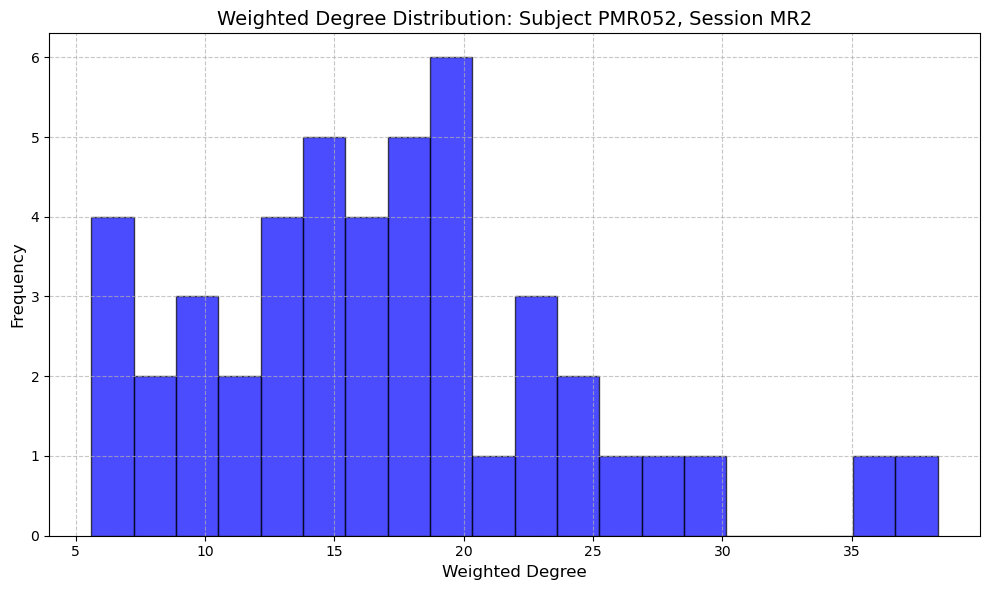

Processing connectome for subject PMR004, session MR2

Visualizations for subject PMR004, session MR2:


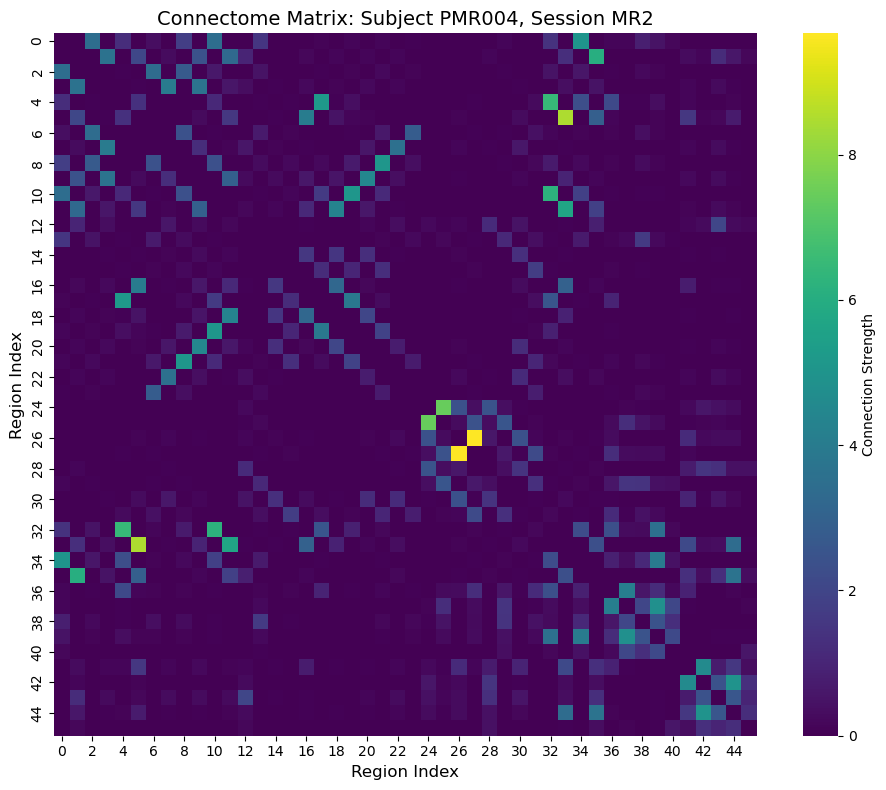

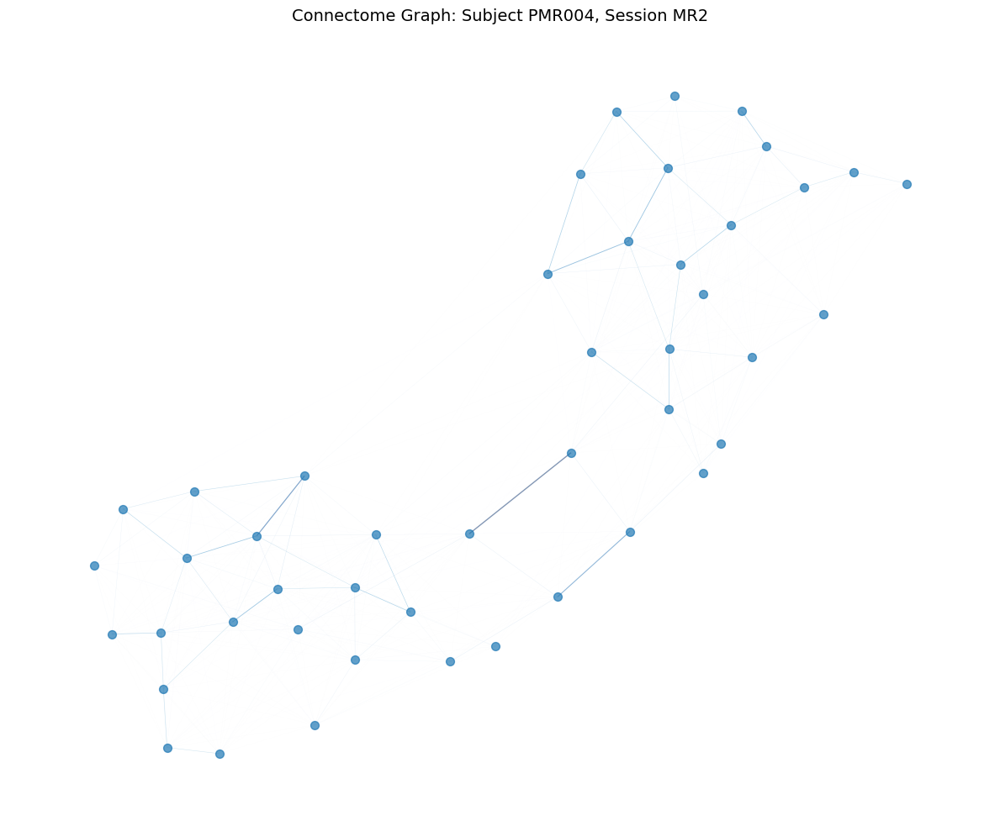

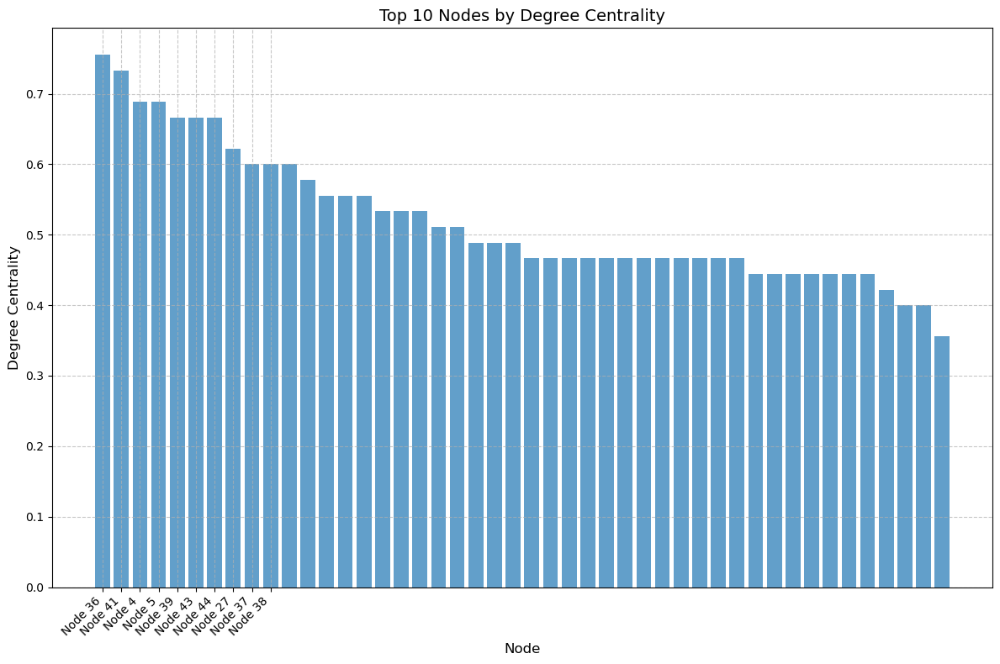

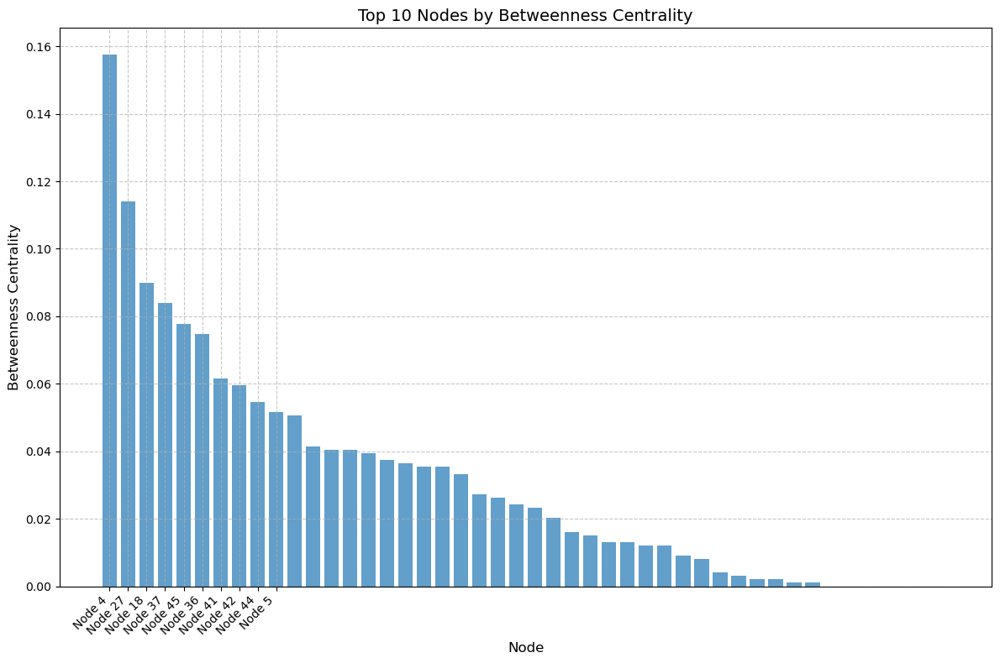

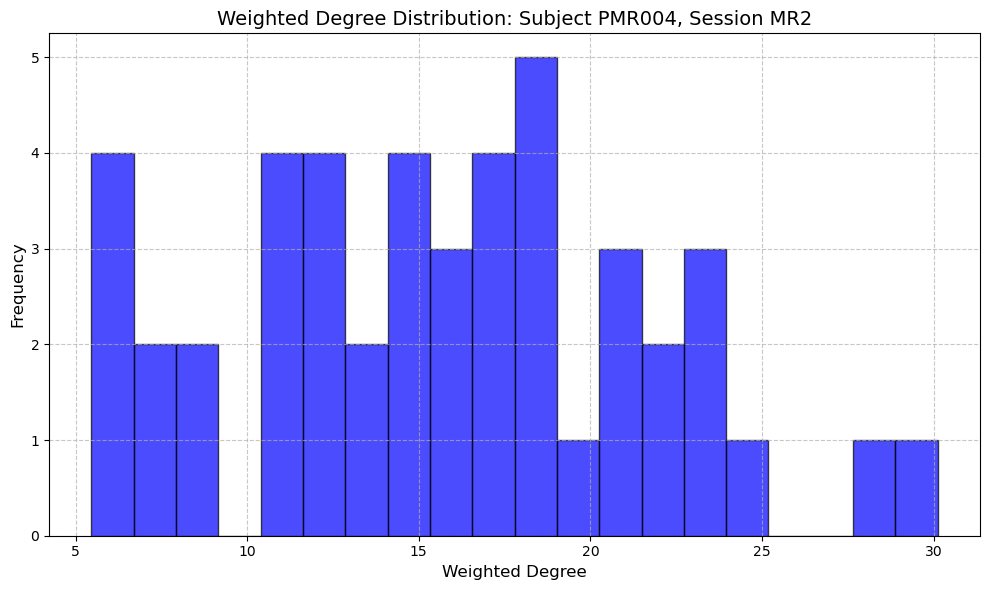

Processing connectome for subject PMR016, session MR2

Visualizations for subject PMR016, session MR2:


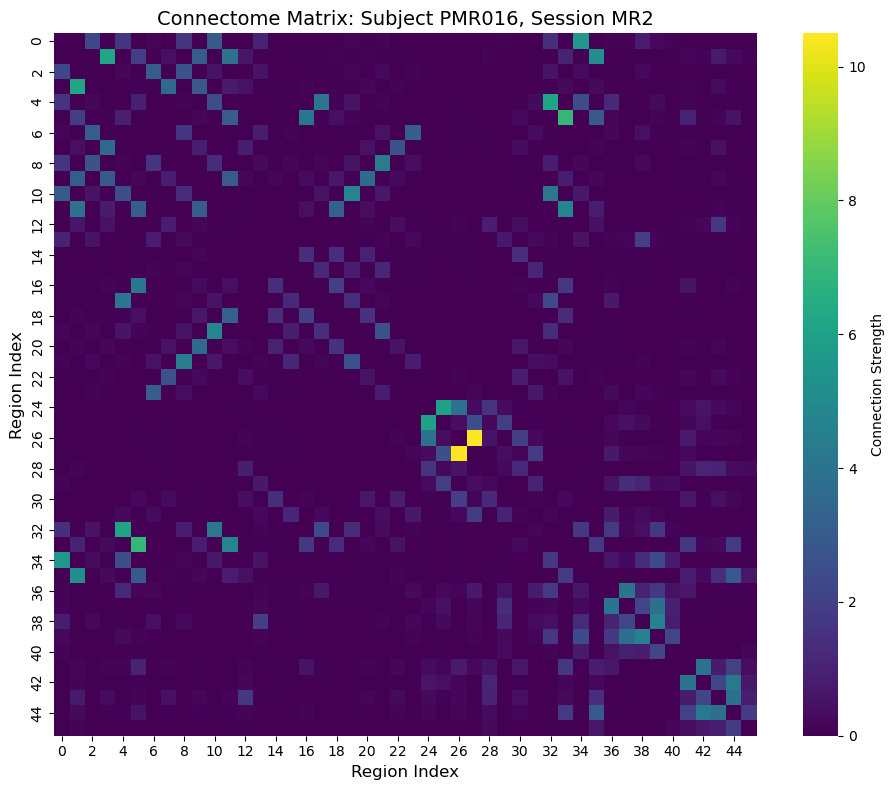

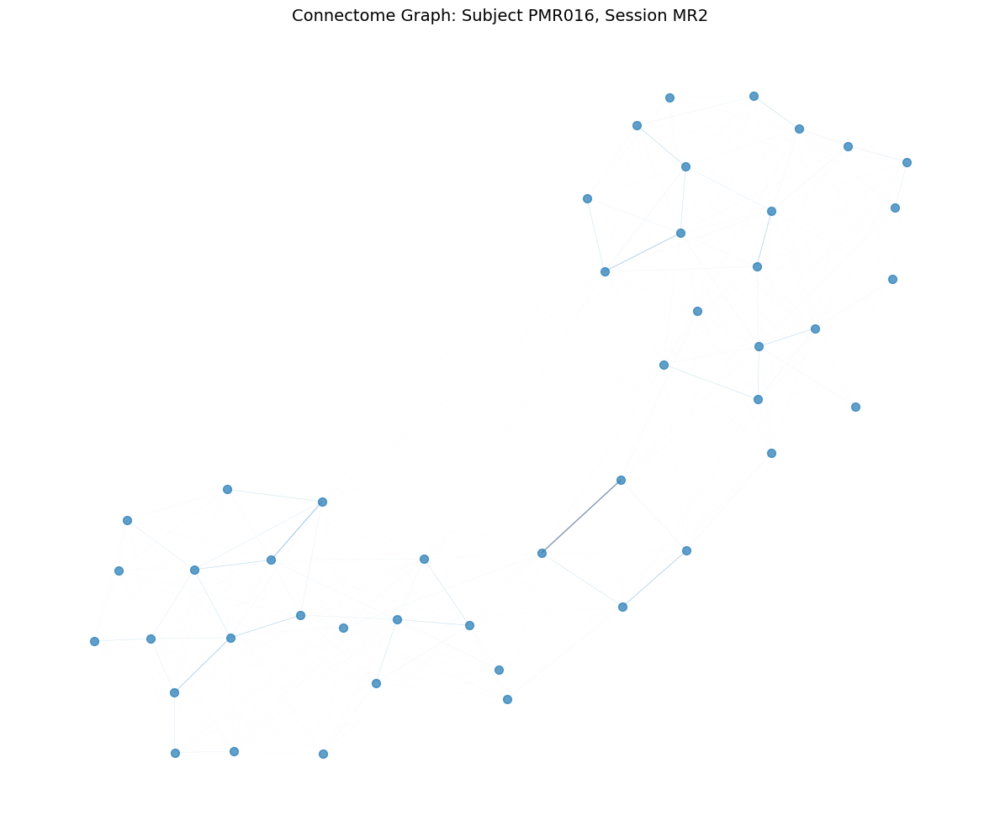

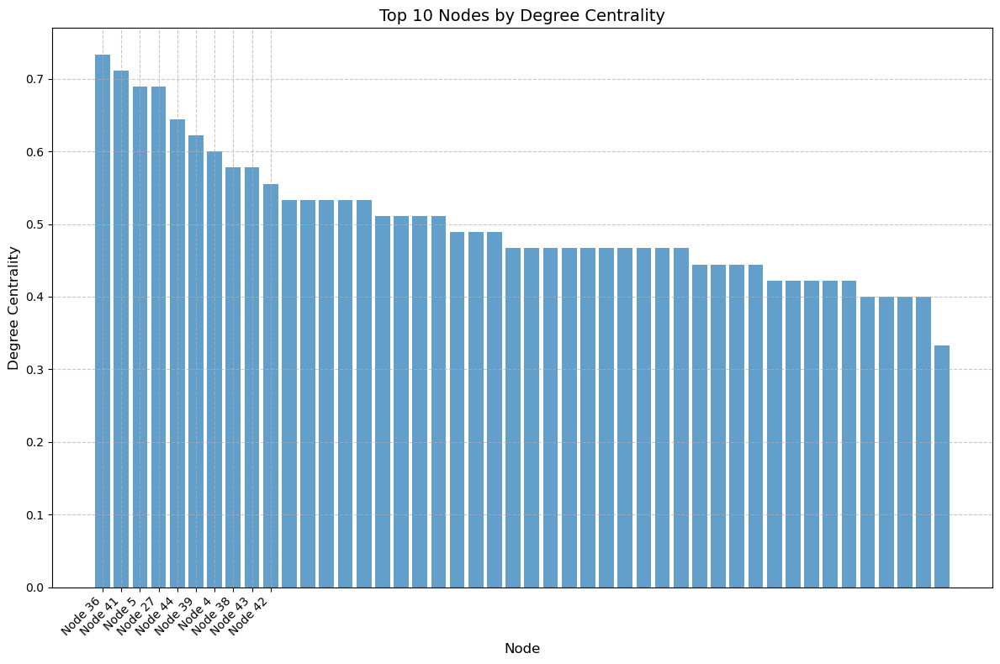

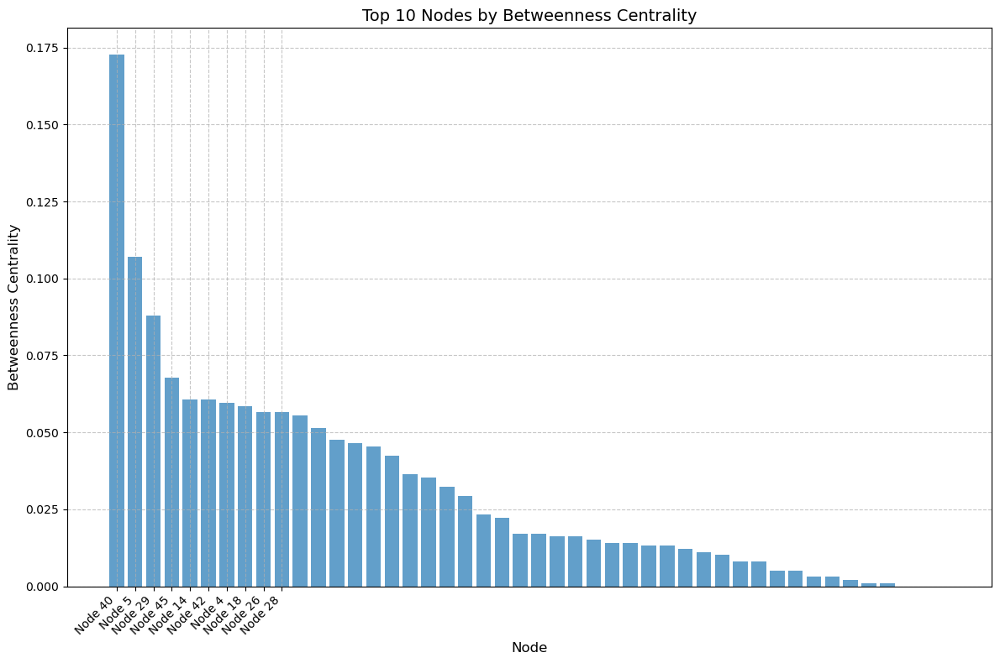

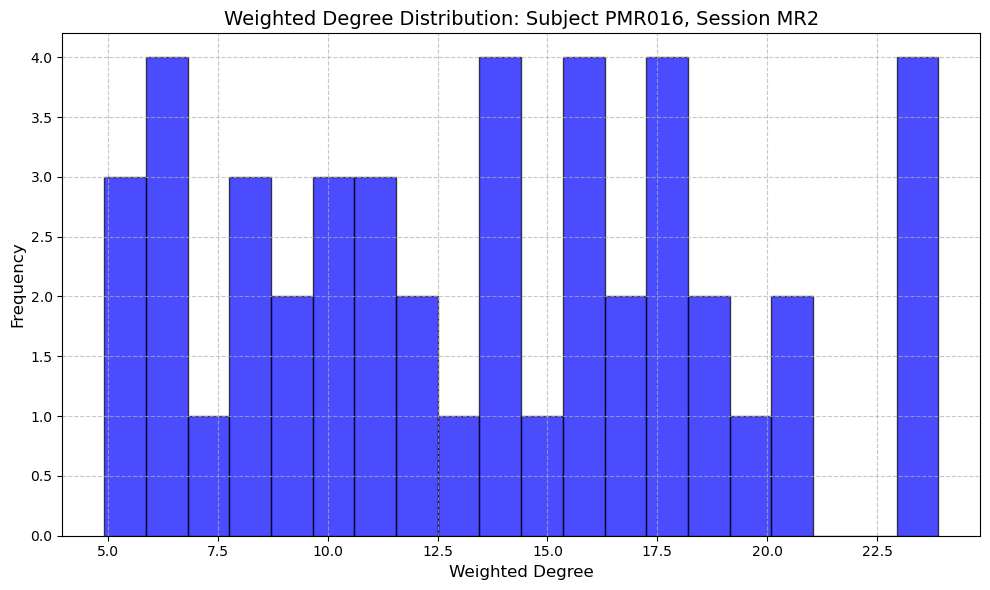

Processing connectome for subject PMR098, session MR2

Visualizations for subject PMR098, session MR2:


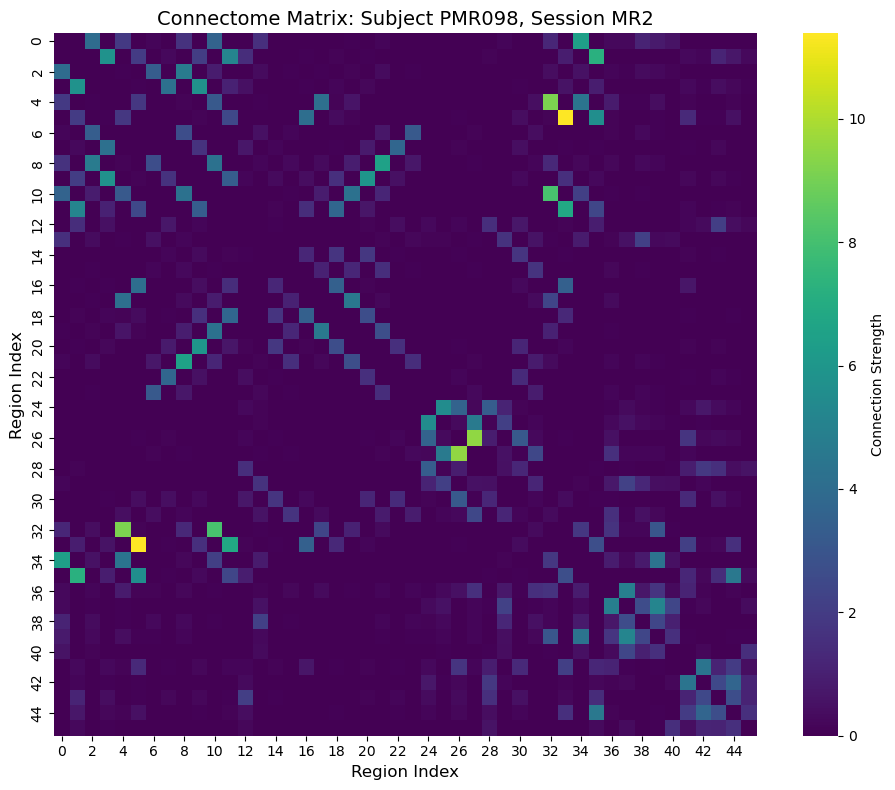

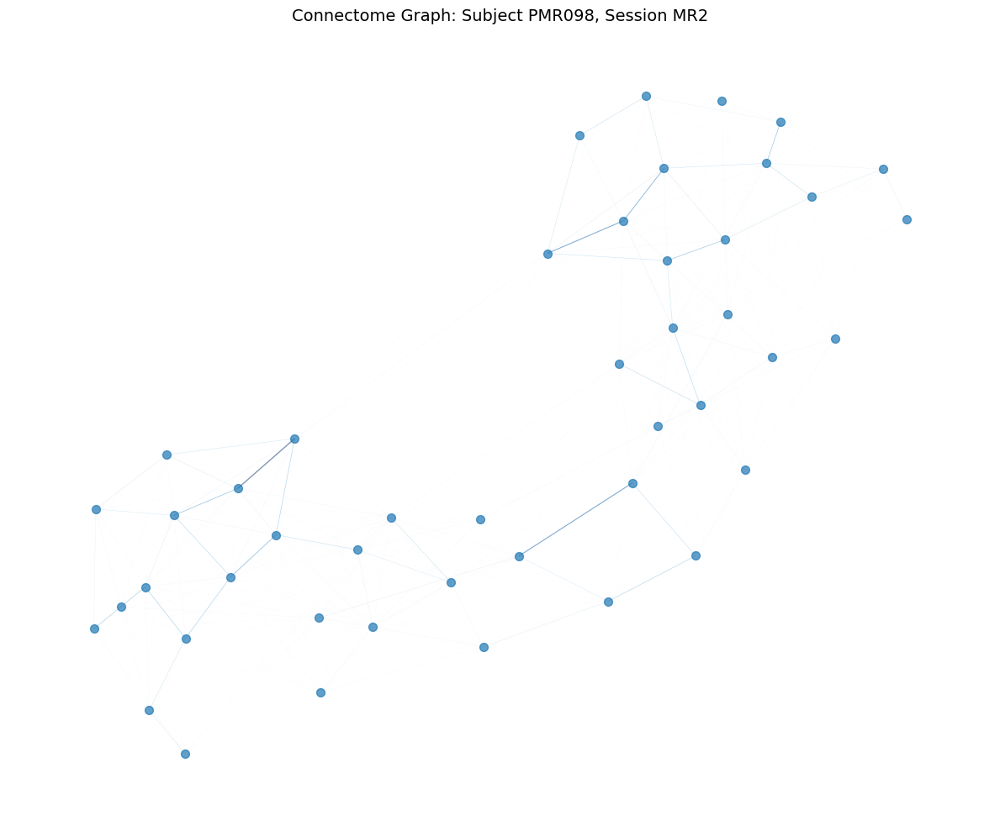

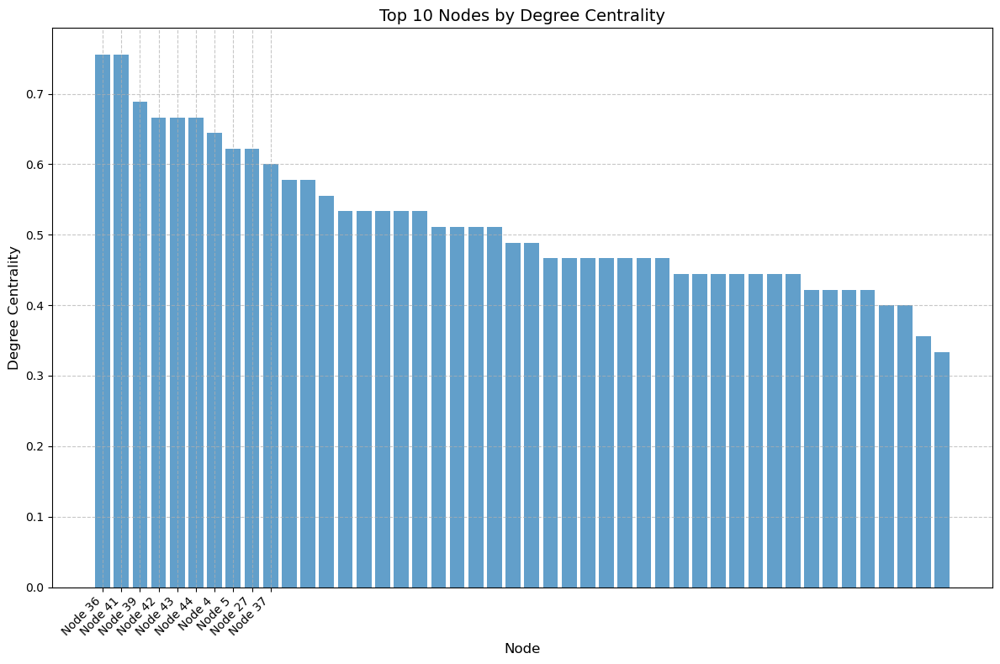

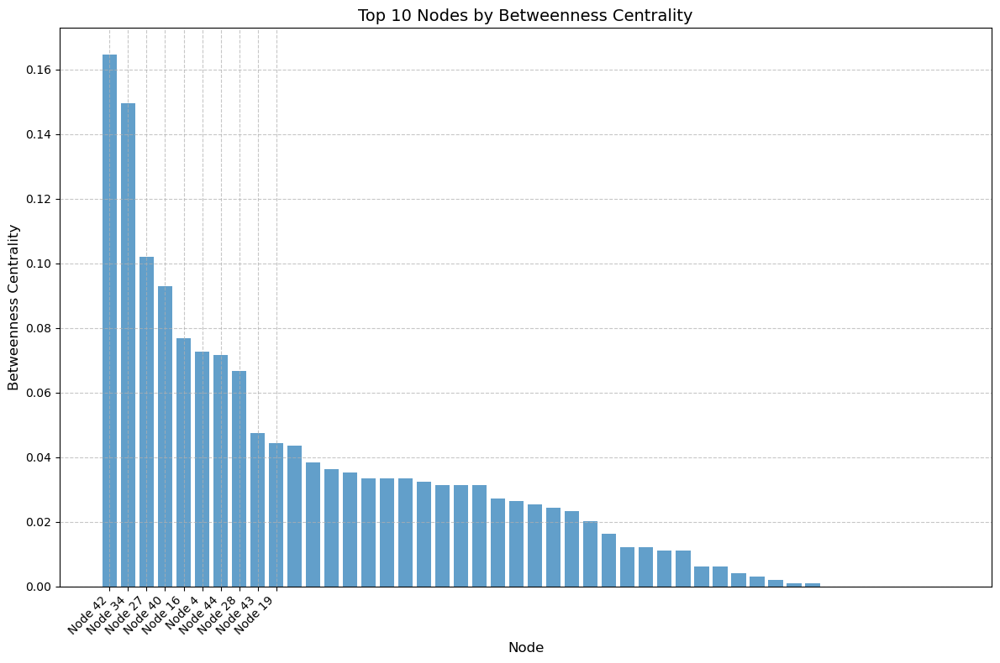

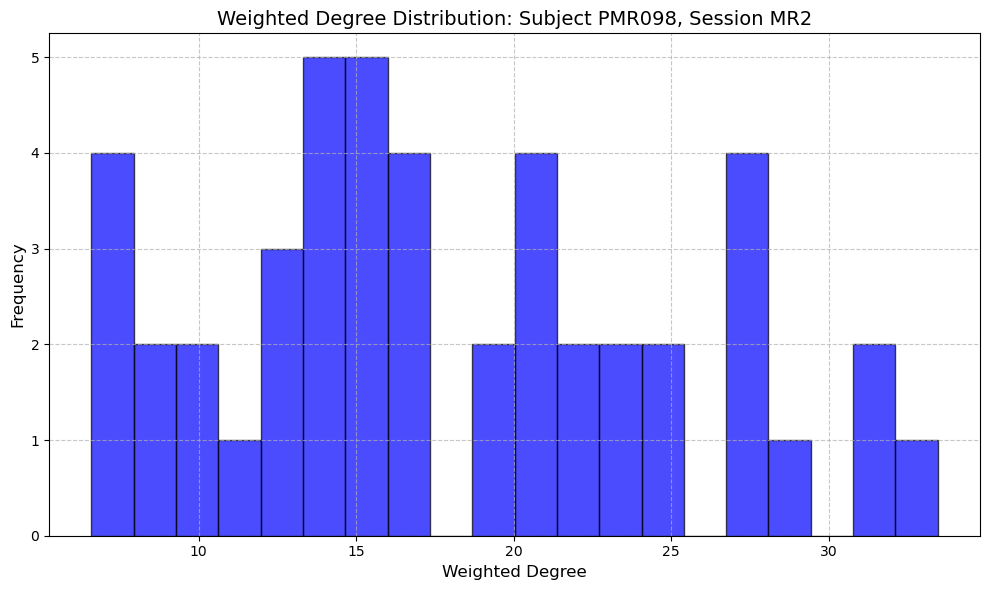

Processing connectome for subject PMR014, session MR2

Visualizations for subject PMR014, session MR2:


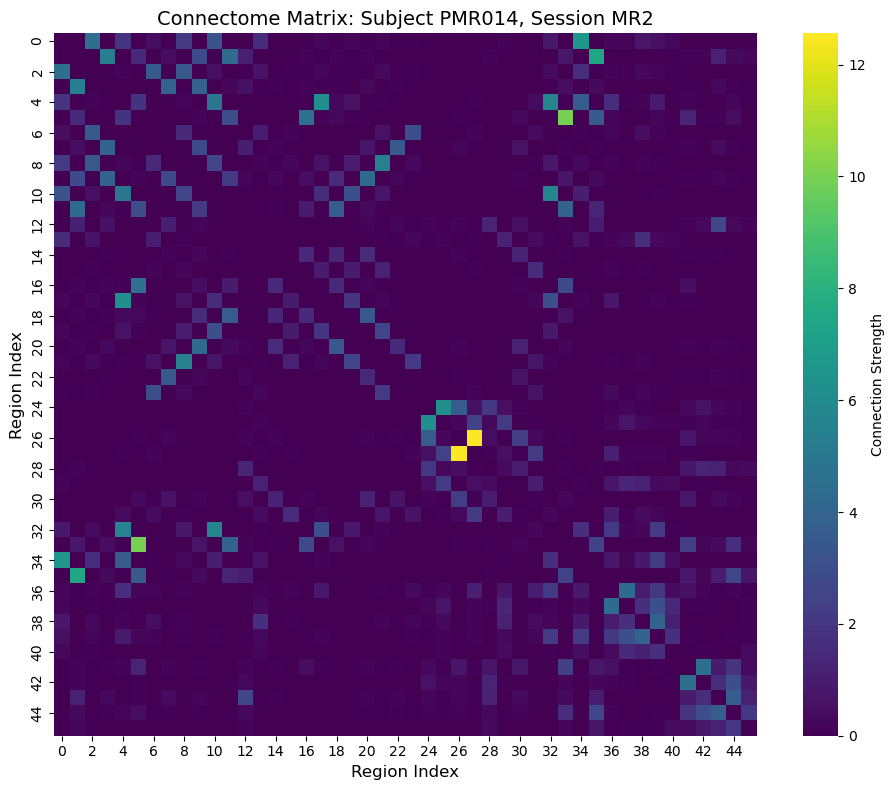

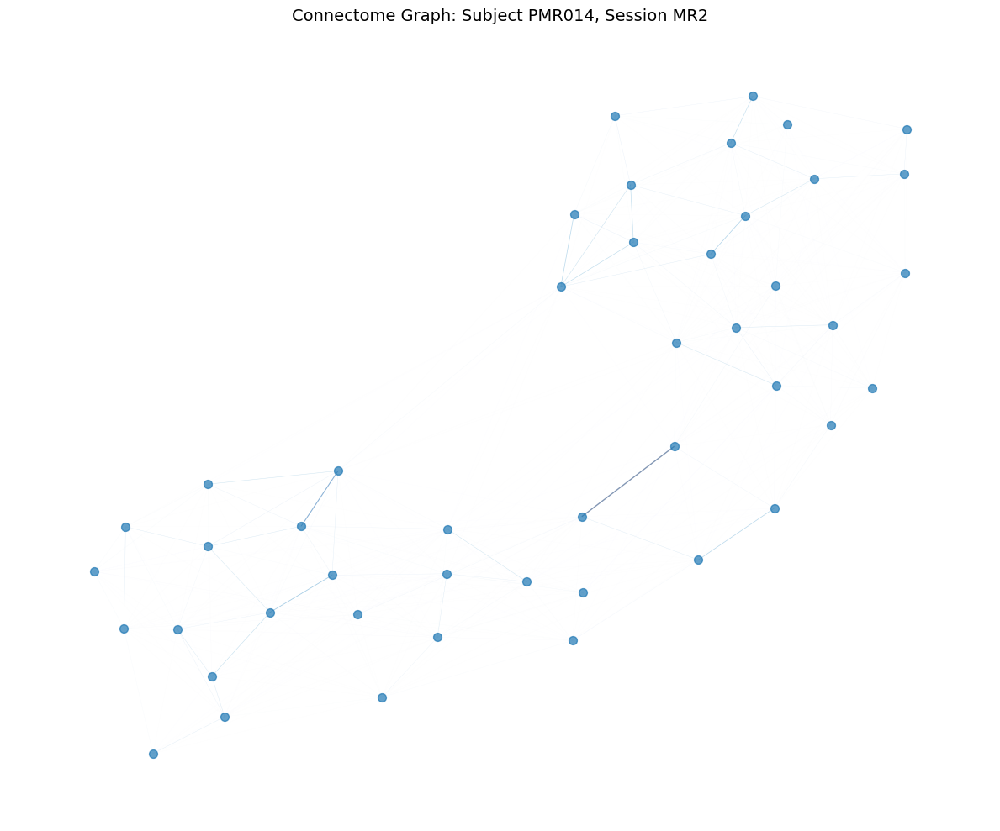

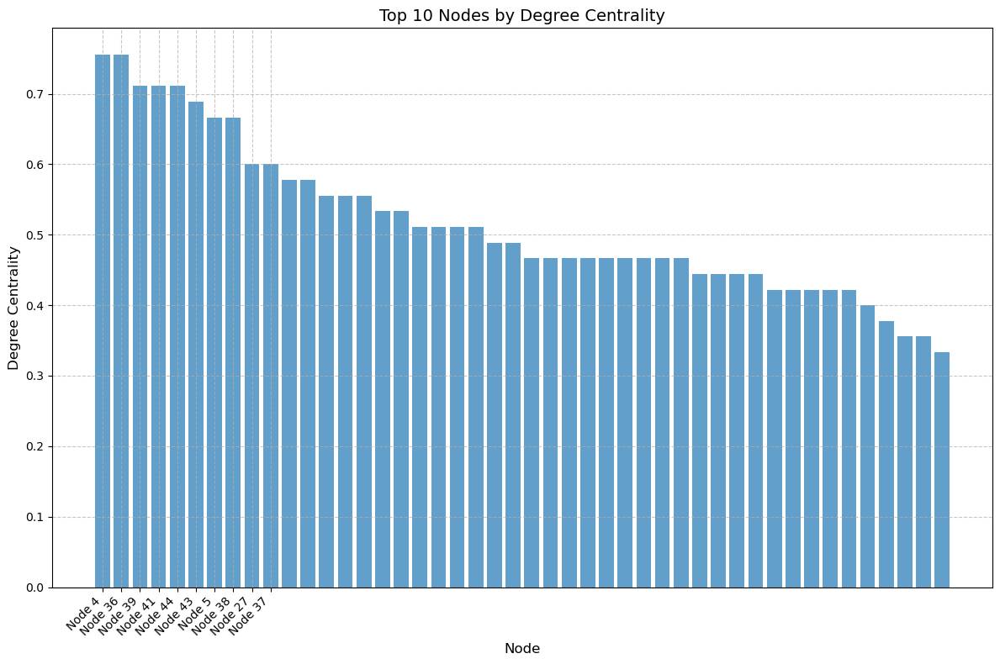

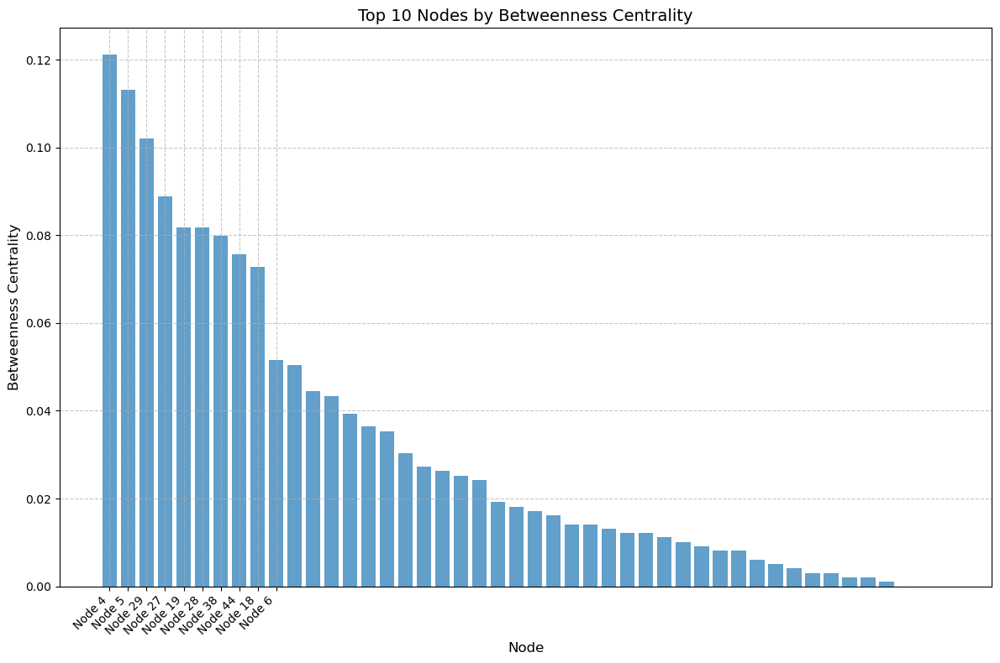

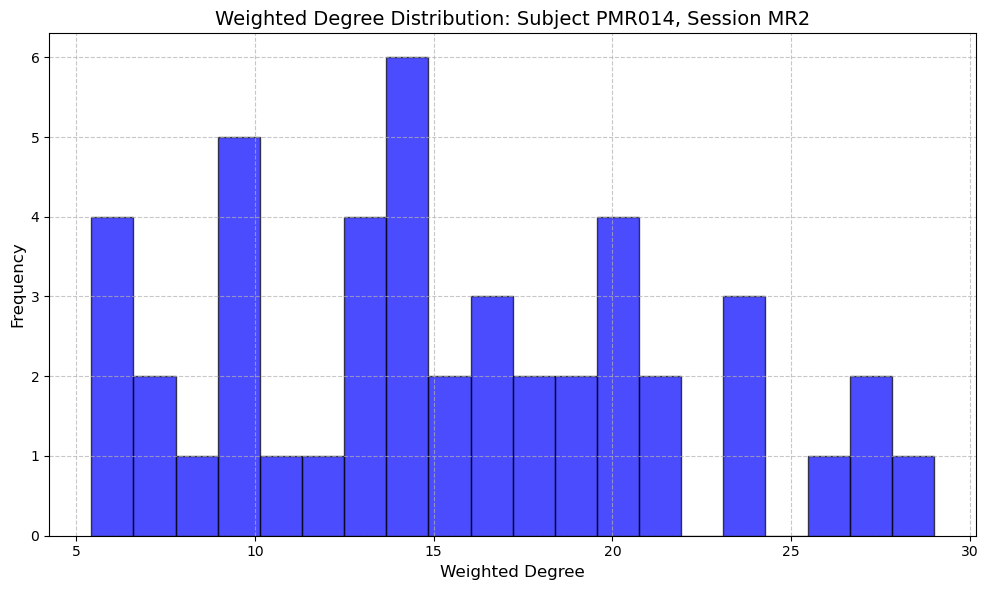

Processing connectome for subject PMR032, session MR2

Visualizations for subject PMR032, session MR2:


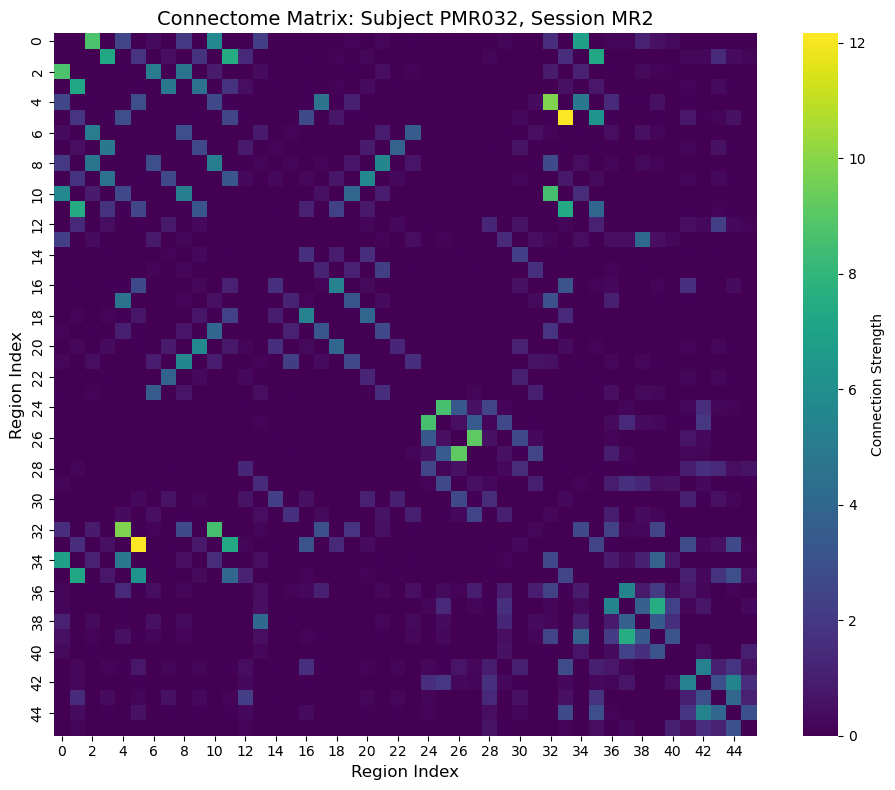

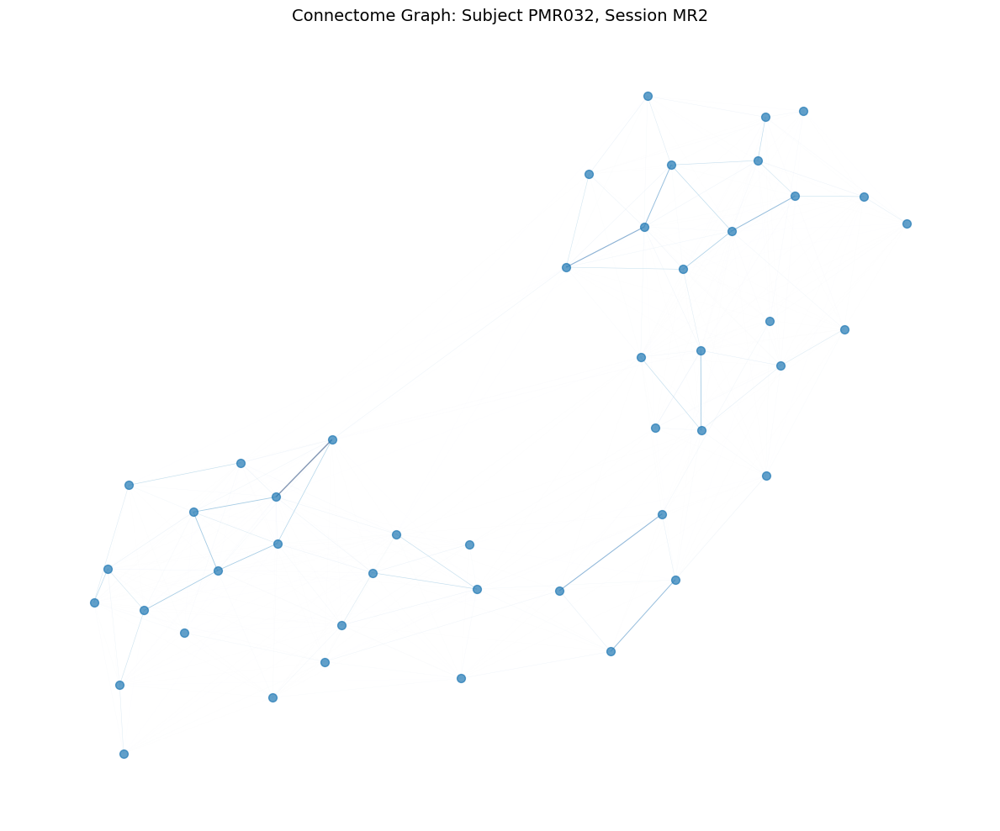

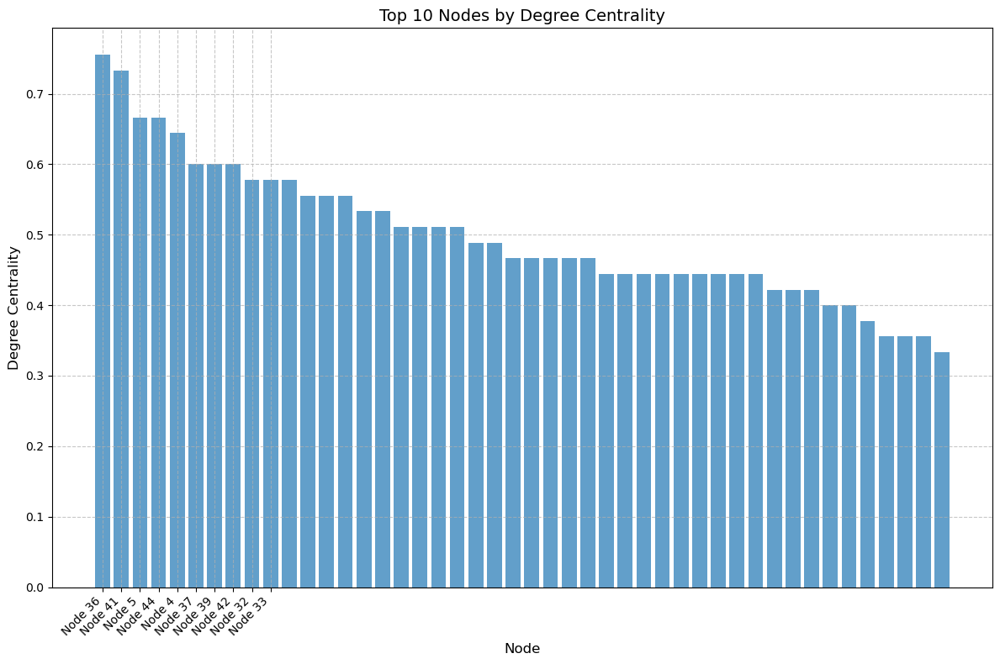

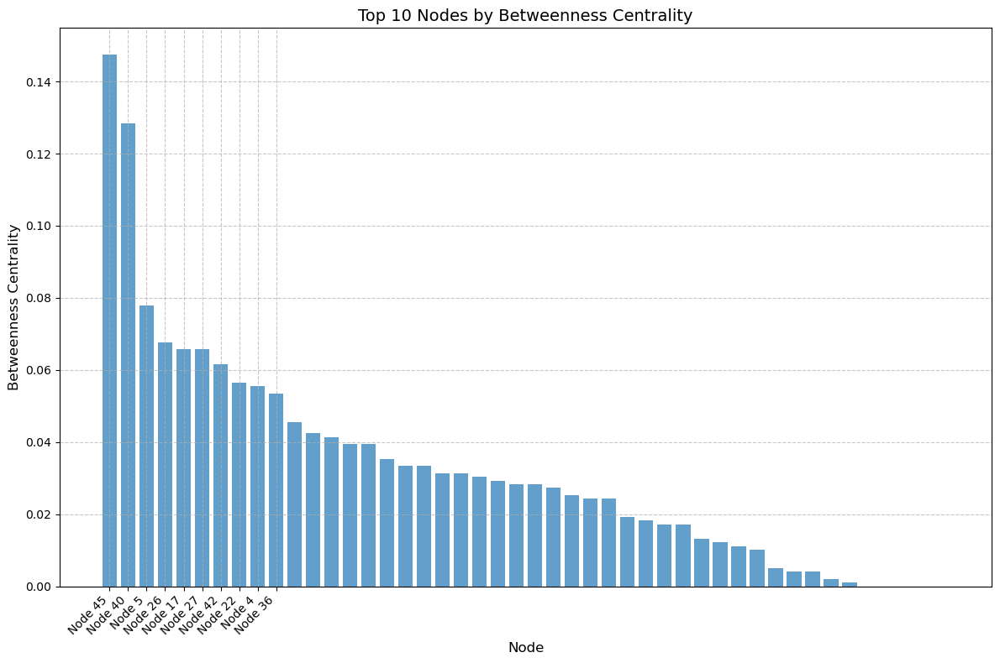

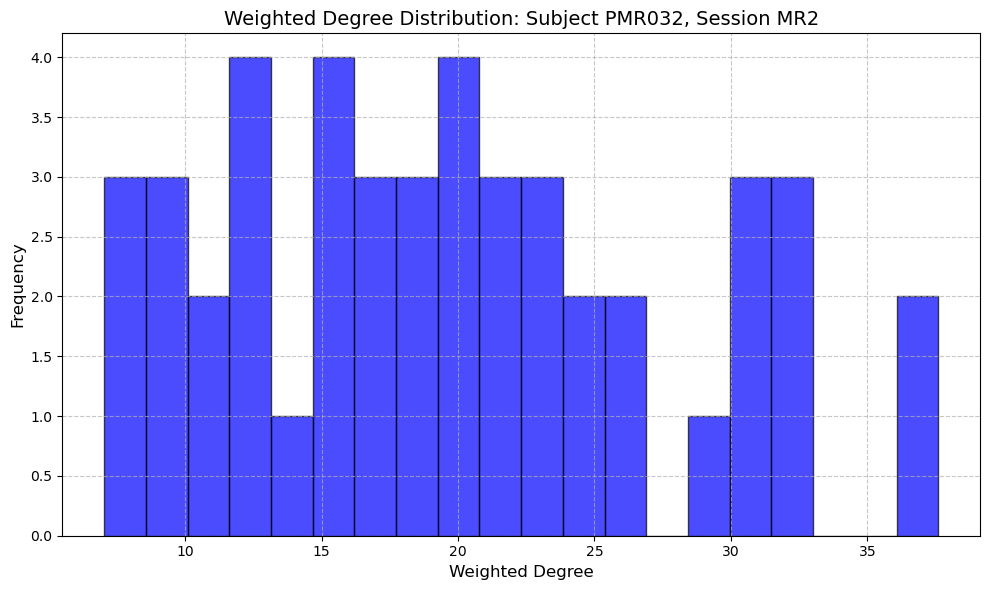

Processing connectome for subject PMR084, session MR2

Visualizations for subject PMR084, session MR2:


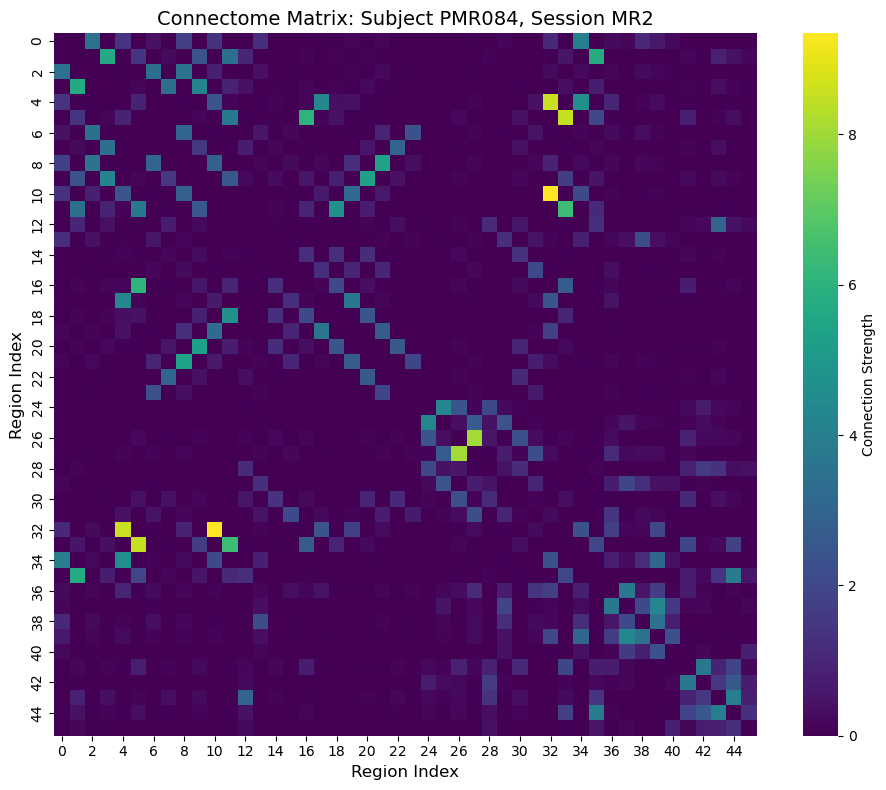

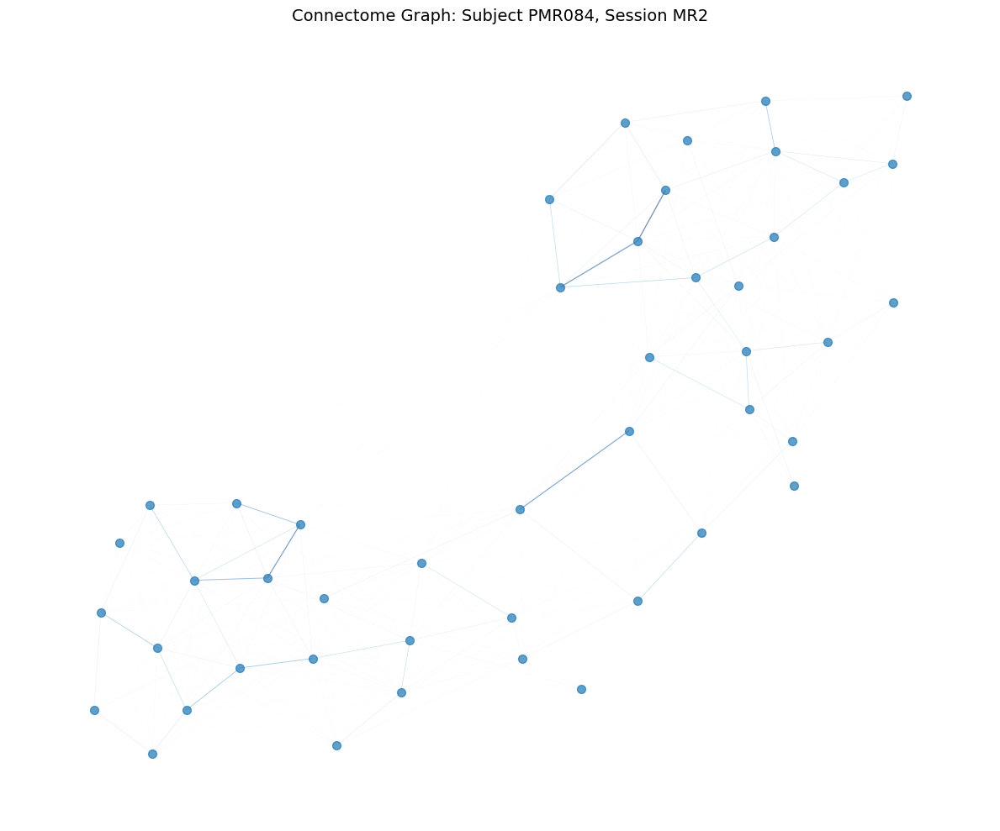

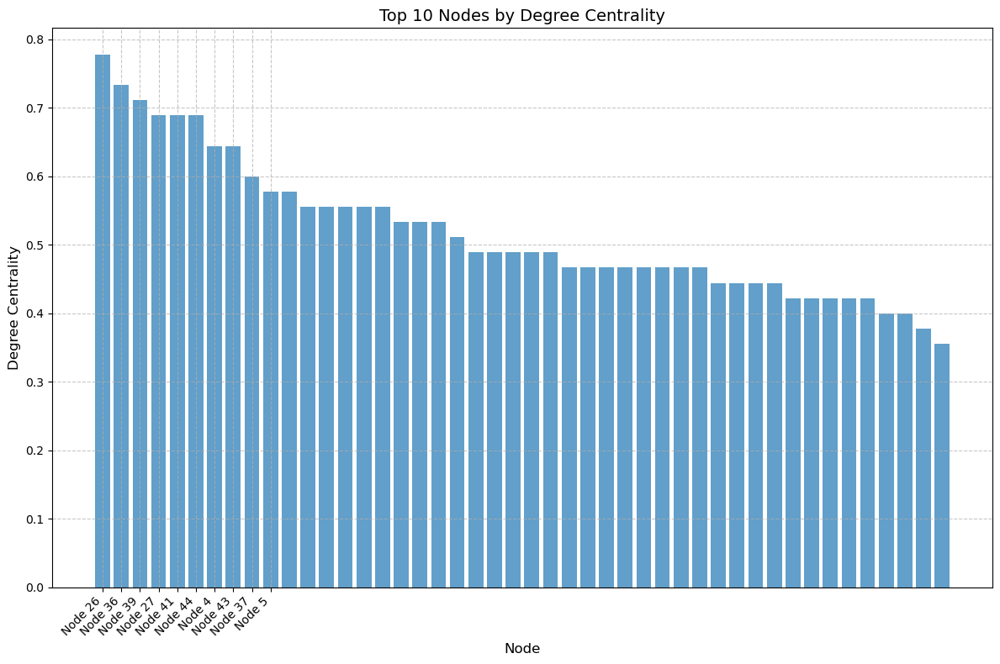

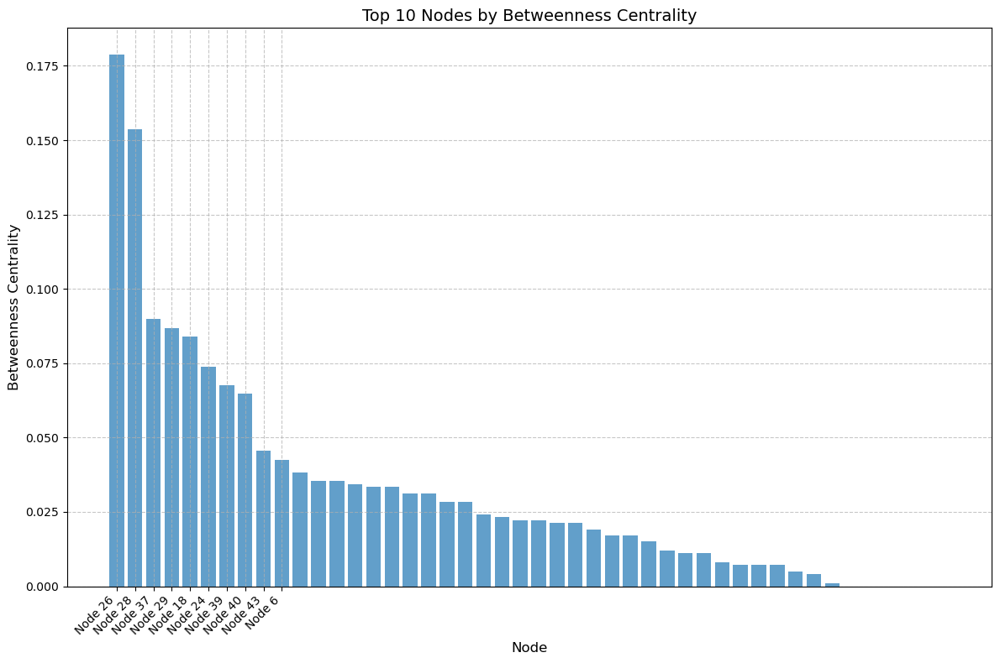

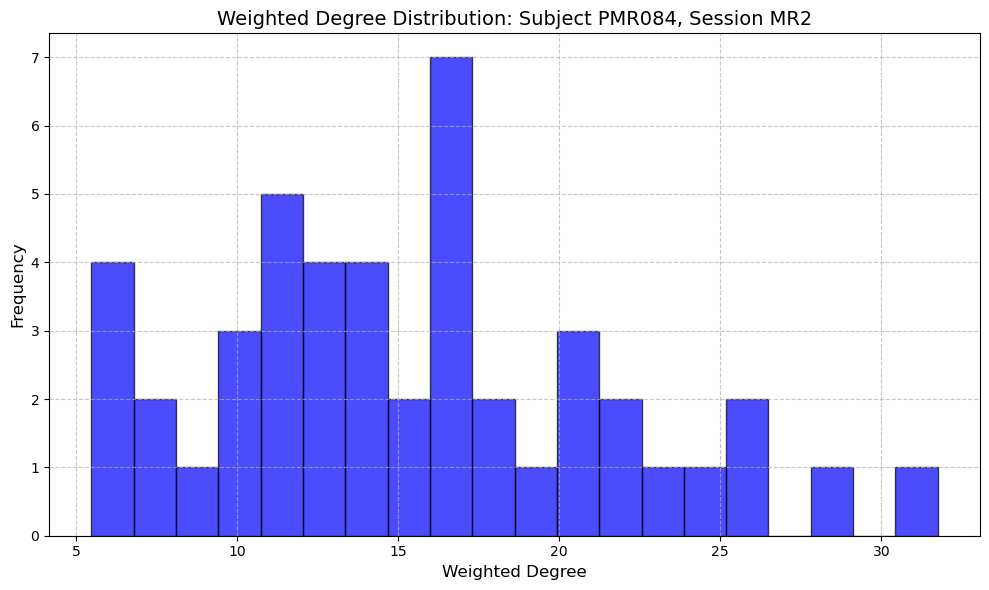

Processing connectome for subject PMR070, session MR2

Visualizations for subject PMR070, session MR2:


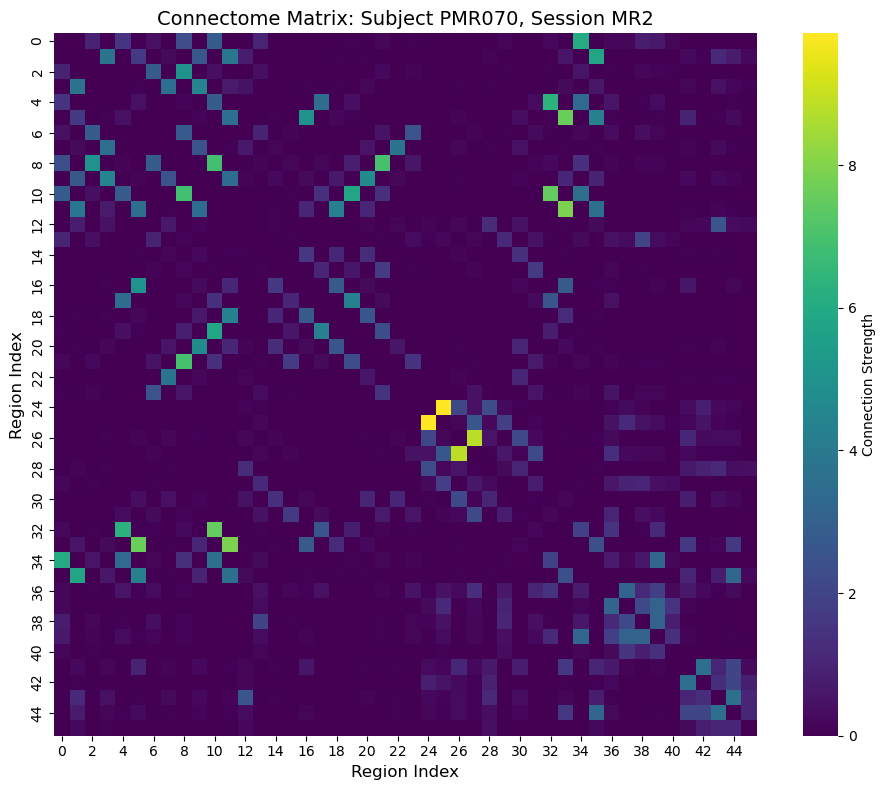

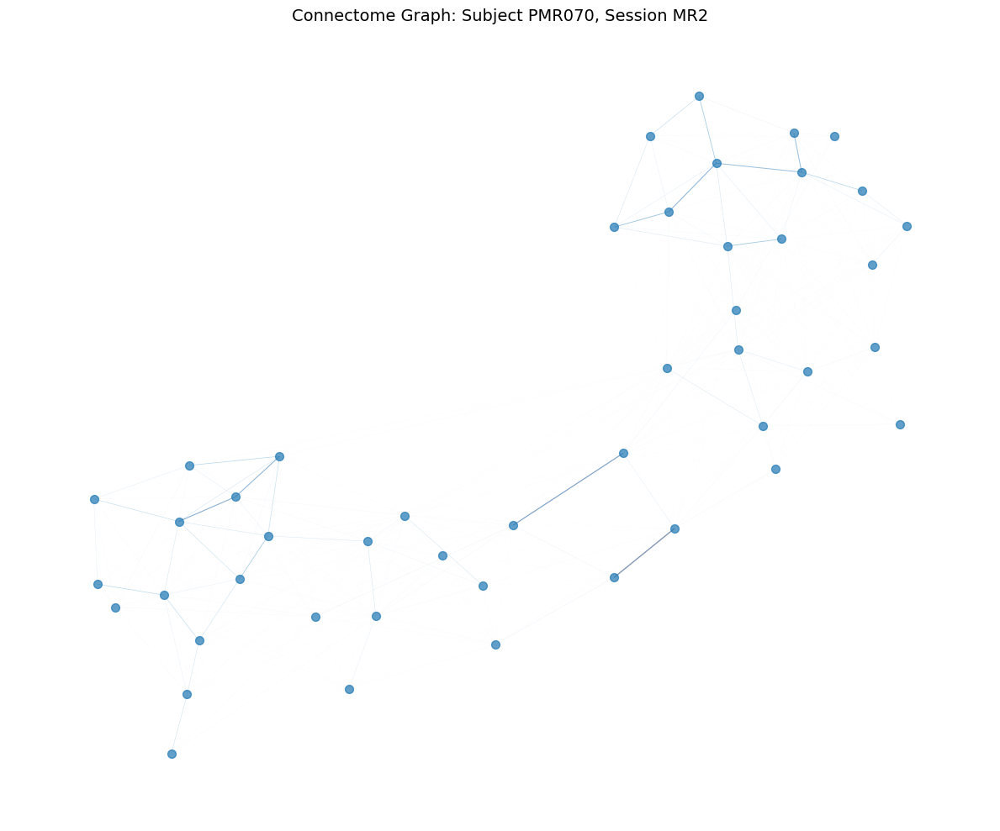

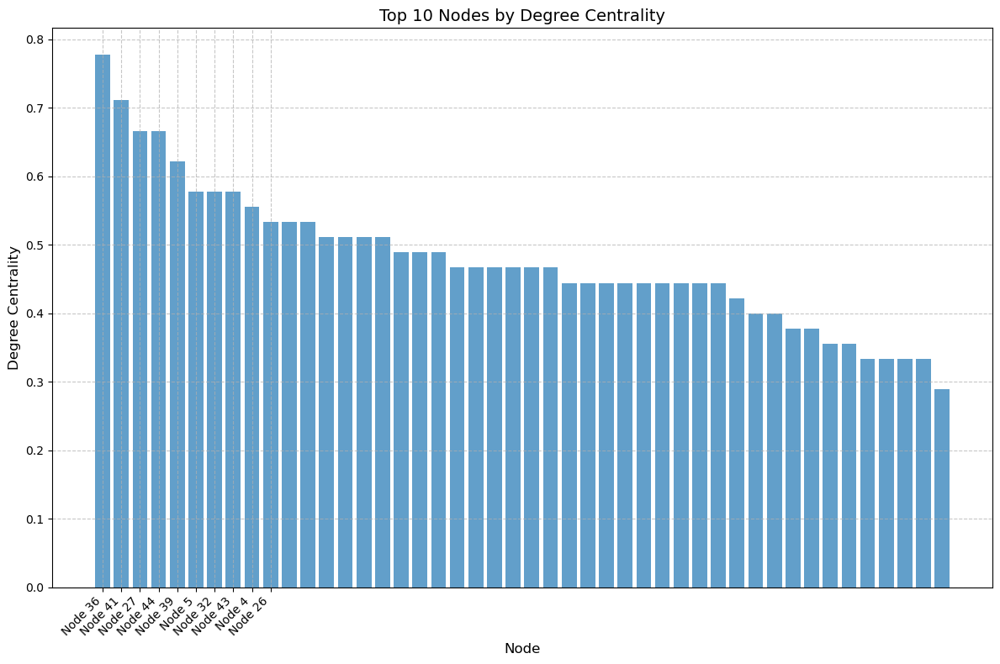

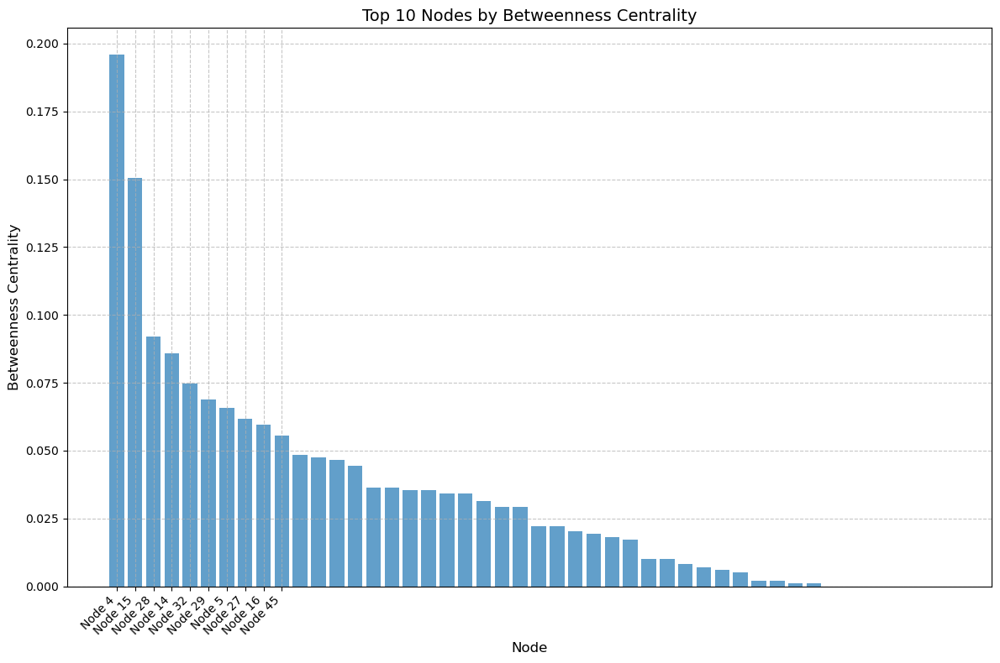

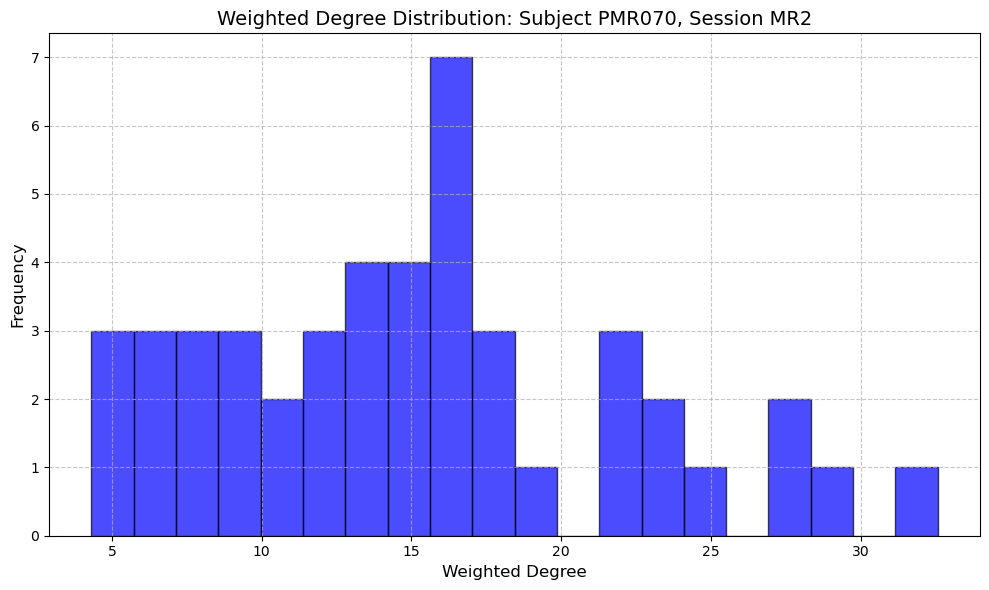

Processing connectome for subject PMR058, session MR2

Visualizations for subject PMR058, session MR2:


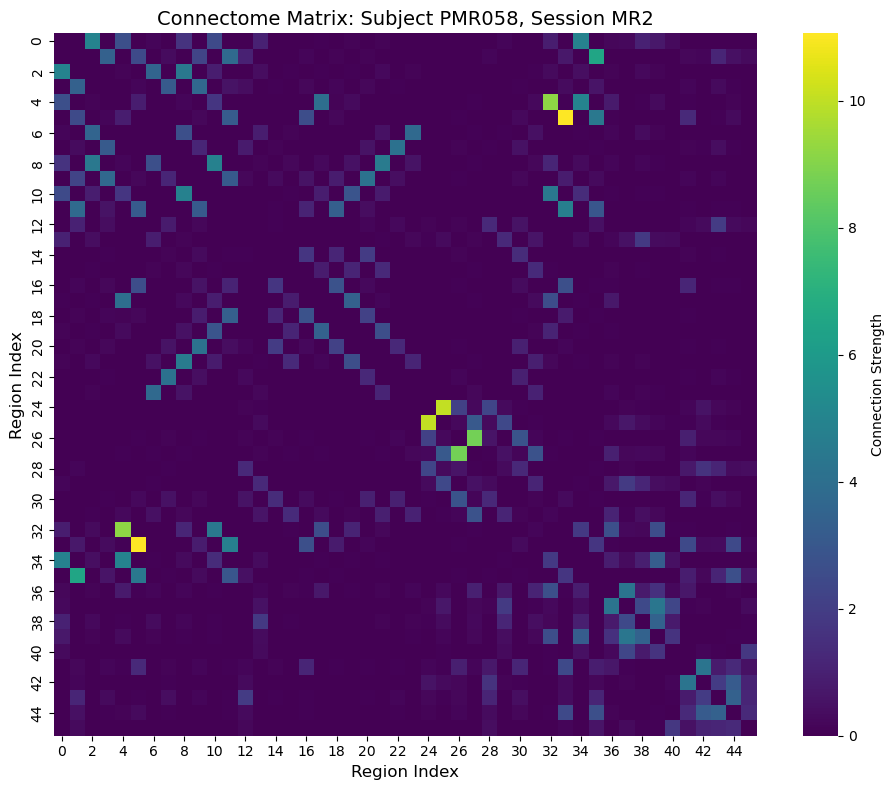

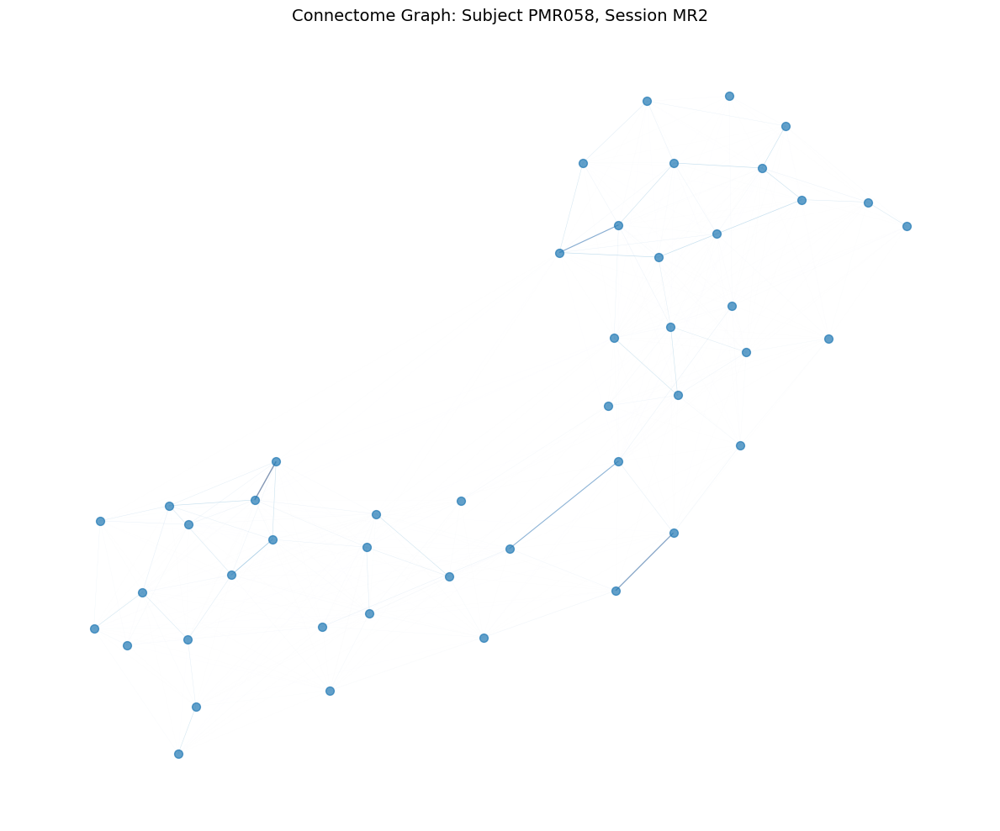

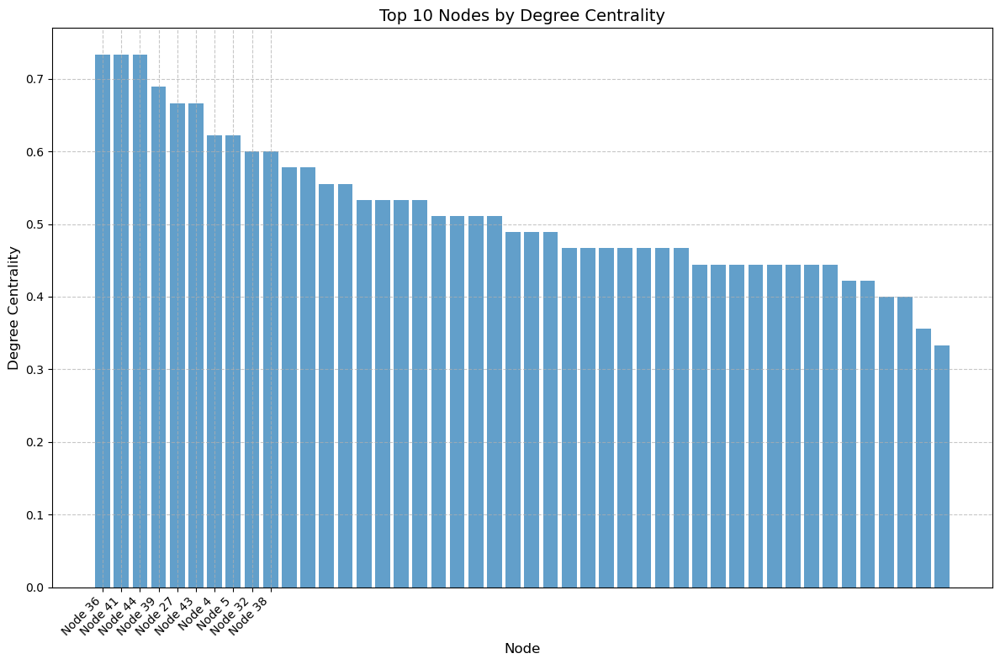

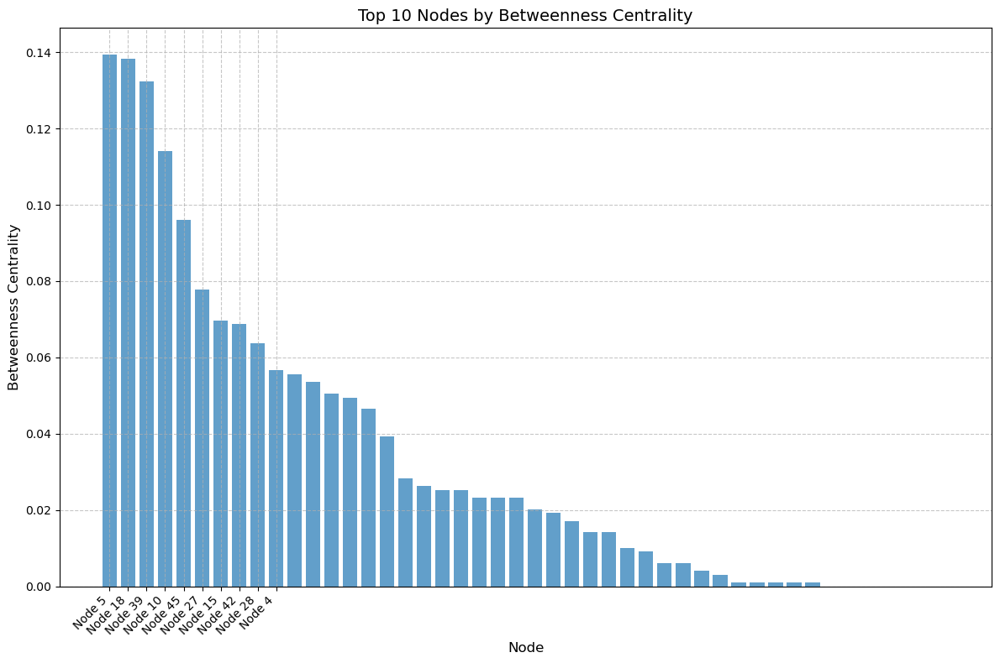

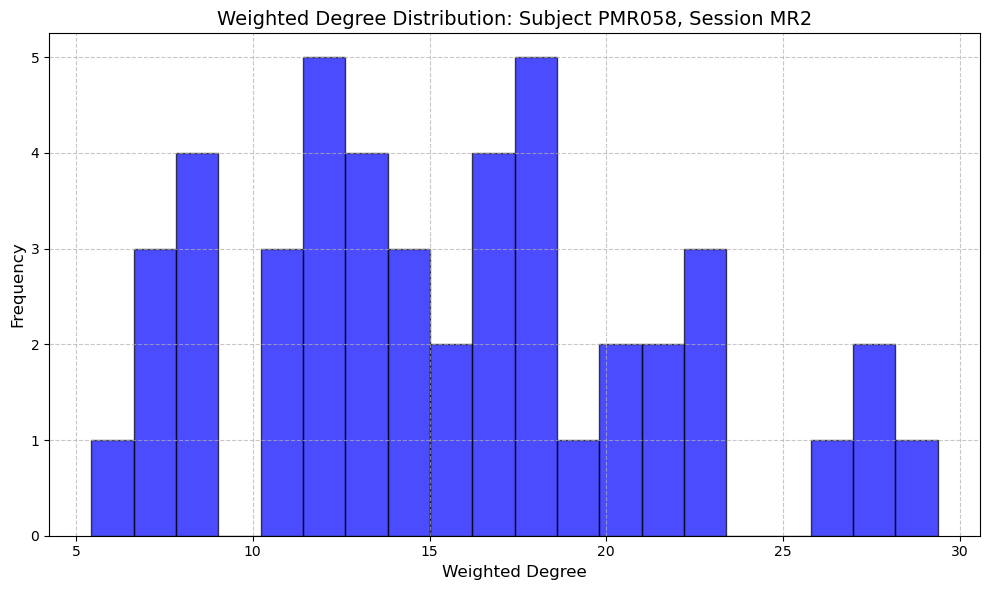

Processing connectome for subject PMR024, session MR2

Visualizations for subject PMR024, session MR2:


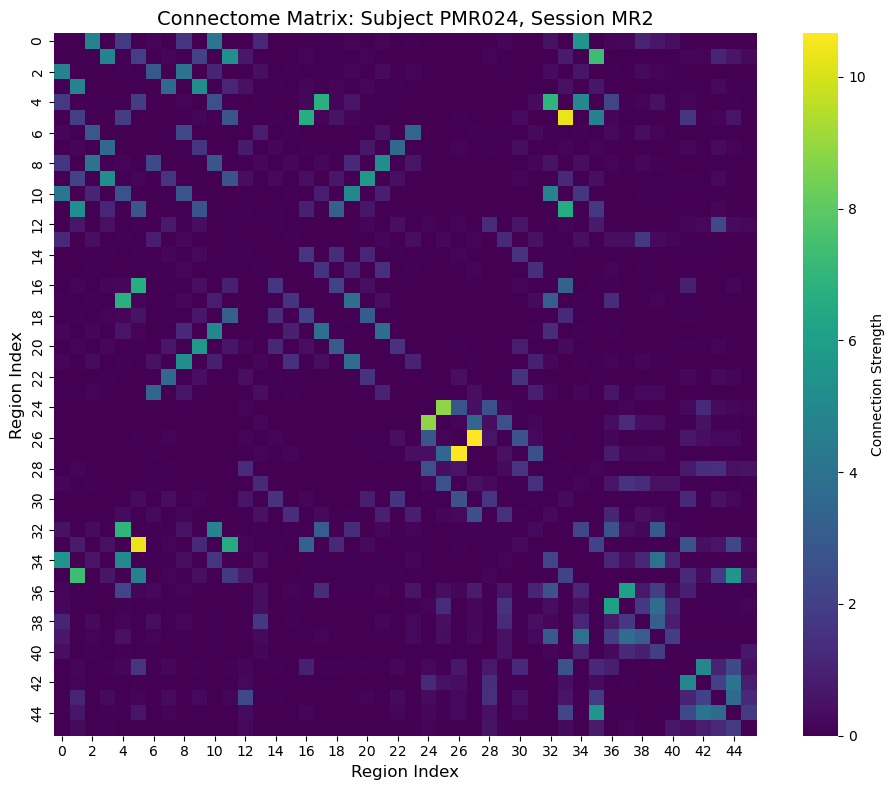

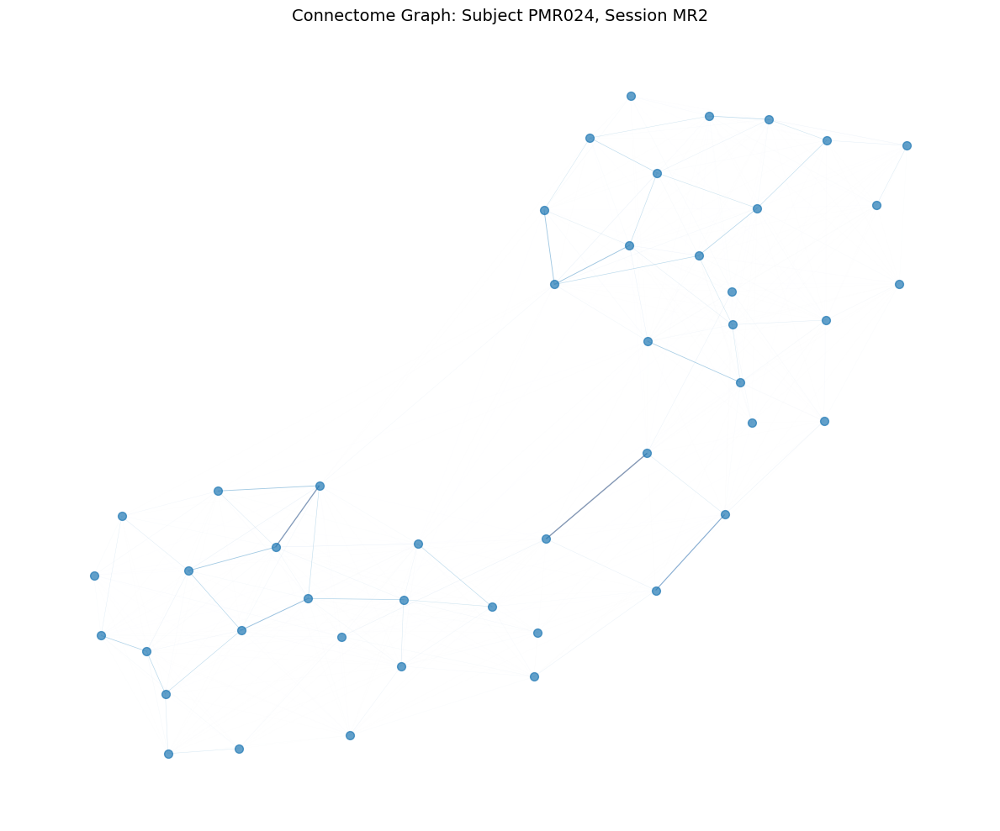

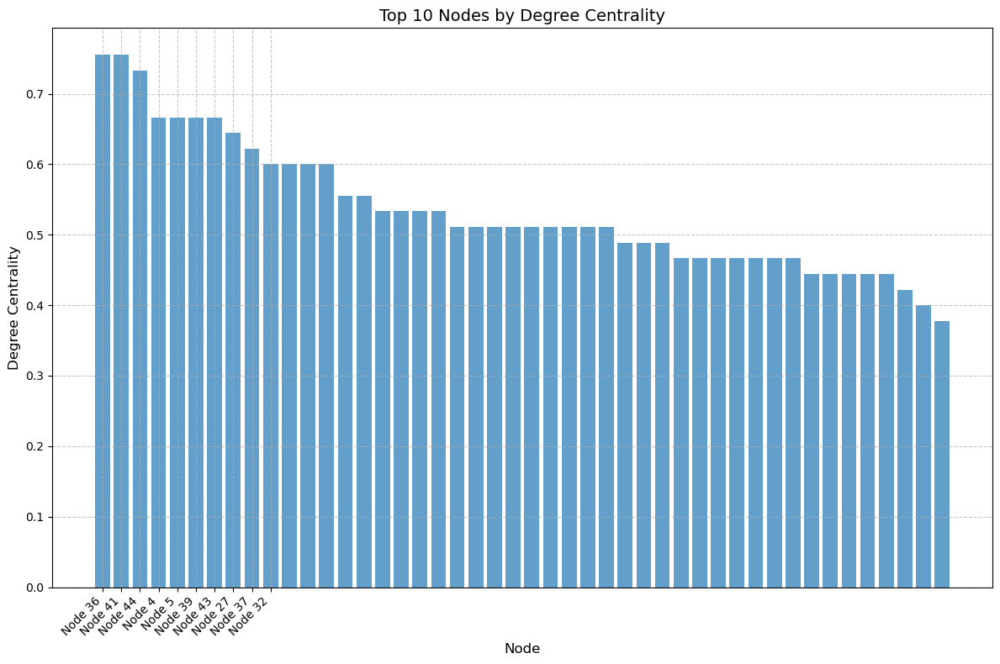

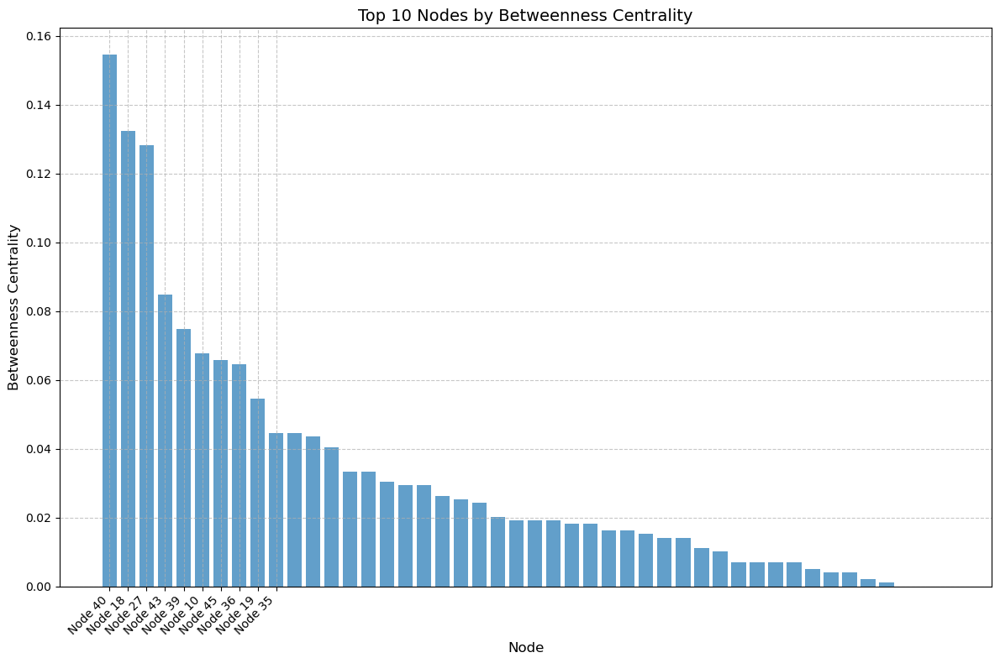

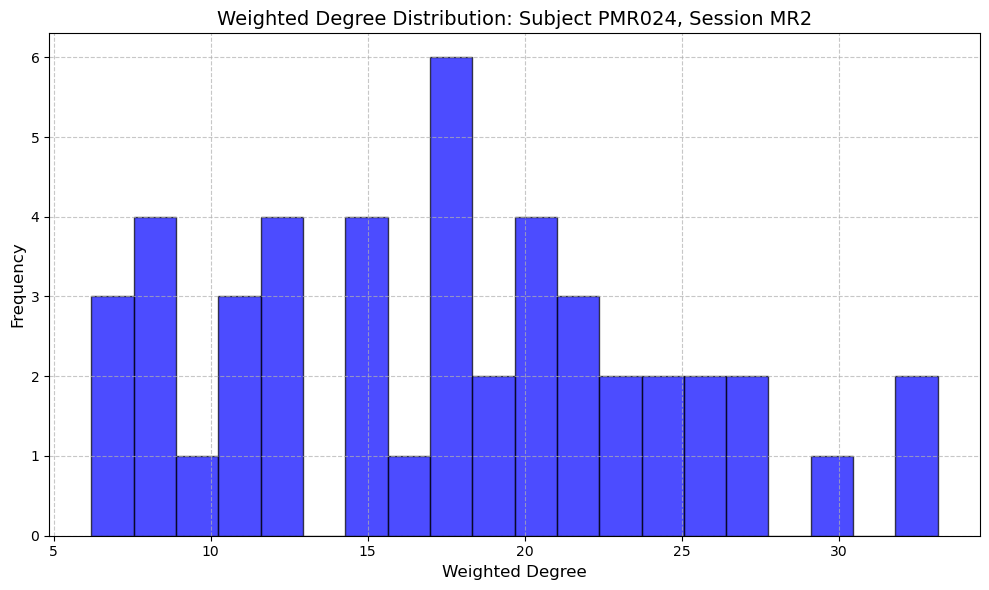

Processing connectome for subject PMR067, session MR2

Visualizations for subject PMR067, session MR2:


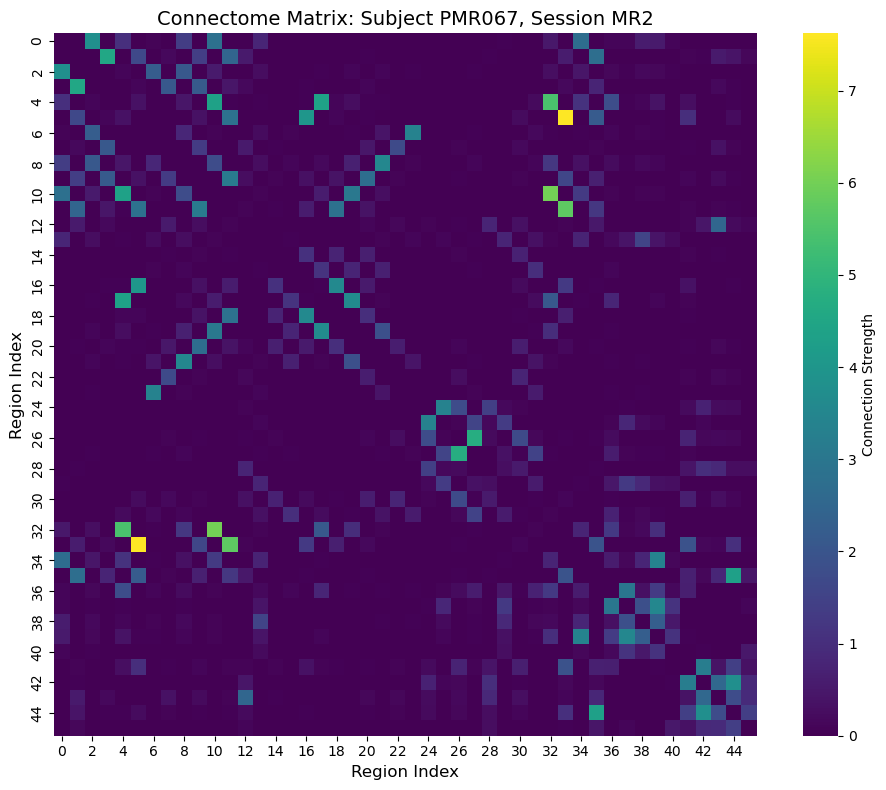

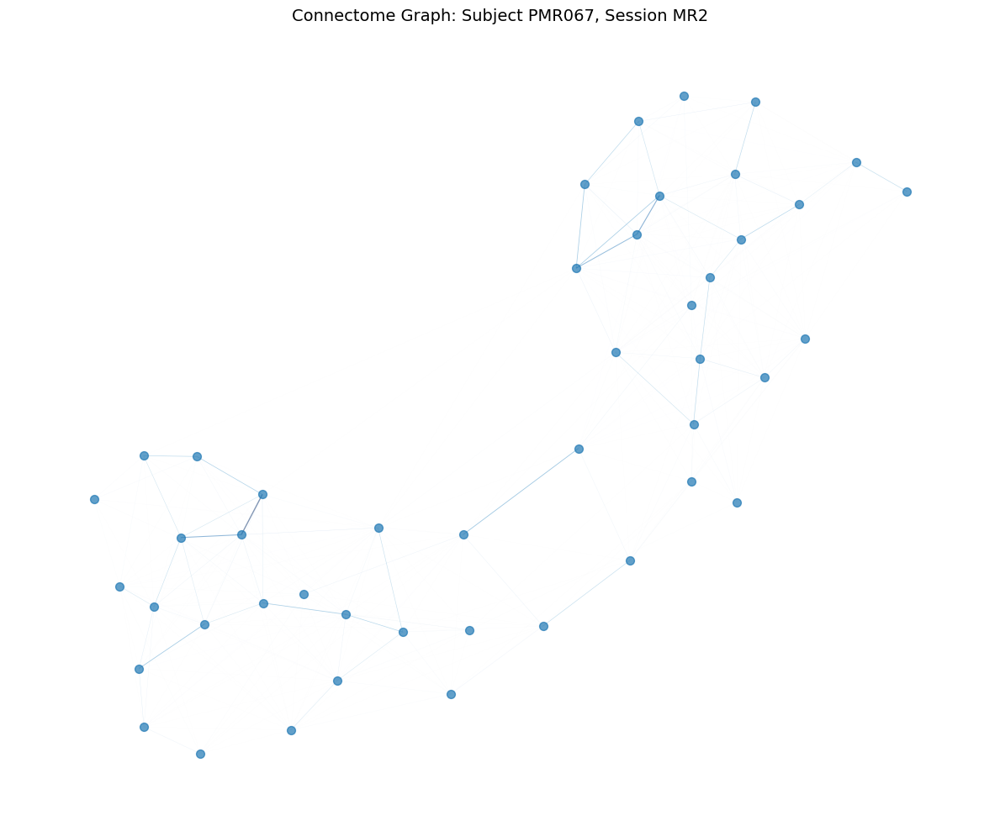

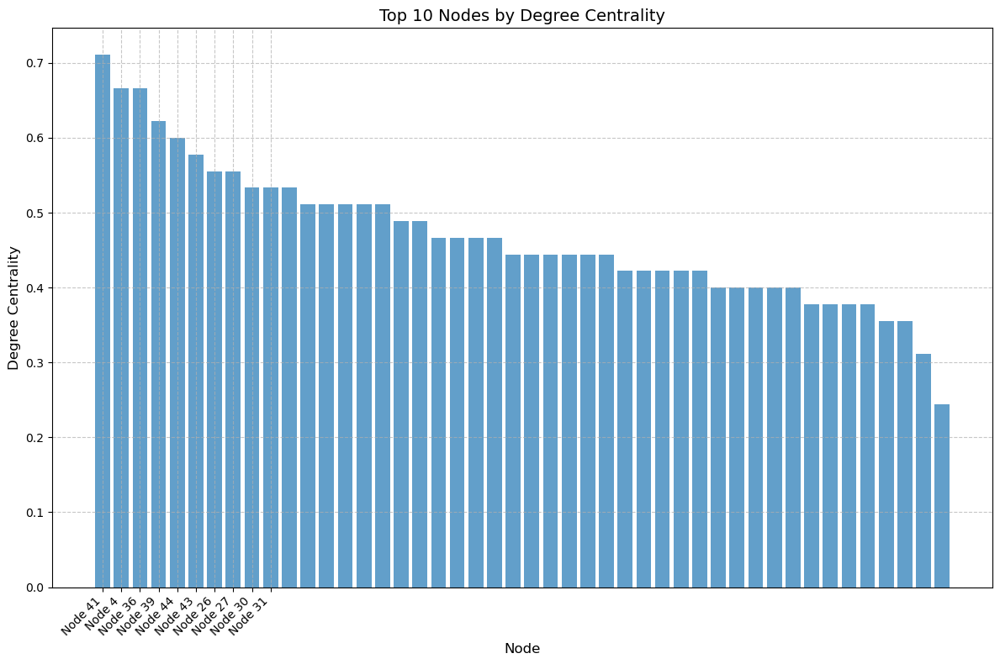

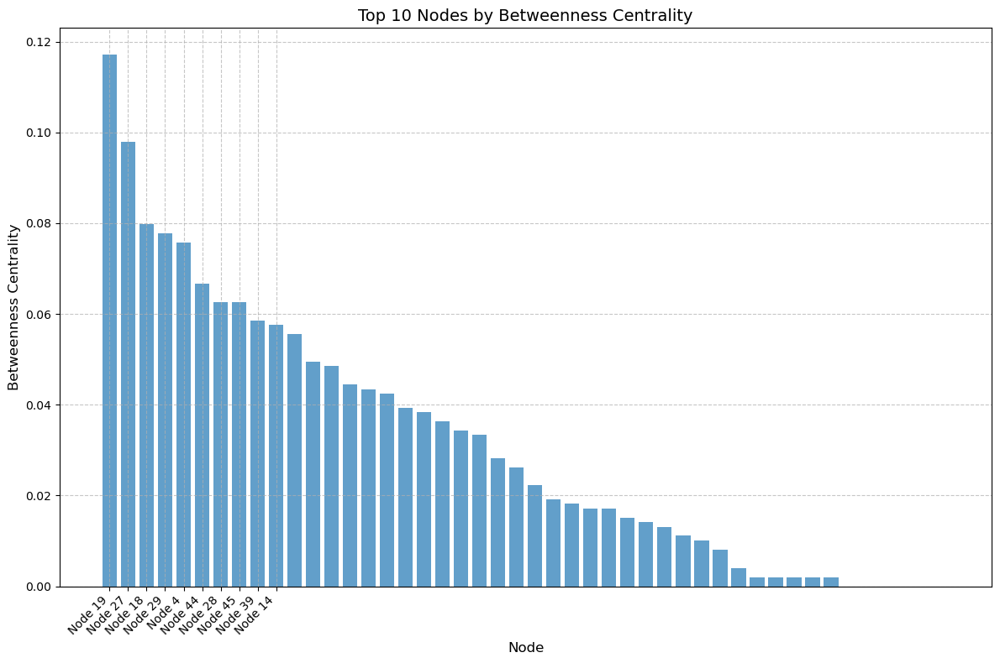

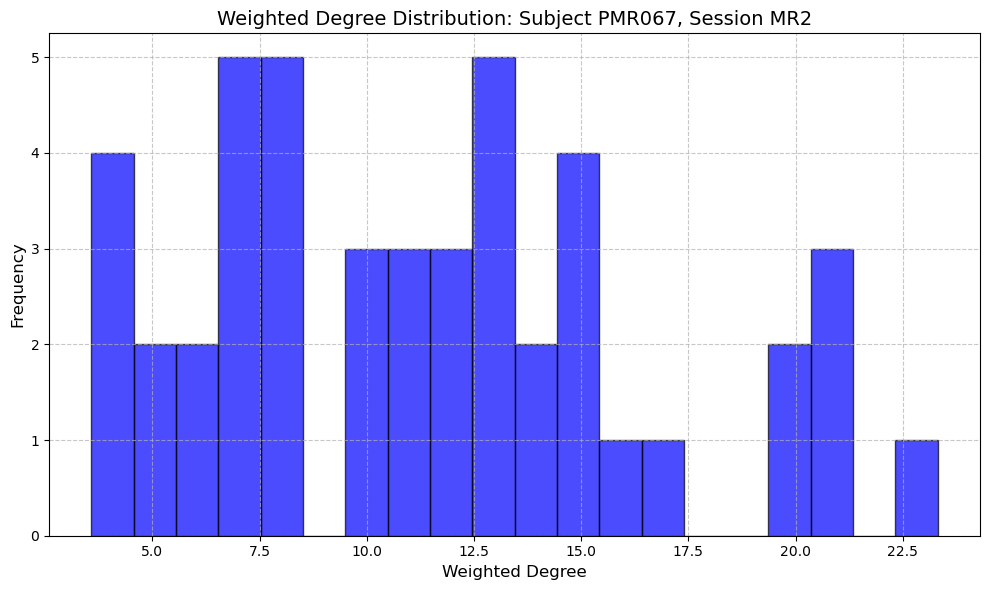

Processing connectome for subject PMR069, session MR2

Visualizations for subject PMR069, session MR2:


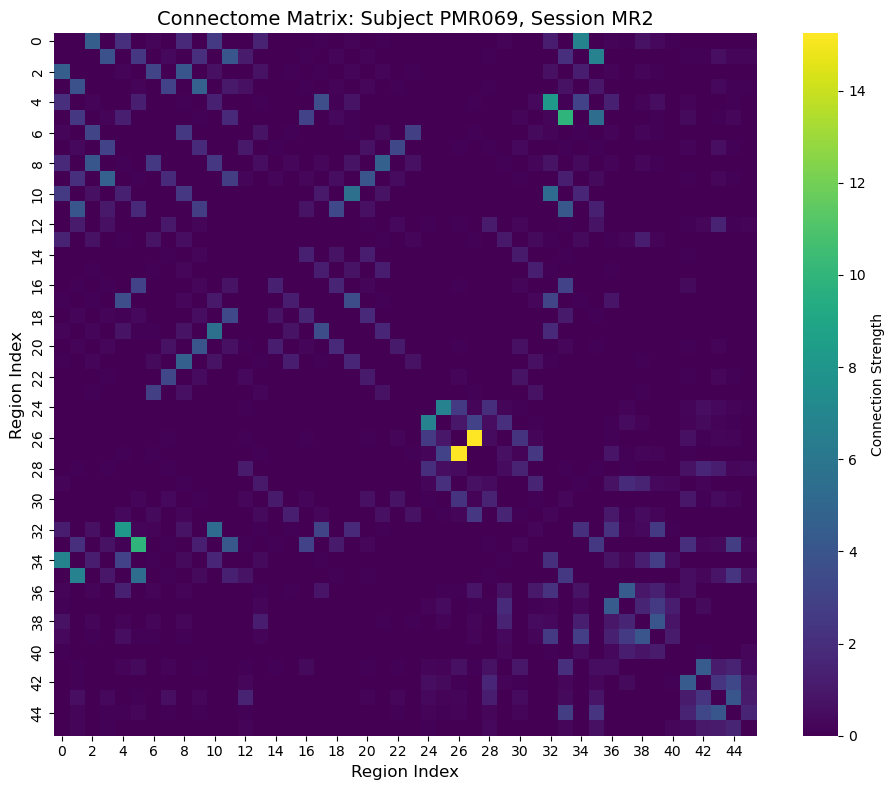

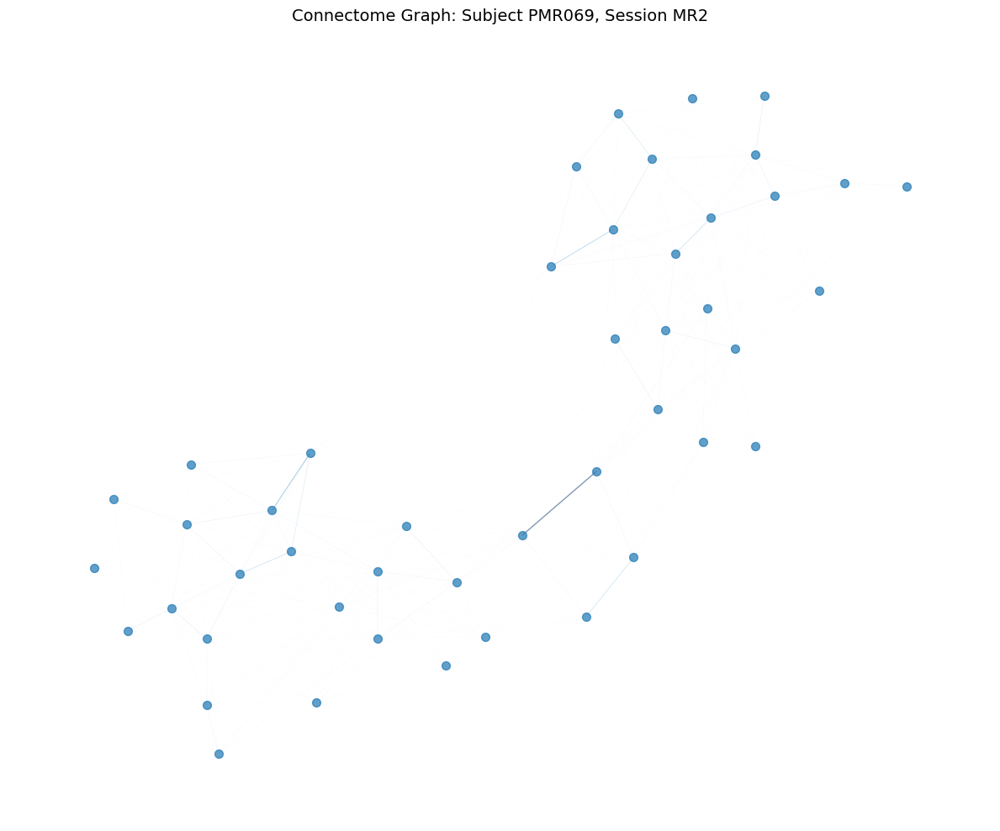

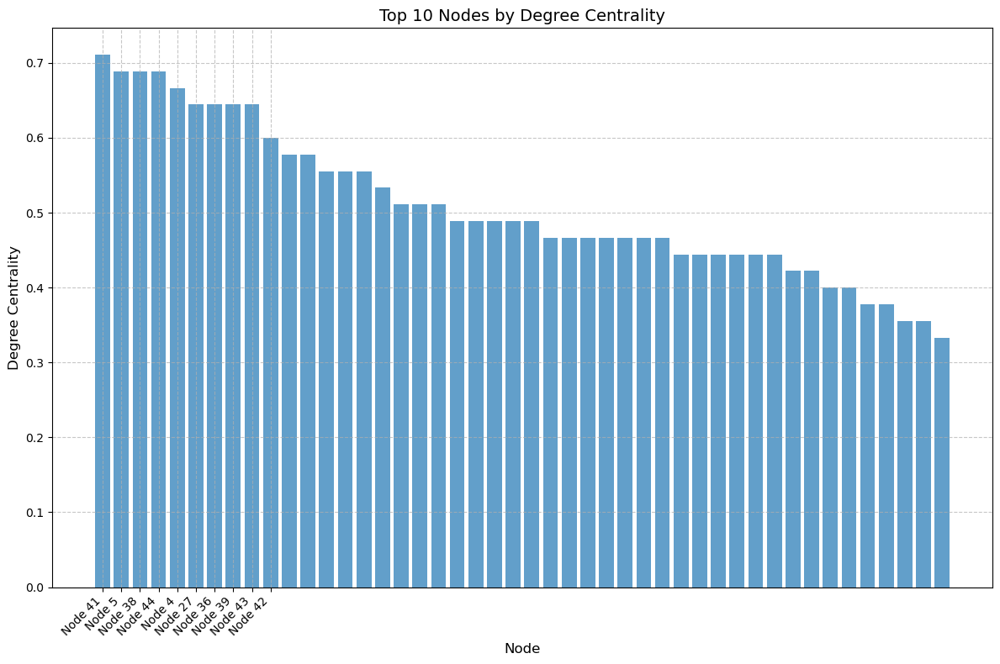

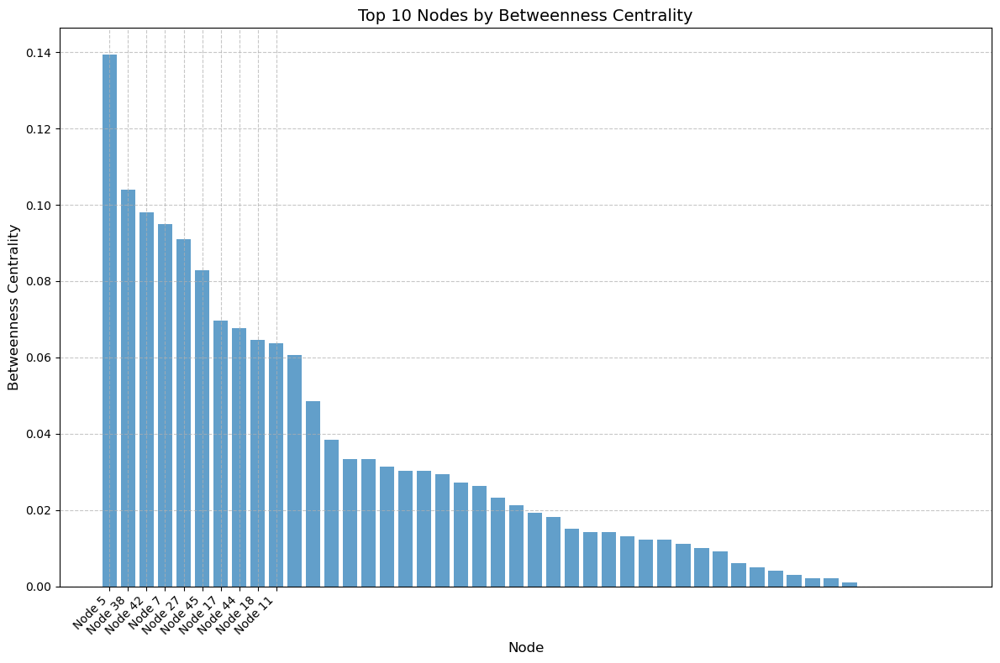

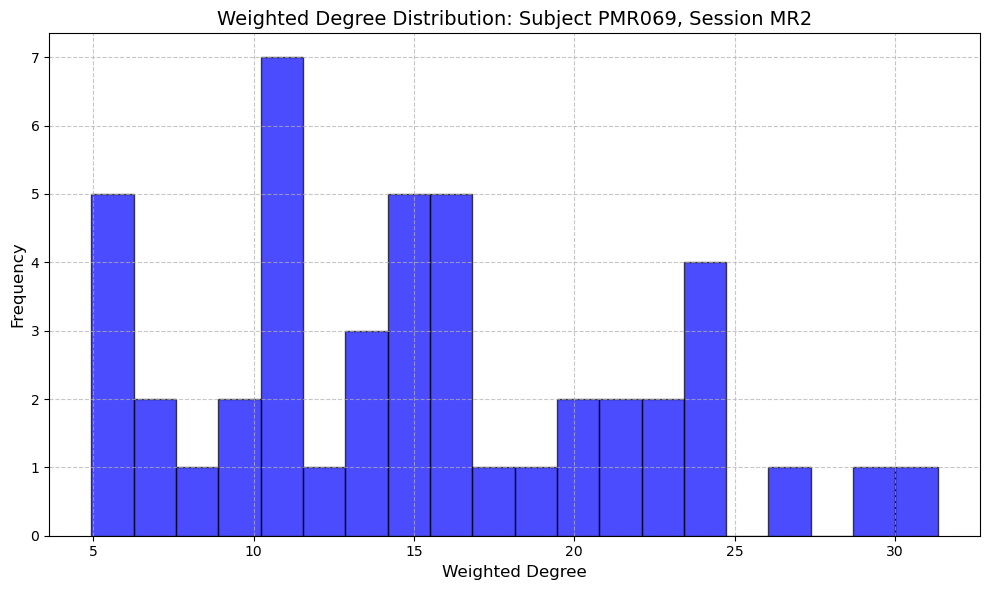

Processing connectome for subject PMR066, session MR2

Visualizations for subject PMR066, session MR2:


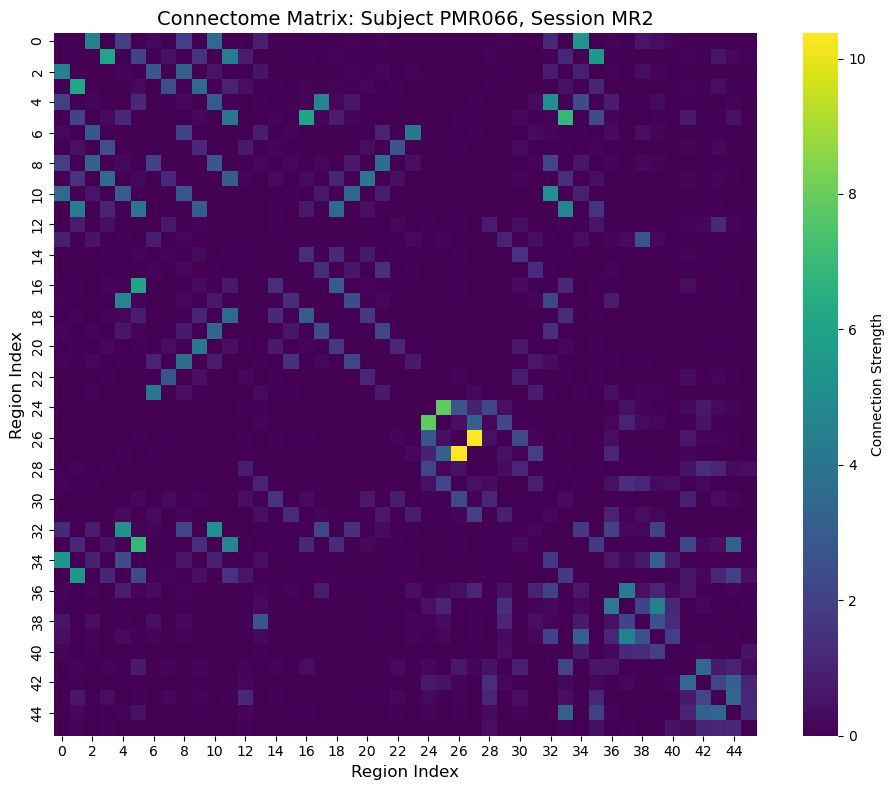

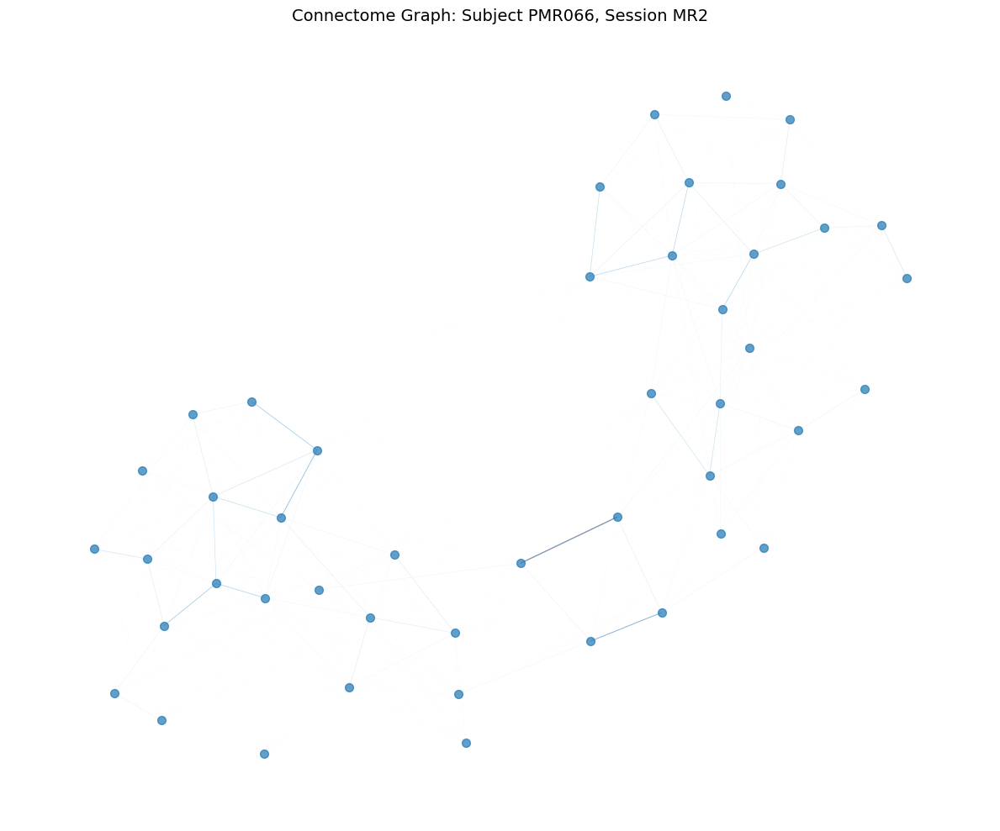

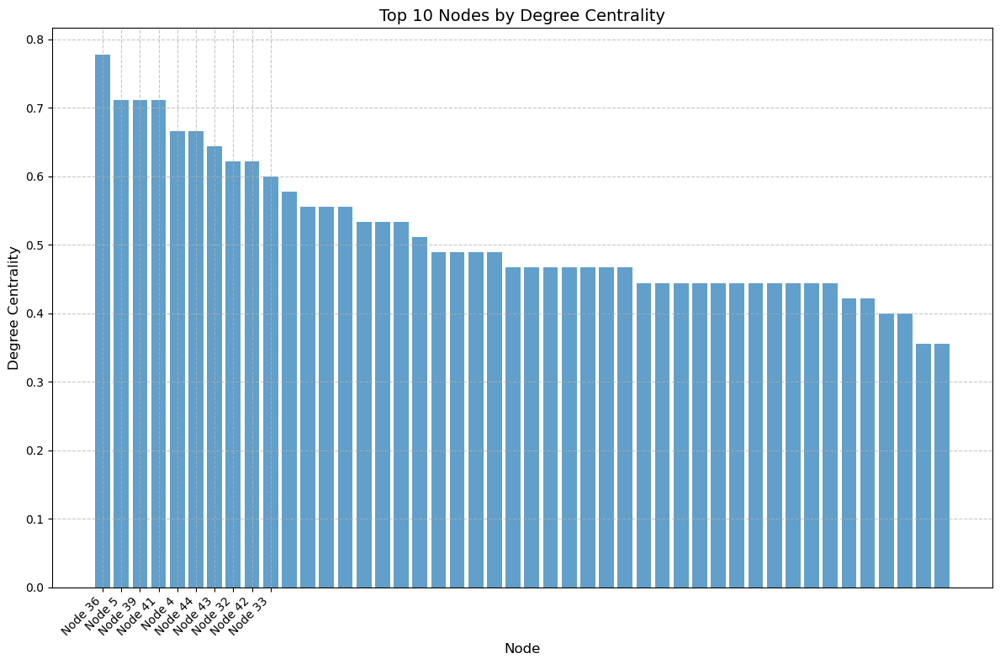

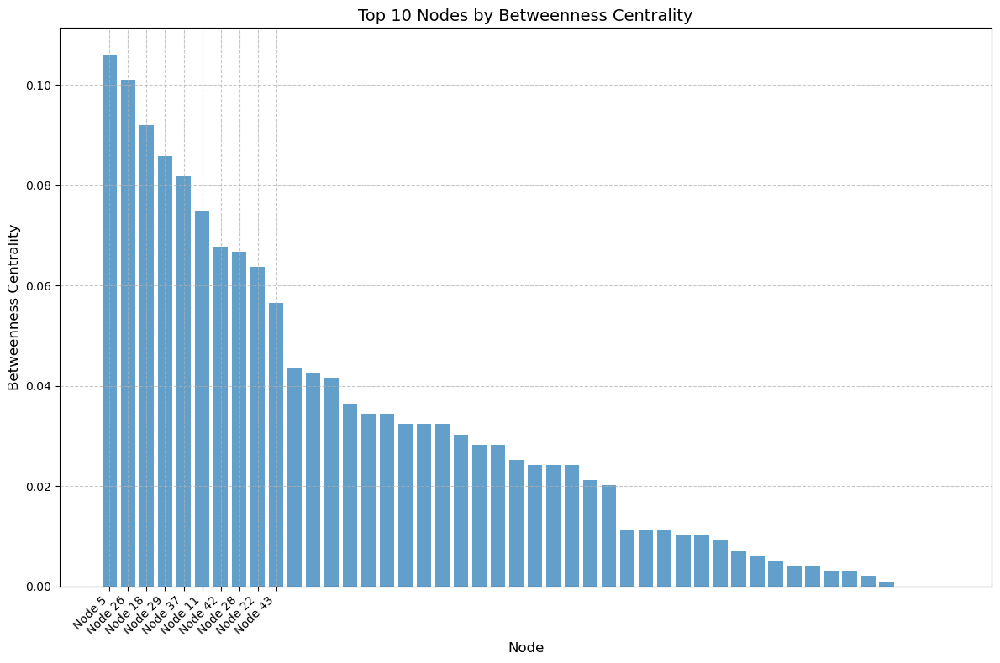

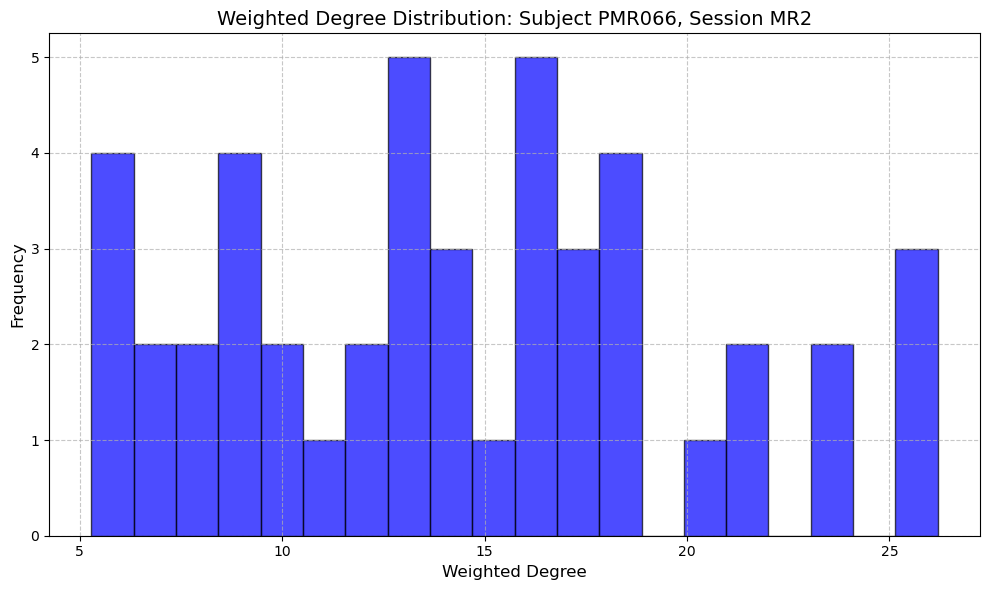

Processing connectome for subject PMR055, session MR2

Visualizations for subject PMR055, session MR2:


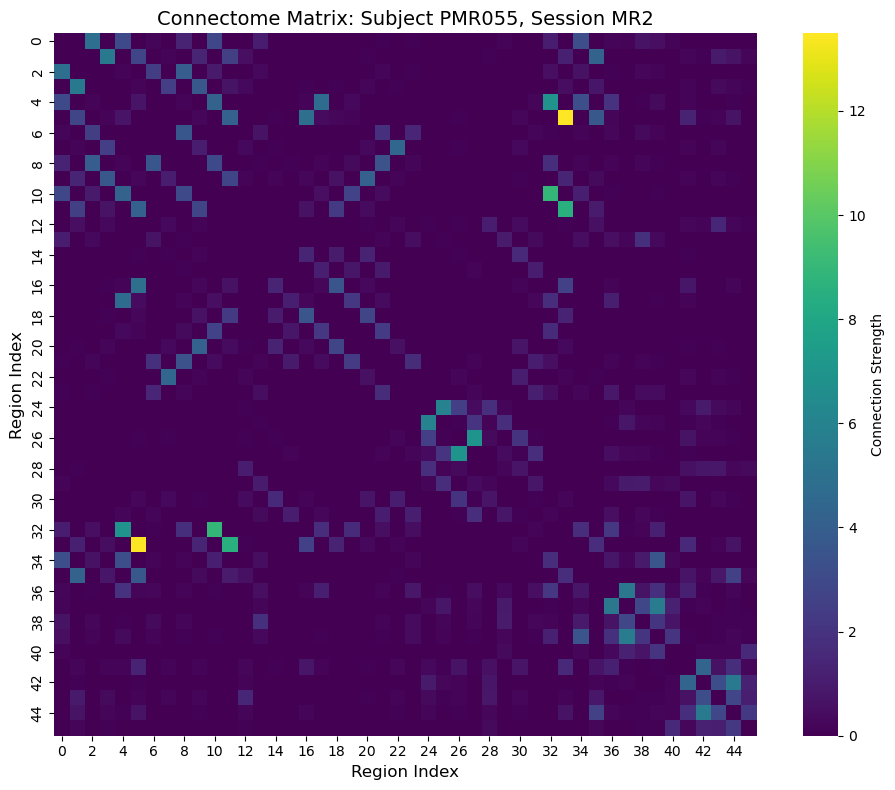

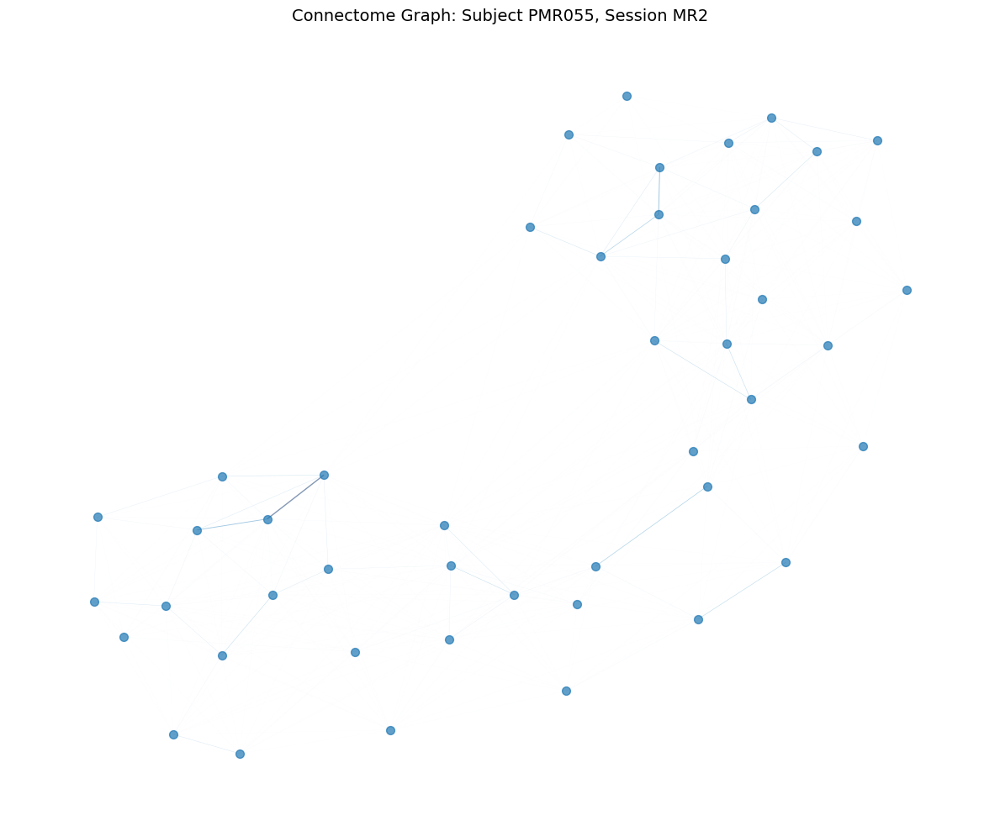

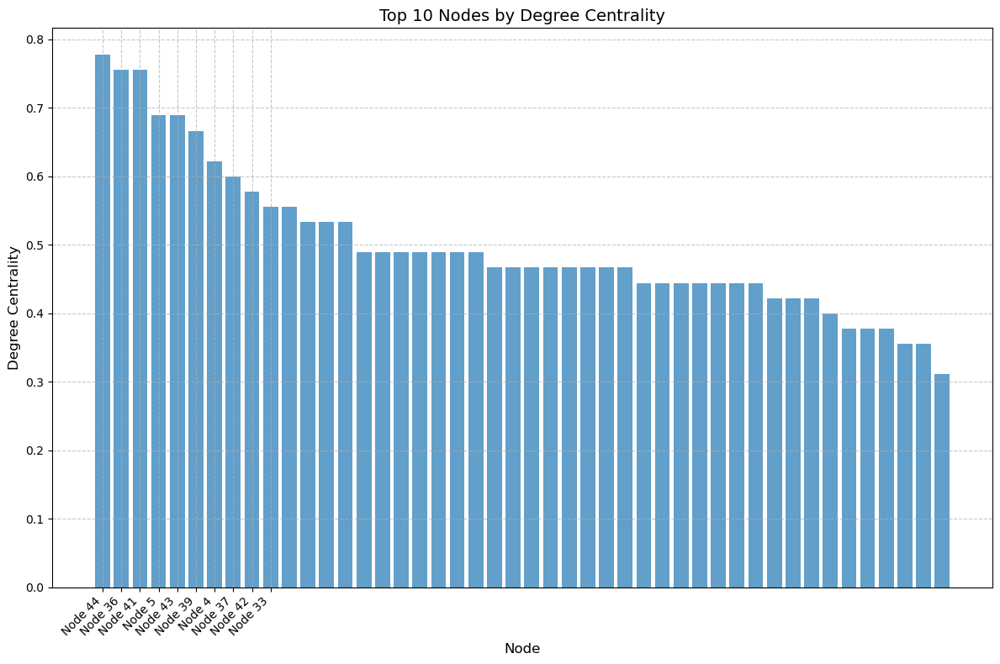

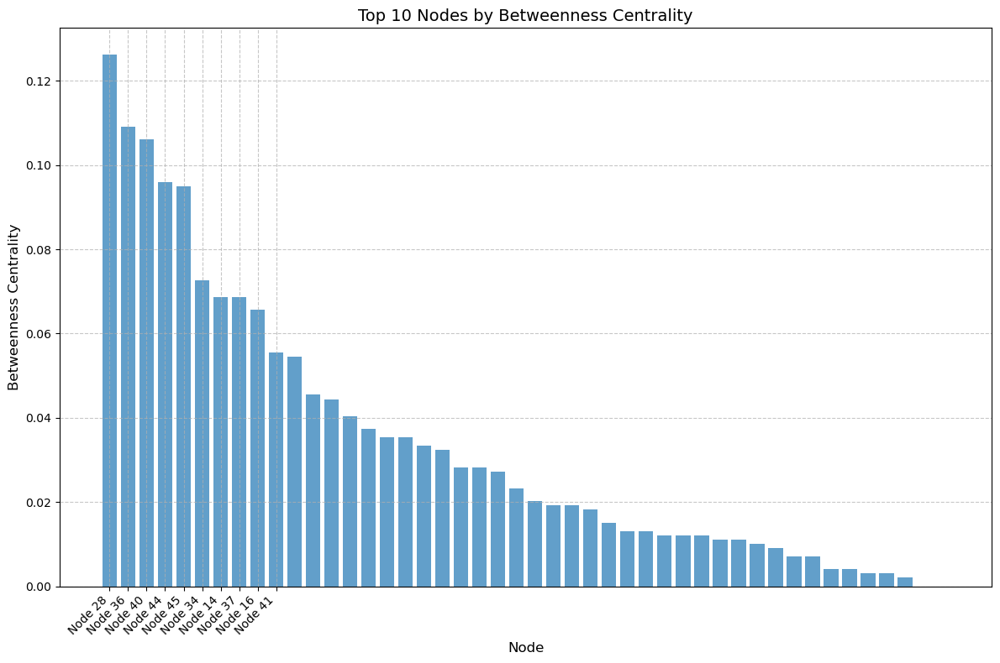

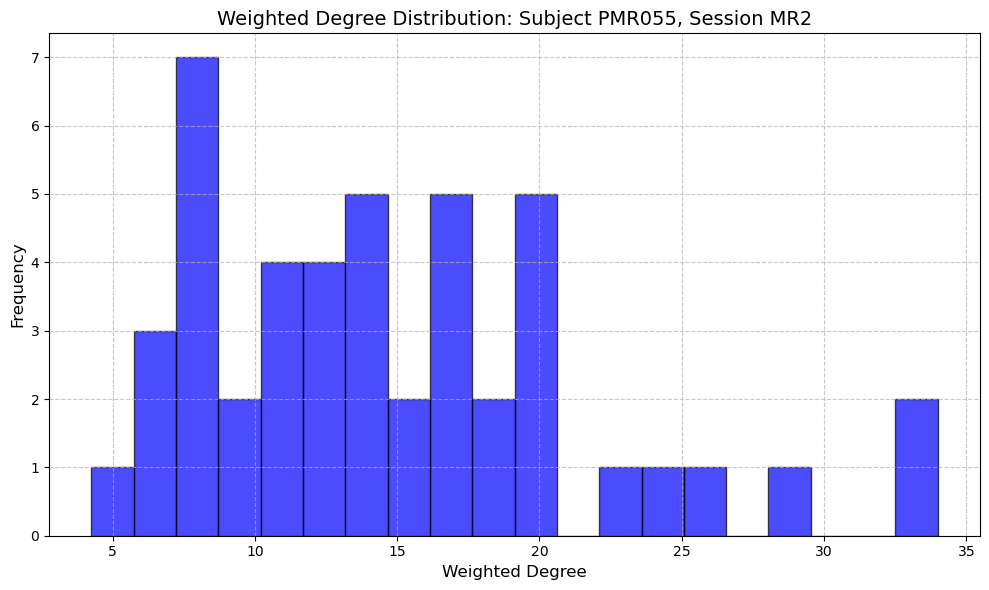

Processing connectome for subject PMR038, session MR2

Visualizations for subject PMR038, session MR2:


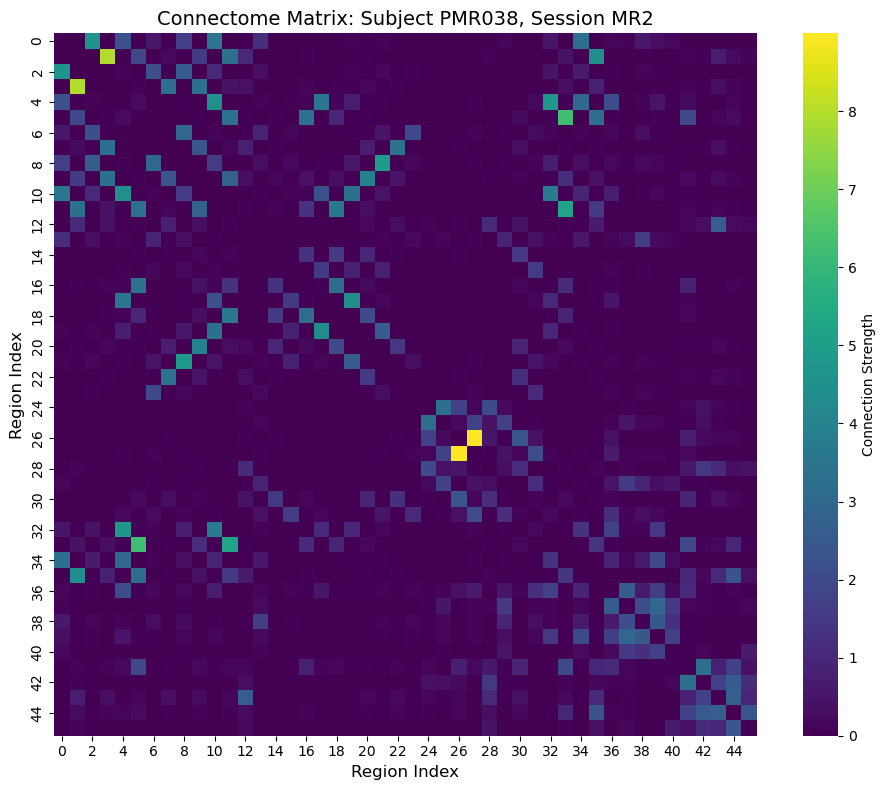

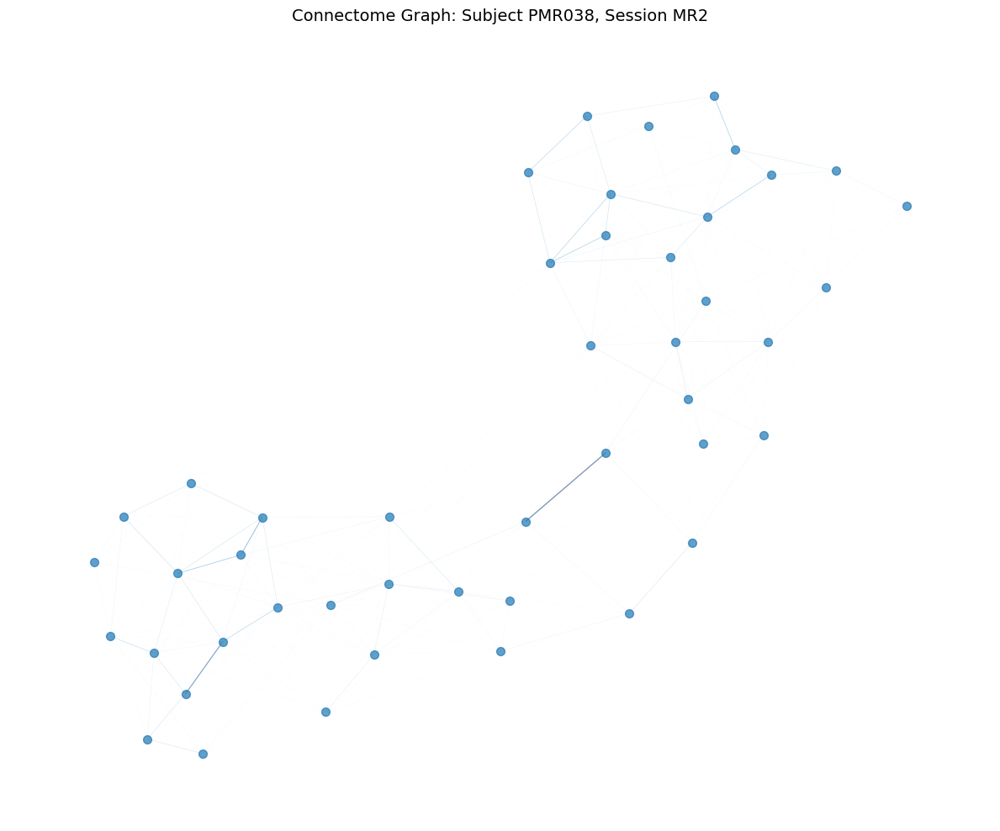

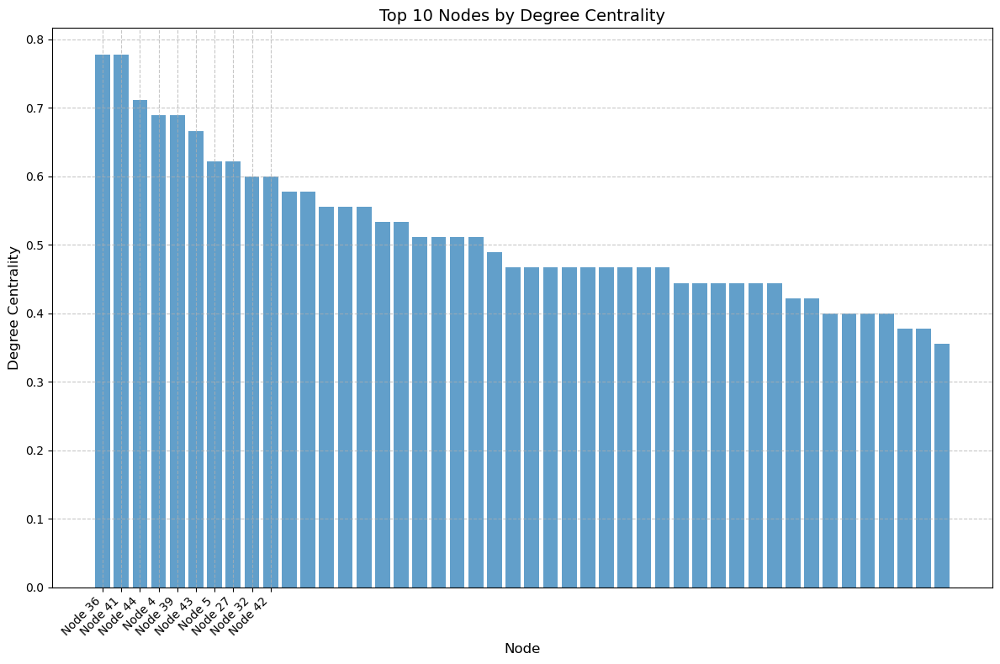

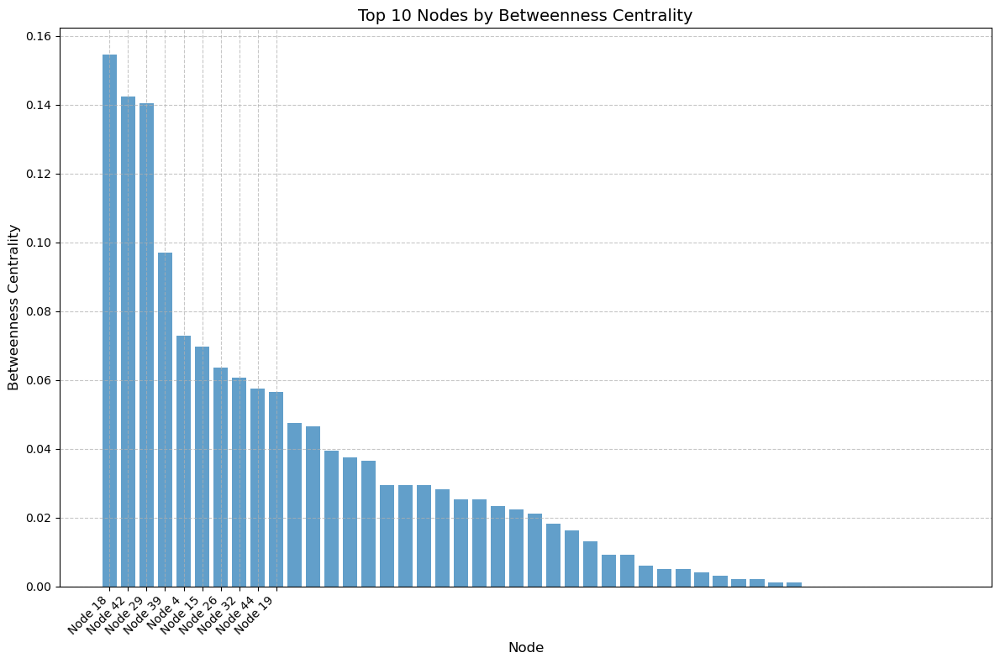

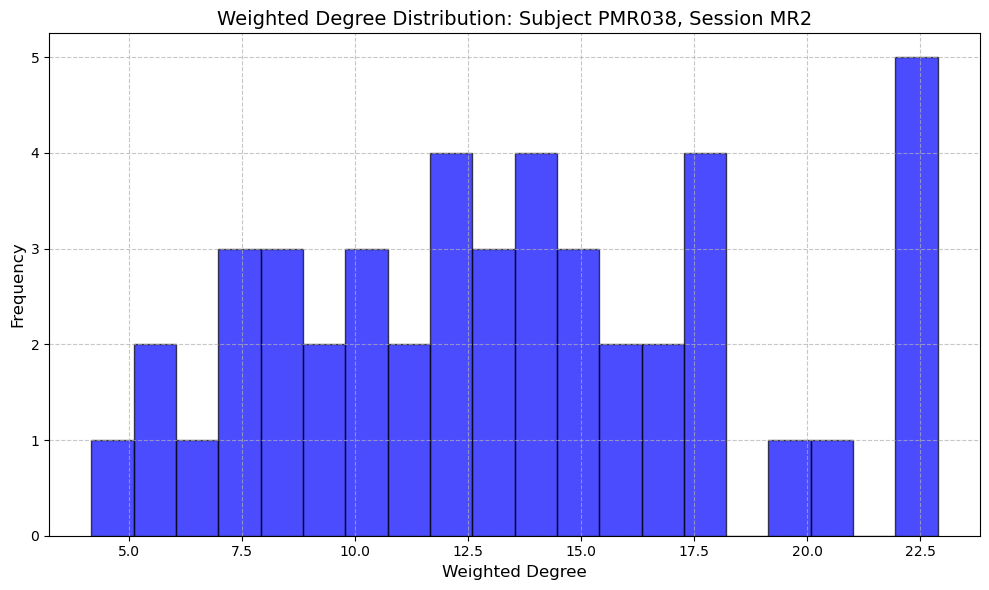

Processing connectome for subject PMR035, session MR2

Visualizations for subject PMR035, session MR2:


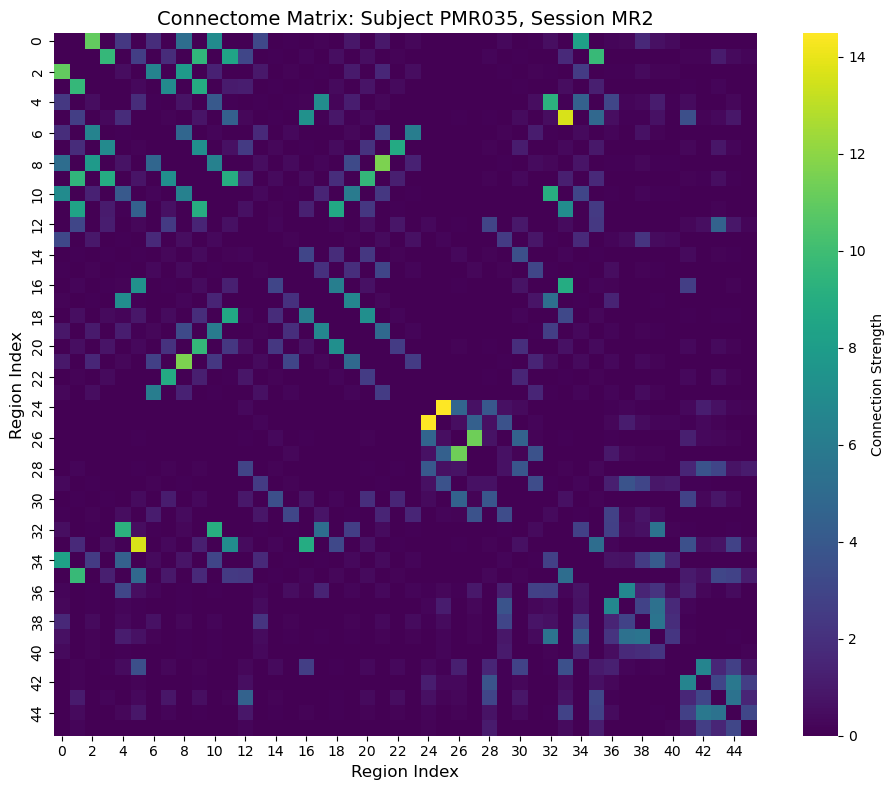

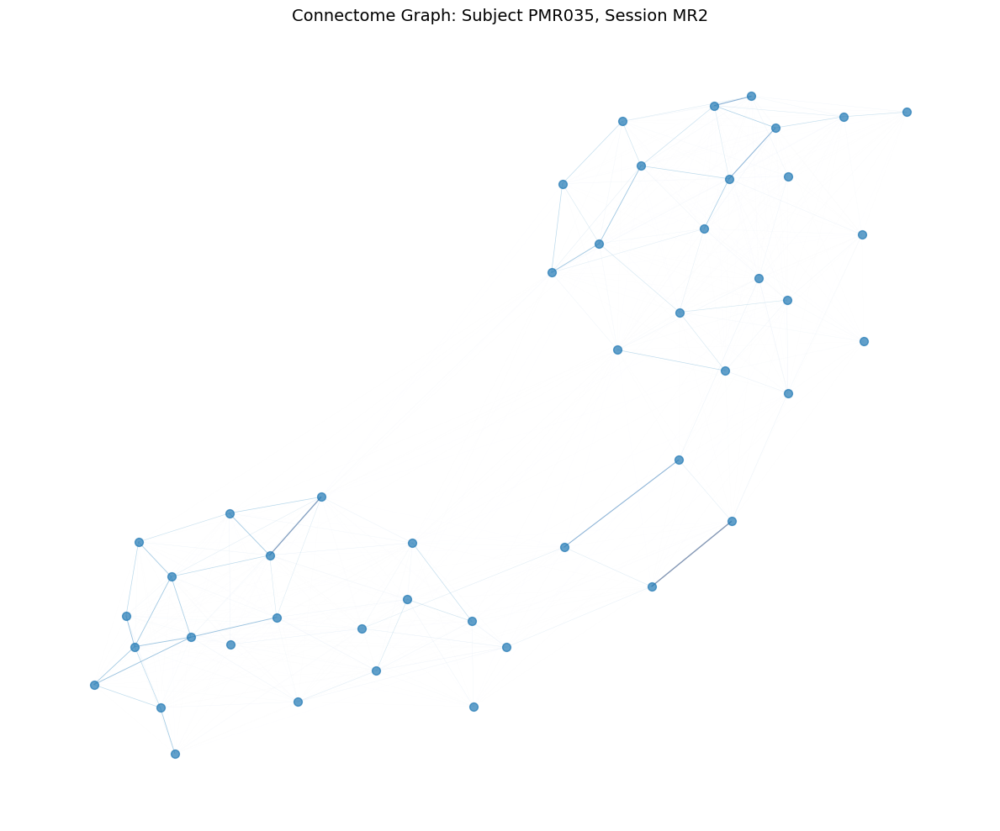

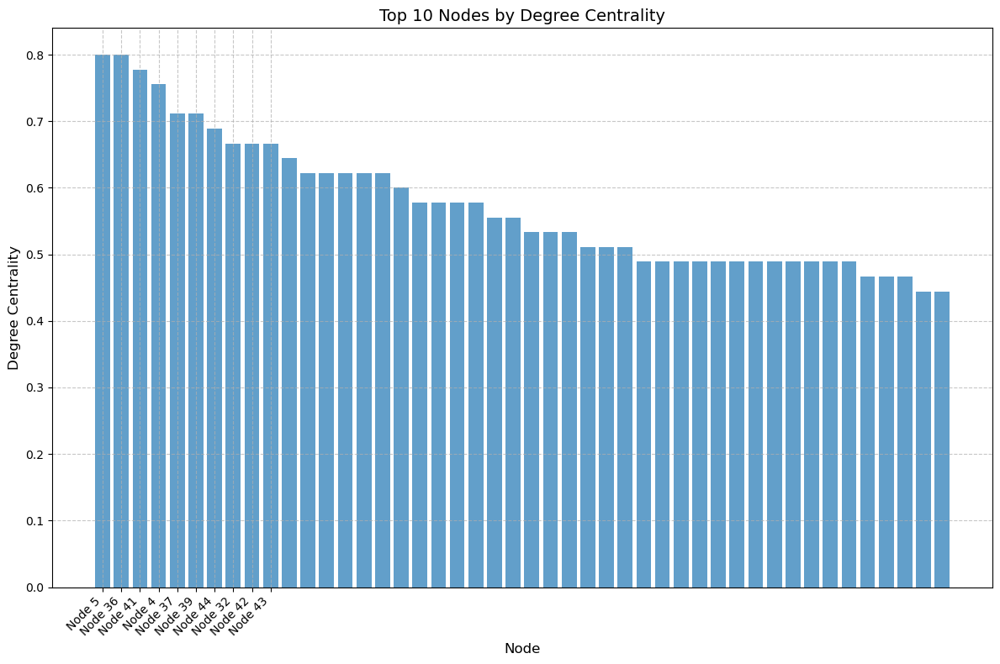

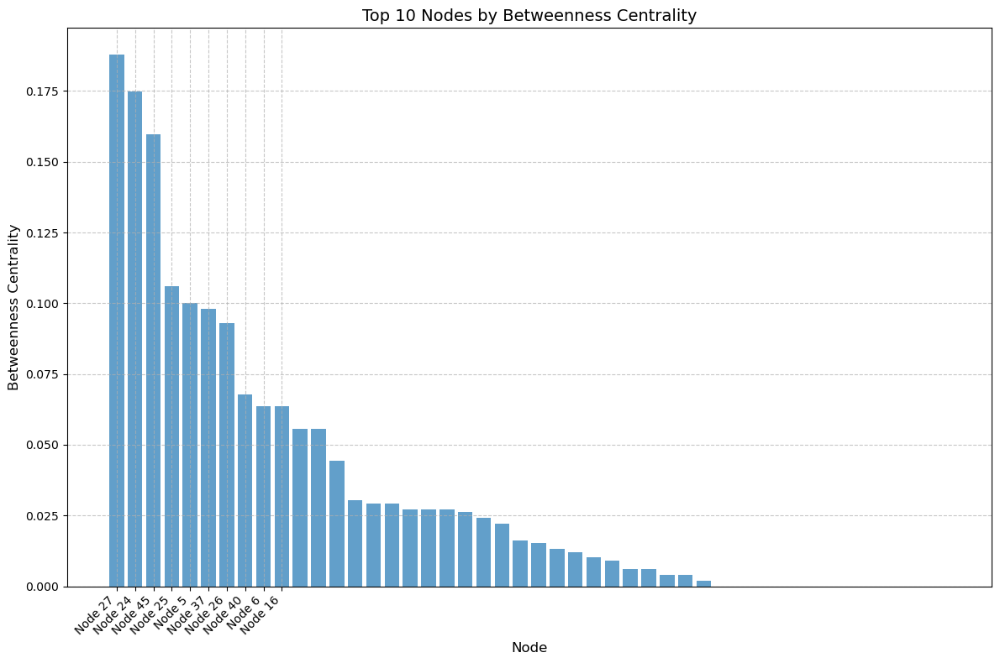

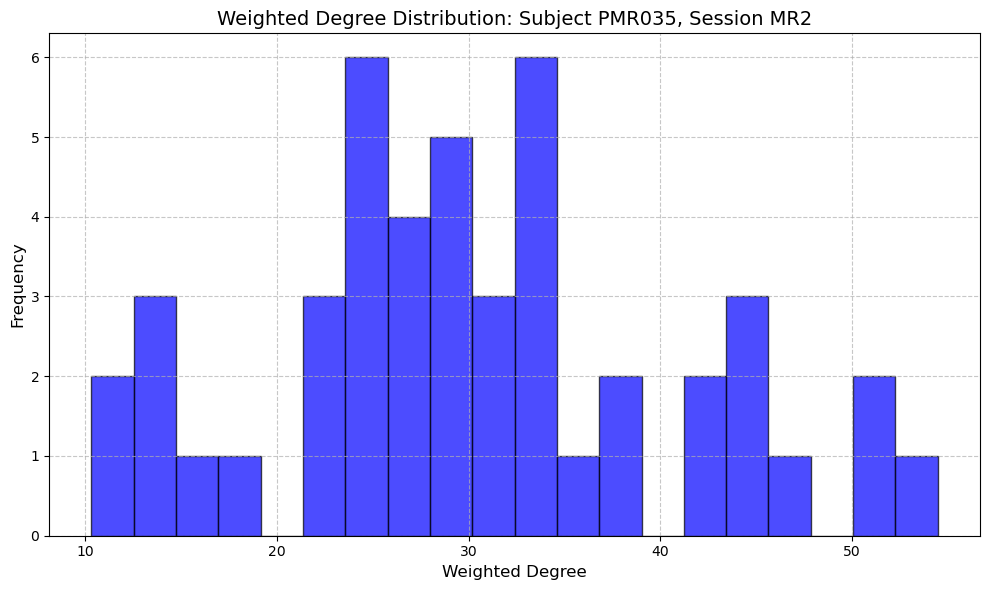

Processing connectome for subject PMR079, session MR2

Visualizations for subject PMR079, session MR2:


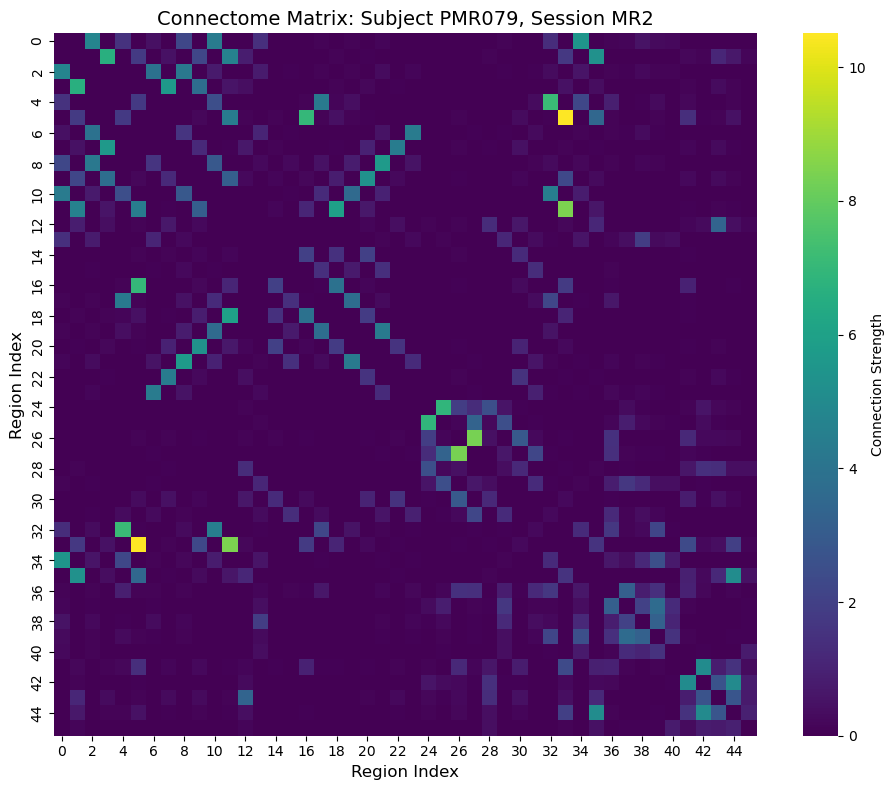

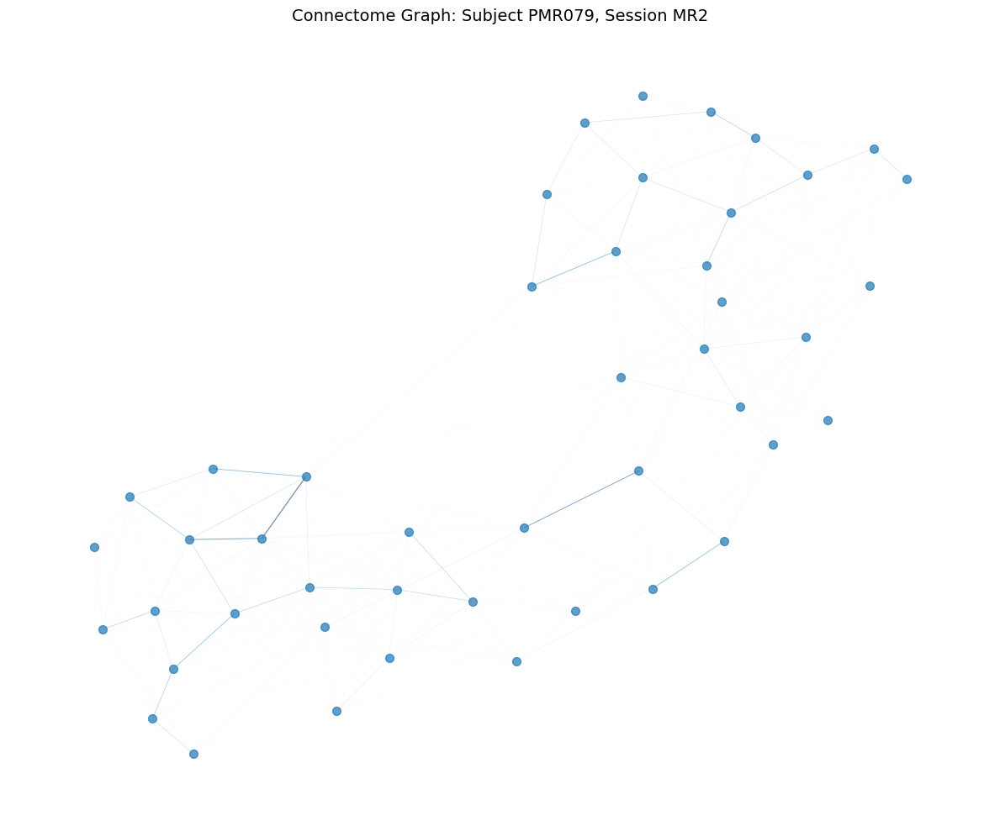

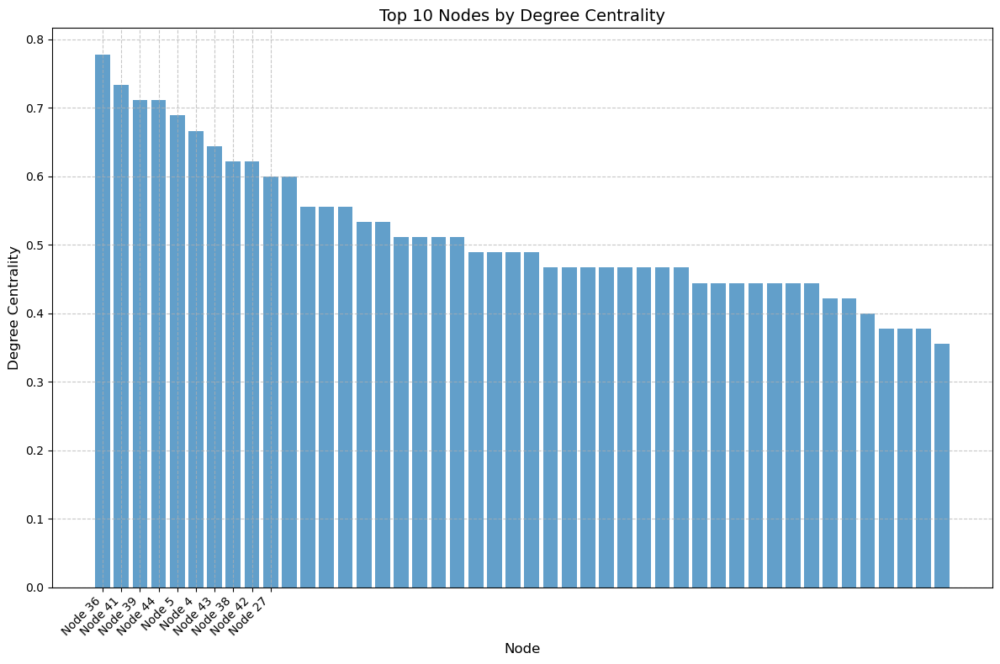

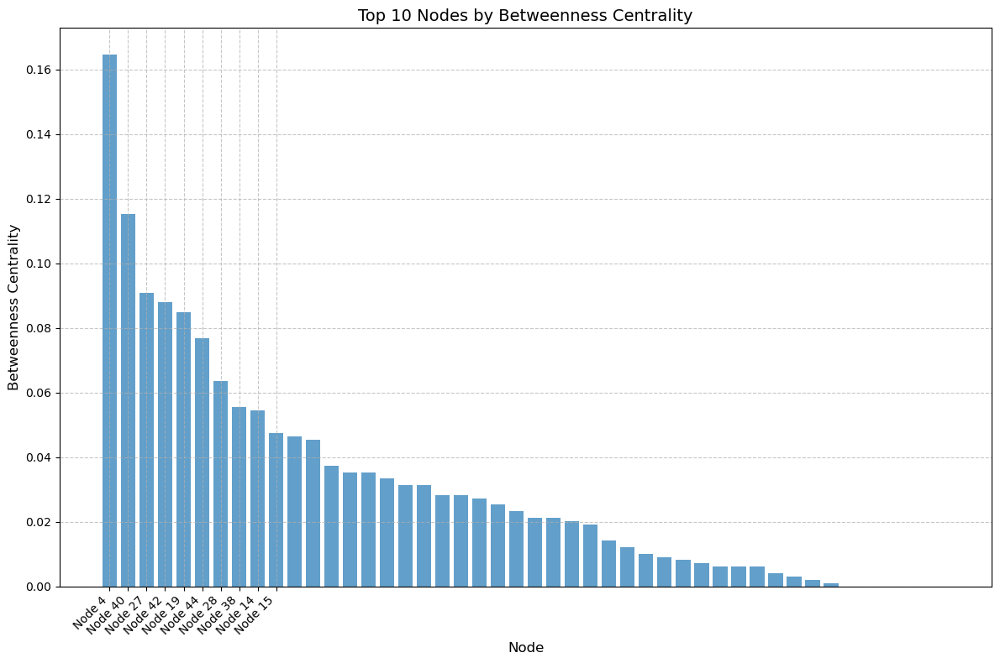

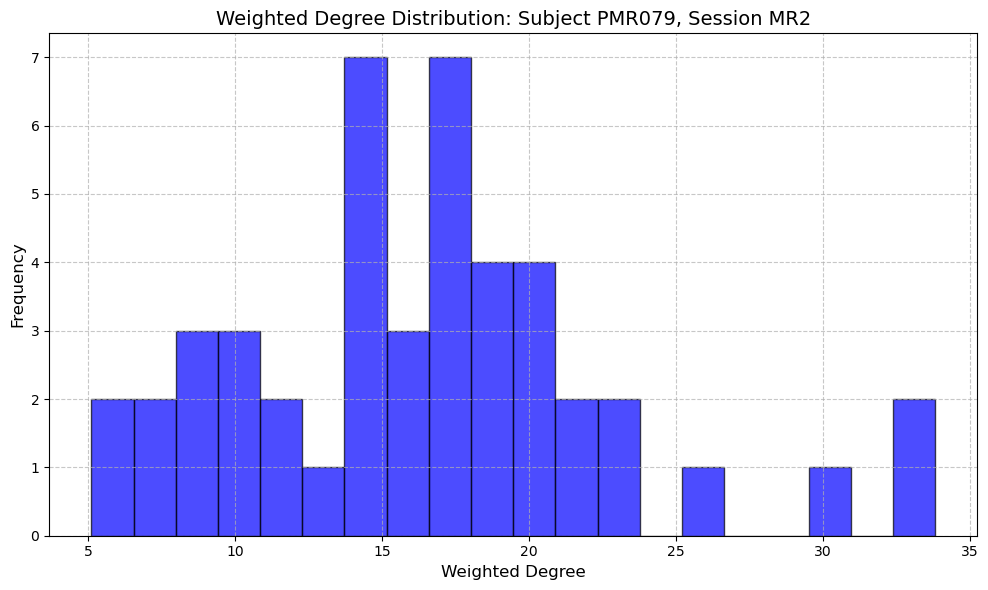

Processing connectome for subject PMR021, session MR2

Visualizations for subject PMR021, session MR2:


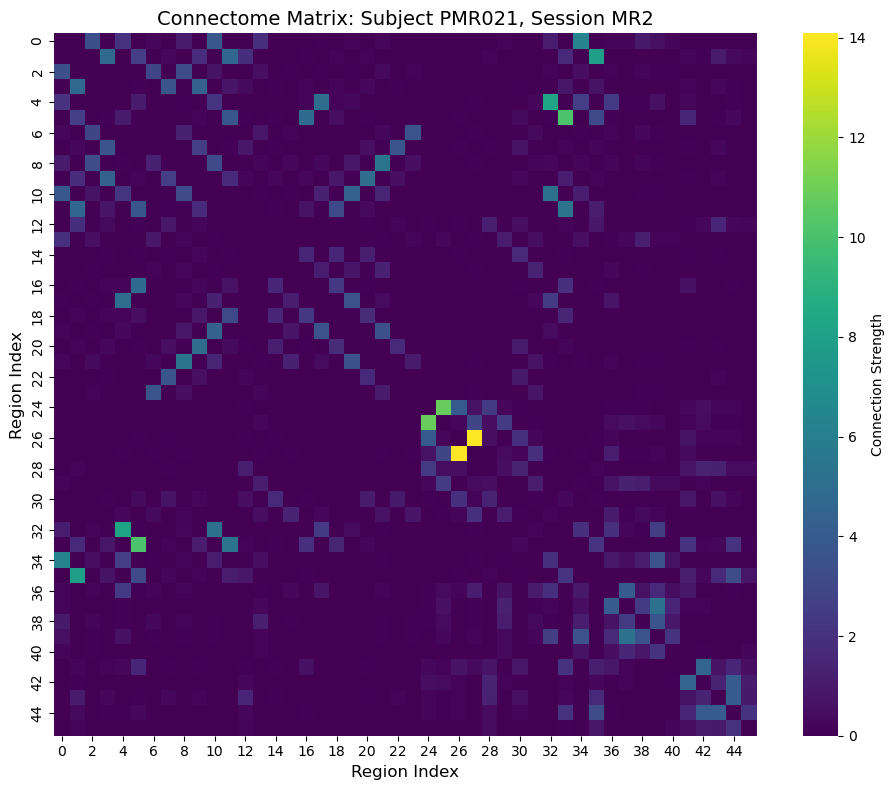

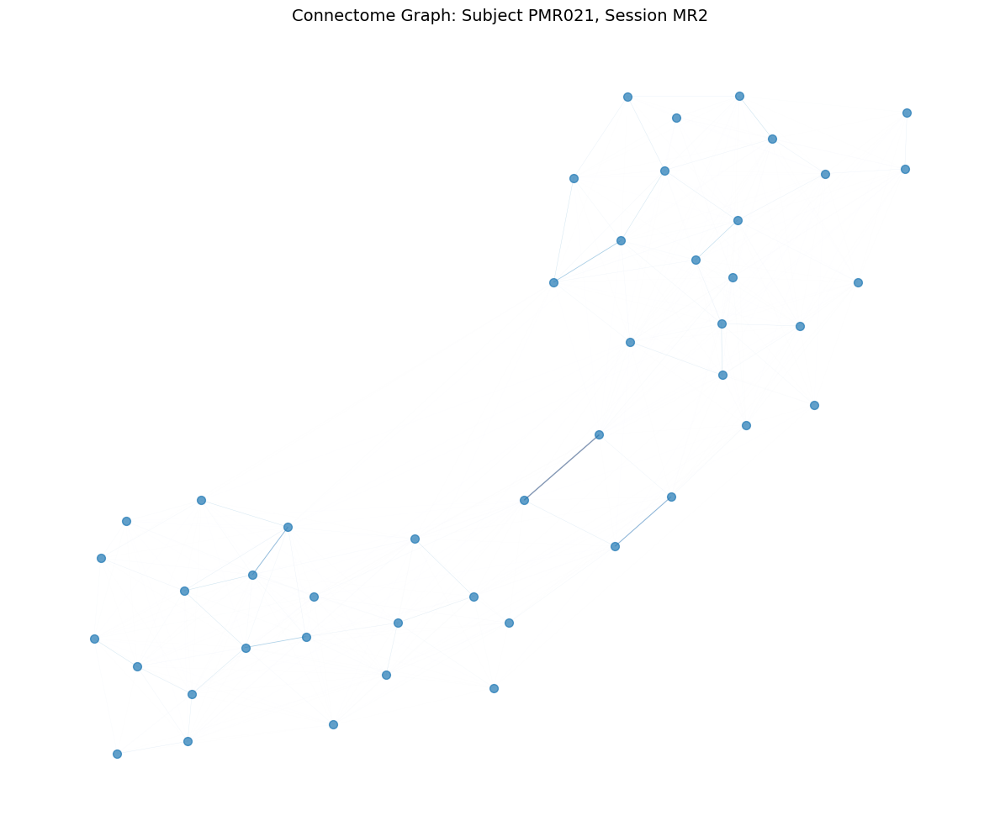

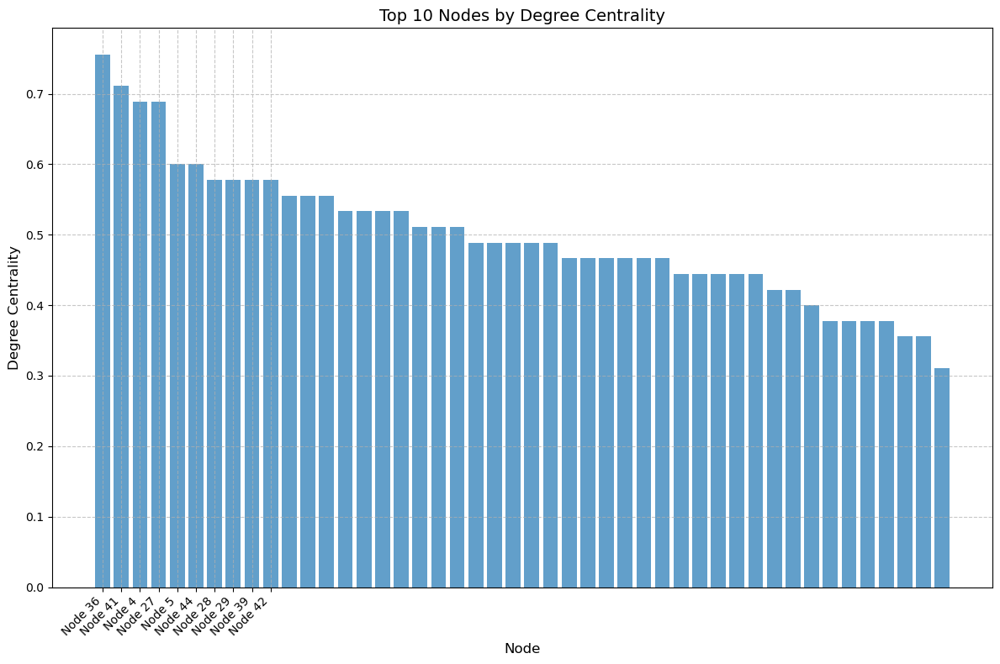

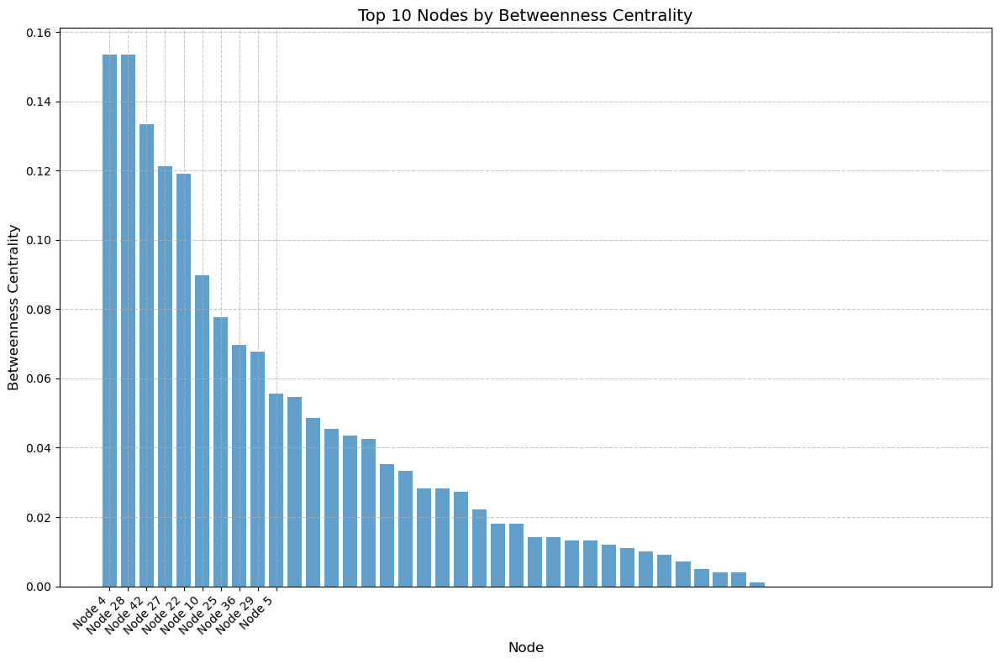

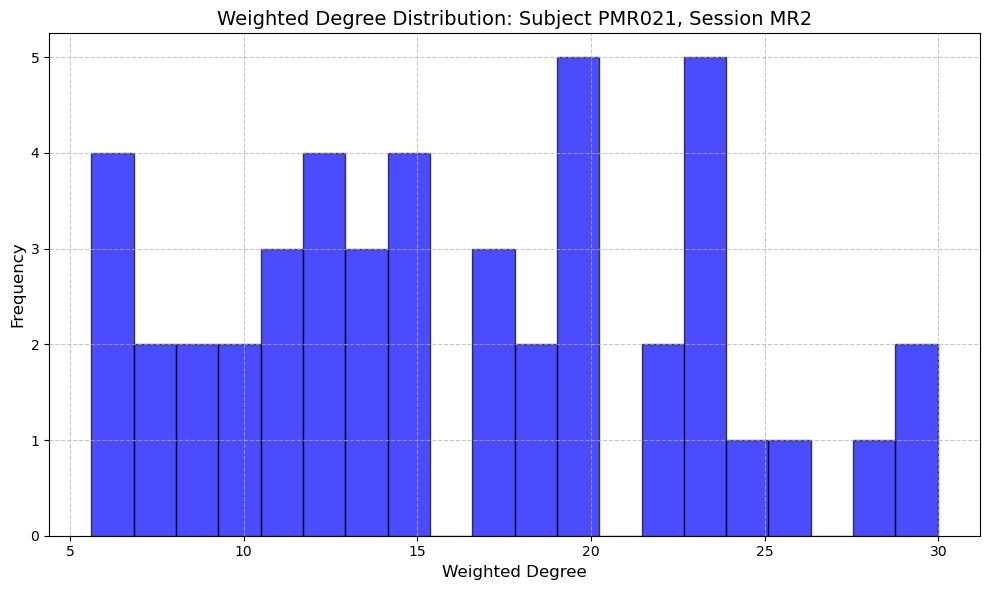

Processing connectome for subject PMR043, session MR2

Visualizations for subject PMR043, session MR2:


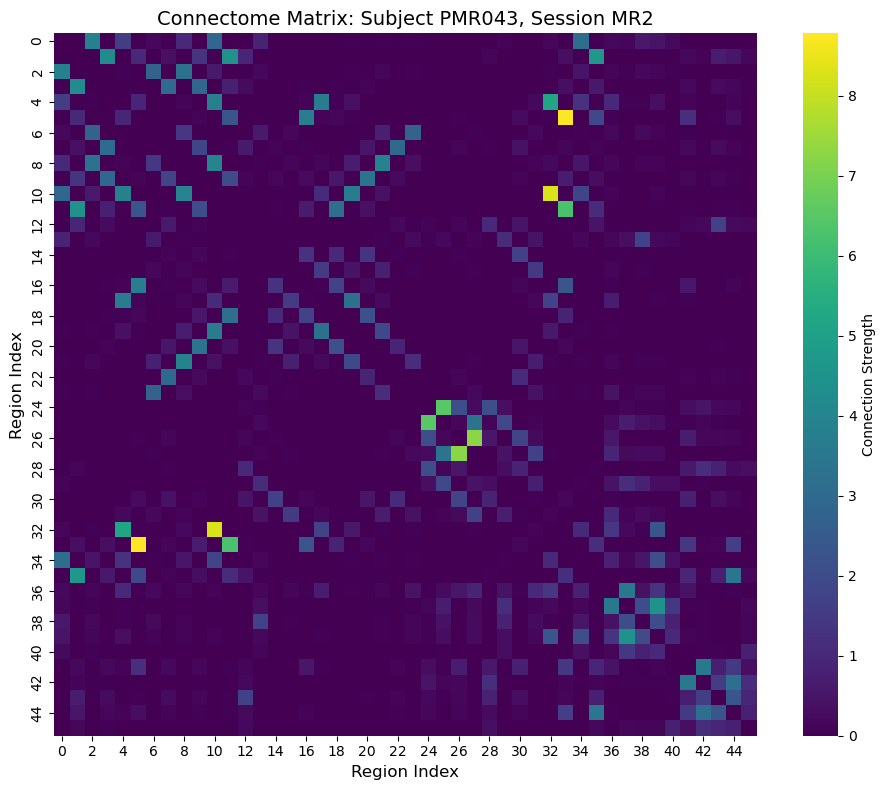

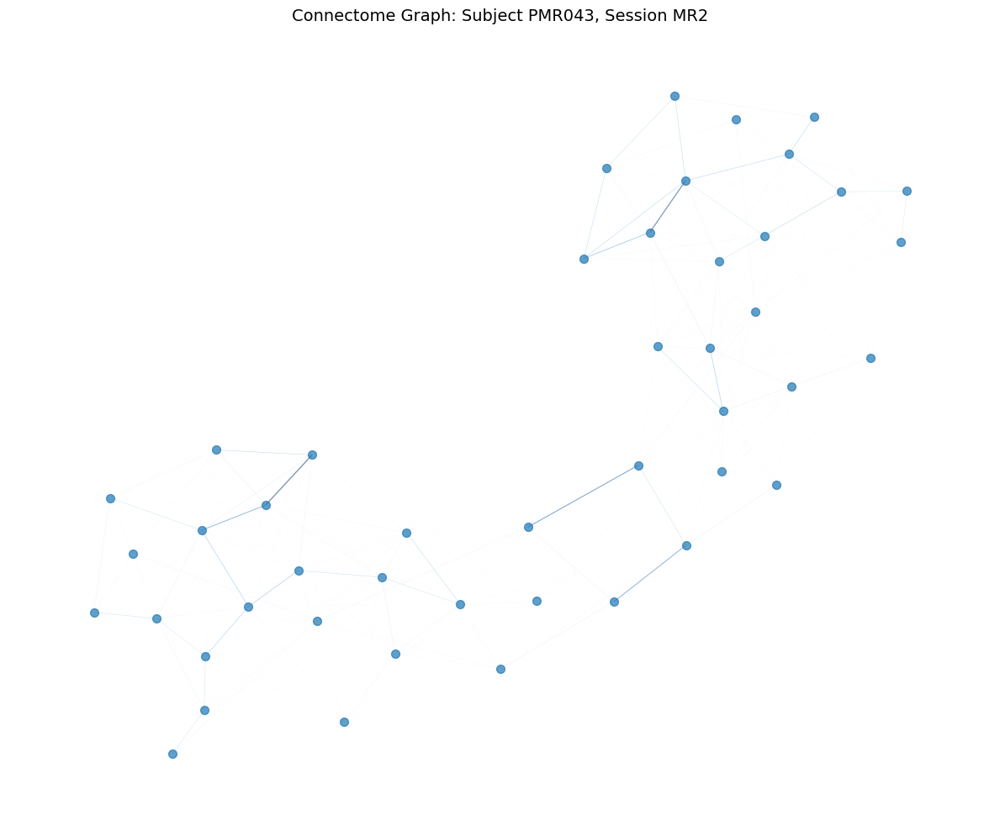

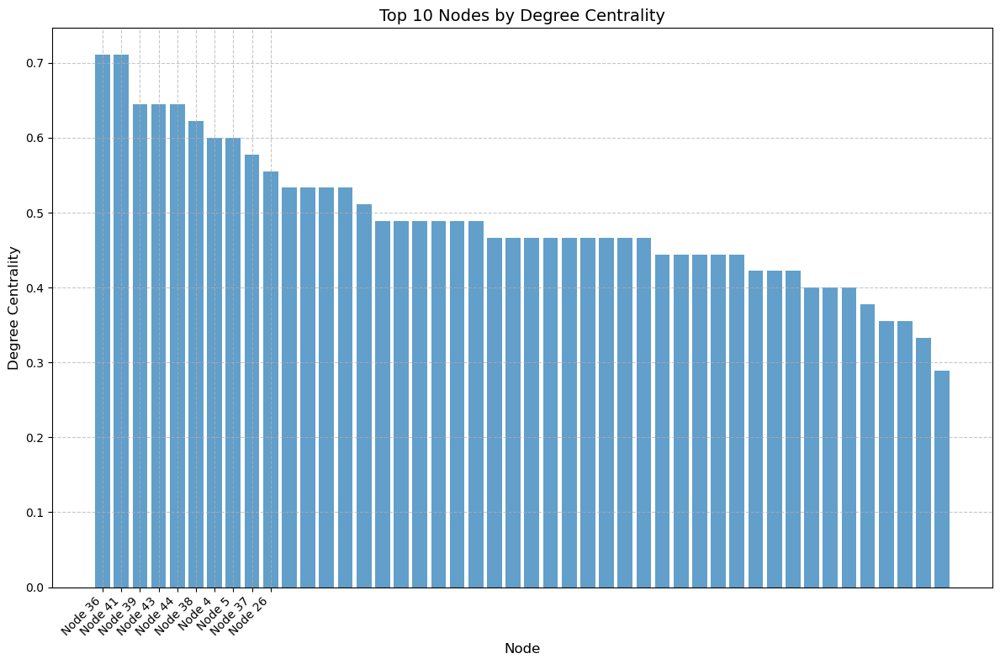

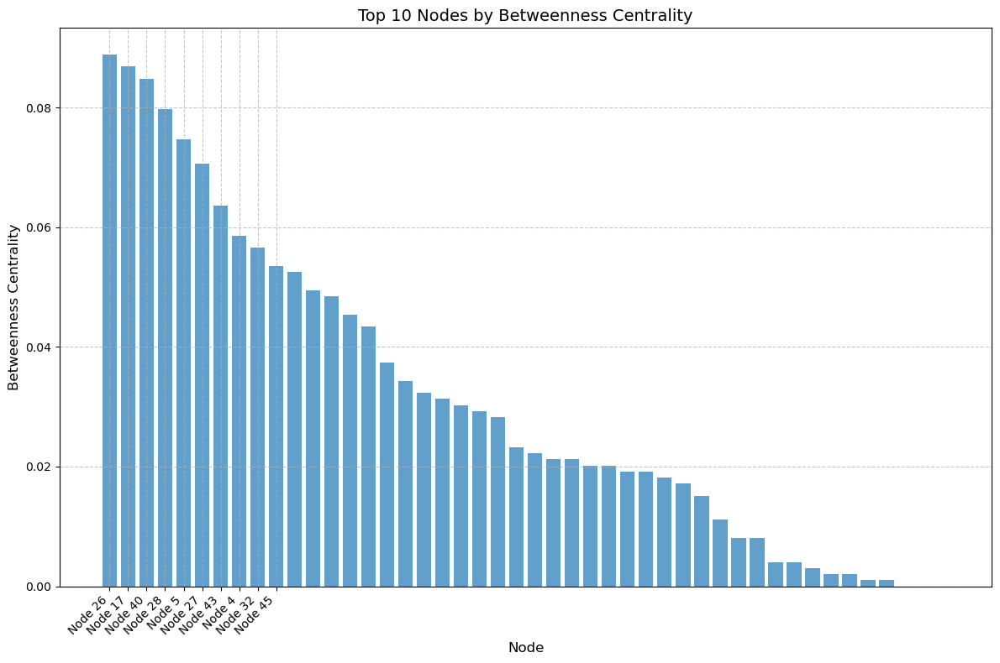

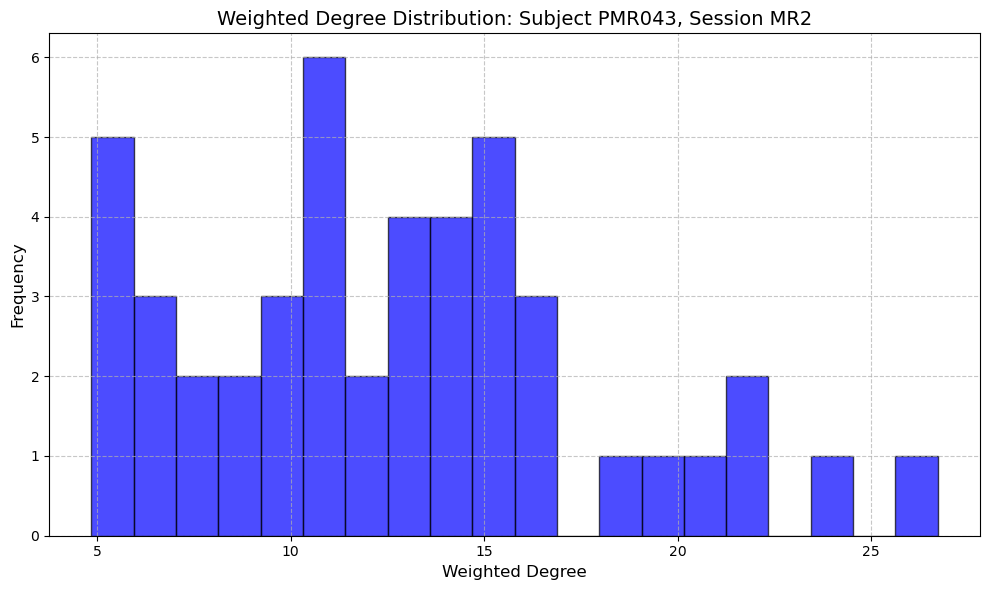

Processing connectome for subject PMR005, session MR2

Visualizations for subject PMR005, session MR2:


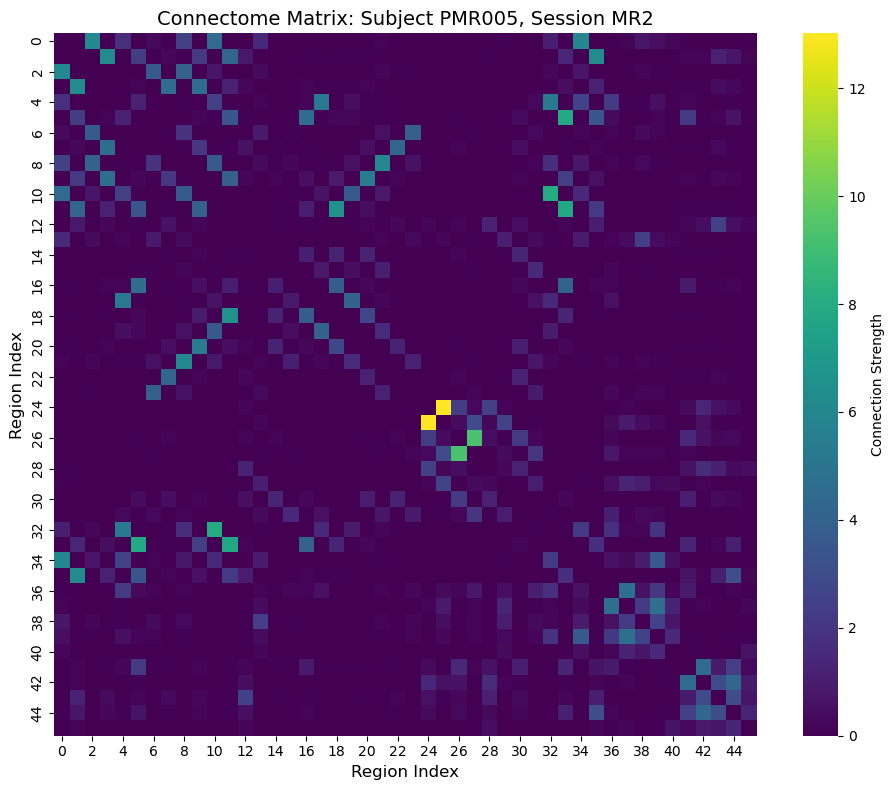

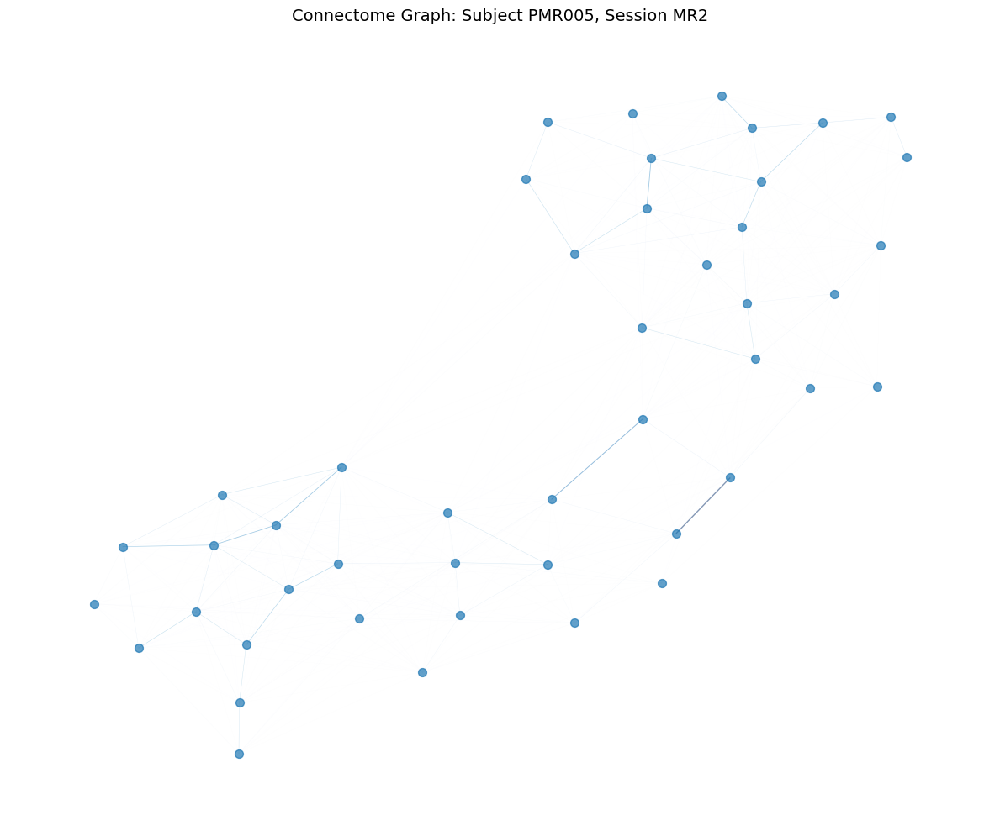

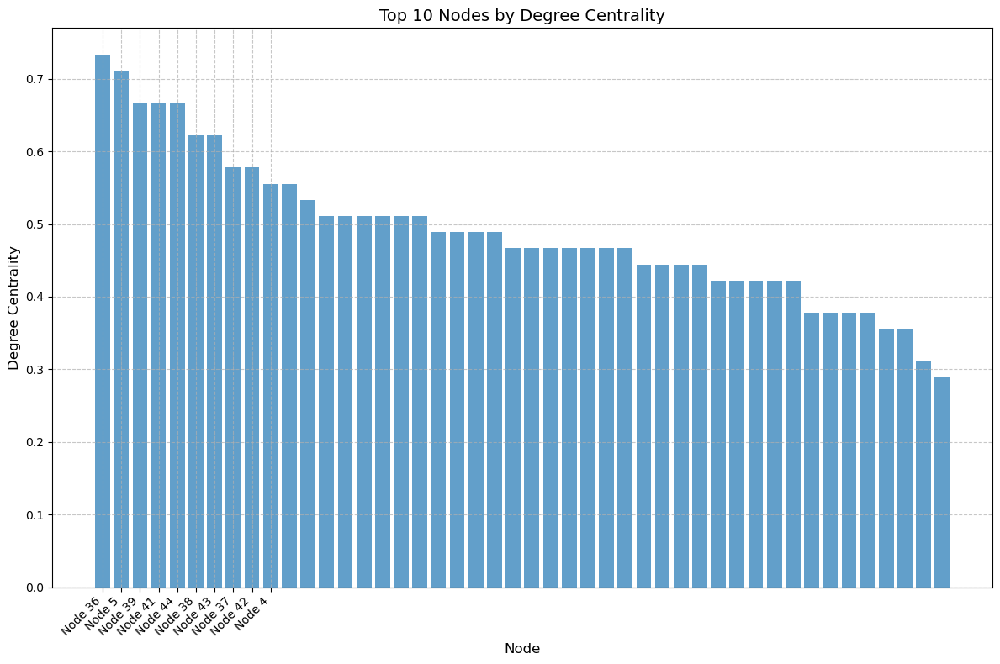

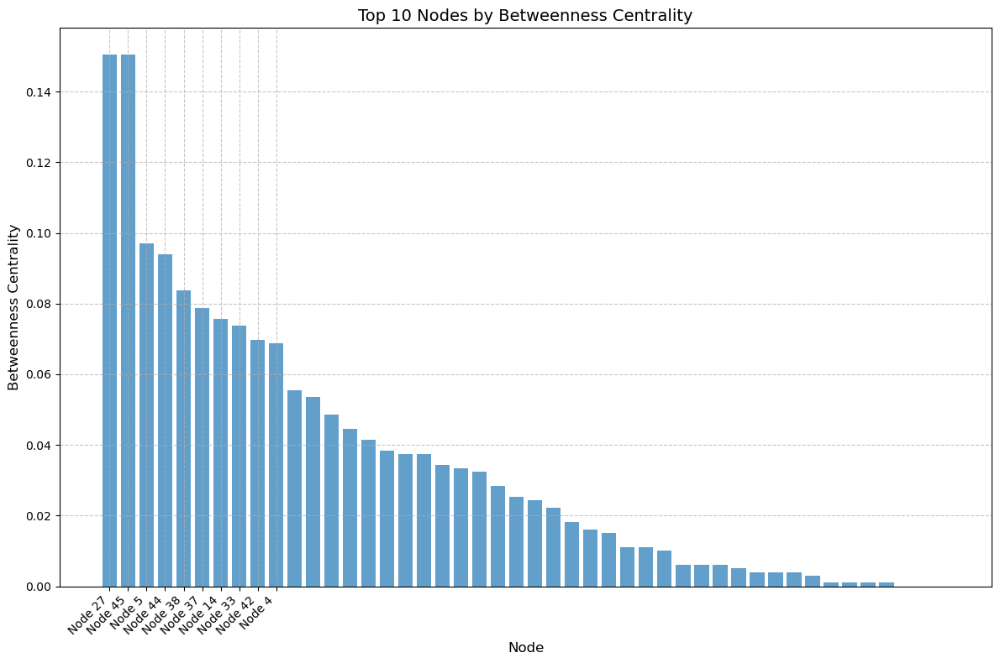

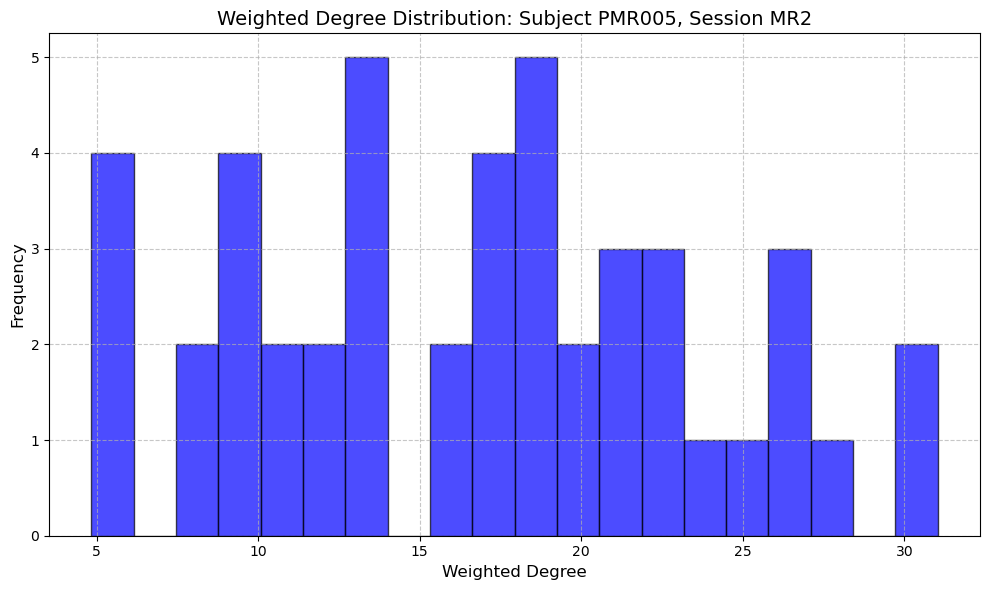

Processing connectome for subject PMR089, session MR2

Visualizations for subject PMR089, session MR2:


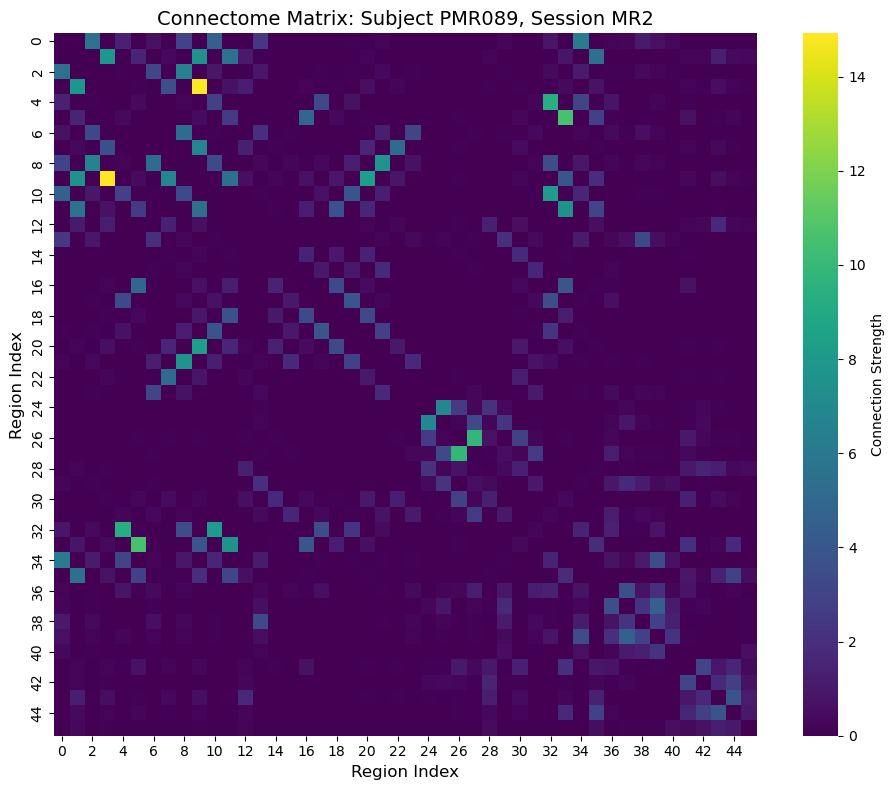

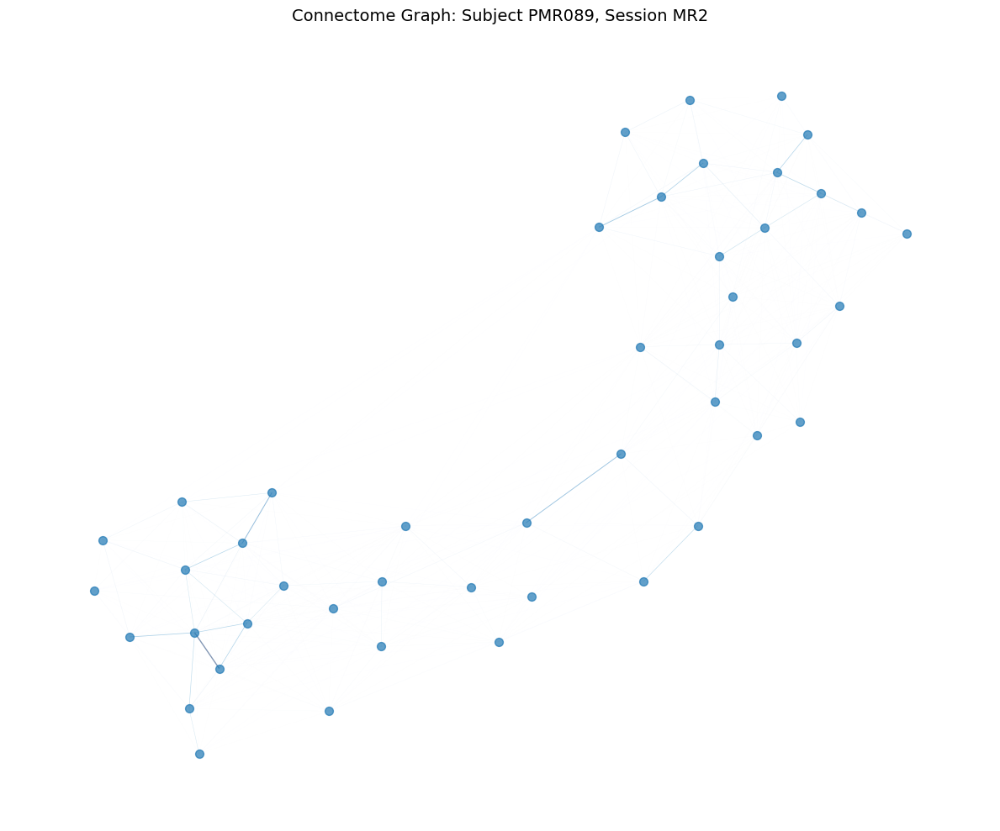

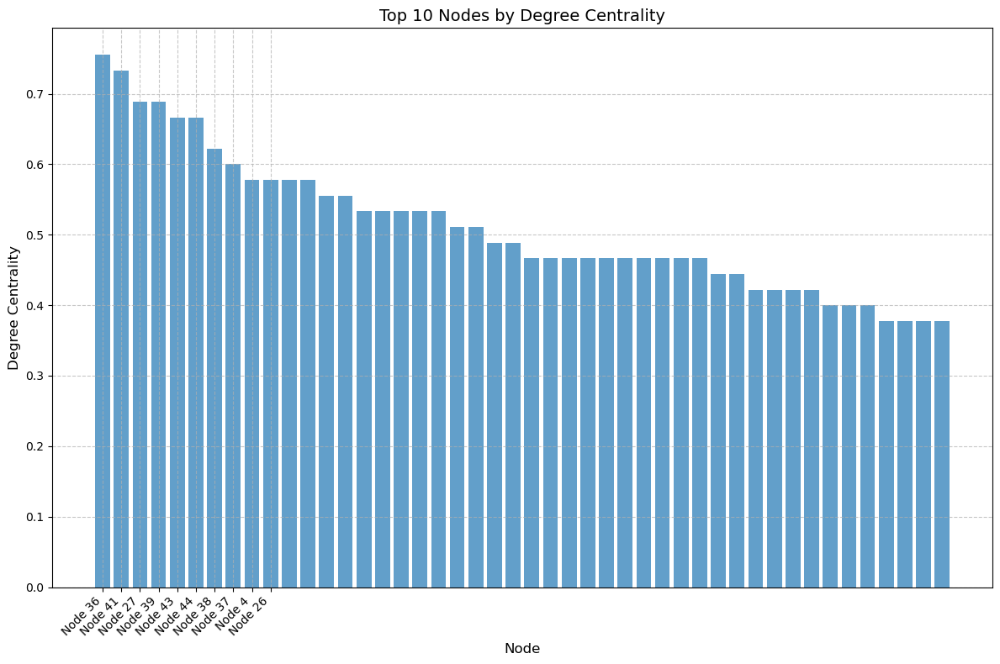

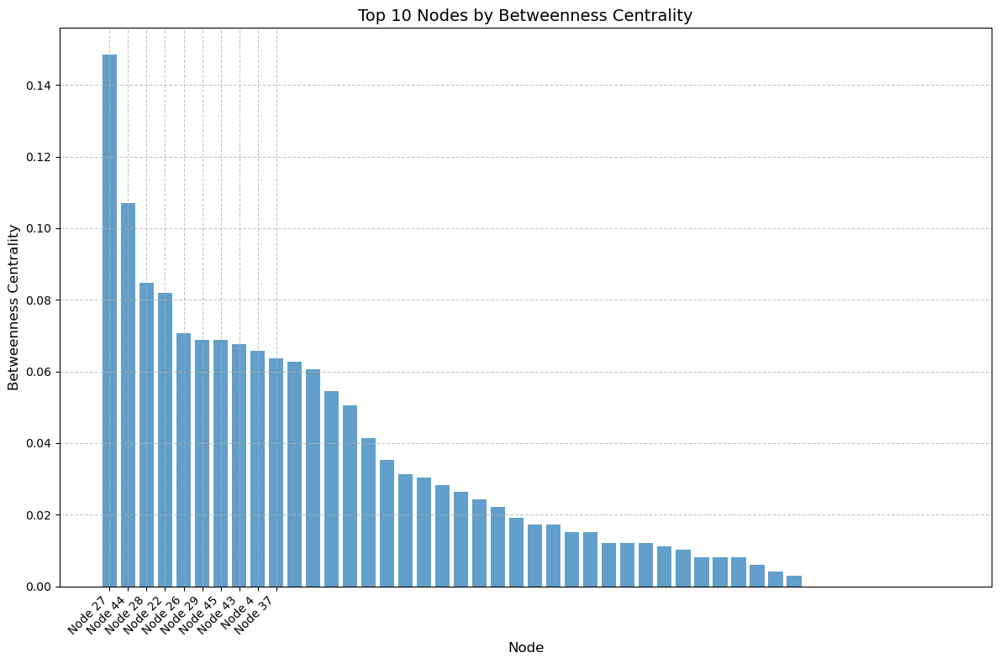

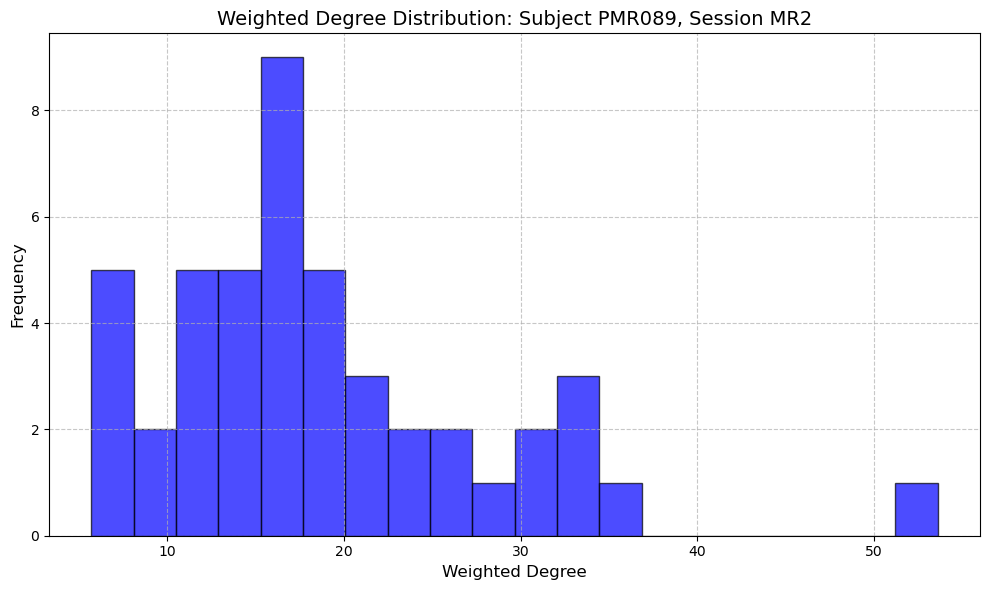

Processing connectome for subject PMR077, session MR2

Visualizations for subject PMR077, session MR2:


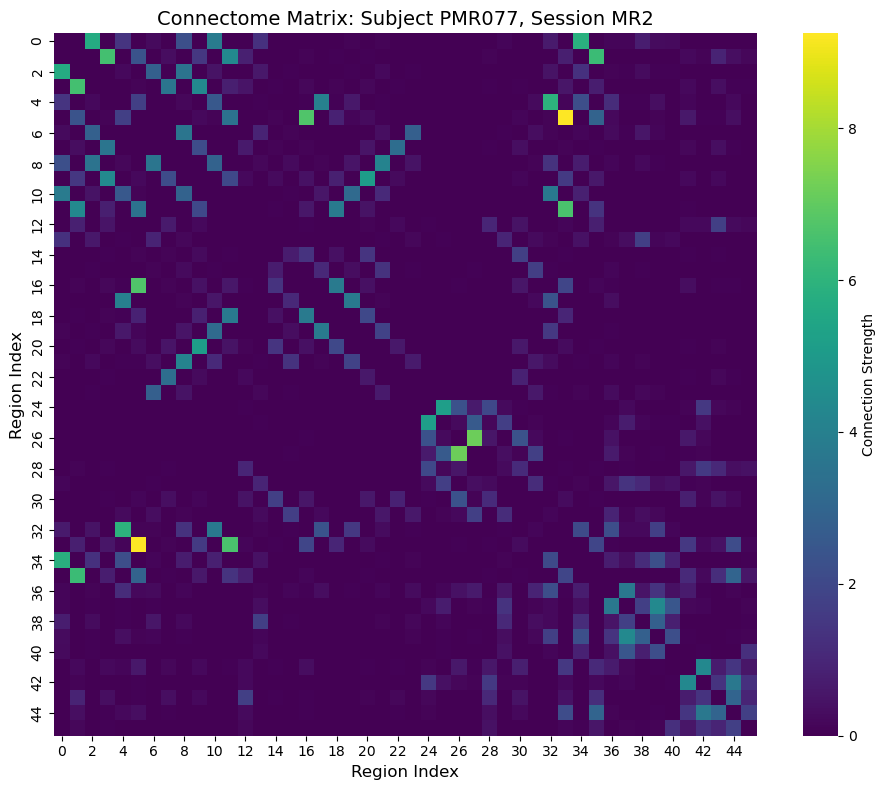

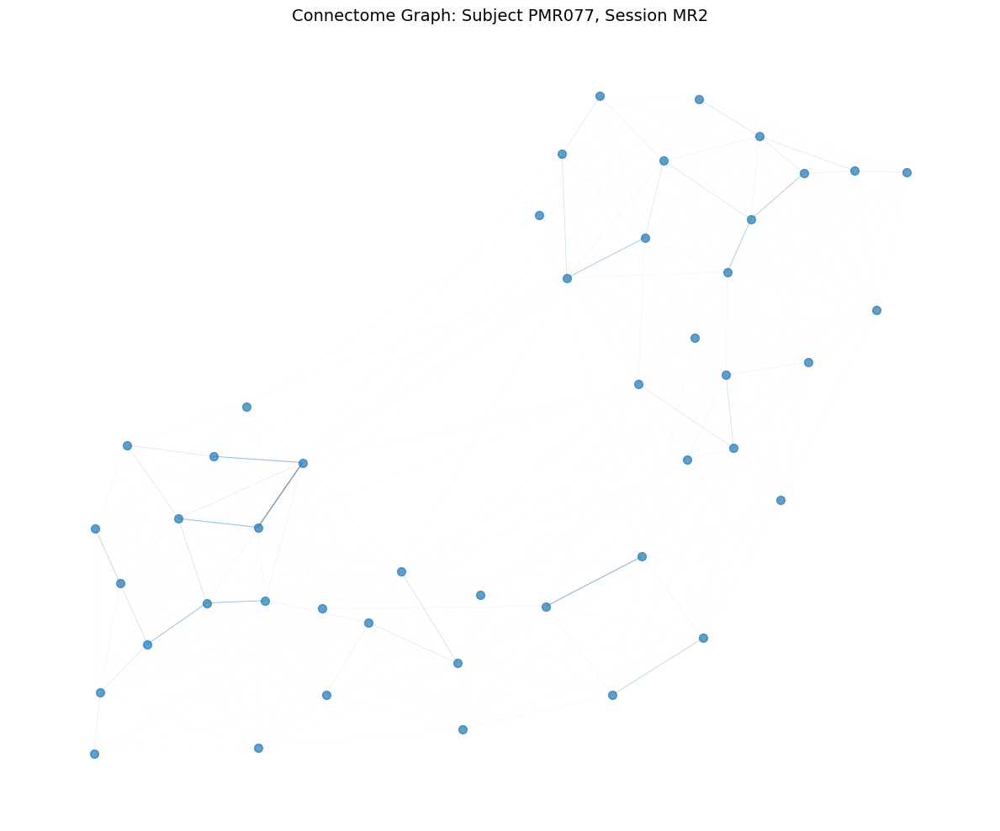

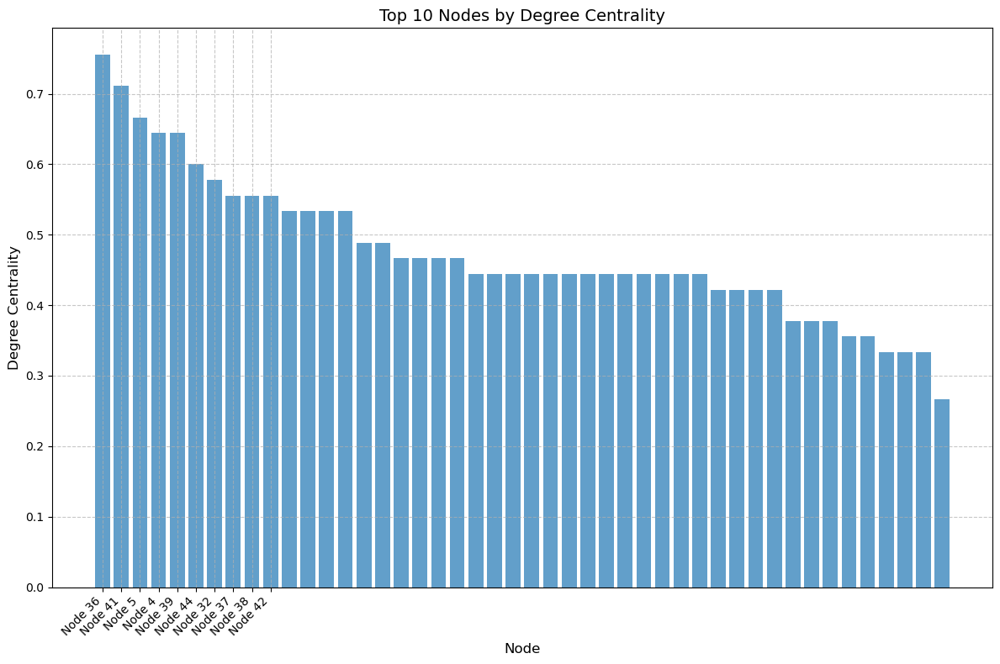

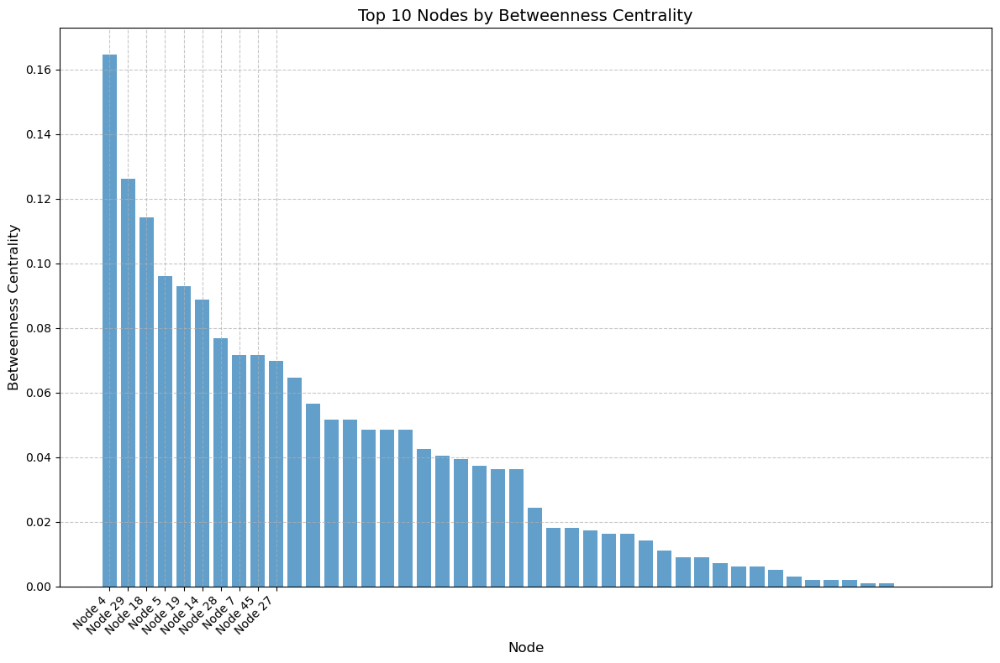

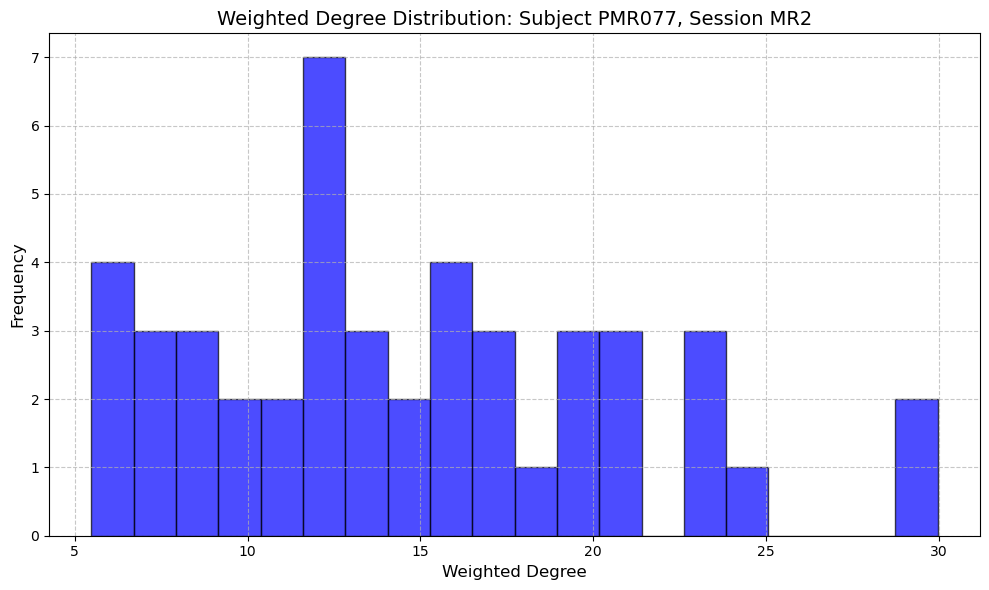

Processing connectome for subject PMR042, session MR2

Visualizations for subject PMR042, session MR2:


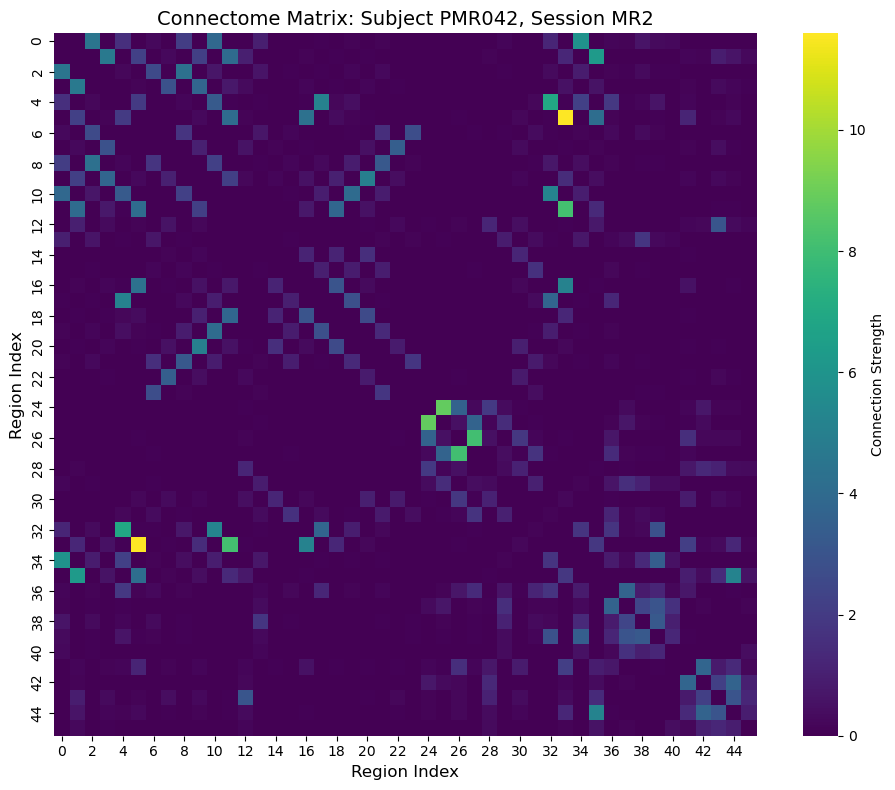

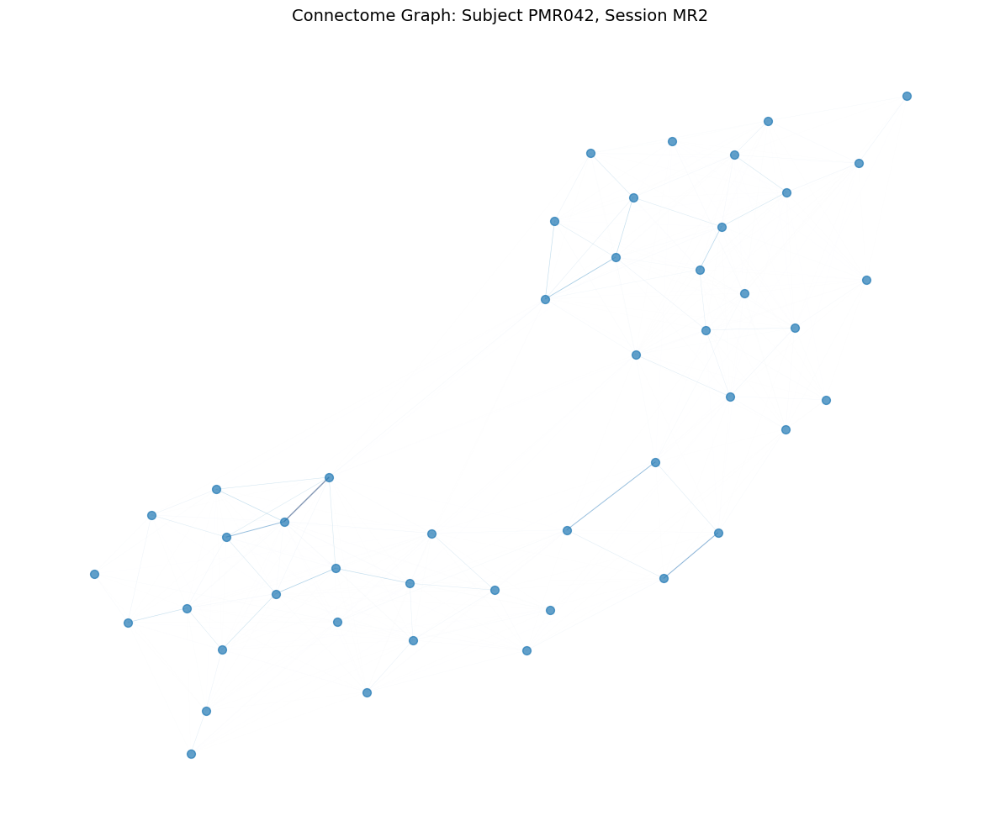

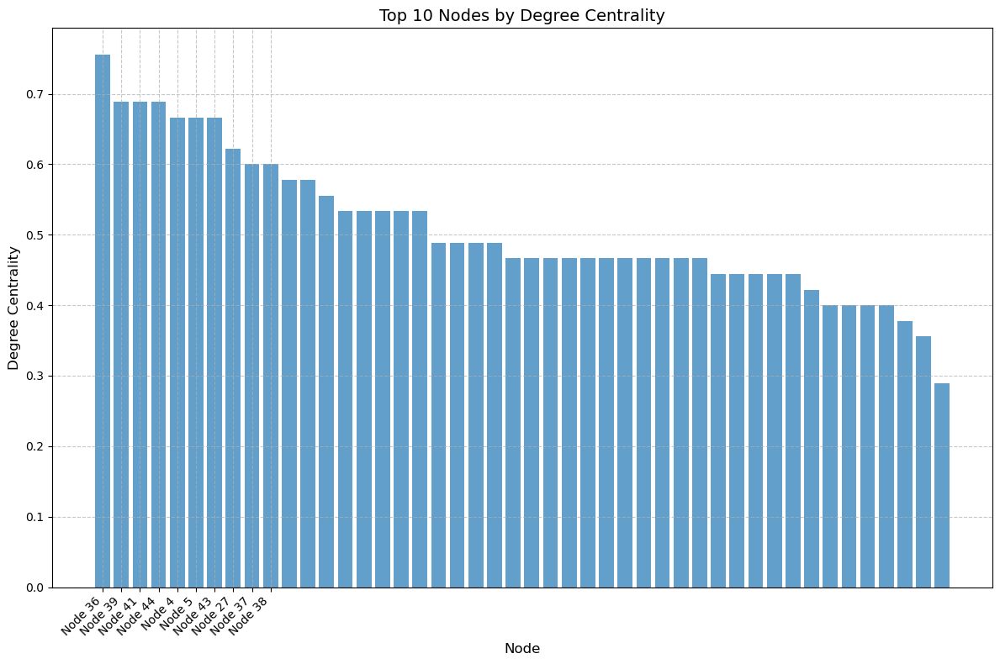

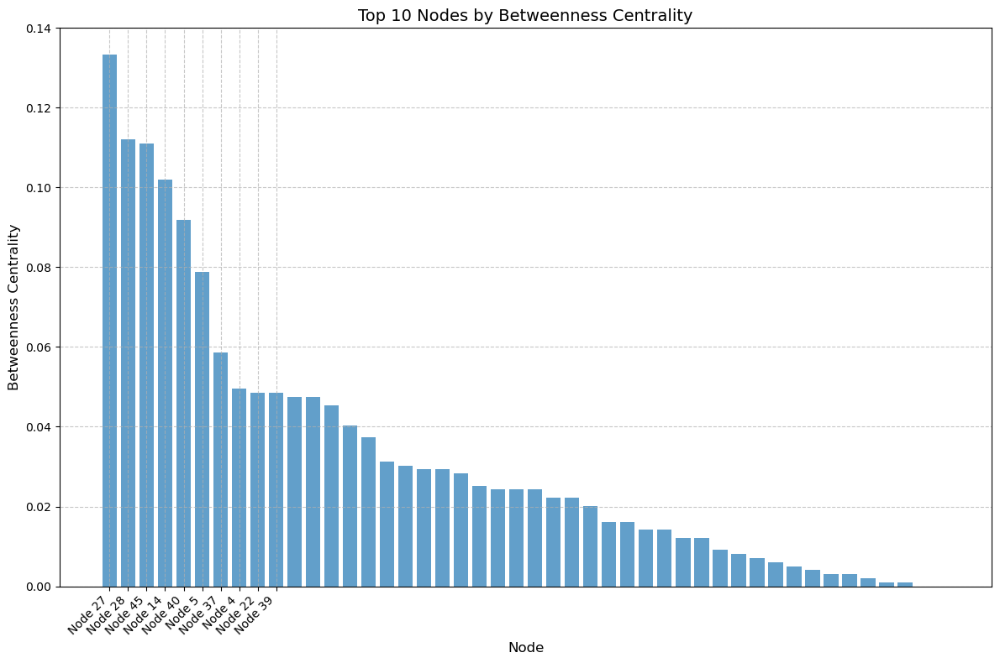

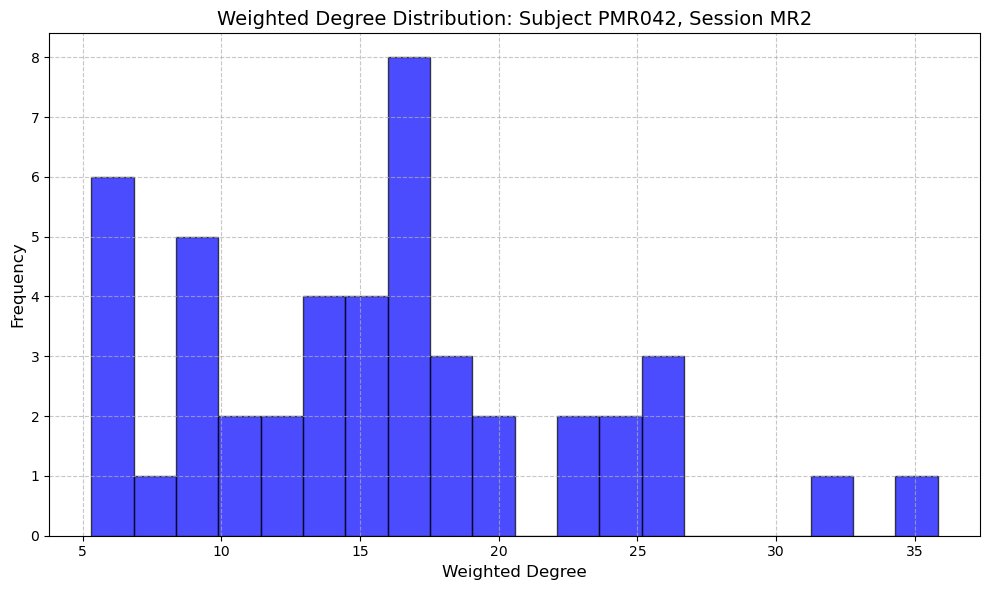

Processing connectome for subject PMR065, session MR2

Visualizations for subject PMR065, session MR2:


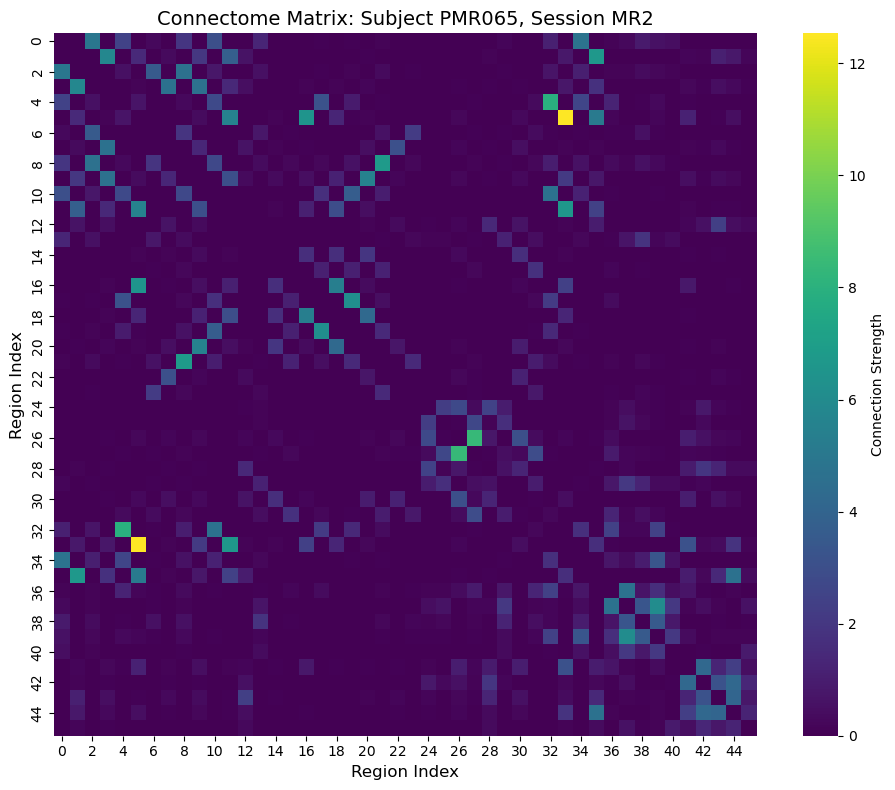

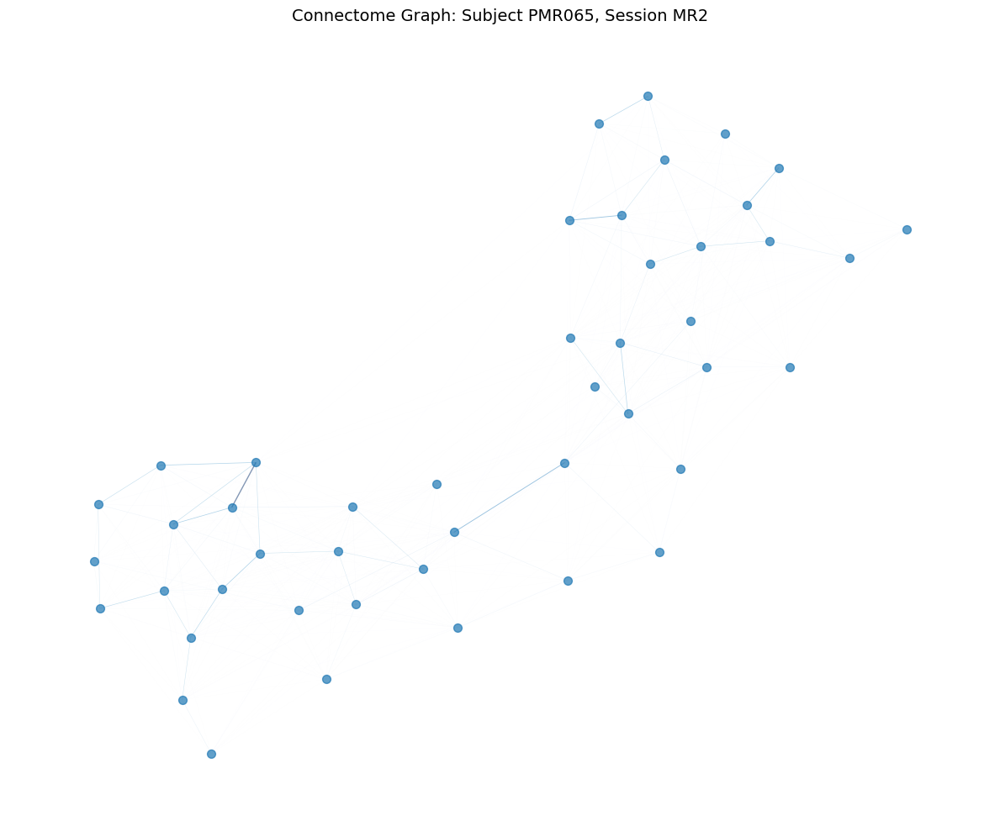

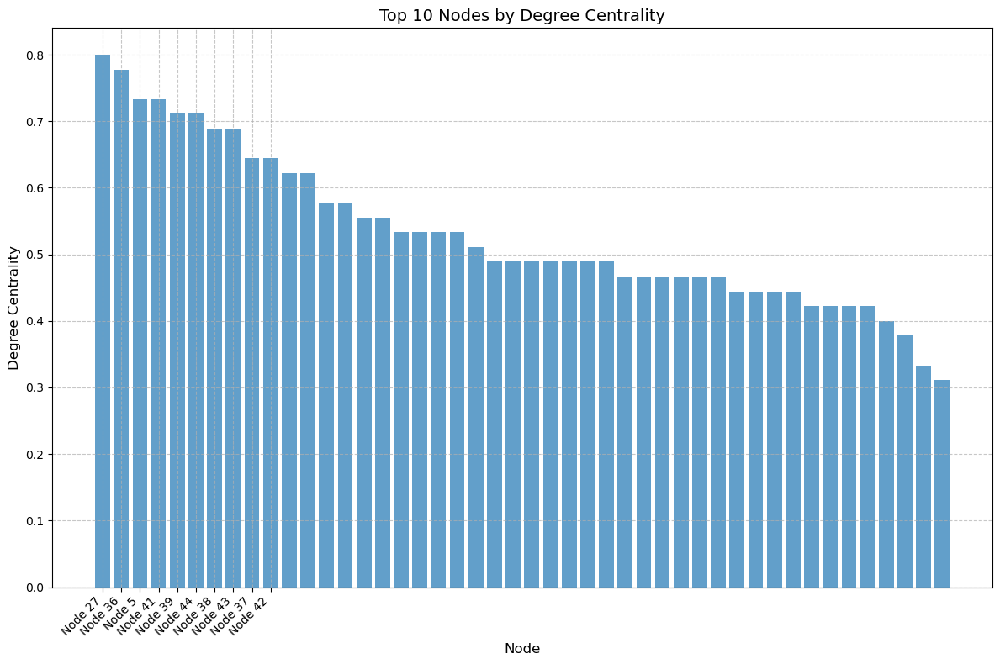

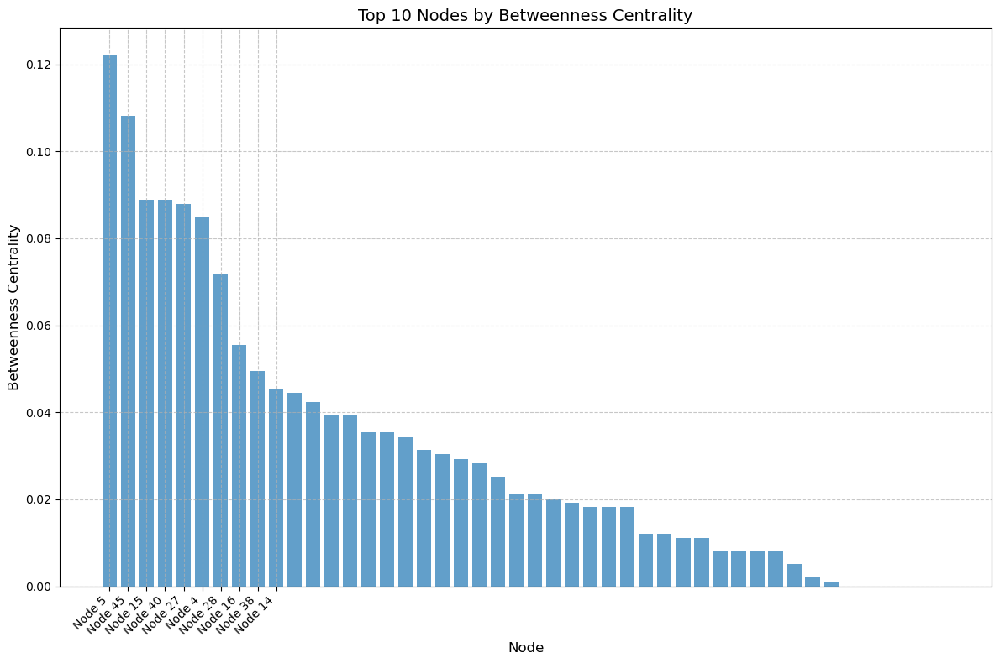

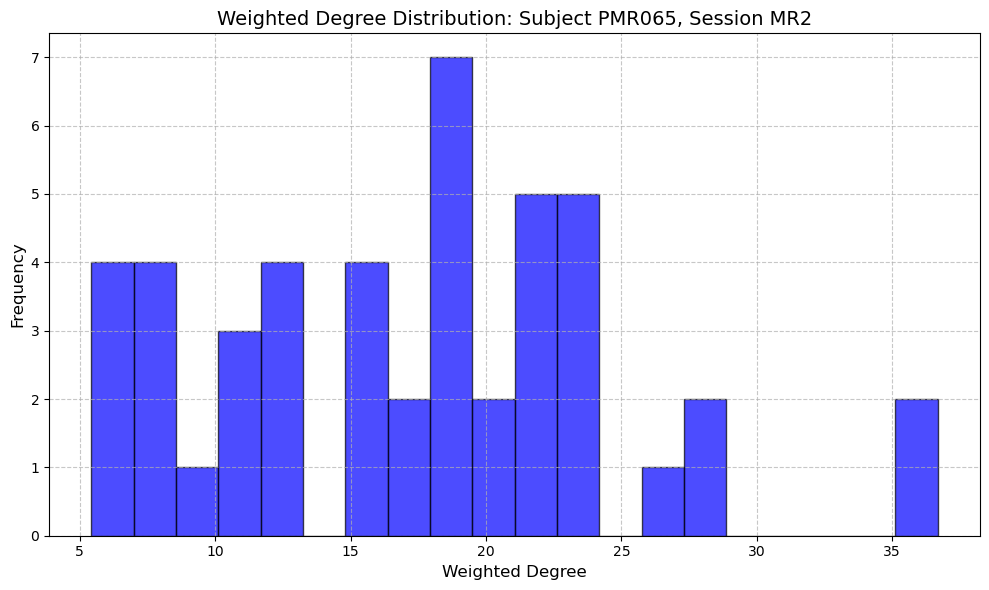

Processing connectome for subject PMR017, session MR2

Visualizations for subject PMR017, session MR2:


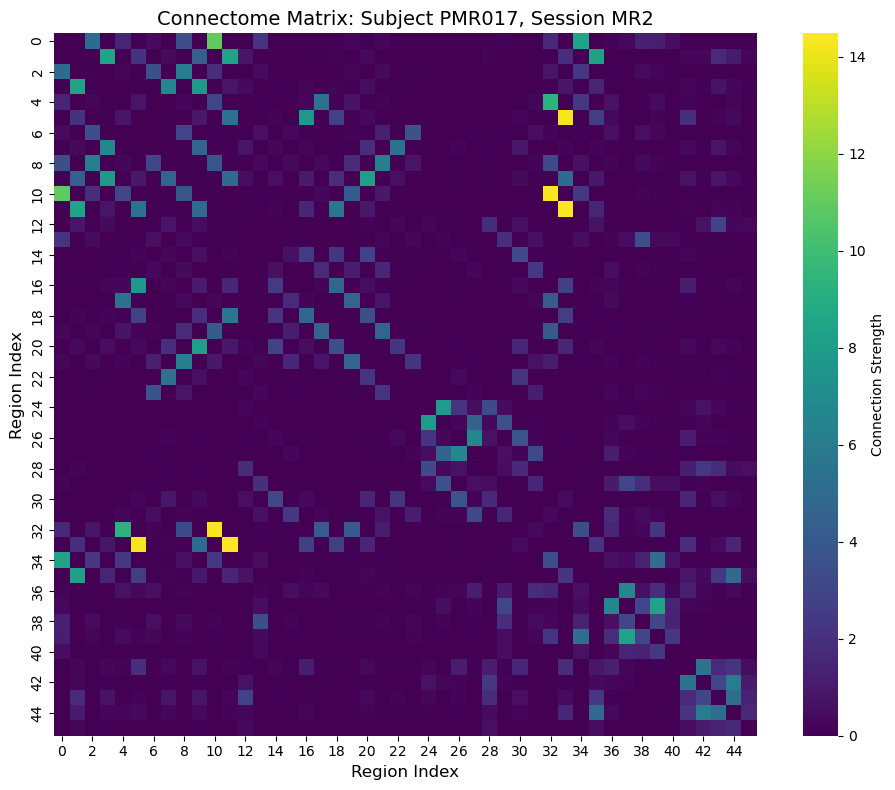

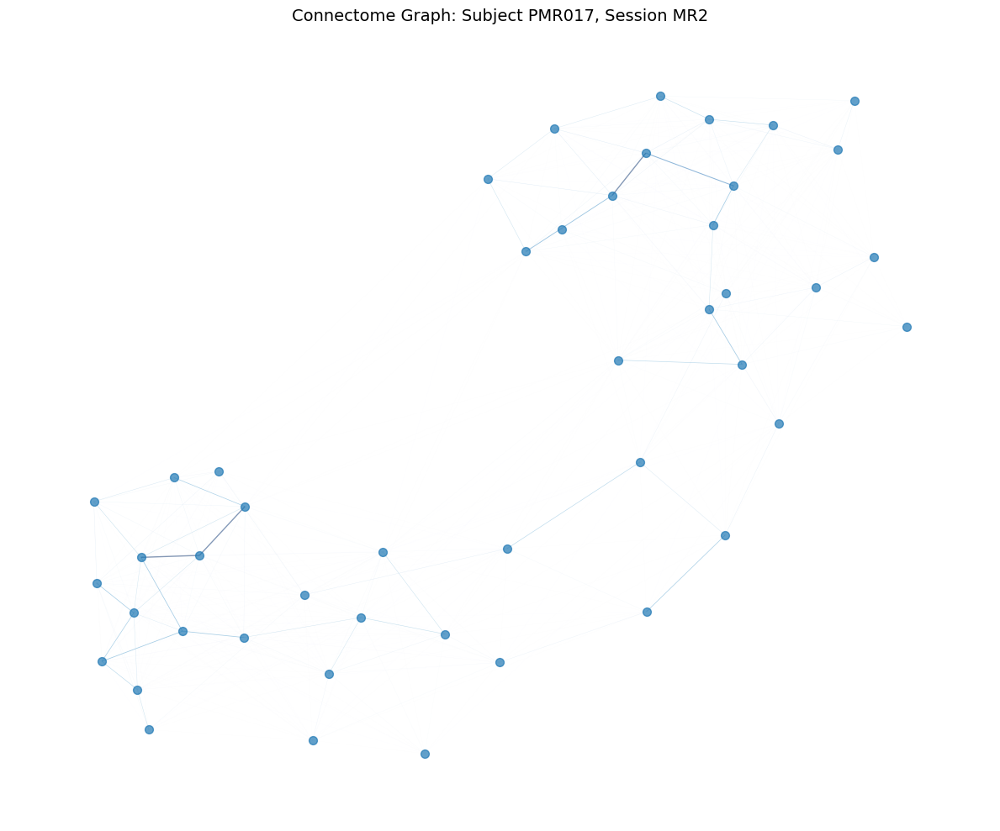

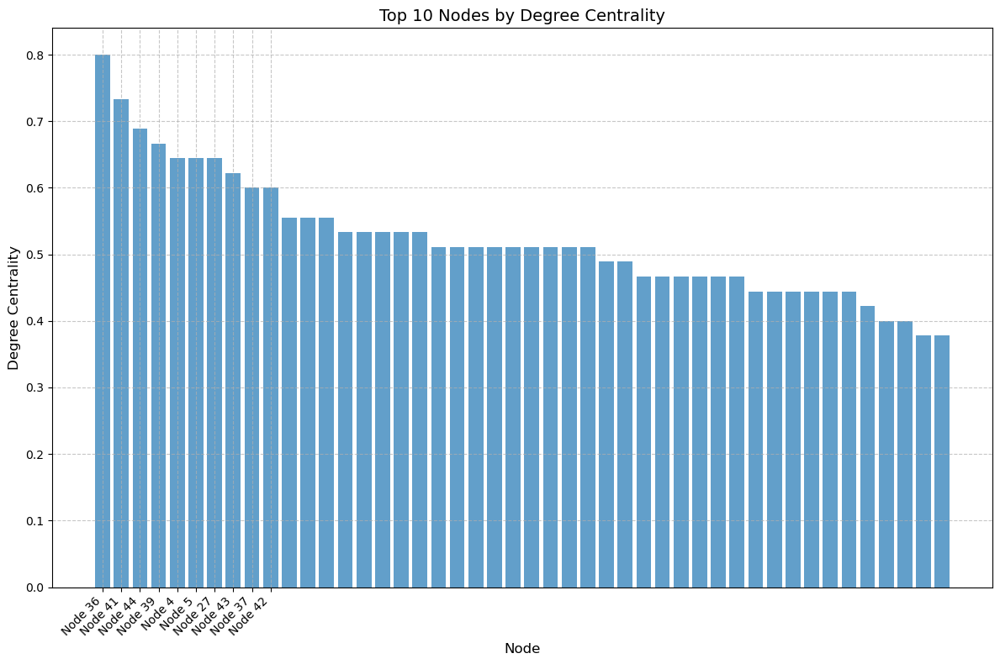

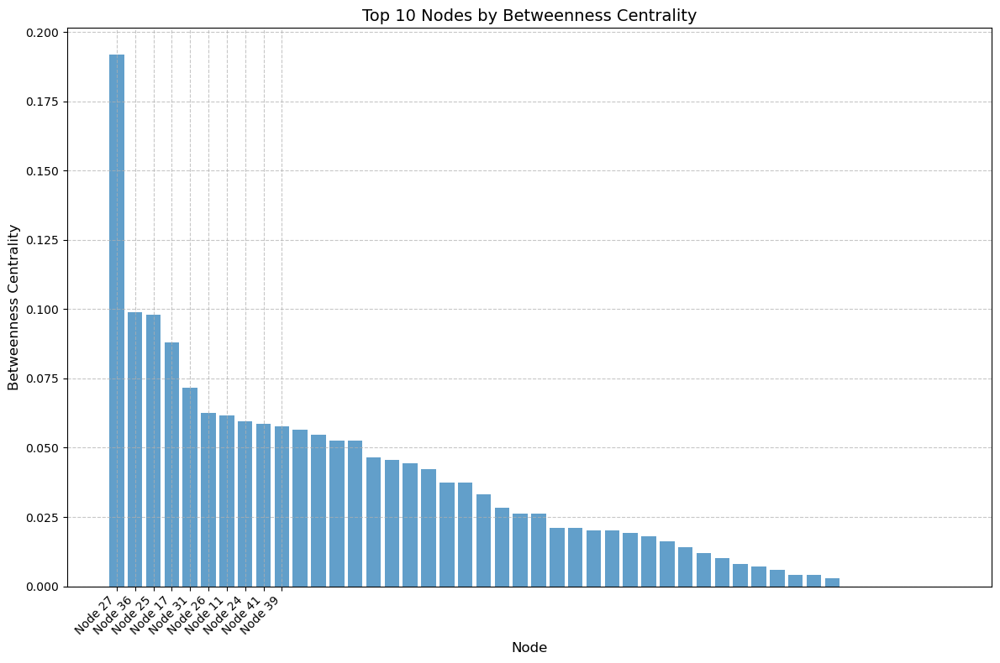

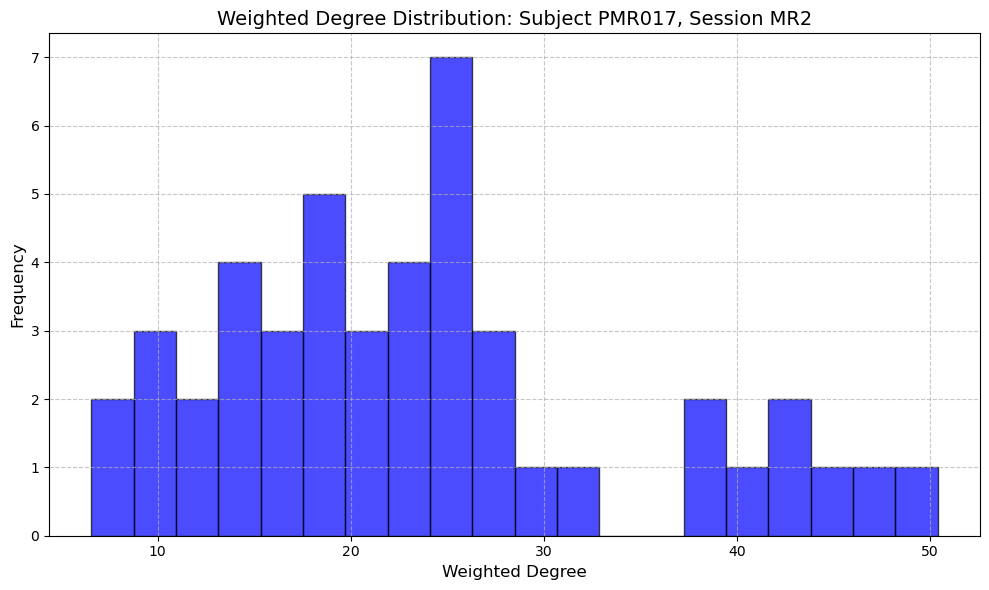

Processing connectome for subject PMR068, session MR2

Visualizations for subject PMR068, session MR2:


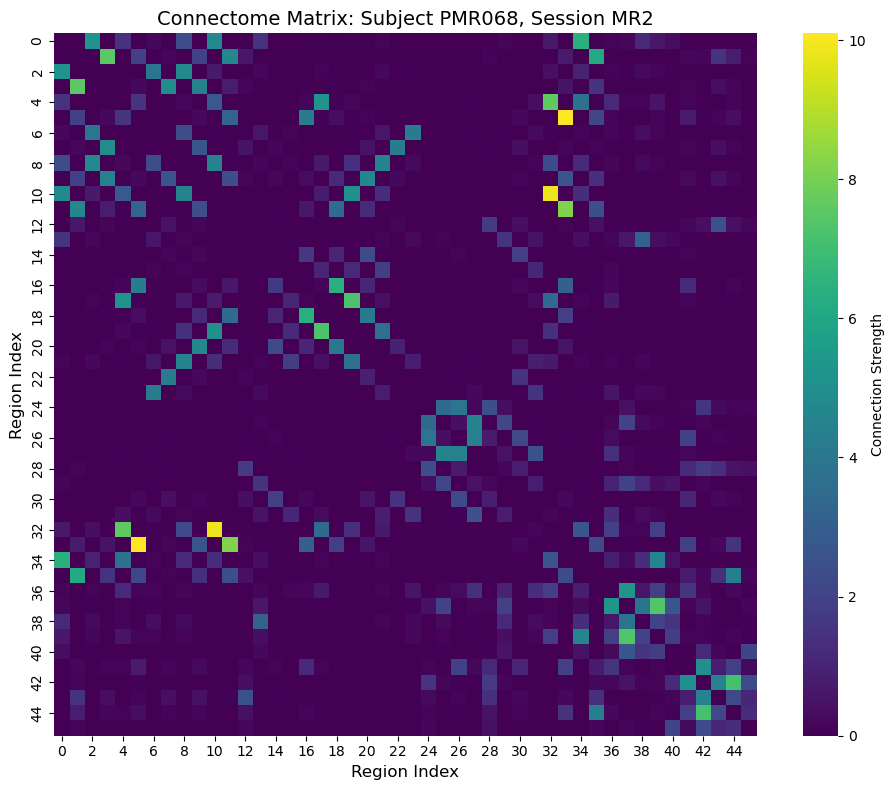

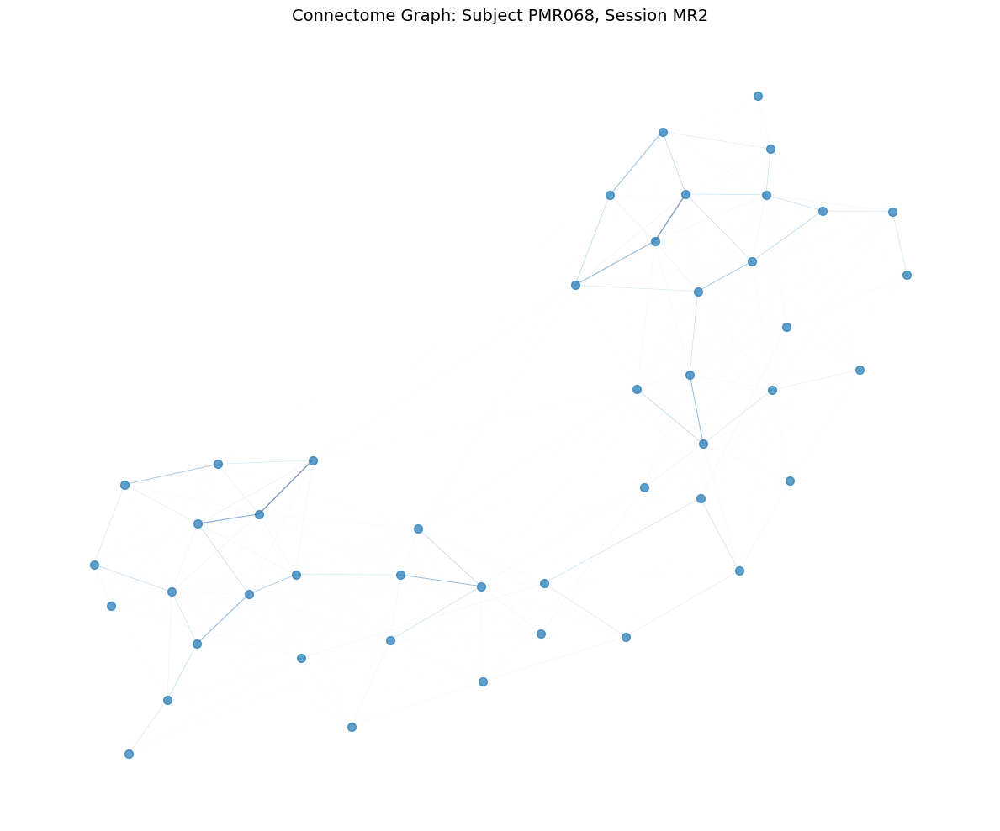

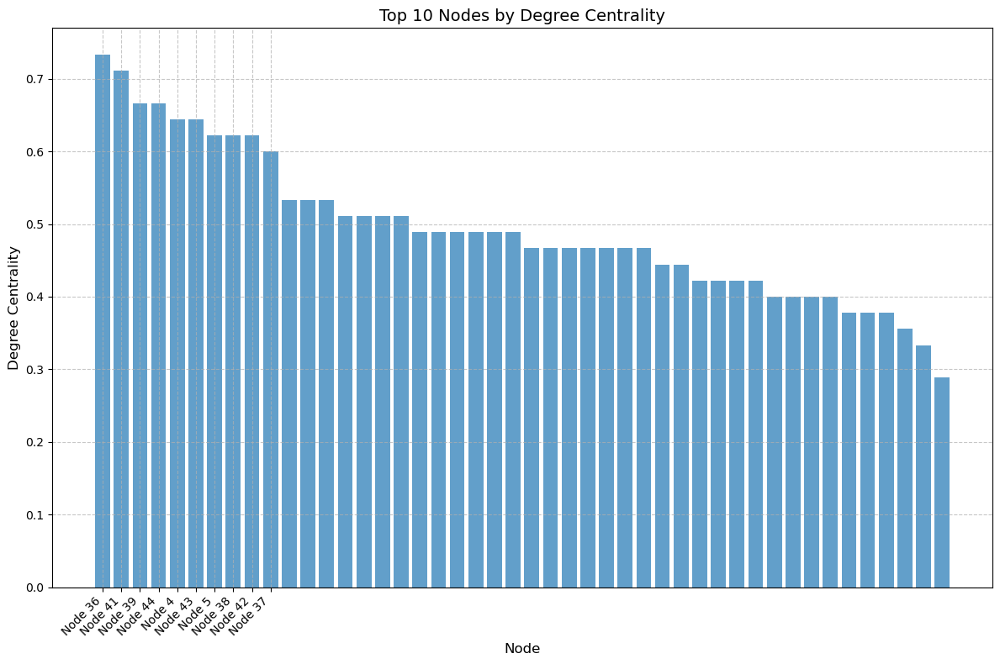

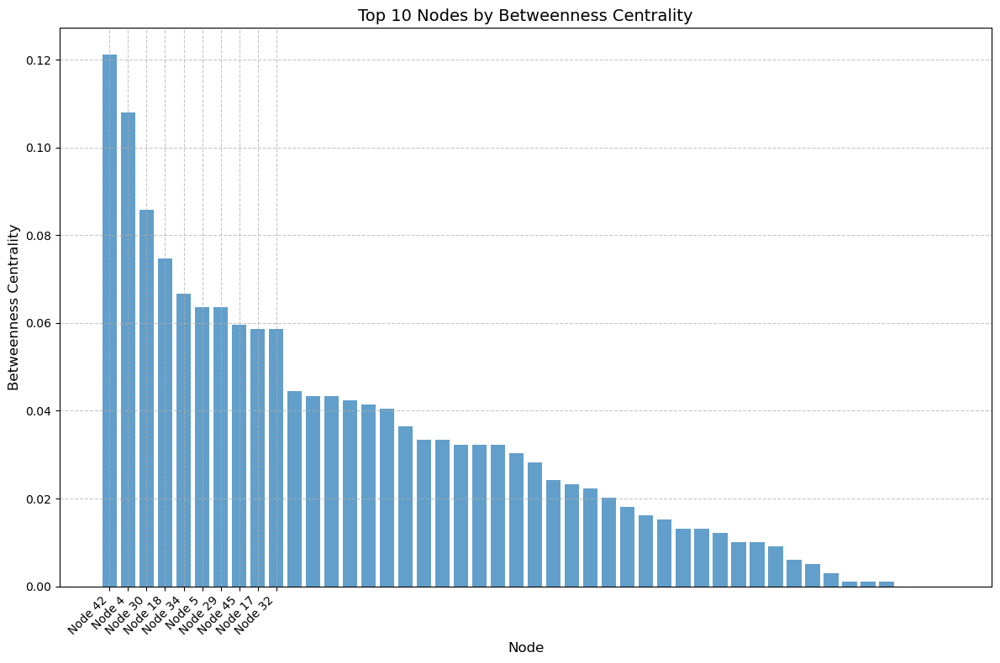

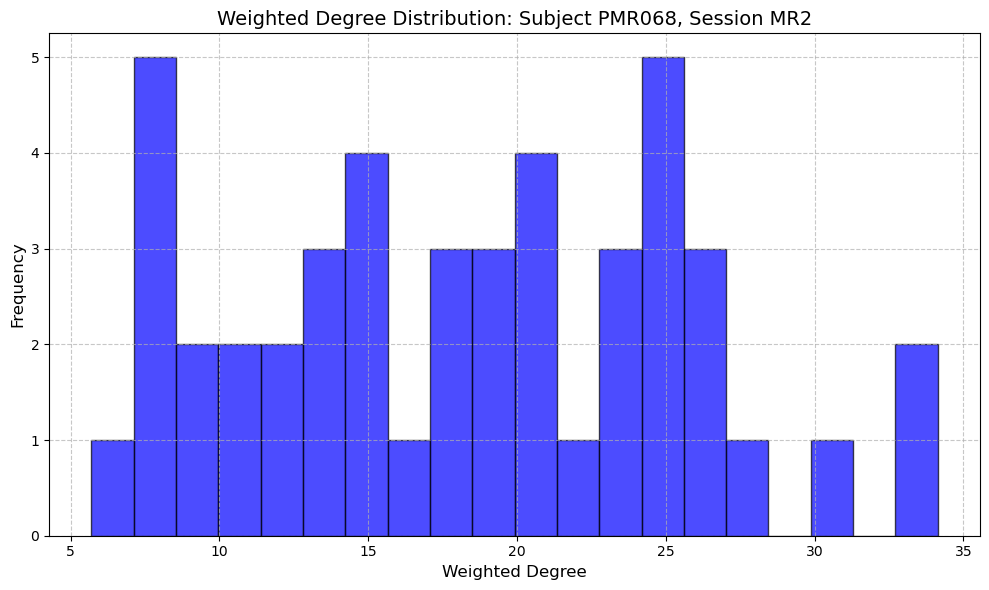

Processing connectome for subject PMR093, session MR2

Visualizations for subject PMR093, session MR2:


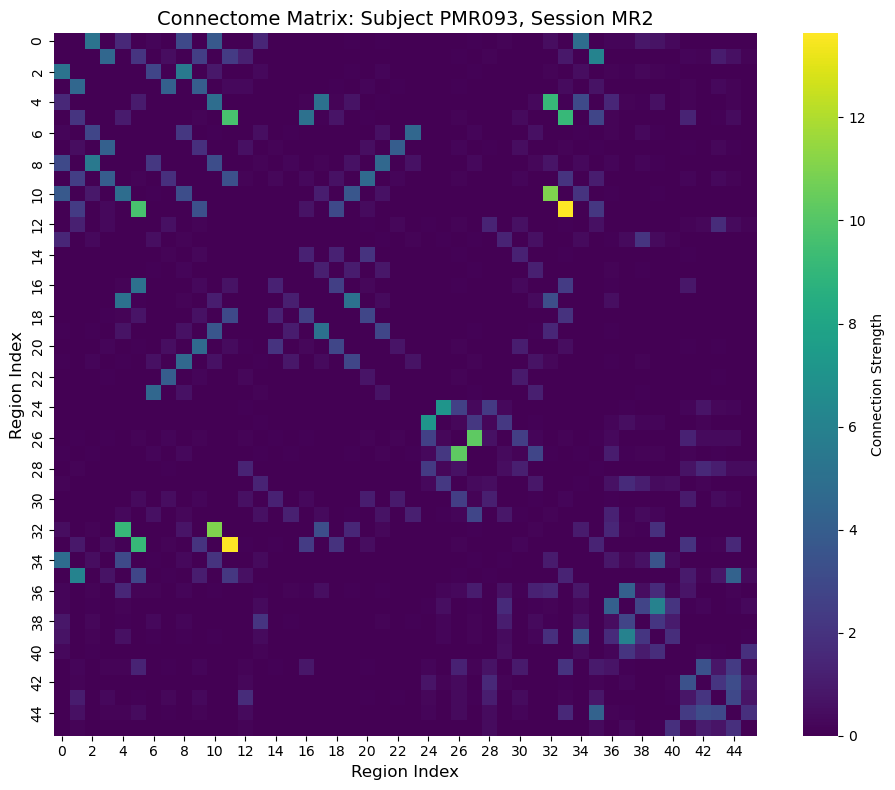

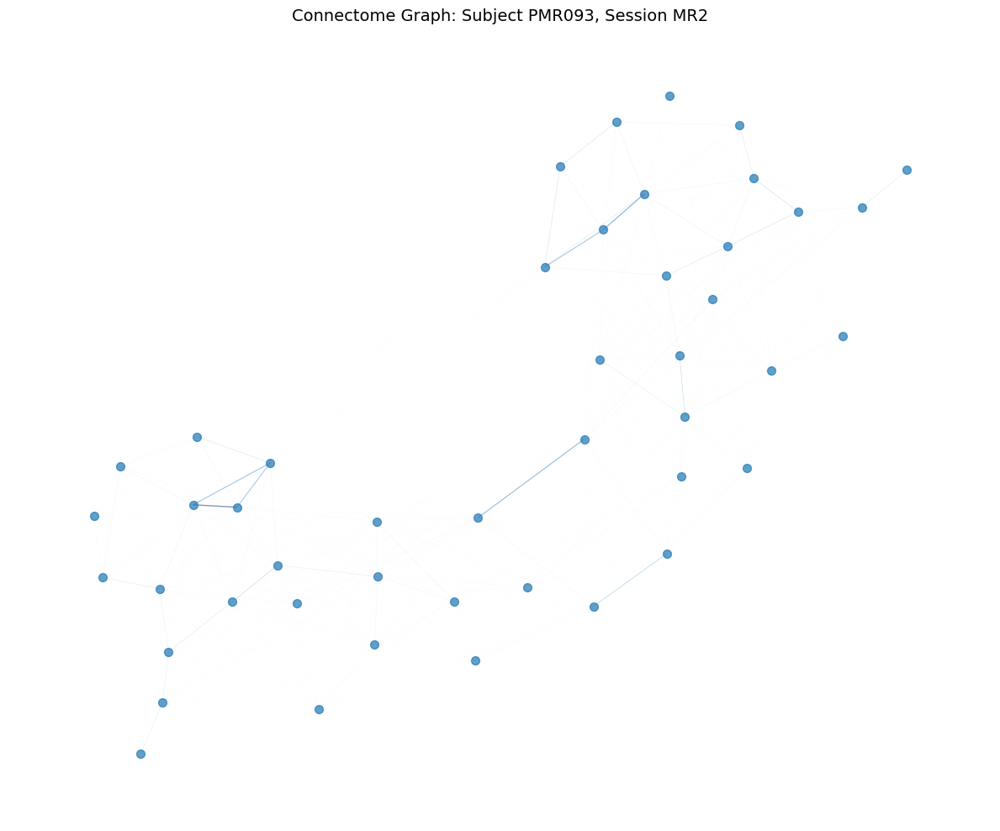

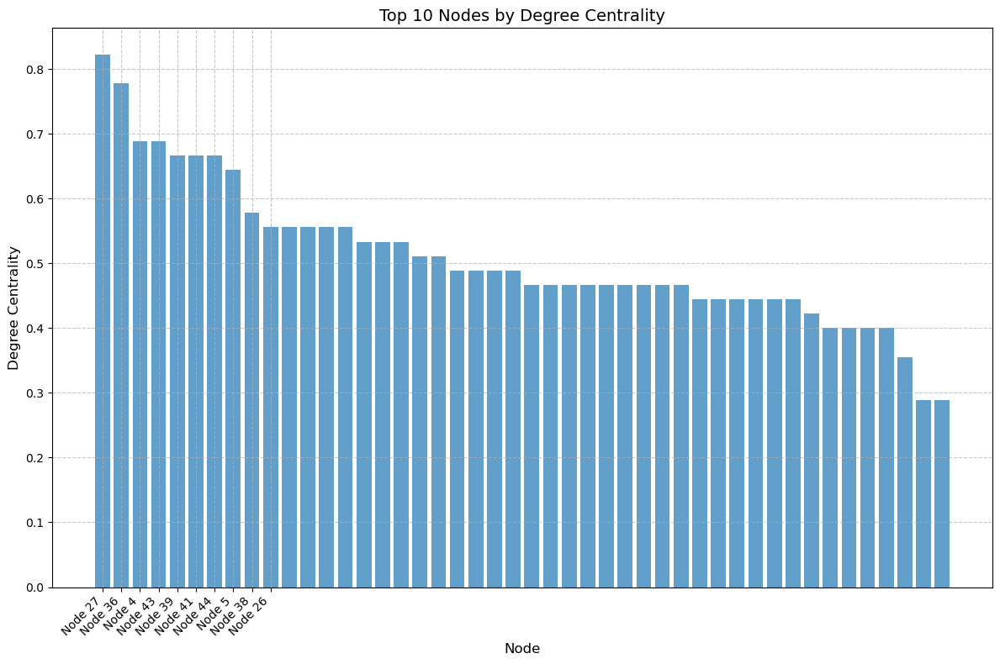

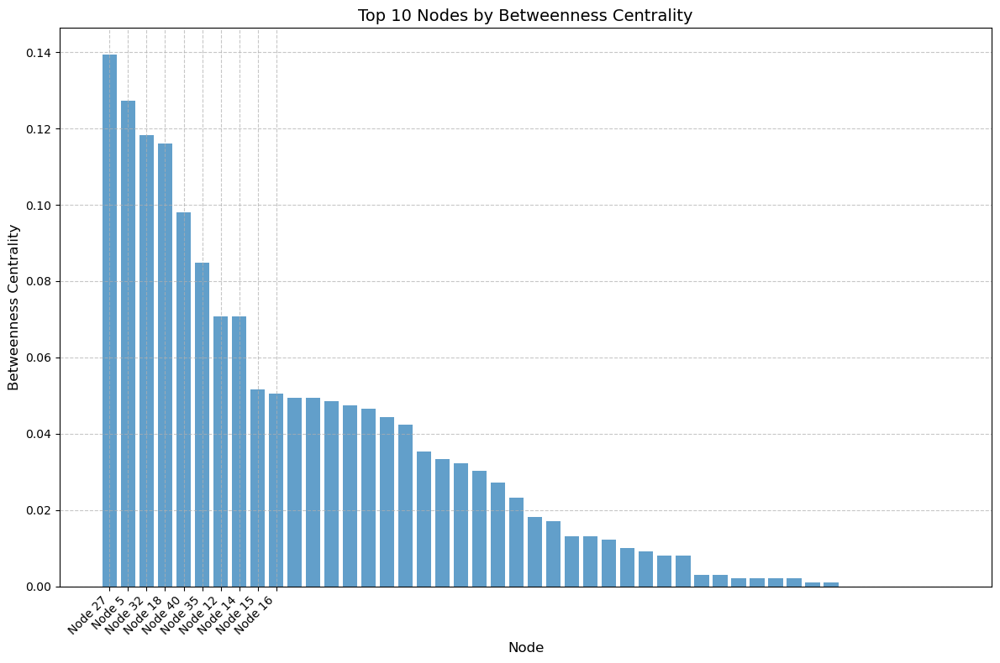

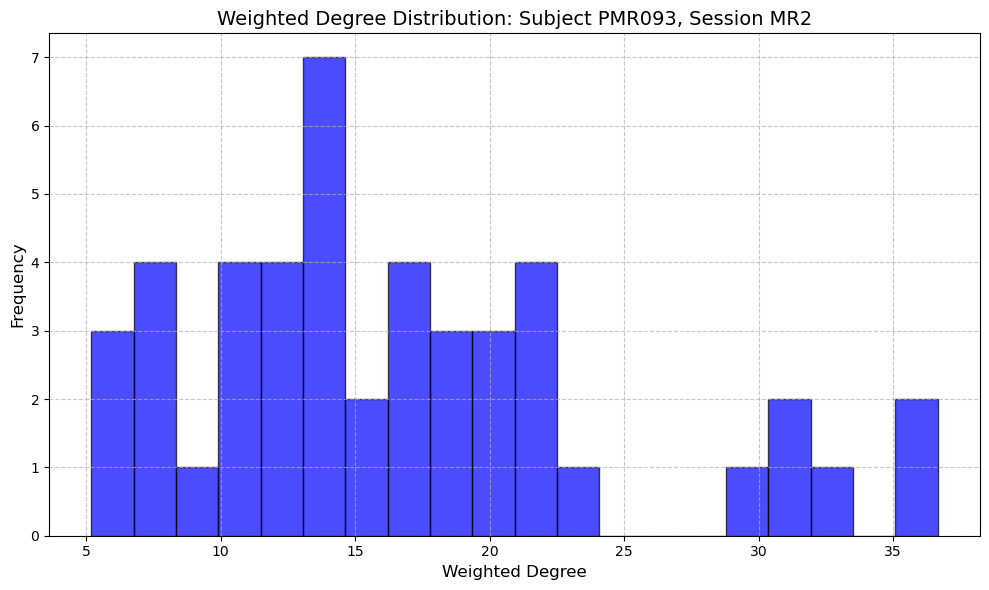

Processing connectome for subject PMR056, session MR2

Visualizations for subject PMR056, session MR2:


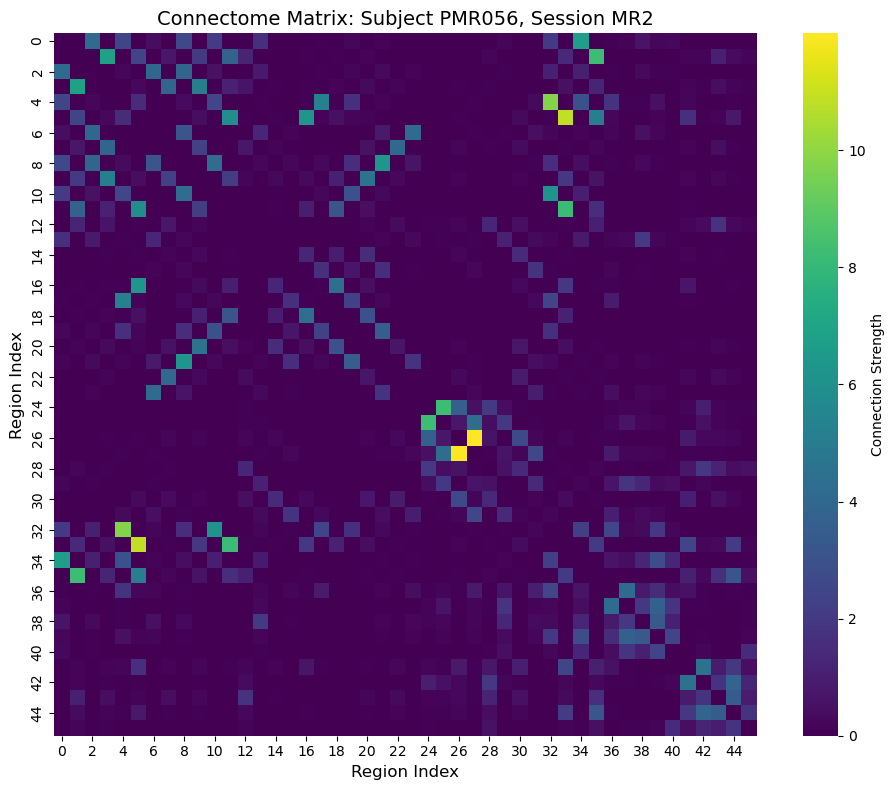

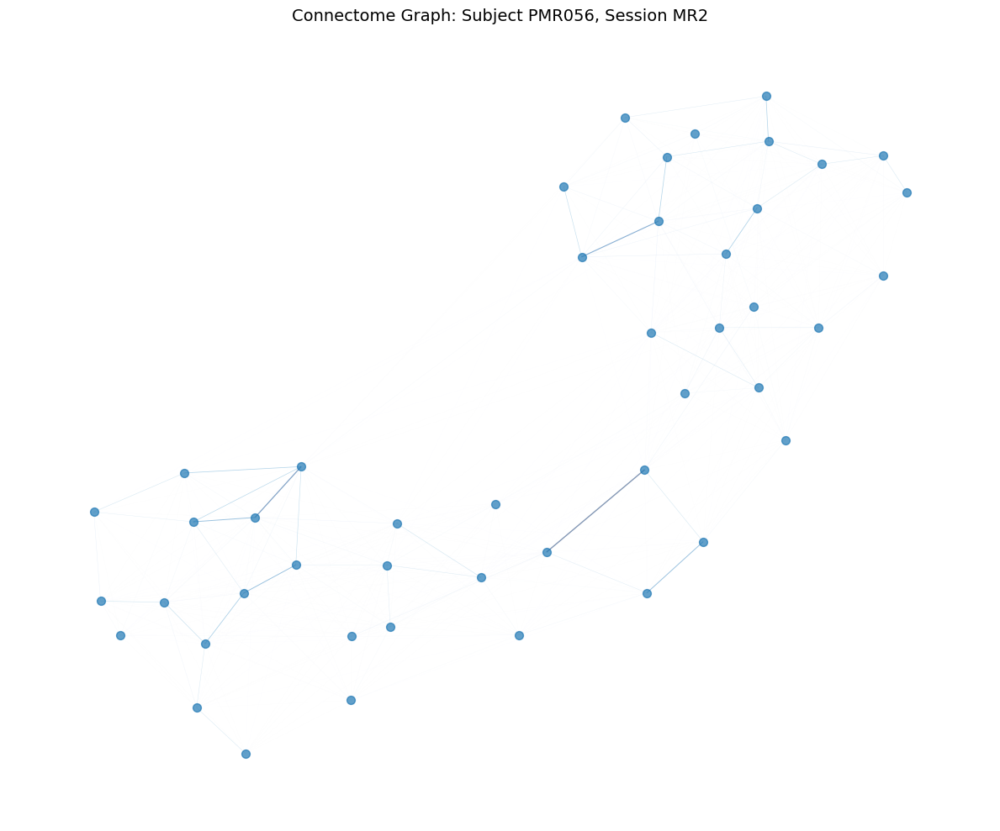

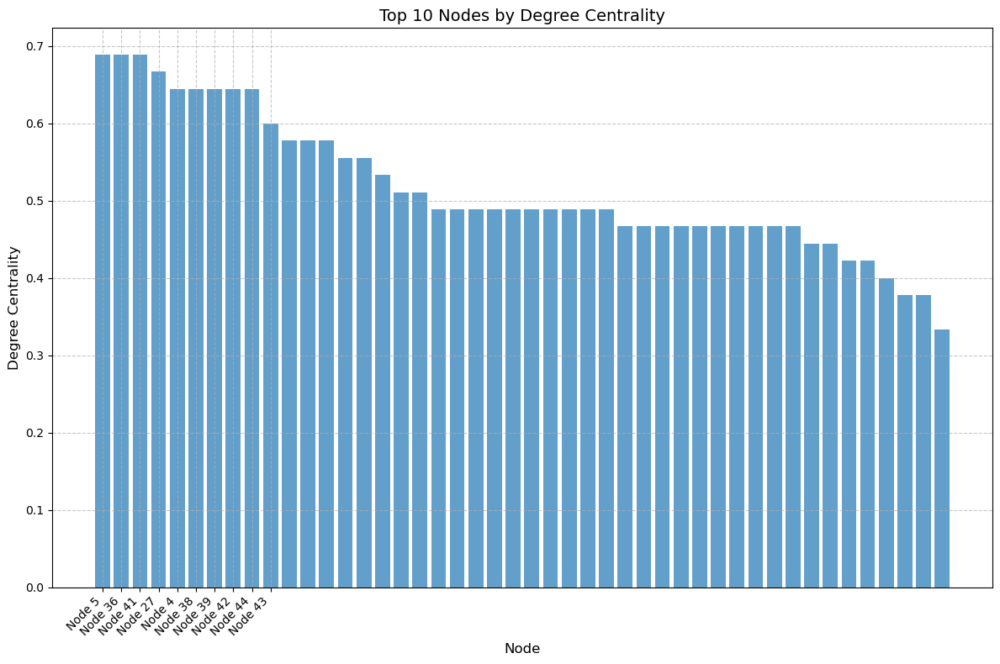

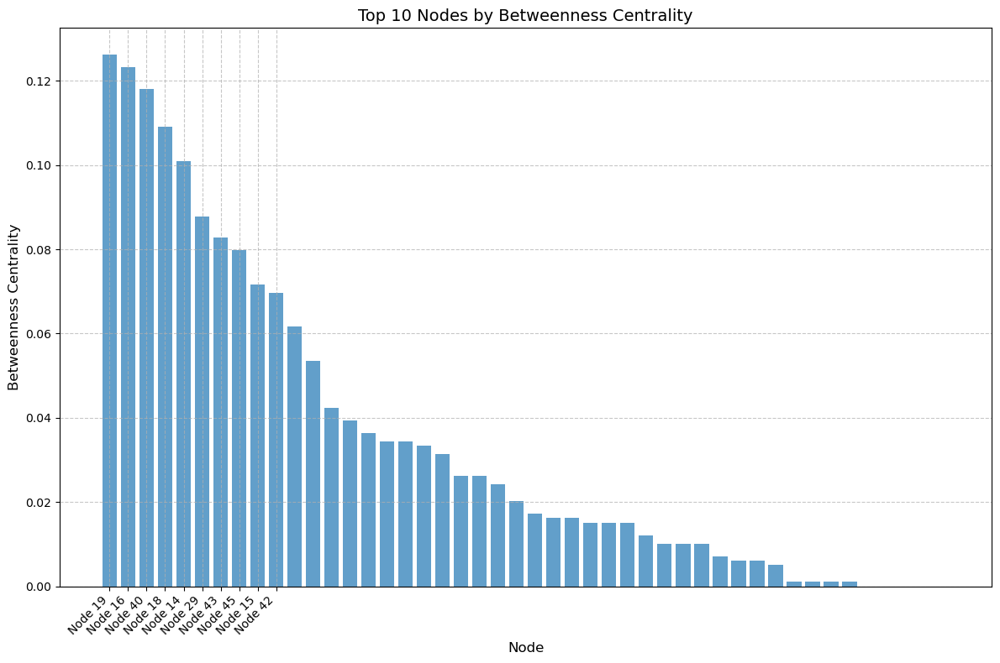

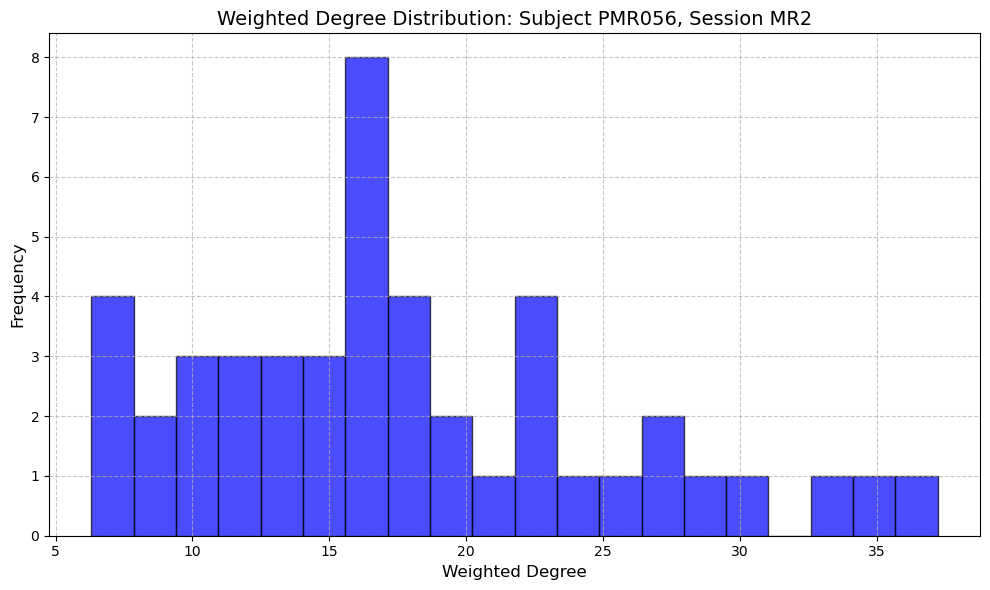

Processing connectome for subject PMR075, session MR2

Visualizations for subject PMR075, session MR2:


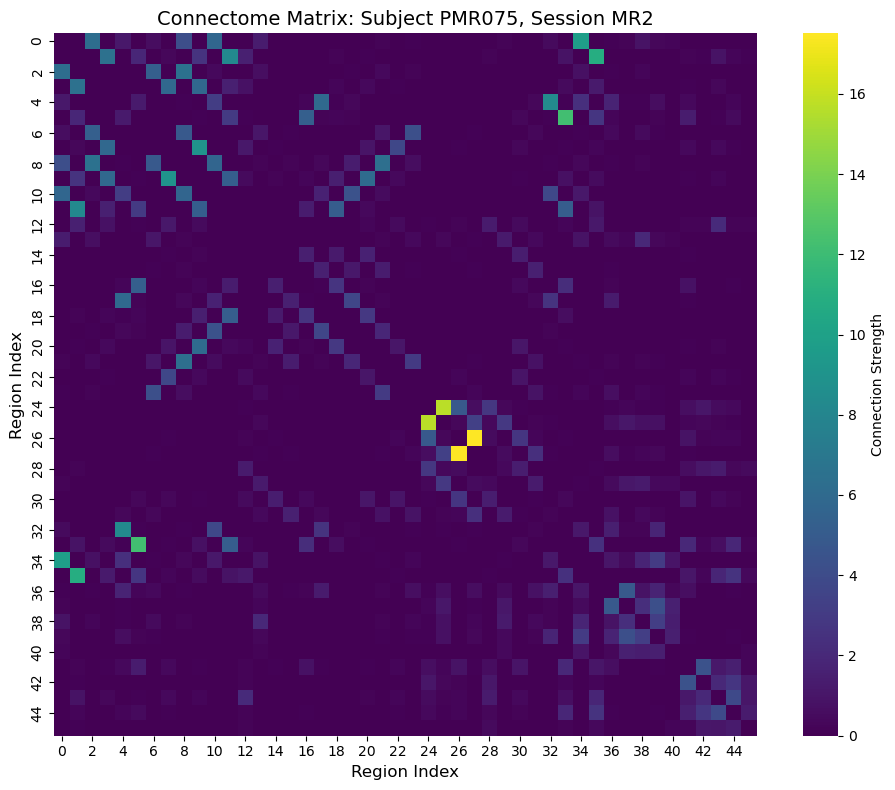

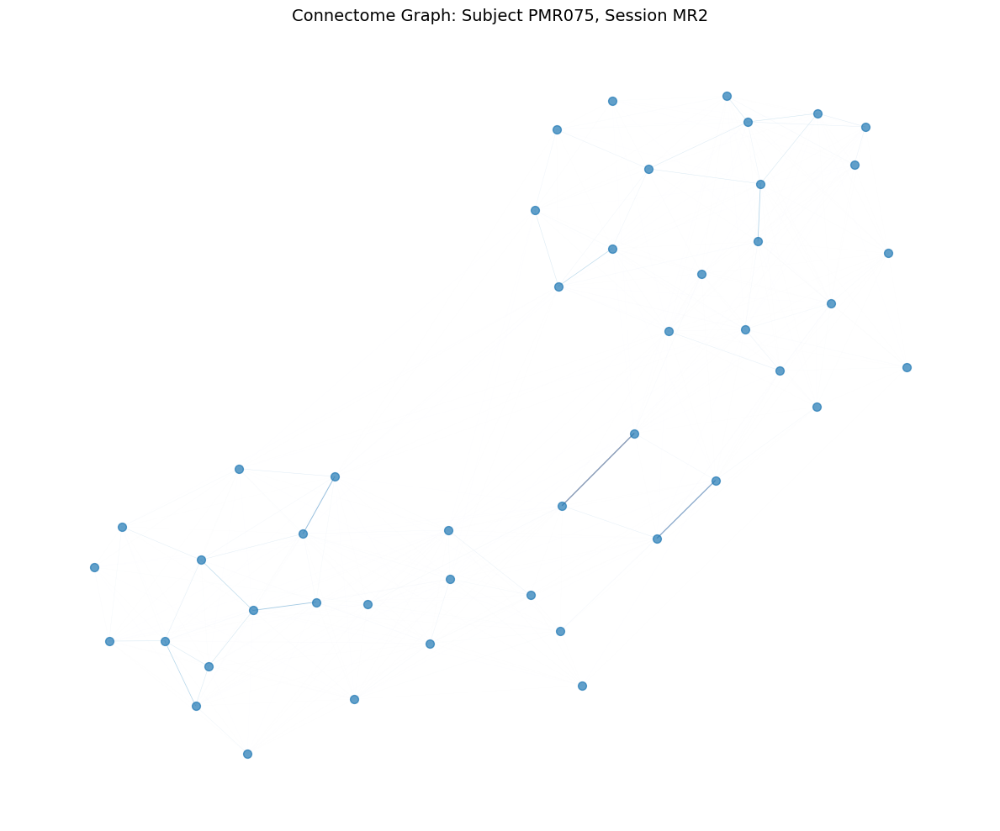

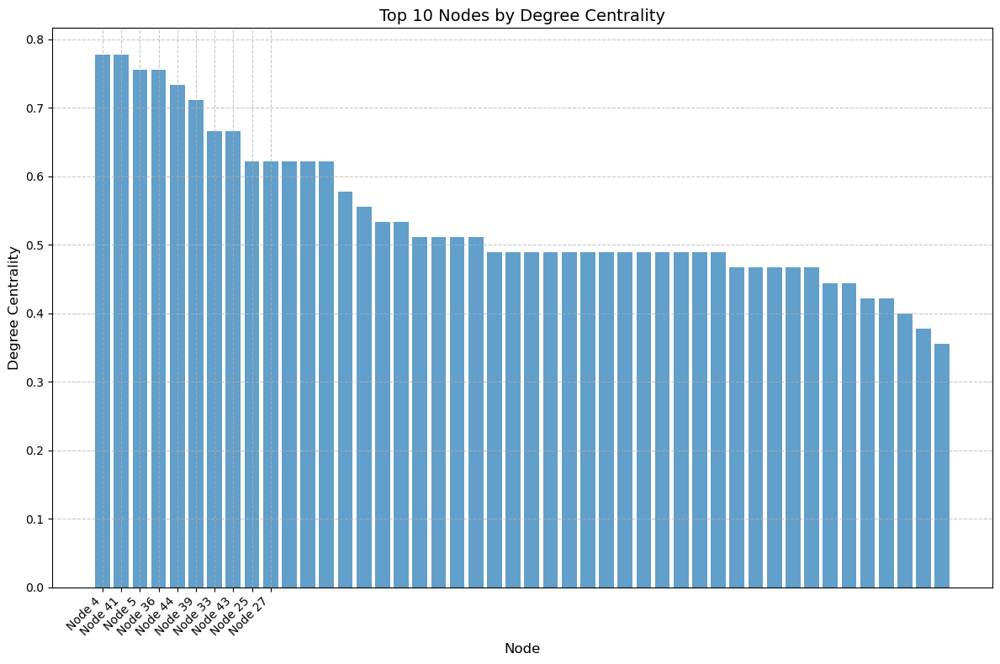

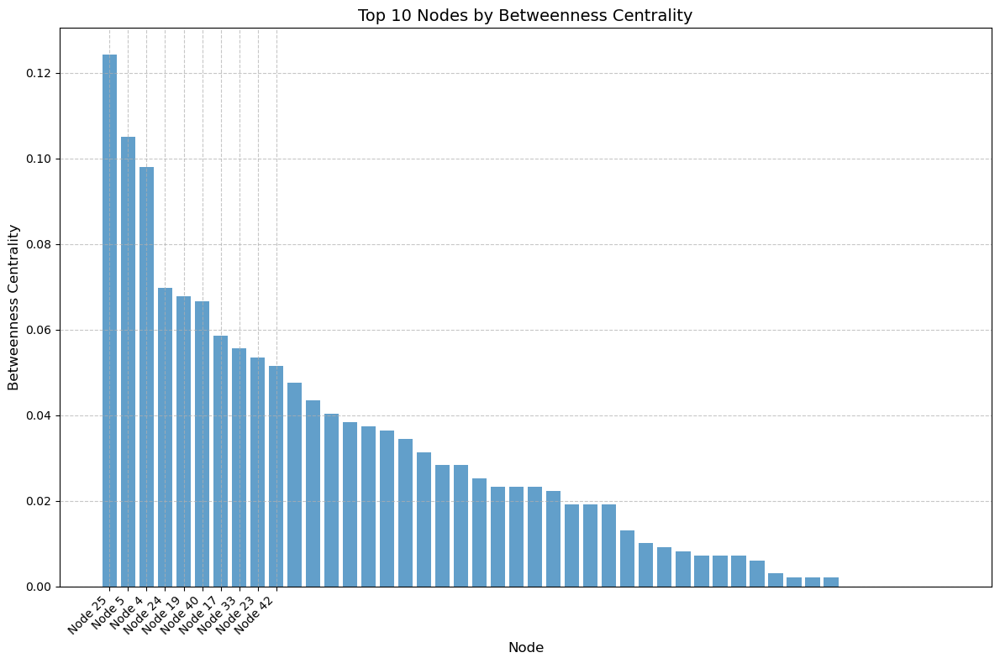

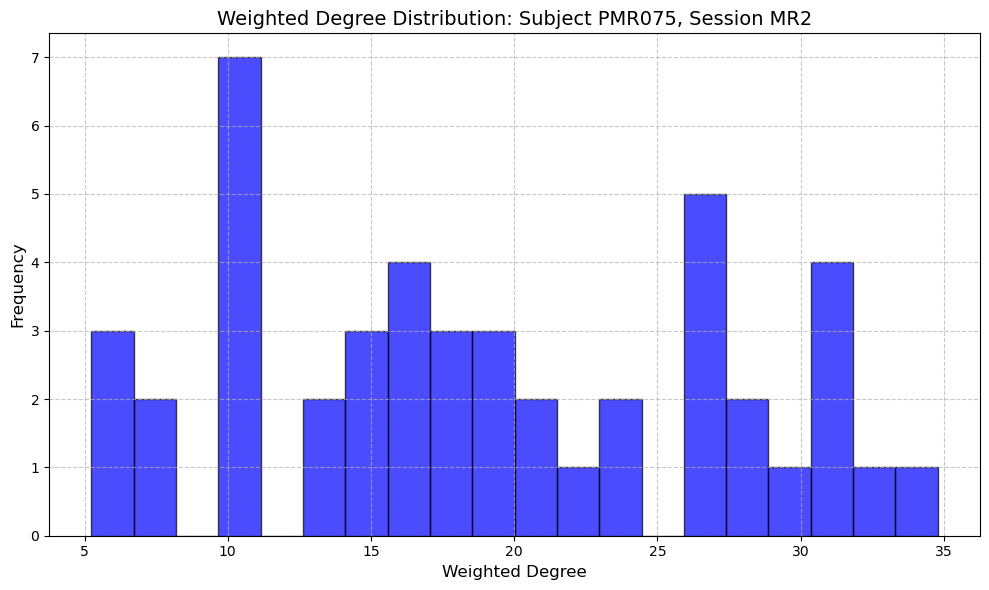

Processing connectome for subject PMR072, session MR2

Visualizations for subject PMR072, session MR2:


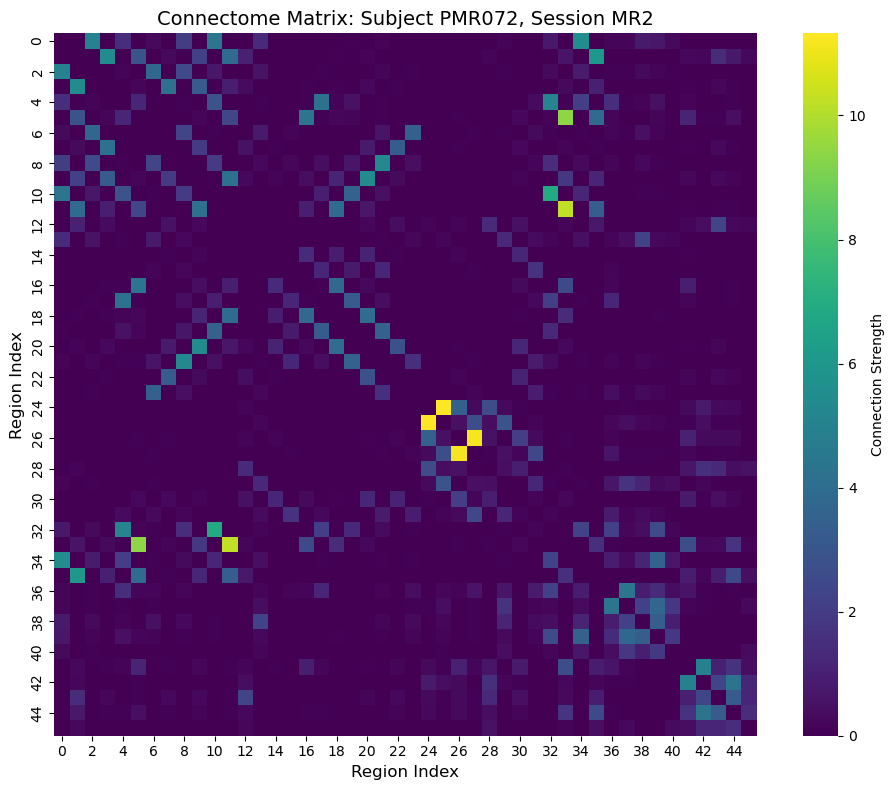

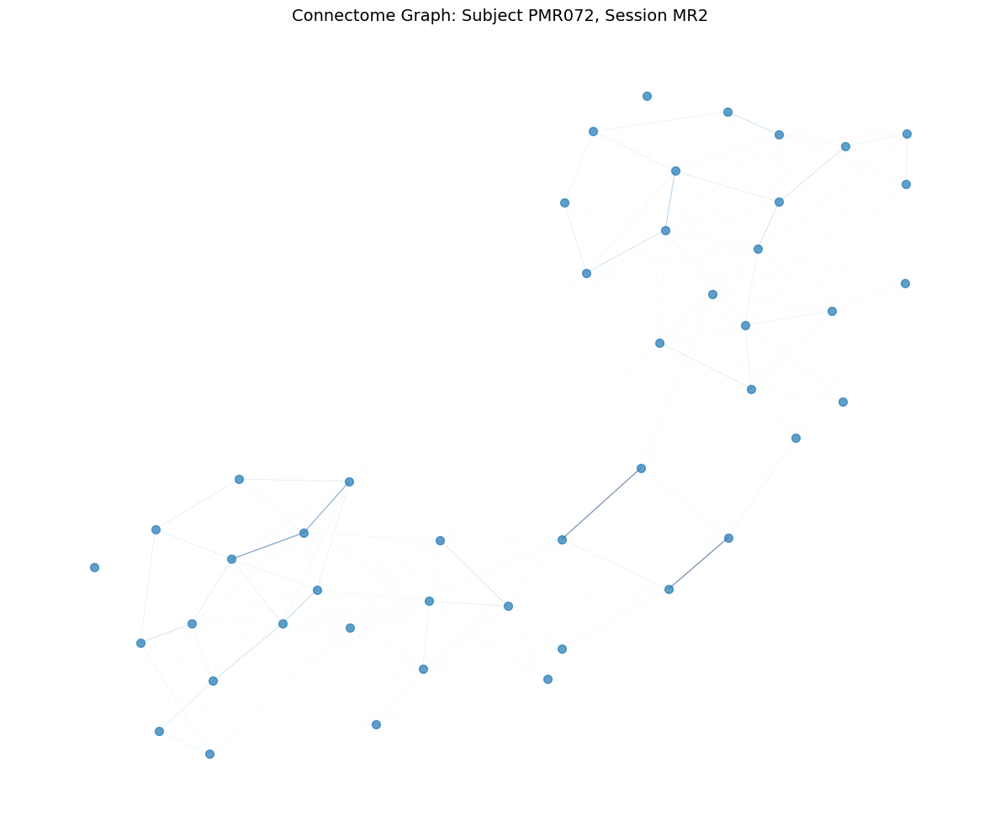

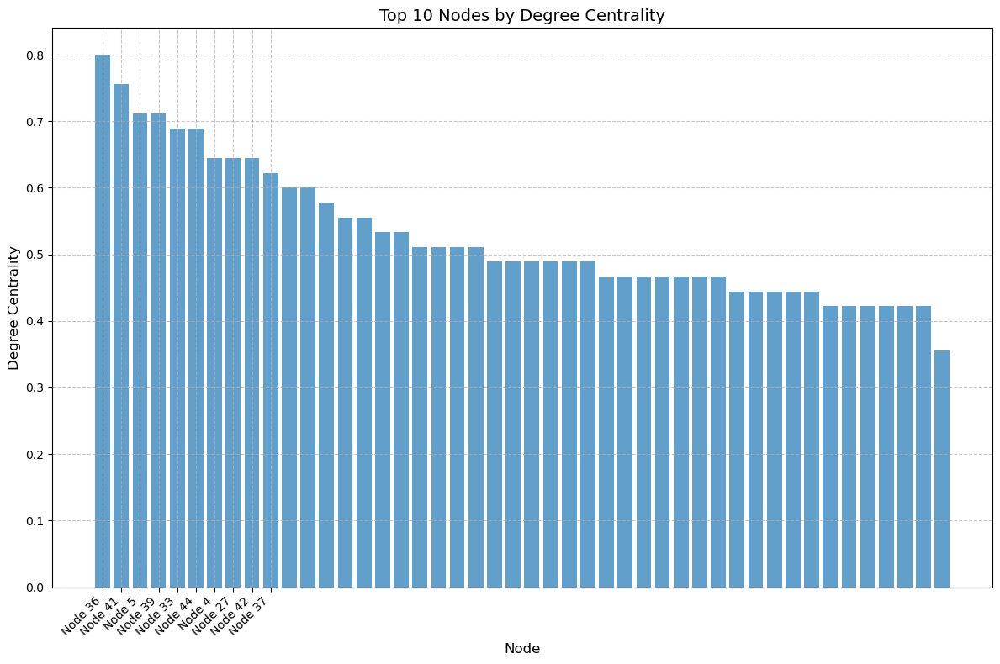

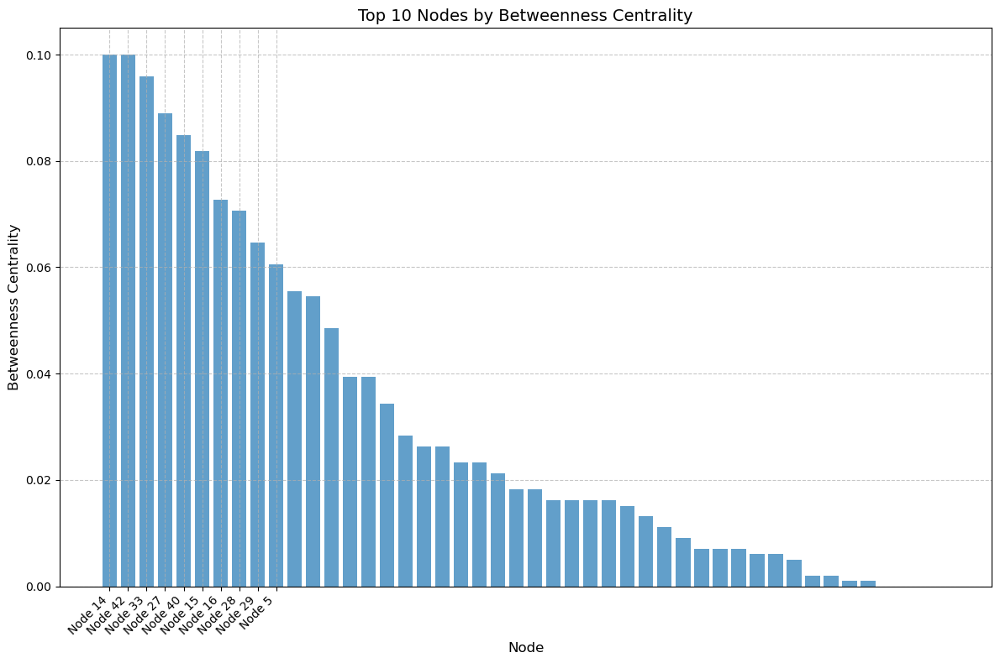

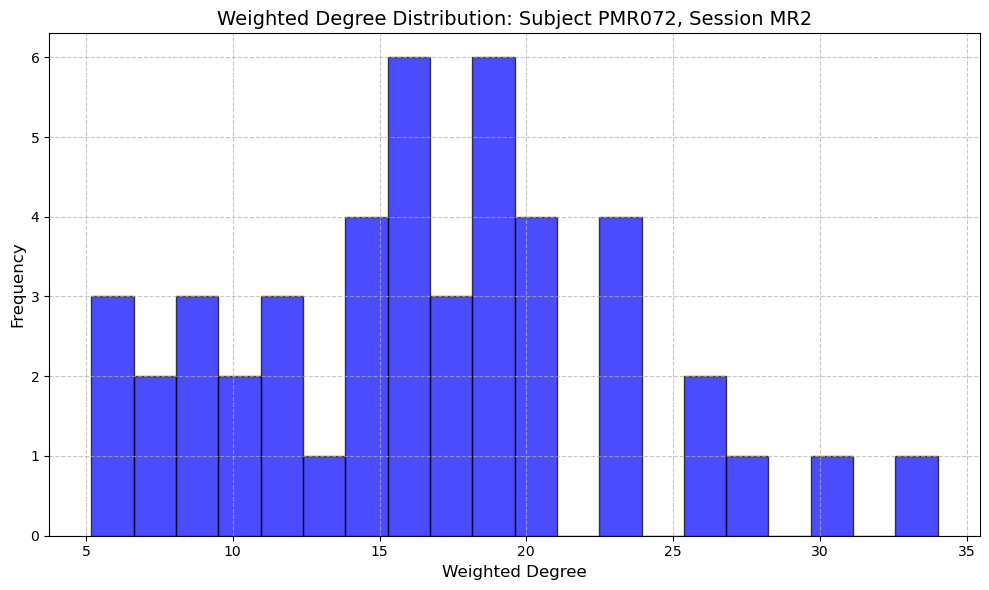

Processing connectome for subject PMR094, session MR2

Visualizations for subject PMR094, session MR2:


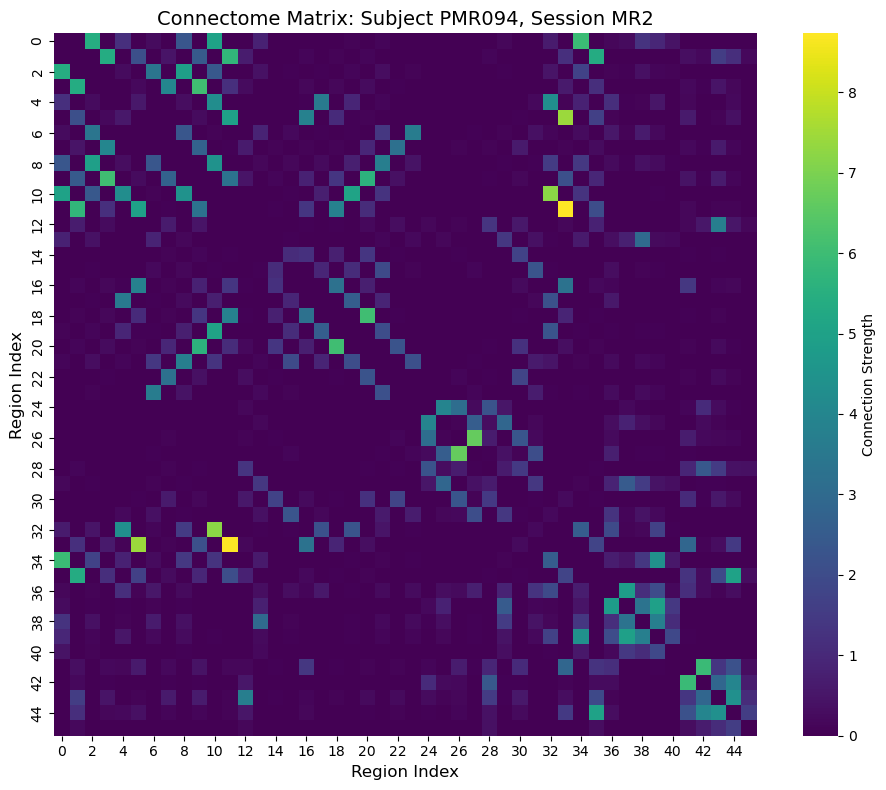

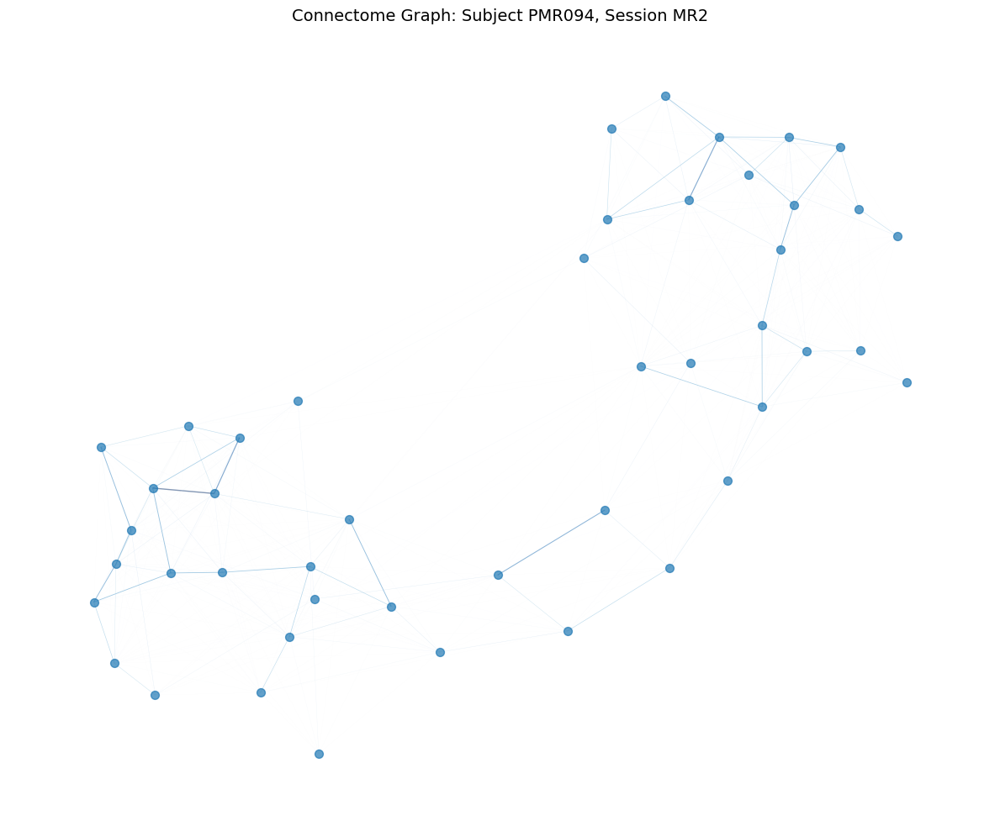

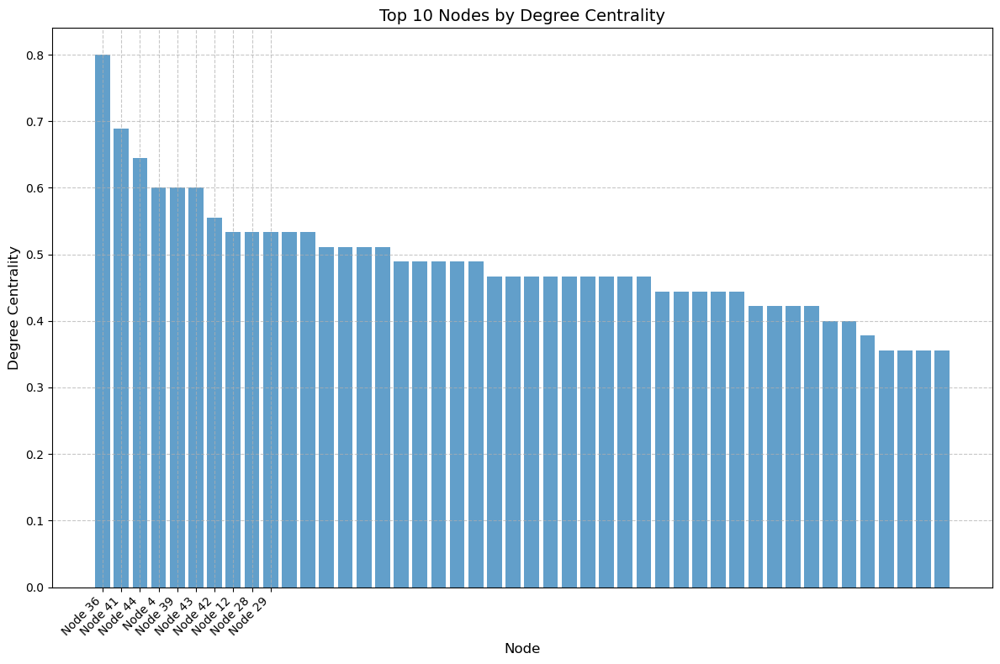

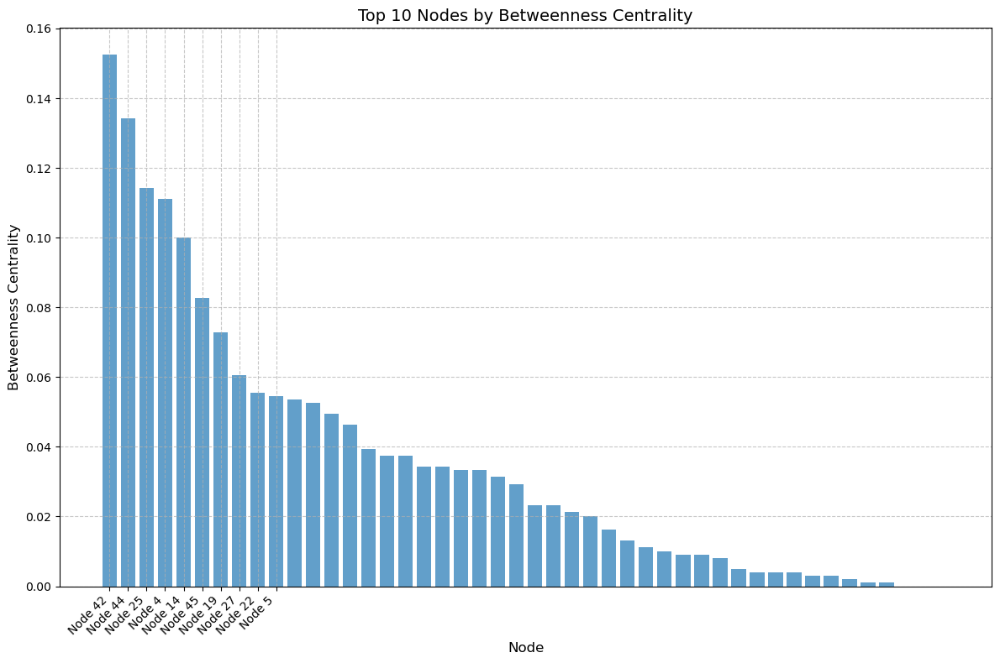

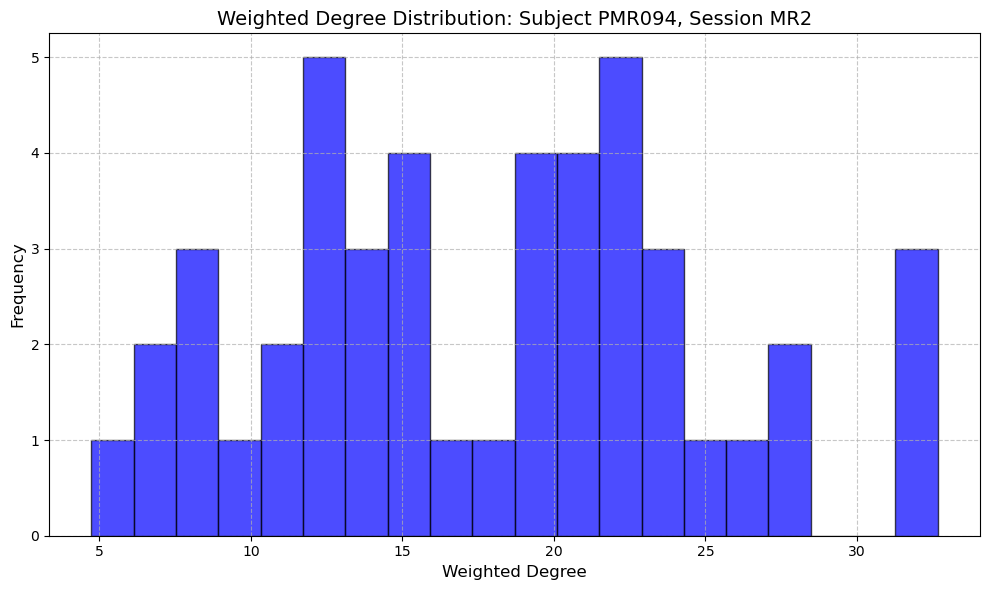

Processing connectome for subject PMR088, session MR2

Visualizations for subject PMR088, session MR2:


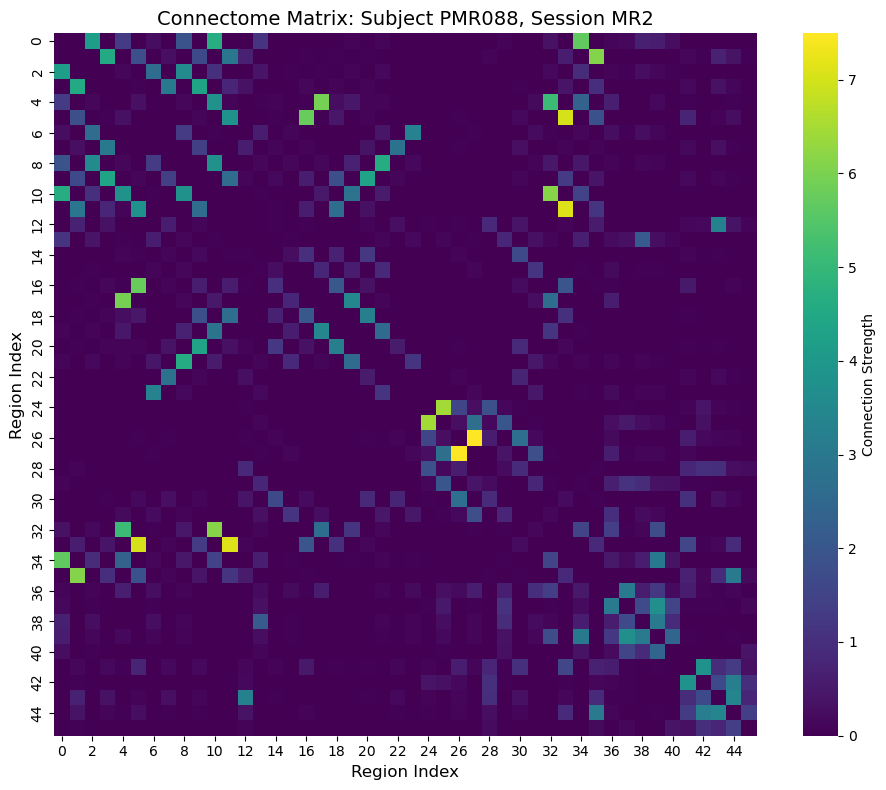

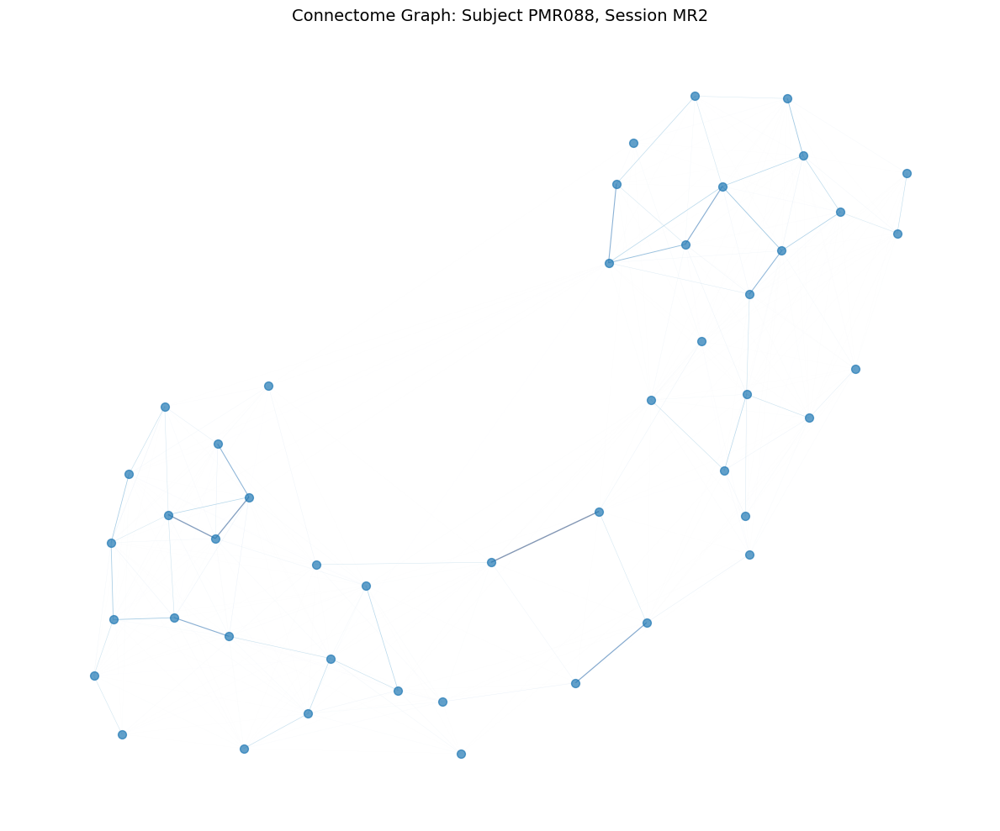

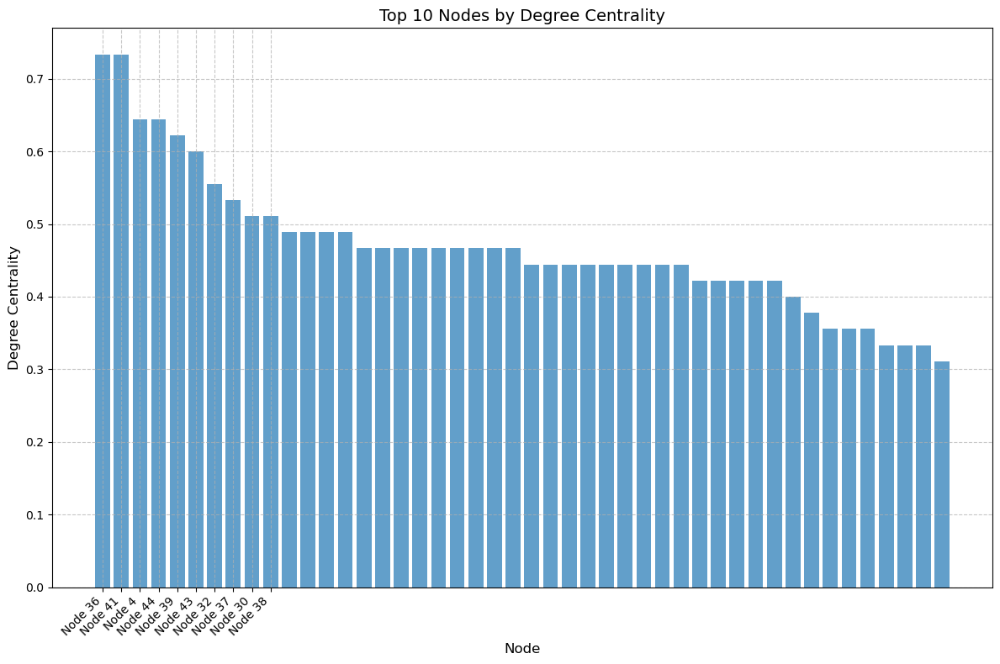

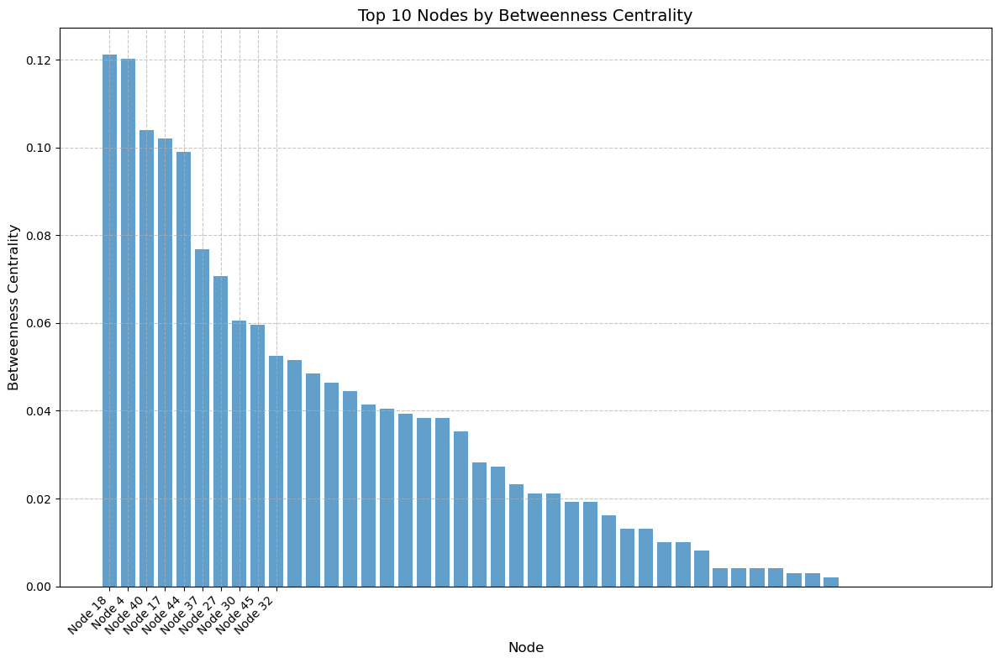

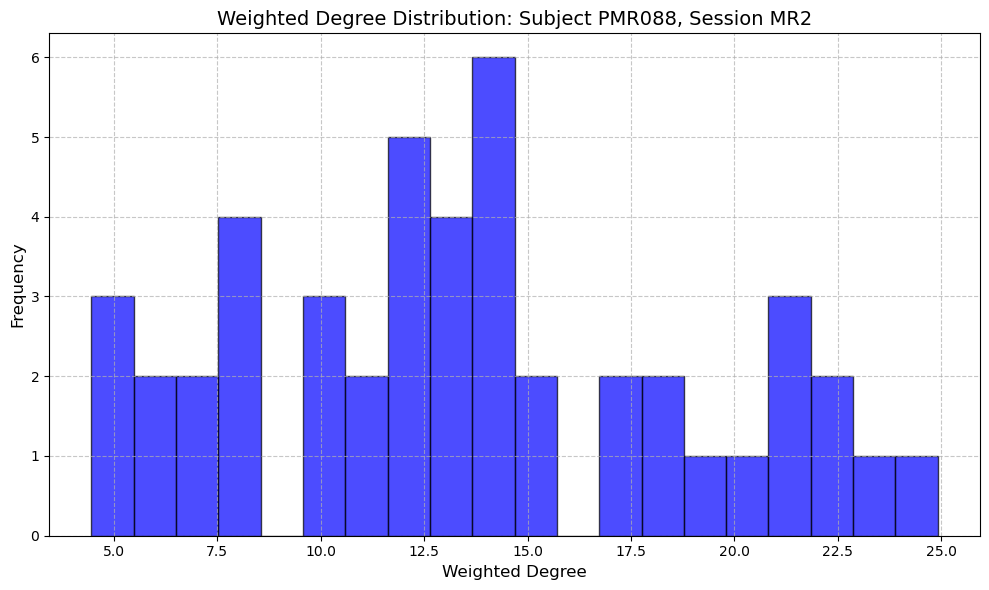

Processing connectome for subject PMR080, session MR2

Visualizations for subject PMR080, session MR2:


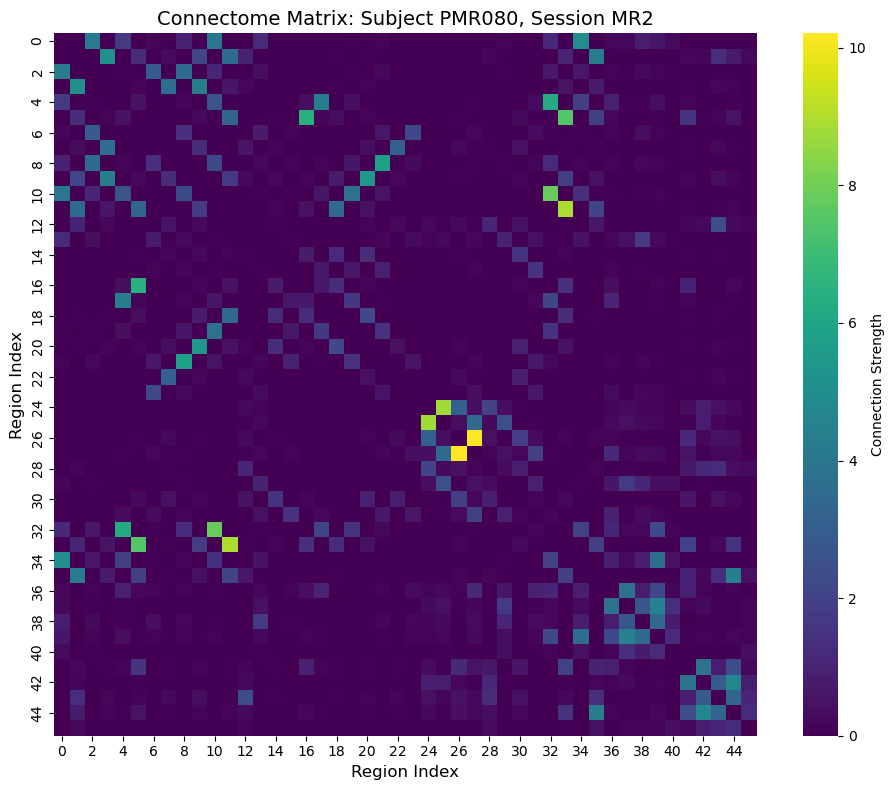

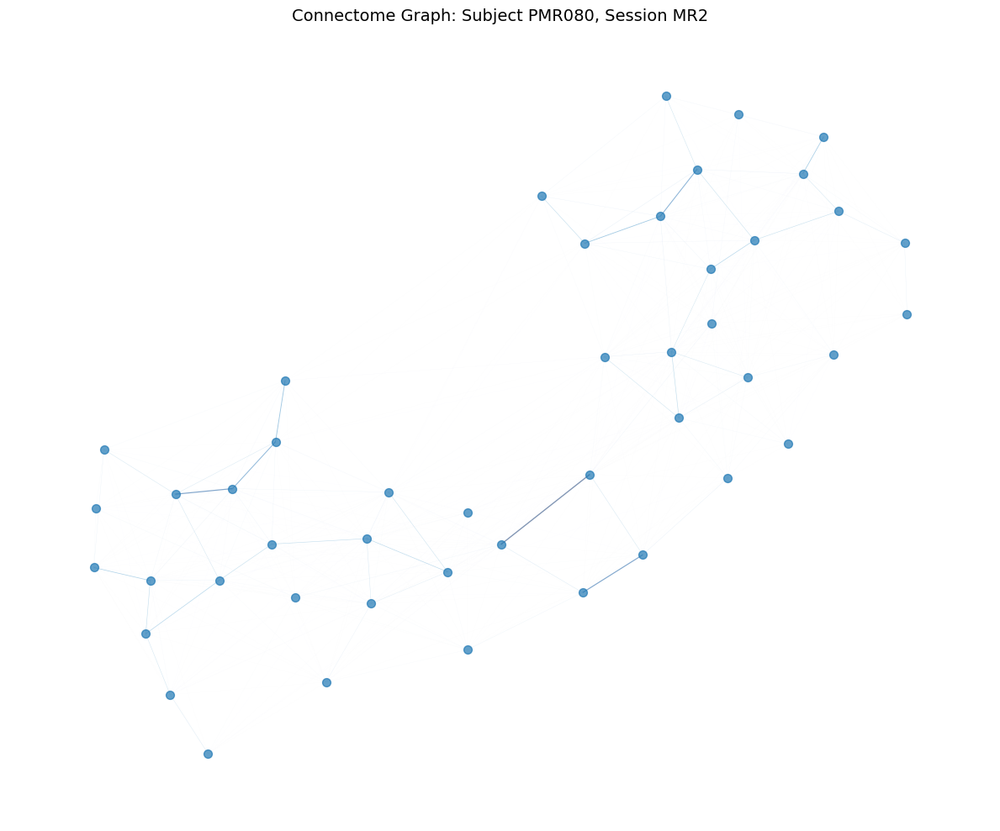

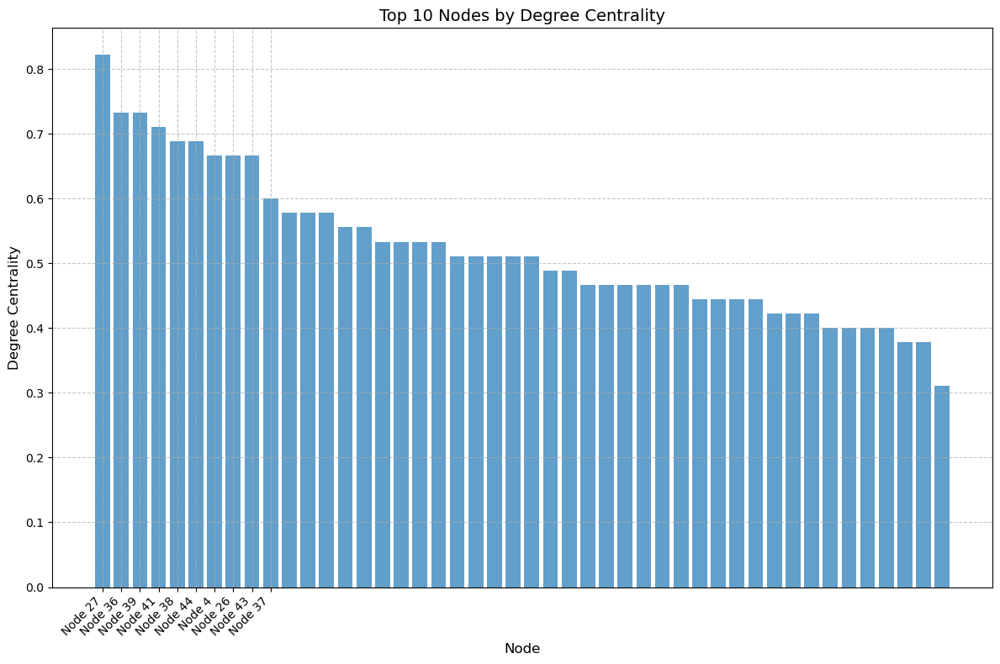

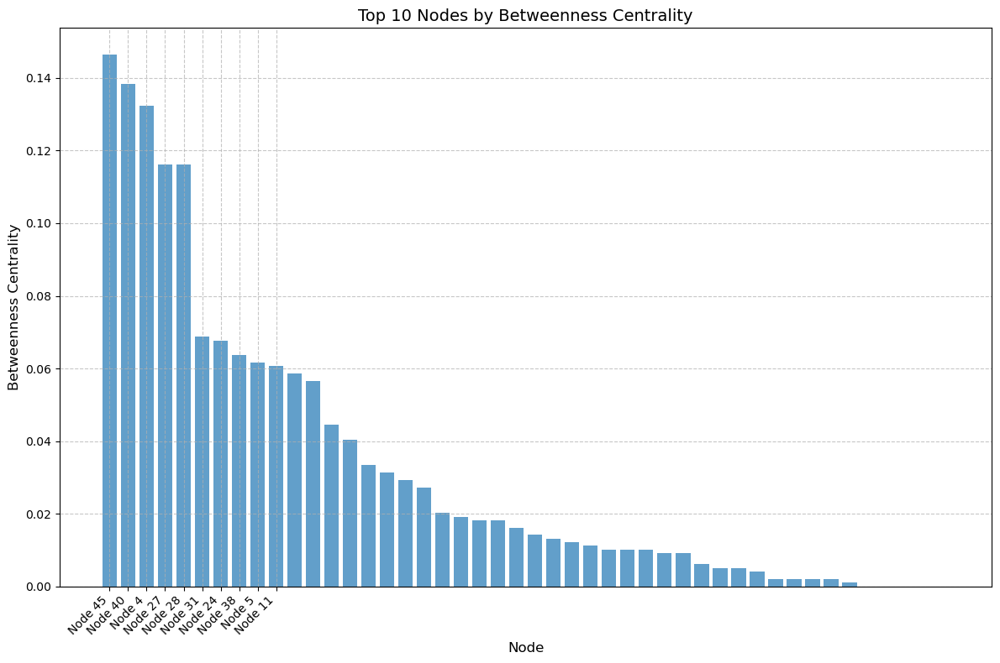

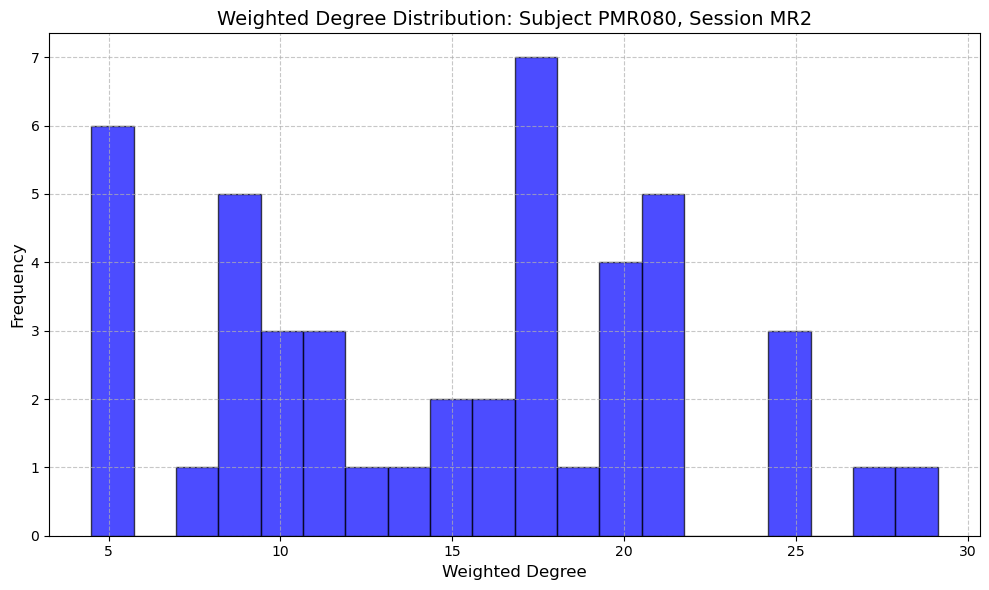

Processing connectome for subject PMR041, session MR2

Visualizations for subject PMR041, session MR2:


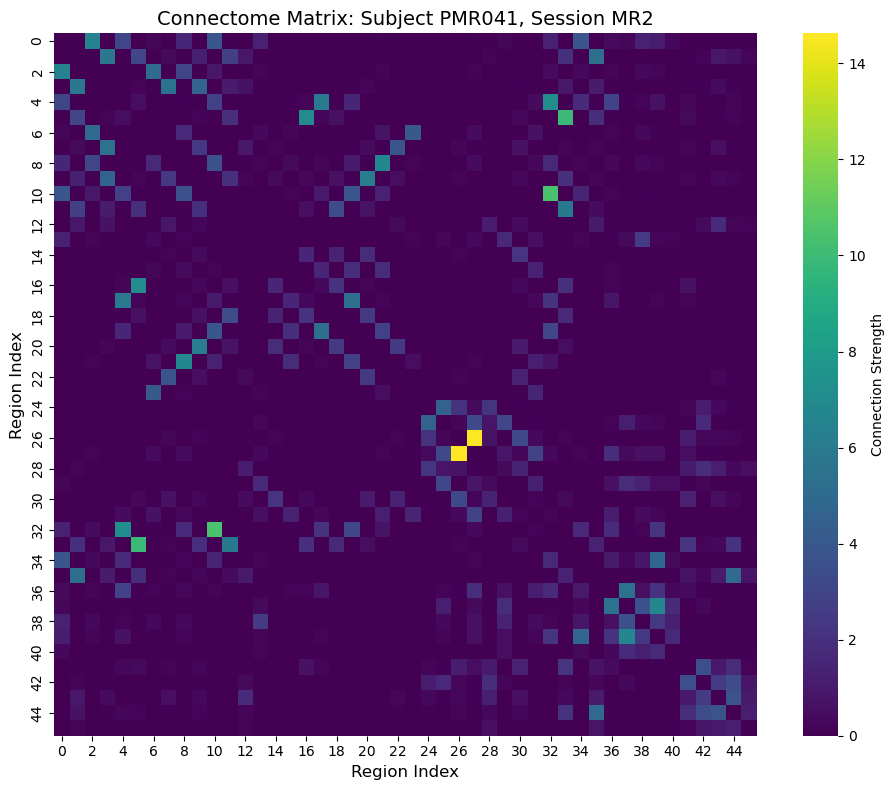

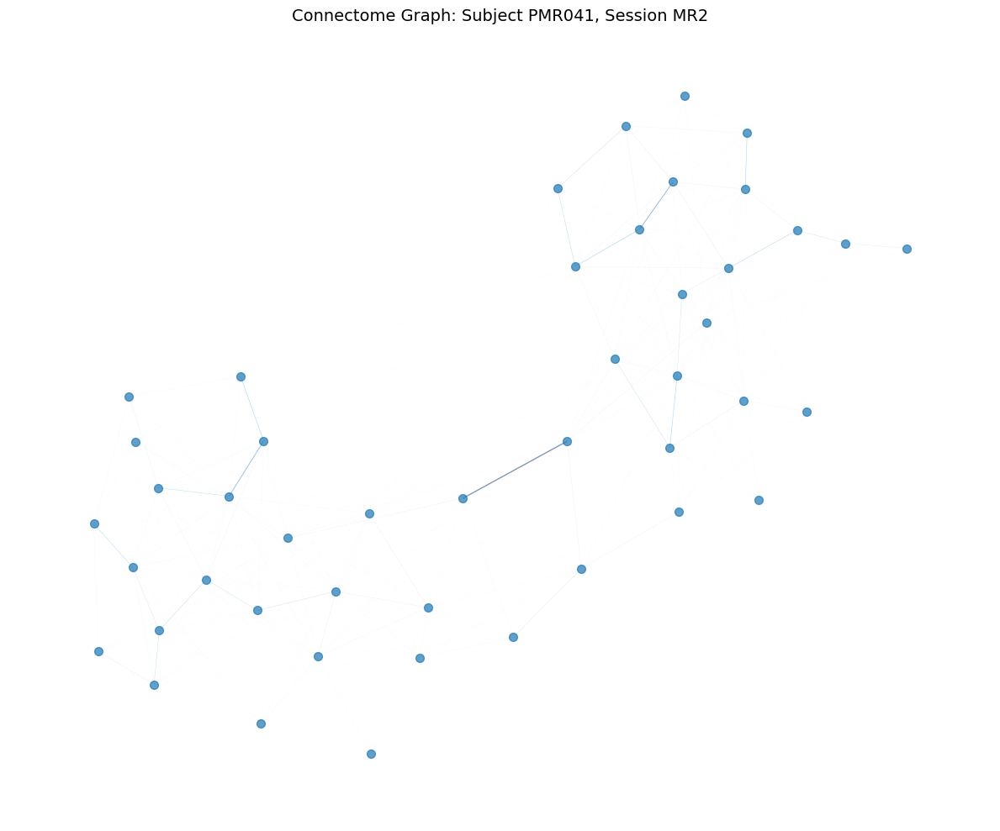

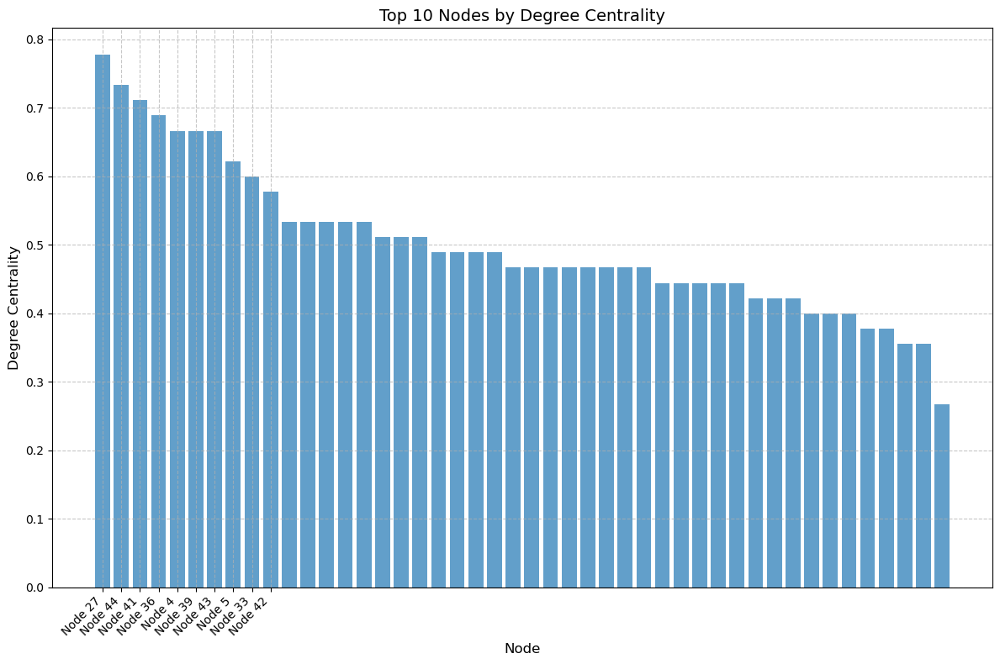

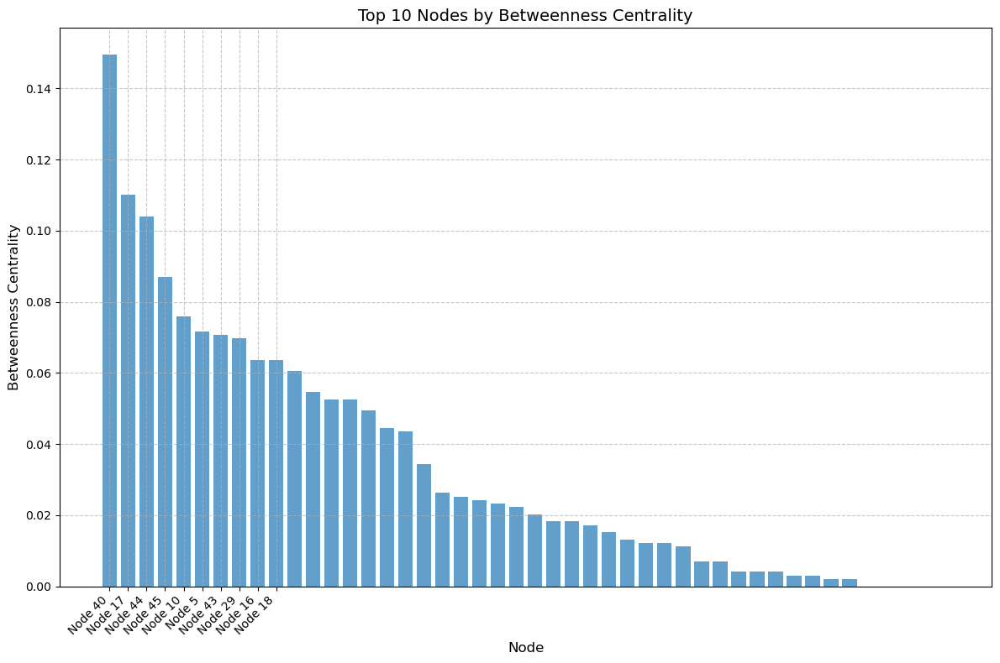

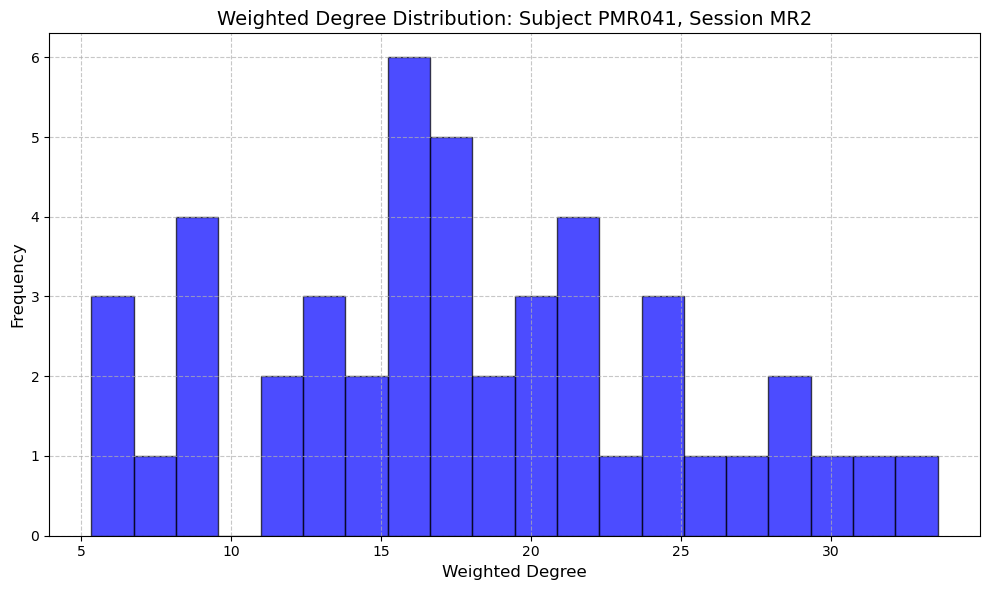

Processing connectome for subject PMR082, session MR2

Visualizations for subject PMR082, session MR2:


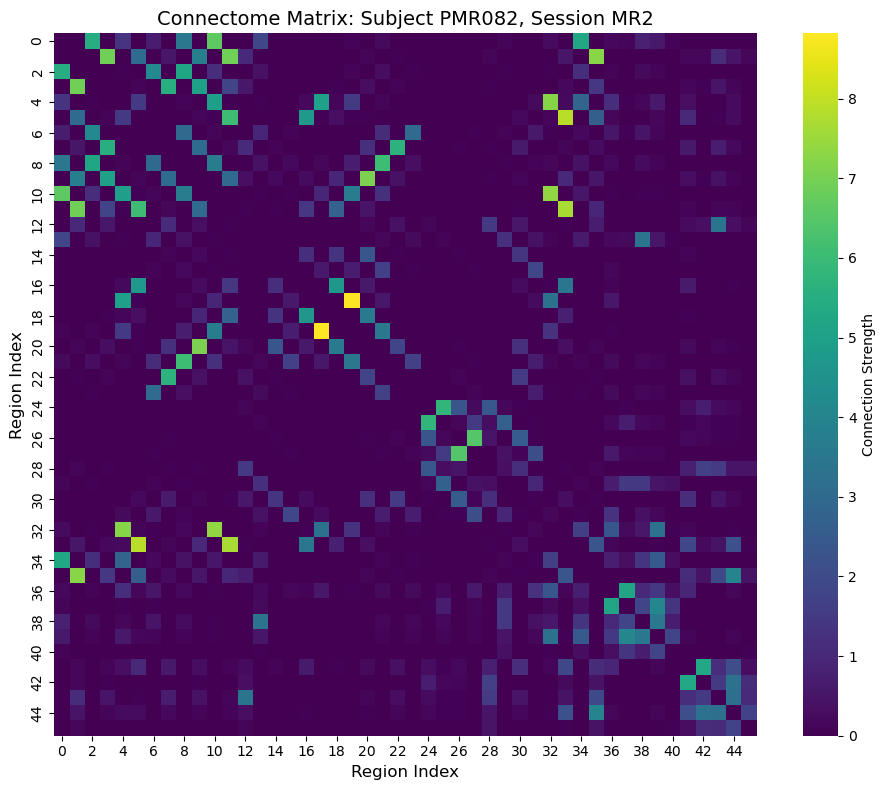

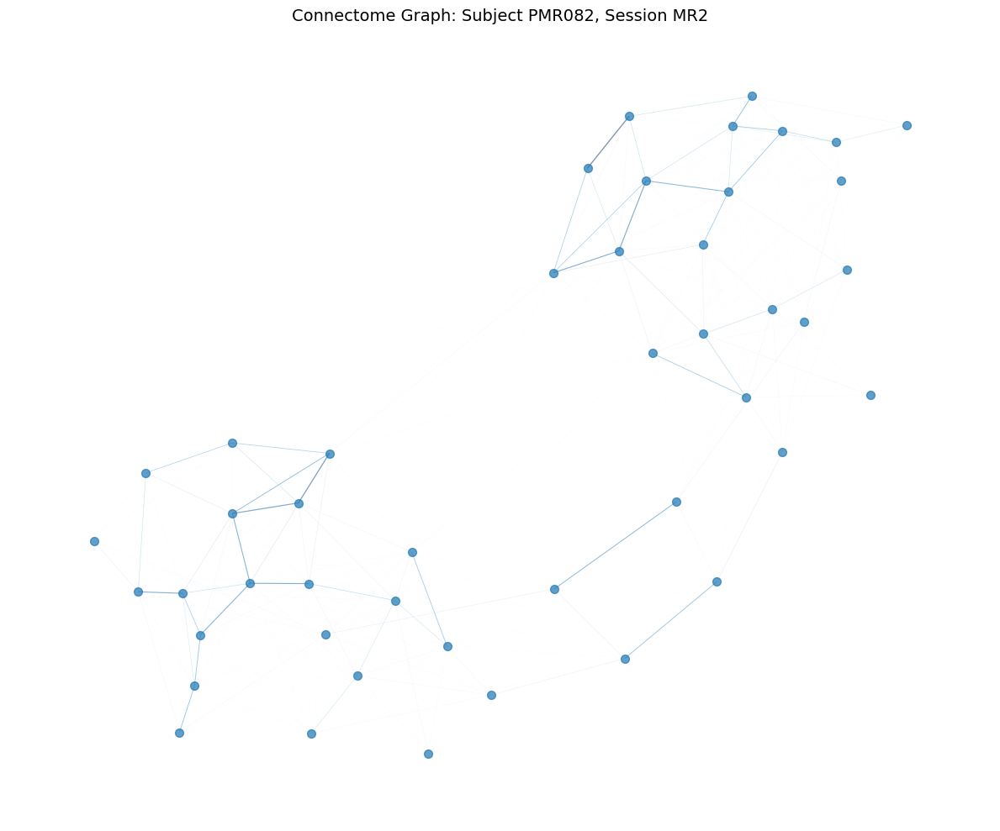

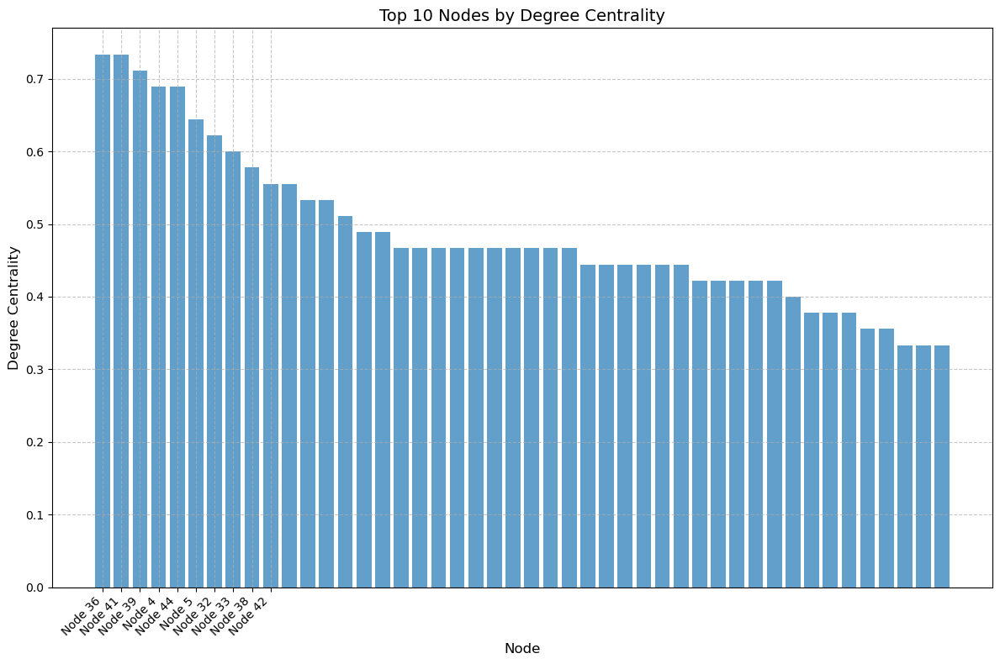

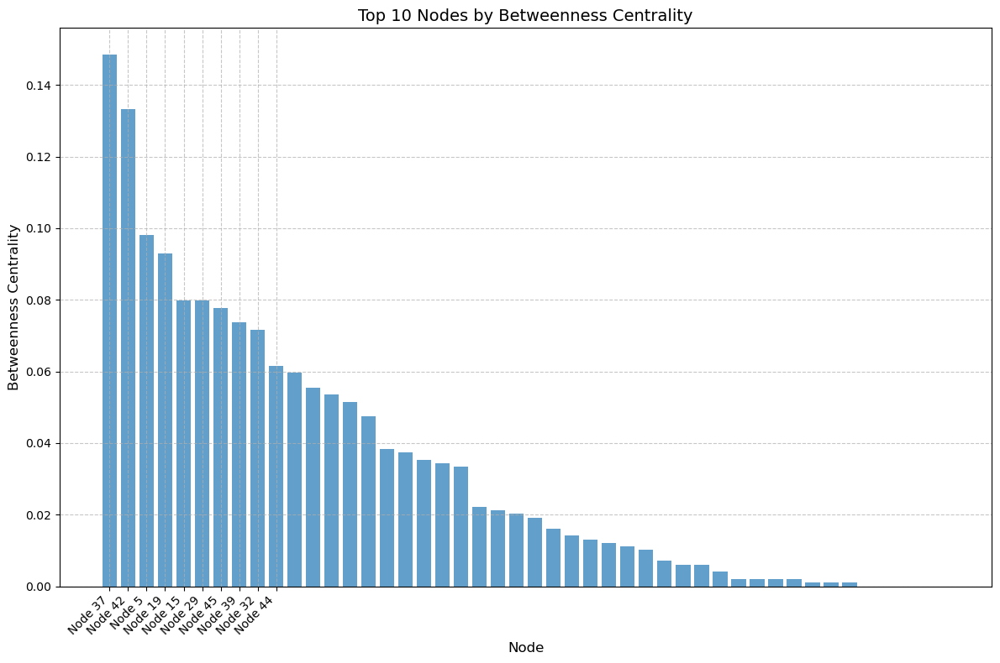

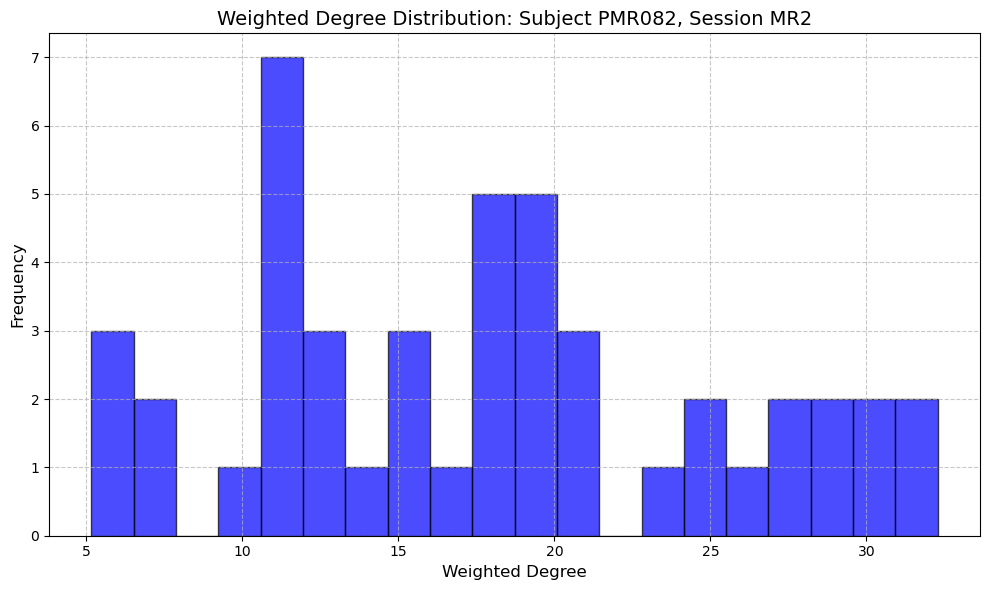

Processing connectome for subject PMR009, session MR2

Visualizations for subject PMR009, session MR2:


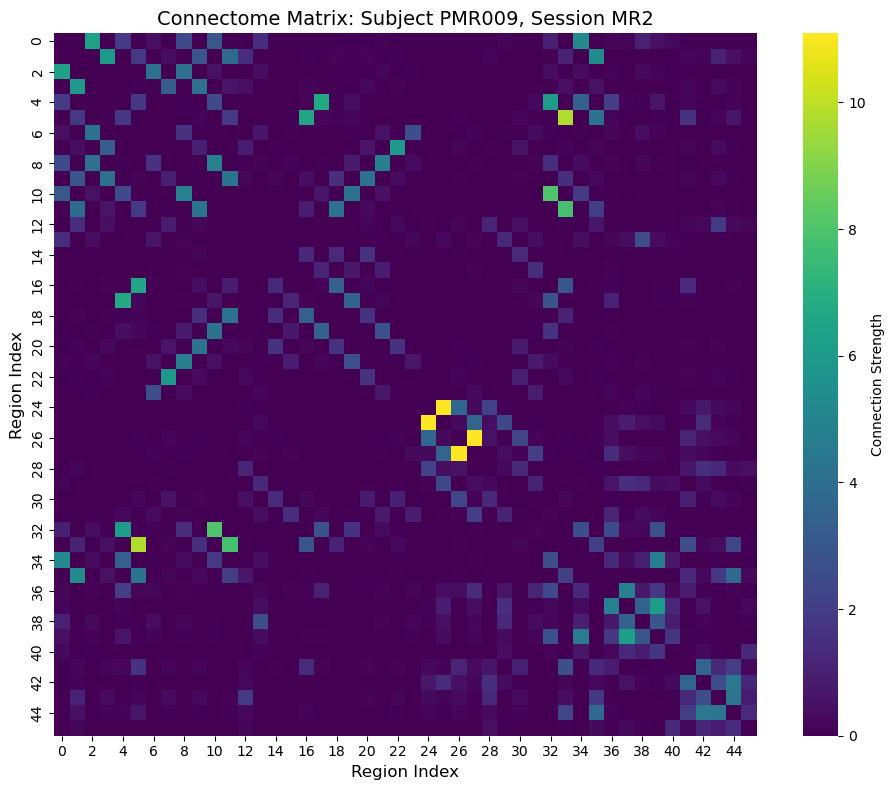

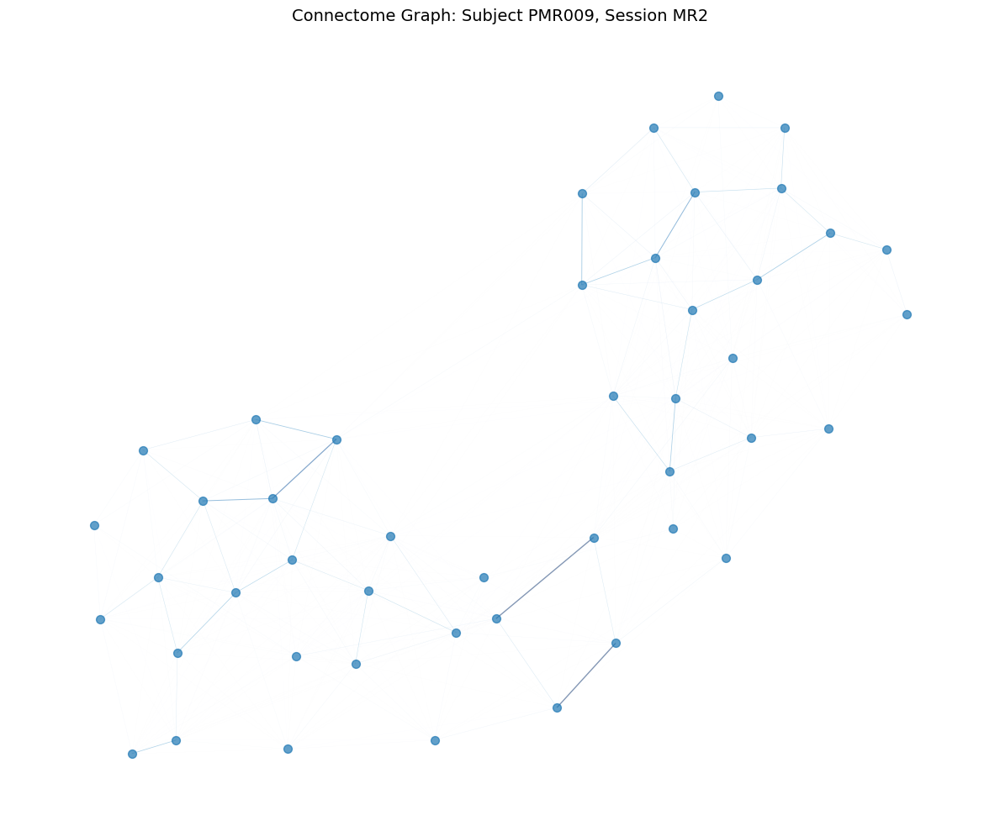

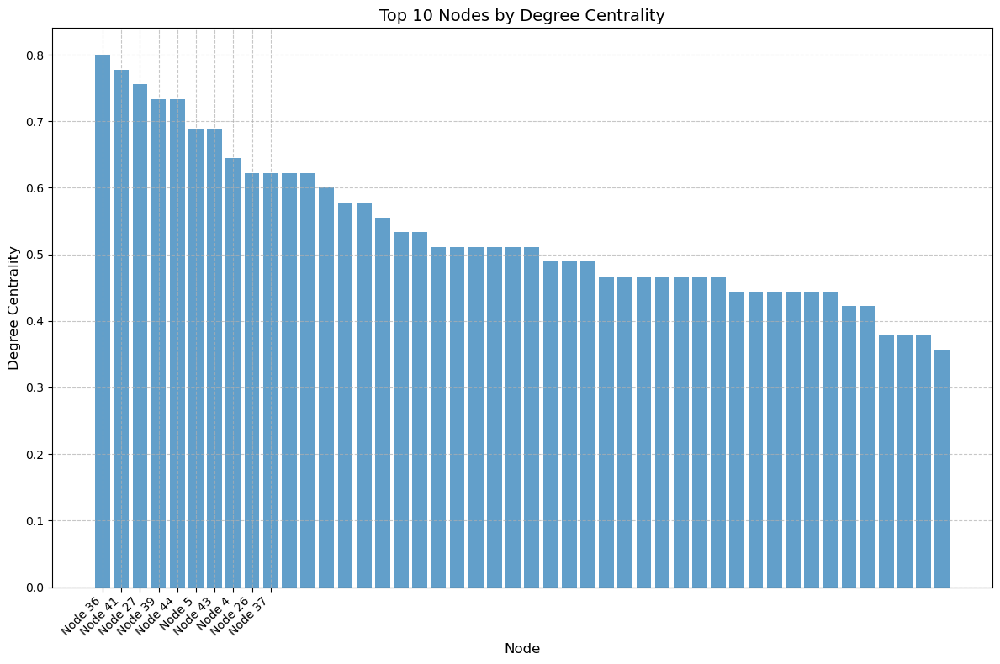

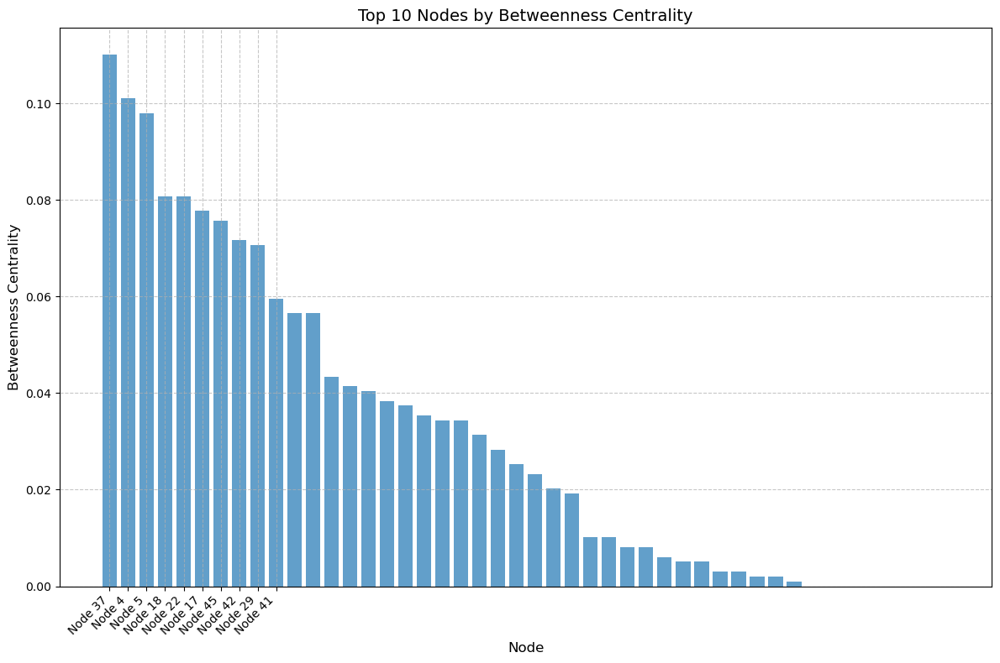

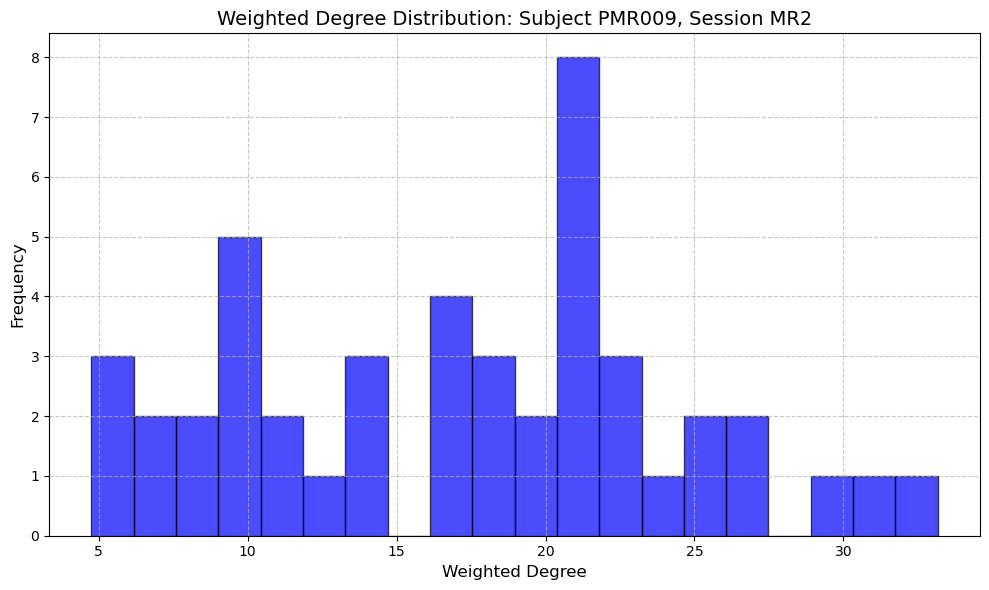

Processing connectome for subject PMR050, session MR2

Visualizations for subject PMR050, session MR2:


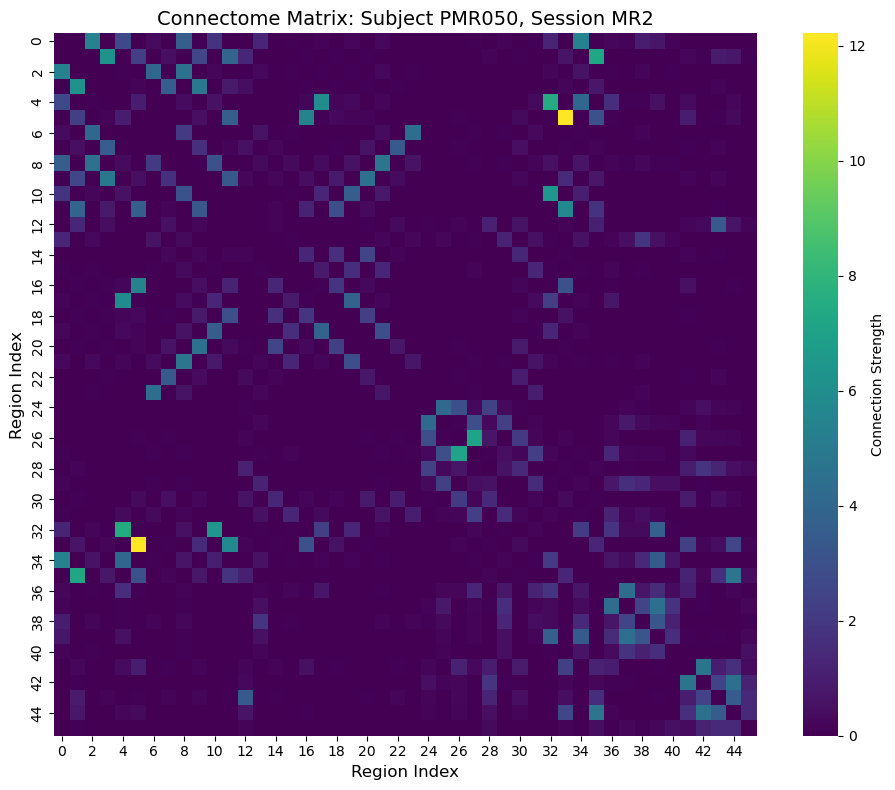

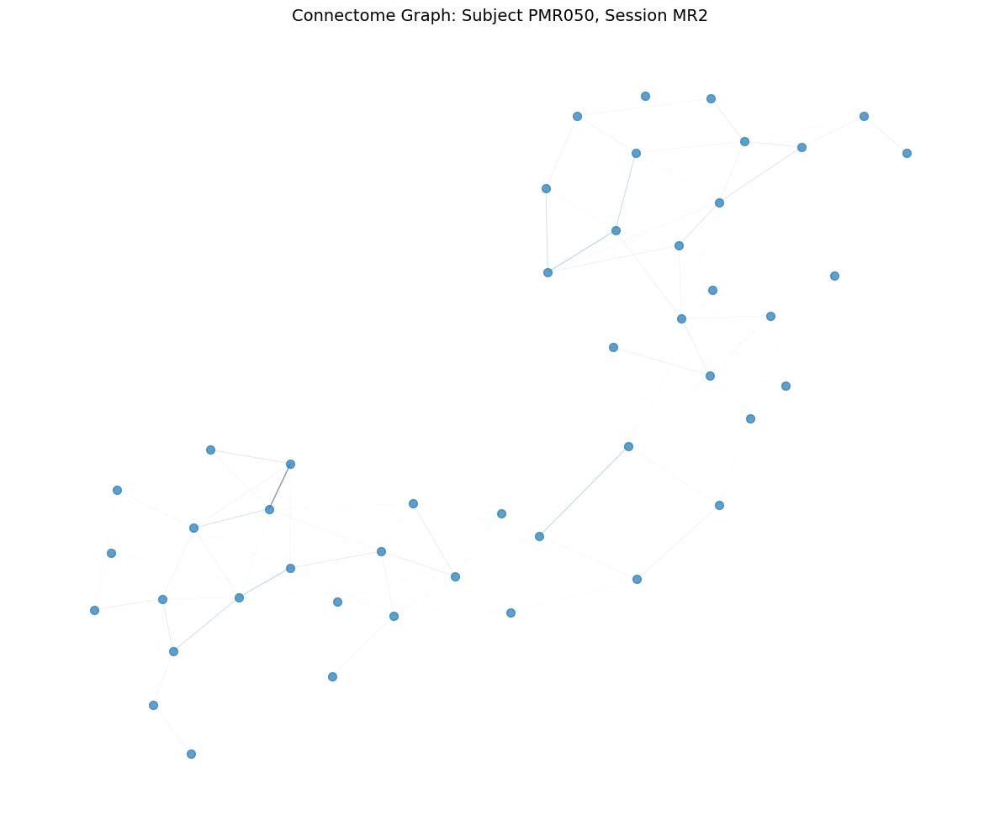

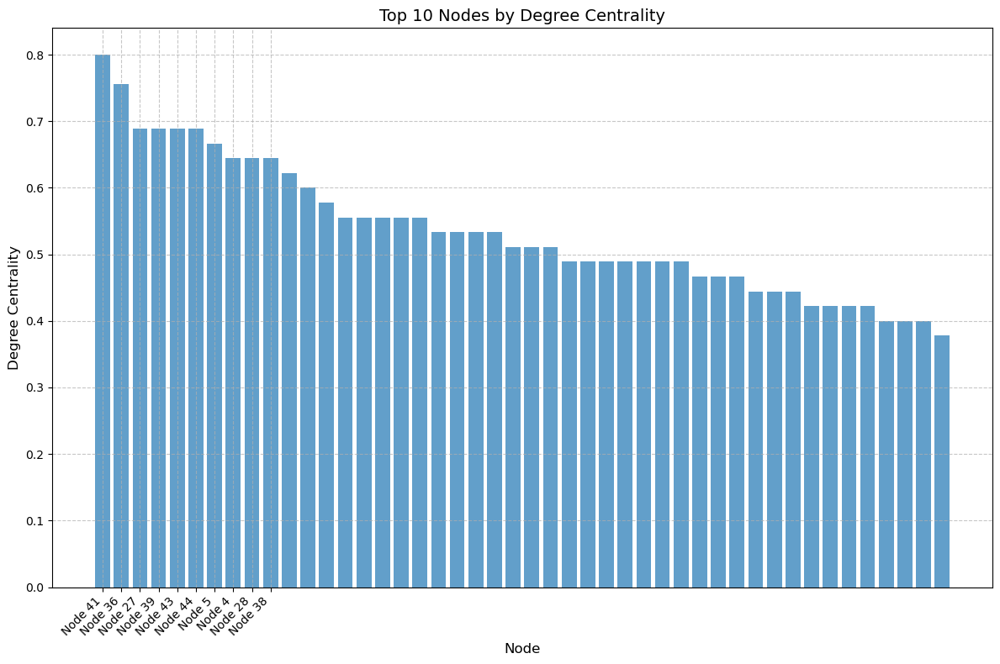

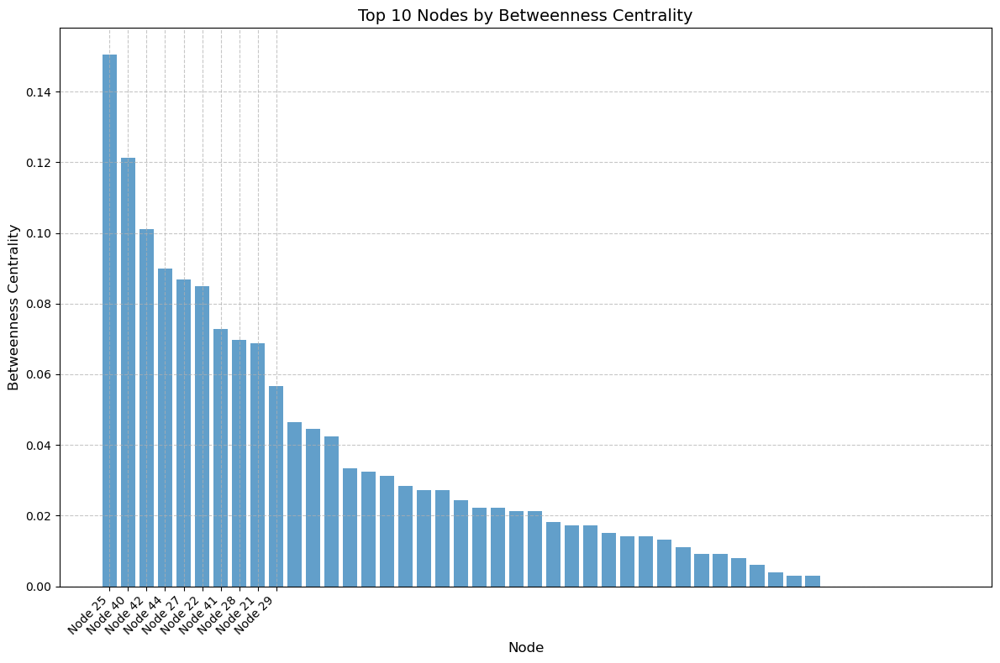

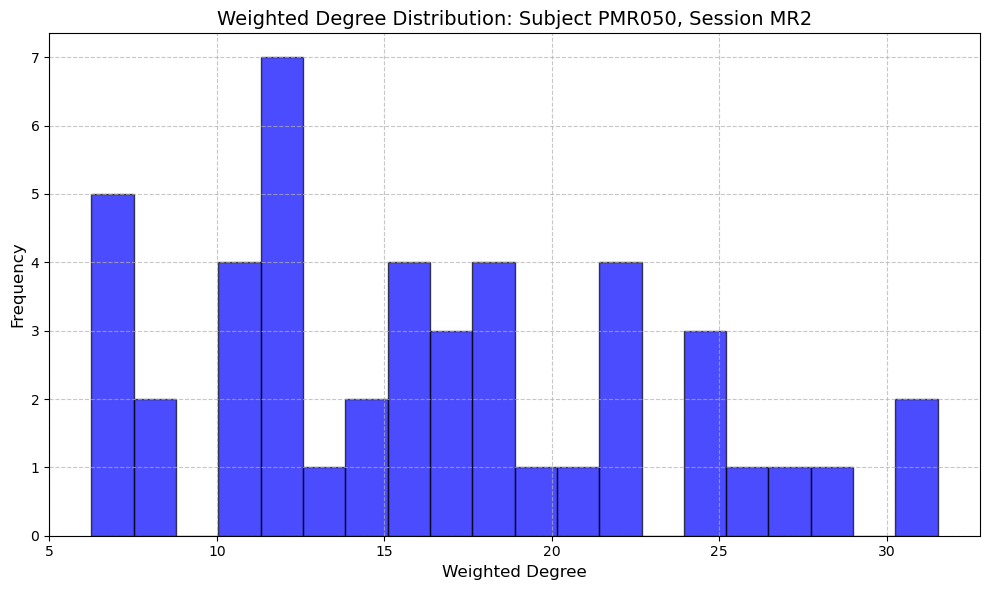

Processing connectome for subject PMR099, session MR2

Visualizations for subject PMR099, session MR2:


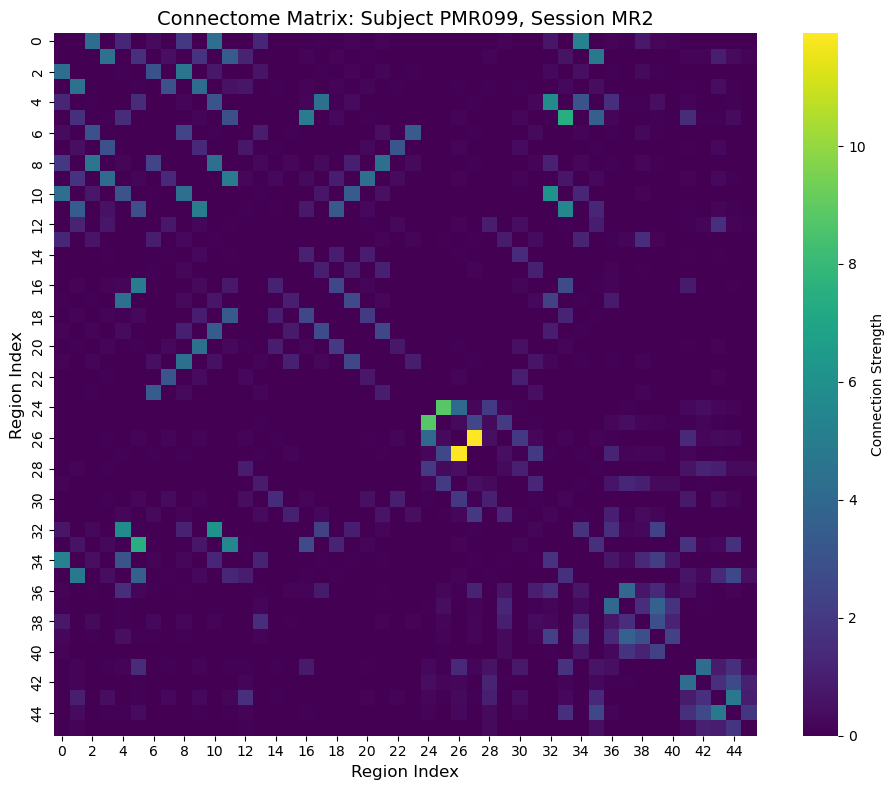

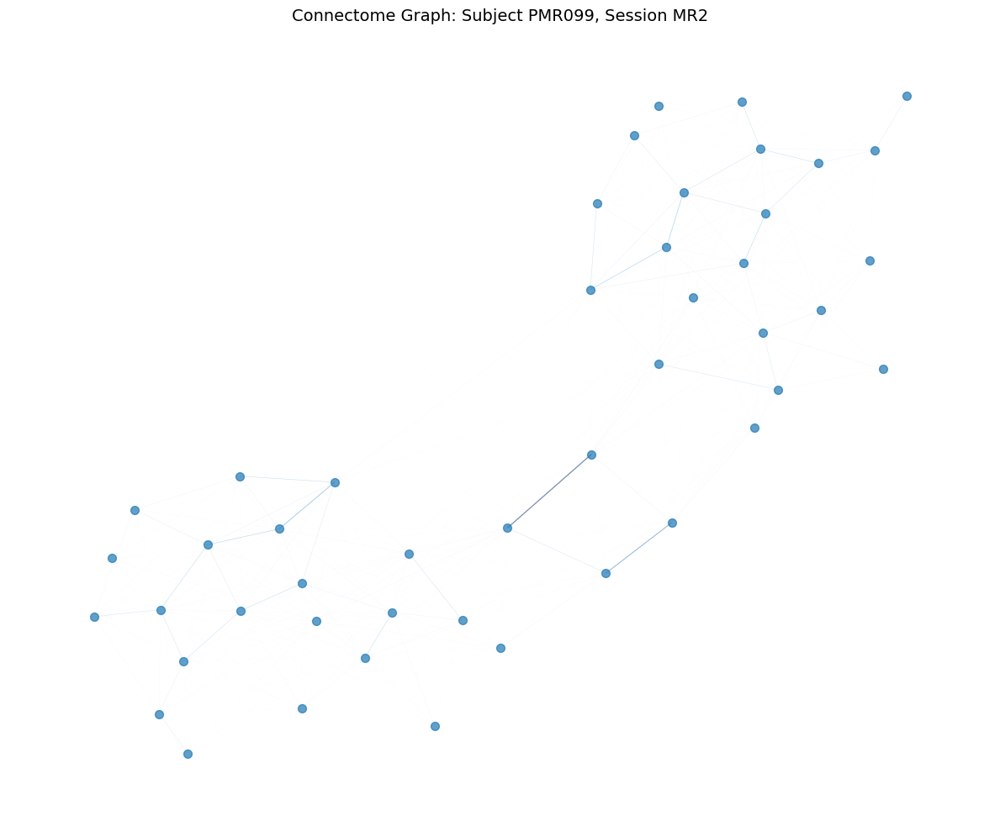

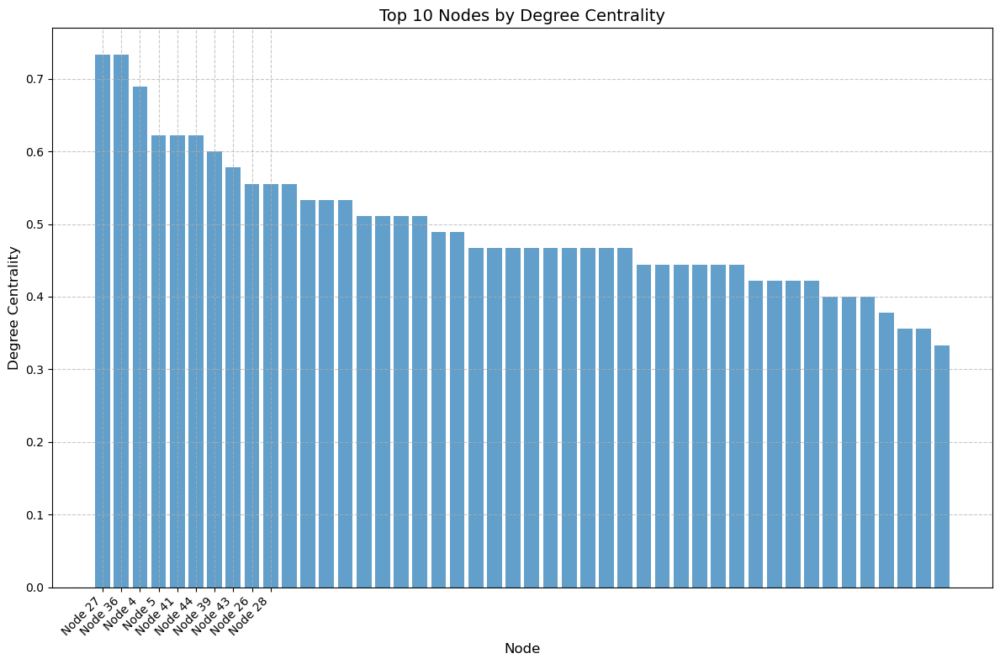

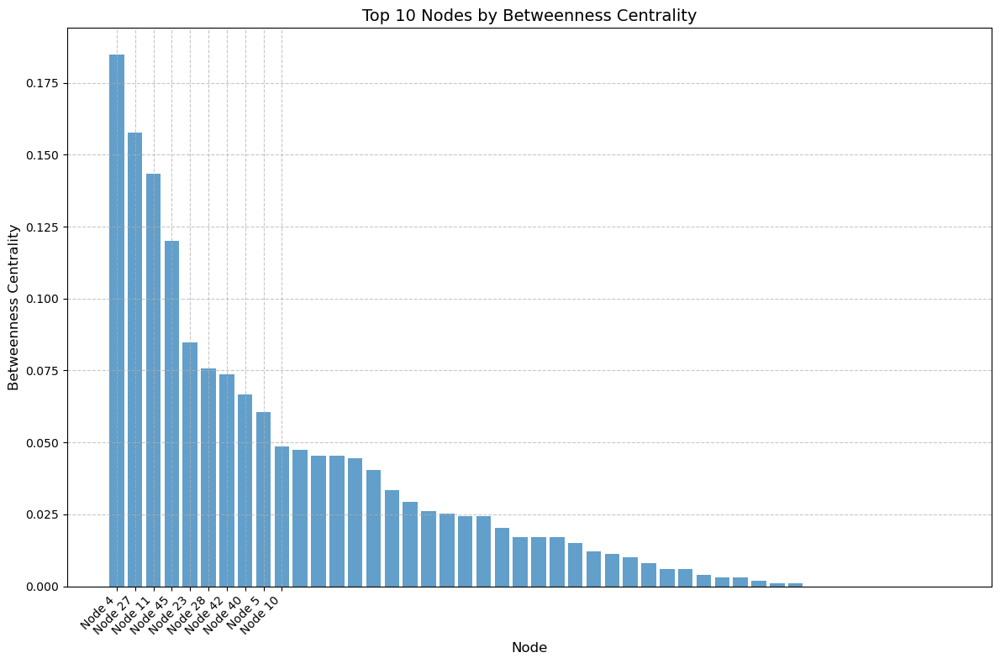

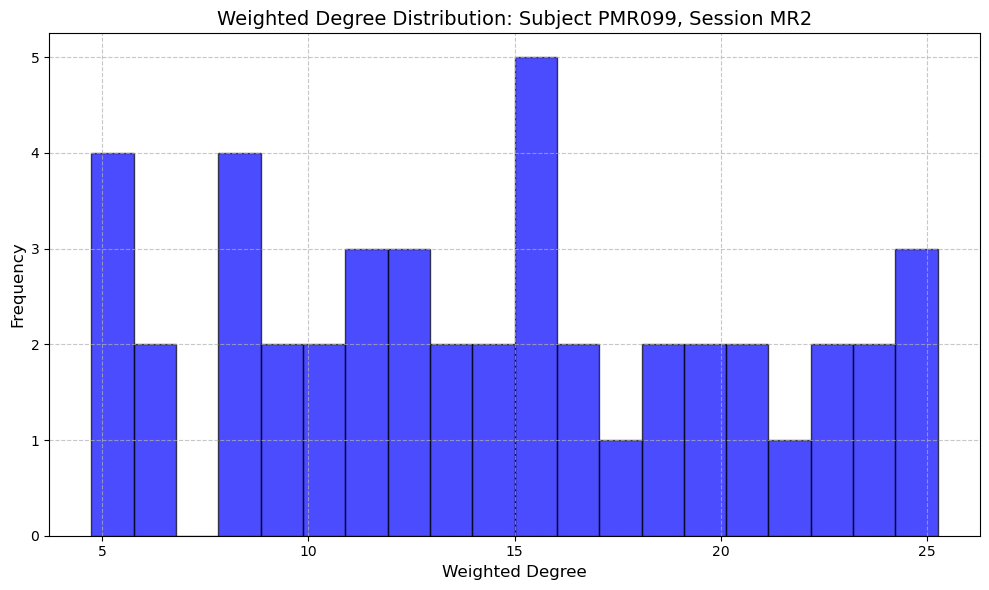

Processing connectome for subject PMR036, session MR2

Visualizations for subject PMR036, session MR2:


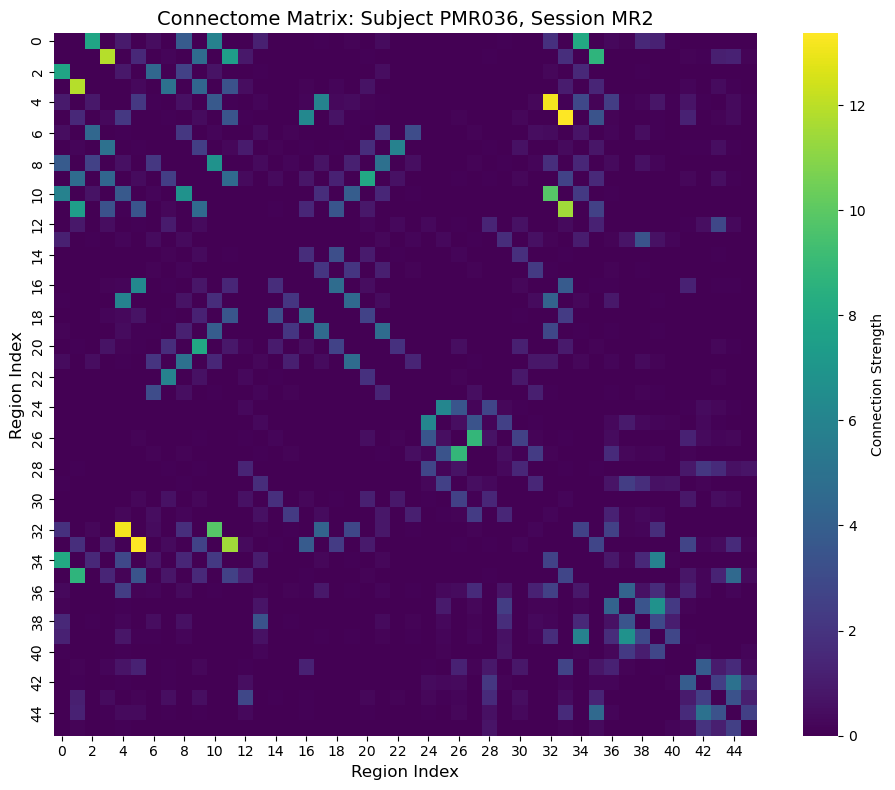

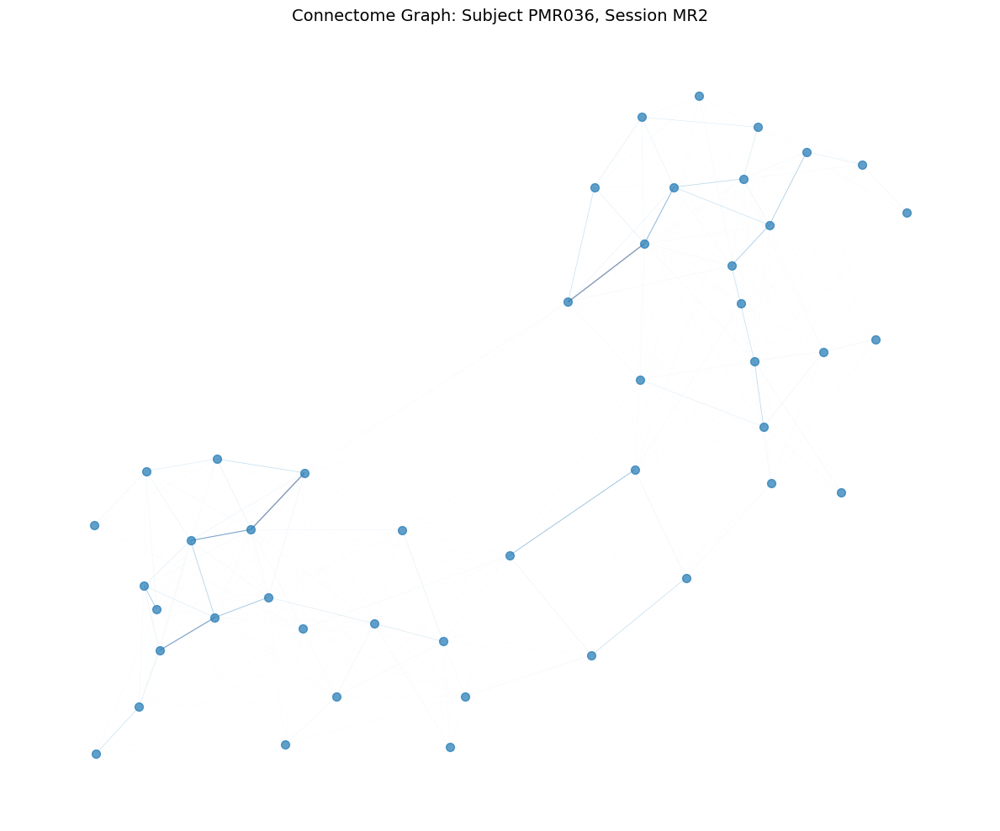

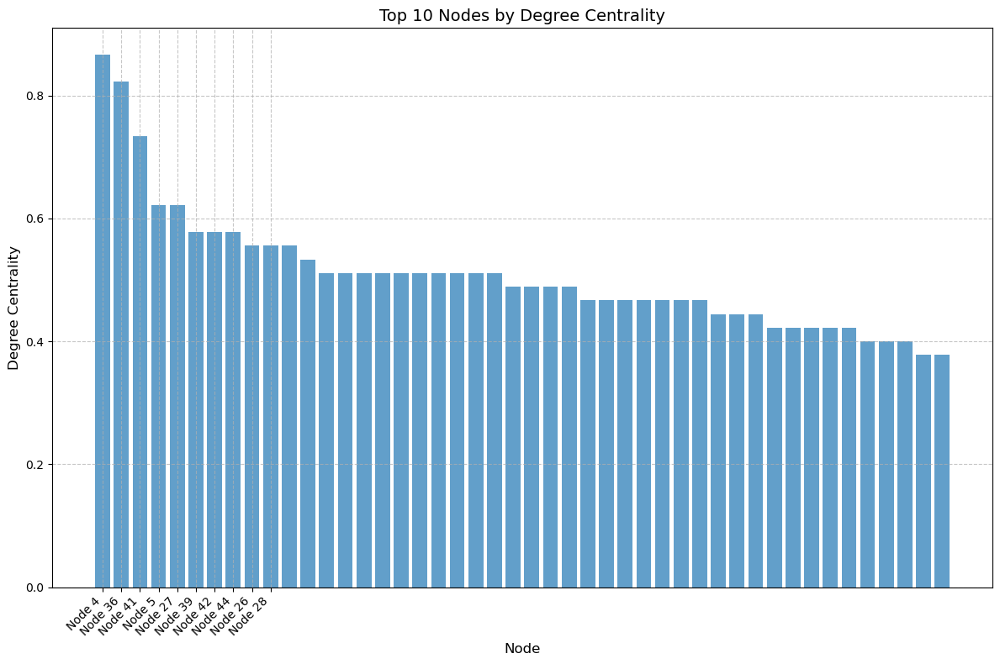

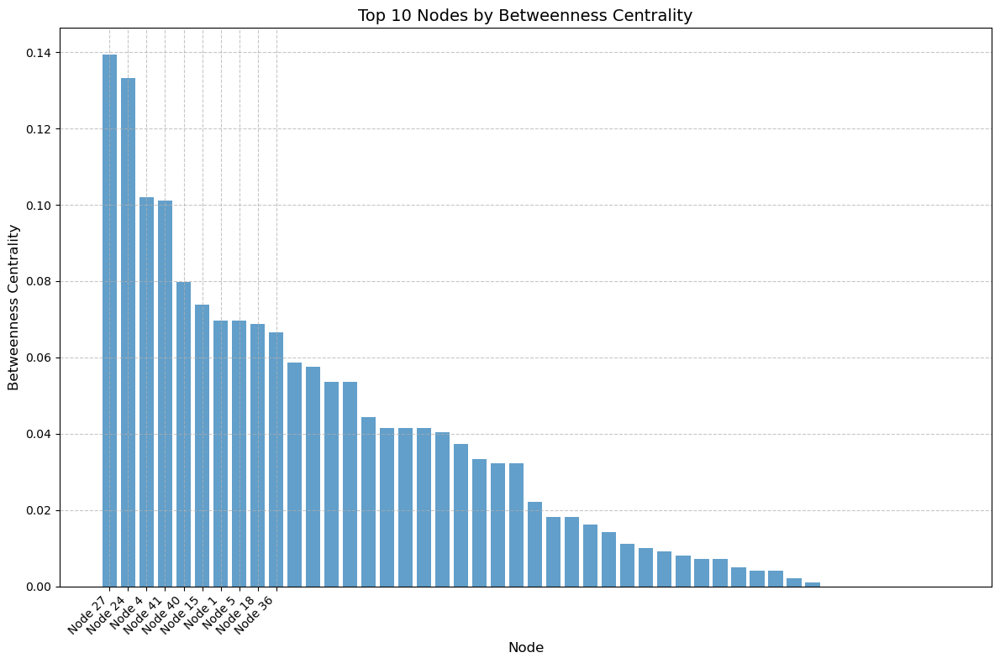

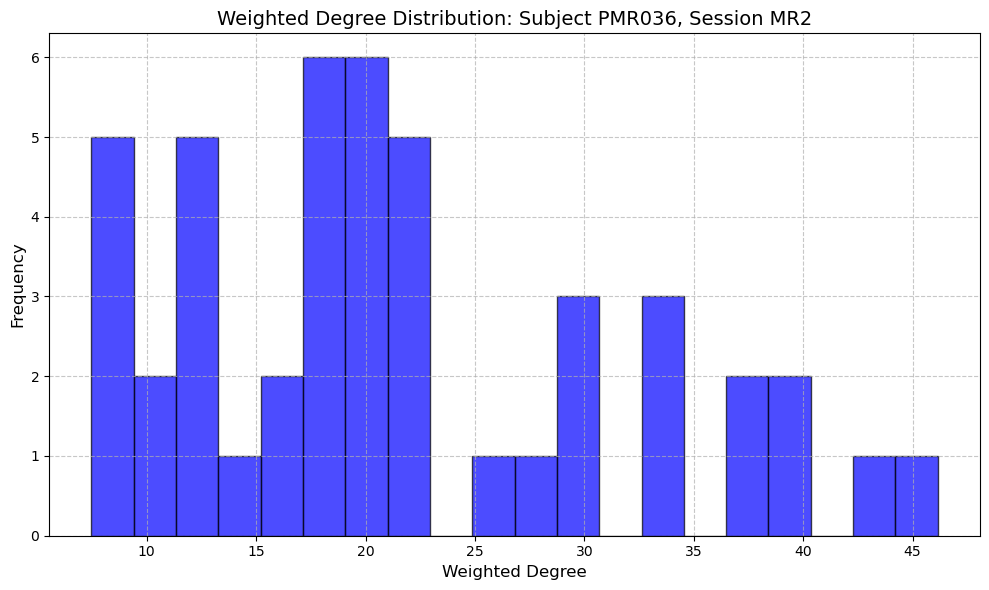

Processing connectome for subject PMR071, session MR2

Visualizations for subject PMR071, session MR2:


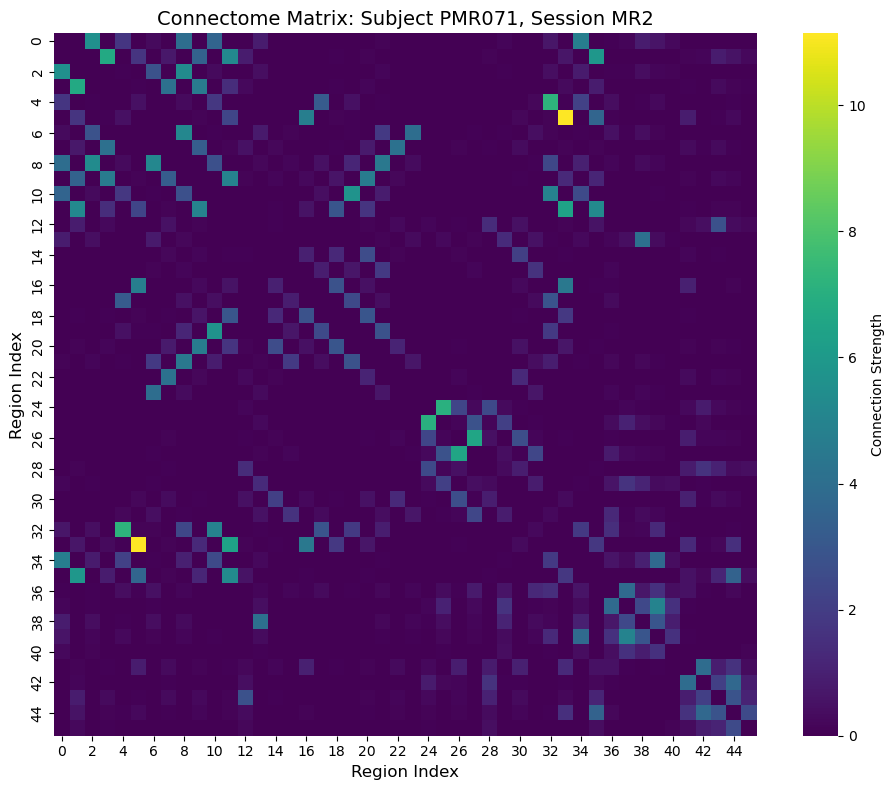

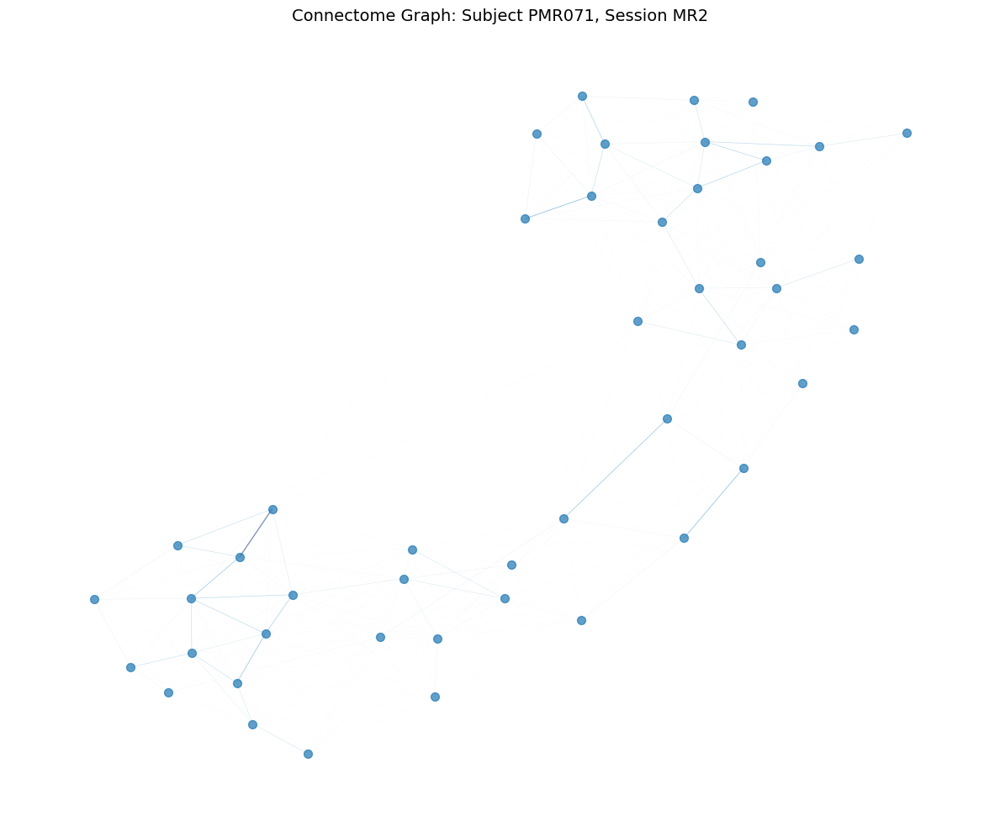

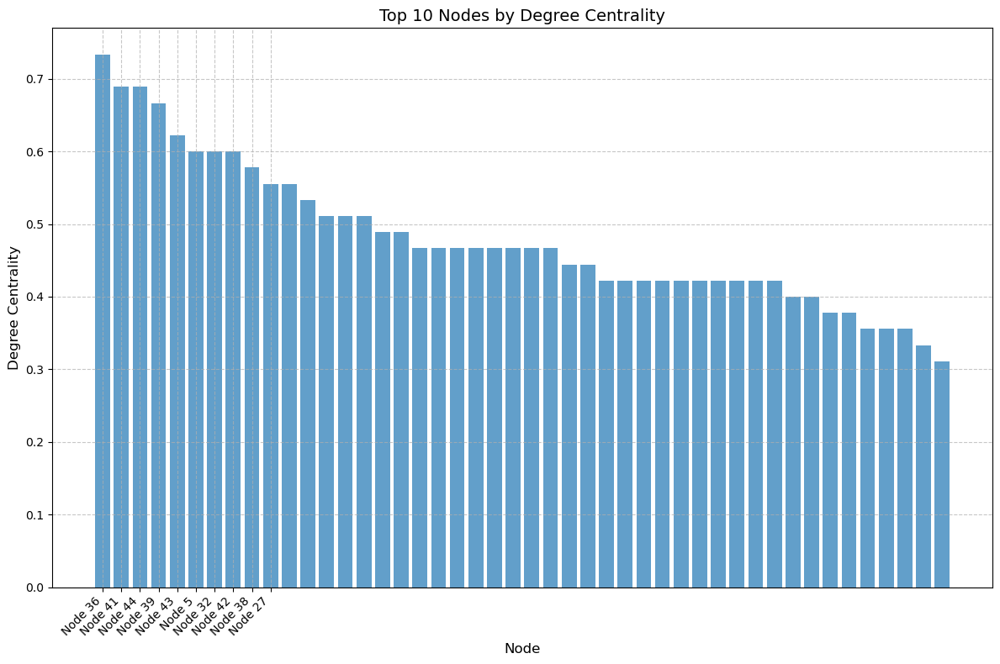

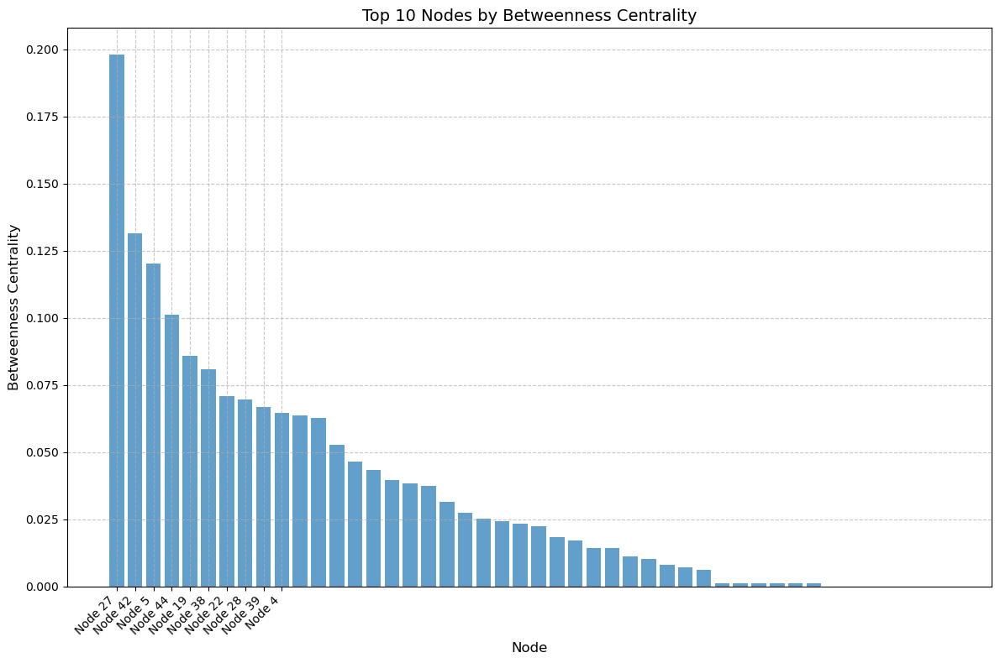

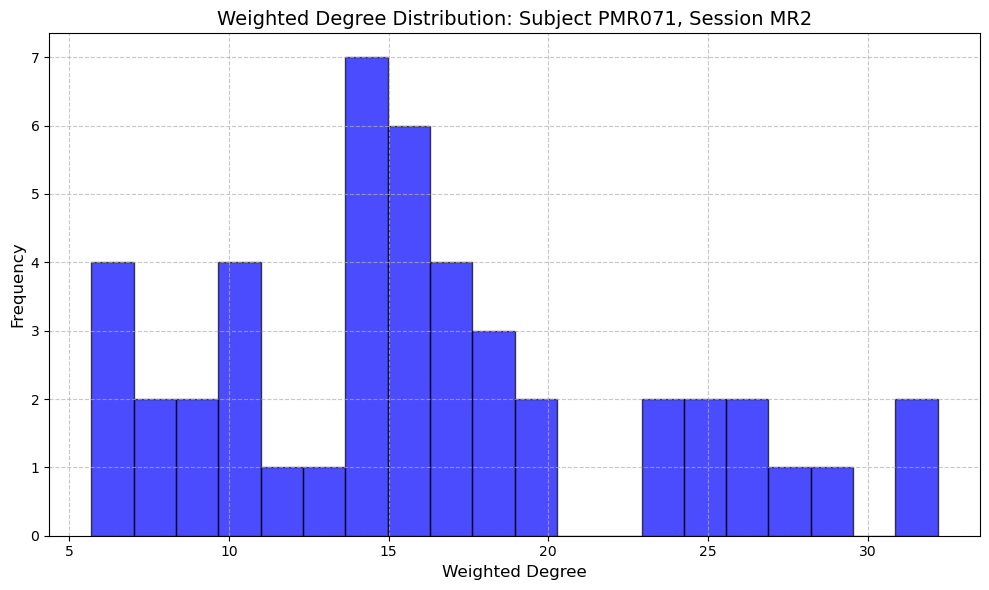

Processing connectome for subject PMR074, session MR2

Visualizations for subject PMR074, session MR2:


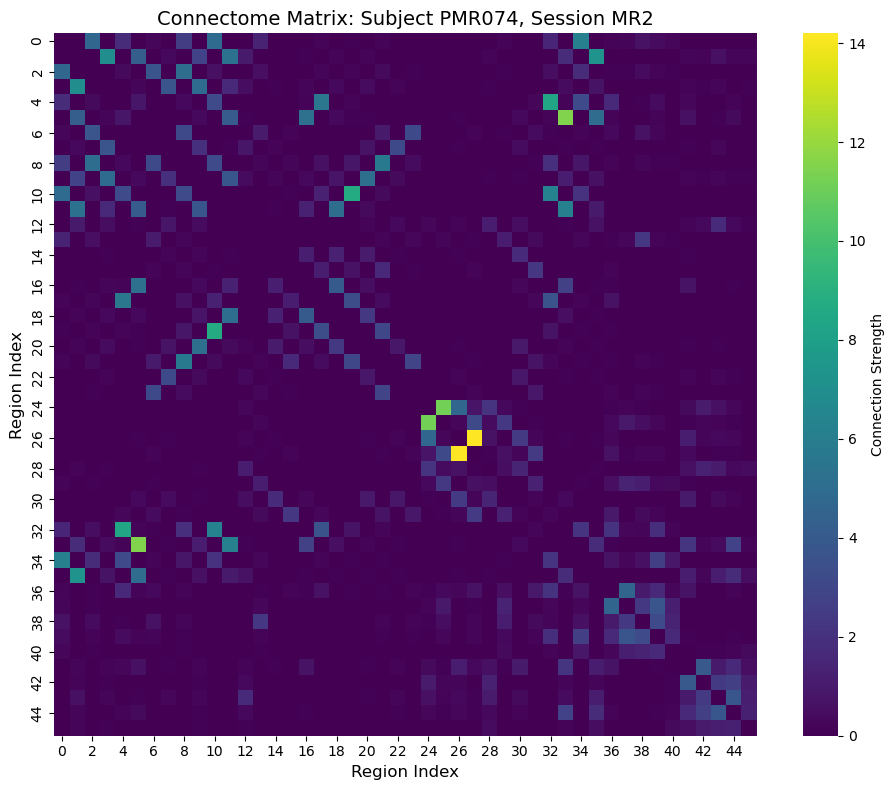

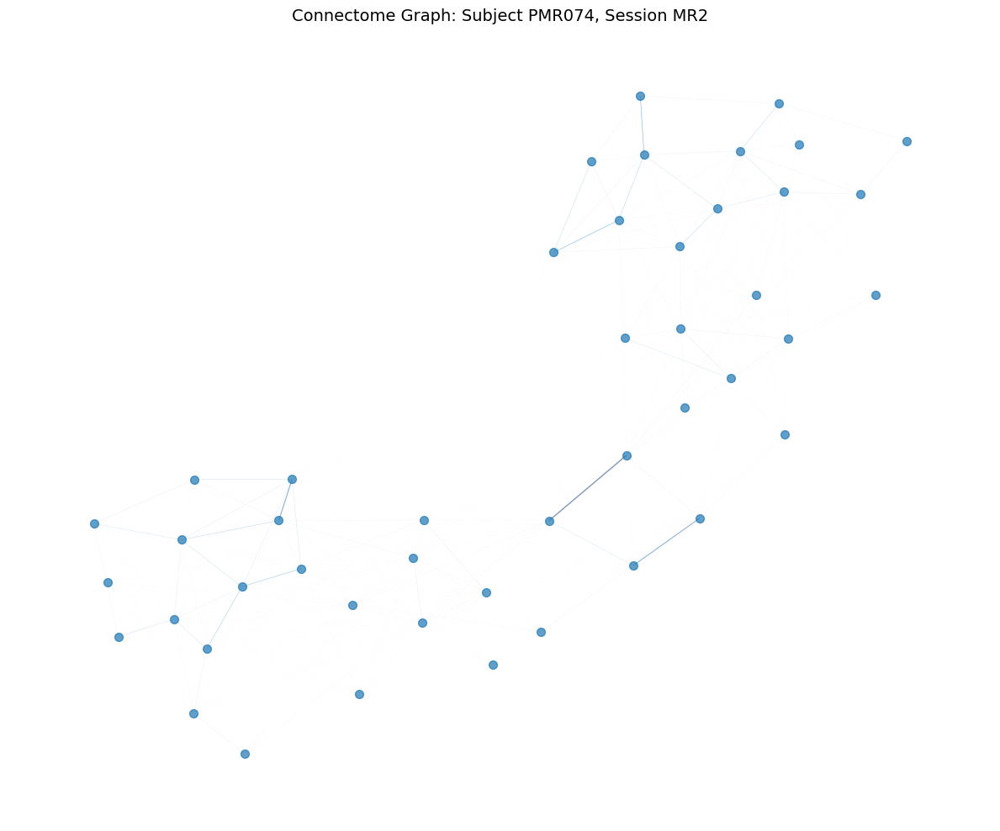

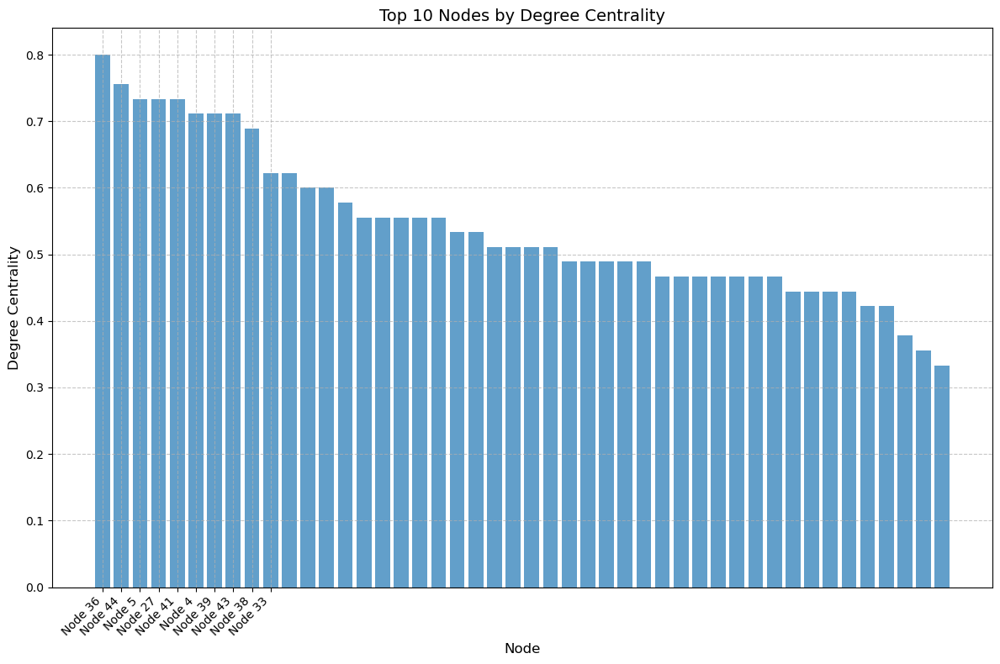

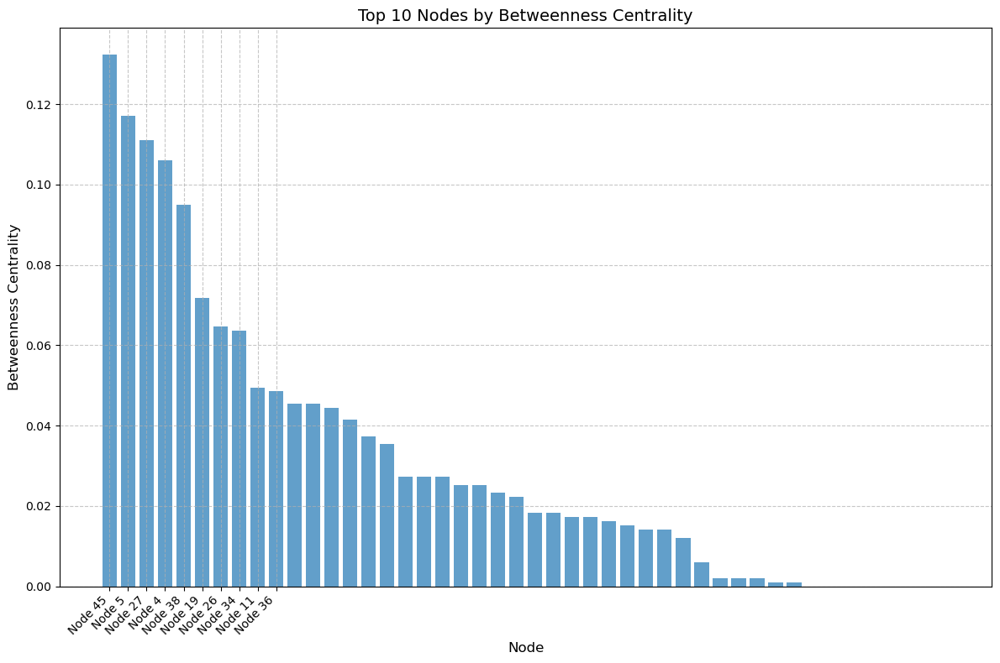

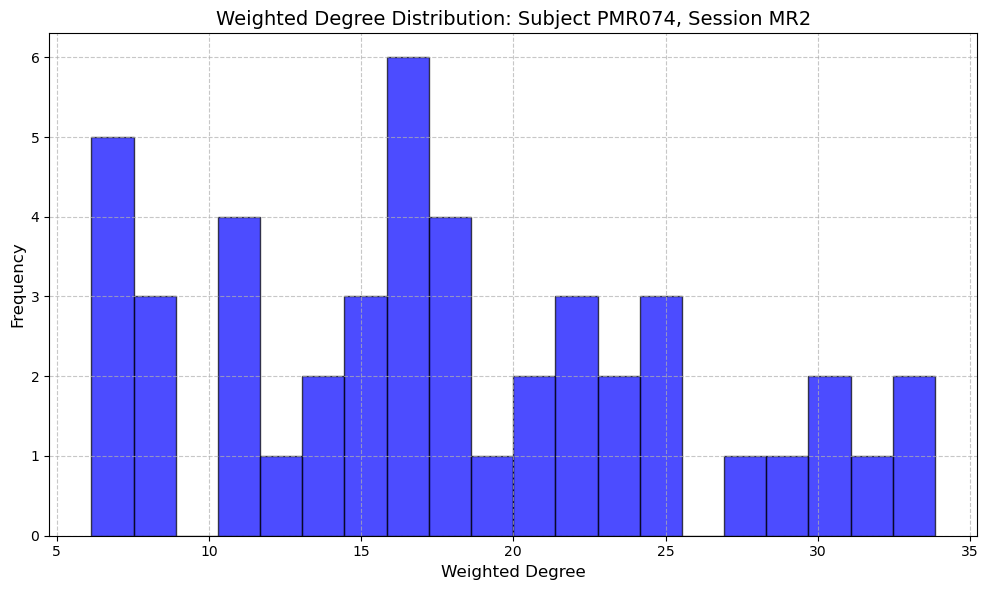

Processing connectome for subject PMR057, session MR2

Visualizations for subject PMR057, session MR2:


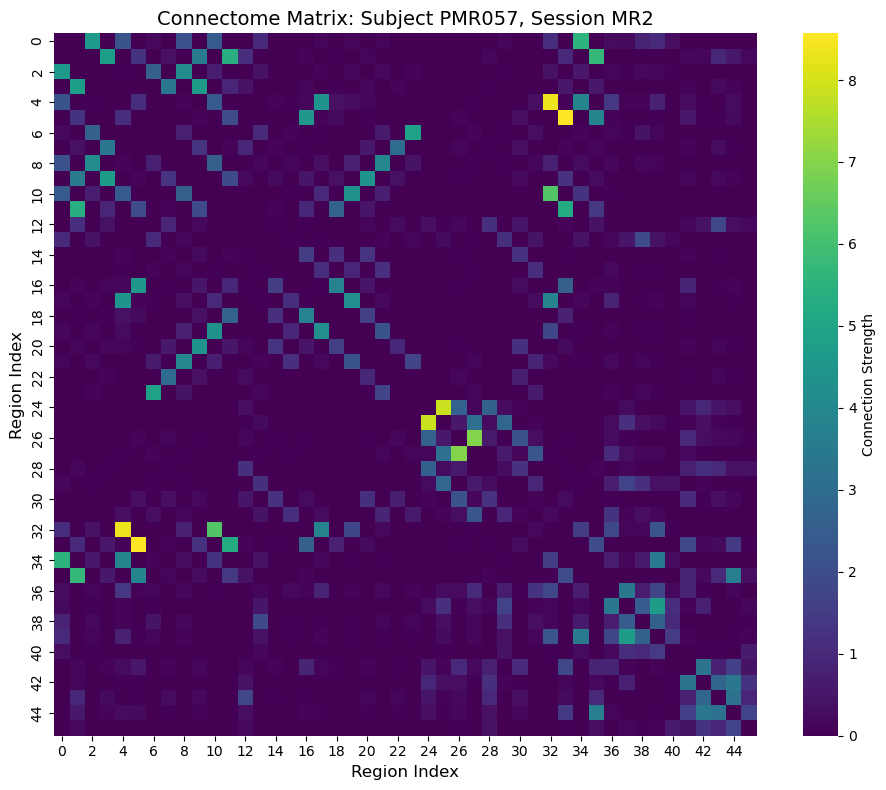

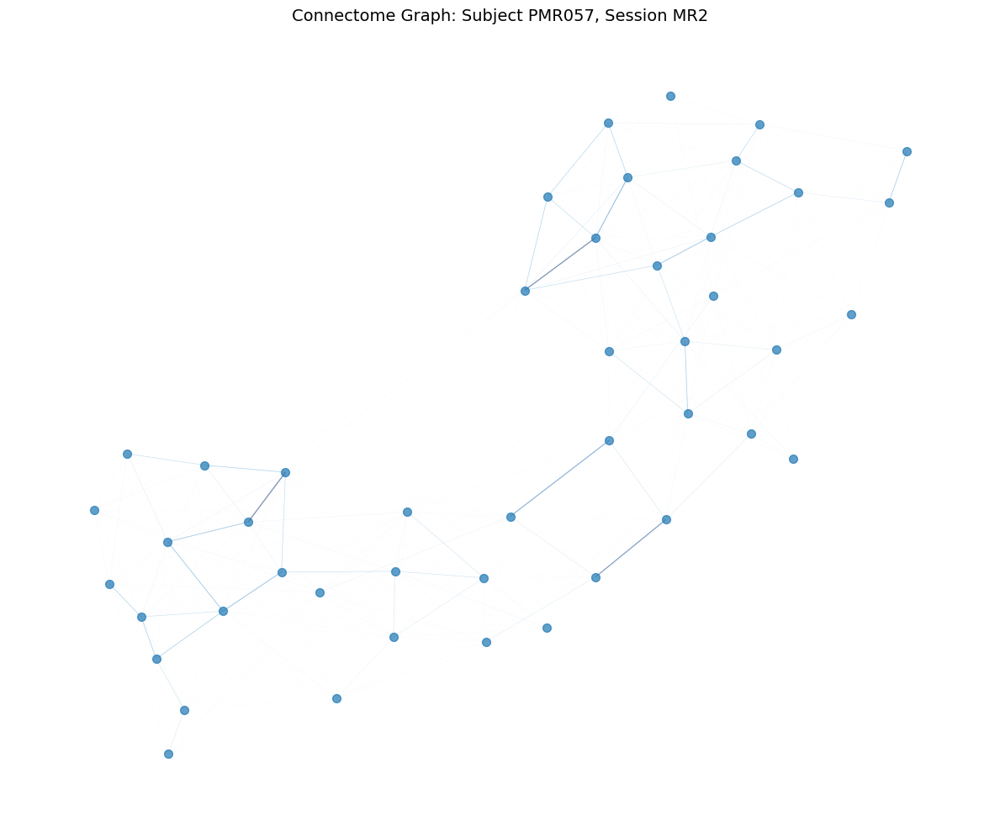

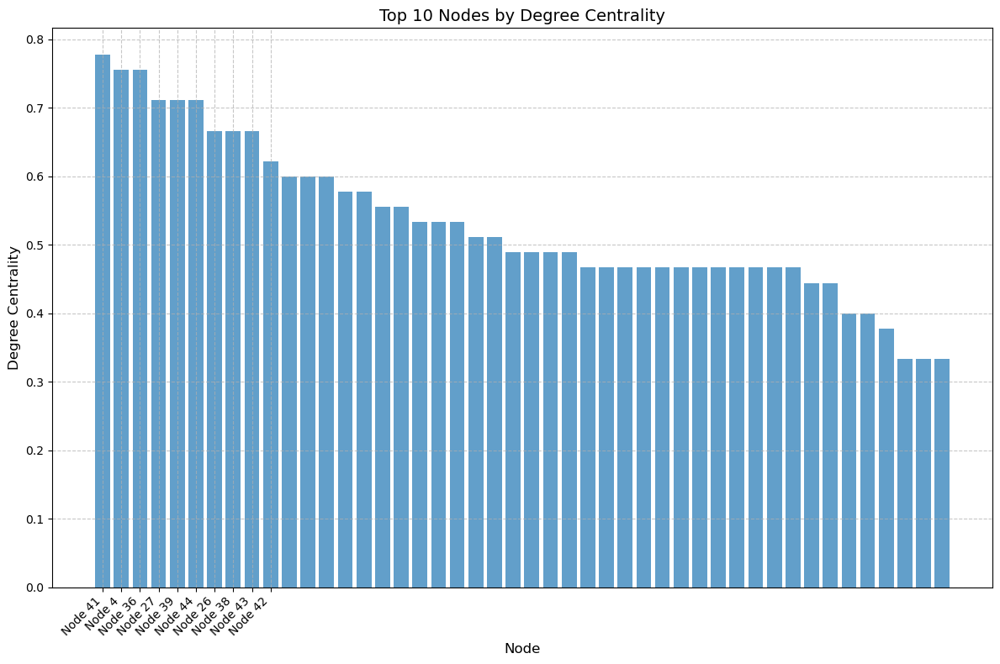

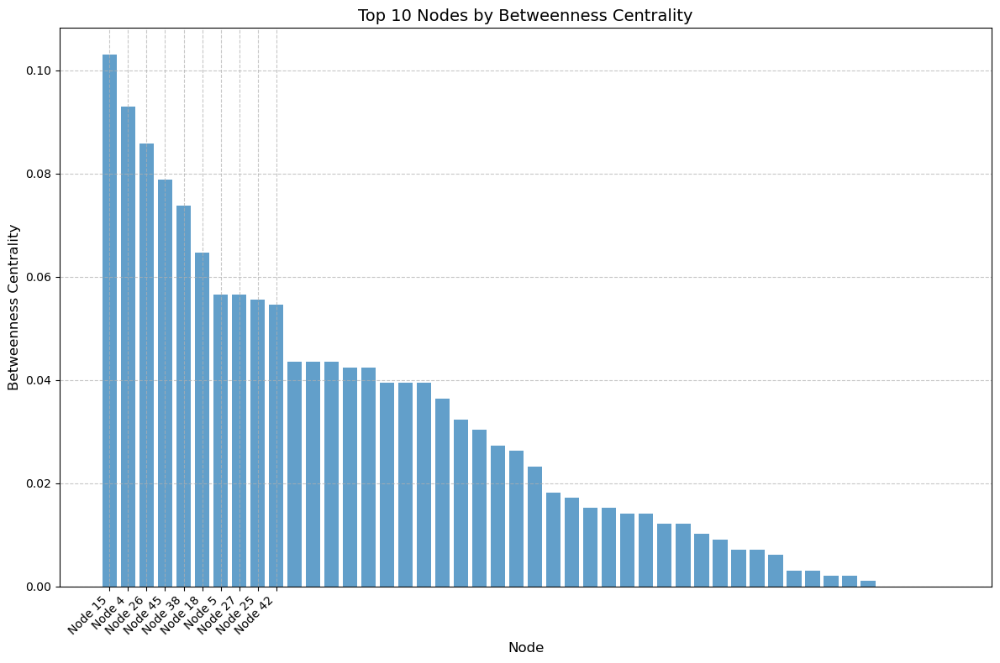

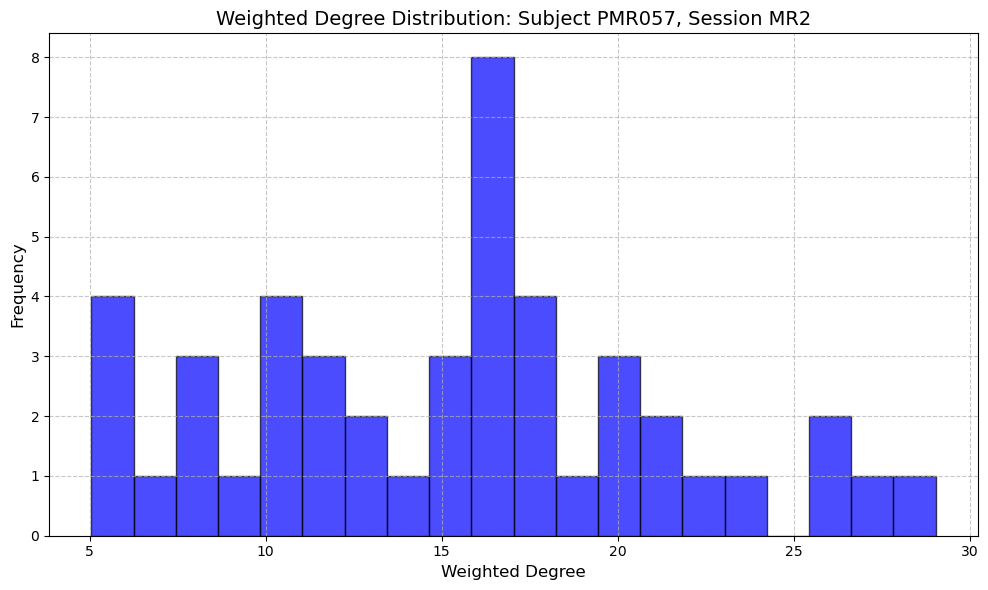

Processing connectome for subject PMR003, session MR2

Visualizations for subject PMR003, session MR2:


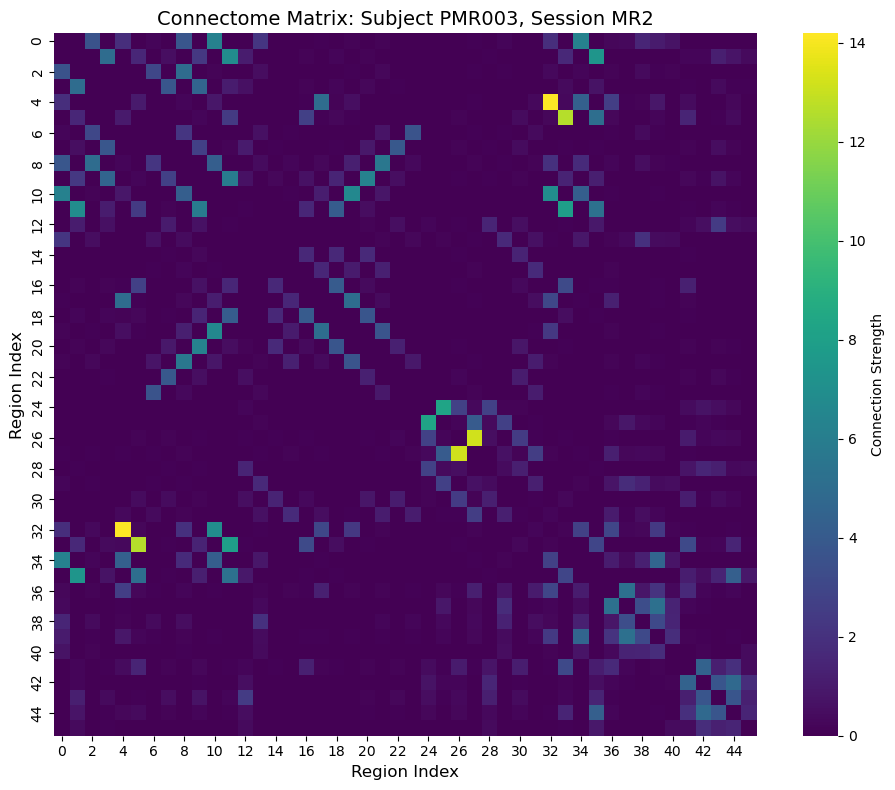

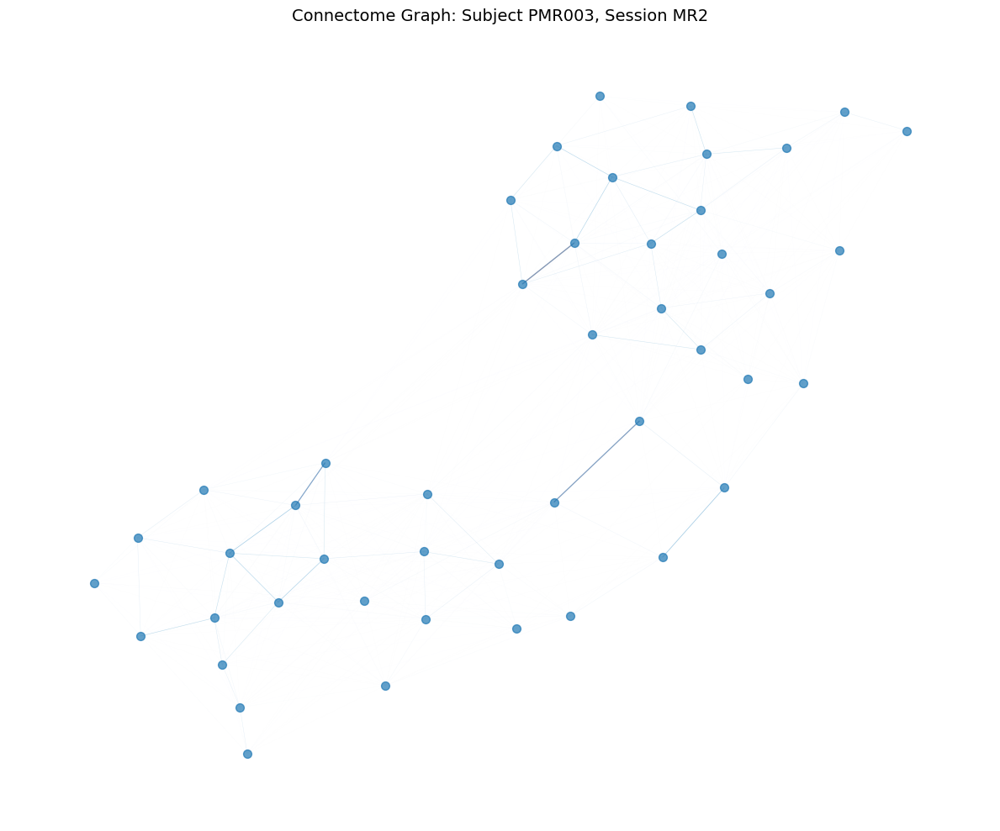

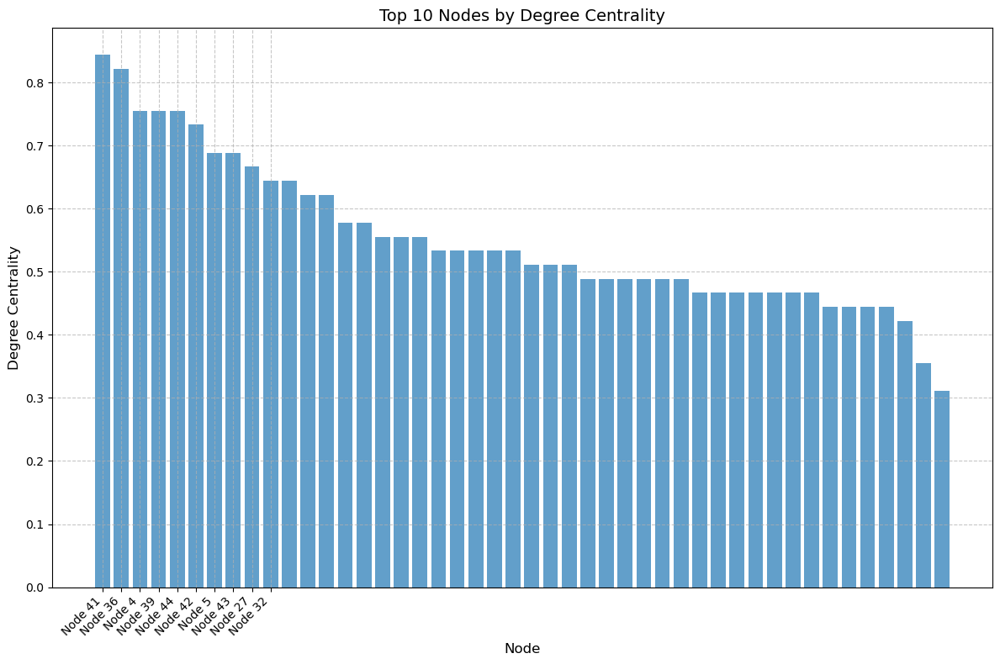

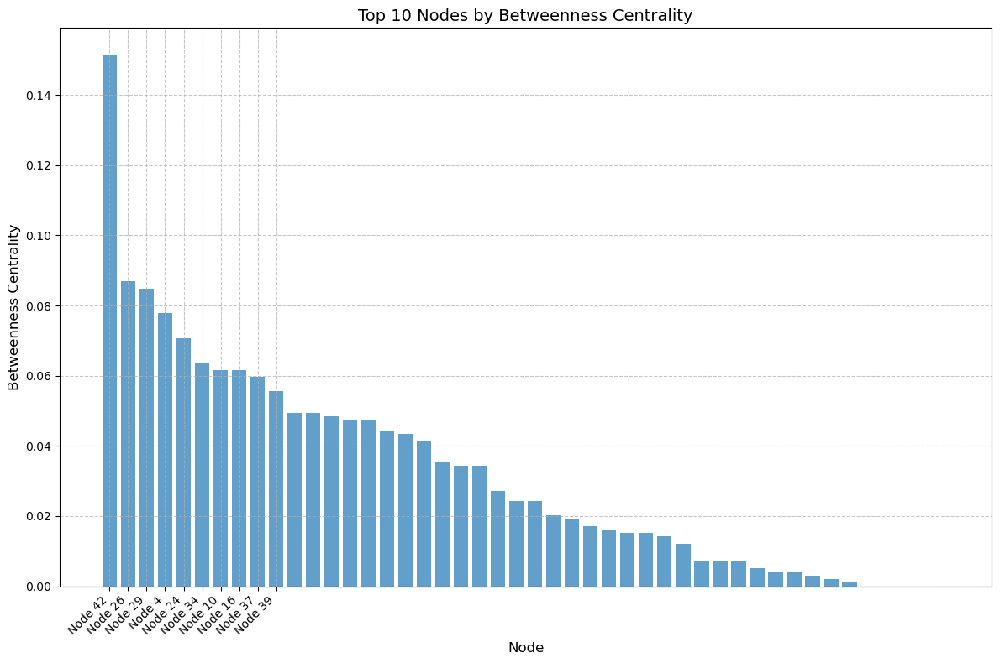

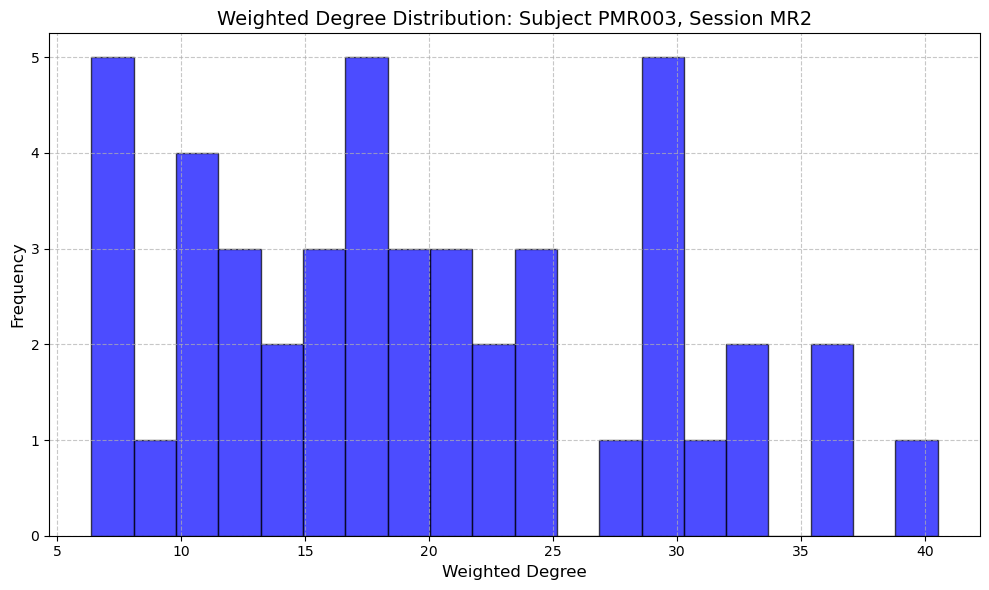

Processing connectome for subject PMR008, session MR2

Visualizations for subject PMR008, session MR2:


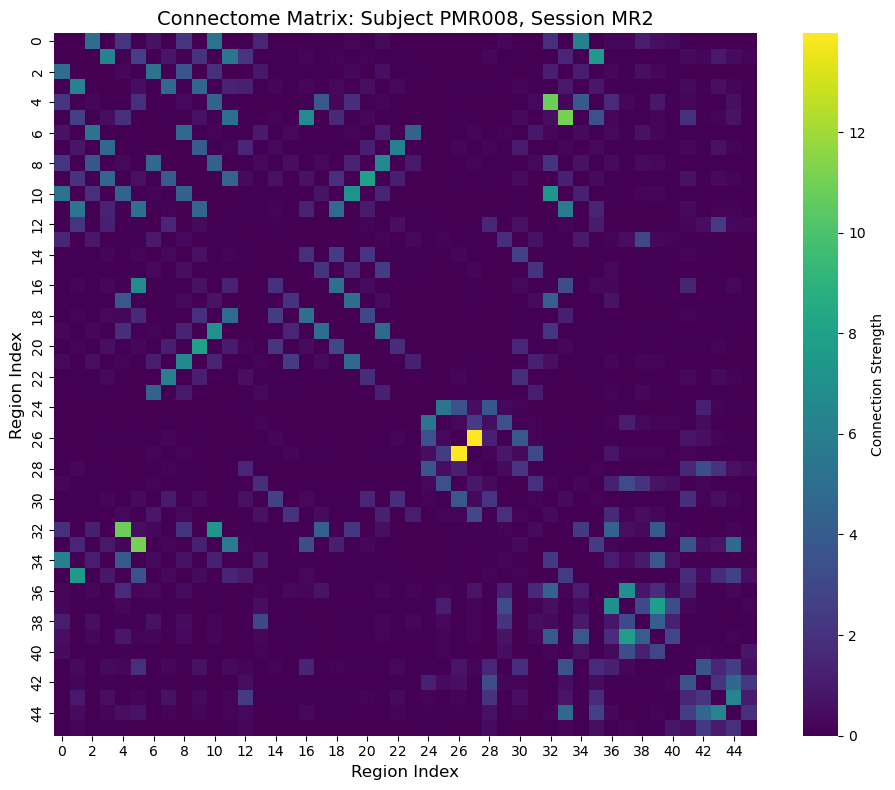

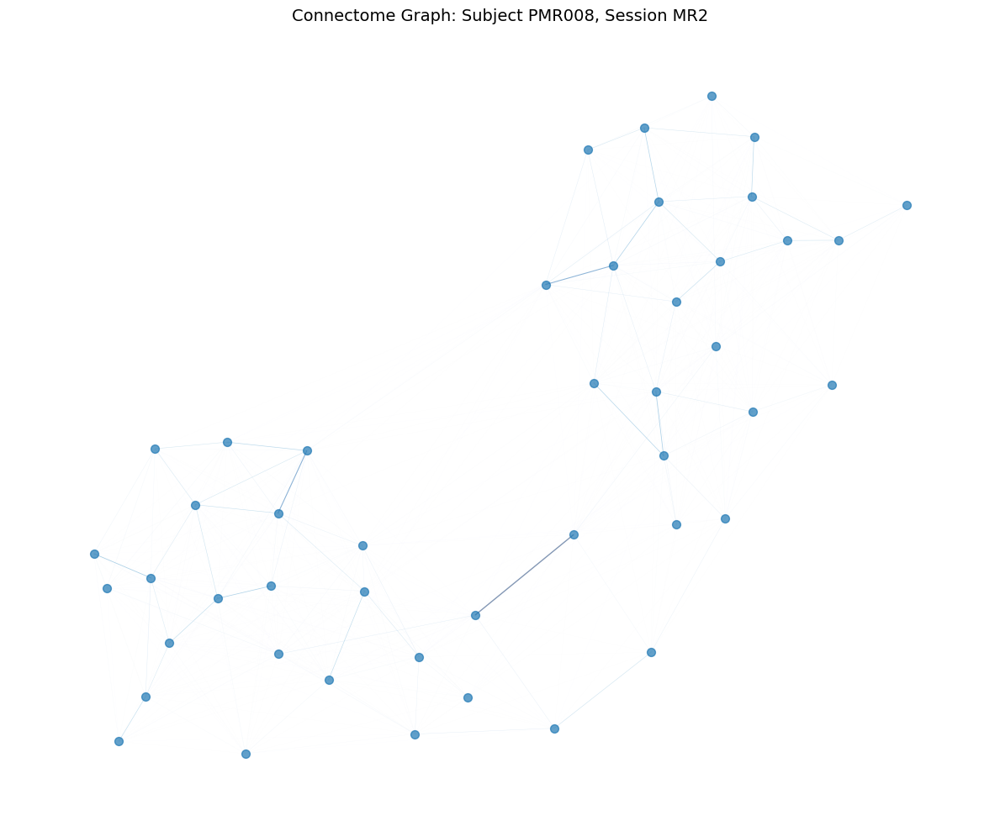

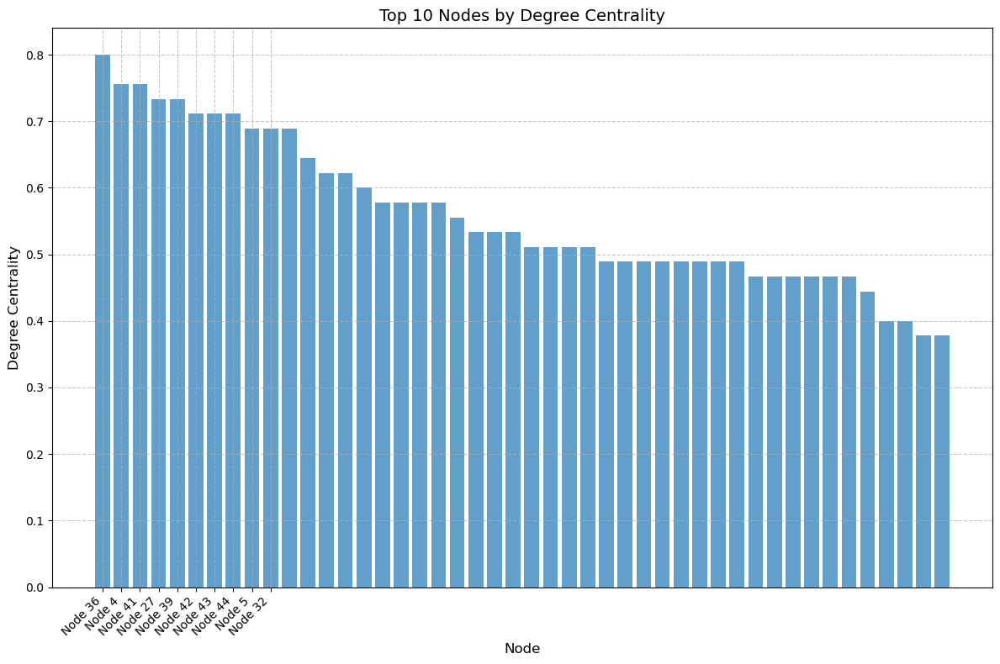

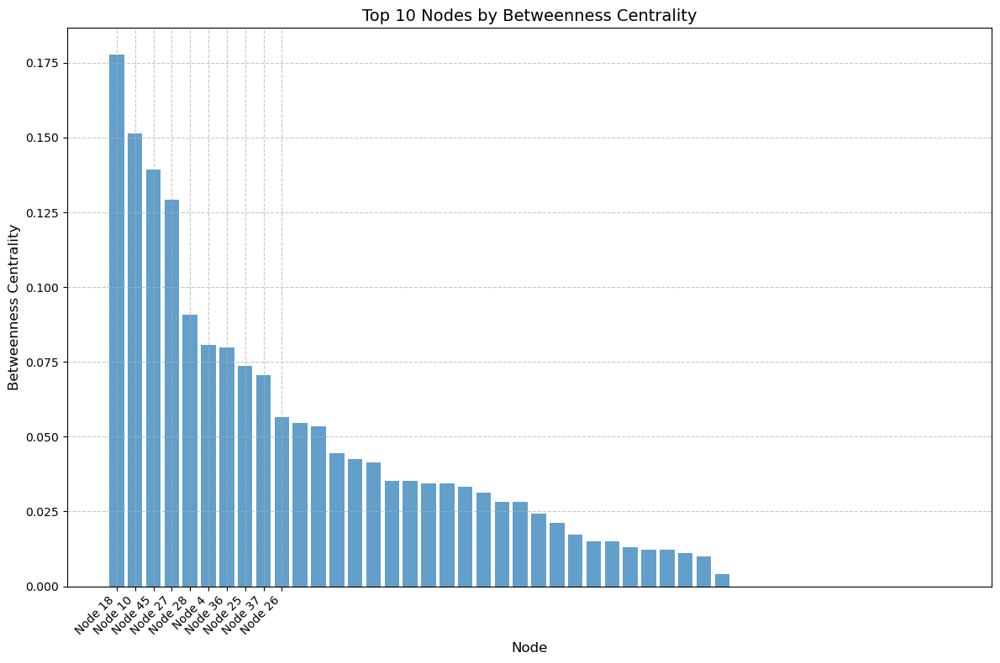

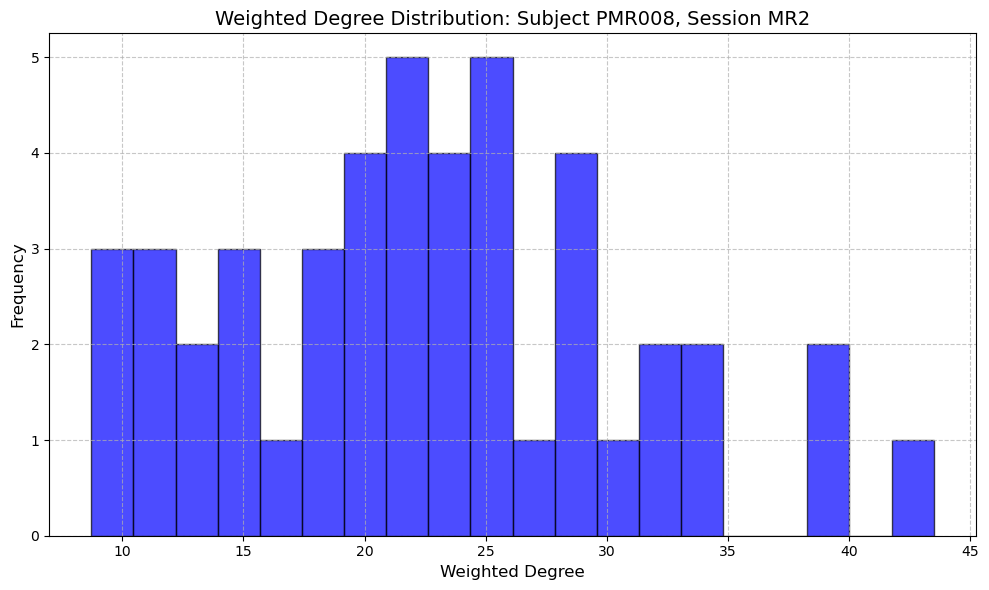

Processing connectome for subject PMR085, session MR2

Visualizations for subject PMR085, session MR2:


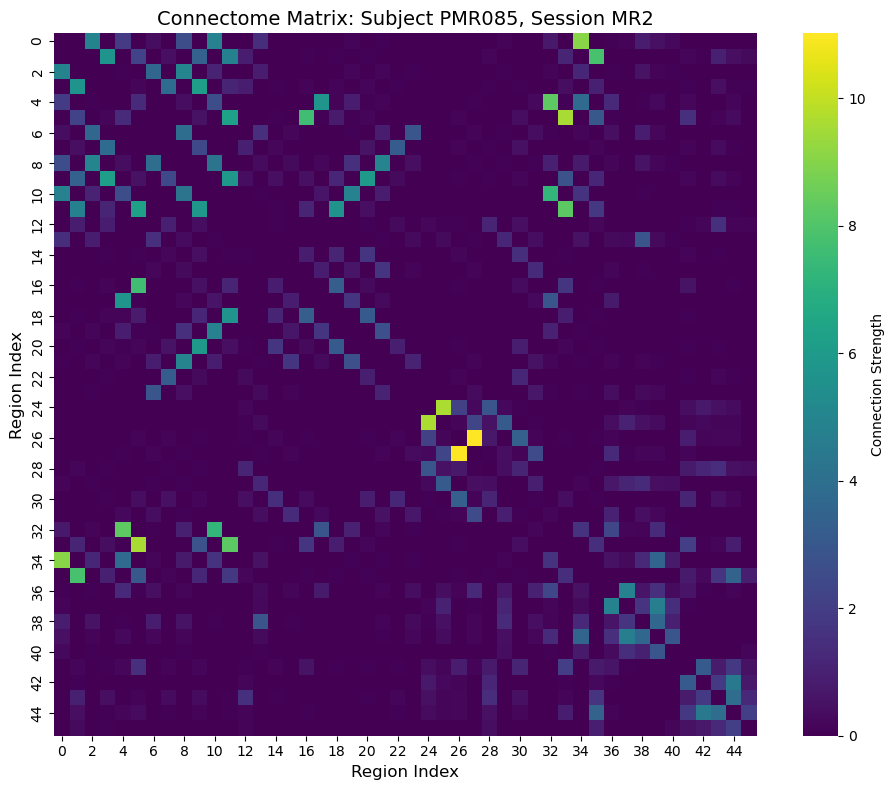

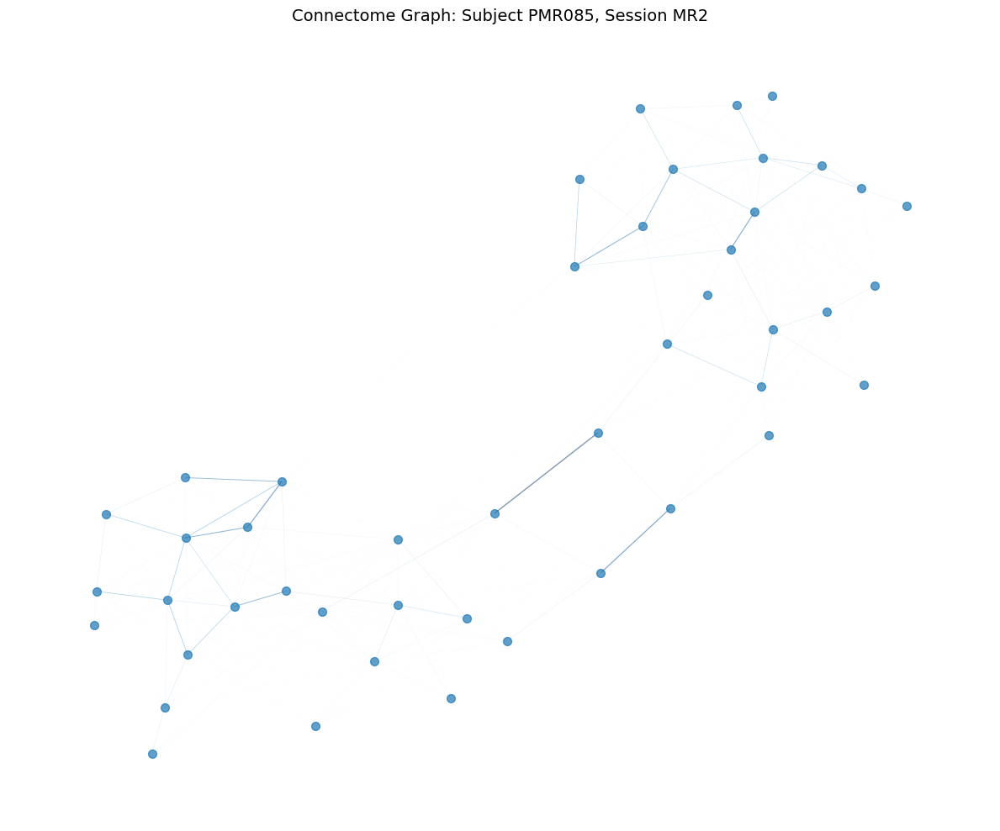

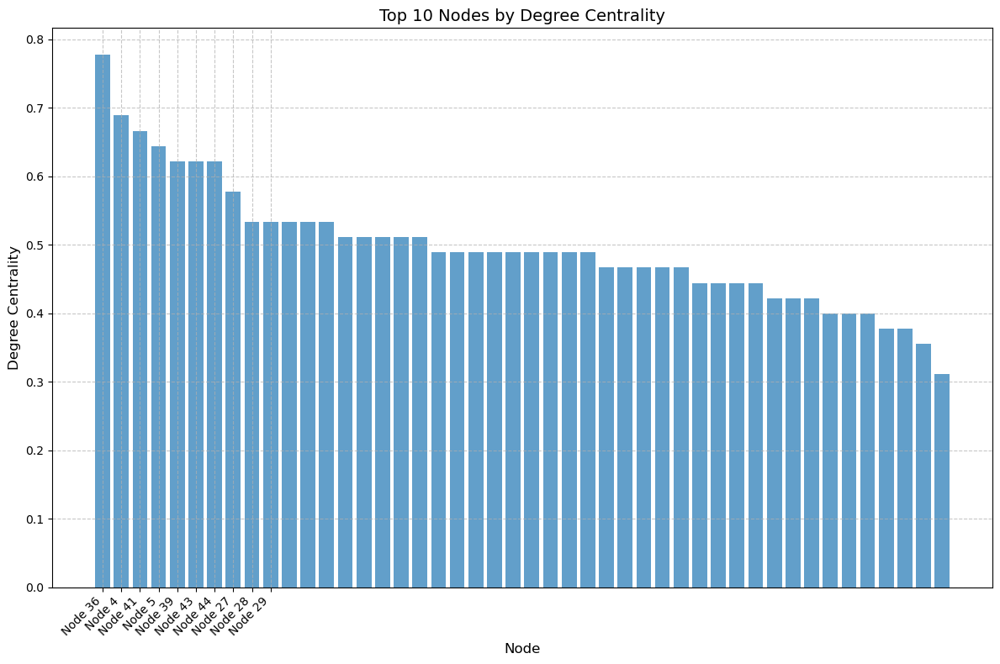

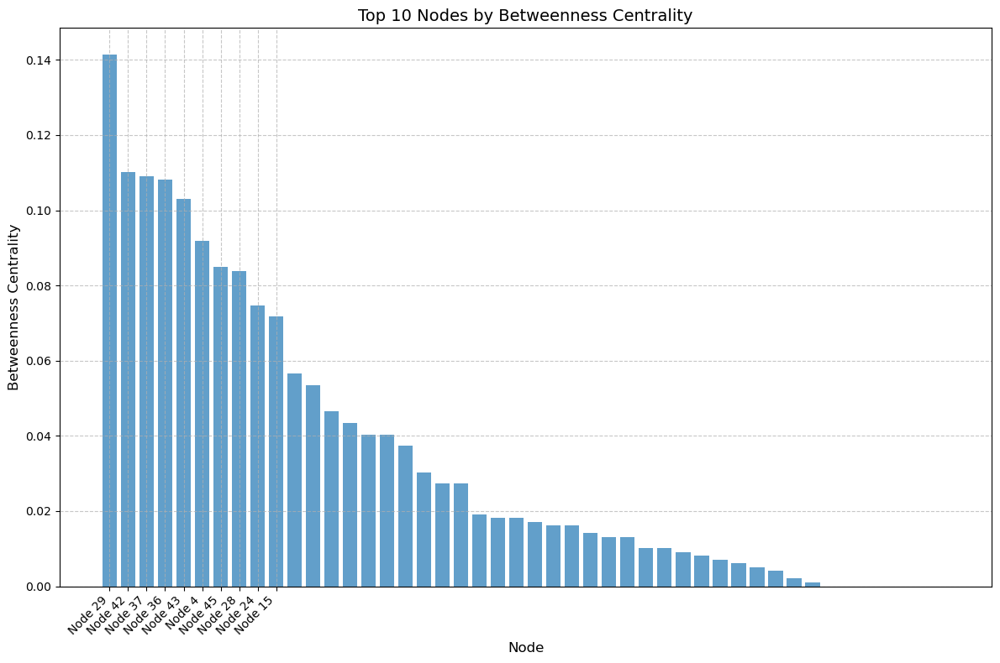

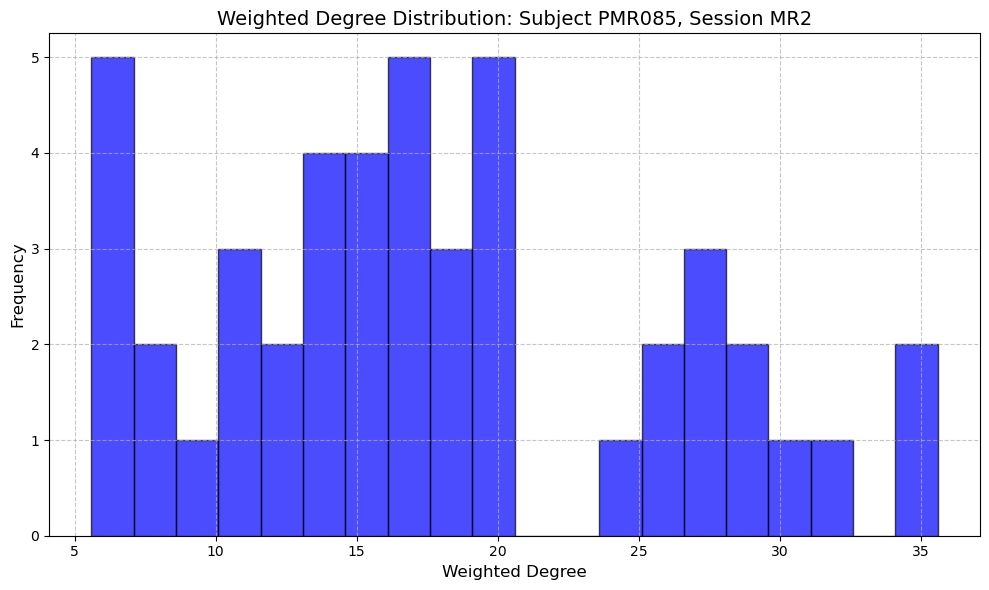

Processing connectome for subject PMR012, session MR2

Visualizations for subject PMR012, session MR2:


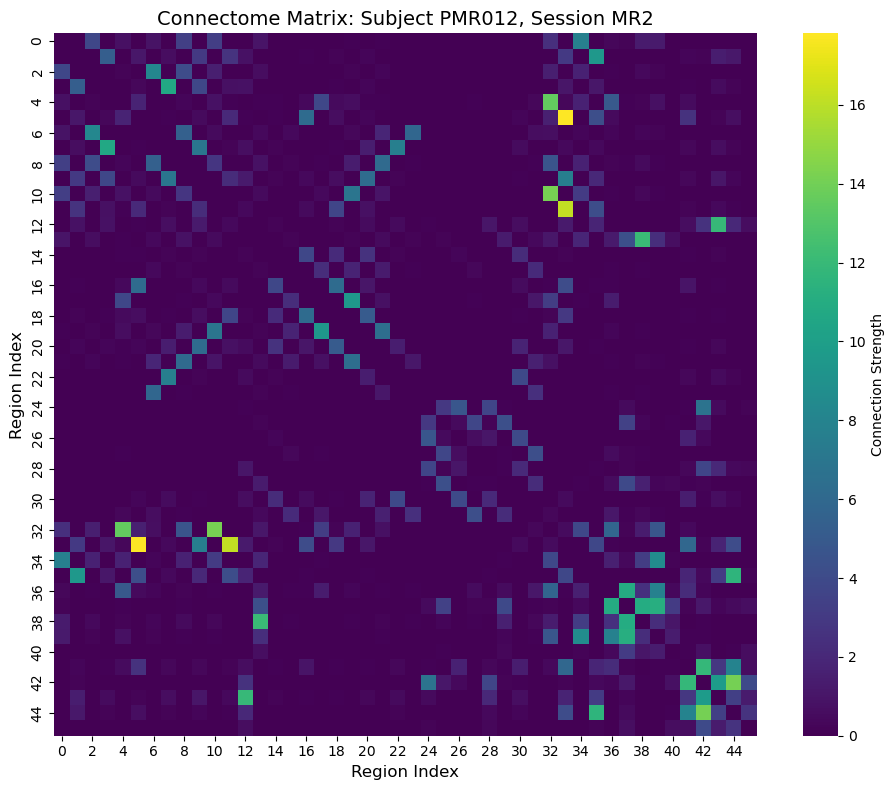

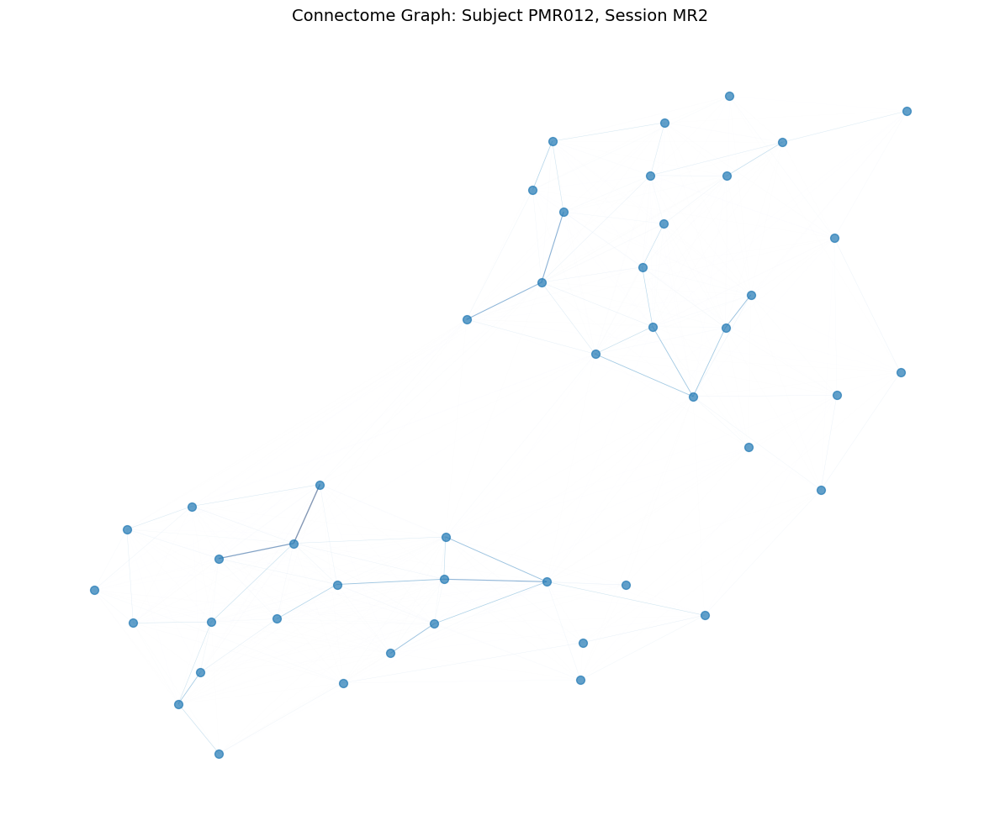

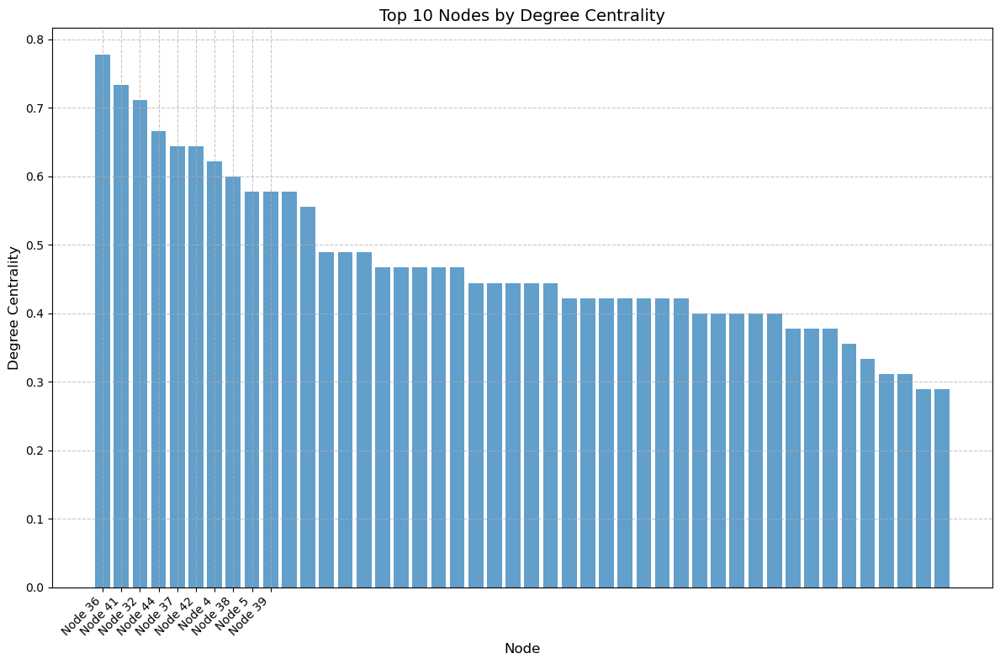

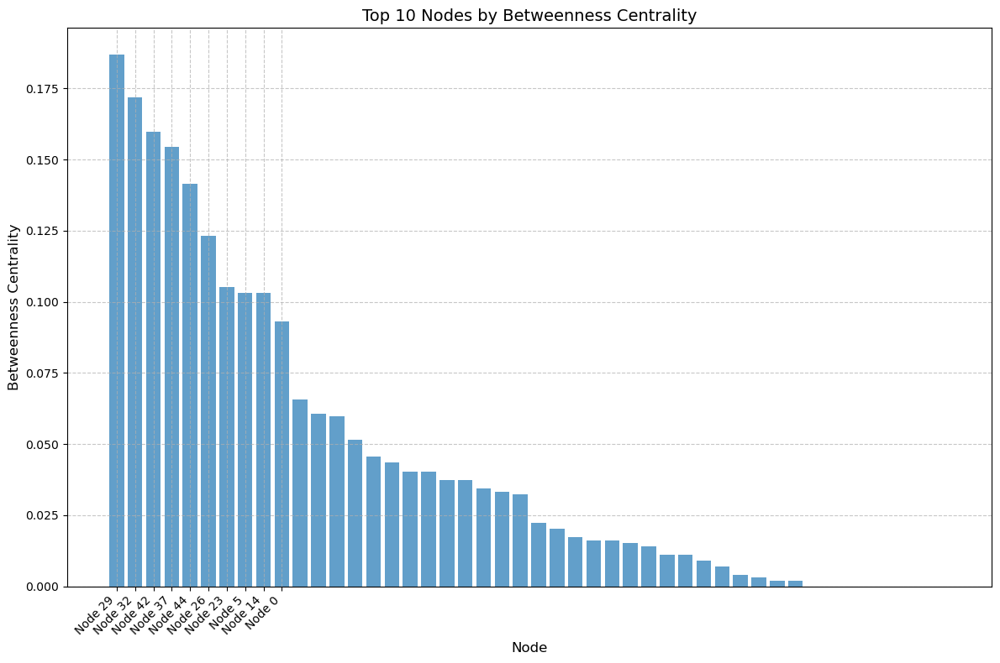

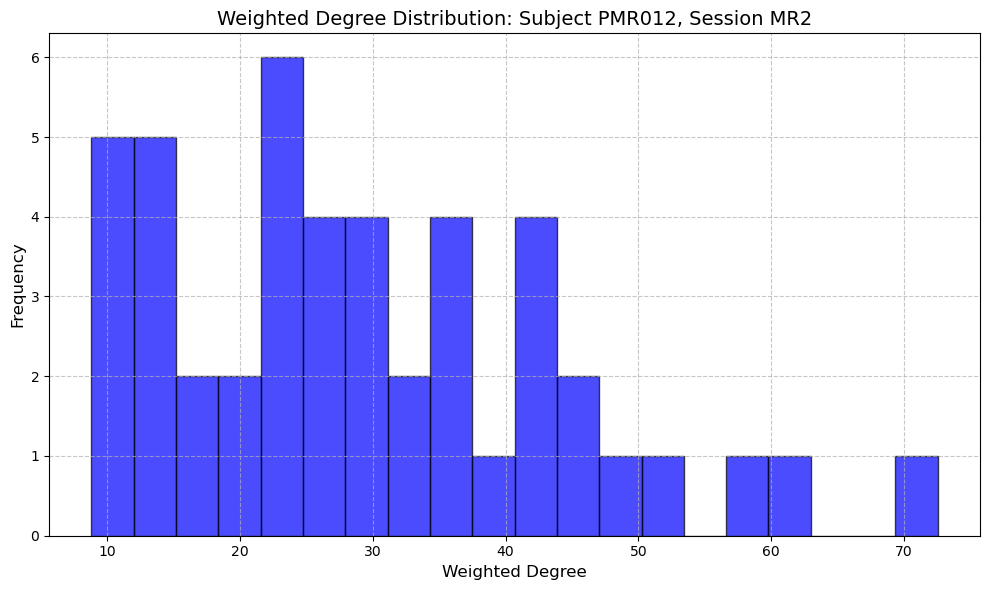

Processing connectome for subject PMR044, session MR2

Visualizations for subject PMR044, session MR2:


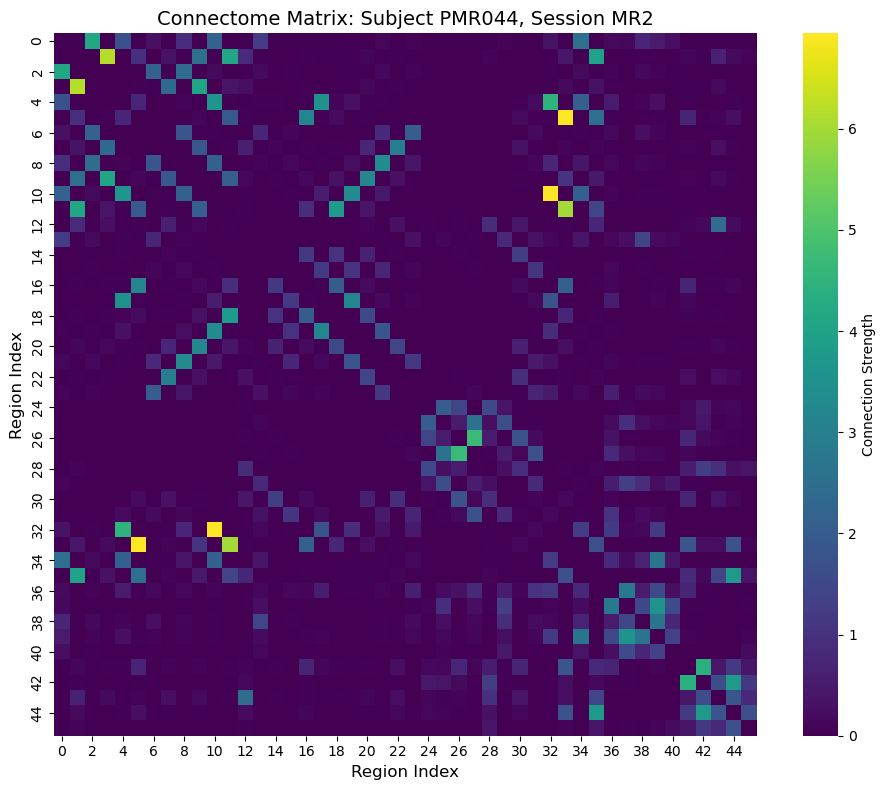

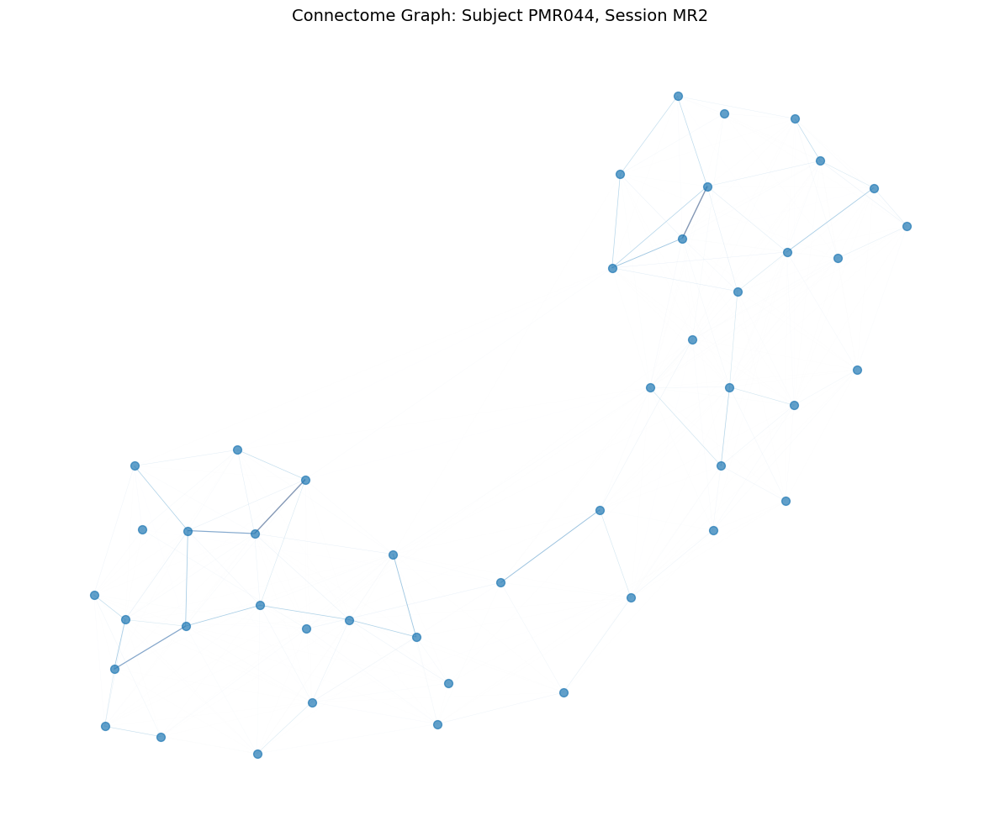

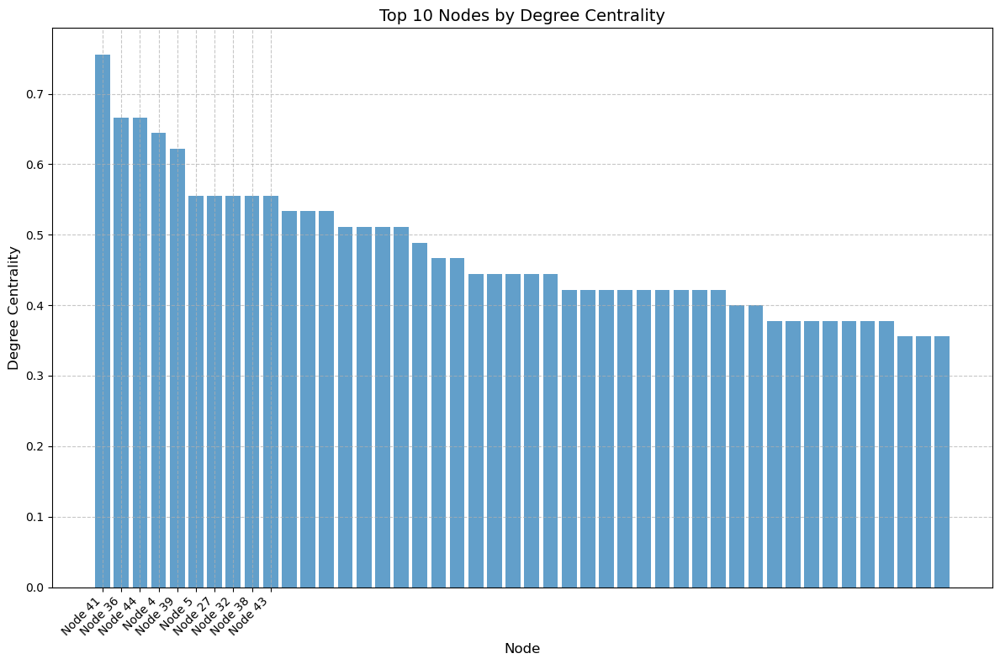

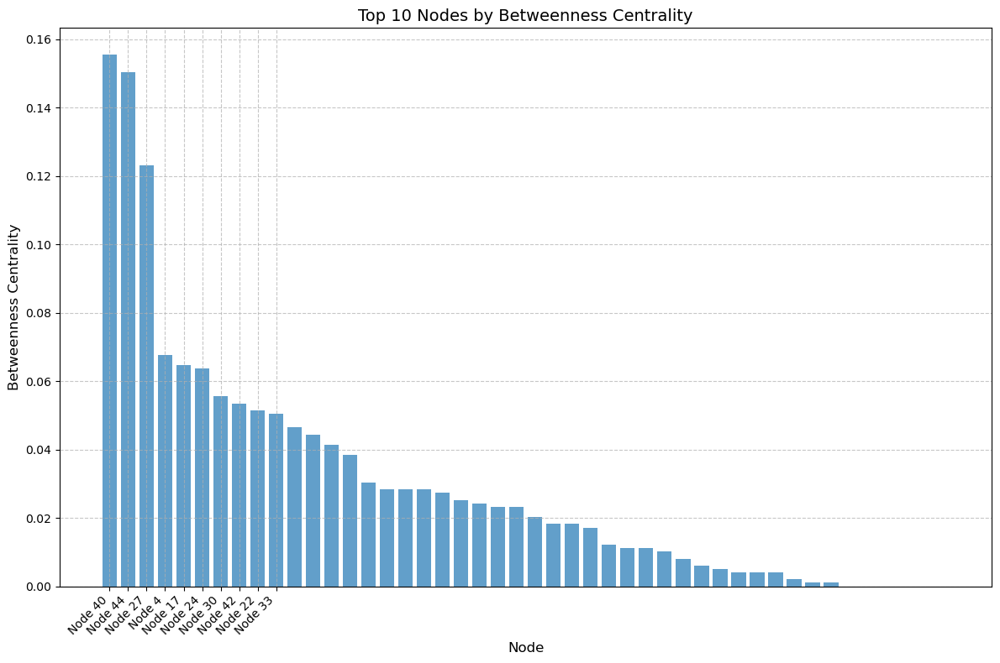

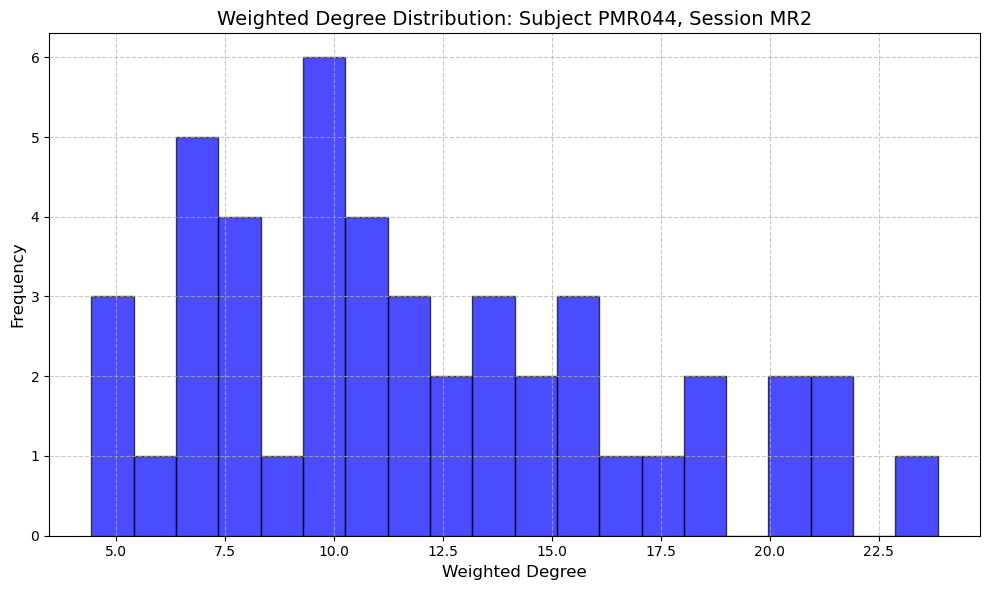

Processing connectome for subject PMR022, session MR2

Visualizations for subject PMR022, session MR2:


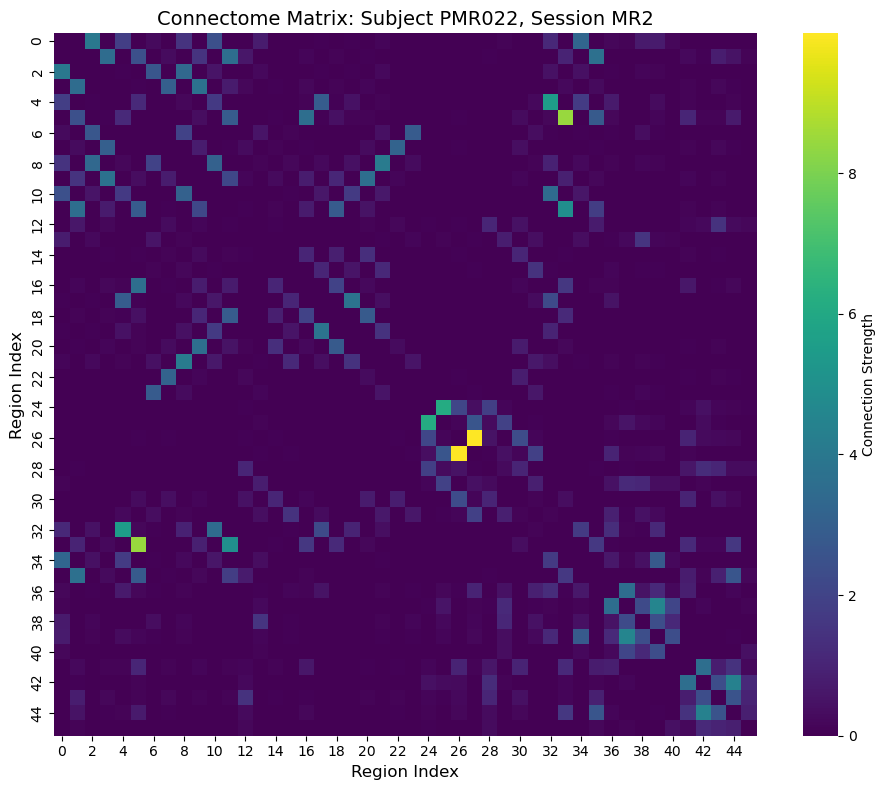

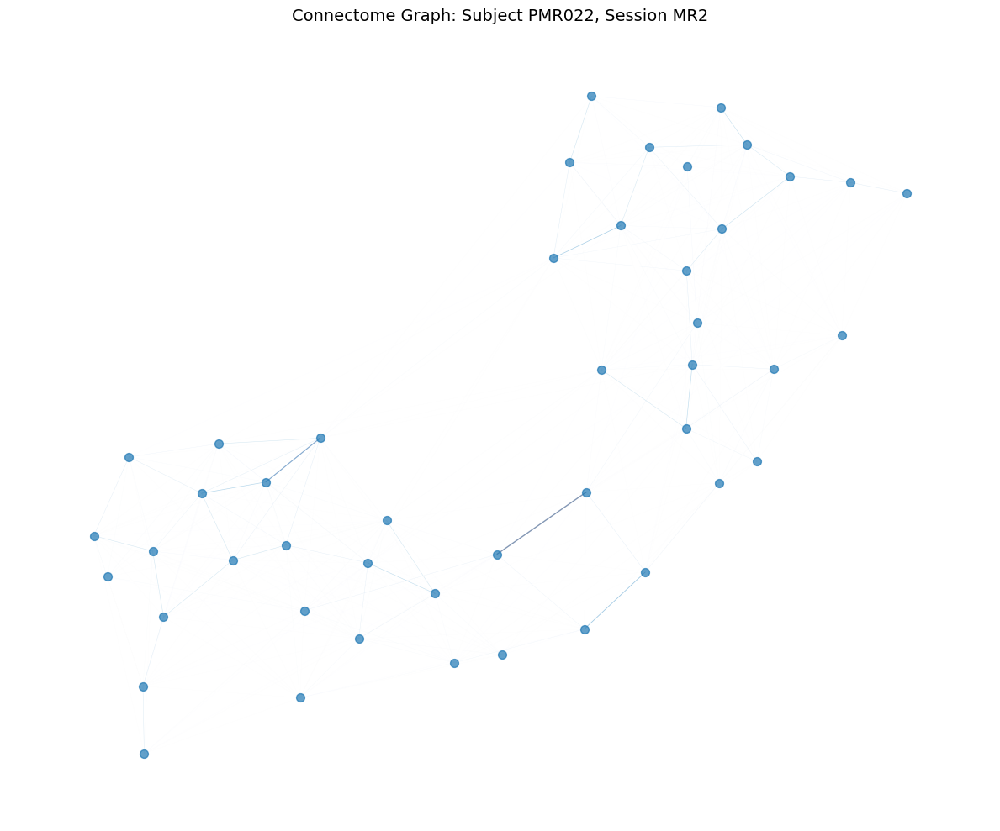

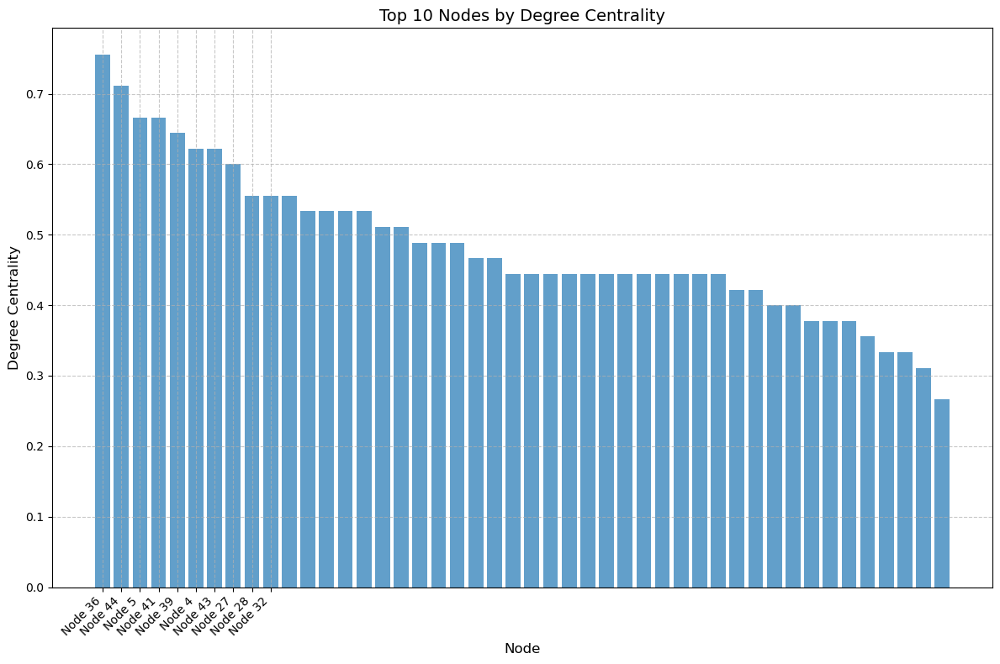

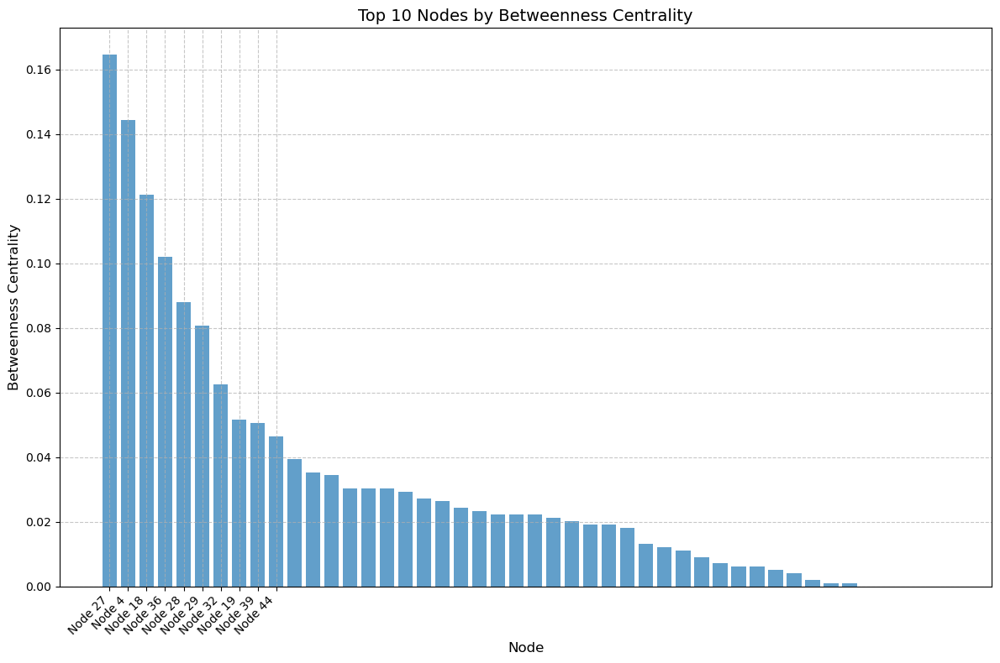

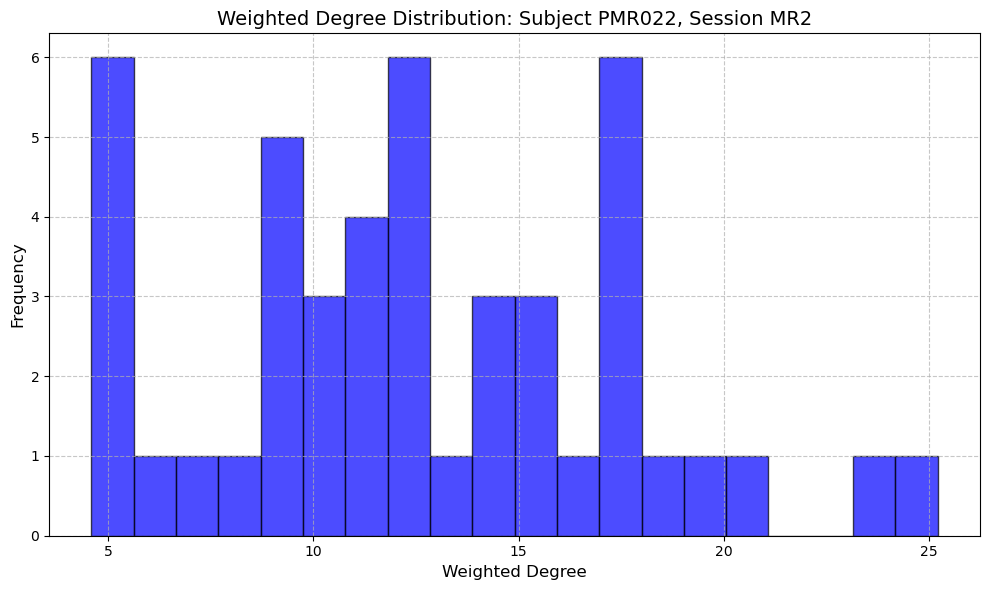


Comparing graph metrics across subjects...

Summary statistics of graph metrics:
       num_nodes   num_edges    density  avg_clustering  avg_shortest_path  \
count       73.0   73.000000  73.000000       73.000000          72.000000   
mean        46.0  526.561644   0.508755        0.025656           0.043726   
std          0.0   31.154626   0.030101        0.005106           0.004016   
min         46.0  452.000000   0.436715        0.015767           0.037347   
25%         46.0  506.000000   0.488889        0.022140           0.041452   
50%         46.0  526.000000   0.508213        0.025051           0.043100   
75%         46.0  545.000000   0.526570        0.028484           0.045362   
max         46.0  671.000000   0.648309        0.040253           0.065176   

        diameter   num_hubs  
count  72.000000  73.000000  
mean    2.986111   8.273973  
std     0.117851   0.901546  
min     2.000000   5.000000  
25%     3.000000   8.000000  
50%     3.000000   8.000000  
75%  

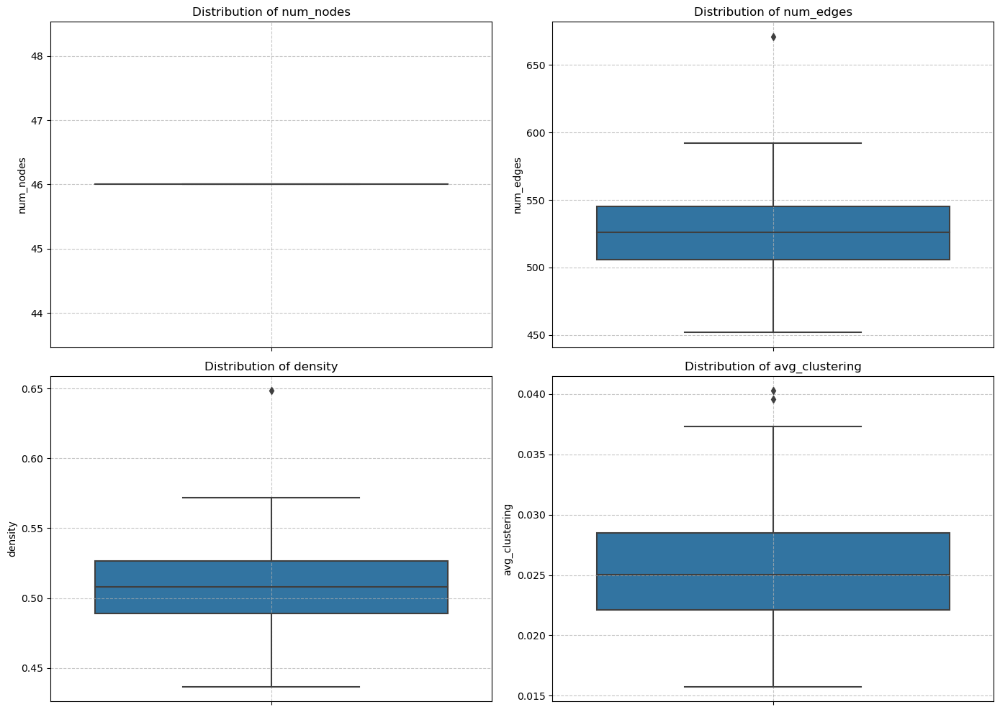

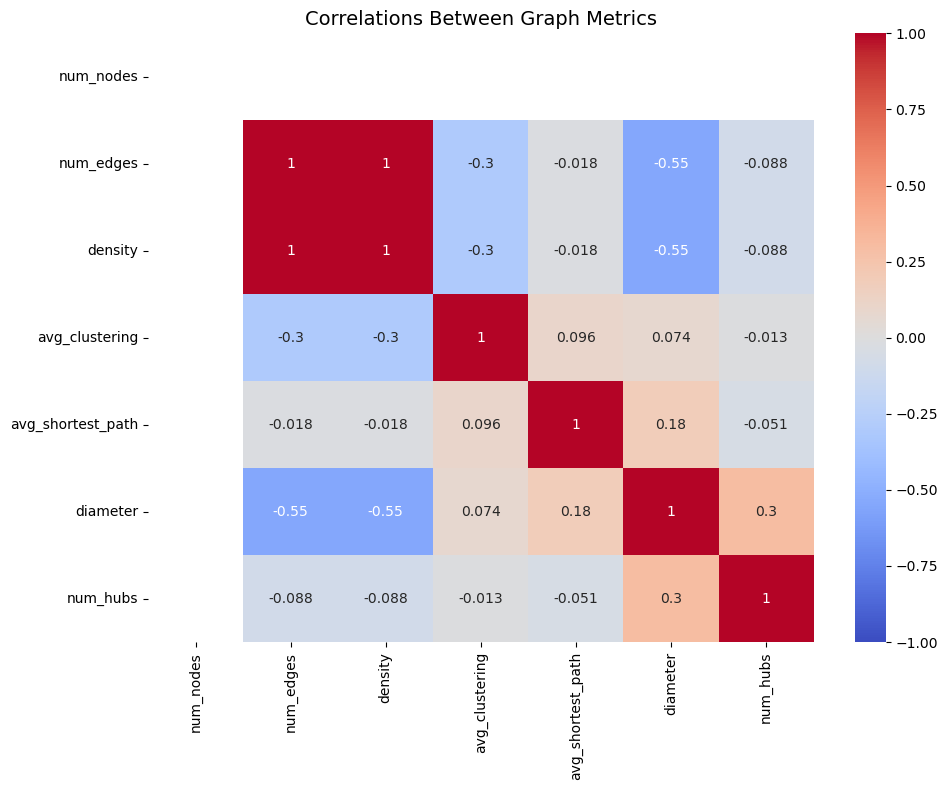

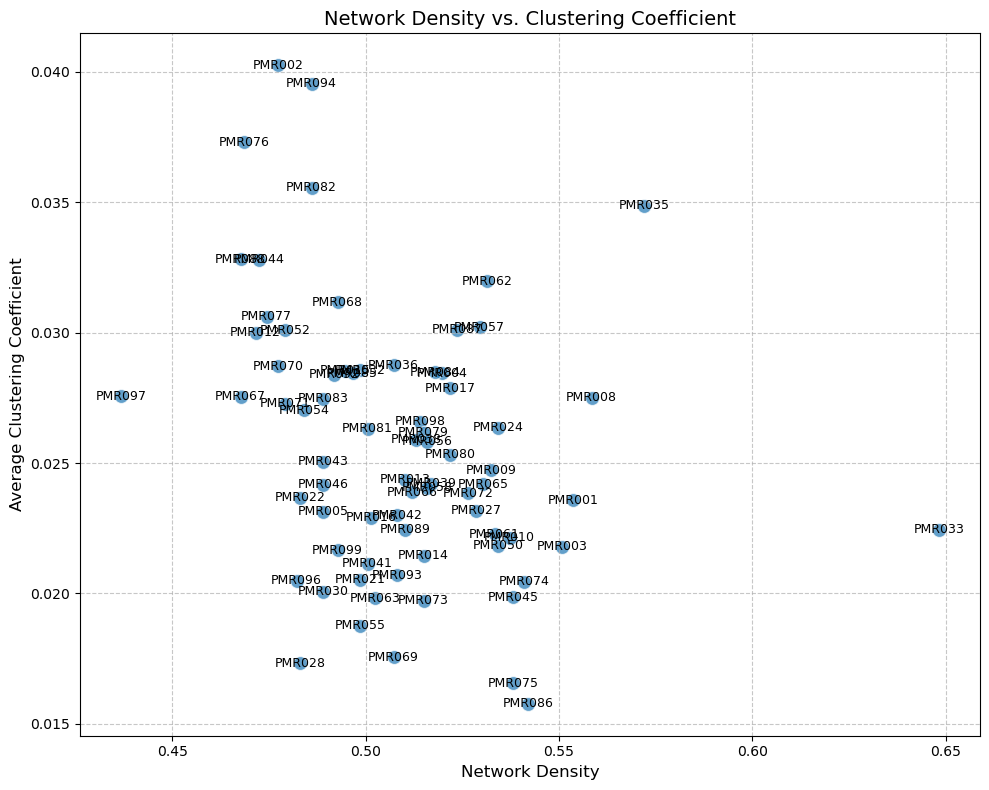


Relationship between graph metrics and gestational age:
  num_nodes vs GW: r = nan, p = nan 
  num_edges vs GW: r = 0.292, p = 0.012 *


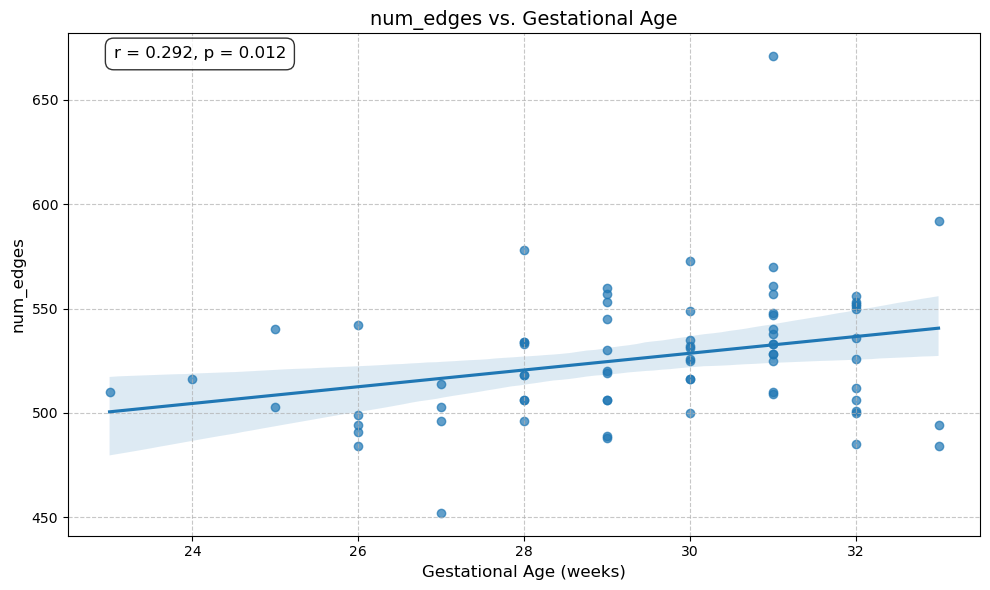

  density vs GW: r = 0.292, p = 0.012 *


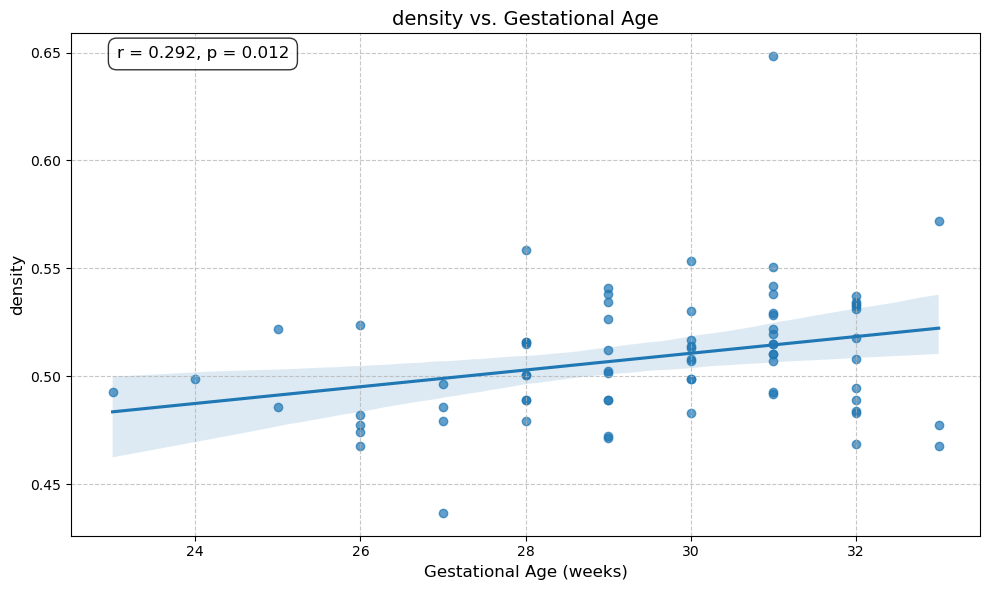

  avg_clustering vs GW: r = -0.272, p = 0.020 *


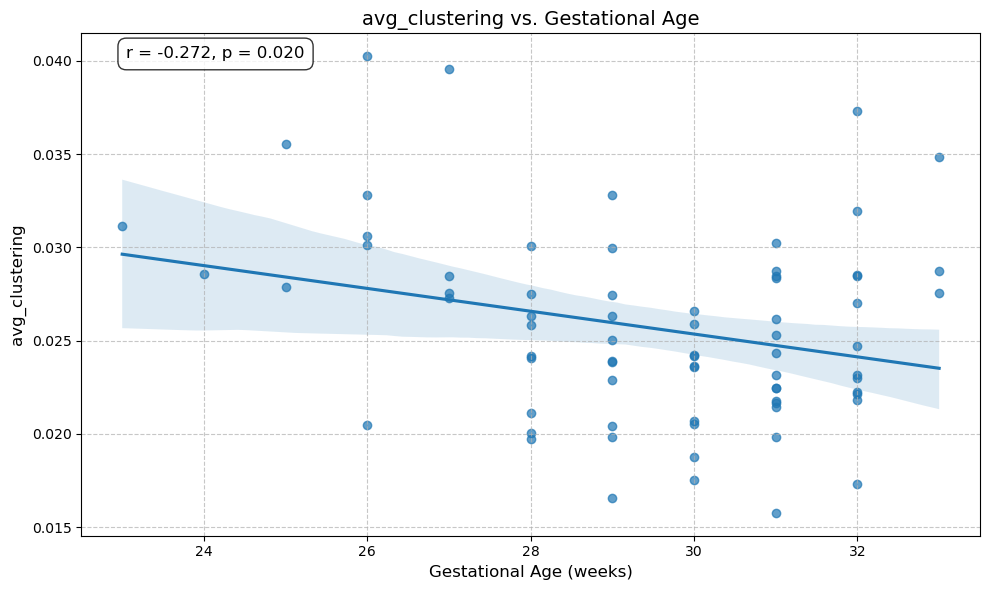

  avg_shortest_path vs GW: r = -0.100, p = 0.405 
  diameter vs GW: r = -0.078, p = 0.516 
  num_hubs vs GW: r = -0.021, p = 0.858 


In [33]:
# Import required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from scipy import stats
import os
import glob
import re
from matplotlib.colors import ListedColormap
from matplotlib import cm
from mpl_toolkits.mplot3d import Axes3D
import warnings
warnings.filterwarnings('ignore')

print("\n" + "="*80)
print("CONNECTOME GRAPH ANALYSIS (SIMPLIFIED VERSION)")
print("="*80)

# Function to load a connectome and convert to a graph
def connectome_to_graph(file_path, threshold=0.0, binarize=False):
    """
    Load a connectome file and convert to a NetworkX graph
    """
    # Load connectome from CSV
    connectome_matrix = pd.read_csv(file_path, header=None).values
    
    # Create a graph from the connectome matrix
    G = nx.from_numpy_array(connectome_matrix)
    
    # Apply threshold and/or binarization if requested
    if threshold > 0 or binarize:
        for u, v, d in list(G.edges(data=True)):
            if d['weight'] <= threshold:
                G.remove_edge(u, v)
            elif binarize:
                d['weight'] = 1.0
                
    return G, connectome_matrix

# Function to compute graph metrics
def compute_graph_metrics(G):
    """Compute various graph theory metrics for the connectome graph"""
    metrics = {}
    
    # Basic graph properties
    metrics['num_nodes'] = G.number_of_nodes()
    metrics['num_edges'] = G.number_of_edges()
    metrics['density'] = nx.density(G)
    
    # Check if graph is connected before computing path-based metrics
    if nx.is_connected(G):
        metrics['avg_shortest_path'] = nx.average_shortest_path_length(G, weight='weight')
        metrics['diameter'] = nx.diameter(G, e=None, usebounds=False)
    else:
        # For disconnected graphs, compute metrics on the largest connected component
        largest_cc = max(nx.connected_components(G), key=len)
        G_lcc = G.subgraph(largest_cc).copy()
        
        # Report LCC metrics and the size of the LCC
        metrics['lcc_size'] = len(largest_cc)
        metrics['lcc_fraction'] = len(largest_cc) / metrics['num_nodes']
        
        if len(largest_cc) > 1:
            metrics['avg_shortest_path_lcc'] = nx.average_shortest_path_length(G_lcc, weight='weight')
            metrics['diameter_lcc'] = nx.diameter(G_lcc, e=None, usebounds=False)
        else:
            metrics['avg_shortest_path_lcc'] = None
            metrics['diameter_lcc'] = None
    
    # Clustering
    metrics['avg_clustering'] = nx.average_clustering(G, weight='weight')
    
    # Node-level centrality measures
    try:
        metrics['degree_centrality'] = nx.degree_centrality(G)
        metrics['betweenness_centrality'] = nx.betweenness_centrality(G, weight='weight')
        metrics['eigenvector_centrality'] = nx.eigenvector_centrality(G, weight='weight', max_iter=1000)
        metrics['closeness_centrality'] = nx.closeness_centrality(G, distance='weight')
    except:
        # Some centrality metrics might fail on certain graphs
        metrics['degree_centrality'] = nx.degree_centrality(G)  # This rarely fails
        metrics['betweenness_centrality'] = None 
        metrics['eigenvector_centrality'] = None
        metrics['closeness_centrality'] = None
        
    return metrics

# Function to visualize a connectome as a graph
def visualize_connectome_graph(G, title="Connectome Graph", 
                              node_size=50, width_scale=1.0, threshold=0.1, figsize=(12, 10)):
    """Create a visualization of the connectome as a graph"""
    plt.figure(figsize=figsize)
    
    # Use spring layout for better visualization
    pos = nx.spring_layout(G, seed=42)
    
    # Get edge weights for width and transparency
    edge_weights = [d['weight'] for _, _, d in G.edges(data=True)]
    
    # Calculate edge width based on weight
    max_weight = max(edge_weights) if edge_weights else 1.0
    edge_widths = [w/max_weight * width_scale for w in edge_weights]
    
    # Get edge colors based on weights
    edge_colors = [plt.cm.Blues(w/max_weight) for w in edge_weights]
    
    # Filter edges based on threshold for cleaner visualization
    edges_to_draw = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] > threshold]
    edge_widths_filtered = [ew for ew, (u, v, d) in zip(edge_widths, G.edges(data=True)) 
                           if d['weight'] > threshold]
    edge_colors_filtered = [ec for ec, (u, v, d) in zip(edge_colors, G.edges(data=True)) 
                           if d['weight'] > threshold]
    
    # Draw the graph
    nx.draw_networkx_nodes(G, pos, node_size=node_size, alpha=0.7)
        
    nx.draw_networkx_edges(
        G, pos, 
        edgelist=edges_to_draw,
        width=edge_widths_filtered,
        edge_color=edge_colors_filtered,
        alpha=0.5
    )
    
    plt.title(title, fontsize=14)
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Function to create connectome matrix heatmap
def plot_connectome_matrix(matrix, mask_threshold=0.0, title="Connectome Matrix", figsize=(10, 8)):
    """Create a heatmap visualization of a connectome matrix"""
    plt.figure(figsize=figsize)
    
    # Apply masking if threshold is specified
    if mask_threshold > 0:
        masked_matrix = np.copy(matrix)
        masked_matrix[masked_matrix < mask_threshold] = 0
    else:
        masked_matrix = matrix
        
    # Create heatmap
    sns.heatmap(
        masked_matrix, 
        cmap='viridis', 
        square=True,
        cbar_kws={'label': 'Connection Strength'}
    )
    
    plt.title(title, fontsize=14)
    plt.xlabel('Region Index', fontsize=12)
    plt.ylabel('Region Index', fontsize=12)
    plt.tight_layout()
    plt.show()

# Function to plot node centrality metrics
def plot_node_centrality(G, centrality_metric, metric_name, figsize=(12, 8)):
    """Plot node centrality metrics"""
    if centrality_metric is None:
        print(f"Warning: {metric_name} not available for this graph")
        return
        
    plt.figure(figsize=figsize)
    
    # Sort nodes by centrality value
    sorted_centrality = sorted(centrality_metric.items(), key=lambda x: x[1], reverse=True)
    nodes = [n for n, _ in sorted_centrality]
    centrality_values = [c for _, c in sorted_centrality]
    
    # Plot
    plt.bar(range(len(nodes)), centrality_values, alpha=0.7)
    
    # Just show the node indices for the top nodes
    top_n = min(10, len(nodes))
    plt.xticks(range(top_n), [f"Node {nodes[i]}" for i in range(top_n)], rotation=45, ha='right')
    
    plt.title(f"Top {top_n} Nodes by {metric_name}", fontsize=14)
    plt.xlabel("Node", fontsize=12)
    plt.ylabel(metric_name, fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()
    
    # Return the top 5 nodes
    return [(nodes[i], centrality_values[i]) for i in range(min(5, len(nodes)))]

# Process connectome files and analyze graph properties
all_metrics = []

# Let's process the connectome files
print("\nProcessing connectome files and analyzing graph properties...")

# Assuming true_connectome_files is a list of connectome file paths from your previous code
# If not available, we should find the connectome files
if 'true_connectome_files' not in locals():
    # Define path pattern to find connectome files (modify as needed)
    connectome_pattern = "derivatives/dMRI/**/connectome/**/*Connectome.csv"
    true_connectome_files = glob.glob(connectome_pattern, recursive=True)
    
    if not true_connectome_files:
        # Try a different pattern if needed
        connectome_pattern = "derivatives/dMRI/**/*Connectome*.csv"
        true_connectome_files = glob.glob(connectome_pattern, recursive=True)

# Process each connectome file
for file_path in true_connectome_files:
    try:
        # Skip assignment files and other non-connectome files
        if "assignments" in file_path or not file_path.endswith('.csv'):
            continue
        
        # Extract subject information from file path
        subject_match = re.search(r'sub-([^_/]+)', file_path)
        session_match = re.search(r'ses-([^_/]+)', file_path)
        
        subject_id = subject_match.group(1) if subject_match else "unknown"
        session = session_match.group(1) if session_match else "unknown"
        
        print(f"Processing connectome for subject {subject_id}, session {session}")
        
        # Load connectome and convert to graph (adjusting threshold for better visualization)
        G, connectome_matrix = connectome_to_graph(file_path, threshold=0.01)
        
        # Compute graph metrics
        metrics = compute_graph_metrics(G)
        
        # Add subject info to metrics
        metrics['subject_id'] = subject_id
        metrics['session'] = session
        
        # Find clinical data if available
        if 'patient_df' in locals():
            # Try to match subject in clinical data
            subject_row = None
            for _, row in patient_df.iterrows():
                if pd.notna(row.get('CODE')) and (str(row['CODE']) == subject_id or f"PMR{row['CODE']}" == subject_id):
                    subject_row = row
                    break
            
            if subject_row is not None:
                # Add clinical data to metrics
                metrics['GW'] = subject_row.get('GW', None)
                metrics['SS_Left'] = subject_row.get('Left_SS', None)
                metrics['SS_Right'] = subject_row.get('Right_SS', None)
                
                # Add SS average if both hemispheres available
                if pd.notna(metrics['SS_Left']) and pd.notna(metrics['SS_Right']):
                    metrics['SS_Average'] = (metrics['SS_Left'] + metrics['SS_Right']) / 2
                    
        # Identify hub nodes based on degree centrality
        if metrics['degree_centrality'] is not None:
            hub_threshold = np.percentile(list(metrics['degree_centrality'].values()), 80)
            hubs = {node: val for node, val in metrics['degree_centrality'].items() 
                   if val > hub_threshold}
            metrics['hub_nodes'] = list(hubs.keys())
            metrics['num_hubs'] = len(hubs)
        
        # Create visualizations for this connectome
        print(f"\nVisualizations for subject {subject_id}, session {session}:")
        
        # 1. Connectome matrix visualization
        plot_connectome_matrix(connectome_matrix, mask_threshold=0.01, 
                             title=f"Connectome Matrix: Subject {subject_id}, Session {session}")
        
        # 2. Graph visualization using spring layout
        visualize_connectome_graph(G, title=f"Connectome Graph: Subject {subject_id}, Session {session}", 
                                  threshold=0.05)
        
        # 3. Visualize centrality metrics
        if metrics['degree_centrality'] is not None:
            plot_node_centrality(G, metrics['degree_centrality'], "Degree Centrality")
        
        if metrics['betweenness_centrality'] is not None:
            plot_node_centrality(G, metrics['betweenness_centrality'], "Betweenness Centrality")
        
        # 4. Visualize degree distribution
        plt.figure(figsize=(10, 6))
        degrees = dict(G.degree(weight='weight'))
        plt.hist(list(degrees.values()), bins=20, alpha=0.7, color='blue', edgecolor='black')
        plt.title(f"Weighted Degree Distribution: Subject {subject_id}, Session {session}", fontsize=14)
        plt.xlabel("Weighted Degree", fontsize=12)
        plt.ylabel("Frequency", fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
        
        # Add metrics to collection
        all_metrics.append(metrics)
        
    except Exception as e:
        print(f"Error processing {file_path}: {str(e)}")
        continue

# Compare metrics across subjects
if len(all_metrics) > 0:
    print("\nComparing graph metrics across subjects...")
    
    # Convert to DataFrame for easier analysis
    metrics_df = pd.DataFrame(all_metrics)
    
    # Basic statistics
    print("\nSummary statistics of graph metrics:")
    
    # Select columns that can be summarized
    numeric_cols = ['num_nodes', 'num_edges', 'density', 'avg_clustering', 
                   'avg_shortest_path', 'diameter', 'num_hubs']
    valid_cols = [col for col in numeric_cols if col in metrics_df.columns]
    
    print(metrics_df[valid_cols].describe())
    
    # Create visualizations
    # 1. Box plots of key metrics
    plt.figure(figsize=(14, 10))
    for i, metric in enumerate(valid_cols[:4], 1):
        if metrics_df[metric].notna().sum() > 0:  # Only plot if we have data
            plt.subplot(2, 2, i)
            sns.boxplot(y=metric, data=metrics_df)
            plt.title(f"Distribution of {metric}", fontsize=12)
            plt.grid(True, linestyle='--', alpha=0.7)
    
    plt.tight_layout()
    plt.show()
    
    # 2. Correlation matrix between metrics
    plt.figure(figsize=(10, 8))
    corr_metrics = metrics_df[valid_cols].corr()
    sns.heatmap(corr_metrics, annot=True, cmap='coolwarm', center=0, vmin=-1, vmax=1)
    plt.title("Correlations Between Graph Metrics", fontsize=14)
    plt.tight_layout()
    plt.show()
    
    # 3. Scatter plots for network density vs clustering
    if 'density' in metrics_df.columns and 'avg_clustering' in metrics_df.columns:
        plt.figure(figsize=(10, 8))
        sns.scatterplot(x='density', y='avg_clustering', data=metrics_df, s=100, alpha=0.7)
        
        for i, row in metrics_df.iterrows():
            plt.text(row['density'], row['avg_clustering'], row['subject_id'], 
                    fontsize=9, ha='center', va='center')
            
        plt.title("Network Density vs. Clustering Coefficient", fontsize=14)
        plt.xlabel("Network Density", fontsize=12)
        plt.ylabel("Average Clustering Coefficient", fontsize=12)
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.tight_layout()
        plt.show()
        
    # Relationship with clinical variables
    if 'GW' in metrics_df.columns and metrics_df['GW'].notna().sum() > 1:
        print("\nRelationship between graph metrics and gestational age:")
        
        for metric in valid_cols:
            if metrics_df[metric].notna().sum() > 1:
                mask = metrics_df[['GW', metric]].notna().all(axis=1)
                if mask.sum() > 1:
                    corr, p_val = stats.pearsonr(metrics_df.loc[mask, 'GW'], metrics_df.loc[mask, metric])
                    print(f"  {metric} vs GW: r = {corr:.3f}, p = {p_val:.3f} {'*' if p_val < 0.05 else ''}")
                    
                    if p_val < 0.05:
                        # Create scatter plot for significant correlations
                        plt.figure(figsize=(10, 6))
                        sns.regplot(x='GW', y=metric, data=metrics_df, scatter_kws={'alpha': 0.7})
                        plt.title(f"{metric} vs. Gestational Age", fontsize=14)
                        plt.xlabel("Gestational Age (weeks)", fontsize=12)
                        plt.ylabel(metric, fontsize=12)
                        plt.grid(True, linestyle='--', alpha=0.7)
                        
                        # Add annotation with correlation statistics
                        plt.annotate(f'r = {corr:.3f}, p = {p_val:.3f}', xy=(0.05, 0.95),
                                    xycoords='axes fraction', fontsize=12,
                                    bbox=dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.8))
                                    
                        plt.tight_layout()
                        plt.show()